In [1]:
import nltk
import gensim
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import json
import os
from pprint import pprint
import itertools
from functools import reduce
import operator
from collections import Counter

%matplotlib inline


In [2]:
metadata_file_path = 'C:\\workspace\\machine-learning\\covid-analysis\\input-data\\2020-05-29\\metadata.csv'

metadata_df = pd.read_csv(metadata_file_path)

metadata_df.head()

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (5,13,14,16) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636.0,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967.0,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972.0,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871.0,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888.0,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


In [3]:
# Some information on the data frame
print(metadata_df.info())
print('shape : ', metadata_df.shape)
#print('Nulls===> : \n', metadata_df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138807 entries, 0 to 138806
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   cord_uid          138807 non-null  object 
 1   sha               61057 non-null   object 
 2   source_x          138807 non-null  object 
 3   title             138771 non-null  object 
 4   doi               108594 non-null  object 
 5   pmcid             65222 non-null   object 
 6   pubmed_id         104662 non-null  float64
 7   license           138807 non-null  object 
 8   abstract          108546 non-null  object 
 9   publish_time      138791 non-null  object 
 10  authors           133727 non-null  object 
 11  journal           131500 non-null  object 
 12  mag_id            0 non-null       float64
 13  who_covidence_id  22886 non-null   object 
 14  arxiv_id          1598 non-null    object 
 15  pdf_json_files    61057 non-null   object 
 16  pmc_json_files    47

In [7]:
pmc_pdf_files_root = 'C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29'
metadata_pdf_df = metadata_df[['cord_uid','pdf_json_files']]
metadata_pmc_df = metadata_df[['cord_uid','pmc_json_files']]

In [8]:
# JSON FILE READER 
def read_json_file(file_name):
    if not file_name or pd.isna(file_name):
        return
    print('Processing File Name : ', file_name )  
    file_path = os.path.join( pmc_pdf_files_root, file_name )
    if not os.path.exists( file_path ):
        print(' File : ', file_path, 'does not exist!')
        return
    with open( file_path, 'r') as in_file :
        data = json.load(in_file )
        
    return data

In [9]:
file_name = 'document_parses/pdf_json/00a0ab182dc01b6c2e737dfae585f050dcf9a7a5.json'
json_data = read_json_file( file_name )
#pprint( json_data )


Processing File Name :  document_parses/pdf_json/00a0ab182dc01b6c2e737dfae585f050dcf9a7a5.json


In [10]:
def get_countries_from_authors(author):
    
    if 'affiliation' in author :
        affiliation = author['affiliation']
        if 'location' in affiliation:
            location = affiliation['location']
            if 'country' in location:
                return location['country']
    return ''    

def get_author_countries_from_json( json_data ):
    countries = list()
    if 'metadata' in json_data:
        if 'authors' in json_data['metadata']:
            authors = json_data['metadata']['authors']
            if authors:
                countries = list(map( get_countries_from_authors, authors ))
    return ','.join(countries)




def get_text_from_abstracts( abstract):
    if 'text' in abstract:
        return abstract['text']
    return ''  
    

def get_abstract_text_from_json( json_data ):
    abstract_texts = list()
    if 'abstract'in json_data :
        abstracts = json_data['abstract']
        if abstracts:
            abstract_texts = list(map(get_text_from_abstracts, abstracts))
        return ' '.join(abstract_texts)
            
            
def get_text_from_body_texts( body_text):
    if 'text' in body_text:
        return body_text['text']
    return ''  
    

def get_body_text_from_json( json_data ):
    body_text_texts = list()
    if 'body_text'in json_data :
        body_texts = json_data['body_text']
        if body_texts:
            body_text_texts = list(map(get_text_from_body_texts, body_texts))
            
        #print('body text : ', body_text_texts)
        return ' '.join(body_text_texts)
            
            
def get_body_text_from_file( file_name ):
    
    data = read_json_file( file_name )
    if data :
        return get_body_text_from_json( data )
    
def get_abstract_text_from_file( file_name ):
    
    data = read_json_file( file_name )
    if data :
        return get_abstract_text_from_json( data )
    
def get_author_countries_from_file( file_name ):
    
    data = read_json_file( file_name )
    if data:
        return get_author_countries_from_json( data )
    
        
    
    

In [11]:
#metadata_pdf_df['body_text'] = metadata_pdf_df['pdf_json_files'][15:16].apply(get_body_text_from_file)
metadata_pdf_df['body_text'] = metadata_pdf_df['pdf_json_files'].apply(get_body_text_from_file)

Processing File Name :  document_parses/pdf_json/d1aafb70c066a2068b02786f8929fd9c900897fb.json
Processing File Name :  document_parses/pdf_json/6b0567729c2143a66d737eb0a2f63f2dce2e5a7d.json
Processing File Name :  document_parses/pdf_json/06ced00a5fc04215949aa72528f2eeaae1d58927.json
Processing File Name :  document_parses/pdf_json/348055649b6b8cf2b9a376498df9bf41f7123605.json
Processing File Name :  document_parses/pdf_json/5f48792a5fa08bed9f56016f4981ae2ca6031b32.json
Processing File Name :  document_parses/pdf_json/b2897e1277f56641193a6db73825f707eed3e4c9.json
Processing File Name :  document_parses/pdf_json/e3d0d482ebd9a8ba81c254cc433f314142e72174.json
Processing File Name :  document_parses/pdf_json/00b1d99e70f779eb4ede50059db469c65e8c1469.json
Processing File Name :  document_parses/pdf_json/cf584e00f637cbd8f1bb35f3f09f5ed07b71aeb0.json
Processing File Name :  document_parses/pdf_json/dde02f11923815e6a16a31dd6298c46b109c5dfa.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/3c27a29517bd8ab1797aeaa2a84808c29555dc22.json
Processing File Name :  document_parses/pdf_json/6f07f87e8ef78f0416556e69c88247e588f9192c.json
Processing File Name :  document_parses/pdf_json/9ffde004c991e9cf3c63e9143946a64ffaa9ee2a.json
Processing File Name :  document_parses/pdf_json/c6c8b82bc5a800425b075540eff41b0af719f80f.json
Processing File Name :  document_parses/pdf_json/7000185289991946d912ac5f4b9451cce4d228a2.json
Processing File Name :  document_parses/pdf_json/92588c166b0a272f9dbc15dc1bd42f6dfaf56dd3.json
Processing File Name :  document_parses/pdf_json/d706e82e2ebc8571e70654d1acf0ffd3969ab2d3.json
Processing File Name :  document_parses/pdf_json/914c8d326beaccabd37199a9903b27fa7f9b0586.json
Processing File Name :  document_parses/pdf_json/b1bb2403837df337ef7fa75a252c9eba2be6e29a.json
Processing File Name :  document_parses/pdf_json/198ed53d956a2707716d175cc6516bb720f52d82.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/c8213638a9602d46f2f7ff6ba62b0df69beb0001.json
Processing File Name :  document_parses/pdf_json/a1b6c2b3b808e995697f94d9676d5d5c85180177.json
Processing File Name :  document_parses/pdf_json/e8d81518d127913ce42b22fbdd96d416c4f82e44.json
Processing File Name :  document_parses/pdf_json/f38f3b112e4b702b60ba56be806d418bbb2b83c3.json
Processing File Name :  document_parses/pdf_json/2e2de8d6ebd368c062fed5770aa26a780bdc25b8.json
Processing File Name :  document_parses/pdf_json/5543303ea370910fdff1ef7e9f77ddfe136ff683.json
Processing File Name :  document_parses/pdf_json/e7f311d3c752063f75f28de85abd5f82eacab413.json
Processing File Name :  document_parses/pdf_json/8f11250121c352f2caa5203e9a487d581cf26039.json
Processing File Name :  document_parses/pdf_json/dce2c9d835e3ebbee3ff4e6868d5755ddec76b71.json
Processing File Name :  document_parses/pdf_json/babad3896fca8ed7c89d9b785c08e7c42a48a6a2.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d230ca9dcc54e1d5c0ed4503752774eb44711dff.json
Processing File Name :  document_parses/pdf_json/9d9e41392d9817eeb79b994908433088e3aabff6.json
Processing File Name :  document_parses/pdf_json/0b1515138984b9f9f2d08a8aaedc388846b531d4.json
Processing File Name :  document_parses/pdf_json/bdcfff55eaabeaa26d71810113d717ef85e417d1.json
Processing File Name :  document_parses/pdf_json/da6d83da65e485c34b903968ae22da9efbd81628.json
Processing File Name :  document_parses/pdf_json/ee1b5a9618dcc4080ed100486cedd0969e80fa4d.json
Processing File Name :  document_parses/pdf_json/4b43f61d164be997a34343c11c70c42edd91898b.json
Processing File Name :  document_parses/pdf_json/8d3800d0ab71b59ea6a298927762a3fd09655107.json
Processing File Name :  document_parses/pdf_json/ffe04775867d268ef18a29f13138e407b6aa8ea5.json
Processing File Name :  document_parses/pdf_json/d25529180f950874e0b4f62a976959d683a2ceaf.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/323ece9056ef7a1d81faf3422e98def1efd38f70.json
Processing File Name :  document_parses/pdf_json/0094b25e2500306fadbdfb41d520f2970bb086d3.json
Processing File Name :  document_parses/pdf_json/305cf1019ca9c81126b2e527fedf79969c2c522f.json
Processing File Name :  document_parses/pdf_json/71f2f3ffaa761b9d7e50b3d22eb0aacb78728bd9.json
Processing File Name :  document_parses/pdf_json/ee8dca216514deeed4c9415bc2ad8a78dc3d9670.json
Processing File Name :  document_parses/pdf_json/58f68e82f134cf3549778fca86251ee61975b596.json
Processing File Name :  document_parses/pdf_json/4e0851aa892c56090edbc47e9506313d2a1b20e0.json
Processing File Name :  document_parses/pdf_json/0fcfac3230a7ab2f3b600fd06eebdf084066d01b.json
Processing File Name :  document_parses/pdf_json/6ea2532aacbdcea4609067523e9e72fa8cd73200.json
Processing File Name :  document_parses/pdf_json/dc7809e3cbcc5bb53b481641f6796891f4ecedc4.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/6a3c7595bc8fa30e3f74fd3d350d7cb7e3a1668b.json
Processing File Name :  document_parses/pdf_json/e3dd1ad4bb9542f0f8fc13f5faab78ee531ae89b.json
Processing File Name :  document_parses/pdf_json/859ce5fe8d78cc11563e30669e02272ad2470d03.json
Processing File Name :  document_parses/pdf_json/a1213a37009cf0d561bdfe620cbeabf8de2778d1.json
Processing File Name :  document_parses/pdf_json/c4cbc868c6aa292decf1296da0f74eb496cca7ac.json
Processing File Name :  document_parses/pdf_json/89cc8249f1595458ab949c3e6fad98dbb19a40d2.json
Processing File Name :  document_parses/pdf_json/d4f8fcc4360079a02215dd83c280e4ff2b2363be.json
Processing File Name :  document_parses/pdf_json/ab1dfbe0d723b54d14e414d732fbedcd40adb021.json
Processing File Name :  document_parses/pdf_json/9992ffbec7c8256d057b05a858cde82d36d64ae3.json
Processing File Name :  document_parses/pdf_json/63008713691bdb1d8eed016dbc54332f11d43739.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/646484c8081b3f1bf336bae89411c2aa86885788.json
Processing File Name :  document_parses/pdf_json/fcbb20fc325656ad86d5ed3e810cd0f4639ada77.json
Processing File Name :  document_parses/pdf_json/65a29504e9fb777dea5b6642112095999a8892ec.json; document_parses/pdf_json/fa9460f462e92e3ccbecc0e9fe406b886b7c1e35.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/65a29504e9fb777dea5b6642112095999a8892ec.json; document_parses/pdf_json/fa9460f462e92e3ccbecc0e9fe406b886b7c1e35.json does not exist!
Processing File Name :  document_parses/pdf_json/4ace931a12cf4c36b131fcf16b49bf36eb15f8e3.json
Processing File Name :  document_parses/pdf_json/976496c92ea74a516df11ebb445433f724e7f522.json
Processing File Name :  document_parses/pdf_json/553687d7921024d6b5c96f808e01c77fa9537ab4.json
Processing File Name :  document_parses/pdf_json/b76ec86bbef60b7e9e3620a869c196825349f4a4.json; document_parses/pdf_json/79

Processing File Name :  document_parses/pdf_json/eb627ab77c71445ccc0b05f2193fe9289ac142ee.json
Processing File Name :  document_parses/pdf_json/2735c2e5b493fd4e7b7c4ec3d44a775f9399aa0d.json
Processing File Name :  document_parses/pdf_json/74f823e968a2920c96c87977da7289f5363979da.json
Processing File Name :  document_parses/pdf_json/0162b627476379a84d5a92480a881efdd3063f66.json
Processing File Name :  document_parses/pdf_json/c3a619c91ee061e4a50ea321474c66e5eb3fd39e.json; document_parses/pdf_json/e0e72a30a878927eed9b8a35a003b4fc38afb44d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c3a619c91ee061e4a50ea321474c66e5eb3fd39e.json; document_parses/pdf_json/e0e72a30a878927eed9b8a35a003b4fc38afb44d.json does not exist!
Processing File Name :  document_parses/pdf_json/404bf0836c388f561f796369c26d0bbf6f37b407.json
Processing File Name :  document_parses/pdf_json/63de315a51179233d670bab8a6957e27cc7a2c03.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/95a06052b68c5712d187bd826376e31dbe8ced00.json
Processing File Name :  document_parses/pdf_json/600e8fba699669f496224f1ab80caa3df030a77a.json
Processing File Name :  document_parses/pdf_json/36fd2f3dfeec8932ec6e4553bce33222c4380756.json
Processing File Name :  document_parses/pdf_json/d02f9e2414da034e0aded233a37de3077f40c93b.json
Processing File Name :  document_parses/pdf_json/28cfe86a8fa13dacd3f447dcb095ac9a9f99a33a.json
Processing File Name :  document_parses/pdf_json/10829aeda495398ba475afbd713e36bdc58cfcd0.json
Processing File Name :  document_parses/pdf_json/7384db26f7f0a5f8c75844b2225b1783e6d783e5.json
Processing File Name :  document_parses/pdf_json/32bac3f2b4631440d98ff6f0a0373237e18e274b.json
Processing File Name :  document_parses/pdf_json/076d18c2ee294256a400299b5c4631aac187d47a.json
Processing File Name :  document_parses/pdf_json/7ab1a7cdf14acc362661a984688a378665040313.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/bae793db127cecb4f94b4964d3ecad045b793848.json
Processing File Name :  document_parses/pdf_json/140cdf5d99f486ccd0346d07cad3fa66b2567c42.json
Processing File Name :  document_parses/pdf_json/56e040a2052581a7133f24e50dc7261b579fe22f.json
Processing File Name :  document_parses/pdf_json/f3ead6ffa56b8d94abfe97c81efa762233a7aa13.json
Processing File Name :  document_parses/pdf_json/476c677579fa461c4fbe5822f1df9a687a6d8928.json
Processing File Name :  document_parses/pdf_json/6204b15a79e3551e09c29cd4865fae0497462ec3.json
Processing File Name :  document_parses/pdf_json/62f47ced8c3249f702f0058dc3b6cdb93ca083eb.json
Processing File Name :  document_parses/pdf_json/863f0c3fde068d1ef7b13ac852e98dea477559b0.json; document_parses/pdf_json/6266766fd9da3175d27c27b38db9054b7dd45c17.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/863f0c3fde068d1ef7b13ac852e98dea477559b0.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/39772fc7033bdfcfd0a6fb689d7a5c8bff2d80e1.json
Processing File Name :  document_parses/pdf_json/9a6d14471d9c34da1c4f1bf4ef530a35f58ad863.json
Processing File Name :  document_parses/pdf_json/073d9b195e4d3e325a8ec7cd30b9ec23bb0a00a7.json; document_parses/pdf_json/21f0073aa9c5c592c81fd9db4e11d61a35865cf7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/073d9b195e4d3e325a8ec7cd30b9ec23bb0a00a7.json; document_parses/pdf_json/21f0073aa9c5c592c81fd9db4e11d61a35865cf7.json does not exist!
Processing File Name :  document_parses/pdf_json/ee70b25804619797b5aeb8440a84203117ee36ef.json
Processing File Name :  document_parses/pdf_json/4b05e7b9898203b6bf0659c315eb9eb1f66f228c.json
Processing File Name :  document_parses/pdf_json/80ae2988547a9163342117a914b53b6a63487901.json
Processing File Name :  document_parses/pdf_json/6daca390ad9b7e330f843410f2218f0b27915cd0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9791652bce8752738f1bfb75305fd5faa6e30374.json
Processing File Name :  document_parses/pdf_json/980481a0c72d245251c751fabd9a4e5085ad56c7.json
Processing File Name :  document_parses/pdf_json/bb3716d66667c66f6f79b37c765388cd334f2cad.json
Processing File Name :  document_parses/pdf_json/40400327bbd828910ba0e013d9de71c012b4d4e1.json; document_parses/pdf_json/c44a9d064faca56bd284971828e4db13e656365c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/40400327bbd828910ba0e013d9de71c012b4d4e1.json; document_parses/pdf_json/c44a9d064faca56bd284971828e4db13e656365c.json does not exist!
Processing File Name :  document_parses/pdf_json/6efeb37a50a81c7769a49bcf030e54b148bd1fbd.json
Processing File Name :  document_parses/pdf_json/64e1170eeb4f949a59dc09e714609a5c36c4122f.json
Processing File Name :  document_parses/pdf_json/0e40f87b34c9f1b2626fb1d4c1d76178a7900a9c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/06c0371d82953f5c35ee8bff3e5165d5aa1516de.json
Processing File Name :  document_parses/pdf_json/0c22edd80a03a1b9de7f3d29b729ad1006d10674.json
Processing File Name :  document_parses/pdf_json/7212e4cdbb493aa171b9d07c3946114d715f1e5b.json
Processing File Name :  document_parses/pdf_json/b470eec84fd5bb0a9a7079506df05c3cdf398832.json
Processing File Name :  document_parses/pdf_json/6fe5d96d6e7a93c94a8788af735bdc919cd8d71d.json
Processing File Name :  document_parses/pdf_json/d7011047894121dc7f115cbeb1f355b76c33f80d.json
Processing File Name :  document_parses/pdf_json/2a2f98e53f7347072c5d8975d76acfa5da084905.json
Processing File Name :  document_parses/pdf_json/5c364a85b8e920e9b4ad2fa201589fc319bc174b.json
Processing File Name :  document_parses/pdf_json/e68ff81b1cbbfd6bb525f60a9efdfacf899dabd5.json
Processing File Name :  document_parses/pdf_json/e45ee31c7500b8e9d7b05b77c4ad9e1cdd24883e.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/6bcf5a5f877be9a08113db6aec4a409f8d111895.json
Processing File Name :  document_parses/pdf_json/3cac59b7495b1cfcbe24833cc28a53e09b65b398.json
Processing File Name :  document_parses/pdf_json/f15e87968807693e3f40d6860371641a5f399039.json
Processing File Name :  document_parses/pdf_json/1e1cd080ae36fd6b062271c7abe4dea3686cec59.json
Processing File Name :  document_parses/pdf_json/0677befeb2d0c3643522cfae11bd96d3dda39ff9.json
Processing File Name :  document_parses/pdf_json/2db670e443cdceb7fb2ff63b6331df5d12efef99.json
Processing File Name :  document_parses/pdf_json/6a1b24a7e79e44de556f9213ea469a5862861846.json
Processing File Name :  document_parses/pdf_json/bcb10d6f9d4c95cfcd762fe6297dcb46bc15ec3f.json
Processing File Name :  document_parses/pdf_json/15228615c1656f39a5ec8dcc8bc26ef0371d4040.json
Processing File Name :  document_parses/pdf_json/523d27d193f6bd636b6fae4da4af51ea66907772.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/c411d679c075271c621362069cea8014264d6c67.json
Processing File Name :  document_parses/pdf_json/c963e012bdc62568b37159f8a60ab687c8489e3c.json; document_parses/pdf_json/c776741a382b4b6a00d9deb5f97bc2fb113bef74.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c963e012bdc62568b37159f8a60ab687c8489e3c.json; document_parses/pdf_json/c776741a382b4b6a00d9deb5f97bc2fb113bef74.json does not exist!
Processing File Name :  document_parses/pdf_json/38c2570bc1b51e286def9e0dcf27ec6bcf893dd8.json
Processing File Name :  document_parses/pdf_json/596e1ce4967dd7cbb1fbe4c6b52c3910fee48987.json
Processing File Name :  document_parses/pdf_json/62aad0910cdeceb067d2847f0c145c5c785e7085.json
Processing File Name :  document_parses/pdf_json/402b53bd0eb35adc900cc262a1c20d5ef198aeb6.json
Processing File Name :  document_parses/pdf_json/d20952c61aec1485523305c6c24fb757b5c27dba.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9dfa774c9dee1273ae85f5c7199e83bbb45eb18b.json
Processing File Name :  document_parses/pdf_json/ed276d222dcdee71e13c0b46fdb9c70f06d5fcd9.json
Processing File Name :  document_parses/pdf_json/bd95e63426ed5163cf57ae4ca0606211810dc9c7.json
Processing File Name :  document_parses/pdf_json/7e71b0b68479d59fe662f53a7ba3e6037b7e09a2.json
Processing File Name :  document_parses/pdf_json/831eced9e695618368c334b5b42159f2172fbe55.json
Processing File Name :  document_parses/pdf_json/c9877ae6ac5465d45291db9429e8e2b0976c8c48.json
Processing File Name :  document_parses/pdf_json/90a0b231586bf8d6f53f07088f37a73ffe2ffe48.json
Processing File Name :  document_parses/pdf_json/ab50cf0159a56f447825137b6100ce061f2a745a.json
Processing File Name :  document_parses/pdf_json/eaca17432584c7f2ecbb17e611df70deed0dbec3.json
Processing File Name :  document_parses/pdf_json/1c5dca0eea0fa4b2ae7f523c8b8b076e56fd623f.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/c5557ff86a3d5630f341285081a5d39089964ab3.json
Processing File Name :  document_parses/pdf_json/a0f886e37b6c1b0dbce48aa05a6a7638368110d4.json
Processing File Name :  document_parses/pdf_json/ce40c2d0956a6167604ab1a0955fd47f22b55111.json
Processing File Name :  document_parses/pdf_json/85c624c0a20d8ed83f850072ce1e4bfdc197dedc.json
Processing File Name :  document_parses/pdf_json/4e97c78baf0d09de4207f0436d01db05826e5b20.json
Processing File Name :  document_parses/pdf_json/b62b8267bb53def16c93b7e566c780f7ab70456c.json
Processing File Name :  document_parses/pdf_json/9d91b77a524dbfd635e4db011f1e9bfe84c55861.json
Processing File Name :  document_parses/pdf_json/92d3b21a383e7937cc7e70bc0c1fbb4bf7c09b87.json
Processing File Name :  document_parses/pdf_json/24ff3659d783f4ae055ca1580b01d7f1ca36b9ab.json
Processing File Name :  document_parses/pdf_json/e5c898f447a574feb83e59b9c5dbb4deb1b267f0.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/43c97885b9857b19786fed791ef44c801ed5c97b.json
Processing File Name :  document_parses/pdf_json/f8fd65777b69f5f9b7177a709e22607eb96abfa6.json
Processing File Name :  document_parses/pdf_json/d0610fbc985c67974c9182498173b3b91c176072.json
Processing File Name :  document_parses/pdf_json/9fa838a7ec9e083660848bf720e4d13d7d6f372f.json
Processing File Name :  document_parses/pdf_json/8baaa5e94c6ee9d9adbd29414dd001d31aefc269.json
Processing File Name :  document_parses/pdf_json/3208852c9234f3d7d415af376bdb22cdb95f5bba.json
Processing File Name :  document_parses/pdf_json/efff85e4de5521d86c399aceb8ef44c55a7a1121.json
Processing File Name :  document_parses/pdf_json/44ca543f5528ca4d7b33b401623cc1bf0afb84c6.json
Processing File Name :  document_parses/pdf_json/55ffdd0f4c113e59ddf3ae633d00fb676abff48d.json
Processing File Name :  document_parses/pdf_json/e85838ff5bf9ad259d3511d9e906950e9d0d1ede.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ff5a7e404a2522eab2a3d649428feaad576009de.json
Processing File Name :  document_parses/pdf_json/915b5377664a21415be31ffc4f7788c59e1695f5.json
Processing File Name :  document_parses/pdf_json/43501a278ba5e5477b5804b9c0e455460ffc12e7.json
Processing File Name :  document_parses/pdf_json/c360e715b1df8a1b5dc7f2ba42e80d0c373b2085.json
Processing File Name :  document_parses/pdf_json/4c73583e9fa6e5e73416757dbed9c52e8e355e04.json
Processing File Name :  document_parses/pdf_json/f763d5c729b3a02773062e212f3f2632d2ebb574.json
Processing File Name :  document_parses/pdf_json/06137bb1e53080493b33c1b749b59848cddc05fc.json
Processing File Name :  document_parses/pdf_json/3ebbe01c6f991fcc45a9b12f9421acd50d756503.json
Processing File Name :  document_parses/pdf_json/0f8451b64b7aa2e642036d79efc1969125c45873.json
Processing File Name :  document_parses/pdf_json/739e01113e6c837a1fb973b1ab7e434cc9c27904.json
Processing File Name :  document_parses/pdf_json/d

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/69ef51ebe3e2ce0b8d6fc292b06b293ba2942bd7.json; document_parses/pdf_json/18f11e6900b1a76027c33f5e61ae9cb66d7d2370.json does not exist!
Processing File Name :  document_parses/pdf_json/a4ffcadecc4b60c30df8f699c480724523272e62.json
Processing File Name :  document_parses/pdf_json/c99c13a7fd862340808414143b4a04893a7ecc0f.json
Processing File Name :  document_parses/pdf_json/605fb055ce00385c008f0c27f53402824cf09db9.json
Processing File Name :  document_parses/pdf_json/d8971cf266299f1d9d18aeab8db4f8b073625f7e.json; document_parses/pdf_json/88b5e39c052688c4f86343d03a52985c72bc5218.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d8971cf266299f1d9d18aeab8db4f8b073625f7e.json; document_parses/pdf_json/88b5e39c052688c4f86343d03a52985c72bc5218.json does not exist!
Processing File Name :  document_parses/pdf_json/e11512bdc7871914c25d4ba5b0989

Processing File Name :  document_parses/pdf_json/532e417a66dbe4822a3f8f9b496c105ccc7dd412.json
Processing File Name :  document_parses/pdf_json/54ca96205e785170fff9f439860d4f4fa4d95782.json
Processing File Name :  document_parses/pdf_json/e008bb9bd16411df2029bfbfd2df3fef72a7e575.json
Processing File Name :  document_parses/pdf_json/8437870dfb10809764da7204fd758ff3e9ee85db.json
Processing File Name :  document_parses/pdf_json/df783d511b145a10e7f609a87392eb50799d2b2b.json
Processing File Name :  document_parses/pdf_json/f8290fc7f4fb355f1da52f816acfb2113691acb3.json
Processing File Name :  document_parses/pdf_json/52d994a20f5f2747dedcd2c25763b3341f663326.json
Processing File Name :  document_parses/pdf_json/d08ac6ac9dd268022b8cbe5cba116dd2bd12f757.json
Processing File Name :  document_parses/pdf_json/863fec2f2894a48b0dbf00f4b934f75a002a9941.json
Processing File Name :  document_parses/pdf_json/5315d146c36ec79e45765ebf95759cfcad3a9f84.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/20b5fc51aef8b077346c4587aad3811eebf8b11b.json
Processing File Name :  document_parses/pdf_json/0b180c5c5edf329811114548e19a708303e7c1c2.json
Processing File Name :  document_parses/pdf_json/2d91222fa8318aa7814fe7ad58b9d97c09eb6330.json
Processing File Name :  document_parses/pdf_json/134da4eba94dc9b9f03a9244d62aee56abe0de56.json
Processing File Name :  document_parses/pdf_json/4572a8588d9d97cf1aa46241f2cf9e4a4d52dab8.json
Processing File Name :  document_parses/pdf_json/955cb107f58aff48a58de2473c2fe04e42bfa1e3.json
Processing File Name :  document_parses/pdf_json/808eb805948a72da00d370c274656653679536b5.json
Processing File Name :  document_parses/pdf_json/92f947640a27851b6aa248d0e465b26527e94ebb.json
Processing File Name :  document_parses/pdf_json/f3f1997f1d143697faaf7c1fc78684ae8a8b1d5d.json
Processing File Name :  document_parses/pdf_json/26bfb6d0d4d88b23375a9df656facc5e43f778de.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c98acd548c24c973cbad72af49a0080fce9cd2ee.json
Processing File Name :  document_parses/pdf_json/aef400eac72623d01820a1b2ca11e49a81917416.json
Processing File Name :  document_parses/pdf_json/1842bb195a368132b3f4b433e1b1a71590fdc31e.json
Processing File Name :  document_parses/pdf_json/56d742add0e206a793842a761f703bd16421f4db.json; document_parses/pdf_json/786bb60fe44fc3b0a9e4fac315e33d765ac33c99.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/56d742add0e206a793842a761f703bd16421f4db.json; document_parses/pdf_json/786bb60fe44fc3b0a9e4fac315e33d765ac33c99.json does not exist!
Processing File Name :  document_parses/pdf_json/95044a43b282675e8a0545a505122c43a4e5cd42.json; document_parses/pdf_json/b93cf112afe3032eb7774b48a8d7f4456d247e8d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/95044a43b282675e8a0545a505122c43a4e5cd42.json

Processing File Name :  document_parses/pdf_json/046a56d635edc933ed8f30ccf1ae9fd488dfe645.json
Processing File Name :  document_parses/pdf_json/83f5dbddb15c7cc6ad9d27d00ba1226462845440.json
Processing File Name :  document_parses/pdf_json/c7d8cb6fb3c98ee13aa0bcaae06298a65e0981cc.json; document_parses/pdf_json/286700f1ebaaabe1a535c42c9f3d0a37be23491a.json; document_parses/pdf_json/d64f060ffc5767039f12b4bd7260052f4f1e1e01.json; document_parses/pdf_json/2c02ce90332ef54570a97d203b9cc065075229d8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c7d8cb6fb3c98ee13aa0bcaae06298a65e0981cc.json; document_parses/pdf_json/286700f1ebaaabe1a535c42c9f3d0a37be23491a.json; document_parses/pdf_json/d64f060ffc5767039f12b4bd7260052f4f1e1e01.json; document_parses/pdf_json/2c02ce90332ef54570a97d203b9cc065075229d8.json does not exist!
Processing File Name :  document_parses/pdf_json/e9b3af3ad2b2abfacc4228e0ae590cc645f29718.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/71b5ffbc04fa339eed42ead8bb5dd1bf0e471b8f.json
Processing File Name :  document_parses/pdf_json/621bc47a50ac44b105a2e24469dedb155531de6f.json
Processing File Name :  document_parses/pdf_json/57a767e47fb0123d877b18381e88181b2f24a807.json
Processing File Name :  document_parses/pdf_json/a22be780c7774b48b0f4415ed03d2e62ee098518.json
Processing File Name :  document_parses/pdf_json/f4237ea9635b4330639d7f678c719a05f7c9d8a3.json
Processing File Name :  document_parses/pdf_json/6ec1c2c2244a8d8f5959fad54ba3b7923e72e971.json
Processing File Name :  document_parses/pdf_json/09da5dea6fa9b08b2eb1549e85cbc7e29fd3f2f8.json
Processing File Name :  document_parses/pdf_json/8588f72873ce47275ef47d395351f6284cc59428.json
Processing File Name :  document_parses/pdf_json/a802010092ba72fa679f88467ea9b53ac6725577.json; document_parses/pdf_json/eea1eb720701f6b9dbb08915e800964d963a933e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/fb9b75c5e290a5ff3b49c2f0f93e05a1dcff78df.json
Processing File Name :  document_parses/pdf_json/0f6446c4b30e5df7450e1a2b7c141daed4d413f2.json
Processing File Name :  document_parses/pdf_json/ea497e60e0f7ff46b7902ad4cf5b5869cb19cdf0.json; document_parses/pdf_json/3d44a3858330f942517d9f89b34469b9e6cce8e1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ea497e60e0f7ff46b7902ad4cf5b5869cb19cdf0.json; document_parses/pdf_json/3d44a3858330f942517d9f89b34469b9e6cce8e1.json does not exist!
Processing File Name :  document_parses/pdf_json/2f4ea657c6c2e9ee90b6ef1af40e2626e5bb488b.json
Processing File Name :  document_parses/pdf_json/6e4a162ab67f96a6b889e1f09d5531770fb1996d.json
Processing File Name :  document_parses/pdf_json/15dddee0b99b7095553fde91f32e7ae83c15e9ef.json
Processing File Name :  document_parses/pdf_json/35d7e6d1717c9b8604c8370ffdf26ea9569aa75d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4a17cedf8c94b518c91dfa6719832894b5dd0417.json
Processing File Name :  document_parses/pdf_json/3c43e9e66c5b384ac03f0067bc8d16a9efdd5fb9.json; document_parses/pdf_json/8dcc9848e421e45ac829203e4e6fe58e6ac130e5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3c43e9e66c5b384ac03f0067bc8d16a9efdd5fb9.json; document_parses/pdf_json/8dcc9848e421e45ac829203e4e6fe58e6ac130e5.json does not exist!
Processing File Name :  document_parses/pdf_json/232704cc5e3a8ba1557816058c91a1d87aa677bf.json
Processing File Name :  document_parses/pdf_json/a795b134187db133ca06a515ab1bec787916af2d.json
Processing File Name :  document_parses/pdf_json/63c89d2b2cd50114c4707577fefb8bae448c6c4a.json
Processing File Name :  document_parses/pdf_json/3aa75376556fa96324ad4cacb0b862ad86b7a11e.json
Processing File Name :  document_parses/pdf_json/276ff0fe5b27771bb52e6fec57cfe7b6430c3b1d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5bae3e47050469780ae94d2f254ab80221178ebf.json
Processing File Name :  document_parses/pdf_json/1a756a496c38e35c6d0a26df3a2eef4fb25c8aa8.json
Processing File Name :  document_parses/pdf_json/ab312eb3286e189488707ea7ac8551401a178940.json
Processing File Name :  document_parses/pdf_json/cbc100f9459ee41fa74a2ef65540097e420a461f.json
Processing File Name :  document_parses/pdf_json/dc4332792ad6c643b1142cef1d344755a64b9625.json
Processing File Name :  document_parses/pdf_json/5eba29203084de16f501b71b64873f5c96ce55f2.json
Processing File Name :  document_parses/pdf_json/ff7d7dea55e89908b0a3935c6e5ce52cd8a165b4.json
Processing File Name :  document_parses/pdf_json/d0cb4b695a1cddbc249dcc8cb517441dea0157d6.json
Processing File Name :  document_parses/pdf_json/0afa3ea846396533c7ca515968abcfea3f895082.json
Processing File Name :  document_parses/pdf_json/e47f91345fe98307b49fc5f39aa5f781ec37f893.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9d36c9a5c87380ec6bb1cee77ced91fd6265d343.json
Processing File Name :  document_parses/pdf_json/57e6620ed5a7142981da23d408a094c2e01bed35.json
Processing File Name :  document_parses/pdf_json/1ba48407b155d399d35179095d1d7491e19d2d3a.json
Processing File Name :  document_parses/pdf_json/b4662fd83b035e7eb06014924a4a03c854ad797f.json
Processing File Name :  document_parses/pdf_json/4c452cc6bb3cb81575f11749b5fb5e5206d6836e.json
Processing File Name :  document_parses/pdf_json/2e6b763befef8fc1df4868231c49171d57793e8a.json
Processing File Name :  document_parses/pdf_json/f0e6cef57dbae030aea2f324e21e00945ac659cf.json
Processing File Name :  document_parses/pdf_json/c488c7869b992f5f2a8936e6376fd3bb2ba3872f.json
Processing File Name :  document_parses/pdf_json/0d0af538cf60b6330d1eb7f5da52bef9ea30fd9c.json
Processing File Name :  document_parses/pdf_json/058b7249ce7acc1c14c989cb2d8db27435f81363.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/f0f627b8e856fdf97cf414ac42f3536ff1a33134.json
Processing File Name :  document_parses/pdf_json/7ed7b23c66b9c4ad156f37619f8b88bc1c1e996b.json
Processing File Name :  document_parses/pdf_json/dd40ad3eec9f455f6ab725f007eb32e852b3439c.json
Processing File Name :  document_parses/pdf_json/e2de7af2f055e3cf79556848d5b6aa2d27c4b97d.json
Processing File Name :  document_parses/pdf_json/e854283ba0d428f16fb5eec6a1ba210ff7925125.json
Processing File Name :  document_parses/pdf_json/6858a81e65c28599c9e674b9b8aa77ab11b79fad.json
Processing File Name :  document_parses/pdf_json/d760a0c49650a6c2a3d822bab4417057e6be1cd1.json
Processing File Name :  document_parses/pdf_json/0b1af480d35b739da799df76a25463bc2ee4bbe5.json
Processing File Name :  document_parses/pdf_json/3521d912c060861a0bdeeb1607d2e262d62707fa.json
Processing File Name :  document_parses/pdf_json/eaaa5939391fb99e06e8d6b8723e6b061632b1c3.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/c715e7ac6f9be9ea6f0b80a6579c7a3426b41c1d.json
Processing File Name :  document_parses/pdf_json/586902ef471c56bad3d1ade4fa66f3bc5a0e09b9.json
Processing File Name :  document_parses/pdf_json/cf085fe7f16317b15dddc417b76252025fc80f61.json
Processing File Name :  document_parses/pdf_json/c831071c9229a681189522e08cfc3b64f84f95db.json
Processing File Name :  document_parses/pdf_json/14638305e09e33a48cacf3dda475da5c600cb40a.json
Processing File Name :  document_parses/pdf_json/7a0d4f63df57cc9873f41c16e27b5ec3d2b76f88.json
Processing File Name :  document_parses/pdf_json/ccc32d31656760db245b5cd683d144eb013624c3.json
Processing File Name :  document_parses/pdf_json/424606001b632c4148c73e7a2c288a08ff978842.json; document_parses/pdf_json/0fbc383f838f9db0f9146ae8889373a9375ec056.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/424606001b632c4148c73e7a2c288a08ff978842.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/8352a3f13888fc4958f6b96a7dc06aed2724f52e.json
Processing File Name :  document_parses/pdf_json/7e02e1241a3633fca216318be721c53e7337da8b.json
Processing File Name :  document_parses/pdf_json/6967246e5306fe96a9d5dd77e670bd95dc3e0b6e.json
Processing File Name :  document_parses/pdf_json/e658837e4d77ef0bccdd849648e2db595f5ec65b.json
Processing File Name :  document_parses/pdf_json/94f67a30df65c02cf339d2276e04afda40f59072.json; document_parses/pdf_json/68c511101e72f75c7c7146306567114789e25be4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/94f67a30df65c02cf339d2276e04afda40f59072.json; document_parses/pdf_json/68c511101e72f75c7c7146306567114789e25be4.json does not exist!
Processing File Name :  document_parses/pdf_json/41148756482815041a85c11c6b01cb832bf1de9b.json
Processing File Name :  document_parses/pdf_json/fdc201b99c8f08d1e81622ac71114605c5980a8d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/015a5be4701f244a51d6c244c2ba5b69ac68dd9d.json
Processing File Name :  document_parses/pdf_json/ec9faa32c45199e8fec10c7a0d3bae3dd0275744.json
Processing File Name :  document_parses/pdf_json/5bd0d5db60f72689e429b6f1e98678d789930366.json
Processing File Name :  document_parses/pdf_json/ca7c060b4f2d86ec6055a645c275fcc1f7266784.json
Processing File Name :  document_parses/pdf_json/defb2baddf8a312718647fac6a0860606ff8907d.json
Processing File Name :  document_parses/pdf_json/ae8c759fe82750edd66adb5e87e2ee44cb73c419.json
Processing File Name :  document_parses/pdf_json/6dab259f3cac146d0cadf07d4085a8ecc4069bed.json; document_parses/pdf_json/6c04f5f55db4cef127e6799e220f5cb86b9ffa18.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6dab259f3cac146d0cadf07d4085a8ecc4069bed.json; document_parses/pdf_json/6c04f5f55db4cef127e6799e220f5cb86b9ffa18.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/89c09d58a8eec276949e350e191d1a604ada4d9e.json
Processing File Name :  document_parses/pdf_json/dfd609de85f5c2574a264f4387557a727cadd1b8.json
Processing File Name :  document_parses/pdf_json/e0e1f657eb7a089f3a2fbb4beb3dc6a242a22b34.json
Processing File Name :  document_parses/pdf_json/ea97faa57e408d3c7a5b84dbe3da7ae4feb9992e.json
Processing File Name :  document_parses/pdf_json/62a1f28a0ad0c2c37252351ad64fd7d8b0efdcc4.json
Processing File Name :  document_parses/pdf_json/481c14a837af6dd6d5a5d8f3a26ae6cc51cca2f6.json
Processing File Name :  document_parses/pdf_json/ba619ea88290fb57c91eaa57424ff64b0e811f0b.json
Processing File Name :  document_parses/pdf_json/940fe55ad5d57c4e58076fb38e4aae64694a5baf.json
Processing File Name :  document_parses/pdf_json/954e0a9cac8a1c9ba65e94815d03a19921cdee7f.json
Processing File Name :  document_parses/pdf_json/8aca747989e024abacecae2fcc95186972c3f5df.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/213fdedff656134ff3dbe24a7d7bbba61d13baa1.json
Processing File Name :  document_parses/pdf_json/1bab633e4d3ab1ed30599369e8654c235256c5cd.json
Processing File Name :  document_parses/pdf_json/381bb3c674e68a97e38efe5d6f9952c7a64522d3.json
Processing File Name :  document_parses/pdf_json/a413230495919e899e941fe5c2993c7cec504d4a.json
Processing File Name :  document_parses/pdf_json/20a7363b3ad53472952cc80c03489ff56b7178bc.json
Processing File Name :  document_parses/pdf_json/9bacd5e08a587ec2c4a6f367044249fa7c0129bd.json
Processing File Name :  document_parses/pdf_json/0257e6797e12beb91a4a4fcd7130f90d84260718.json
Processing File Name :  document_parses/pdf_json/32ff1d470fb149ffcd818d5320507a1fa83d90dd.json
Processing File Name :  document_parses/pdf_json/60b69719c85b64d84bb0b4621ed53108914aebe8.json
Processing File Name :  document_parses/pdf_json/80850d03f16060e460bd50e5622e2196c0622f54.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/e784769ed85685121bda82e89183d0b756686281.json
Processing File Name :  document_parses/pdf_json/39ef8559367fa8e98053a17546cde832fc8f0b80.json
Processing File Name :  document_parses/pdf_json/0a1f43c04e0e22fb6efbd94611920bc9680d7ae3.json
Processing File Name :  document_parses/pdf_json/a0444a2148ffe99348088aa7c04e21dcea70d602.json
Processing File Name :  document_parses/pdf_json/3b09cf3b8cc59b5d16c4717c50ffa70edb467046.json
Processing File Name :  document_parses/pdf_json/50adcf9bfee16b95201df9fdcc9dcf30c1f8ea6e.json
Processing File Name :  document_parses/pdf_json/ec317e9df67d2d7fba6904163bd6f69a79380d73.json
Processing File Name :  document_parses/pdf_json/0eff8cb176dc1e97612266b1ed94badfeab4e575.json
Processing File Name :  document_parses/pdf_json/35280a72bb06b25d4a02e38efd412e97a40883c5.json
Processing File Name :  document_parses/pdf_json/24da9eb1bf5b54581deda2e999cd5058674ceac4.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/5b4118a71d2dc9dae927ebd17ba9dcaa22f57ce2.json
Processing File Name :  document_parses/pdf_json/e776077dcfd93e49990ea94ab5f67e0c02cd3fca.json
Processing File Name :  document_parses/pdf_json/d26fb6227fcc98e9e8f9fecbedfd47bc4c00e7ba.json
Processing File Name :  document_parses/pdf_json/1faad9ed0f7640ab69cac98df7db103f99e66066.json
Processing File Name :  document_parses/pdf_json/8133996ea269ebe90ba8c1715cf462607997d975.json; document_parses/pdf_json/25c68946a75609c08c00a639ba839a67316cd034.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8133996ea269ebe90ba8c1715cf462607997d975.json; document_parses/pdf_json/25c68946a75609c08c00a639ba839a67316cd034.json does not exist!
Processing File Name :  document_parses/pdf_json/2fac2663c1643fe03479ddfc4122ec63bf269803.json
Processing File Name :  document_parses/pdf_json/56f99487f13b5e7b13e7983c2913188c41ad0761.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/fc8c37b262255f1af7df6aa9bbbce30f5d5aa20a.json; document_parses/pdf_json/04ed44ad0aed30771e1ba0f38e4aa00101d1b8c3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fc8c37b262255f1af7df6aa9bbbce30f5d5aa20a.json; document_parses/pdf_json/04ed44ad0aed30771e1ba0f38e4aa00101d1b8c3.json does not exist!
Processing File Name :  document_parses/pdf_json/1bef85a33a74c3d1765752da0e715fc3a46e00d8.json
Processing File Name :  document_parses/pdf_json/3ccac237e5fa57c9d28f59f0b9b8e58188edd29b.json
Processing File Name :  document_parses/pdf_json/634d9f6010d3e4f1586f4382b5c5c89e316d58bd.json
Processing File Name :  document_parses/pdf_json/df62b9ff3b2b95896d4b90ccefc9f3d756be1abf.json
Processing File Name :  document_parses/pdf_json/129385d837be59df19fab81b392563d1202ae5d1.json; document_parses/pdf_json/d90a211ef31ec56091a8c30bb8ee39e9f07ca755.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/ad724f7660b9d84da71a1855f411b5a450aa309e.json
Processing File Name :  document_parses/pdf_json/4350c7bc82bb4dba102fe29a6b50ed632b28a920.json
Processing File Name :  document_parses/pdf_json/92f5ed730f359773e8b3af4bca2d6d6b9cc224c9.json
Processing File Name :  document_parses/pdf_json/1219afa381eaf4f87881af215bbd767a080074cd.json
Processing File Name :  document_parses/pdf_json/60af5c4467ebb43ff79857a9c515e625d4aa3aa9.json
Processing File Name :  document_parses/pdf_json/cbabbd687725e949c99a0a6f53f033128ea1aaca.json
Processing File Name :  document_parses/pdf_json/13fdfe26f33c4b7a267d3a00e64dec1eb5fe84e8.json
Processing File Name :  document_parses/pdf_json/11ccc8d0c6d5b3297821a0e39535ce9dcb4810ef.json
Processing File Name :  document_parses/pdf_json/96ff794b8411af6083cd7287f71e304d854b5087.json
Processing File Name :  document_parses/pdf_json/50a6717377c416aadc6204e0e92f96d12ab4b0e7.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c10a8172b1572b5f5d94ff56417549b51db7405c.json
Processing File Name :  document_parses/pdf_json/c3e25d0cb02656c82dfac2860225f14588489066.json
Processing File Name :  document_parses/pdf_json/a34b4ae8ac728d948a40b4c6f0d825b319d88ad7.json
Processing File Name :  document_parses/pdf_json/281520c659ef5b7b5561307d5a91a00526e994f3.json
Processing File Name :  document_parses/pdf_json/4d5640c129096fd8a4da9d32030420def86285e5.json
Processing File Name :  document_parses/pdf_json/9da34b54546112d418aa2b0e1ea55758b456a54c.json
Processing File Name :  document_parses/pdf_json/ed5b1687f51fcf6e8ebee496e223262af4ad63f7.json
Processing File Name :  document_parses/pdf_json/2ec6274ec2b20f8434d9f24438b76c60f3719a81.json
Processing File Name :  document_parses/pdf_json/f318f417880d9beb2ce5c8444f3597a8808eae30.json
Processing File Name :  document_parses/pdf_json/e8f7192873a7eab54d8f845f5bf5fc450cbe2e37.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/72e25d8530d2d778392e2ca2a1ec1b7e13e24a30.json
Processing File Name :  document_parses/pdf_json/cd3eeb911617dd22ee6f0d1843e19ba1d255e133.json
Processing File Name :  document_parses/pdf_json/5bb2fe58be63844d5b13a6b0cacd3ec2c80d3cb3.json
Processing File Name :  document_parses/pdf_json/fc524fbd93be3db421c75c589e2299524a75fa26.json
Processing File Name :  document_parses/pdf_json/044b6504465e3d1b00fcc328c6731bcd034b1691.json
Processing File Name :  document_parses/pdf_json/2ace5853970e68deefd9800fdd135a266237884a.json
Processing File Name :  document_parses/pdf_json/9be5f21d6d5bc49f664d559e63c68f6410a39ae4.json
Processing File Name :  document_parses/pdf_json/4a2d2f59afcc96e3e44be68246743dbc1a9cb165.json
Processing File Name :  document_parses/pdf_json/730af2655148dd1c4ff13199ab8ff840ec899029.json
Processing File Name :  document_parses/pdf_json/48106886ec5b19e6cc62abf552ff3529f1d8aca3.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/021af77daa9633d212e816cdbaf9f89240bfa3a0.json
Processing File Name :  document_parses/pdf_json/7d263dbb92c981f8adf5cd5cbc10eafca0a9718b.json
Processing File Name :  document_parses/pdf_json/201371596cb4ae2f74e14bac9e4061d8cc2228a7.json
Processing File Name :  document_parses/pdf_json/765e023ee18436394fa56d1b2a388422e6201804.json
Processing File Name :  document_parses/pdf_json/026447f6e8f25d774926c5f38f8c8ae1f62aa54d.json
Processing File Name :  document_parses/pdf_json/7a6e0d1d7e1a31f6107a62a0030818b766a00dd8.json
Processing File Name :  document_parses/pdf_json/9c416ca33adf9f9ac82a9a4bc5115250d8eb4203.json
Processing File Name :  document_parses/pdf_json/8de30f4bd800d3e13f4cacdda51ce14e89ccd0dc.json
Processing File Name :  document_parses/pdf_json/92aca69f518fc394bd00b525898264893d9550af.json
Processing File Name :  document_parses/pdf_json/42766dbc222c3c4068800833719f83b3fdfee68a.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/7bd3def34e4f0a582f22e1cd7133d085765eada9.json; document_parses/pdf_json/4438de01e4b0376bfa446b4234e599fb234cb6b1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7bd3def34e4f0a582f22e1cd7133d085765eada9.json; document_parses/pdf_json/4438de01e4b0376bfa446b4234e599fb234cb6b1.json does not exist!
Processing File Name :  document_parses/pdf_json/12de52d9061626d8f163666f7da428b9cb7c94c2.json
Processing File Name :  document_parses/pdf_json/dfd0cfc312c1348c0e1a960ff0e7e16e84e9c2e6.json
Processing File Name :  document_parses/pdf_json/5a1a3d864a2110b730b3cbf6b7a1c01a0870be42.json
Processing File Name :  document_parses/pdf_json/6653fce31fb0a8080aa11dde06f1c32032b28950.json
Processing File Name :  document_parses/pdf_json/76a329e95456971efefd60241bb0a8af22a2f7a1.json
Processing File Name :  document_parses/pdf_json/93c18ef4d3e170ccc5233a1f407ed63b58baf491.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1b41bb775aaf552e944aceaa31f52814e264c78d.json
Processing File Name :  document_parses/pdf_json/c381a318060a8b093ebc7911198e0b7c509bf580.json
Processing File Name :  document_parses/pdf_json/45694460eb735606f756b5850caced2cd8b313d9.json
Processing File Name :  document_parses/pdf_json/37f31338fc1447eb78c6b17f93e700f77728e25d.json
Processing File Name :  document_parses/pdf_json/9d12f3a201435c9d24dc9b356283edf8bd3a234d.json
Processing File Name :  document_parses/pdf_json/dc129a3d2713e9ed1233e8d4a7d2ba387e58ab14.json
Processing File Name :  document_parses/pdf_json/3345fa1a77d9ad2f4bce48138490e60a462fe18b.json
Processing File Name :  document_parses/pdf_json/1f31c7be736309949bbd0cf4a0c39841f3f67bd6.json
Processing File Name :  document_parses/pdf_json/a7f21bc68611eecc7ea9f57f86ebd7541d77b632.json
Processing File Name :  document_parses/pdf_json/83d82d42b92c964ba7bd7bd9f456a16c9d3cbaaf.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/5a2d0804fc8a4c5d6c661deca4e3150e5cbc77d5.json
Processing File Name :  document_parses/pdf_json/68412c0d16cf5c54bbf88dddee29303d29089599.json
Processing File Name :  document_parses/pdf_json/5d9c87ae912ec13a723b6d75bd0ab59618a39164.json
Processing File Name :  document_parses/pdf_json/c9c920a8ab9b00d5c7982eacd9a4cfd02919caf3.json
Processing File Name :  document_parses/pdf_json/bdb4a76b9add4907c177c780d8318e3256dce7ca.json
Processing File Name :  document_parses/pdf_json/01c322116fb9f45a1baf5a6d8fce65388909243f.json; document_parses/pdf_json/4fb9dd6ad8e08252d7f10ef6c49c54c9d947fa9e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/01c322116fb9f45a1baf5a6d8fce65388909243f.json; document_parses/pdf_json/4fb9dd6ad8e08252d7f10ef6c49c54c9d947fa9e.json does not exist!
Processing File Name :  document_parses/pdf_json/af98e2fb49846bf4a681883aa16021a372969cb4.json; document_parses/pdf_json/14

Processing File Name :  document_parses/pdf_json/7a17153175a6479a419d62e63b6625186f6b86a0.json
Processing File Name :  document_parses/pdf_json/63ca71f987fa20004f824fec44356ff98185e0c6.json
Processing File Name :  document_parses/pdf_json/6ec5ee2681be3633672ac2d32249110514289a5c.json
Processing File Name :  document_parses/pdf_json/96c9c57127b558f145ddd7d2566a427f7d12592e.json
Processing File Name :  document_parses/pdf_json/9a9f30acc275c64c016770509f9b90eb091e272a.json
Processing File Name :  document_parses/pdf_json/266da81290486b68fea7c553e21fa6a5d46aa6b7.json; document_parses/pdf_json/8c9382eed553c5cbe1de32cd4dc4c9975250e274.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/266da81290486b68fea7c553e21fa6a5d46aa6b7.json; document_parses/pdf_json/8c9382eed553c5cbe1de32cd4dc4c9975250e274.json does not exist!
Processing File Name :  document_parses/pdf_json/77e7d43cae5e05f9a6937b0c3326871a41ea20cd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e71ca5ac4d4559a4a01241296d10a6bcf23d764e.json
Processing File Name :  document_parses/pdf_json/0577bfc182ea9062ae7d4e4c419a84777b734a4c.json
Processing File Name :  document_parses/pdf_json/c259227a2fb2036651025b4cf35fbd2d2942d26c.json
Processing File Name :  document_parses/pdf_json/7bfb7bbc2e0a4c23f153249508216334a248d279.json
Processing File Name :  document_parses/pdf_json/36dce9f7118e056798289b0019752f51e83568d9.json
Processing File Name :  document_parses/pdf_json/f4cebabd74b16e710fb41a737d8ef84b7d565d8d.json
Processing File Name :  document_parses/pdf_json/3b6d953fa2770589cb1f699047f2d94990cfa4ad.json
Processing File Name :  document_parses/pdf_json/eceb1667ac6722e9131eb7d0f560a7f76bfb25f1.json
Processing File Name :  document_parses/pdf_json/d98b22c96490966661c90f9c892c717545c5f8fd.json
Processing File Name :  document_parses/pdf_json/87ea5f33f033c465a124321613ad36f96a560eba.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/64b4ec9158c8f378000f3d15492f317f19baeafb.json
Processing File Name :  document_parses/pdf_json/d639dcd741bb9859008178d4f6b2c49e6398b861.json
Processing File Name :  document_parses/pdf_json/a458640f54ae33e853d040142a5b947df6c874a7.json
Processing File Name :  document_parses/pdf_json/c27741de244a87a624f556884b3d2ffffdf9b4ec.json; document_parses/pdf_json/8c02fccc9fb52bd1be9498cdf8dda1f4a39962a4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c27741de244a87a624f556884b3d2ffffdf9b4ec.json; document_parses/pdf_json/8c02fccc9fb52bd1be9498cdf8dda1f4a39962a4.json does not exist!
Processing File Name :  document_parses/pdf_json/6d2c4a8526d82f8618b5d581c2385278168b941d.json
Processing File Name :  document_parses/pdf_json/552ee0cc0a8266b6c22dbc287bd080513a3374fb.json
Processing File Name :  document_parses/pdf_json/ec7d9f4fbe48d9c257de95f8a18cc111de8c613c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c5c2bc7a07670d6fb970d84a59aab3832752a3f1.json
Processing File Name :  document_parses/pdf_json/2585403015b1b1b31ab187eace93d67f4441e3cf.json
Processing File Name :  document_parses/pdf_json/ec7eb0e096ddb4117326868b33a872bebb52776b.json
Processing File Name :  document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_json/5993ed074d10970cc93e82fc038ae239f61a16e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_json/5993ed074d10970cc93e82fc038ae239f61a16e8.json does not exist!
Processing File Name :  document_parses/pdf_json/0266337807a2aab25e7dc43967cba01860fe5d86.json
Processing File Name :  document_parses/pdf_json/afa40d52e8f5ebf6996e417c9cfeff109b7bb619.json
Processing File Name :  document_parses/pdf_json/c289124d6dfdf45e898b57b98e6de41d34f35b63.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/cdf75a14256bbd7d9cd72634c174cb4e63c06a25.json
Processing File Name :  document_parses/pdf_json/85d80ad717017002446bd0be2d5f369096c31517.json
Processing File Name :  document_parses/pdf_json/adab31f0d8b09bc7d087969e7664b22ab584dc81.json
Processing File Name :  document_parses/pdf_json/83c2c8a726eb4a9959ecfbba7b491f733b45f425.json
Processing File Name :  document_parses/pdf_json/e0497936972e79caef269d756d0b580a5c6fafe0.json
Processing File Name :  document_parses/pdf_json/d9b9b75ee4d554ad43e8a8531af0b6763a1d6652.json
Processing File Name :  document_parses/pdf_json/7c04c87c7cc9018ada3a0ab44432fc31de7ccc36.json
Processing File Name :  document_parses/pdf_json/0d1448dbed0b123a78907316826d116ad97cfbcf.json
Processing File Name :  document_parses/pdf_json/d4912244177d45c6835a5bf2208a03d69a0b4bbc.json
Processing File Name :  document_parses/pdf_json/10905e5423cc57fa9bd97aba8a348a3866953874.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/53889c98bb5e342ae879f4e67c3b4c6368389716.json
Processing File Name :  document_parses/pdf_json/8fc0e17fe32585f3e3216b48c7beba4b15221e57.json
Processing File Name :  document_parses/pdf_json/4491bb88635bf0a02fd1e0475f98dcb23d9b5a2b.json; document_parses/pdf_json/440cc2be974b6cafe5ba948e02adbd679e1614a9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4491bb88635bf0a02fd1e0475f98dcb23d9b5a2b.json; document_parses/pdf_json/440cc2be974b6cafe5ba948e02adbd679e1614a9.json does not exist!
Processing File Name :  document_parses/pdf_json/30e8d03a5cf6907154b5a3d7c7b23cdc96cf1952.json
Processing File Name :  document_parses/pdf_json/f8ea610bfeb31ae4f5efb3ae66dffb4dae2fd360.json
Processing File Name :  document_parses/pdf_json/a633596dc4ee28692afaa88122c65b997d1e4d1f.json
Processing File Name :  document_parses/pdf_json/36c57bd8ded4b2dc1a5859c15dea5c3800e23413.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c4243eccc82c5b1f6a7cfe910e2167556feab414.json
Processing File Name :  document_parses/pdf_json/4da50a2a5d5a30b61b5275a85c0b676beca54453.json
Processing File Name :  document_parses/pdf_json/6b399b83db192f4d005e6950ca0e7b77060500a7.json
Processing File Name :  document_parses/pdf_json/ecdc5c17ed143ffed9542802ce029dd323bb6a28.json
Processing File Name :  document_parses/pdf_json/f86317b05fd680f47e19d8f79562f926ccc0bfa8.json
Processing File Name :  document_parses/pdf_json/1aea04847a4f34625beaf937ca06ff039a5d3a2e.json
Processing File Name :  document_parses/pdf_json/1399e34d62b515e482ccde6c4cae500b19546909.json
Processing File Name :  document_parses/pdf_json/daf2e3a8a879ec122b6d89903a43d18890638015.json
Processing File Name :  document_parses/pdf_json/16874a8b95e04383b0ee7049220a36354ffab2ea.json
Processing File Name :  document_parses/pdf_json/11af78fdd83655124c3b5acce4cfb92f0aafe4f6.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/27274e02683a0348194933d6f5669741346b7113.json
Processing File Name :  document_parses/pdf_json/d57a6568069375aeca30e1bef1661d308b5cfeba.json; document_parses/pdf_json/c2566b352be16a9322c2f9f2f4086cb7e5ebecec.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d57a6568069375aeca30e1bef1661d308b5cfeba.json; document_parses/pdf_json/c2566b352be16a9322c2f9f2f4086cb7e5ebecec.json does not exist!
Processing File Name :  document_parses/pdf_json/d39a4fdb4c67a86c47496bef56c34f732817b4bf.json
Processing File Name :  document_parses/pdf_json/7d650d31956785474d9b36835d13006b28c508ea.json
Processing File Name :  document_parses/pdf_json/1d05dbf38f98918269d71020f0c9ff616548c2df.json
Processing File Name :  document_parses/pdf_json/6438fe70f683013f330a68de46f570a2e4408859.json
Processing File Name :  document_parses/pdf_json/96602c07c439a97e001abcd2e9c85fda998d64c6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6e3323a70122e2c488bb8e5480c6804937d0563e.json
Processing File Name :  document_parses/pdf_json/6cfa11e4308af9ef83f7800b45f011139915cd43.json
Processing File Name :  document_parses/pdf_json/6eb78fc0c66c0840cd32152d7d612106d01c993f.json
Processing File Name :  document_parses/pdf_json/4c7f6c52fe043745887db5406196b1d5099c9614.json
Processing File Name :  document_parses/pdf_json/fae708f3b0a6023fccad707c4417b521f84fc328.json
Processing File Name :  document_parses/pdf_json/70fe1da70b714ba14f71d217ecf93da18e291aa7.json
Processing File Name :  document_parses/pdf_json/9e4f96618ed7ba4ba54c5c479ed595f1eb12fe9a.json
Processing File Name :  document_parses/pdf_json/26ee25b06063d12c5685b764db2c72fbb17fc31f.json
Processing File Name :  document_parses/pdf_json/b1e4e816bbe16c3dd36ffdead29d576677983864.json
Processing File Name :  document_parses/pdf_json/8b3f1411a204bf1cd829342b87e5fa88bb9f12ed.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/2d6ddacb9a35fcaaef96d98d04227fb89ebb3953.json
Processing File Name :  document_parses/pdf_json/48f64912d7a632c9a5c990fce9215445559760b5.json
Processing File Name :  document_parses/pdf_json/0dc958db13e5ac3b76b8204a8081ad0cec38bcfa.json
Processing File Name :  document_parses/pdf_json/d84514633b2de3a00d06955978cb5a2eebe0ea7d.json; document_parses/pdf_json/7f69a764a32e9fefc971d79582da33db151cdeb5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d84514633b2de3a00d06955978cb5a2eebe0ea7d.json; document_parses/pdf_json/7f69a764a32e9fefc971d79582da33db151cdeb5.json does not exist!
Processing File Name :  document_parses/pdf_json/4c874a97c374c6cd2375e7c5f0f690ee911dc3dd.json
Processing File Name :  document_parses/pdf_json/deedf1e06ab3cae049c5326cab4e4a2771f54233.json; document_parses/pdf_json/ac02f40071a3fc513d2d834ec0bdb3ce8dd16b51.json
 File :  C:/workspace/machine-learning/covid-analys

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b1ac4363950bdd885496d03b7b035ca8bb7e2b3b.json; document_parses/pdf_json/13531a593bf382e8e4f605622db4f7f2c6ef92a9.json does not exist!
Processing File Name :  document_parses/pdf_json/f0dd1cca2c2cc4ff4f1a37a74ca694382ba9eed4.json
Processing File Name :  document_parses/pdf_json/849323d550c05b7686a3ce258800f42fbd5f46be.json
Processing File Name :  document_parses/pdf_json/246a98b042ab326afd859e0e14579431f078894b.json
Processing File Name :  document_parses/pdf_json/4d44adb48335ef12290b3584771b424aa28185e5.json
Processing File Name :  document_parses/pdf_json/69e71f688abdd3a9465ecc037689a7da1348619a.json
Processing File Name :  document_parses/pdf_json/3834f7645b94823d47791328189760eaf6a05924.json
Processing File Name :  document_parses/pdf_json/3380d0cb8447aa4741878f8a3d300a3765ed9a40.json
Processing File Name :  document_parses/pdf_json/9a24a0a85d33c5665889c6de594c961478260c0c.json
Proce

Processing File Name :  document_parses/pdf_json/32d3836fee06db8e8d8298f10df6de0498ea7e3b.json
Processing File Name :  document_parses/pdf_json/c4a42dab0e3e471c7a54410c8ddfee13741df4aa.json
Processing File Name :  document_parses/pdf_json/3ffa62baea2f955470dff08e4d5e157ce0e28cc0.json
Processing File Name :  document_parses/pdf_json/ed178f9c8d2bf5490cc4af97da39b931a8952a7f.json
Processing File Name :  document_parses/pdf_json/48215f45ce10b06c8f96b087cf1d72de2b40662a.json
Processing File Name :  document_parses/pdf_json/104e60eede9e4016c243f20f4541a33852ea3d1c.json
Processing File Name :  document_parses/pdf_json/cd12db30cf8d039ec120a0766259d9311d9a466d.json
Processing File Name :  document_parses/pdf_json/147b848766e7280950bd8ac4d1c02efb55e63ef3.json
Processing File Name :  document_parses/pdf_json/c0a39e0aaa5566362f32ead0b27cf6a840b271ff.json
Processing File Name :  document_parses/pdf_json/40cf1b3081095810f3ea2fe14764071d3c1c1c65.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/79f3c77ca03c6c98eea660b3b629c3c3feff03ec.json
Processing File Name :  document_parses/pdf_json/3061f05203159384dfbb2fd9b1d9a1ca7b98c8a6.json
Processing File Name :  document_parses/pdf_json/236bd666a76213bc131969e1d5b66e410fc1cd45.json
Processing File Name :  document_parses/pdf_json/b0307999b066cba2f0ee328555fec63470b83f6f.json
Processing File Name :  document_parses/pdf_json/f9187e3a34dfe7e63989291c32b4f8254de5e6a0.json
Processing File Name :  document_parses/pdf_json/9f2a5b356d46600dfa40b61958808eaaa105bef4.json; document_parses/pdf_json/7732ed94fb45c64d27fad1fad250e7937b3d4abc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9f2a5b356d46600dfa40b61958808eaaa105bef4.json; document_parses/pdf_json/7732ed94fb45c64d27fad1fad250e7937b3d4abc.json does not exist!
Processing File Name :  document_parses/pdf_json/73a2171fc7716dd485b9c3348902a7672213fc0a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9ee05def9e9c177e9c22bf4ef9bfcca045572916.json
Processing File Name :  document_parses/pdf_json/b8e929a5f023a12cfe584678c9dc89cf2b8afc6e.json
Processing File Name :  document_parses/pdf_json/a16aeee3d8878ab6dd536c418742d58b946b4699.json
Processing File Name :  document_parses/pdf_json/40847cd029d6f68acbb579f47f3635fee5c23b48.json
Processing File Name :  document_parses/pdf_json/9153d6b8fb3af63f68f15f52198cdbc308c97333.json
Processing File Name :  document_parses/pdf_json/33a39cbf4221c9373bc07bf09d325c066fbe97a0.json
Processing File Name :  document_parses/pdf_json/393091a75a8617bf9fd5127a834c16743a9e89cd.json
Processing File Name :  document_parses/pdf_json/3aeb4a0f6893b933dc061157d196e5618380c63b.json
Processing File Name :  document_parses/pdf_json/c04c85e7d1935bf71b5ccca3b9cb3fe3b68131d6.json
Processing File Name :  document_parses/pdf_json/7ddc27749844ce4dd2695ad282cc21c3f3629eec.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/50897189565f10bfa3b4884058b5a51cf75c091e.json
Processing File Name :  document_parses/pdf_json/62c1b83631e0a74cb6f73b5c46460769271c21b2.json
Processing File Name :  document_parses/pdf_json/990adafb33c7402d0a1753fb05c351e6bf7fc80d.json
Processing File Name :  document_parses/pdf_json/8763c9240b22a0e841ddb6e7e9a22ef3a566e97e.json
Processing File Name :  document_parses/pdf_json/00dce8da5fcee849b30c9d7a7e358c5855b14ca9.json
Processing File Name :  document_parses/pdf_json/d710e993d5c0aca81ed537d9462953a234309a1c.json
Processing File Name :  document_parses/pdf_json/436164085d9fd52ea5d7ebed65465e0a41495c04.json
Processing File Name :  document_parses/pdf_json/c50d5ca2fb3cdb463f233c55d7ff923d474e54c5.json
Processing File Name :  document_parses/pdf_json/b8ae170265930bcb585711d8122f598419c214b0.json; document_parses/pdf_json/eddfbdb9e6ab217cdc20afd6c7ac459ba3634b9a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/db71883643ea4dbc79a8f3e5248811d9c3385c3e.json
Processing File Name :  document_parses/pdf_json/5148320311832c95cb1c8b4fa32569e5a7945ff9.json
Processing File Name :  document_parses/pdf_json/8bb39b846b0bd9548526bad9e74fed1e4a8ac4cb.json
Processing File Name :  document_parses/pdf_json/8e30d311467bd72abd1a319a9f841158b6b685fc.json
Processing File Name :  document_parses/pdf_json/9c3a27a40bb77b4b2663e8033413b4036b1ef43c.json
Processing File Name :  document_parses/pdf_json/75213ed678ea6e124b6adc412f503b6a6db13c1c.json
Processing File Name :  document_parses/pdf_json/af737e6bba2de57279e22698e2057be35136980e.json
Processing File Name :  document_parses/pdf_json/a8bb98f59be4c058592e12551553b77be35f3f96.json
Processing File Name :  document_parses/pdf_json/c112383dc204e7d830cc2094b2c5637c9d99b7d7.json
Processing File Name :  document_parses/pdf_json/08ac78608c5be04ef1cff3fba52a3c7648bfa21a.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/85bab4f8869727adbe47f5ddc6e18af508dc57a0.json
Processing File Name :  document_parses/pdf_json/338d5cc4af296ec1ecd8ed7c63f6ac522ff583db.json; document_parses/pdf_json/3ff80f738629339b9e16ebe2a12a10dcbf325aa0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/338d5cc4af296ec1ecd8ed7c63f6ac522ff583db.json; document_parses/pdf_json/3ff80f738629339b9e16ebe2a12a10dcbf325aa0.json does not exist!
Processing File Name :  document_parses/pdf_json/f22bbd33c610d6ee6e4f8fe91e346bd8d114b0d6.json
Processing File Name :  document_parses/pdf_json/4a2c92cb3474488b76d0f262e76e9b027a72e48e.json
Processing File Name :  document_parses/pdf_json/9fbbae703d150466db0f5312aa28bb4f449a1f9d.json
Processing File Name :  document_parses/pdf_json/f638f6e2c3362136ed83e0bfe30acaf78e7c9fb3.json
Processing File Name :  document_parses/pdf_json/0f9efcdf18a3951a7ecfbdc0cfba1e0345ad5576.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9c2aa72aa0640f5224c2663ae55c35f75b8889c6.json
Processing File Name :  document_parses/pdf_json/2b1eca915f6b652097c7070c69c0dc15daaaca7e.json
Processing File Name :  document_parses/pdf_json/db11d170784c1b66f0b27221156019953597e56a.json
Processing File Name :  document_parses/pdf_json/9657835a6c85a14a39591e957cb783b56bb5f333.json
Processing File Name :  document_parses/pdf_json/d6d7306eb3f303f7461ab6cab965ef0c5d179719.json
Processing File Name :  document_parses/pdf_json/7f45468609cea65308db7f7b36d0cd9503261543.json
Processing File Name :  document_parses/pdf_json/0c6caf80a7cc7cfff84024150ecbd72addc4e05e.json
Processing File Name :  document_parses/pdf_json/73b9d1b4a34bcb7e716d2dfeedd4c557cba87203.json
Processing File Name :  document_parses/pdf_json/b0af9d20cbdfd0114cf1fb10ad2b8ae46848dcec.json
Processing File Name :  document_parses/pdf_json/7cb6b36f69bcf434f2565f121332f818daacf1bf.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6fab81eeec2dde6a9932a07fbc1467a3e51d6f3e.json
Processing File Name :  document_parses/pdf_json/2efc8c38dea01325883ef30efc21f128515c3e33.json
Processing File Name :  document_parses/pdf_json/163a40208b4705b1f465b56016c5833dd9e64e3c.json; document_parses/pdf_json/6399b9aee059201a8470b5eb98db3c1aa4b38022.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/163a40208b4705b1f465b56016c5833dd9e64e3c.json; document_parses/pdf_json/6399b9aee059201a8470b5eb98db3c1aa4b38022.json does not exist!
Processing File Name :  document_parses/pdf_json/9be287e532ea82107772eae2fc23bde11c57d107.json
Processing File Name :  document_parses/pdf_json/e1f2c0859f44eaf3e7a2110a5ca98ac0104815bc.json
Processing File Name :  document_parses/pdf_json/deac4ad6ea3f912b3df389a02dc68f656cbafaaf.json
Processing File Name :  document_parses/pdf_json/51c7d48d7c1261556d5a7dd31871a105df7402de.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0678ab3b16576deda330bf2472abda14e867eace.json
Processing File Name :  document_parses/pdf_json/65e4ad10b39c50510acbaf33d4e4129b8e886b43.json
Processing File Name :  document_parses/pdf_json/610da5ee9b6fe4cdf9bbe16e2565c32a727a30b3.json
Processing File Name :  document_parses/pdf_json/5e1ee84370f23eb640f0d2c10bb9b8aaa47efba8.json
Processing File Name :  document_parses/pdf_json/d90f5b3a7c5019cdb79ebf69353e740d653bf9a3.json
Processing File Name :  document_parses/pdf_json/c22900bb9a1c84d2bb1a1dd49af316a3f3030a79.json
Processing File Name :  document_parses/pdf_json/ffb0bb59c0fb39a8f18b749b896fbdedb517f3e1.json
Processing File Name :  document_parses/pdf_json/98f3c099dcd497b42efa3082b1e631d07378a5e5.json
Processing File Name :  document_parses/pdf_json/fb8c65baf7046538ebec69583ef3ecbf98f3d6e2.json
Processing File Name :  document_parses/pdf_json/acae9ff2aa45fe67cf994e18c4e7e8d95353b0c2.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/a068f1ec98befb3d767ba602df5f314604f0aee8.json
Processing File Name :  document_parses/pdf_json/f23405abf763b098ddcfb9a3955686fd44081514.json
Processing File Name :  document_parses/pdf_json/4b36607cdbc54f8006161a9a1839489dd0a51269.json
Processing File Name :  document_parses/pdf_json/e3f23301b350d3fbb7326a209ed6aa1161dda8ea.json
Processing File Name :  document_parses/pdf_json/fb9d84122cce1927d2ec66e6fc65824b64c65245.json; document_parses/pdf_json/e8d0aabd91b7354c4a212aaa5693a22c3566cd96.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fb9d84122cce1927d2ec66e6fc65824b64c65245.json; document_parses/pdf_json/e8d0aabd91b7354c4a212aaa5693a22c3566cd96.json does not exist!
Processing File Name :  document_parses/pdf_json/06fb93cb30ddd4cf8af3a3d56f1aa23e65fd5a80.json; document_parses/pdf_json/6532fa80e43ff0ecc469bbfa45a05731128262e4.json; document_parses/pdf_json/2393e84cbe8d570d83b5adb14

Processing File Name :  document_parses/pdf_json/9e90670ce5061438424bedfc1f400b75e3dea417.json
Processing File Name :  document_parses/pdf_json/5e511a54cae27137320ebd2758560f77edd6af56.json
Processing File Name :  document_parses/pdf_json/ffea7ba3e851069566953f62c666856312ef5e10.json
Processing File Name :  document_parses/pdf_json/602bd3b7c4f3d5b96ab38e18609f1f97c19c9d94.json; document_parses/pdf_json/7dff4b9e345636446e807d656f89d72a1c5e1f21.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/602bd3b7c4f3d5b96ab38e18609f1f97c19c9d94.json; document_parses/pdf_json/7dff4b9e345636446e807d656f89d72a1c5e1f21.json does not exist!
Processing File Name :  document_parses/pdf_json/95f3513f4173df6761cba6c75b1b518b66ce5502.json
Processing File Name :  document_parses/pdf_json/4c2cd49bfcf2c38a171d98cb6688f633f52f4e79.json
Processing File Name :  document_parses/pdf_json/e9c8e9695edabc33460661422feee094929c7322.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1bc97c8afbc053507a015280443d70217310b89c.json
Processing File Name :  document_parses/pdf_json/c671c738ae3ae3a66d74583414548b84f3425638.json
Processing File Name :  document_parses/pdf_json/2ae27ceb22429e6673767304ac3369a7cbe059db.json
Processing File Name :  document_parses/pdf_json/21ce80c47dc75478e589ca52df741f47d516b017.json
Processing File Name :  document_parses/pdf_json/5ce2148b1fe00d0eb0889498822638393a80f084.json
Processing File Name :  document_parses/pdf_json/1f1bfc20d5fa1896482283874f8b7971e51426ec.json
Processing File Name :  document_parses/pdf_json/7e84d4a546d0628f88face971c5bbe51036870bf.json
Processing File Name :  document_parses/pdf_json/07134c54c481b79d08d271b83ef12aaf07866957.json
Processing File Name :  document_parses/pdf_json/9d1f0da1d9a67051f6f28aea17448a27dbe69415.json
Processing File Name :  document_parses/pdf_json/e85bbdc10dd24f4c013d9772f7783da3cd2f11d3.json
Processing File Name :  document_parses/pdf_json/7

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/033e592038bfd857ef05592913f133bc748fe660.json; document_parses/pdf_json/05fc8f48129cdd80e0edf6734229c17f53a03076.json; document_parses/pdf_json/92ac464425e4747864fc47e14b52de8ee94692e5.json does not exist!
Processing File Name :  document_parses/pdf_json/7e46ae0414399709f36d00a9bff2ec3b362784bf.json
Processing File Name :  document_parses/pdf_json/8e8cded8cb113bcf937caba4d70ead86edc468d8.json
Processing File Name :  document_parses/pdf_json/e78943ef81ca6863a4a503f9f773a7dd9b911def.json
Processing File Name :  document_parses/pdf_json/8c5eb0eff7abf239b26aed8f379cc26c411ee876.json
Processing File Name :  document_parses/pdf_json/9b9036c095358095dc4a971a75fd152b3d2a0a40.json
Processing File Name :  document_parses/pdf_json/3ec5660dcd9f24aa946271122a4fe8e318fe28d9.json
Processing File Name :  document_parses/pdf_json/110f9851e64a3a645638f07a5638361c2eed270a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5fad341a85e59e465164c3cd2af05e541d4ec2de.json
Processing File Name :  document_parses/pdf_json/72a2c43fbe7de95e285cd9f3d513747ecadcc5aa.json
Processing File Name :  document_parses/pdf_json/d9409d069e5f32bcafe5afa6f0fa478bab41029a.json
Processing File Name :  document_parses/pdf_json/cdd4255b1f3494e224d67365ae72ad47bb428d34.json
Processing File Name :  document_parses/pdf_json/e83105372206e4f4bdfee2a0283369456e618334.json
Processing File Name :  document_parses/pdf_json/390986fafd862ce729f6b70687723d8c002e58a8.json
Processing File Name :  document_parses/pdf_json/c6f2c5ad000b231ae3c4e08198b237be57f73fdf.json
Processing File Name :  document_parses/pdf_json/5d9b239fb68555b06b70220290d6a0ad5539f0fc.json
Processing File Name :  document_parses/pdf_json/4bbcf37c8508b765cb8b2e2bc848bd592298dc91.json
Processing File Name :  document_parses/pdf_json/23d9759a661ac8679e869223b1c6539c51f7161c.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/a92dd95e06a204623f8c62f5b5403a82507e1d83.json
Processing File Name :  document_parses/pdf_json/01b39b951a58dc639b4347f72daaa87e12462182.json
Processing File Name :  document_parses/pdf_json/91f76039e4f3b0ce03e16d1011fd064634f370d4.json
Processing File Name :  document_parses/pdf_json/5bedaa27a53f3aa399631905f951085b508fd2fc.json
Processing File Name :  document_parses/pdf_json/8a6f8fe47a3aa58e61e1eee0cba5af0037f38ee4.json
Processing File Name :  document_parses/pdf_json/7a127771726a4021821b1741661518a10cc1f73f.json
Processing File Name :  document_parses/pdf_json/cfa4bd9c40d036e4c18b1892de2c1e3f82670a07.json
Processing File Name :  document_parses/pdf_json/d90d824ebfd4ffc8c3045571391e41dcceedb420.json
Processing File Name :  document_parses/pdf_json/a40a2e33f95c3e4904c563eab08e5386d4ab52b7.json
Processing File Name :  document_parses/pdf_json/451a5d919f856bf25ad8e4e9f2ab27b33363f5a1.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/8cfb4e87b8561a1fa42c96b62ce9cb3b68c74efe.json
Processing File Name :  document_parses/pdf_json/91cd809ecc303512670cbb5d55d47576e78481d9.json
Processing File Name :  document_parses/pdf_json/29bfdcefcceeb8d155f385ecd28a487c8b950514.json
Processing File Name :  document_parses/pdf_json/e05116fa2231f642ca495fbe5ed0660a434d9a00.json
Processing File Name :  document_parses/pdf_json/ecb692cb02705f887a6921a6c744a555befe7ab6.json
Processing File Name :  document_parses/pdf_json/b8285bbe914cc646d376053fa2eb50d5bf27c91b.json
Processing File Name :  document_parses/pdf_json/88f48ef61fa710015985b4291a34d01e72819544.json
Processing File Name :  document_parses/pdf_json/50f77e30b1e423737f454176546e070eb2ef5eda.json
Processing File Name :  document_parses/pdf_json/d32b47a1d9eb26e23360b4d5a5654d12dda74737.json
Processing File Name :  document_parses/pdf_json/cd692adc9452c7d43de9717ef83ddbde74dffb76.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/ff56926b9a45fe14f061e2df3f573214d73e4e6b.json
Processing File Name :  document_parses/pdf_json/c172240f910cfb6cd7fecab4011419a97ced4b22.json
Processing File Name :  document_parses/pdf_json/5bccaae5a73807e82faa18977f20cefacb8466b2.json
Processing File Name :  document_parses/pdf_json/7e94df0ac7c35a7738dc926edcfdd1a3d2e26cd1.json
Processing File Name :  document_parses/pdf_json/0642d16b69b84db9e29b47e2e347bd063b00123f.json
Processing File Name :  document_parses/pdf_json/a1db61f0dc8a9b99e7db0073015bdf3413b8bd02.json
Processing File Name :  document_parses/pdf_json/3cf9a172522a7db0df9e436029707bb6e3e0ff8c.json
Processing File Name :  document_parses/pdf_json/fde1a2a7b325186d33517b06a244c3213d86d072.json
Processing File Name :  document_parses/pdf_json/4037ea7ed662038d1611f30530ab9e65a9a67ccf.json
Processing File Name :  document_parses/pdf_json/44a285626e57c651f101eb79d589c4737f506365.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/5e8cad2cbdfba56d086cdd497d820ffc4b7afdf7.json
Processing File Name :  document_parses/pdf_json/ac60b8229f631542fc417b1513188d6c21c5c681.json
Processing File Name :  document_parses/pdf_json/1e0f6c6844f4c0c4bce43b89c3642296545ba4ec.json
Processing File Name :  document_parses/pdf_json/ba129c2de6eb0e55153005a7a70fde40b30cd82a.json
Processing File Name :  document_parses/pdf_json/ccca93c2e18c8ae3aecad0b824da37236419541d.json
Processing File Name :  document_parses/pdf_json/dd9f7117ce3bc1640a5c01b2371bdd47912dce85.json
Processing File Name :  document_parses/pdf_json/38f60372949d05ec90734bcbfaa37e351bc99045.json
Processing File Name :  document_parses/pdf_json/896fdda0895470cecd67ecdbcaf4b81aff54b866.json
Processing File Name :  document_parses/pdf_json/e1c3354f75b855ae6ef95b8501437170e4093c8f.json
Processing File Name :  document_parses/pdf_json/f58b6bc7de5b6c6230f1c09473c5f579cf3ed688.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/c42f33171b8532b51242b08230d57f4e8bdc041f.json
Processing File Name :  document_parses/pdf_json/50f0a543bfb1a1e2da016d37676d18f2f45dad13.json
Processing File Name :  document_parses/pdf_json/13ce60d39ae49f779e91769ad1a1bf00259abd49.json
Processing File Name :  document_parses/pdf_json/a62a207d74138dfcda60d79ca46d96cc200a3cdc.json
Processing File Name :  document_parses/pdf_json/27a440836617f88e0f1b9c0957b5129d196adcde.json
Processing File Name :  document_parses/pdf_json/168742a4bd4399a662dfed951baa54b216b14711.json
Processing File Name :  document_parses/pdf_json/ae5dbcbf679a830e8a0c021339476a42c8285a08.json
Processing File Name :  document_parses/pdf_json/7e7ca65fe4c9b146a13b29b9e88f98881c42aa94.json
Processing File Name :  document_parses/pdf_json/adac52e5bd4ceff40cd4a0ec8abbf422a47a7e72.json
Processing File Name :  document_parses/pdf_json/68c2e8c89f73df6accac442c2f45708e5beefbee.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/18ec7bc1eb482ac65e367d32820eff43c6dd2126.json
Processing File Name :  document_parses/pdf_json/1207980e5776fc2e1137331f7eb5977fddf10557.json
Processing File Name :  document_parses/pdf_json/842b3211d1e08a2d17f6723ac593bd6af5077274.json
Processing File Name :  document_parses/pdf_json/ad08cd84ef9c1237bcb841c571557adeffcc4d1e.json
Processing File Name :  document_parses/pdf_json/c9af9632a0ba1697e4a14525f3059595c2757b0a.json
Processing File Name :  document_parses/pdf_json/a47184d611acc8f3f4c5d13d7d8c3f06118e0605.json
Processing File Name :  document_parses/pdf_json/3a8be9537259b3a046f0ddec0edffbb807e867d5.json
Processing File Name :  document_parses/pdf_json/90acfb9f6a0ff2f1a560ddc2ccda19f0f410a32d.json
Processing File Name :  document_parses/pdf_json/52f8264683a375e88c381733ade7c8f7784089db.json
Processing File Name :  document_parses/pdf_json/e87cb83a9f9a7ab0dd40001bbe203e34f0319b4f.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/a3a27cb3c2bd93e0875415a0e06e892e607876d7.json
Processing File Name :  document_parses/pdf_json/909e32bd1bee49612102786a61f37259eacfc2d6.json
Processing File Name :  document_parses/pdf_json/2f4391cd369f79319439babc09b2b70e1645586b.json
Processing File Name :  document_parses/pdf_json/61a9aaf67b99c6bcf569b576fb8e007d968582a8.json
Processing File Name :  document_parses/pdf_json/05d4e48cfcb8472972474e000c77a71d53b0d84b.json
Processing File Name :  document_parses/pdf_json/9e6c22c400a84799c34c3182ba7a41c31a1f32b4.json
Processing File Name :  document_parses/pdf_json/38cd6b6409c31e4cf0545ea5b7104ed79c8f3e88.json
Processing File Name :  document_parses/pdf_json/b3002cbceada5e182ccbb463d6d68f81daef7a84.json
Processing File Name :  document_parses/pdf_json/bcd3174513bd64bc0d05ae1e60425d037eee182e.json
Processing File Name :  document_parses/pdf_json/9433d3ee96d76f01c4716629c3ac92c5851302e0.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/4128102a9f8fe15b8698d0390d88f69016e8804e.json
Processing File Name :  document_parses/pdf_json/d44f0b3c6bc04750679c3cc7be730c2ae4f15c45.json
Processing File Name :  document_parses/pdf_json/327dba50d84f585f0473a4f31ef7932906cba7bf.json
Processing File Name :  document_parses/pdf_json/43b78f510fcf6965403aa3bd1173d1a31939bd1e.json
Processing File Name :  document_parses/pdf_json/fa3bbc11784a7a47bde6137df3303511e25c64f0.json
Processing File Name :  document_parses/pdf_json/f7f797a13b59554a366fb1d0ff29b47ea7b0af75.json
Processing File Name :  document_parses/pdf_json/77b674422e05d6f4f5fd70a97627d259cc00d479.json
Processing File Name :  document_parses/pdf_json/b7575ec6aa09493a4b856bdeccdccf263c3312ca.json
Processing File Name :  document_parses/pdf_json/f004177b97b1007640bb91f568796a536e0c134e.json
Processing File Name :  document_parses/pdf_json/7fe95c8c7aa024d6167b13e83fe9d93b64d26b2c.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/f2f5908277246d11cc27291ea36383b352ae15ba.json
Processing File Name :  document_parses/pdf_json/0089cde75e66707ff27c3d4716b2f17a9f2be02a.json
Processing File Name :  document_parses/pdf_json/207ea5b1a3b85482d90ed03038983f2708bd0a67.json
Processing File Name :  document_parses/pdf_json/f9c8aa3f420dfd7c346234791ed46a15824cab49.json
Processing File Name :  document_parses/pdf_json/9bacabad197baf592cc66d688701917ca036064b.json
Processing File Name :  document_parses/pdf_json/535ab09dbd5d83bfc682f5b0c7ad744a19004f0d.json
Processing File Name :  document_parses/pdf_json/43f9334d47199e5fe08b4f6094a96495cc627f53.json
Processing File Name :  document_parses/pdf_json/1b03e0640b73b78829a3d1da25d94210f0a62014.json
Processing File Name :  document_parses/pdf_json/47c2209934e98af53729bff8c26f6eff0c74d6cd.json
Processing File Name :  document_parses/pdf_json/c648716049c97bf0b69555e6fb344c8e24df7613.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/2d97d7bd36bb22950247854590fa7334bcc18c0c.json
Processing File Name :  document_parses/pdf_json/6194e67beabe46a18f5701d96034b9ac48be90ab.json
Processing File Name :  document_parses/pdf_json/e7bf13bb12ed6972c8775a476d27b516ce20cf48.json
Processing File Name :  document_parses/pdf_json/f8016daa5dd10471f67d547118315a120ad08ef0.json
Processing File Name :  document_parses/pdf_json/d3fee488f281afa78e4e1598658593b31ad0ee2f.json
Processing File Name :  document_parses/pdf_json/a9a1c94b78740907c3fa8294e1b283c3f710d948.json
Processing File Name :  document_parses/pdf_json/b3ab737a284fe724c6f780bfff0bb1cf355448a7.json
Processing File Name :  document_parses/pdf_json/222c315e40dfabb4d0eb2533dfa1584fcf17a53b.json
Processing File Name :  document_parses/pdf_json/96a9c6022fe8bbdac0c3f6df5c9fb986cab111d7.json
Processing File Name :  document_parses/pdf_json/e4e1e9398b1eaed709d6a7b3f82eb72a88ccae1e.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/7822625bd7e3fe6b7f6ccb5ee75c5031206cea59.json
Processing File Name :  document_parses/pdf_json/394e84e76a81b298470774fb2b3eb198c410bdb0.json
Processing File Name :  document_parses/pdf_json/2d23436e0f5d402eb37b467707e85400e29f4b4c.json
Processing File Name :  document_parses/pdf_json/4fe40da0ad3fd356b77f5c2fc8d8fbb7d7ad71c1.json
Processing File Name :  document_parses/pdf_json/db91bac7b8d5a77753f1d0bc609cba8ecfdf347a.json
Processing File Name :  document_parses/pdf_json/f873d2853a854043b1e8b644337370d6793a5106.json
Processing File Name :  document_parses/pdf_json/5214e22c132b0127b8783e4cd14ee8378f0bee71.json
Processing File Name :  document_parses/pdf_json/a84164ed45871caa8e9320d0a464ed6351c485dc.json
Processing File Name :  document_parses/pdf_json/32cbc439915d8193e53c64d358e09440fbc9ab21.json
Processing File Name :  document_parses/pdf_json/1b00ea5ca68e6e9bf012326efb9a4d07da5515e8.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/9cb46a58f79a79786d5576ab02183be232b65abf.json
Processing File Name :  document_parses/pdf_json/4833caa952c01e16f1f223a006bf47d9481b1ce2.json
Processing File Name :  document_parses/pdf_json/5d386e1ac67bedc4617aad9e423fe00e4e0d55fa.json
Processing File Name :  document_parses/pdf_json/d44d8e19a56ef65faa0ee8e9cd9c1f780cd56b1f.json
Processing File Name :  document_parses/pdf_json/97ce4da03310940bc0abafd802937e4e7971d16d.json
Processing File Name :  document_parses/pdf_json/8d86b3efc925af48c846918122fd01a753d85b54.json
Processing File Name :  document_parses/pdf_json/0ba08d35d8c3d827a79950dbadc0e76a6f6da45a.json
Processing File Name :  document_parses/pdf_json/e15139a24efd707112691ef37a4b99364e9a1302.json
Processing File Name :  document_parses/pdf_json/9824508d594bbf26df063f3c0fce4ef68664bf81.json
Processing File Name :  document_parses/pdf_json/fbe911874dc145916c143a2ca51a448dcdc75978.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/364cead576f72be17ef8bf8da931dfdca2aed5c6.json
Processing File Name :  document_parses/pdf_json/94fecf791b546b2ed811538d531ab058783640f6.json
Processing File Name :  document_parses/pdf_json/087c0311aaf0d64d043843372f9a9ccfb853e575.json
Processing File Name :  document_parses/pdf_json/d93f6e90957636cfe8e46fce68c0b66e7e847c61.json
Processing File Name :  document_parses/pdf_json/9e9a908a40fe378173189fccd0969e6de1e04ab4.json
Processing File Name :  document_parses/pdf_json/874626e68576e2273138d815276bb5e3425a5831.json
Processing File Name :  document_parses/pdf_json/59df2d2705765e7ba57e7f44d283df69d926cf41.json
Processing File Name :  document_parses/pdf_json/399f167dafeaf0ed62d04331d9e2287266b78e4c.json
Processing File Name :  document_parses/pdf_json/788596870fd589e79c1710049eb758f4ffe10f0f.json
Processing File Name :  document_parses/pdf_json/d57ab6f1c52ba6f09f2bb303cf5243e6ba264157.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/896e2ba686de21eecc85e95e024e91db47a446cf.json
Processing File Name :  document_parses/pdf_json/c208e229c0bbcbd74a14ae38b2c08ccf2a8279b6.json
Processing File Name :  document_parses/pdf_json/3b2a30356babda85cfe214551cf4fa1cf6a6cae2.json
Processing File Name :  document_parses/pdf_json/eb4cd01d77c95ab377fc8d2a5d9a97e348309895.json
Processing File Name :  document_parses/pdf_json/8d2c5e177931ed7511d59d74990542c2ba9da5d9.json
Processing File Name :  document_parses/pdf_json/475dec5a4510e1a697c7a3d0d1ce31625dede0a3.json
Processing File Name :  document_parses/pdf_json/b4ea55a48e664f87771784a2ea2b326b02a5b443.json
Processing File Name :  document_parses/pdf_json/561bdd4a990d962302e173327d77911c99be3099.json
Processing File Name :  document_parses/pdf_json/d64a92fc3c649b01b132f2dec2e817680792d84c.json
Processing File Name :  document_parses/pdf_json/734128cedec6ed45450720457a07fe42762216e0.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/7cdecfb71a63c13c609669a431013fc268f82073.json
Processing File Name :  document_parses/pdf_json/b9a10f274a5beb6f7f0a1180f6fcdda793af120f.json
Processing File Name :  document_parses/pdf_json/5709b075a81a8aeadbc5c067fe234d83e9d25c31.json
Processing File Name :  document_parses/pdf_json/ee721163e2db440749961010287cdf61de7bf301.json
Processing File Name :  document_parses/pdf_json/cc635495a9c1e35b3835aa783e90fa1a1931b047.json
Processing File Name :  document_parses/pdf_json/e8ab8e216a3802621371180ea3adb246559ac9ee.json
Processing File Name :  document_parses/pdf_json/2ebaf26eb2f80ec7a39b054f69e620b3a62619f2.json
Processing File Name :  document_parses/pdf_json/688354efeca2424f69a4b1aacb9d09c8132cff43.json
Processing File Name :  document_parses/pdf_json/7ee1b387d1c4892c39c811ced2eaa121f99a26bd.json
Processing File Name :  document_parses/pdf_json/b673c971353653abcb589c3b57dd0703eb3c9cc9.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/d0ef19f7ed051887e6c1e369047917501b357cdb.json
Processing File Name :  document_parses/pdf_json/e7fc563ade693349129e93032e47aa25e87ba864.json
Processing File Name :  document_parses/pdf_json/4ae4577388fd3cc7cac67f03e28460314248bd73.json
Processing File Name :  document_parses/pdf_json/b2e0dad01cfe3927fadb75167973ce20db7ae1d8.json
Processing File Name :  document_parses/pdf_json/e5e637c0e07f09166df905432f83d86c2fa29ec2.json
Processing File Name :  document_parses/pdf_json/8e48506b4281756ddb0871bbcc22577068197cae.json
Processing File Name :  document_parses/pdf_json/15323d4aeaed14fe20110797538397a66d89a8ba.json
Processing File Name :  document_parses/pdf_json/35da72e6acf106a955bb9b44f6dbe2628af60d1a.json
Processing File Name :  document_parses/pdf_json/4885039e1f1a3756a17b04b9d61c5a9afaa31bf7.json
Processing File Name :  document_parses/pdf_json/e0f24149bd944f97452b428820b6b263f19f3541.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/3465a4c32a011daf0de2ff237d981abc3cca846a.json
Processing File Name :  document_parses/pdf_json/adf409baff832a0289ebf52bc9e6c2148062152a.json
Processing File Name :  document_parses/pdf_json/b23e7efd42e128986146fac0802fe46da687e8d0.json
Processing File Name :  document_parses/pdf_json/8d4ec45ec5f4d7b888abc2826c7c67947735fa1d.json
Processing File Name :  document_parses/pdf_json/84619941e500024ddda4407eecaef67fe123f932.json
Processing File Name :  document_parses/pdf_json/5a474ba1ad4ab97dd1312d0b08c43b380a957a71.json
Processing File Name :  document_parses/pdf_json/d15149b3a34f5c5de3b3fef143f2c59204ddebd9.json
Processing File Name :  document_parses/pdf_json/a1c139850871556df8c8b1ca0e21a3877234ade6.json
Processing File Name :  document_parses/pdf_json/2abf2bec88817e4e43ef15f0dd7651f96a0f86df.json
Processing File Name :  document_parses/pdf_json/e33d539b53c69cc0963f91215e1d99b2d6e8e68c.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/894ab22ad89a08a4c012aa6bcf438327055109ef.json
Processing File Name :  document_parses/pdf_json/a9e2b67596fdffc03acd6a849309ac3872c5aa52.json
Processing File Name :  document_parses/pdf_json/e63fe5d6d56707236dff384626b7d1ad7a14d9b7.json
Processing File Name :  document_parses/pdf_json/c7112417dffa124b3b7a11610898745a5e9e1adb.json
Processing File Name :  document_parses/pdf_json/c01f23b6a600e9afdb9eaa01b4d1fd688a78c835.json
Processing File Name :  document_parses/pdf_json/cc4f5ea4f3488858e3d10111685e01d627ed8d96.json
Processing File Name :  document_parses/pdf_json/c0c2cd30dd839d3f2b0502bdda99cb1ac58c0052.json
Processing File Name :  document_parses/pdf_json/b2662d9c7cb6deb8dd5b47e3e2155b6ce7d0aca3.json
Processing File Name :  document_parses/pdf_json/932314dcc61f42a3ea55b158b03d272e61a6bfa2.json
Processing File Name :  document_parses/pdf_json/ba691c6672d2c31ebfde2f605d4283681b324e5c.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/5f95aa571f1c14c5965bcdc9df012df364d3e646.json
Processing File Name :  document_parses/pdf_json/40308e9ba561243427a9f081829968850375212f.json
Processing File Name :  document_parses/pdf_json/4e744f58739095d750a561c2fa2364fb56cd6b9e.json
Processing File Name :  document_parses/pdf_json/ec42715038943aca896c000a88fea53d72fa00a8.json
Processing File Name :  document_parses/pdf_json/8f297035202d6cc8ccd16b5e20859c3fa954a682.json
Processing File Name :  document_parses/pdf_json/a4931f6a9e4529167870e3b7f278191c46a189a6.json
Processing File Name :  document_parses/pdf_json/98534c21b6696ad933bf9fe41442be9603d3e04e.json
Processing File Name :  document_parses/pdf_json/9f1919dbb580707284226224cc320f009bc2bc17.json
Processing File Name :  document_parses/pdf_json/dad14bd46be6e73e5cde5401fc7c63d15babf7c9.json
Processing File Name :  document_parses/pdf_json/e6993965faa95d12a7705e7a74540dafc0128dc7.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/02beed2dafa4fa3f5d0bb8f91c9ab8a1966e6ed6.json
Processing File Name :  document_parses/pdf_json/df5f47ecf5456ce83b83c9e6b17d69e54633cb53.json
Processing File Name :  document_parses/pdf_json/206859d05d2b141b6a846d81483773371c02fd7a.json
Processing File Name :  document_parses/pdf_json/4dcd1137f874eb9abc2ed2a2948d429a3f2fcf27.json
Processing File Name :  document_parses/pdf_json/1883e8a68fc93472928fd9b7b2d481f97f8c6b58.json
Processing File Name :  document_parses/pdf_json/99cb5a9b53d9bde5485c296fd868f794eec9e805.json
Processing File Name :  document_parses/pdf_json/ff8fab6671748a8684f377f3d07cf4cf11902f58.json
Processing File Name :  document_parses/pdf_json/fc566a0c49aaef69c913bc53f18df6312371bc08.json
Processing File Name :  document_parses/pdf_json/fa41e9d8da01f6c729828369c3962f700790ba35.json
Processing File Name :  document_parses/pdf_json/770fa5d625006e3e368b7b95aa08dacf60ecceeb.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e170e05180b033dacdad6cc5568bd2e0c4981499.json
Processing File Name :  document_parses/pdf_json/a142b1a54b79354db13667e13f45a5fd46b18423.json
Processing File Name :  document_parses/pdf_json/5e10150ad066a60b2bdf5d9f7bd49a8adddb0a9c.json
Processing File Name :  document_parses/pdf_json/34ba544a9eb8cda4ea4be83e1a351e8638067f01.json
Processing File Name :  document_parses/pdf_json/abdc3f3b34e5505ca41a64efbdad11aee404bf30.json
Processing File Name :  document_parses/pdf_json/9cea479baa7e27b48080c4b5136c3a6a62a33375.json
Processing File Name :  document_parses/pdf_json/696d22cfc1e5f627786b38e5267dab5f7f22bbbb.json
Processing File Name :  document_parses/pdf_json/482c393dcc2f220850b05598e4d2cae7f8121636.json
Processing File Name :  document_parses/pdf_json/92bf5a5867a2ccb8a5bdabdd546c54587785ce31.json
Processing File Name :  document_parses/pdf_json/1d8caea371eb4f940c2dfd702bb786810cd98ad6.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/808b1b91afc0f210f38964deec327afb4bfdaba8.json
Processing File Name :  document_parses/pdf_json/906c77b56d5c334e9fbf6caeb652f7286560bc44.json
Processing File Name :  document_parses/pdf_json/05618915fa6f26d3baccc20a3614a0da0dd6d0c8.json
Processing File Name :  document_parses/pdf_json/668c0f3335c42682e4c38f0647ab4a90ac2cbd70.json
Processing File Name :  document_parses/pdf_json/44e119aaf38d30ac4f62bc1e57487def75658583.json
Processing File Name :  document_parses/pdf_json/9d9ce6ac903234c01eb7f592a5366cc3537ba2a9.json
Processing File Name :  document_parses/pdf_json/09879c5f821a55063fb3952102d9e0148c30ba93.json
Processing File Name :  document_parses/pdf_json/ecf48d3c57deef0e3529ab743ba7484489d19a5f.json
Processing File Name :  document_parses/pdf_json/a50e10f7e1e7aad05d6878f7bcaba975d753eda3.json
Processing File Name :  document_parses/pdf_json/884896dd5b9037d12873e6d883dd24ecc9c8c0f3.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/4f22277ad8883f63a93963929796b78ec7504a6f.json
Processing File Name :  document_parses/pdf_json/8fe6c6b227cc62535c2116e795d138699d7cd2c2.json
Processing File Name :  document_parses/pdf_json/afe8f7d310e921ea8db524d64188283aaea4b5ed.json
Processing File Name :  document_parses/pdf_json/6fd431caa05459425a6cdfe9b198e0e5314d525b.json
Processing File Name :  document_parses/pdf_json/0b8f941a2f75de61f6d0a4edcaa3d65eb67670d1.json
Processing File Name :  document_parses/pdf_json/90ac2bdacbae0f08c9657dcbaed9376901558218.json
Processing File Name :  document_parses/pdf_json/2e3b61da2cfd48b52834db5e8d624fb9b0d21fd5.json
Processing File Name :  document_parses/pdf_json/17f3b04b01e05d26c8243386339cf5c9b3d7b363.json
Processing File Name :  document_parses/pdf_json/771dbba1cc4639cab57be8ce6bbcb927c9bfb7f9.json
Processing File Name :  document_parses/pdf_json/d2bb1ef5f4d663a8f0728918b302df413b5756b2.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/23c68e365e78d5eff8c50b6e63b62a4fb1a34bd0.json
Processing File Name :  document_parses/pdf_json/7615240ed8f0315c1dbaa16702b987ca2ec85f29.json
Processing File Name :  document_parses/pdf_json/21945ab68a3223e3fb4d17fc525ebddacad185fb.json
Processing File Name :  document_parses/pdf_json/60ec4e10c49033ac609420aa76e4c39a680d4b37.json
Processing File Name :  document_parses/pdf_json/e8a8e020190451eec71907356a1a1d82088bd116.json
Processing File Name :  document_parses/pdf_json/b56985eec606a0292c3d1463ecca9453c76c9b21.json
Processing File Name :  document_parses/pdf_json/0231e91dbdf6a9e93b6816f535331328e54982ed.json
Processing File Name :  document_parses/pdf_json/4a95d3997e23ff42216c2bfe5ce8e64b13fb4d2e.json
Processing File Name :  document_parses/pdf_json/9d4a84a4466a102cce305a1caa73cd0130cce298.json
Processing File Name :  document_parses/pdf_json/d2a99f3617cea44e73c60249cf5fff5dc7c701c6.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d9a5c2faf2fed55a9f69ffc63f5a6237d34d3a2a.json
Processing File Name :  document_parses/pdf_json/fc7bbe3a81e94ce0303d6164563713a54288e201.json
Processing File Name :  document_parses/pdf_json/7c9beabec7ec635a2db7856e37255d600abbb82f.json
Processing File Name :  document_parses/pdf_json/50178396e1a20cc8f63de830e2e8fefb71d6c8cd.json
Processing File Name :  document_parses/pdf_json/1533b953ad53cf76aa17f5a0980f0acb1cfc155a.json
Processing File Name :  document_parses/pdf_json/91344fb1a160fb65d3714d68efcbf01ddeb7beba.json
Processing File Name :  document_parses/pdf_json/f4d820fd9e2b65608e5301fae53de1b89405d385.json
Processing File Name :  document_parses/pdf_json/1fdf5229954edb6b68ac59c512ca791473439fea.json
Processing File Name :  document_parses/pdf_json/0be03cf7b35ab724826046bb39d83ef67222c402.json
Processing File Name :  document_parses/pdf_json/bf76273127eb57c35ffb2c708e3df7e5f9e9115b.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/d58d9ce784a80a2fbd663549c1082ea3336137f0.json
Processing File Name :  document_parses/pdf_json/342a73c27ba59359a14219c1d0d28372b3528374.json
Processing File Name :  document_parses/pdf_json/bee97ed9654b902b35efa81c59bed6120c9e7cce.json
Processing File Name :  document_parses/pdf_json/0996455ce6658e7dc6c7d485d90a1b5c05b500b8.json
Processing File Name :  document_parses/pdf_json/82897357f80a17569896baaa1571513776804cde.json
Processing File Name :  document_parses/pdf_json/4a3b7cf3faf95bbf07ec183250e89785a1dbbde3.json
Processing File Name :  document_parses/pdf_json/91202be775965e6ef77500b26d4c6207d991a39b.json
Processing File Name :  document_parses/pdf_json/ec7eb9d839a295f8f01b7c9164a01f41f3bcb5c8.json
Processing File Name :  document_parses/pdf_json/c8402967b6d557e9279d97af289d682f7b446e34.json
Processing File Name :  document_parses/pdf_json/54cb6b32c0008cf56ace47b647c72b235ad3bd1b.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/e85e8bc4f6d8c3f663a2b3b19d60473286cde7a6.json
Processing File Name :  document_parses/pdf_json/0dc10a456886cbb2fd97157a0f6628dfe8137da3.json
Processing File Name :  document_parses/pdf_json/45ddd47489960a7c7dcc02e2ba72d77f02884464.json
Processing File Name :  document_parses/pdf_json/5ea9a6071777510e081af5bb10e586b78ba1555f.json
Processing File Name :  document_parses/pdf_json/61f444d06b3c5b4ce931cff1c77df62a7124d386.json
Processing File Name :  document_parses/pdf_json/c504d9c3d10546a02fd574211e5f5bb75ca46794.json
Processing File Name :  document_parses/pdf_json/f50ab0d1b5d6f6f3671d98dd8acbebe8334bda3a.json
Processing File Name :  document_parses/pdf_json/155383573f095ff6cac8784a67ccc2f48d866d46.json
Processing File Name :  document_parses/pdf_json/40084eb808d290e7927afcabcb04b1eaec4d4fd4.json
Processing File Name :  document_parses/pdf_json/862500b5551968466d277d99395a93b05b27bd48.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/d9848ef50c594cd45158929acec3edc3d9325e28.json
Processing File Name :  document_parses/pdf_json/46a61a452bebe588126a99ce23581da5b097fa72.json
Processing File Name :  document_parses/pdf_json/f8ffb0a45fc947a339bf6c2c008cc7f8202924a5.json
Processing File Name :  document_parses/pdf_json/fb7f2c574c60b4689f05012ca690c69ebdd45402.json
Processing File Name :  document_parses/pdf_json/111b2c45e45849325feb7176183f88672d549e85.json
Processing File Name :  document_parses/pdf_json/aa9c1f389dc07f0d30ea91c46a4b96aaa5056c0c.json
Processing File Name :  document_parses/pdf_json/8e48c3dfa8421df90112f15b841948809cfec5e1.json
Processing File Name :  document_parses/pdf_json/302f8b4a042615546db284e37a74466711db6341.json
Processing File Name :  document_parses/pdf_json/487ce820228a2a99f83bc383dd474b7bbb2b4fcc.json
Processing File Name :  document_parses/pdf_json/772196e66e0bb0aa57f36058281e8e8225be7468.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/2f33c5ab9f64e046ed247d8db9984349cd24a2a9.json
Processing File Name :  document_parses/pdf_json/5ee067c6a18680811566b9c14188483cd754140c.json
Processing File Name :  document_parses/pdf_json/d2e14ce0ede3dc9895f6612879aabb92fbe9c249.json
Processing File Name :  document_parses/pdf_json/48e1e9b726076108125aa7500c2e4588fa19c959.json
Processing File Name :  document_parses/pdf_json/9818f77f78e966fb9e775a81b8664f304cf48d45.json
Processing File Name :  document_parses/pdf_json/244d2580c1fa72a3767f79e4f562176ee91d25e2.json
Processing File Name :  document_parses/pdf_json/df8d8373735d0acec00e2173d974810033cb3f70.json
Processing File Name :  document_parses/pdf_json/1083e1db8781daecfa060728ac0ad80e58c35c95.json
Processing File Name :  document_parses/pdf_json/034213a0e7ba752b53d32dc67937e28a39c2dae0.json
Processing File Name :  document_parses/pdf_json/13f1fddd0f0f8aa06ddb4360b1cf456bfb7f7311.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/9f6c934707fb32eceed401a5d1cdeb0bedc0c294.json
Processing File Name :  document_parses/pdf_json/4b34c9376a254a376e289a131d3d9ba039733479.json
Processing File Name :  document_parses/pdf_json/94611797ff11ac72770269a1ffc1bbf10b506d10.json
Processing File Name :  document_parses/pdf_json/e47e81489ea350c7ebe36773aac1c77a978d06eb.json
Processing File Name :  document_parses/pdf_json/bafdc9ac3c8a8ddb8bf017b39f8fc2ae280eaaf4.json
Processing File Name :  document_parses/pdf_json/65b4ccc2d07ae2105296885e356f1715be781936.json
Processing File Name :  document_parses/pdf_json/3812f584c563535725f4213d3c3e7a03a8a1236a.json
Processing File Name :  document_parses/pdf_json/596e857128cf6a48ace05623c60d6d59d0066e05.json
Processing File Name :  document_parses/pdf_json/a9719670ba12812aa1c4df175570c6bad4a9d336.json
Processing File Name :  document_parses/pdf_json/9432a256ca04effd198c1438b2c89b561063401e.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/69d39558af827978877ab3fe33ee0630a75ac0fe.json
Processing File Name :  document_parses/pdf_json/84f28658054d29836738175ebaece51c439f4943.json
Processing File Name :  document_parses/pdf_json/058e6c72fb46057eac8e79b610cfe954be0fd616.json
Processing File Name :  document_parses/pdf_json/c146a5041e5088642dea328f3857f608b61efb63.json
Processing File Name :  document_parses/pdf_json/9011d0a832f7e32bbce4a6afee62a80fa4606920.json
Processing File Name :  document_parses/pdf_json/bf0c1b6cbc176fc65868fcf129c2de48829a12dc.json
Processing File Name :  document_parses/pdf_json/54d56d7c8c78d9adb5466002ce34e8eb862c197f.json
Processing File Name :  document_parses/pdf_json/3cdc48bb9e40afd30a59463b7872761a726998c8.json
Processing File Name :  document_parses/pdf_json/fb14cf418a25327b21b3033cce20ec862f622e65.json
Processing File Name :  document_parses/pdf_json/0be465ccdb9e51958946dd6a91ac8fb15e2b2272.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/8b354996f37c408d22b7702bf400edb796358b0e.json
Processing File Name :  document_parses/pdf_json/d8629783b03d10267dd314bd4e77bced03941f89.json
Processing File Name :  document_parses/pdf_json/0508084f84ebeec8bb42de0b0020040b751c79d4.json
Processing File Name :  document_parses/pdf_json/4f688e5e78965d1977600990126e453dd96209b4.json
Processing File Name :  document_parses/pdf_json/7fdc6bde1e4513dff06ebb8794348c4e4f9f4f13.json
Processing File Name :  document_parses/pdf_json/0223acccc42f22041b56648a386d0f043322bf3d.json
Processing File Name :  document_parses/pdf_json/7b673f01b126713072f6631beb2ce5f099f73e00.json
Processing File Name :  document_parses/pdf_json/5ad7e7ff6f6f018f3a753657a3e0166f7022c149.json
Processing File Name :  document_parses/pdf_json/33f925c0d9eb1e4697a12d38f8892c06186b868b.json
Processing File Name :  document_parses/pdf_json/1f22fc717382380daaed2c3136c39974953a58d9.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c97de2b77c5593f9246815623b82f6c295c6d257.json
Processing File Name :  document_parses/pdf_json/6fcdeefba19b09e1c8d3bd4d0350b7b2c81d2bfc.json
Processing File Name :  document_parses/pdf_json/c1537ba0e1eb2b64f85f45367f16dc4e15d566a3.json
Processing File Name :  document_parses/pdf_json/7986ffd2bd1f16fe99c5cb8432577bbcd7fb726e.json
Processing File Name :  document_parses/pdf_json/9d571f71c150083f4c87113d9e16c3e326fef6c8.json
Processing File Name :  document_parses/pdf_json/df35a500c54be0a3663a0ff820630e1aa2d72ac5.json
Processing File Name :  document_parses/pdf_json/03dac8f147a6a6bdd7c9b1f0a377672158c5753c.json
Processing File Name :  document_parses/pdf_json/120daf551e6187f5b06a5505dce038736d83e1fc.json
Processing File Name :  document_parses/pdf_json/4a35f94b61fa9a373fdd7462f4cf219513122fa1.json
Processing File Name :  document_parses/pdf_json/f936463364900f56d9275db83d6a9ebdc9497d29.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/bf29a9990de83afd59f7063f1547ff4da789db35.json
Processing File Name :  document_parses/pdf_json/3292dbbcc3a2d0721499956e65138c6ea5248df9.json
Processing File Name :  document_parses/pdf_json/573a2c535a79383fce66eb8da783a1b4942d3fbc.json
Processing File Name :  document_parses/pdf_json/6b4943abbc461bfc3f5dfd166fd1f4bf485f8580.json
Processing File Name :  document_parses/pdf_json/d73b34dec896869056eeab56aef2725de1e283dc.json
Processing File Name :  document_parses/pdf_json/8b725b83d0ad08436759bbd535e7658011b67518.json
Processing File Name :  document_parses/pdf_json/31ddc479740311f05ff903e54a6c650c903302e8.json
Processing File Name :  document_parses/pdf_json/c8e4717ad99ebd99ac80b04b270558cd1b4825da.json
Processing File Name :  document_parses/pdf_json/4a614a071ee17876102c19b3bacb6527fdb02bee.json
Processing File Name :  document_parses/pdf_json/8efe71e61839a17ae78cfd7416d1c1ec723a0b9c.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/3dc407da1690c020d55861af1076a53dd3064c16.json
Processing File Name :  document_parses/pdf_json/894f168cff3523ff775fd96fe63f5438b98dbc9f.json
Processing File Name :  document_parses/pdf_json/543b1c91bd3a56bc58b51ae810979d31705a0a27.json
Processing File Name :  document_parses/pdf_json/27cc1a09b777705b9c31e04946cb5e7c07d9ef77.json; document_parses/pdf_json/d9542d53e742a06e46d73452e96d0b0d6d758d3d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/27cc1a09b777705b9c31e04946cb5e7c07d9ef77.json; document_parses/pdf_json/d9542d53e742a06e46d73452e96d0b0d6d758d3d.json does not exist!
Processing File Name :  document_parses/pdf_json/fadac68ff8381ac1d8729c0317e1a477bc532e3c.json
Processing File Name :  document_parses/pdf_json/eaad53543d7aad4107aab05298dba5805c0c588e.json
Processing File Name :  document_parses/pdf_json/3a4d2dc11ce904d9bfede605190b152403fa2df1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3613c8c3d4a18db6385f9f2bd32230441c738782.json
Processing File Name :  document_parses/pdf_json/a481bc9b06d52f6974b47b72a46f3ddff1f545bc.json
Processing File Name :  document_parses/pdf_json/fc675f176cb409dcf0e905762efdcc810625edac.json
Processing File Name :  document_parses/pdf_json/b649d0d3ad04e232f637f5a16467a48ab1567f22.json
Processing File Name :  document_parses/pdf_json/240308ffe0630bd89115846fa7f20c0e136f5f70.json
Processing File Name :  document_parses/pdf_json/fc0b145cd796b7f52c798192d1f206568c74fe00.json
Processing File Name :  document_parses/pdf_json/8f73501c39187868a1cc4712c52054fd08eeca09.json
Processing File Name :  document_parses/pdf_json/044e2940d04a4ee8c2b04dfa647abd2fa7dcb216.json
Processing File Name :  document_parses/pdf_json/f6ac03b28199629804930dd66460f8c245c0d1bf.json
Processing File Name :  document_parses/pdf_json/619ad557c458ab748cb0025405ab1a106f6b95e4.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/df12372da4192c09f9cd909ee694461fa8e23272.json
Processing File Name :  document_parses/pdf_json/2347a8169e8c32e97293f83caef0f2404c26144c.json
Processing File Name :  document_parses/pdf_json/e5d135a6b5b890007b00b3fa069168a206724b49.json
Processing File Name :  document_parses/pdf_json/0a0147800d4984f382f5ccb44abb6af6fdf65399.json
Processing File Name :  document_parses/pdf_json/476d65284942b19496312293648a19269319acfa.json
Processing File Name :  document_parses/pdf_json/3d7bca5d4a7d45b2e26696bccf0c02efc54e4c03.json
Processing File Name :  document_parses/pdf_json/17b3940cd0943595a167c019b739d55f98f85ece.json
Processing File Name :  document_parses/pdf_json/e1d7e834b98f69880f50a402eb627336ed79f1e6.json
Processing File Name :  document_parses/pdf_json/607219f47d6a41ce969e3e4063096c41102de86a.json
Processing File Name :  document_parses/pdf_json/1385eed8eb4af87726ffb3e2831c85b85cc735b1.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/bb8dfdbcb3c6cc7cbf1c848c43b07838c42f9269.json
Processing File Name :  document_parses/pdf_json/72fe3655a620b38f5b6f9ccb43dea99b8aff92d8.json
Processing File Name :  document_parses/pdf_json/2213b2b06a0b319c2c9453ad7448391903996c7f.json
Processing File Name :  document_parses/pdf_json/51b621a9ca94ea1a32968471aaa78cd9f9c5be2b.json
Processing File Name :  document_parses/pdf_json/4c9380b1bd19d17fbbce59f9c681593a10fdeeec.json
Processing File Name :  document_parses/pdf_json/2fa26bc7f01717e767c0c6d4c3b5aeee27589ea0.json
Processing File Name :  document_parses/pdf_json/909d950f950ddc4254a53b73ad1c5ada5a41c057.json
Processing File Name :  document_parses/pdf_json/d2b8c64e77ae824f20369bd17ccb3b5de5bd8bd5.json
Processing File Name :  document_parses/pdf_json/34a665c1c1ca5d57c7416b91522e911132868785.json
Processing File Name :  document_parses/pdf_json/6646b545930bba5280cfe84801fc6640b9c1144e.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/66de2b5caee40175a96e5aab424a22fa79af94e0.json
Processing File Name :  document_parses/pdf_json/470f5305c205bb7eccd88eaa208140c0ceefe29e.json
Processing File Name :  document_parses/pdf_json/a96391322d07284bf06634f520d71e167cc08cd2.json
Processing File Name :  document_parses/pdf_json/c0417c3f8128d4f638836be02934bed29e91c8d2.json
Processing File Name :  document_parses/pdf_json/403ae6e039b14100fc4dfe38000b413b4024b514.json
Processing File Name :  document_parses/pdf_json/55ede77aff256b048ad284cd2fefbd396e7bf98e.json
Processing File Name :  document_parses/pdf_json/75c02ead529ee5cb97452456f3d763b0e0ecee6f.json
Processing File Name :  document_parses/pdf_json/9d7de5f687cda7272a74b694a7961ba821145f77.json
Processing File Name :  document_parses/pdf_json/3b8d97a40c0b85780a27a25206f57dc647e8945d.json
Processing File Name :  document_parses/pdf_json/cdec25c937bafbb95b2f37741d0edb2fb4f5913d.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/68a8299e210d720dfff31e634440cf129d1ce0db.json
Processing File Name :  document_parses/pdf_json/b433da2f7daf45d7ac212d3f9b4364cdfde4eaf9.json
Processing File Name :  document_parses/pdf_json/5ed01e6da304fb515441f9ca4a47a0d27f130a7f.json
Processing File Name :  document_parses/pdf_json/6100ab3c0e33aae33997f4a61f31f280c32cf3d3.json
Processing File Name :  document_parses/pdf_json/3dbcc029cf2eac4ce4b6684fc2f1f7f06312c53e.json
Processing File Name :  document_parses/pdf_json/cfae688b1014092affc318bf264bcf2f159a0858.json
Processing File Name :  document_parses/pdf_json/397176c0ed002268a316e8a0051edb16400c5ef1.json
Processing File Name :  document_parses/pdf_json/6e996c6f576096069ce53f1cd914cc3b94df531d.json
Processing File Name :  document_parses/pdf_json/b9e22577a56e0c6bd8db76e3d9f49effe27beb0f.json
Processing File Name :  document_parses/pdf_json/6ff6f65742e35266d6640649dd94417b1ea93ffe.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/1f592973f6d760c82d9b063ae6eb67615bdf9764.json
Processing File Name :  document_parses/pdf_json/978d74fe934b85559f21f8de5b5784424aec0b06.json
Processing File Name :  document_parses/pdf_json/68f75431102ad17a20103736d771a73ad65635bb.json
Processing File Name :  document_parses/pdf_json/32272283047b962dd7b5e1f0dcd838e2511e9145.json
Processing File Name :  document_parses/pdf_json/7b58927d5629f18d5b0ad7fa7b73e9539093b902.json
Processing File Name :  document_parses/pdf_json/ee8bdbed9a9bf20bb1e4922c70f85680d6f00f71.json
Processing File Name :  document_parses/pdf_json/2c36019ce756fe9d00d561a7447908e9840b7d97.json
Processing File Name :  document_parses/pdf_json/8aca7d8ca2d4ddcb241ad4d205a4c9ac5372cf0b.json
Processing File Name :  document_parses/pdf_json/553e85aae4c3d1ea5e1eff05ca800284073eecf3.json
Processing File Name :  document_parses/pdf_json/c7dd0a93c3a37640e081965af0d4aef1c1b5a55a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/31c97f9ca9f16ef07cecf679730b09f88bb69c96.json
Processing File Name :  document_parses/pdf_json/8d62697913d941cb9b39aba57cf1a7d08ae19eb2.json
Processing File Name :  document_parses/pdf_json/116625daed29500dd2eae93b9d47152715dad52c.json
Processing File Name :  document_parses/pdf_json/0f8c4c7112620b770505c78bfd67602b6a06c8cb.json
Processing File Name :  document_parses/pdf_json/a2fbfc6a47b1cc6ae9caecf371b430a5b8e5979b.json
Processing File Name :  document_parses/pdf_json/038d0e8e6b25b2952668738770c787641e0c14c7.json
Processing File Name :  document_parses/pdf_json/b64a957280226eb103f74c8f02c590c44a1c4d83.json
Processing File Name :  document_parses/pdf_json/03451de3ac8646f267bb79ac8fefe7fe878dc838.json
Processing File Name :  document_parses/pdf_json/a47a4d626d0cac56efd79a46eb6749d6f7cd4c6f.json
Processing File Name :  document_parses/pdf_json/eccfc4a54149233007a418ceb75e4dc67ebf01ba.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/8d56d36d3e016dd9bf96296923e59232de5e122d.json
Processing File Name :  document_parses/pdf_json/5ffd32b65b362bc45591be54003629c445211cf7.json
Processing File Name :  document_parses/pdf_json/4449d68a013df7806ef05907b6804477dc69ce08.json
Processing File Name :  document_parses/pdf_json/6707190d458921635de83399ec32f8cd63aafa82.json
Processing File Name :  document_parses/pdf_json/d046f45effa4a53e7a677d525305cfc864008f17.json
Processing File Name :  document_parses/pdf_json/7bc589d93053545440525bf572905c2e84017b54.json
Processing File Name :  document_parses/pdf_json/841861b5c6ff22aadc18032f2e5fa4110bad4628.json
Processing File Name :  document_parses/pdf_json/ac6097f18712685d067ecbc498affb55483084db.json
Processing File Name :  document_parses/pdf_json/b4f0eaf115485c10a73d51d2e3b3734cad437cda.json
Processing File Name :  document_parses/pdf_json/a36b237ef765813aededf3d7643a79e8de555106.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/29bcc3819e480c2f993dde38b5d3fa9e1e9856df.json
Processing File Name :  document_parses/pdf_json/af57706efc6f7e40fd720c955018d14b174a9aaf.json
Processing File Name :  document_parses/pdf_json/7b520efb8a8db651a68cc21088a59fd39d525de9.json
Processing File Name :  document_parses/pdf_json/ebad1737218455fabb9841460e991e3f772bbdde.json
Processing File Name :  document_parses/pdf_json/aabc48d2fa8311668dd61ff11f8a270341cd54ad.json
Processing File Name :  document_parses/pdf_json/379281103fee6c97567368b774d813fbe5e24f1d.json
Processing File Name :  document_parses/pdf_json/7d679914c9cfab4d1f610a9d7fcc1eb3d3f01d6d.json
Processing File Name :  document_parses/pdf_json/f2f8d65cbe926ba69b166fc4356413f46cac2839.json
Processing File Name :  document_parses/pdf_json/6b721e1ae61c394949c41e34b5b4986ce4f6c00d.json
Processing File Name :  document_parses/pdf_json/ae48dfa7a4bf70f3b8d6368fbe71a602e1613fb7.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/960b33f5eb0be2824e641528596616989306d470.json
Processing File Name :  document_parses/pdf_json/1f0311e8c9504d9fd85ae5a63fec352f821f3895.json
Processing File Name :  document_parses/pdf_json/3c0037e224fb05559457e88f06aeb7d8fbae0581.json
Processing File Name :  document_parses/pdf_json/349a35085e87e04c88c239aca5af7d33804411b6.json
Processing File Name :  document_parses/pdf_json/f01aa070c6b5ae0a77ce605dee40436152f5f8d2.json
Processing File Name :  document_parses/pdf_json/413ebd672032b642e64310d747b7b1c09dad46e5.json
Processing File Name :  document_parses/pdf_json/e77f4d30571df4f57e3b499afdc22ec609df5fe5.json
Processing File Name :  document_parses/pdf_json/40ed889dff7200f9a83be679c61254254117a10b.json
Processing File Name :  document_parses/pdf_json/e25748c65fb3bd1bbdb71e1a074d2a6173e5081a.json
Processing File Name :  document_parses/pdf_json/7cd10f4ea27fc447575f3c547761b7484620eda5.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/3dd4418417fdcb289065fd53253af00a3fe01f38.json
Processing File Name :  document_parses/pdf_json/b66efb6cd1473f3737a93f470c82015d9745db67.json
Processing File Name :  document_parses/pdf_json/84fc9f476857840bb8d9edf56aead2dd908a6e93.json
Processing File Name :  document_parses/pdf_json/77911757e89bede6c7032941a0c1362e9be02c10.json
Processing File Name :  document_parses/pdf_json/4fe2d71fd0eefd173bec0d063bb31ce6f9cdd35b.json
Processing File Name :  document_parses/pdf_json/d3671c7073b13060b622245a76673377353e8315.json
Processing File Name :  document_parses/pdf_json/b9dd56e21b48e988260ee922fd36e9c105e5e8e1.json
Processing File Name :  document_parses/pdf_json/d6e58cf3028f71e82c5a8345b15542ef68f4c5ef.json; document_parses/pdf_json/7d6cc862605fbb3a906c07870b27c66552e1fe93.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d6e58cf3028f71e82c5a8345b15542ef68f4c5ef.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/d23f79b2f897e2436220994574fc839946736084.json
Processing File Name :  document_parses/pdf_json/d13dae888cc158e3854858682169a5bda89c1b89.json
Processing File Name :  document_parses/pdf_json/ab1d1115aa952d1f237cae65c28f676369ed7135.json
Processing File Name :  document_parses/pdf_json/5a017504aa3fa4f348f5c99a1e04bc2b0d0ca128.json
Processing File Name :  document_parses/pdf_json/a47979bd78ad00746689e11c7306076f46b3692e.json
Processing File Name :  document_parses/pdf_json/022925b759cf799a6b698ab744e6cde373679bf3.json
Processing File Name :  document_parses/pdf_json/6576af8d530960619e80083817a742cbfb60a838.json
Processing File Name :  document_parses/pdf_json/86cb8a7651e9c75856faad6b4a5bb29683216586.json
Processing File Name :  document_parses/pdf_json/901d8f98909af3c09255c9d8c2f2093d276b994a.json
Processing File Name :  document_parses/pdf_json/ecb296c551f68b018a5d121c5bad8f98a5a3a911.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/ffec12aa4a9fd44c1cef69a933194c5f19e75bf0.json
Processing File Name :  document_parses/pdf_json/25308c7825d20d18494ba38ac49632ebbb14f256.json
Processing File Name :  document_parses/pdf_json/8e0a624018b11784d1935de7589a21a5196850e9.json
Processing File Name :  document_parses/pdf_json/a8850e181866319400e57fb3bbf115888da79940.json
Processing File Name :  document_parses/pdf_json/e2e272acb29af872bd4fdcdafc3116199afa3315.json
Processing File Name :  document_parses/pdf_json/063ef853a4d797646b484d16345ed589a979fcc9.json
Processing File Name :  document_parses/pdf_json/30418d27039b6473d059f3754525466e828b2d7d.json
Processing File Name :  document_parses/pdf_json/e49f64f806141d7a338d729c4eabf5a805972e19.json
Processing File Name :  document_parses/pdf_json/86cf3fe1afe8df2a0799abd6fdfd1e4bd8a4a6c7.json
Processing File Name :  document_parses/pdf_json/de53c452abe9e68afae7e381596d798ed3e95de9.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/4113f3904eaab3c3dd45744e032b29eecefec793.json
Processing File Name :  document_parses/pdf_json/da8bd99cf1771969654dc5479f60d95636525c05.json
Processing File Name :  document_parses/pdf_json/8b88f1ae83b28b0f9c3c53eed260acdb8800bd44.json
Processing File Name :  document_parses/pdf_json/82de99f0579587bf48a027075876691c6c2db082.json
Processing File Name :  document_parses/pdf_json/c77095b067272c32df1d9a58a814980659737999.json
Processing File Name :  document_parses/pdf_json/b326e0e6075fee60e1a526417a523da2bb56c375.json
Processing File Name :  document_parses/pdf_json/b62b57b1314808177f328c7c815085b5b701be69.json
Processing File Name :  document_parses/pdf_json/42110ff5966a7d32e2454c46a594fe27b4b17d24.json
Processing File Name :  document_parses/pdf_json/1cee88d91979cc07d4205063f8a58d1ab46dc0e5.json
Processing File Name :  document_parses/pdf_json/01ef86ba0a5cb08dddb0d471eba6569a26e3fa5a.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3459256ecb52886484813bf4cae9ec3184cc953b.json
Processing File Name :  document_parses/pdf_json/668f3d8c9d4a57c142a59dced5fa1da7b9bd2302.json
Processing File Name :  document_parses/pdf_json/473cd6f48706f206f582e01eac64749432fb78ff.json
Processing File Name :  document_parses/pdf_json/586fe082d99ef2796b2c55d09fd6578ed2602a0e.json
Processing File Name :  document_parses/pdf_json/fc86024fc7bea767427ae6c078365b967dd8cd66.json
Processing File Name :  document_parses/pdf_json/8ca927428024515b7bde8b2ffeb45e2daae6f04d.json
Processing File Name :  document_parses/pdf_json/788f1370a5571cd73ccda869c9a85be0a33cbbea.json
Processing File Name :  document_parses/pdf_json/152d8a954cf16e931e23cbb0f4363a6c67b88a24.json
Processing File Name :  document_parses/pdf_json/a37923de53d64c3e899778fdb09c5c7a22cb809c.json
Processing File Name :  document_parses/pdf_json/b3940eed278f9d723f0a401095e92cbe1dfb9a3b.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/e1efad0017b2feba0896b4a9ee0431bd96d8b8be.json
Processing File Name :  document_parses/pdf_json/29af7ef7c5b8bfed29d7c4f545aa08974b3864f7.json
Processing File Name :  document_parses/pdf_json/68b74064a8c745825293e5154c4fa11b93053eee.json
Processing File Name :  document_parses/pdf_json/e328e8d6ce88a5b29312ee15bac78f5a32af07fb.json
Processing File Name :  document_parses/pdf_json/4bed90e22fc987bfd17806c327c623214f57f67a.json
Processing File Name :  document_parses/pdf_json/a722ee851a68e24fc199c181c6f4744f20ae9215.json
Processing File Name :  document_parses/pdf_json/5fbd58797bf209e75de9eaace8aeeaeedfbfa049.json
Processing File Name :  document_parses/pdf_json/7ac32d1a5bf74ab9e422875203de65b7729ae6e5.json
Processing File Name :  document_parses/pdf_json/11d75160da5281fe36b77cc22c187cdeaf6ea06e.json
Processing File Name :  document_parses/pdf_json/f7ff62013c879bbcaca24b52d09d15b0aa70839b.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/af3b12af8a73a7069d25dbdcdbbfb63048353786.json
Processing File Name :  document_parses/pdf_json/4e92a2b9e9b76ebd6976ee318fda7fc71ff4e4e9.json
Processing File Name :  document_parses/pdf_json/9e1a971e32b9402c868d2e127bb26ae3ffe21ae4.json
Processing File Name :  document_parses/pdf_json/d1b4ed514c4ce630df9a2a2f13dedaf6f9904c43.json
Processing File Name :  document_parses/pdf_json/e72c4e9345591eede1aa185827f561f660823264.json
Processing File Name :  document_parses/pdf_json/492c9c2fc002357be9a352688e3e77c0c94ffb91.json
Processing File Name :  document_parses/pdf_json/605a0ffc71ef8ed2038f87ea12bd62856e2c4d56.json
Processing File Name :  document_parses/pdf_json/173b63533b5fcd6e6fd4b1058befa12b0319431e.json
Processing File Name :  document_parses/pdf_json/992fa4d0421a7b023175ea062289c816d9df103b.json
Processing File Name :  document_parses/pdf_json/6c33f112bcbf41e1e813fb98753344792dc0e867.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/5fecda2014e3de055c578e377fb1a11c91446f01.json
Processing File Name :  document_parses/pdf_json/3923760aceaa86e6c143892f4bbc3672057bdab1.json
Processing File Name :  document_parses/pdf_json/2c43ebf66be366ed69540ac1395301dda0e14e9d.json
Processing File Name :  document_parses/pdf_json/cbec69c1792397404f2c3385429e3a79bf30406b.json
Processing File Name :  document_parses/pdf_json/84ac56612f357ea259e6031e3be9ed0e1496f978.json
Processing File Name :  document_parses/pdf_json/730e055a1fd55b544694fb716af1bda59eb54e74.json
Processing File Name :  document_parses/pdf_json/90e56de34d6fda5180ed2421f0f1e0c57cce0d6a.json
Processing File Name :  document_parses/pdf_json/1f5ee725916e343c4c85cf379cb67b24631b2900.json
Processing File Name :  document_parses/pdf_json/960da39d83b809cd9d10258cfbf87404c2db4831.json
Processing File Name :  document_parses/pdf_json/4930321576ed90bada0ad02ba0f448378b3ba2c9.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/18f7e858aa68ea383e0e3d2e0604c5919b8b8a10.json
Processing File Name :  document_parses/pdf_json/261f708ec336649c08d36c96cf7e73d20c97eeda.json
Processing File Name :  document_parses/pdf_json/aec19b12e4415f849724104d63b8c9990ad88d11.json
Processing File Name :  document_parses/pdf_json/7d44260707305e15ac0a35c039db71fe2d17fbd5.json
Processing File Name :  document_parses/pdf_json/714bcad343d40534e8dc1d6661246109469ab16d.json
Processing File Name :  document_parses/pdf_json/3978d290c211ecc71d81135b6778a9378f54b8cb.json
Processing File Name :  document_parses/pdf_json/37454acfbbbb74c6b8eec00addaa886e5c75beb1.json
Processing File Name :  document_parses/pdf_json/ffbc8ccb6863051aa3e8fb04ef5009878c87e7a1.json
Processing File Name :  document_parses/pdf_json/4e7184521051e83ce89bfc8a71efd71c5c07cf56.json
Processing File Name :  document_parses/pdf_json/f8142a713675f4a6ad7a0a592cbceeadf193b16b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/0f4a646510f45caad5e04cdc984eef212f744848.json
Processing File Name :  document_parses/pdf_json/01bcf799ad8328368eab6378d3667994fd778f16.json
Processing File Name :  document_parses/pdf_json/4738d1091e82135364b9cdb60ffeb113233ac43f.json
Processing File Name :  document_parses/pdf_json/402444ebb179fcdd129cf6c150a9b5473aeeda3c.json
Processing File Name :  document_parses/pdf_json/c043324f04796ac5c9bc44b52b9747c1421040c0.json
Processing File Name :  document_parses/pdf_json/4e68a5ce253ca0b4c49beb4388e9e5b2d7d93e5a.json
Processing File Name :  document_parses/pdf_json/c918530e29d8330282f5713930da2f6ca9b7f5e8.json
Processing File Name :  document_parses/pdf_json/b181570ef0a99eb223e537a174365cbcebf896fd.json
Processing File Name :  document_parses/pdf_json/d4fbd3cc78a697bf824d3117289cd03e5e58f9e3.json
Processing File Name :  document_parses/pdf_json/bb9595fb58c5a582f489afabb7a5e74cd119edc4.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/8c0a64fd350ed980c53c9b0da328477fceec3365.json
Processing File Name :  document_parses/pdf_json/d4238a3f9bfce83a082d988ef31f1454dd83fd2b.json
Processing File Name :  document_parses/pdf_json/bb0f88740089a6612a0fb58eb8bb368543dfed31.json
Processing File Name :  document_parses/pdf_json/21af91530764611c3bbe6548b30311232b921d98.json
Processing File Name :  document_parses/pdf_json/bfcd4221adfd942ed7b611092c66caea7dcdefc1.json
Processing File Name :  document_parses/pdf_json/22521011f224ab64de11ca25ab2dfb6fa6456cd6.json
Processing File Name :  document_parses/pdf_json/be9232db706c8d965e121bcfdf87a55c96b5e6bc.json
Processing File Name :  document_parses/pdf_json/260f32113c3aade6a9ffffce8bdbb3e1fcee16d1.json
Processing File Name :  document_parses/pdf_json/9f4b739cdf8bcbb16c5a7b0002cedefc365f1c75.json
Processing File Name :  document_parses/pdf_json/23bafb8628fbdbd277c64819e88fdda07a80790e.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/0d392f7584cf11bce71e31040ddf945b10faa777.json
Processing File Name :  document_parses/pdf_json/bbe295599994900a930329ad492e43e39220e25b.json
Processing File Name :  document_parses/pdf_json/fc0b4319a3113926b30cfe872c5a156caf6a98cc.json
Processing File Name :  document_parses/pdf_json/f4e792c44ffb34aba6bffc26b2cbb3b4562e7048.json
Processing File Name :  document_parses/pdf_json/3d2a015ae99a8aa2bd724f310b0f5a32f4c4b74d.json
Processing File Name :  document_parses/pdf_json/b4560d515f8316f973d040952aa98e50f29c8a3f.json
Processing File Name :  document_parses/pdf_json/782b54270d7d6097cb791aa17cbad57ada9d884f.json
Processing File Name :  document_parses/pdf_json/37d0bbc8c6e851a2039abc9a31dfb70b23db60a5.json
Processing File Name :  document_parses/pdf_json/de6f59694bffd15d691fc8f77e066e0720795831.json
Processing File Name :  document_parses/pdf_json/4b46412d2003ac6a4717a2fe401592b5aafaf3a3.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/97a00a0c464b11f33148ffba3f2c23a765d5dfba.json
Processing File Name :  document_parses/pdf_json/d054c0013a3470230b046c4955b9df61839ba32a.json
Processing File Name :  document_parses/pdf_json/5eb91fe4cea5a06b48b39b8ac338ae42b12cc336.json
Processing File Name :  document_parses/pdf_json/9e8a322e9d1bef6715b1f4dc823f77292afde963.json; document_parses/pdf_json/74526984e95a2bf8c467470091b5707e2b418607.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9e8a322e9d1bef6715b1f4dc823f77292afde963.json; document_parses/pdf_json/74526984e95a2bf8c467470091b5707e2b418607.json does not exist!
Processing File Name :  document_parses/pdf_json/faf2498d40f4943709b067f40c9ac65cd4b2b686.json
Processing File Name :  document_parses/pdf_json/2080ffcb18a1759661f657c5ebbb9a7c217f6d9f.json
Processing File Name :  document_parses/pdf_json/565db03956b81045b5440091f53ca2c5a3ba4321.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f8fee87468d60e19bc12d9a88c189abcda28b98c.json
Processing File Name :  document_parses/pdf_json/1a506d0e759340ff0bb45edfa725675d44134d9d.json
Processing File Name :  document_parses/pdf_json/3bf7d7b6d4a03fbdec40cabb60aae199a7e9d7bf.json
Processing File Name :  document_parses/pdf_json/943ceeb132f28dae02a6a4320c59534a93b9a71a.json
Processing File Name :  document_parses/pdf_json/416d7b78eafb47c92286848806c7220bddf1c8af.json
Processing File Name :  document_parses/pdf_json/1979ff91b55ef0dd1c0d85c7c6d20e168d13e020.json
Processing File Name :  document_parses/pdf_json/075b2a1d0599c00a409532c3b689efbb155539cf.json
Processing File Name :  document_parses/pdf_json/0fd7f743bb31fcf944f2cd0ba4f6969fc61532d6.json
Processing File Name :  document_parses/pdf_json/3ea25f9274138463fcc403fcf14870102addcef5.json
Processing File Name :  document_parses/pdf_json/62d4f427d7dd655c47dc823b3678029813b440f0.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/953c601ac5bef62d025d2c4f98e6c6a86d9cf749.json
Processing File Name :  document_parses/pdf_json/5c7785d3008fad72b9767062746d962077bc28a0.json
Processing File Name :  document_parses/pdf_json/e302c632f8d595d2a1b00754d328d38588be67cf.json
Processing File Name :  document_parses/pdf_json/91d997714dab8c2d1b0f480a5d23eb2cb2c8d02d.json
Processing File Name :  document_parses/pdf_json/4296574f4db8e475c8e18d3654caebcd2bca68a0.json
Processing File Name :  document_parses/pdf_json/9216572432e045a1492311f16f7b74e8f6dc575e.json
Processing File Name :  document_parses/pdf_json/b0d29f641875acd6ff0d034001b527ef8193e661.json
Processing File Name :  document_parses/pdf_json/37e3cfbdecf106b0da9e00404c1b26a879bb5cdc.json
Processing File Name :  document_parses/pdf_json/460890f8daa4a0de3214dd1a34bfc8e2e8360152.json
Processing File Name :  document_parses/pdf_json/e11f22b4126bd4ab6d18efdc0db8d56d9f0df77b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/62afabc156e0185d4666d851d9ec1e64d4950ef2.json
Processing File Name :  document_parses/pdf_json/550e9853ed0cee5b858076cdeb5b193b4b607a6a.json
Processing File Name :  document_parses/pdf_json/66c9ad44dd45402add7d93ad24cbe0eda80928fe.json
Processing File Name :  document_parses/pdf_json/71bc25e0857abe7928d1cdf03de8def00ea7e6d5.json
Processing File Name :  document_parses/pdf_json/9b35c39b9560e47a0786cfbf97c735392aea6054.json
Processing File Name :  document_parses/pdf_json/d9577c5c90041d2538a53f29b9b370c6c36d2e0e.json
Processing File Name :  document_parses/pdf_json/761bdfd22c7ecc048b0b576d28339b608ec76741.json
Processing File Name :  document_parses/pdf_json/5aabbe1810af01b8a2085eab9c1d258347ff58a2.json
Processing File Name :  document_parses/pdf_json/e78572878c3d82223e95fda7868cc8cdbecac37a.json
Processing File Name :  document_parses/pdf_json/5c2da16a4dcc20430e105210dfc71bbb63a1ec4f.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/90cdcdc44ad9a4f707c60d45306c545b73f2efd4.json
Processing File Name :  document_parses/pdf_json/461ab5de2af4ec7cfc7382d46fc110f4472571d6.json
Processing File Name :  document_parses/pdf_json/bfaeeaddeb65011d6a873d35db972d986ab8a0a8.json
Processing File Name :  document_parses/pdf_json/4371c9fb7ad374846e72cd67d9e986efd3acc006.json
Processing File Name :  document_parses/pdf_json/eb3de066dc4351376aba246cb82ba8f74cd2b9de.json
Processing File Name :  document_parses/pdf_json/449140a00869d892e9ef6e262eb39d1e4d175ad9.json
Processing File Name :  document_parses/pdf_json/23d06bd7a12e6e729f5b2b06bbe825eb9a91270e.json
Processing File Name :  document_parses/pdf_json/ea1e0194882ce948fa7d57fea036cca13fb8dca1.json
Processing File Name :  document_parses/pdf_json/9ed0cf8e65aef68e990b1c46c6ded2315c53982e.json
Processing File Name :  document_parses/pdf_json/86dfccfc01a844bc32aef1985cfdffec18777c62.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/0cb4cf8a4ccbc21eb08f8e1f2443e10ee5cc6758.json
Processing File Name :  document_parses/pdf_json/00dcddac255fc338ffde9b3ff4286bc4b5609e00.json
Processing File Name :  document_parses/pdf_json/1a81a483f4deefe7466d7762e51e19e1f3f0dede.json
Processing File Name :  document_parses/pdf_json/2b452a059e2acfeaaf54e894747d7ad8222524de.json
Processing File Name :  document_parses/pdf_json/e544b99da0887ce13959491d46b793149c96c60b.json
Processing File Name :  document_parses/pdf_json/4e13abea62f007fb8584e55ddc80793bf5d98d1f.json
Processing File Name :  document_parses/pdf_json/b6af5340202e9e22924da7fdb0c7b8ad173dfac4.json
Processing File Name :  document_parses/pdf_json/6b7bf82cb2c185080cb15545f5b26a65560c2f65.json
Processing File Name :  document_parses/pdf_json/f949f62d52a1dd5407c0ae6445980103e809db73.json
Processing File Name :  document_parses/pdf_json/984a1204490eb9129dbb6934d0fff9622f9fa273.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/1c1fa26c58fb0222da32b408028e5a8151b8b328.json
Processing File Name :  document_parses/pdf_json/194ac20c66ee168d5c6f767de66c32679811dc5c.json
Processing File Name :  document_parses/pdf_json/c8642556f27086a27ec157fec2ef5edc3f56cc2a.json
Processing File Name :  document_parses/pdf_json/c2417cfb7843bf28f5334acfc2057082d08abbe8.json
Processing File Name :  document_parses/pdf_json/808a9006bbdd7cb9bd3955be0ac9f63c012b9649.json
Processing File Name :  document_parses/pdf_json/5a54a37340349b88b776024f9d4dd7bc06e74484.json
Processing File Name :  document_parses/pdf_json/dac07314c9c4c24eb358e00436469d15572fd624.json
Processing File Name :  document_parses/pdf_json/9011eb415cf4a9be661570efdfe93dc73dce3d64.json
Processing File Name :  document_parses/pdf_json/e19d178256d9a36d3f224767dddf42294e808700.json
Processing File Name :  document_parses/pdf_json/f50fbd04a6d67112b0d73ff941f7406b610f948e.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/314d309c4d814a36f860bcaebe99428c33209b50.json
Processing File Name :  document_parses/pdf_json/a5e267badc4cd6f39d69d57cd96c41f4681151bd.json
Processing File Name :  document_parses/pdf_json/41eb3a10221e7b67c43be466f0f356d8b00f1cf2.json
Processing File Name :  document_parses/pdf_json/ef15749a2ec3f39a1de871fc714e6b266e9335ea.json
Processing File Name :  document_parses/pdf_json/62d9658978a182b2b42dc8e8e84c396f308876f6.json
Processing File Name :  document_parses/pdf_json/0ead8ba70e74385a1b6523b4775c356c6b884701.json
Processing File Name :  document_parses/pdf_json/bb843c9444a7412c9464e82f9f99783433c727fe.json
Processing File Name :  document_parses/pdf_json/19576a20371c992f0513d1198b22e11cd1d1069a.json
Processing File Name :  document_parses/pdf_json/4a34698c782613db439251fd47304d3d55794062.json
Processing File Name :  document_parses/pdf_json/e9af9936b0d80f60377d157dae8ea469b30b7b0e.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/0aecfe891a229742990165e93c22334d7f05c6d5.json
Processing File Name :  document_parses/pdf_json/b01b26db05a39f6f955d25d1af8f899ab4b387cb.json
Processing File Name :  document_parses/pdf_json/da6678910d5395f2979231e13e8b5053cfb57b8e.json
Processing File Name :  document_parses/pdf_json/43293d890f696aec22d42015f9cd80b9ff1f3d18.json
Processing File Name :  document_parses/pdf_json/c44ea29a09e1d0cc3fa6be38f90816285522f642.json
Processing File Name :  document_parses/pdf_json/3dbc069aa88ed71c04ecde060aebf2d2871b31b3.json
Processing File Name :  document_parses/pdf_json/3ecd1dec0230c2c9a6fd423c4124185dd8779786.json
Processing File Name :  document_parses/pdf_json/3d5c8d8c5a38ffaf7fcac2a31dc4ee1842dacf94.json
Processing File Name :  document_parses/pdf_json/c04aa2f0e6270ad23f80f8aee22dafc7489dffdb.json
Processing File Name :  document_parses/pdf_json/7fabf0889339ffa2e631edde88b7f8fcd72f9dab.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6ffb01b69ab958c75307dd17e6589f593b89bece.json
Processing File Name :  document_parses/pdf_json/bb42e73e147be621fba5ba1299ddd52117b38e0c.json
Processing File Name :  document_parses/pdf_json/0f7f10e1f6eaa8e23ef83f6d61d2a2f13e715776.json
Processing File Name :  document_parses/pdf_json/e12d3033df6f78f1d2c79f9a78c4434955827725.json
Processing File Name :  document_parses/pdf_json/c0b1f621c398488aa461ddeb643c08f0a9b88700.json
Processing File Name :  document_parses/pdf_json/bb9662d5fd1078b029d60bbba3941558680f70f3.json
Processing File Name :  document_parses/pdf_json/94fdb8941a2e33f6dfbda27f4e2dc2563e950797.json
Processing File Name :  document_parses/pdf_json/93cd07b029f58a6aead365d6eb70681860a959b3.json
Processing File Name :  document_parses/pdf_json/3fbf8753270219bc6ed9ca2885d07ca5f8433ae5.json
Processing File Name :  document_parses/pdf_json/017962af54f047e5465419945f4d21515c2c6737.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ef4e3b14e2b688bb7ecc22b6b7b34dc6c24c35b9.json
Processing File Name :  document_parses/pdf_json/f7bdcd100e05c80046811a56705772910a5812d8.json
Processing File Name :  document_parses/pdf_json/b63c0eeab6cff96092331e802da3d66e325a071b.json
Processing File Name :  document_parses/pdf_json/d469d0affe102c2c73b8403c22b189f035b78657.json
Processing File Name :  document_parses/pdf_json/345aa67812344030f6163041a3634f6f7d19aeef.json
Processing File Name :  document_parses/pdf_json/92b5f10308177476547e5c71896d513ea5a815fb.json
Processing File Name :  document_parses/pdf_json/8dbec755b4369c49b7d3a0fdb869e9901aec6b4b.json
Processing File Name :  document_parses/pdf_json/432764d8a9792a3c2d1eba6e9a893e7c043281a6.json
Processing File Name :  document_parses/pdf_json/fb8effe32fb79abcbb332960089ef6d3c5d3eead.json
Processing File Name :  document_parses/pdf_json/1be6068154d219951366017ff05f9144caaba78b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/4a4e5e7ba1b8d150e43bd551a5ff8977d104b6f7.json
Processing File Name :  document_parses/pdf_json/97d6f362566e30583910b56965dfe4ee5335b348.json
Processing File Name :  document_parses/pdf_json/a6efa095bb56b8e7d79591cea86a74556e16f5e8.json
Processing File Name :  document_parses/pdf_json/16976001fa279f5abf009f364117db0073937df9.json
Processing File Name :  document_parses/pdf_json/b934ab88a1e99ca95296f4c4cc76a776f70182c5.json
Processing File Name :  document_parses/pdf_json/f04782dc8c348be7fbd3682aa59a618e70087ec6.json
Processing File Name :  document_parses/pdf_json/5f7079c0b5763e99ecb7414f8f8ebfe126811bf2.json
Processing File Name :  document_parses/pdf_json/882c531d4f37cb8623df64d75763cb85153e42d9.json
Processing File Name :  document_parses/pdf_json/2fd3a852569e601b7c02d30af0860da699d2ba67.json
Processing File Name :  document_parses/pdf_json/49e5bb8e5000dba618f4e177d4150a12ecc3c88b.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/18d7f6ff4de17bdd5b43ef5e42402ac268714e37.json
Processing File Name :  document_parses/pdf_json/d7055a3cb705bcb0b015693792e0cb04b09ee6ae.json
Processing File Name :  document_parses/pdf_json/0b5f1bb7fd55fa45179dfd0addceffe552d473b7.json
Processing File Name :  document_parses/pdf_json/d2f68e00577db80699a0b1cd1dd35b79384ed4fa.json
Processing File Name :  document_parses/pdf_json/c603496c6fc58facdaa38690d2d565d16a8207cb.json
Processing File Name :  document_parses/pdf_json/e1b429156f27291926def6faa6bc52537f67d8d9.json
Processing File Name :  document_parses/pdf_json/21a551af356295ada6e657054646444bca9d202b.json
Processing File Name :  document_parses/pdf_json/324f0327ad622d44f06670de7d3fbd39ef519acc.json
Processing File Name :  document_parses/pdf_json/f266819e70ed8483af5b96c89c7ba3bda6997d30.json
Processing File Name :  document_parses/pdf_json/fac4a58c11c1ab74ca0bcb181e0054a5a3df11fa.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/44deb1e65f245f3f66f5e2bc0ed3e19afb5a8336.json
Processing File Name :  document_parses/pdf_json/bacd7f60d08bda9b4c4a8b6a47bc729121e5ce85.json
Processing File Name :  document_parses/pdf_json/73f1da7b406588cc8ef1247411aa7cfc9b5190c0.json
Processing File Name :  document_parses/pdf_json/a143c43571bf0ea8631015dba7965a9e34f720bb.json
Processing File Name :  document_parses/pdf_json/8e1f40b2ee7d887ed8ab1741afad542b8e8f5ce3.json
Processing File Name :  document_parses/pdf_json/010a7cb6ff7d38c99062e80efe703b3df142325d.json
Processing File Name :  document_parses/pdf_json/89d8121d6abd1ce6e166d9e5df4256e1e83e1643.json
Processing File Name :  document_parses/pdf_json/a8fe46d552c28da57c55085b1cb0513d8c7b6be9.json
Processing File Name :  document_parses/pdf_json/6f93af7555f41f174f4871c7147c8f4b90174275.json
Processing File Name :  document_parses/pdf_json/dd93582a0586b5f6a12122e0b36604edf01906cd.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/54365a093623afe7ade0698360f6af707a9975ff.json
Processing File Name :  document_parses/pdf_json/6dfd251593ed4cecbb1f864a5ada3a36518cd556.json
Processing File Name :  document_parses/pdf_json/acbd787036e65a944f1f817c8de6d8be399168b2.json
Processing File Name :  document_parses/pdf_json/f5ca5c312cc1d7a806dc2add0c245c6331815e9d.json
Processing File Name :  document_parses/pdf_json/a5f2137edf4c3b4696c5b81b42f700d9301073ac.json
Processing File Name :  document_parses/pdf_json/0e1fd9ff4ad778d0bbb64fcc82b223856a1344ee.json
Processing File Name :  document_parses/pdf_json/a34779cbc1fc13750b2bbf66a50ddd5aab322df4.json
Processing File Name :  document_parses/pdf_json/f90aac0099d369f6e67c92a4f417e1c589f88254.json
Processing File Name :  document_parses/pdf_json/8619d9775d596dffec4bbc4ccf4f882180f6e598.json
Processing File Name :  document_parses/pdf_json/5865c70cb59da58cb20e531e60f2b54e1f657f65.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/0091c1f23d5fea2faf6c1e9e52e4a2281869c69a.json
Processing File Name :  document_parses/pdf_json/51874f8f0f599ecbe8a7e99fd17313819b930725.json
Processing File Name :  document_parses/pdf_json/5436880107f36c9c3792a63a1a4b801163bd6192.json
Processing File Name :  document_parses/pdf_json/c7633f8c2afe75fd8455409824d7e899f01fb6f4.json
Processing File Name :  document_parses/pdf_json/a2002e72127aeb86799a465227aad6d863b3ac42.json
Processing File Name :  document_parses/pdf_json/46e8fa2a3f37f381b9b4b1715a0bdbe452bc42e6.json
Processing File Name :  document_parses/pdf_json/c716670dccb5ce20ab6777887b1c6dc18cd1ecd1.json
Processing File Name :  document_parses/pdf_json/0a7778354b5d9630cbb7bd9fbb1f98d2db6088e0.json
Processing File Name :  document_parses/pdf_json/852ff0ea02f856f63697e67b8a5f567430e20b34.json
Processing File Name :  document_parses/pdf_json/6d8dc40a71e463de3e80d571bba9756bfcafd672.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/32a91051a7ea7822cc3100e9ee3e8869bea7de38.json
Processing File Name :  document_parses/pdf_json/0aa15f39018240133a9b40985dd986838fba5cb0.json
Processing File Name :  document_parses/pdf_json/971e46d9a53243b18a0149b33fba3e4c4c73f859.json
Processing File Name :  document_parses/pdf_json/14e965008442acf421cac9d1610f26fe62c5ab69.json
Processing File Name :  document_parses/pdf_json/3238adccd70ab5dce4ed5ede8b82188f21f1b561.json
Processing File Name :  document_parses/pdf_json/08791429eb580eb93e91a1e506864966f7273f58.json
Processing File Name :  document_parses/pdf_json/83b714b388dfd4d2b10009350126cdc40f4d1da3.json
Processing File Name :  document_parses/pdf_json/c7f539c483f9e2247922e1be46e1f27fb46ab1da.json
Processing File Name :  document_parses/pdf_json/c260f0215be653c64a77af8efeae45b1ba3f980c.json
Processing File Name :  document_parses/pdf_json/8848d0ae2b8de06493d03d039b0f9d101da08ff8.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/7b29829a47fbada5035c500e88a3fb6945267116.json
Processing File Name :  document_parses/pdf_json/07472b73ebb60bec6df58783c38186ec66e88802.json
Processing File Name :  document_parses/pdf_json/e8a0e6948c0c1b28101e731f8fb38677284b6385.json
Processing File Name :  document_parses/pdf_json/723284123fb8c426996f25331b45c0ee558fe608.json
Processing File Name :  document_parses/pdf_json/090a6fc00510a3ea96e5c6d202f4be44ff69de4f.json
Processing File Name :  document_parses/pdf_json/d41182de4573439a37c13bc66629c83246fe5c7a.json
Processing File Name :  document_parses/pdf_json/f58a350f2e9dfdfbd9633f4165fdc0f68ff919c8.json
Processing File Name :  document_parses/pdf_json/0ec184bab07a24e7ab7753aa4c9921421cb7a2d1.json
Processing File Name :  document_parses/pdf_json/a80a57998c62d1861963412b62c45a26235ba0d6.json
Processing File Name :  document_parses/pdf_json/9b3abae31e993474ce9cc7c98f8c4106e383d234.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/1c7b536966e355206379e97fd0e8ef71d71fb143.json
Processing File Name :  document_parses/pdf_json/49f7f726a602a3e20d2525a7b696fd4a41d8430c.json
Processing File Name :  document_parses/pdf_json/4fc15d2af497369e0e7aa99dc78a403bdfa4790f.json
Processing File Name :  document_parses/pdf_json/e1e11bdec2d27ec0b9675e684fc2653513a029bd.json
Processing File Name :  document_parses/pdf_json/ab394df8160904be82c09bfacf72f690a8004a0c.json
Processing File Name :  document_parses/pdf_json/c403eaa2d3d10754ac6474e74aa895590333098d.json
Processing File Name :  document_parses/pdf_json/7151f81089f1888d76921ec172674ecd092bf923.json
Processing File Name :  document_parses/pdf_json/419582f03c53780245b52fbdcb1971ed585127f0.json
Processing File Name :  document_parses/pdf_json/731829483bf1acb462e1be27f8873725169e2e88.json
Processing File Name :  document_parses/pdf_json/2da16887635db893ede660723a373467674a9884.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/1dd319ebcfee7fcb2e3e31f32d40fa0a11f0c002.json
Processing File Name :  document_parses/pdf_json/a02f53bba04cb55cd70c09e2299f3ab1556943fb.json
Processing File Name :  document_parses/pdf_json/719011222a3dd0642fb565e5f80fa03a184835eb.json
Processing File Name :  document_parses/pdf_json/7c0a84e461b53a1db6645bc4577a3e0b54783abb.json
Processing File Name :  document_parses/pdf_json/61cd0ce1029799eed2e471e0017fcac99e09fb20.json
Processing File Name :  document_parses/pdf_json/d3462d02bb63db7bb8000bde3ae90ad528aac656.json
Processing File Name :  document_parses/pdf_json/4e5eacfc3bdbbfb287913b6ddf6e3ac1ca39c879.json
Processing File Name :  document_parses/pdf_json/f30db07ce0f85d22e4f08ee8a90444377b02c3fe.json
Processing File Name :  document_parses/pdf_json/84dc4e9ee5f8dd324d2d436d7c07c7d0044a58a4.json
Processing File Name :  document_parses/pdf_json/c26196c940aab1a9c43e70d5428672644d1e0972.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/09767b040fe1e66abe5c3d292674255534c98af3.json
Processing File Name :  document_parses/pdf_json/3ebf58978acf7f2ad80813af0943926f20766c15.json
Processing File Name :  document_parses/pdf_json/b449a1ee657b64e89d41088902992ebab1737e6a.json
Processing File Name :  document_parses/pdf_json/c1f0aecc734cff6882905a2d6755211eeebafa90.json
Processing File Name :  document_parses/pdf_json/941c20fa15823b9a3a1027a3810acd5572668417.json
Processing File Name :  document_parses/pdf_json/38c37eb79f8cd26e615ecb3d713e66db1eaa9d3d.json
Processing File Name :  document_parses/pdf_json/4871a58e3e17bb8418f63887b31a931b7ce8908d.json
Processing File Name :  document_parses/pdf_json/2b0fdea3eca40754d24f8a15385cca9df920a32b.json
Processing File Name :  document_parses/pdf_json/ecc2cfea9e5950788267763ad4a9dee9ebfb9b75.json
Processing File Name :  document_parses/pdf_json/430e6ca107d60dbdaddf8bee9e92a1ce794c49cf.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/4b05b1f7307f3c29da92257cc122b106d83a9809.json
Processing File Name :  document_parses/pdf_json/4199d2ed33d7b1107f1e8aef057975cfcde0fd1d.json
Processing File Name :  document_parses/pdf_json/608f1454762a27d118061c6341b1894926c0811b.json
Processing File Name :  document_parses/pdf_json/48efdd917ef913a5412e8398efdacaa40b620996.json
Processing File Name :  document_parses/pdf_json/8c6c55c18d9101412887cea6524549e5cec4c98f.json
Processing File Name :  document_parses/pdf_json/00c681751f25b1ae94a83020692a477fe890040f.json
Processing File Name :  document_parses/pdf_json/3967468a4f30aeb5f968672d8a93b4e1cba27e74.json
Processing File Name :  document_parses/pdf_json/4ffa31d98c32c5955c6d5461b596a974d686026c.json
Processing File Name :  document_parses/pdf_json/1112ad7573ad7054471dd5f02bf459ce38825899.json
Processing File Name :  document_parses/pdf_json/dbd1fc34979b5df6cfd073279f6f9cafe9793fec.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/51680e77f78028aa628dc13c088774903bd5a0ed.json
Processing File Name :  document_parses/pdf_json/19141d4f627747c0cc82308206c2a5cf7706891e.json
Processing File Name :  document_parses/pdf_json/20dd785f6bbe20b8cf088c9490cb0e56ea670e90.json
Processing File Name :  document_parses/pdf_json/cde28cfca70fb6ef33f050f53fcdc2f46acbc503.json
Processing File Name :  document_parses/pdf_json/fcc1a9efe5f865c132cbdd15cf99fdcf3b2160eb.json
Processing File Name :  document_parses/pdf_json/8f91b233570a59a1440c090a3e2c6c8e4b150bbe.json
Processing File Name :  document_parses/pdf_json/a0794b1b2133b050eb0aa2a61061e9e6c9362558.json
Processing File Name :  document_parses/pdf_json/4d7771c20e98887ff371eb6cd22ba88197828b6e.json
Processing File Name :  document_parses/pdf_json/44ce94fd2f1931de7a1b669a5f40d9a2b298710a.json
Processing File Name :  document_parses/pdf_json/a2dffcab78ea1279969e52a93410e70ef87d3252.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/50626dff4f0b32a62f1fd4c62583effa71cd6b50.json
Processing File Name :  document_parses/pdf_json/7555871496cfdf5945f87f2ef1f382d416179e1e.json
Processing File Name :  document_parses/pdf_json/c7632f716741582d1cf6bea5c5b35f73cf887267.json
Processing File Name :  document_parses/pdf_json/2ac01d66a51c9f1f38a9c384b31ecd31f95ddca6.json
Processing File Name :  document_parses/pdf_json/5c0a8915074d15c38dd14f76ccf9a1d0d78278f5.json
Processing File Name :  document_parses/pdf_json/8904a3c51f1586da470777d40b46c9b5159a9dc1.json
Processing File Name :  document_parses/pdf_json/02e359329ec03045275aaf6a153b97dc4e0866af.json
Processing File Name :  document_parses/pdf_json/c93622bb234b19af3dab66fd26ab81dc6997550c.json
Processing File Name :  document_parses/pdf_json/4ca91734c0dc7b523e518b7c789b110202697d98.json
Processing File Name :  document_parses/pdf_json/55df5b0e2270ace956aaaa7a065dea47c5922a32.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/b10ccdd98015e55f23b7b8c7e9ff27c018039f17.json
Processing File Name :  document_parses/pdf_json/0219019d8b2748b0aa802de596b4c40973c95805.json
Processing File Name :  document_parses/pdf_json/13c38a33f9c7a34d27297b4d17dfc79bc9718980.json
Processing File Name :  document_parses/pdf_json/951c10e5d81cb3170df0bf596a063860fc1a5d60.json
Processing File Name :  document_parses/pdf_json/171f2cef4affd8227cfc31c68e4847a16cbe93a8.json
Processing File Name :  document_parses/pdf_json/c82b4dfc17c0221eeb08886c6f1d015f27028760.json
Processing File Name :  document_parses/pdf_json/95c85f831be307b8a50e9bf428a2cab98d0f3332.json
Processing File Name :  document_parses/pdf_json/acceebbcf78a99d61b33d9bb0f18ee133ec2ace2.json
Processing File Name :  document_parses/pdf_json/a738c34febf474ed91534771bd4d4fb09df4e448.json
Processing File Name :  document_parses/pdf_json/537fe6e8d4bf7604351da057788b3dc76d0ffc85.json; document_parses/pdf_json/13e54d913d0924e4498af2ec

Processing File Name :  document_parses/pdf_json/9659f0bfb37be05093943648af637d76878ec4c5.json
Processing File Name :  document_parses/pdf_json/5acde628c301c2b30515a4adb699d8b633795580.json
Processing File Name :  document_parses/pdf_json/57302ead90a62630a065c7c861ea1404a5ba3f62.json
Processing File Name :  document_parses/pdf_json/68a7101a90454172c91785d8c352f776a82df5d4.json
Processing File Name :  document_parses/pdf_json/6090721a94b0a767133b0f33604135221f3e885a.json
Processing File Name :  document_parses/pdf_json/86e639dde22b581c17fcc83e41d59b828bf2119e.json
Processing File Name :  document_parses/pdf_json/e09e904ff206052537e487864dfb605e2f3d3fe7.json
Processing File Name :  document_parses/pdf_json/b512635fc99868f8296a4450660807dc9dac74a3.json
Processing File Name :  document_parses/pdf_json/7c89b5bca058bd5f9ba63674b32102a9847c8d75.json
Processing File Name :  document_parses/pdf_json/db57cc310b9e631307a1ca6261fc9f866ca07df8.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/4d801aeef381dfc65f16594ece9b88b4806f8895.json
Processing File Name :  document_parses/pdf_json/c11134f29133db008158e10a4097c8dc742e2a25.json
Processing File Name :  document_parses/pdf_json/07047a5cb0a13adc708f5e602a3ab0ab603c3a1c.json
Processing File Name :  document_parses/pdf_json/8139e59c233103ff0b766b431569d49b72cd834c.json
Processing File Name :  document_parses/pdf_json/ab8a7ad29fea6d1bd2e4841f05248684db8ec2bd.json
Processing File Name :  document_parses/pdf_json/2e10e3f2573bbf710cb3e0fd8cf4c1d191e7ab57.json
Processing File Name :  document_parses/pdf_json/c82cbad0be72eb11f029c28f3086d872a84146df.json
Processing File Name :  document_parses/pdf_json/2706bb9d4f3806e6f1bbd18849aa021d223d234b.json
Processing File Name :  document_parses/pdf_json/0d1a2d48eed3d34092a8239d8f8c55c592f79885.json
Processing File Name :  document_parses/pdf_json/c2f85462de13ceff6b9780ba2a6055d82ba9c4b3.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/b3588071434419073492a9153e83ab2e309681b8.json
Processing File Name :  document_parses/pdf_json/57913ddf1af1af9b7371c0801d6cb74848d5055f.json
Processing File Name :  document_parses/pdf_json/cee69b0546222491ded5a51eb296c5dd9bf69ce2.json
Processing File Name :  document_parses/pdf_json/f65bee8a6e0de7af3d87f01064036410a32f5924.json
Processing File Name :  document_parses/pdf_json/c012c9b7498ba553a710a01fe8dcce9ece33625b.json
Processing File Name :  document_parses/pdf_json/febc14afdccf7d429b4a0647899979cd54a1f4ef.json
Processing File Name :  document_parses/pdf_json/e398e4ff675b241d391a6a880cafdc746bc67a06.json
Processing File Name :  document_parses/pdf_json/d97103ba7f54ec493e97b06a37785c7878d7b6e1.json
Processing File Name :  document_parses/pdf_json/779fecc5e9dc858faa47d9855c5a29e931624128.json
Processing File Name :  document_parses/pdf_json/54e0c15a8731db87e795abf0374a4313f4c7181a.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d40f9a8fecaab79aa02825c1c4abb67e48d2fe7b.json
Processing File Name :  document_parses/pdf_json/c4b84c0c459209ef9ea318e9733f94de3bfb1ee6.json
Processing File Name :  document_parses/pdf_json/cedadbe165bb031fd2242753e74fb8024fc6efad.json
Processing File Name :  document_parses/pdf_json/27381a902e4f1b26f734ef069604f3aa1c592e9c.json
Processing File Name :  document_parses/pdf_json/ae5a905a52081162c9c91f339edca8a099302265.json
Processing File Name :  document_parses/pdf_json/a979eff1eb01615100a380d6f2500dbb69a3e583.json
Processing File Name :  document_parses/pdf_json/81b10c25c40a5ed58834810e031457c38673c2a3.json
Processing File Name :  document_parses/pdf_json/3e2cfe1d649c70295d56810014d11641b5a3a001.json
Processing File Name :  document_parses/pdf_json/838cf5a5bb0df31c3127b7e0dd6ab01d36d3f5b2.json
Processing File Name :  document_parses/pdf_json/66bb37bf732145e221d0675d15967a94ca01e862.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/62992d732ac44141874849d2589242b1c415f7b9.json
Processing File Name :  document_parses/pdf_json/ab4876613d4f6dfdfdcc4b63c4541db979bfd328.json
Processing File Name :  document_parses/pdf_json/7ac8967711d048f7d032515d629c303c7274ac26.json
Processing File Name :  document_parses/pdf_json/f225a07b3e3e9b1bce2df1a5ee8d93d15df868e7.json
Processing File Name :  document_parses/pdf_json/63938bdb0173c2a8e8551dc5bdd5c160216374d5.json
Processing File Name :  document_parses/pdf_json/558ba9ec5f66ab9871cedfcea023add273ed964f.json
Processing File Name :  document_parses/pdf_json/9f8e0eb203d7ed8f1a72cdc100b2a8b12093c356.json
Processing File Name :  document_parses/pdf_json/bbc9847149ce3c2d2ed9ff967cf1113e29a34400.json
Processing File Name :  document_parses/pdf_json/790edf3ac22f16fc3ab87c2112abd54c1c7c59e3.json
Processing File Name :  document_parses/pdf_json/9e1c53d07d203c15d9b7365391e0b8050abb3429.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/28af390508f15888f41c41555aacda19e8420d2e.json
Processing File Name :  document_parses/pdf_json/2fb532788003a0a35441e7d0f0621575967403f0.json
Processing File Name :  document_parses/pdf_json/4f2eb40f944012a3756b3904ea21b4d3ddd0b5fb.json
Processing File Name :  document_parses/pdf_json/2f4fbf51a3454341818365f12c910bb798349909.json
Processing File Name :  document_parses/pdf_json/81698fa0087f7be3d179f09e4ada66e58adc7ef7.json
Processing File Name :  document_parses/pdf_json/420fe94775e9e8d6c6c5825d90f79a653c858604.json
Processing File Name :  document_parses/pdf_json/5c756ce19cf494feaf7a40f7258c997dff5a1303.json
Processing File Name :  document_parses/pdf_json/c59448fddcda205e74455c456afacf0a7882e1bd.json
Processing File Name :  document_parses/pdf_json/6822e97a6d9a0ab5d9cf659281d70a5bad2b2e45.json
Processing File Name :  document_parses/pdf_json/54ac69b76e89fae6eba56fa7adee8c45992b66fa.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1866516f9deac67caf70b58d8f907b975939890b.json
Processing File Name :  document_parses/pdf_json/708bfa0b5290de685e16c7dc454e76331a82e36e.json
Processing File Name :  document_parses/pdf_json/0bd46df2dedaf83cd4de8e1e6dff24f9b394e1e2.json
Processing File Name :  document_parses/pdf_json/f615ea7c89d1049a94c86a40867c8c5d0319dfe2.json
Processing File Name :  document_parses/pdf_json/f212feee3766d2b1a4529b4dba87d190b692584a.json
Processing File Name :  document_parses/pdf_json/a0affe3af8e3f47e18c0b05dac33f0b3d80d206b.json
Processing File Name :  document_parses/pdf_json/5158a72d5d578309de182310e1eaf1b6608c762c.json
Processing File Name :  document_parses/pdf_json/f92b9e50ce6479438cc7e027fb3e19c700c50374.json
Processing File Name :  document_parses/pdf_json/8d83ee9f532382d55fbaa09b0756e66179223de5.json
Processing File Name :  document_parses/pdf_json/1b6f83361f396968d386067dea67d4e3fb3b2549.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/1422137eb3c0e29894131dea7327b91e1fab22a6.json
Processing File Name :  document_parses/pdf_json/1aac69cac6978a63701ef3261ddfc7523ffc99ad.json
Processing File Name :  document_parses/pdf_json/954bbe82e00e01d80a530375b0aba7c2454dd03c.json
Processing File Name :  document_parses/pdf_json/9c7a80c9c24d33a85c072fcf9cdc42343d52c588.json
Processing File Name :  document_parses/pdf_json/f1047ae96f09b45c09546bb26c210e0d6ea691a5.json
Processing File Name :  document_parses/pdf_json/dc441a59e70993ce6a05f5e479196e5022c287db.json
Processing File Name :  document_parses/pdf_json/be8e1866b5eaf83ec3863f270a646cb13f44f582.json
Processing File Name :  document_parses/pdf_json/b87da4db54fbb3fb0dfa50cb3fe60038e7bfd39e.json
Processing File Name :  document_parses/pdf_json/a2831e29f4cd80c2f7c1433a92e7a74a6382564e.json
Processing File Name :  document_parses/pdf_json/68a47ffe59beb2a13d2c6b1d71868d91a9684831.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/9a2e93a562a700ce22c997770b24175c61e302de.json
Processing File Name :  document_parses/pdf_json/60a3c6f441aff320017f61160b124818112fd4e1.json
Processing File Name :  document_parses/pdf_json/65883e48cd53ad4bec28036f6dc85c71a9cf702f.json
Processing File Name :  document_parses/pdf_json/45ef0a2dabacb8a9b117d76bef2dba57677eb2c5.json
Processing File Name :  document_parses/pdf_json/fec3341ef764994cddf6a0a2ed49029ba2305142.json
Processing File Name :  document_parses/pdf_json/9a7cd3f8ae3cbeae18d84effece7d89ac613af4e.json
Processing File Name :  document_parses/pdf_json/2055031df83dbd2307f0bc00c7dce1192778874d.json
Processing File Name :  document_parses/pdf_json/4346f2b16514cd8f95bd2e6ac1a0ce60c1872031.json
Processing File Name :  document_parses/pdf_json/6f639215a40138970f8fd6c2d19cbe9baad7da90.json
Processing File Name :  document_parses/pdf_json/7701cebd4cdd1110d125dc253194d476f127b326.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/e99d187595453e0b7c28ce44b643e46e2ebe0883.json
Processing File Name :  document_parses/pdf_json/8576648bca15f349295cf63efe0199da851d9ac2.json
Processing File Name :  document_parses/pdf_json/1c19fcdd00eae490acbd4ce70bed632038a9b7de.json
Processing File Name :  document_parses/pdf_json/1c406ed2d6a62ef7d40e3f7032010d22a6d5c84f.json
Processing File Name :  document_parses/pdf_json/5249f32f0727f82cde2104848bc14dc638c1fa6b.json
Processing File Name :  document_parses/pdf_json/37f031db879a4fc7332145c4e9f9555a2d6d0414.json
Processing File Name :  document_parses/pdf_json/56ad43b80c526a6d254fd8f437f11de42db69584.json
Processing File Name :  document_parses/pdf_json/dfc22712be6ad7194149c98be132414684e0ecf9.json
Processing File Name :  document_parses/pdf_json/eb540e4ef71f546591f0a8c1823d6119eef34045.json
Processing File Name :  document_parses/pdf_json/6e3cc5010ff64491a56e96eb94b1f8cb6aa7f7c0.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/55322058de6b28a8178b4ef3781e3c83c9253ae3.json
Processing File Name :  document_parses/pdf_json/9fdfecfe90515868c8bbe409e5cfb844c53cca0d.json
Processing File Name :  document_parses/pdf_json/73d885799229e52101a3454d6bbda841369d3cc2.json
Processing File Name :  document_parses/pdf_json/a7e1af963a9f1c3757746f218e9bc8f9d296e77e.json
Processing File Name :  document_parses/pdf_json/9ca7cf85383ef6628658ba23ee9f023f96ce93b2.json
Processing File Name :  document_parses/pdf_json/20b3f42807294c77053dbba54424593839ec8d47.json
Processing File Name :  document_parses/pdf_json/a796416de0fdf7a0f7e7691d489e1181e7117577.json
Processing File Name :  document_parses/pdf_json/7d1d1ee1fcc8f713f374f3d693861913a2730ac4.json
Processing File Name :  document_parses/pdf_json/2a34f55b7ba19a3e7ab97bee4d9781ea166628bf.json
Processing File Name :  document_parses/pdf_json/3a1a9007b9afd684679b587c8159aea112e1849e.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/96aecd2c639f9af4f1fbc69a563aef3bcb1cc0ab.json
Processing File Name :  document_parses/pdf_json/f760e0454b37864b2d4e5a5552efe0486b3b92b1.json
Processing File Name :  document_parses/pdf_json/98eaa75ba4ac81c8189c3fc5edc67e0580e52790.json
Processing File Name :  document_parses/pdf_json/7f01dad838f82d8b0576601a7d1a882eb655310f.json
Processing File Name :  document_parses/pdf_json/8890417f38889a9f57e00bd8e3b687cb1837be9a.json
Processing File Name :  document_parses/pdf_json/a065f219244a30fbfe0008ab3ca4ebb2a535a34d.json
Processing File Name :  document_parses/pdf_json/03f29e9dfaafdfb1725e96ee6c0c017e04e8f83b.json
Processing File Name :  document_parses/pdf_json/45cad57bf994900bb558dc9cd251ef31163c7da3.json
Processing File Name :  document_parses/pdf_json/aa7a760145eabd2b8482310711be943e058e7918.json
Processing File Name :  document_parses/pdf_json/89b3cbf98a1d21aab7a1c35887c95db0b7549ec7.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/d062e4fcb5bfcc2ad0e1ac8429848a6fbef214e1.json
Processing File Name :  document_parses/pdf_json/e340896336ef49f538f1b19f2cd082a8552c998a.json
Processing File Name :  document_parses/pdf_json/a014c7cedf0955b68cc56e98e751d623858f863c.json
Processing File Name :  document_parses/pdf_json/dbd0706c58a3635a7a562c25aa0c1f503296a032.json
Processing File Name :  document_parses/pdf_json/70aa6885b1447f289838ae767e04dead78e76514.json
Processing File Name :  document_parses/pdf_json/082892426f4879c2bc7b763650c5f80dec0e9ddd.json
Processing File Name :  document_parses/pdf_json/db035d395d1f0eefa8adb6bede94e909b236becf.json
Processing File Name :  document_parses/pdf_json/7e516680c941718f19b924feb841556054f62d20.json
Processing File Name :  document_parses/pdf_json/f743acddccecbd620dd35789c2df5081be1b5712.json
Processing File Name :  document_parses/pdf_json/83a5de05d7bac61afdca6f9aca94c80a0d18b5b6.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/e7dcff57982d22611ad5970b7586934ab9730940.json
Processing File Name :  document_parses/pdf_json/a912bdb62c8db6534bf50ed44d5209ec2daf487e.json
Processing File Name :  document_parses/pdf_json/45a301ff0227abafc84c303d109dcb5f556a7255.json
Processing File Name :  document_parses/pdf_json/4d6fddd194da8febb0ed4860ee77bfd6638a5b7a.json
Processing File Name :  document_parses/pdf_json/8b7b81b9bc74ea74bd5c3b4400caac134df68c39.json
Processing File Name :  document_parses/pdf_json/4f1d320c87c2eb5693b9b7ffa34aabfa4fc6c272.json
Processing File Name :  document_parses/pdf_json/470e580d64da11f96d8d462b26f92d040774b990.json
Processing File Name :  document_parses/pdf_json/ae44d18db329dcaab43097add675b017bd4597af.json
Processing File Name :  document_parses/pdf_json/ee0b087b260b4c6702c75fa048560e37446b1cba.json
Processing File Name :  document_parses/pdf_json/b45427664cd3162e6cac5fd04d7daa20dbc5b117.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/329da5fc5b23d579a8b2b9aceb99d553b94e86d8.json
Processing File Name :  document_parses/pdf_json/cd10b13c4fdc3643dbae108473de0ae1e3f2f69f.json
Processing File Name :  document_parses/pdf_json/009877fd1b9048c67a1df6422986856f62068f51.json
Processing File Name :  document_parses/pdf_json/0c70587aba7fdbbf833d9281eb4efe044044a2c8.json
Processing File Name :  document_parses/pdf_json/4295cf87a4463c98e5bb14d4befc748895ad5670.json
Processing File Name :  document_parses/pdf_json/ba6439a6e03114b0289eaaefb9514fb15a4568c9.json
Processing File Name :  document_parses/pdf_json/eff74cf208f84b172b24dd563c9e96314306e5c5.json
Processing File Name :  document_parses/pdf_json/a32d48a1322181b7217d8328fe6d90d80fc070f4.json
Processing File Name :  document_parses/pdf_json/68495a3d40df9b07460b318cd191c9debb9676c7.json
Processing File Name :  document_parses/pdf_json/f1473f0ab34b7df80b30d91e695e0d10899a317c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/ae747f2be1a6a0370ad979fafa7783c6e57602cd.json
Processing File Name :  document_parses/pdf_json/87894b1745e5bddf639b698aef0898faaed06e57.json
Processing File Name :  document_parses/pdf_json/38e54f30de8199c7bfda47fca0e56dced4503249.json
Processing File Name :  document_parses/pdf_json/1ffa47fae34ed9dedbe08cae5273779895628f0e.json
Processing File Name :  document_parses/pdf_json/29a2438487ac5e414a9563908c21f263459c5e35.json
Processing File Name :  document_parses/pdf_json/5a8f3186b70906c2d320f1ed7884af5bf054b229.json
Processing File Name :  document_parses/pdf_json/f6542f0d080f298712d82e89b7282649fe88be11.json
Processing File Name :  document_parses/pdf_json/ba06f4ddc90ec213537d6684ee3df934b23ee7da.json
Processing File Name :  document_parses/pdf_json/442bb3737122798152426771e0777073b8097cd9.json
Processing File Name :  document_parses/pdf_json/2cfbf833200d91ea7a479ba2d561bb6e2ad23572.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/96c5f7ab8f74e541adfa8ee9156f2b12525caf4f.json
Processing File Name :  document_parses/pdf_json/0d014c527f17a36c481a2f78ca1ba5b7f93894bd.json
Processing File Name :  document_parses/pdf_json/4cb257c219329ae356d08d4a3fecb1292dd42544.json
Processing File Name :  document_parses/pdf_json/fd30f0f018ad4126f6d166ab275c88c4500d5d37.json
Processing File Name :  document_parses/pdf_json/91f7678870828d40333ae10bfcbfe9ff85bc9702.json
Processing File Name :  document_parses/pdf_json/050e196ecf3a4808617c6d99d74ae1ff41b71b97.json
Processing File Name :  document_parses/pdf_json/b1ae64530c0ba71aaac1ac48ce883e2f9a305e35.json
Processing File Name :  document_parses/pdf_json/a6409ea8d4dbbc79492b44f76632d3117a59a88c.json
Processing File Name :  document_parses/pdf_json/a39966baec8b1e39e591e0d4d288fed40f4e0e06.json
Processing File Name :  document_parses/pdf_json/11bcd96f5e52fa1878c59ea4972f868c9767fd81.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/34bc89cc5f26432a554b21ccd87769cc77f1ccf2.json
Processing File Name :  document_parses/pdf_json/ba4006ed86ba992ec2e1364f01609bac26dfb993.json
Processing File Name :  document_parses/pdf_json/b6f333a190e4176d80d3a8cef254d7a3a4ecd168.json
Processing File Name :  document_parses/pdf_json/101acdb06c6d50dfc71b8bc2e6b5474ce633efab.json
Processing File Name :  document_parses/pdf_json/cbcd1a019ffc2158d9f6c58e251f8b30d297a6bb.json
Processing File Name :  document_parses/pdf_json/e0bce31f127efa1882830ae473d5f06865794c5a.json
Processing File Name :  document_parses/pdf_json/cf06e4614e2d184d262d6d9c311bcc160f20c0d4.json
Processing File Name :  document_parses/pdf_json/361ecad85f2bbb23a75180ee5636b71b5b3e985d.json
Processing File Name :  document_parses/pdf_json/55bcee72ba3816dfe9e97d51f94b1a4871fc8f1f.json
Processing File Name :  document_parses/pdf_json/5417847bd4213bf4732f415691c8f1f4d9a18e84.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/65ee6e17cb11a7aa7da1068d44656d0074faee78.json
Processing File Name :  document_parses/pdf_json/a9fdf138065bee8d3f9a39b02d3d82399877967d.json
Processing File Name :  document_parses/pdf_json/888011f97efa1080cb5da8b8c97d880468a22ca4.json
Processing File Name :  document_parses/pdf_json/e4e3634083491594499be629c784fc5e0b946cc7.json
Processing File Name :  document_parses/pdf_json/abecc674835cb9832cf18ed3777db70c5e3c9c8d.json
Processing File Name :  document_parses/pdf_json/41fadbfc4def2200b7a2e896d8627324e567e5e4.json
Processing File Name :  document_parses/pdf_json/0743d5d5228fe34182adce7a789a10fab47875ba.json
Processing File Name :  document_parses/pdf_json/523851699663b97343d79619093feb6db3ff3c72.json
Processing File Name :  document_parses/pdf_json/fe27017f9e0a5c74edc93d2a2d087110e89de14c.json
Processing File Name :  document_parses/pdf_json/e429026a74a5596d5a5d322133660c2176189694.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7dd2f819cf4a5886f4200de1d23d37c6e590d036.json
Processing File Name :  document_parses/pdf_json/d90b44917af7303c32432725c373fb8c1e1c5a6c.json
Processing File Name :  document_parses/pdf_json/6611e1675671c057daafdf35de6d13ae52faa21b.json
Processing File Name :  document_parses/pdf_json/c5077026bfeb527121b84827f999562693cb8bd4.json
Processing File Name :  document_parses/pdf_json/57beedf0b164857dd0470aa3bbf0b943fdbc4551.json
Processing File Name :  document_parses/pdf_json/83d4e09c3dcf1686dd155e2986e03103a15549d3.json
Processing File Name :  document_parses/pdf_json/20d78eaebd664b3aabed1dfc83b3e2ceed0bef43.json
Processing File Name :  document_parses/pdf_json/003726d79e8d97982f4fe49a774144e495593f14.json
Processing File Name :  document_parses/pdf_json/67d0d8ccf773af4cc93041cbf6509039e15db1bc.json
Processing File Name :  document_parses/pdf_json/91f9d051a3db51f1c7d0f11ec4fee04e9ca78d94.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ec169902ebae6235510a3ece2c73946f9a278ec0.json
Processing File Name :  document_parses/pdf_json/713ebd54a9147bcf49995bab8fe959a8735ec2ed.json
Processing File Name :  document_parses/pdf_json/c8de332629a9cb78b7a0a93bd000650a46e890a1.json
Processing File Name :  document_parses/pdf_json/1fa446357ec3bec091e7170f3b0b6ca692cbfcc1.json
Processing File Name :  document_parses/pdf_json/fd4b88fe6f7023c1e3b2fa386ec2808e81c71a08.json
Processing File Name :  document_parses/pdf_json/fdd2cbf3d98c4230cbec6a35bf65777e64dc23bd.json
Processing File Name :  document_parses/pdf_json/19e119f7ecc464568df42a01b51d8d8ced37f53a.json
Processing File Name :  document_parses/pdf_json/56ff3fff3abc95aad00fd474acd24cd9e5c8e749.json
Processing File Name :  document_parses/pdf_json/7db07009c54bf5e58a1072f3c25f169f1814f6dd.json
Processing File Name :  document_parses/pdf_json/9b4a2b4ffa5851056aa01d6ac70c399e3a271812.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/4836fbff373cb9e9a2ee0089c5e53e18af553205.json
Processing File Name :  document_parses/pdf_json/a8d50fed9fb9caf27545b4655b507925a9831cab.json
Processing File Name :  document_parses/pdf_json/4321bb3fe3e8683d929ad8495f4447ba108b101d.json
Processing File Name :  document_parses/pdf_json/4ce08cb4ec6e9f596653362f25e26bfa692cff49.json
Processing File Name :  document_parses/pdf_json/1219351d382f8768b6b18f3318e4a87790d45482.json
Processing File Name :  document_parses/pdf_json/cf84ec15d01ae7b926a43fdca1973e00ebbfe79a.json
Processing File Name :  document_parses/pdf_json/9a4bc79b6f4318289e54584c621c70558c14d00f.json
Processing File Name :  document_parses/pdf_json/2c55f652b755743d4c441c12d26b9572d5602a53.json
Processing File Name :  document_parses/pdf_json/672590f6aae789ef655063d2c4d37625efbf0a88.json
Processing File Name :  document_parses/pdf_json/7ff6ee97347ded6404722e9ad6796aaf421b563e.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/0aaa9163959f170b5ece2b9164423788181eff46.json
Processing File Name :  document_parses/pdf_json/563fc93f00d281495cebc2db5ca6adb891777b4c.json
Processing File Name :  document_parses/pdf_json/fd37542e84c5db6df2c4884adc749ed7bbde9765.json
Processing File Name :  document_parses/pdf_json/be2f6aabde94ce7ecc644e74d1d5d5623fa4904b.json
Processing File Name :  document_parses/pdf_json/439f3b9d4cdb205d177e860516dae4159cbb1e60.json
Processing File Name :  document_parses/pdf_json/24c13a08191ba9661c9e4d53336eb4fb069fcaf6.json
Processing File Name :  document_parses/pdf_json/238db37b36364aa81b9ff9e23e375e10a10c2296.json
Processing File Name :  document_parses/pdf_json/4e472be1d3f0d5a7834a96b95c6062bde7180537.json
Processing File Name :  document_parses/pdf_json/1f4459a9e8d4bdb355a4909fe64d139b6f1ce0a9.json
Processing File Name :  document_parses/pdf_json/365e96ad16a50a5bf24966115d7f7d951894eb19.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/72986d8424d4931bab1404048f6494e256b5593c.json
Processing File Name :  document_parses/pdf_json/c20d8b30c563f2fb4985421eca71d8a0389155bd.json
Processing File Name :  document_parses/pdf_json/1d74fb028d494a81d3def71846266b3113faf449.json
Processing File Name :  document_parses/pdf_json/42cd440c5cfca0b0901f9d2b7c423e145cda8d32.json
Processing File Name :  document_parses/pdf_json/9e37cbbeef57dc8c08ad0341a6228a36e3f0c7fc.json
Processing File Name :  document_parses/pdf_json/e44a7ad658d3d31296c0fbacfc1f8c5015dc92bd.json
Processing File Name :  document_parses/pdf_json/bf591e8759b1d4eefa15826f4d9ae11a7f227de4.json
Processing File Name :  document_parses/pdf_json/94da4f9156cb16888357d3a4cfbc7db0d260f59e.json
Processing File Name :  document_parses/pdf_json/487af925c5ca77c867ae5a804fd72763caa74c41.json
Processing File Name :  document_parses/pdf_json/ead9a098350cb38ef104a6a584831e289606294f.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/887aa6df5ac607d129bb5cd908a063e2ab847248.json
Processing File Name :  document_parses/pdf_json/c30bc8a6862b7d3307d6d725fc06205cbeb3fbe5.json
Processing File Name :  document_parses/pdf_json/4303627ebc06ff5359d63d823d7043d0f27eeb00.json
Processing File Name :  document_parses/pdf_json/f2446eeccd4d3898f35b432c956d3c7892b4af04.json
Processing File Name :  document_parses/pdf_json/a55783f73a6162ac1d37c99d5cf5f4f1f16195d9.json
Processing File Name :  document_parses/pdf_json/94b10e24e70a8ed53ed20d1b5086e3e8873dd709.json
Processing File Name :  document_parses/pdf_json/7929f212fd84de96269ef7692663aee95b2d7956.json
Processing File Name :  document_parses/pdf_json/525ba3a6165b18211405f141b820930da026d735.json
Processing File Name :  document_parses/pdf_json/79aac40c9c1b19dc1eb83b7e8ed53d3b5ee9a2e1.json
Processing File Name :  document_parses/pdf_json/c49dc723c1f9cdb865a95dd7e5ab55c944beae36.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/948732920b2f1825951182ce460230e3ffb60f23.json
Processing File Name :  document_parses/pdf_json/a73b233c9ad198c2f7529b429e6e6c8ded3a9257.json
Processing File Name :  document_parses/pdf_json/ede83e7f1595758eb21163e1e432ea3a22ca7b7b.json
Processing File Name :  document_parses/pdf_json/e7f3c882e6aeaf47445786785641e70570f2bbed.json
Processing File Name :  document_parses/pdf_json/dd2ebc06e43dfb6d7d30fd6d7cc7197975989996.json
Processing File Name :  document_parses/pdf_json/b89f9617cf72a2d0ef1b63faf4254877ed836e75.json
Processing File Name :  document_parses/pdf_json/1f544fbbc16950da4c0e7d2efec4ff50336c6ac6.json
Processing File Name :  document_parses/pdf_json/0f033212ea9e60c06898659da68679378d681483.json
Processing File Name :  document_parses/pdf_json/6ae443d6c912955aecea879fa85b03785f408b6f.json
Processing File Name :  document_parses/pdf_json/b7cf1edf68fb68d779471c95de07c5a4e61de6ea.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/ed9b92c4b3bcd0bead75b830133d25874e22b7d3.json
Processing File Name :  document_parses/pdf_json/5957d75879c189cd49f9ca635a37033f5b3599f3.json
Processing File Name :  document_parses/pdf_json/0eaa579a2f5aaa29ac5bceacefc4f21af04cdc73.json
Processing File Name :  document_parses/pdf_json/befe2af1bc273aedf108a4fb8cade26bbca9bdc2.json
Processing File Name :  document_parses/pdf_json/de5c014c9e851f8243db4f78ce97a832b3f254c1.json
Processing File Name :  document_parses/pdf_json/3a2794e9839e806f62f53cfe6da518bcc7584649.json
Processing File Name :  document_parses/pdf_json/563f55adba90a9ee0b08c6f588b2d676aac206de.json
Processing File Name :  document_parses/pdf_json/567d2d7b5ac5f8a35c586c7a6f35261592b6999b.json
Processing File Name :  document_parses/pdf_json/ced9fe9a2b1f2407be8456f6da1a294f1cc2840e.json
Processing File Name :  document_parses/pdf_json/c321032a1059c38578546d760f48bfe2f550bc7d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/b74a8407dad2df2aa75f399ba32759514005fac9.json
Processing File Name :  document_parses/pdf_json/e7462acf1cdf5d946c6613f3de3e76d40b4bd9c2.json
Processing File Name :  document_parses/pdf_json/1029e3cb9bdda3a1d47fe1023075a7edfca6c9ae.json
Processing File Name :  document_parses/pdf_json/21563705f74e809b410e25c1bf560a89141f7b57.json
Processing File Name :  document_parses/pdf_json/04a3e78ab7c8bffa5cf52d6d3accecb885a53ac7.json
Processing File Name :  document_parses/pdf_json/16bc75dab3f20eea4006d23d50b9bce8c5c81de0.json
Processing File Name :  document_parses/pdf_json/3d247dc857fa39c3540bcea2cb7fcc86aa9865da.json
Processing File Name :  document_parses/pdf_json/f1e5fb8e2a64787f973aa9c4273365289becf07e.json
Processing File Name :  document_parses/pdf_json/68e351f6a8d6bc2b34edfc6ef03143f5ab42d6c2.json
Processing File Name :  document_parses/pdf_json/31e99a1c6321ac8272d53febf863c29fa686b238.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7afe7fdee8df6d5204617b093c9f30ba42643fce.json
Processing File Name :  document_parses/pdf_json/b66db251cc37c4d2a71936cd1c5ccad959757633.json
Processing File Name :  document_parses/pdf_json/d03900288f2905204fd34429de12b7a3eef70e7f.json
Processing File Name :  document_parses/pdf_json/d862b4875d483afd2789ea3f5df303c3bdbd76d4.json
Processing File Name :  document_parses/pdf_json/94c0dcc08c6729759dd2b2e46cd761cf164a92c4.json
Processing File Name :  document_parses/pdf_json/b0c7ae6a86739294e2a19a38c4eb5a0654c06d2d.json
Processing File Name :  document_parses/pdf_json/0e033e744ee6be56a0d8b8ca7418a1d931fcee02.json
Processing File Name :  document_parses/pdf_json/bbebf7734ed1f246ff9bb4c93aa8b127cc664989.json
Processing File Name :  document_parses/pdf_json/3165bb60eca21f095ca505da933a4dac45d6318f.json
Processing File Name :  document_parses/pdf_json/4604720c02a58dd3687f0897f7204cba47665108.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/1bd27e8bda56233613dcdb18364da1b7b41a8fab.json
Processing File Name :  document_parses/pdf_json/1aa59a501ff48e4fdd2bbc97a6d6a0974f56ac0a.json
Processing File Name :  document_parses/pdf_json/052b1a58791b5e696330789d4ea51385c3bbdb0d.json
Processing File Name :  document_parses/pdf_json/3c8bece8c51b00f2bbf004a497b5e2bb7e1c7743.json
Processing File Name :  document_parses/pdf_json/e7ad7d0d0faf809299e053df64714bd50c6859f1.json
Processing File Name :  document_parses/pdf_json/5ccf91f931fef8f22541a23902b73342b1166ada.json
Processing File Name :  document_parses/pdf_json/523e4ac29c1db5588c34138e57574ba200a56636.json
Processing File Name :  document_parses/pdf_json/f67a468c55043798ce32faf9291436713344d74b.json
Processing File Name :  document_parses/pdf_json/760e1cb2bc9b4b727c139afd86a8ea0392224d72.json
Processing File Name :  document_parses/pdf_json/3bd03601a94dacb9dd7ea773549cc33adc359b8a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9603ae53f8b3595407b9f8dbcd73c03e4c8c60ba.json
Processing File Name :  document_parses/pdf_json/508b71aac0843e9a18b6ec17cdd1e824fbe87d83.json
Processing File Name :  document_parses/pdf_json/b99992cb938f0e1b10ff95034c53457c302e84fc.json
Processing File Name :  document_parses/pdf_json/9eaae76a6611e7e26193240e7a4a0ad4646dba3c.json
Processing File Name :  document_parses/pdf_json/3b484ed858c5c2457c76d52e725c452c0feb48a4.json
Processing File Name :  document_parses/pdf_json/34ba72963a44bbe5ce71b7ec96c6f71dd1069c2e.json
Processing File Name :  document_parses/pdf_json/d3978fe83623b2c043f1fbc9491396ac73f7ce48.json
Processing File Name :  document_parses/pdf_json/5b7f659e286c6342c626a0bf43edcf2c06286fb5.json
Processing File Name :  document_parses/pdf_json/f297c6a01fd5afa7604f10c838b0b0009379894d.json
Processing File Name :  document_parses/pdf_json/a12b1713e32ecdb8663370669817d6bdfadbe804.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/ad7f498bea14c545a4dfa09efa62d4fd6d2504c0.json
Processing File Name :  document_parses/pdf_json/4e66bf698ac008530676d29dbf73b31128fd243f.json
Processing File Name :  document_parses/pdf_json/867ebb2be2d466bcb35e5a7319708eaff39c4799.json
Processing File Name :  document_parses/pdf_json/aa83298cc281df566bd27eb2c1863a80620e04f0.json
Processing File Name :  document_parses/pdf_json/dd65dd83b47ea7dcad6316bb3aad1b1e54a60fbe.json
Processing File Name :  document_parses/pdf_json/f631b6e138ba1b62e5e1352518a29741d712ffb5.json
Processing File Name :  document_parses/pdf_json/05f3083385e01b0f547832a642eacb94e65d934b.json
Processing File Name :  document_parses/pdf_json/164bf94e42324972c31a4efd00cef735cbc1364a.json
Processing File Name :  document_parses/pdf_json/b54e5032f2ba17ca9f98475a4b20443cbc2b66fe.json
Processing File Name :  document_parses/pdf_json/4296ccc0b44fd5f1f45d94f0b12fd1f295722bbd.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/d93c41ec19c3c8ee0f70f131ef06fd034a0db9ea.json
Processing File Name :  document_parses/pdf_json/cb553fd4acc28d350c10b9b0f8555fc60f952803.json
Processing File Name :  document_parses/pdf_json/551e16d89c30e92132981e2148fbabdc359f2b4c.json
Processing File Name :  document_parses/pdf_json/1b44afdb401e9b6187174fdbb9a4100cabe02f55.json
Processing File Name :  document_parses/pdf_json/1805b2775ae424146c0840e65e1f5483c29db778.json
Processing File Name :  document_parses/pdf_json/7dabedd043a03307ddc4cbd4e4dbbf7aac54f754.json
Processing File Name :  document_parses/pdf_json/03c022115910c33526d795718e139e500da79a3b.json
Processing File Name :  document_parses/pdf_json/31887fbdc1dd7ab669cf31ef8a7a50c5022d0816.json
Processing File Name :  document_parses/pdf_json/4a29d4895eb8607895fdb92c38624709a2192523.json
Processing File Name :  document_parses/pdf_json/767feed2999d3d80220eaff075feb7c7f42bf44c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ff2887a25d3390376fae733fe517a848184f0a15.json
Processing File Name :  document_parses/pdf_json/157a85de11058d25af820f840223389b091effc0.json
Processing File Name :  document_parses/pdf_json/b254ce91e2ef4d343692d165d41ece422c94db11.json
Processing File Name :  document_parses/pdf_json/74170d8719d1fac2e7b0ab58a0482bb3a47ffc1b.json
Processing File Name :  document_parses/pdf_json/2933d338c3bb6be9ba5f63f21a8db7ffeaf13fef.json
Processing File Name :  document_parses/pdf_json/22e76c1bc0633dc25d8fc4c0417f6a07f067fada.json
Processing File Name :  document_parses/pdf_json/f9c4b8f665c33ce2848aa1096fe88dbb978da644.json
Processing File Name :  document_parses/pdf_json/09a35cfe67538f0177d7f1cd8579bed0653798a5.json
Processing File Name :  document_parses/pdf_json/99285d37780768c084ce375e277cbdcfd20fd3cc.json
Processing File Name :  document_parses/pdf_json/222df8e47fc6f20d11efac8c604960e7bbb523e7.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/beeedbbbe0237938696bdef02dac4690e3acb1b1.json
Processing File Name :  document_parses/pdf_json/a9bcbac59689c5fa9e3882e7e25a0863defedff9.json
Processing File Name :  document_parses/pdf_json/62ecbf92281ae1c0f8d31b66e57a01c056f9d641.json
Processing File Name :  document_parses/pdf_json/84e1b7d34ab6bb493e037b940ebcf9f688edb411.json
Processing File Name :  document_parses/pdf_json/64c048b43d565aa64188d54c2509125f9be55975.json
Processing File Name :  document_parses/pdf_json/a6fe75c6043bd368aad396d84cc13d52775200de.json
Processing File Name :  document_parses/pdf_json/e1caa8d28ffc9a79c3e5a5f5b503136ce587b1d3.json
Processing File Name :  document_parses/pdf_json/ff56583ccf942a1b53de4ca0dd459821b055b890.json
Processing File Name :  document_parses/pdf_json/5aac9db36fd2ccfb7354ca1edf42826f38bd5076.json
Processing File Name :  document_parses/pdf_json/d78709e5ae230e4f926aaa4eb9334a0c2d35c28e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/d9d6941d607a45a65c62a8d295fe362040555b92.json
Processing File Name :  document_parses/pdf_json/94adba44f8cdeaa8bcc4b2dd39d589871cefb428.json
Processing File Name :  document_parses/pdf_json/0b479c12c6dbba551e18de816de68a72f79ded8a.json
Processing File Name :  document_parses/pdf_json/6107c54a5410b67f84fcbd98b8a12067efd56fa8.json
Processing File Name :  document_parses/pdf_json/8944dcb651446350b80df07ea49910813fe751af.json
Processing File Name :  document_parses/pdf_json/8d718380d5adcdd85e7a6db33f9969d129211768.json
Processing File Name :  document_parses/pdf_json/1081c06c740c0cff86b12b75a869692ab1405381.json
Processing File Name :  document_parses/pdf_json/526dd5075745f22ccfc5429747891d4859010b2b.json
Processing File Name :  document_parses/pdf_json/eeff90b83769d918ec35f246e44f1525a7f54f36.json
Processing File Name :  document_parses/pdf_json/81598dceb28d26aadda3f8936c1f3624f74f3ad6.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/f9a64be01a93110d511e2fde2b12c9b2555bf686.json
Processing File Name :  document_parses/pdf_json/e5223d765aa4cb7aea60e34dbbf4b8e8a97d027c.json
Processing File Name :  document_parses/pdf_json/2e5c6ccf4d7c85731ec3d5d63af60371dd9d45c6.json
Processing File Name :  document_parses/pdf_json/af12506602b8b4600d42d2d0d4bc4b6d55c14f82.json
Processing File Name :  document_parses/pdf_json/0758f1df7269d8429d9109ac01519b4610de3cb2.json
Processing File Name :  document_parses/pdf_json/b099c55c3b7797a03f19d6ff8c78e568672a6066.json
Processing File Name :  document_parses/pdf_json/02628c450bf9e8c1aa9a1f36d3b89615dc7874a6.json
Processing File Name :  document_parses/pdf_json/0e4dd2e8a1b942a33f564855d6fd8444d398c442.json
Processing File Name :  document_parses/pdf_json/7d11be39a5c1c652723bd39320630c3448b9bbd5.json
Processing File Name :  document_parses/pdf_json/6e42d31c111fe5468819214564ea2c57ee42bb89.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/3263dd38215fd20251039e38b5bade6450248aa8.json
Processing File Name :  document_parses/pdf_json/282f9319df1bc6f0f05bd57276f7ce3e932c7a26.json
Processing File Name :  document_parses/pdf_json/3239dc97e564814eeecb425fc23e7ba1a30edd9d.json
Processing File Name :  document_parses/pdf_json/c40321fcc587dbd862f1b7587412f81675ac5cff.json
Processing File Name :  document_parses/pdf_json/961c4882b3c6af77ba090fa446c154907e8297a5.json
Processing File Name :  document_parses/pdf_json/5fd5b495664a6aa29c89e9fe8b489030469756d0.json
Processing File Name :  document_parses/pdf_json/37d35e41d09f0979d541ab52ef5a00793143c6c0.json
Processing File Name :  document_parses/pdf_json/a3dc7284e8f956f0cc1d63f73736aa5e9aadf51f.json
Processing File Name :  document_parses/pdf_json/e6d4a58ec347043bf1de03ce82f2a0c93371be18.json
Processing File Name :  document_parses/pdf_json/78317b269fde6645b647cdff4eddc5100d8c66c7.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/21f38b1cf86433b4fb6a3560819b662b31418b96.json
Processing File Name :  document_parses/pdf_json/8d446ac4a2bc3dfd08568f5ec87bd312ebb3be9f.json
Processing File Name :  document_parses/pdf_json/6e9666b7af072ba6579cafa1bf7cacb85620e47c.json
Processing File Name :  document_parses/pdf_json/75cef3bc3cb6deaf8a8a0f282d044eae8ae1ca2a.json
Processing File Name :  document_parses/pdf_json/ee08db213ffc7b665ea6a5d44d2d121a5701f5a0.json
Processing File Name :  document_parses/pdf_json/8d73727591eb5ce9370ae0b3dc7b643e8e2e7b70.json
Processing File Name :  document_parses/pdf_json/42a915ff8f0dd999163f8366f4d9890ab37653f6.json
Processing File Name :  document_parses/pdf_json/d105b1336bb2738bb184163af7dde5a5a217cd1d.json
Processing File Name :  document_parses/pdf_json/2e6b2b4203e491c9f8525837e583ab7c78357792.json
Processing File Name :  document_parses/pdf_json/165185dcf86a5f0265ddd9bf550d68a01f3fd9c6.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/53c443047cc02b67112de6a3b06cf5d433126a8c.json
Processing File Name :  document_parses/pdf_json/27bb5c9dbf5a0530757579e532ab71ce2b711b8b.json
Processing File Name :  document_parses/pdf_json/e33c7879c73b34c890e84e4b0d83bf3e3cd36977.json
Processing File Name :  document_parses/pdf_json/8d768bbd83692da78dcc26e2c9a6fc9d37c4ddc2.json
Processing File Name :  document_parses/pdf_json/437829e3b844b1cca575750a22807243e974dd21.json
Processing File Name :  document_parses/pdf_json/882ecccdd231391231a80284f847fe42860e2af7.json
Processing File Name :  document_parses/pdf_json/26fe1d7eae6ade1b4ade87ff6bcb15e20903ebc0.json
Processing File Name :  document_parses/pdf_json/9afba7ddd070d5ca93ea90689fe88f2c13e5e3ea.json
Processing File Name :  document_parses/pdf_json/5d7a2a186435e60496c94fb5c97c3fd5d0e16ec0.json
Processing File Name :  document_parses/pdf_json/65fbe29160af9ca2ec340c2a0ba0e9b781131c1b.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/3eb9cb585f00a3d8b76e9186b0c9204193fb86f1.json
Processing File Name :  document_parses/pdf_json/fa1bffd886207905da8201a97a3d532f01d3d3d6.json
Processing File Name :  document_parses/pdf_json/56b0e4588f73acd5516643d36987d360decaafeb.json; document_parses/pdf_json/d8a49348c7ea84dbed2cf65861b13d468f1c48c0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/56b0e4588f73acd5516643d36987d360decaafeb.json; document_parses/pdf_json/d8a49348c7ea84dbed2cf65861b13d468f1c48c0.json does not exist!
Processing File Name :  document_parses/pdf_json/5f0e43b6b2db5b67a419bf41f70b141b21a209f0.json
Processing File Name :  document_parses/pdf_json/a9fbce0bceadaeed380c3c7a5c0490ba9a8587a4.json
Processing File Name :  document_parses/pdf_json/051667eee735cee795c83e3135dcba1f0e862eac.json
Processing File Name :  document_parses/pdf_json/5941ab8340582597c3fd7ae5a19aa857ceda07f0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0dcc97c96c7ccd93c9133bee03c7f1dce1b758ea.json
Processing File Name :  document_parses/pdf_json/a5a1ade00071a102f8ae6a6dd575e4b551096651.json
Processing File Name :  document_parses/pdf_json/24cc817d27e43b9e7bdc5537872088710ea2a566.json
Processing File Name :  document_parses/pdf_json/53ca9f8582622a1c1bf1e7eb344c11a005b6d7dd.json
Processing File Name :  document_parses/pdf_json/5b5a09c99c150322fc8bd562db841b182b439e2a.json
Processing File Name :  document_parses/pdf_json/f997337cf2970387b33679713f2413f163d8af71.json
Processing File Name :  document_parses/pdf_json/164f70ad43d2ac820302b13480dca51d93ab3ff3.json
Processing File Name :  document_parses/pdf_json/89c3d524a832eaad0ea84befe94283b6ee465dfd.json
Processing File Name :  document_parses/pdf_json/9e66d642e28b57d108e38ce1f644f87589669f00.json
Processing File Name :  document_parses/pdf_json/2bbd519debcd355e5e0ad82d06bef809dfa81db3.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ceb861e3091278448ae82342daf3d093fe7b98d2.json
Processing File Name :  document_parses/pdf_json/d1de0d3fd5827a13dec6ba1bd96a85a361d42561.json
Processing File Name :  document_parses/pdf_json/4f2a5135b986fb436b5f7341c709f0e6832bda9f.json
Processing File Name :  document_parses/pdf_json/78b465c8614920630677472a10d30a25d9ececf9.json
Processing File Name :  document_parses/pdf_json/2571ad8ff542ca8698e530ba90b9eb496b3001bf.json
Processing File Name :  document_parses/pdf_json/d14fec23aa218a472dceaaed546c1fee9ec61e55.json
Processing File Name :  document_parses/pdf_json/977afa1c8b19dada2bf401e1778fd92495520c3a.json
Processing File Name :  document_parses/pdf_json/3a77e0ea5b47b9e7799c72a47b09f99deddf328c.json
Processing File Name :  document_parses/pdf_json/bc80b57629c0352205cec4ab5a01d336cd00137f.json
Processing File Name :  document_parses/pdf_json/b2af37f8a7b86dfcfdfff4c5b614a91ca49f2d03.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/3ad98167abe5842327a7ee8cfc6afd9345fd3810.json
Processing File Name :  document_parses/pdf_json/2f98ece54a3d2300efb4225491bec0bf088eb1b0.json
Processing File Name :  document_parses/pdf_json/6fd6c08b222b084d84aed70226316bce80e77b1a.json
Processing File Name :  document_parses/pdf_json/ad2e3ed0f9808a4328254f16461c9f82bde76294.json
Processing File Name :  document_parses/pdf_json/08fda7c00c1c8172848df107ddc48de16ec1489a.json
Processing File Name :  document_parses/pdf_json/48b0518d3704ac17ba44bc2e34b2ae1284899b32.json
Processing File Name :  document_parses/pdf_json/8378c06d20103401c6b53cdbaa8dd053bd602745.json
Processing File Name :  document_parses/pdf_json/df77486575003910d6d36af473ae1283b5ae3369.json
Processing File Name :  document_parses/pdf_json/50f57239c1628ad65df4731082f46f3bea07d957.json
Processing File Name :  document_parses/pdf_json/e76f52d167baaba77929f0dde9c5c75fbd1a84a1.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/f65b0e977cc320a493edd1f54c7b29236a5c7c02.json
Processing File Name :  document_parses/pdf_json/1cdf25b789658248ec77201115f5dee0710277b1.json
Processing File Name :  document_parses/pdf_json/1b007c619ae78aa6b1b7cf6ccffeb8d85ac7525b.json
Processing File Name :  document_parses/pdf_json/6dd502d268c855fe526cb1ef0d45d59b06997282.json
Processing File Name :  document_parses/pdf_json/19cceaebefd2e6db1428997fa917452617d8e9a0.json
Processing File Name :  document_parses/pdf_json/a75e4cd1b9062040a20ee9aff8ae8e8deeb4b9eb.json
Processing File Name :  document_parses/pdf_json/40152388317136f3c6cc1fadc4ea87baab04b9f4.json
Processing File Name :  document_parses/pdf_json/8e59ce2e6a27f2d4b6bf1466375a991df35e3324.json
Processing File Name :  document_parses/pdf_json/5a211222f121489081dea86434794bbee9860ecc.json
Processing File Name :  document_parses/pdf_json/df8ad25b3979056ceca8815c91d79efdec5f4f9e.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/b1b64cef7a3712c45100ae7bbb68ad2c567ca601.json
Processing File Name :  document_parses/pdf_json/16f965fc2df2975c494bb21698b99fdb788988af.json
Processing File Name :  document_parses/pdf_json/3129def4b78a13467ceec2dcb82b762e066df2af.json
Processing File Name :  document_parses/pdf_json/4b6bfeaad1b4e32e1e0a7d832a50df32e5940d2e.json
Processing File Name :  document_parses/pdf_json/7437a3adb462bd5e22dc3393441b858a8f242ef3.json
Processing File Name :  document_parses/pdf_json/9ed50fb3e3df0866c09ecee5c20a93b2369249df.json
Processing File Name :  document_parses/pdf_json/12aef5d2ee1b820c4258d869a4e32302903080f6.json
Processing File Name :  document_parses/pdf_json/8c79cd2012307a28afb176bcaeec6a7f3012c9da.json
Processing File Name :  document_parses/pdf_json/086b7e1889310aa43a8b8a116b67f099127d6a9b.json
Processing File Name :  document_parses/pdf_json/e3bee4313e45b9725bfad748252fff77d5ce06cd.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/5194b9137e7399ed48c74c3937f2ec0382218476.json
Processing File Name :  document_parses/pdf_json/79b72691ec8d605f1352259b369e3b58704e515b.json
Processing File Name :  document_parses/pdf_json/4df4cc98bf7230832789bf6043d43387ccafc8c9.json
Processing File Name :  document_parses/pdf_json/f9b191ef62f55a6149f055ae02d868287367b972.json
Processing File Name :  document_parses/pdf_json/b47c61cc7779d66ff83c654232677a0c3caed855.json
Processing File Name :  document_parses/pdf_json/daffbc429b3550aac130319f496726c66c9097d3.json
Processing File Name :  document_parses/pdf_json/5f5548d325ef5f85f8381af17d05b97f6b94fed3.json
Processing File Name :  document_parses/pdf_json/fa96ae79f920836a3f31066444029fcd42a7bf65.json
Processing File Name :  document_parses/pdf_json/bf2c08b2d003921a0ae5c179d4a9aad6e8c6bb9b.json
Processing File Name :  document_parses/pdf_json/54c04025393cf068bb92300391b46041c6e83ed4.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/df65a55eaea1af63af7c9ffac5f81b00701f303a.json
Processing File Name :  document_parses/pdf_json/094b9572c0ff4bdb4d15ac20d4ae692ee75c1706.json
Processing File Name :  document_parses/pdf_json/b9f498b935fac8e96debea0534c7329c5c0b1ca0.json
Processing File Name :  document_parses/pdf_json/00dece4550773be4d103f53ed0750a620fa19f88.json
Processing File Name :  document_parses/pdf_json/46e79c75ab3d36f3acc23b1e630f6cc5f6697da7.json
Processing File Name :  document_parses/pdf_json/c6e820d40a7cf5d299815fac548eeb820255648a.json
Processing File Name :  document_parses/pdf_json/81656a7610cf7839b04ebc52dff233ffc29aa5a9.json
Processing File Name :  document_parses/pdf_json/86d6be75f8c17f8e0e5d65fe012e66b77bd2cbdb.json
Processing File Name :  document_parses/pdf_json/7b739da3edb9f18da798aa2584d936aa345e7ab0.json
Processing File Name :  document_parses/pdf_json/0103baf3e4e8e7465d9630386da01100ba071cd8.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/90c27bdb6f3501beb784b0c7bcc48cb678cc0fc0.json
Processing File Name :  document_parses/pdf_json/29282e699969bd6fda8dd1e783c0b01f69a5284e.json
Processing File Name :  document_parses/pdf_json/9cfb252a392f1d07063c7b99001e117758fae37d.json
Processing File Name :  document_parses/pdf_json/1b7c0aeb08bb55bde5b2cbf458dab4b7620fe6a9.json
Processing File Name :  document_parses/pdf_json/4c3d68bdf0faf6f135e9029e509dcf1dc6b5d2cc.json
Processing File Name :  document_parses/pdf_json/edc3f166dce9f249f51efde16e1d996e2696245f.json
Processing File Name :  document_parses/pdf_json/61a94a9a3c38ebffc0bc3b5d2dde84f299a27569.json
Processing File Name :  document_parses/pdf_json/e197eab84d530e1d74b19a42d4573a4741c59281.json
Processing File Name :  document_parses/pdf_json/e17181b8cb2bdd46261ea65500bc8ac913f646e2.json
Processing File Name :  document_parses/pdf_json/5c9b83ef2cdcd2c9d866c1d11fcabcc6fd04ce37.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/e78f8300aa419d93533aa14f00986ebf8d525915.json
Processing File Name :  document_parses/pdf_json/8e40e884a788c5b2968505a1f266f9d5fd06d6b5.json
Processing File Name :  document_parses/pdf_json/cd151026d84a6c0ae4153bcfe89c19af68733c92.json
Processing File Name :  document_parses/pdf_json/b9cd5d9c6a936f02c70d005b7f1c8403a565ac29.json
Processing File Name :  document_parses/pdf_json/780fa8499fed33aa3c5ed60f1877f016fab71825.json
Processing File Name :  document_parses/pdf_json/26d0d89f55a03ae3837fe225fd2ed10f676e5805.json
Processing File Name :  document_parses/pdf_json/1af7aa5711eccfd07c0cdba41fcfdece4f6e603e.json
Processing File Name :  document_parses/pdf_json/7dff9ebb8731f6d0be28d5a2ef1710327b46094f.json
Processing File Name :  document_parses/pdf_json/1a95f5c2700c29cd982158431b35f11d8ca9a91e.json
Processing File Name :  document_parses/pdf_json/87ba625767179c70a86cb012d88ef62d1c9f25df.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/677b2ac7e842db35e264795e54c3e514f7f32ec1.json
Processing File Name :  document_parses/pdf_json/65e8836f1423b33d14c32c642d2fc0f68364fd9c.json
Processing File Name :  document_parses/pdf_json/4290d42677bf8ace6d444d7a31002b6a24705a49.json
Processing File Name :  document_parses/pdf_json/edf2b24e7d37527ff0a8ac6489cf15e399dee61c.json
Processing File Name :  document_parses/pdf_json/ac82addf53bb6c127d85e02cb3ae821c1ec8079f.json
Processing File Name :  document_parses/pdf_json/a584638799d9a67efea2fd24c53887f1cc441ef4.json
Processing File Name :  document_parses/pdf_json/15ed249c362f740038f392127be247ec58b0eac1.json
Processing File Name :  document_parses/pdf_json/ec8b72e4166f7115b14d47b6201502c0fffa1621.json
Processing File Name :  document_parses/pdf_json/b566ef73beaf7b88aee39ff62dc1bc0a87c00ba9.json
Processing File Name :  document_parses/pdf_json/7def05579bc74ffeeddbf7ed6d4ba64bcd411b83.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/b5aa972ee869e3e38514dfaac802458c90d4ea46.json
Processing File Name :  document_parses/pdf_json/bebe983351b050b0919123ee890a2dfd6f182a01.json
Processing File Name :  document_parses/pdf_json/9603106f3cb74abfa662b4c511a552126a4a8e03.json
Processing File Name :  document_parses/pdf_json/2b98c25235193717866dcb7aad2a401a7a943283.json
Processing File Name :  document_parses/pdf_json/13107b844d839be6db775811e17118efa630efc8.json
Processing File Name :  document_parses/pdf_json/12112efc0b97a588ae6740e952f26807a2a8280e.json
Processing File Name :  document_parses/pdf_json/1f99ae34fd23e4a4155ad00b86806884937fd585.json
Processing File Name :  document_parses/pdf_json/393370b4ecc8a512cd673b64b3040d12ce30eb0a.json
Processing File Name :  document_parses/pdf_json/48fe2aad4f383586c3787b1518b33f99ba242e81.json
Processing File Name :  document_parses/pdf_json/b2863fd4ed875e287d64390159dce946207dd849.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/48a432943e1c2416fe598ac3c98ee46d06bde105.json
Processing File Name :  document_parses/pdf_json/1b5d6bd145818add7c29a9375834be0c2b8093d5.json
Processing File Name :  document_parses/pdf_json/197b37054be5795cd35144207fa0b380c66ea37d.json
Processing File Name :  document_parses/pdf_json/0badd4c283a6967ff84402b13967a1be02ad522d.json
Processing File Name :  document_parses/pdf_json/8e3d3065140983cd91d0ee936b175542b50733f8.json
Processing File Name :  document_parses/pdf_json/4c31d35971a69f50b14fb235e462ac2fc0c1ae91.json
Processing File Name :  document_parses/pdf_json/457afc51fdf5e38c5d76b9d5e732a05a9d83aac0.json
Processing File Name :  document_parses/pdf_json/d722fcb630d43ba64aba98629b61517f3d57b139.json
Processing File Name :  document_parses/pdf_json/c65053651f82f5f79b5a4e0677dee08fae83787f.json
Processing File Name :  document_parses/pdf_json/46508a7b08ce41f80f765315d7821730ab7bf2e8.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/6a3e5ce6823f7013c84c82830a5b07012ec3c9a2.json
Processing File Name :  document_parses/pdf_json/33a2e1453144e432f8b2c933c09d016b41186439.json
Processing File Name :  document_parses/pdf_json/0b0989e8df039c658e71f0e692a112d6f7aa64e2.json
Processing File Name :  document_parses/pdf_json/182f97b5c1417220a7473fdf4fbf572a668a34c3.json
Processing File Name :  document_parses/pdf_json/58a6da04ead86863d804b9821803e434331dc3df.json
Processing File Name :  document_parses/pdf_json/8fbb5326c6e469403f6a2f7dcf191a517eb2b875.json
Processing File Name :  document_parses/pdf_json/3963a5bd0c5217113cd6533eb96bf7e3da5047d0.json
Processing File Name :  document_parses/pdf_json/1cd2cdfe419f2c9826ae74ec3cdb2beb740d5ed0.json
Processing File Name :  document_parses/pdf_json/4dd0c46c0f436b67eae701caafc66dc121dd58fc.json
Processing File Name :  document_parses/pdf_json/0b9b4fc7a0c40e56aab776cf0399cb1900149141.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/f37b2c3be213a7f4a4f82b9946ffb5d4dc629663.json
Processing File Name :  document_parses/pdf_json/5d0c136fd2302b01c79560cf8c09daf7c804c88e.json
Processing File Name :  document_parses/pdf_json/34882cda4e3f2f27438e1d971787ab30768e019b.json
Processing File Name :  document_parses/pdf_json/bdb2a7e56423f049a1c0065deb20244160be14f2.json
Processing File Name :  document_parses/pdf_json/d372e2a9955ba54ecbebfd44f30a68172d1beb45.json
Processing File Name :  document_parses/pdf_json/9e8d0be5a1c275b93166a545b964efd663cb71f0.json
Processing File Name :  document_parses/pdf_json/c1938d1251e568e37135fb3cadcbbce570aef8cd.json
Processing File Name :  document_parses/pdf_json/f0994d49b279646b6d1c7795366d9ef4b3217cbf.json
Processing File Name :  document_parses/pdf_json/457db4c603fb010fbad661b5f707e6d3d97c88be.json
Processing File Name :  document_parses/pdf_json/3607cb468dbd40324bfb04f65dad708ea16ebd5d.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3bd095057101b5995581f03224d834531136cf10.json
Processing File Name :  document_parses/pdf_json/70a2834a43463400dfbd21b3550e87110a224c83.json
Processing File Name :  document_parses/pdf_json/21546be8386fbf553fab4d1e7a3b0604cbb879ef.json
Processing File Name :  document_parses/pdf_json/c81c5a22eb57ca33fc2e95deaab154689b58bd54.json
Processing File Name :  document_parses/pdf_json/e8d67472d5d54ff767da9893f7ce2687e3af5ab2.json
Processing File Name :  document_parses/pdf_json/4c189fbed46880d6abfd6d6dfe73ead00d109498.json
Processing File Name :  document_parses/pdf_json/1bed8e7b3a7e8f8115cca407f8056dfee00537e6.json
Processing File Name :  document_parses/pdf_json/101807be476ac002164d35d5b602b13d1349c001.json
Processing File Name :  document_parses/pdf_json/ab769e361afeab726a715167e9c34ceaddaf8239.json
Processing File Name :  document_parses/pdf_json/362e88d18487fb943507e74b3366a119a072e2ef.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1fedc4b23dd21ed5e8df2ffd7f5ef4c6a78fb9ea.json
Processing File Name :  document_parses/pdf_json/de4abcc0b6d6aa4f3565b7f5e55710fae2fb03a8.json
Processing File Name :  document_parses/pdf_json/0a29a486b0d83b76602f802c9740d6a825072c0c.json
Processing File Name :  document_parses/pdf_json/eec6907f57648072bf02622a2e13dea97fd012eb.json
Processing File Name :  document_parses/pdf_json/d3b7acb9fe50ac1eab4f9ca653d44642794a0204.json
Processing File Name :  document_parses/pdf_json/22c8dd9db4f7b5b71cca7b121309c6962f38b5bb.json
Processing File Name :  document_parses/pdf_json/f8454794743414f2caf52e070a1b5747c854161e.json
Processing File Name :  document_parses/pdf_json/3d8ecb8a971ade120ad011b3e1d93d588d2ae81a.json
Processing File Name :  document_parses/pdf_json/d96dd5821e7ede17080f2e89ad3a93e4b94fbc21.json
Processing File Name :  document_parses/pdf_json/a564cb42b872e0a238ea33e9827dad1a406b0127.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/057b1d669f41b8af5509d5da357bbe5cfacb06d9.json
Processing File Name :  document_parses/pdf_json/13af98c04364a1cc9aaf5afc57a80b60c8b8d2f1.json
Processing File Name :  document_parses/pdf_json/ec81440343756aeeb376a64404bf0d4314f7bb46.json
Processing File Name :  document_parses/pdf_json/037ab1e597f7de60712474bf598ccf92d0330f77.json
Processing File Name :  document_parses/pdf_json/aea564a0983bfe95262bd550b85bb625e6c74dba.json
Processing File Name :  document_parses/pdf_json/2b0035a04a75609cea9db618a5ac8ead9a41ae70.json
Processing File Name :  document_parses/pdf_json/47cbfed225cf87f25d87d588db104cd4e86d92fc.json
Processing File Name :  document_parses/pdf_json/b960ae47d445266b4ea6048c4443744c7ccaa613.json
Processing File Name :  document_parses/pdf_json/66a92d8e2d974010afff61dd580c79521836825b.json
Processing File Name :  document_parses/pdf_json/feb1e33863154d3f3261d492826995327ffe490b.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/9b29de9bed727ab9b49921b4305be24286998cb4.json
Processing File Name :  document_parses/pdf_json/22a675cca93c228b5dd048a0d71e0dd995708ccd.json
Processing File Name :  document_parses/pdf_json/7cc33bff1b0546ffa69512e9d42e18036b84ce32.json
Processing File Name :  document_parses/pdf_json/3ea55f7261271d6c03eaf54bf0320d73f6409dd2.json
Processing File Name :  document_parses/pdf_json/ee211cde1d771c025568668ee71914e879f9e52c.json
Processing File Name :  document_parses/pdf_json/c149908cec6aa1c878df97b16cc7829b450cede8.json
Processing File Name :  document_parses/pdf_json/47f581bb46dcc55430de1dcb5568b0a6290a6aa4.json; document_parses/pdf_json/cb33c7bc770f1911087f6d7aec3c37031040c10f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/47f581bb46dcc55430de1dcb5568b0a6290a6aa4.json; document_parses/pdf_json/cb33c7bc770f1911087f6d7aec3c37031040c10f.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/89c8e878cb23dfefe7c66c728f6392505fa5e146.json
Processing File Name :  document_parses/pdf_json/da3014104863a5bb44aef3ed816a61682c8b1ab1.json
Processing File Name :  document_parses/pdf_json/ebe6b213518c752d5fbb9fe1777b1b6ba7b2ab5a.json
Processing File Name :  document_parses/pdf_json/7e65f55efd6ab86bfcbdaf22146c652e47e6f235.json
Processing File Name :  document_parses/pdf_json/46c645c9ad604d7cb3740e444618b75e32012d66.json
Processing File Name :  document_parses/pdf_json/99bf67b463cfb141228867306b3be61c580ee32a.json
Processing File Name :  document_parses/pdf_json/3a73b880acd8983f87b210ff7fee434fd6ecc8c8.json
Processing File Name :  document_parses/pdf_json/61950e0f01bc6240f951a255a606eac456e35f89.json
Processing File Name :  document_parses/pdf_json/b35cf5f1770917dae1b9f3e47e2373398010be83.json
Processing File Name :  document_parses/pdf_json/d901641b87428ce8a3eead24357cfe9764970178.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/47b07518dc0f608e53198bb5f8a95caa1c164fe5.json
Processing File Name :  document_parses/pdf_json/b7ea85a44ae0eaacc34f45fd9efea2dfac61f637.json
Processing File Name :  document_parses/pdf_json/bb7016f89249ac4018a425f3fe645810984eadff.json
Processing File Name :  document_parses/pdf_json/8e8c4edd5b6cf907c5ba7dc096fefa11c216ff1b.json
Processing File Name :  document_parses/pdf_json/880d92ba33ee1bc8704bf2a9cd8a501319699ce0.json
Processing File Name :  document_parses/pdf_json/ba30cb3051316d70b0b8a60667d07a64bfa6d6b8.json
Processing File Name :  document_parses/pdf_json/ac878caa15639228d7e5959db19f1cd854b78639.json
Processing File Name :  document_parses/pdf_json/04d3c13a2e5d6e0bf882aa29d6012c882c5954d2.json
Processing File Name :  document_parses/pdf_json/48e7d690cbd62b6981567bca72a17b5e9d82eed3.json
Processing File Name :  document_parses/pdf_json/27273f972c55ee52c10b08e8b044740138be7018.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/9ee84f284e253f13943d00289d7f777e3efd21b5.json
Processing File Name :  document_parses/pdf_json/81d8c669c641adaaaa70428d2fcfaae7d114bc5d.json
Processing File Name :  document_parses/pdf_json/d30e2e38f80ca1c6e3b520feffc0a63a2369e67b.json
Processing File Name :  document_parses/pdf_json/d71afe4de25925f16e3832d50dd107e123acbaf8.json
Processing File Name :  document_parses/pdf_json/927f883369146cb8623339224a73b39ffc9b82ef.json
Processing File Name :  document_parses/pdf_json/cbde80d83d9b50685434766778f1b84cbe2d9a56.json
Processing File Name :  document_parses/pdf_json/7213e443fb3ac83d50b3a0d2dc30884428d5cf69.json
Processing File Name :  document_parses/pdf_json/19eecfa01781076586704613e7d2c8f9ec5a6a3b.json
Processing File Name :  document_parses/pdf_json/8307793d5f7e91570c97776e8b13b6e35ca61b1c.json
Processing File Name :  document_parses/pdf_json/2391678ad7825838db08ffe2111d4e16ecc0b9cd.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/9d3f0464442d81e1c89b16169a9b67964a10a670.json
Processing File Name :  document_parses/pdf_json/8141320a3ac40ae52df834eec761a5c2b1a15d94.json
Processing File Name :  document_parses/pdf_json/2f304225780dacc89db064e783af2d1b2a063465.json
Processing File Name :  document_parses/pdf_json/791ae26c89ba728597682b8140db20781917f5eb.json
Processing File Name :  document_parses/pdf_json/2adff75e73b2a419871c79557a617eec7f2ff842.json
Processing File Name :  document_parses/pdf_json/39575ab35c2df25be4ccf0e6efe4cefe5c9e7470.json
Processing File Name :  document_parses/pdf_json/65b1f497622d65fc32b947df570903f70aa5b52f.json
Processing File Name :  document_parses/pdf_json/901fdffc89f57ad2efc39cf3e06c3b28ae154427.json
Processing File Name :  document_parses/pdf_json/4ea6fc2ea38f9ae6e1791645a1761d7f996149a2.json
Processing File Name :  document_parses/pdf_json/fcfd694c69f4de1816058997a5d68fe0b0d0d773.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/e6218bc44d36a0a5c76d854181857170d071b1c2.json
Processing File Name :  document_parses/pdf_json/0d0f7eed67d2f1cbf26b7a4c8252b206fb7d7c9f.json
Processing File Name :  document_parses/pdf_json/f5b0bcbcf793a5ae64cd098c88138e1896a3b324.json
Processing File Name :  document_parses/pdf_json/39efe467c413fdce94f6633fa26e033ba5e04280.json
Processing File Name :  document_parses/pdf_json/90e219bbd4d94b93e4aebad176149556209ad27a.json
Processing File Name :  document_parses/pdf_json/2a81a11c77742c42125a79664a60b3b0c213ac34.json
Processing File Name :  document_parses/pdf_json/4485c60dcbe0ec4d279f1f5a7a96e094e01ab75d.json
Processing File Name :  document_parses/pdf_json/68220aa23881ccc06387388320fd8b20d6f3a0aa.json
Processing File Name :  document_parses/pdf_json/dee7adcd3e7b13a4cb6bba4c003e0478c6f0f06b.json
Processing File Name :  document_parses/pdf_json/0879113f7871c35cefaf0c226f858b91bbf6b828.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/d843c7173358c9cff118fbaf8f889677a08d6cfd.json
Processing File Name :  document_parses/pdf_json/4af0bf18efc88b3a5339b04bda49def8d5a06f4a.json
Processing File Name :  document_parses/pdf_json/ad96f08e6f4241b366f85f49020e205a2dd12410.json
Processing File Name :  document_parses/pdf_json/ded4508d68e723ba5ec09810bbf1cd0bab0bba45.json
Processing File Name :  document_parses/pdf_json/d8bbff461cf81610ea4335566c7e2a60bdd4ab05.json
Processing File Name :  document_parses/pdf_json/eb7c3dfca97b16c9004ae723c707d80d907dfc54.json
Processing File Name :  document_parses/pdf_json/1e3e6cb010d8b680ae6c287c333e08d67368ff11.json
Processing File Name :  document_parses/pdf_json/df2a93fd91cf734ab53bb4f47a8e7d389e5fb984.json
Processing File Name :  document_parses/pdf_json/0c95582c9816edb6ce4106ada568a6677c6f8413.json
Processing File Name :  document_parses/pdf_json/ec03292e5b03b42261c400a361840d7f22c6abf3.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/a4b68af0652c852faaf8212ebe0ae02d7bbc5c8f.json
Processing File Name :  document_parses/pdf_json/e468cf4efcd042944b0846620ac1c79ae293af80.json
Processing File Name :  document_parses/pdf_json/1ccdb6a71a89b14490f0f1d533f3f4ec8afde0e8.json
Processing File Name :  document_parses/pdf_json/eb000163a7f68edd9487060d4f50a4c49ed3df92.json
Processing File Name :  document_parses/pdf_json/dae510987d1be3e60f2a773f95c8f35e3f66ff15.json
Processing File Name :  document_parses/pdf_json/938d1a0a6923da8aa7c730d5e267c3541ca13801.json
Processing File Name :  document_parses/pdf_json/05103eeb2e5e0f34a84c112e9ab64d3c6751ab7e.json
Processing File Name :  document_parses/pdf_json/1edd2ed5ca36137c64554e553d7ba6b5bf3909ca.json
Processing File Name :  document_parses/pdf_json/6c6d9e9ca234804ddd3efa58b1b65862e06d2c43.json
Processing File Name :  document_parses/pdf_json/614ebecb3d598c8ab3a63b0cd2cfdc651010f3bf.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/76a1a3f4055df0fd3d7041316d7d8ba48ac98b12.json
Processing File Name :  document_parses/pdf_json/ae276269fc469fec1a7df9f148945807b97a2fc6.json
Processing File Name :  document_parses/pdf_json/03f025f184f67ba37c3306e4f598117d065d75a4.json
Processing File Name :  document_parses/pdf_json/131574e3d4669d4a17098471709d31fdde7793da.json
Processing File Name :  document_parses/pdf_json/11904786e3ff44926687e40f937e128b1cee43ce.json
Processing File Name :  document_parses/pdf_json/60672300dca1b56b2be5cb96875ef2994dcf4965.json
Processing File Name :  document_parses/pdf_json/8b7286238ced57413b5ba9b0bcc0028a0f4b2431.json
Processing File Name :  document_parses/pdf_json/4cd95855677c018e98b04f0282e3d3f4ec65c6c0.json
Processing File Name :  document_parses/pdf_json/f8db5cfb16d85c50d962811689e68001f283a9e3.json
Processing File Name :  document_parses/pdf_json/69c0eeaa38509841e5a2300d1604dba556e87e89.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/1ca24bd4e9b69abe697e3c947bc3cd61da1513cd.json
Processing File Name :  document_parses/pdf_json/9701a8c529cd8c18124da4cd61c1165a64b50281.json
Processing File Name :  document_parses/pdf_json/4a1b6e464ac5eded6c42397deef4e11ee0c05898.json
Processing File Name :  document_parses/pdf_json/48656efc59191537073975938f25f201524971af.json
Processing File Name :  document_parses/pdf_json/1c9f05b505eabf0f6b64b985ee05b465185925e0.json
Processing File Name :  document_parses/pdf_json/ab47b7fee600cd540e17d363002a05a3bdfdd306.json
Processing File Name :  document_parses/pdf_json/8abeefb10db504d0fbf74c081f8c0c11fea1cca1.json
Processing File Name :  document_parses/pdf_json/05d99c07db59b6948e39bfa62c2cbbf62944059a.json
Processing File Name :  document_parses/pdf_json/8fec0074d98046df44262ecc7ecfc9d4b32e25d8.json
Processing File Name :  document_parses/pdf_json/cbd28b1afccac57474af082914f0e676d1b45055.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/763af95c8fd5e22193615929ff7fe065f30f6011.json
Processing File Name :  document_parses/pdf_json/33e6bc5c5574fb314db82f38bf7fe0467efb9a17.json
Processing File Name :  document_parses/pdf_json/a0f9e75cbb4e18a128e03f91cb9566091c8c95c0.json
Processing File Name :  document_parses/pdf_json/d35aff2fe7709eaec1da47a21378ce8442568798.json
Processing File Name :  document_parses/pdf_json/498e426b7a66e2aa517ccf340cc57f6cbbfa69e1.json
Processing File Name :  document_parses/pdf_json/3915f07622179aafb1087a4cf731c8dc7c96efd5.json
Processing File Name :  document_parses/pdf_json/63ac855edf0d6628c7d57135c701107154ec2e40.json
Processing File Name :  document_parses/pdf_json/49792ca9fadfefe2ac67eb953b763f830de494d1.json
Processing File Name :  document_parses/pdf_json/9f466d48dbdf3c8cf91d086d51fbeb9e700cfba3.json
Processing File Name :  document_parses/pdf_json/7736754a8ab0efc28a697beccf52d92e716d18e5.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/e576a28cb7dd070c9a682b9ab78cbdec10867edc.json
Processing File Name :  document_parses/pdf_json/6427e85b4473cc2a84635b08384e479c860270da.json
Processing File Name :  document_parses/pdf_json/5f2b534b8c71c8bc79294c99626fc704155b02ea.json
Processing File Name :  document_parses/pdf_json/4c3fdba6c36a829d40a71b3aabf209612ada18b2.json
Processing File Name :  document_parses/pdf_json/24555c3155ec0f920b66f47e590f87bc5eedb854.json
Processing File Name :  document_parses/pdf_json/01cb05f01695495c8638f7990dfe348387993bb6.json
Processing File Name :  document_parses/pdf_json/905ff29124af7e2b7698a6816dee5f1ee7065a85.json
Processing File Name :  document_parses/pdf_json/ae2408371f918db7960cbe632472f35017565e81.json
Processing File Name :  document_parses/pdf_json/9369579de3affda0b0fe251184024f824ea9c62c.json
Processing File Name :  document_parses/pdf_json/26bc0f748993d2cee1cdb651e89a0391affb9415.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/151558f51d0abfd390d6eb765d3a4521d06cfb27.json
Processing File Name :  document_parses/pdf_json/91b91ae60324b4334fe901efb6bd90d397f19f40.json
Processing File Name :  document_parses/pdf_json/ffda4b565052650f13871b577db7aef4ecef7821.json
Processing File Name :  document_parses/pdf_json/f9bb955175bb79eb7431aea2eba0f7c46851e72a.json
Processing File Name :  document_parses/pdf_json/52325d1c8e4c4a5809160cc16ac2eb270819cc56.json
Processing File Name :  document_parses/pdf_json/0440db2bd74dde6d7eb78edbe412bafb67781777.json
Processing File Name :  document_parses/pdf_json/d30e26b70f5830816050321e0397b4718c0d013b.json
Processing File Name :  document_parses/pdf_json/5dd1f88a6dcb6126c9131142dd7ec1c35662f69c.json
Processing File Name :  document_parses/pdf_json/194d6df9135dbe08858110dc9e8552c63b3632d8.json
Processing File Name :  document_parses/pdf_json/7df5baeaecdc6a4fb4c3725ca6869aa58179e35e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/71624604bd9515f31a2b1ebfd32ccb9837c0affd.json
Processing File Name :  document_parses/pdf_json/68f1ca678a95a38fa9f48233ef069aafa4730613.json
Processing File Name :  document_parses/pdf_json/b375a0aaad125a9931e918df472e270e23880e96.json
Processing File Name :  document_parses/pdf_json/ace42af762b412d40b6edb097cf439e59889a6fa.json
Processing File Name :  document_parses/pdf_json/22fe78e12cc1cdacbc08197dea887d888ab7e2a3.json
Processing File Name :  document_parses/pdf_json/9597bb137a21c75fdc3642fb0ae48670b3061d27.json
Processing File Name :  document_parses/pdf_json/b36089207fa5dd9f68cdd708d4f922d5d4b94cc0.json
Processing File Name :  document_parses/pdf_json/6542aac3f636f1a14731d60ba5b60b1bd67d8c52.json
Processing File Name :  document_parses/pdf_json/971c56a72b60994bcd8b483c59acb900dee10afb.json
Processing File Name :  document_parses/pdf_json/ffee9b5aa941373afcb67928225bda51c2ca9fb2.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/2a264f4400ab2d8b85f5971014b748902b53f2d1.json
Processing File Name :  document_parses/pdf_json/2a13d7555c9b704a6603a715c112229dbf03a2e8.json
Processing File Name :  document_parses/pdf_json/ce9b7f7c33b239aa475c8cc8f2553474e39f792b.json
Processing File Name :  document_parses/pdf_json/863d70aaabd531163163ac042df449f9f362e5ed.json
Processing File Name :  document_parses/pdf_json/66a3a00d29367f3d6f75ab1be247ba8b88c698ef.json
Processing File Name :  document_parses/pdf_json/920d66f0a62715ab157d51478e50c9f18b4d4382.json
Processing File Name :  document_parses/pdf_json/6080016ea787cbc71c646fd54126fb2f36e3aa41.json
Processing File Name :  document_parses/pdf_json/edfe72c453734541f1ee4386ef84fa48770ddd3e.json
Processing File Name :  document_parses/pdf_json/df01fded4c8970b837cf586c5d3a26a4662de15c.json
Processing File Name :  document_parses/pdf_json/12c27668d532b86334400132f83b995a7df41b2d.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/6bfc6d1de619dc0972ea89b9a017425a5b6cb300.json
Processing File Name :  document_parses/pdf_json/5b1a493f846f9b204d4b5a2dc1b762712d783383.json
Processing File Name :  document_parses/pdf_json/6ca75843aba0b8a3a69c1604d4a379d5d6dda063.json
Processing File Name :  document_parses/pdf_json/032f28d7c6b93664ed563456fa29c373fe8b6f7c.json
Processing File Name :  document_parses/pdf_json/41ef84db74b6e936d2a7463cc989213b3d340c15.json
Processing File Name :  document_parses/pdf_json/1278a5d5da3fe03a98a85afd3424e82b84c018f0.json
Processing File Name :  document_parses/pdf_json/fee0280bfdc55ece2946b659b5cfd98a84d77dc8.json
Processing File Name :  document_parses/pdf_json/b685cbae213e7e3eafe36505f91921754ab94dbf.json
Processing File Name :  document_parses/pdf_json/ea501e72360f4ee175c43af5f1ec9ee6bbead337.json
Processing File Name :  document_parses/pdf_json/398e03360a45f2dc270c0ab22231ddb12fd0589a.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/f739a2568e7a58339a22b0cb89ace39f9127d4dd.json
Processing File Name :  document_parses/pdf_json/3c2da46f11727e739e5db722e279029438cc57f6.json
Processing File Name :  document_parses/pdf_json/ca2677edad7301c134c2fcc9fdbee6e59e3fbde1.json
Processing File Name :  document_parses/pdf_json/8e8dcfff9cd532f48e1c23ee1d4907e276d6e254.json
Processing File Name :  document_parses/pdf_json/a4740d8d0b727e3fe8add10139ff662d2804d005.json
Processing File Name :  document_parses/pdf_json/5d94c31359af14b7890b02f3db3e71a43a9621c7.json
Processing File Name :  document_parses/pdf_json/32c2e402c3c88c3024a4dec3d78ba67c24f89ca6.json
Processing File Name :  document_parses/pdf_json/427813815949f8029dd8376a840966750b835f01.json
Processing File Name :  document_parses/pdf_json/080096f4b8a900929edb855fb9e39c6c6565e221.json
Processing File Name :  document_parses/pdf_json/ff067164497bcfbd9145be223dcd2b05f159dd63.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/1844518358e462b65087faf5c44af373243dfb6e.json
Processing File Name :  document_parses/pdf_json/1e48223ccda9ec1fa91dc5f2348e40c217c513e7.json
Processing File Name :  document_parses/pdf_json/f8bcd6dbe20dfbaf096af82ddc4fc53b57de5f82.json
Processing File Name :  document_parses/pdf_json/87c3f8df8117449f32e3dc7410ba7300b1c6271c.json
Processing File Name :  document_parses/pdf_json/3b1515fac459f2e599b129b06cb4422899bf706a.json
Processing File Name :  document_parses/pdf_json/2c4e735735d90c9de1ada88dcfb16df42e69f650.json
Processing File Name :  document_parses/pdf_json/711b7b0b662bd3fa5a8b58530753f3b162682f4a.json
Processing File Name :  document_parses/pdf_json/82e34a287923d5dfdbf74e332f1f870990a7d58e.json
Processing File Name :  document_parses/pdf_json/26cc3f38f54d8bb124682d382d7b5ffa4df0a257.json
Processing File Name :  document_parses/pdf_json/8c0613318fde14d3522efae9f3e7b0dd063098c8.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/f186d8a424e858baea0259ee6919774963abb2e8.json
Processing File Name :  document_parses/pdf_json/f7c826701a3968cda59d04fbac320953f4be934c.json
Processing File Name :  document_parses/pdf_json/397f211e2450776210b9051f885450ed3038119e.json
Processing File Name :  document_parses/pdf_json/9ad519eab4388637307c920a1d88a4941bde6a60.json
Processing File Name :  document_parses/pdf_json/09364e7ab3ba9a1a0adbe89a3c61ac51b6feb789.json
Processing File Name :  document_parses/pdf_json/f854d7b750541d65c48df953a65028a50ce57881.json
Processing File Name :  document_parses/pdf_json/d24b8cf3b7a23eb03384c657eebe6963f2983678.json
Processing File Name :  document_parses/pdf_json/64a96585899cac4ad320d9c662be3d76c1d5b602.json
Processing File Name :  document_parses/pdf_json/94fc692bac72f035e4ea12eaa522e28952a86524.json
Processing File Name :  document_parses/pdf_json/38ac25973cf73c90fb05fd01a7c4157d8458bed9.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e593ba08a97cf3c454ce0f6b808ff4e891de659b.json
Processing File Name :  document_parses/pdf_json/bda52f4709e4e4a3976e80217b3ad0d40ff956d1.json
Processing File Name :  document_parses/pdf_json/3341ac3f736310af3c46fb7ba21c1ed07fbb05dd.json
Processing File Name :  document_parses/pdf_json/e38cae4144cf2af658bd1efbf2de8e0f56ff6128.json
Processing File Name :  document_parses/pdf_json/d9a87f41432679ddd2eae6f8dc802f49de322cf4.json
Processing File Name :  document_parses/pdf_json/7c3c810250221b9947a2848a87a2b9126c545939.json
Processing File Name :  document_parses/pdf_json/e50d4baca06c1c8366323827f040280ccf0d38e9.json
Processing File Name :  document_parses/pdf_json/0a2951a64506e15068b565d3b8e28ade7d27dc0a.json
Processing File Name :  document_parses/pdf_json/8c53cb10b0f7a91a75d8b2dfa7545edd8be77ff8.json
Processing File Name :  document_parses/pdf_json/c83a92560df75650956a0344d6bf1382ef603fb8.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3e23cd5d645543daa209f7b236f2eca9b7e38056.json
Processing File Name :  document_parses/pdf_json/eef3e54141bee3b79b85ecfbf7acd1c0b0d7f067.json
Processing File Name :  document_parses/pdf_json/e11bd83bc9ade0e9b52c309828a96cc4214d55c4.json
Processing File Name :  document_parses/pdf_json/a44334e676e43c1889d282b0f0a8365f0f1e0c52.json
Processing File Name :  document_parses/pdf_json/54ea510f30c5422855a5d1e1b906d3f895606174.json
Processing File Name :  document_parses/pdf_json/effb18785ccab4aafdd6817f3e3a98b873105e9d.json
Processing File Name :  document_parses/pdf_json/bc65f81f13493fd282bc249f50b341063b8be0e1.json
Processing File Name :  document_parses/pdf_json/ac215a23fa983f365968a6d36f67d636f8df1189.json
Processing File Name :  document_parses/pdf_json/4b686a7e48f1093784e47bcecb3222e244bc8745.json
Processing File Name :  document_parses/pdf_json/4819906599388bff52fea2b4c05f3414a1656242.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/c6ffc647a841257cc40d125408caca01651ee7ba.json
Processing File Name :  document_parses/pdf_json/4cdbab4b46ce92f33d2749e620d36335c3549c90.json
Processing File Name :  document_parses/pdf_json/2e831e214040341c324b536361ad319541b7b413.json
Processing File Name :  document_parses/pdf_json/d61cbdb7c9382b600850515fabf35272fa2499d3.json
Processing File Name :  document_parses/pdf_json/53111f99860d5673173061fb7ba8f694d73ad4b2.json
Processing File Name :  document_parses/pdf_json/2561b39ddf8743d6661186d43ef47da653f08140.json
Processing File Name :  document_parses/pdf_json/6927222015f0e5b2e6010b2b33fd6162364b974b.json
Processing File Name :  document_parses/pdf_json/bdfe90336091a24dd75c44257b4707a4a903d22b.json
Processing File Name :  document_parses/pdf_json/59e354cafde19c89cc1b57ca6fd056628cdcaadf.json
Processing File Name :  document_parses/pdf_json/f69509401b6d8e8593023f01b4d41edfc2de1d0c.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/801599f0ccbccf99b7afa84fb2b1d4093531889b.json
Processing File Name :  document_parses/pdf_json/918eaf810578578653206d4c19d958bcdd0c5032.json
Processing File Name :  document_parses/pdf_json/c57ec4a78f76b5c0f61bbb2ef904c31ef2cc76e4.json
Processing File Name :  document_parses/pdf_json/d71723c9f97f3c332509ba53f5647c2280c005c9.json
Processing File Name :  document_parses/pdf_json/7a46fa6628a6491cfe5c927b6e21bfbb9eed393c.json
Processing File Name :  document_parses/pdf_json/288e7ca4114dc7e51395a0defa211b9cf67297f2.json
Processing File Name :  document_parses/pdf_json/4245cbb7736f5403796f99b65cffcf6d8e150fba.json
Processing File Name :  document_parses/pdf_json/e319c13d0cc4b813924eb9f2d278d048b8eb173e.json
Processing File Name :  document_parses/pdf_json/9c33486a49de4aea64ce61c0a2c21a88c316b6a8.json
Processing File Name :  document_parses/pdf_json/14d763f621c8b4e985be6a8341b42c452b0e0b3d.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/856c001e04bdb4eaaae851843a85930818fdfddf.json
Processing File Name :  document_parses/pdf_json/7e9cd4bbf0fba1cc0bcded40041fd01b9dfb683f.json
Processing File Name :  document_parses/pdf_json/985fe76051dbb01fca9e3d73efb7ca35345f130e.json
Processing File Name :  document_parses/pdf_json/92b4de97432c4800caf9d2702c453df39c2b49e8.json
Processing File Name :  document_parses/pdf_json/c48d5639deeddd9ccffbef0013f7731789c69c3c.json
Processing File Name :  document_parses/pdf_json/37cda5d8d37f0e8f060fd661274d2fb9df4dc145.json
Processing File Name :  document_parses/pdf_json/97306f669a1cd60836e6765aa7748ae960c26e5a.json
Processing File Name :  document_parses/pdf_json/ca3d714ebbfdd91582924470e78a50ac10fbeed3.json
Processing File Name :  document_parses/pdf_json/16f1fab1289587610e879c3d39ec74c12d42c651.json
Processing File Name :  document_parses/pdf_json/8f75e0c7951c238e45fa736806ed1f71adf2b5fc.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/bc57b33e6d48e6953156d383c43b8d9f373aaf7c.json
Processing File Name :  document_parses/pdf_json/f74c00976f7b3d2500f57a0bacf3c4e127c718c6.json
Processing File Name :  document_parses/pdf_json/d944a23dcd6d58b7b0014f52c3c4d8f4b23fd33c.json
Processing File Name :  document_parses/pdf_json/cf779757265b3301e6e0672c5212b3dd55fe8a12.json
Processing File Name :  document_parses/pdf_json/58743d8db8468ed880ab697c5177f47623411a66.json
Processing File Name :  document_parses/pdf_json/0d0ccac85abe4fa6a8ba572d2448a596cea7696c.json
Processing File Name :  document_parses/pdf_json/e1a1c64711b3be526f7662305d0c0e3d0aa1f7f8.json
Processing File Name :  document_parses/pdf_json/65628457ed44f97d91eaea3a18893dbc1d918f25.json
Processing File Name :  document_parses/pdf_json/f87eec8279bc79900914c5689bb42f49f41aace5.json
Processing File Name :  document_parses/pdf_json/d3c91372d8be6ec33a260717b90e8779c36007ae.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/0a544bee366aec9bdf3d13c2824d681ff3cf7b09.json
Processing File Name :  document_parses/pdf_json/b9e4bf475421ac881eca988b6cf8544d10809c02.json
Processing File Name :  document_parses/pdf_json/3e35a2ee7e19d254c7b9e46969ebb30f76b7427c.json
Processing File Name :  document_parses/pdf_json/3bd918c5102ace400552417aef81dec050636553.json
Processing File Name :  document_parses/pdf_json/e6783cdb8fe050c1e67afc535f5d1d073781f9b7.json
Processing File Name :  document_parses/pdf_json/9f7ea14fb04311043972278bcfda7ede808f2442.json
Processing File Name :  document_parses/pdf_json/20907405039385e9e82f7d502ad14f019f25926b.json
Processing File Name :  document_parses/pdf_json/dbebd7687aa0bfe7f541ba9e81575e6d983af332.json
Processing File Name :  document_parses/pdf_json/f60a18092c9596fed480a4e872150912bf3f9215.json
Processing File Name :  document_parses/pdf_json/d9b7a882021e97f3db7e5914451841a81c923e1b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/8e8c0f688ed1bb4899c86d4a3bb86d0a3e72c9ae.json
Processing File Name :  document_parses/pdf_json/ed41f804100f82679ee224350ba51a59faedf4a7.json
Processing File Name :  document_parses/pdf_json/2f767e284b57d46a211b3f11405bffa645eb060b.json
Processing File Name :  document_parses/pdf_json/240b2b19efc54012f8b56a37c0a07411b4c1bf22.json
Processing File Name :  document_parses/pdf_json/c73ed64f506b8e073aeb06e076b6dd95cef83afa.json
Processing File Name :  document_parses/pdf_json/f0008556448745586b34e736c231fea9af7cb19d.json
Processing File Name :  document_parses/pdf_json/7e13b633f514991870160119e0691fdba169dae0.json
Processing File Name :  document_parses/pdf_json/a8498fe435edccd8cd46920f2449526cbb3661b1.json
Processing File Name :  document_parses/pdf_json/816e4b97f5631c0852094734b1ac157ad1e5830f.json
Processing File Name :  document_parses/pdf_json/6d3dbf6f99d83644cea57bee63b00ccb478fad37.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/feec73d9b284320d391dd995db522d38a0ee573d.json
Processing File Name :  document_parses/pdf_json/4da43e9c9970871027b01ad06b6c9b11b31cdbe3.json
Processing File Name :  document_parses/pdf_json/f3ece095c2d8c76d035ac45da963238eb3583d6b.json
Processing File Name :  document_parses/pdf_json/3bbda61788de67492009399856b531629e0609f0.json
Processing File Name :  document_parses/pdf_json/7dd4ed1de7d608c7c84d3ca6d95f9caf3d9a39aa.json
Processing File Name :  document_parses/pdf_json/22749adcec428459584e7aa11d2d1bad1cd4a71a.json
Processing File Name :  document_parses/pdf_json/3f9560c7636edc24c1cc6dc0aad336df000fe442.json
Processing File Name :  document_parses/pdf_json/e390097f969ff56dda0fa29979435678053de9b1.json
Processing File Name :  document_parses/pdf_json/8fbcdca6009541bdc80254a5a45c9704c8e59b27.json
Processing File Name :  document_parses/pdf_json/de3fd3cfd3a9480198e1bc24e563d87efbcbbaa5.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/35b110d2a8debd34f8fed8239fd804086e8196f4.json
Processing File Name :  document_parses/pdf_json/2a532af222e48c62311d39dafd94d91796f623d8.json
Processing File Name :  document_parses/pdf_json/8ee1c4206000ff063b7b10405ead09cbd73b0cf6.json
Processing File Name :  document_parses/pdf_json/64fbb0d8977983af7b45be4a5fb70ffcfa5841bb.json
Processing File Name :  document_parses/pdf_json/398f911d31dd4a225ac0fc5dab93c09475ccb35d.json
Processing File Name :  document_parses/pdf_json/fc438049780f4248683550e77739161a7fa2035b.json
Processing File Name :  document_parses/pdf_json/89b0a7d066719cd6d1b45eae693a70a4045ccb5b.json
Processing File Name :  document_parses/pdf_json/d3fdec7303d8bd1cb93fa825d8df9fbdee7f04ea.json
Processing File Name :  document_parses/pdf_json/462aa30ff6e6a40457a20a5d68f84a5df4527162.json
Processing File Name :  document_parses/pdf_json/c03100813526486af9c1077009d8320af84915eb.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/0be3b02264d5ec556e1d77ec9067e5a7566a5a1f.json
Processing File Name :  document_parses/pdf_json/2b6100be94e254359da3c1a68188b8f62fa2b617.json
Processing File Name :  document_parses/pdf_json/42fd59678b98ad2d5416d95b54118d3dfbdd2f30.json
Processing File Name :  document_parses/pdf_json/17e3ab4cf7d680a3e6503ab733c5b138a91f2351.json
Processing File Name :  document_parses/pdf_json/fb290a740994643880b6152b11b01fc81ec1f10c.json
Processing File Name :  document_parses/pdf_json/56c84caadd6f27434f3587330eb7a340cee38834.json
Processing File Name :  document_parses/pdf_json/cf267e85c23bd3786514713fc5ad29a03039d985.json
Processing File Name :  document_parses/pdf_json/11ca9a2c809a5ff5401bbd5e16a2742b5d4d9bd8.json
Processing File Name :  document_parses/pdf_json/82fffaf015c94249813a0905480cd7f079346489.json
Processing File Name :  document_parses/pdf_json/d3b9a001c6bed500943826cf20afc02fd020e9f7.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/d79f708696a45cca2c16c11ea6ed1961f58f5574.json
Processing File Name :  document_parses/pdf_json/4fb45771d526f11c86c4efb1ed4431299f8b72f7.json
Processing File Name :  document_parses/pdf_json/7eeb16593ff1a418c656eac33e10b9ea23808730.json
Processing File Name :  document_parses/pdf_json/496afa2ff2af1cf32cd64e9fcdf9f0675dfe1222.json
Processing File Name :  document_parses/pdf_json/1b462ac355bea3326dc61a4f5907f4d982a32df8.json
Processing File Name :  document_parses/pdf_json/213bfaeecf1aee748a2ae5891f43e7b8ac1294b7.json
Processing File Name :  document_parses/pdf_json/c8d206a4f9af0709b6e9ee90c4d854d482cb0784.json
Processing File Name :  document_parses/pdf_json/7091ed81d4ee453fd3fa60bce4b0b4b9bcd6feb6.json
Processing File Name :  document_parses/pdf_json/cda5804803ba6ea6e2a9d2bc9cc3eb3987144b64.json
Processing File Name :  document_parses/pdf_json/84a25a27acc6693176eebc9a3b245d1eabf7b771.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/d37e4948cc2342320608f44affdda2cafee28a61.json
Processing File Name :  document_parses/pdf_json/61958bd2036c8effd5537fc441bc5ee25b582258.json
Processing File Name :  document_parses/pdf_json/9f28ffc6d0ffd16df162075e55d9a76e09226957.json
Processing File Name :  document_parses/pdf_json/23c5d8d3e2482a4bd231bd121b1ba6377228dd76.json
Processing File Name :  document_parses/pdf_json/905603e9db862f9b4b42a95f51e9c8d0015d1dff.json
Processing File Name :  document_parses/pdf_json/8237ecd140040f713851f0dc4dcd84d648e1a22e.json
Processing File Name :  document_parses/pdf_json/ea17aad7692bb5040f3b2ba1d01b8249e4969469.json
Processing File Name :  document_parses/pdf_json/3afd5fba7dc182ddfa769c0d766134b525581005.json
Processing File Name :  document_parses/pdf_json/3f633415c5955163f4138ccaeb54afa00a95fa27.json
Processing File Name :  document_parses/pdf_json/1bbbf694894519ac37d023c9d8bc23f978b26361.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/3189344f1595ac4ab6775452351493e6aaf23764.json
Processing File Name :  document_parses/pdf_json/7fd437de277031905e9ddb57b583582e1cbb0b52.json
Processing File Name :  document_parses/pdf_json/32d20a2d5f3efec39eaee681ac180a7e3a37231b.json
Processing File Name :  document_parses/pdf_json/ce16fdcdc9f5932ac2e66646317a33f142ee1eb6.json
Processing File Name :  document_parses/pdf_json/0dcdac5e09d5e33317de22772d0bd0e727fddb37.json
Processing File Name :  document_parses/pdf_json/54a328a21ff2a09b33c0d6f802ac955731e6a690.json
Processing File Name :  document_parses/pdf_json/52ff6fc4674c89bdbb7ef9d69dbcec1b0edbc978.json
Processing File Name :  document_parses/pdf_json/6e0a621ce934a48880db47ea2241cefdf5b43898.json
Processing File Name :  document_parses/pdf_json/f82372b109168b411344f537210c63cc6ed323ed.json
Processing File Name :  document_parses/pdf_json/dd3bc7efee08a8ab7bc9e24bfa153b50364daee6.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/99905e78bcd4f39ec6700aa89a3d67751159cd45.json
Processing File Name :  document_parses/pdf_json/82ac6362753348f6bd9a46989aaa636f0911d93a.json
Processing File Name :  document_parses/pdf_json/8a630857eaadbf744a0d4c329fb0891314c8da17.json
Processing File Name :  document_parses/pdf_json/8a784c9ee4dd3205a0a3106e4480d0ca0ef6b8c5.json
Processing File Name :  document_parses/pdf_json/e8e98ac926354236d8aa605535aa49c6fbbe791e.json
Processing File Name :  document_parses/pdf_json/e560eb28bb3f35099d2632f80adaa14436516474.json
Processing File Name :  document_parses/pdf_json/335973fe964508abe0409b2d466729f4f882616f.json
Processing File Name :  document_parses/pdf_json/ff9c9fc7ac4c687404f72943fb852ce51a41ee18.json
Processing File Name :  document_parses/pdf_json/9416b3fbe2a5cf671b34824175aa6d83c674cb96.json
Processing File Name :  document_parses/pdf_json/5ce30af3132c0dc22f7d67cbf485a2e8054125db.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/2573ffd894fbd9dfee6f5e72697d0d9740540677.json
Processing File Name :  document_parses/pdf_json/babc5c05b0c01368eef7702afa731836f6bdbe63.json
Processing File Name :  document_parses/pdf_json/16e0d6a1e48d067c51d6142249d852696ff9adc4.json
Processing File Name :  document_parses/pdf_json/fd5db8cc0414f5e0e3ae46235af121c0358b2686.json
Processing File Name :  document_parses/pdf_json/48235c14a438639ab49f811cdc163a92122ece3f.json
Processing File Name :  document_parses/pdf_json/8933d3de44a0b88fc3843c05a710e41e84b0b6a3.json
Processing File Name :  document_parses/pdf_json/4c3424f5d4cc7d0c06a391430b07cb098e9ff66e.json
Processing File Name :  document_parses/pdf_json/84cf2c8e235df069e9dadbc1bf231b6a3cbfe887.json
Processing File Name :  document_parses/pdf_json/46fae95fe3d1588d838e69e18c1253f6b51d9107.json
Processing File Name :  document_parses/pdf_json/78be8ffe55745205969a88309ec30afdcb225e31.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/0c9fc431f7e00483e365bc29526afeb8930a824f.json
Processing File Name :  document_parses/pdf_json/6e8816a3f67b7afea18e21d13b8d30b42d83fae1.json
Processing File Name :  document_parses/pdf_json/b04157f0041a2404b8c0d8403e5fe9313488f8f1.json
Processing File Name :  document_parses/pdf_json/bc4410fe641e692dddea2a54aa2732c3032bdae2.json
Processing File Name :  document_parses/pdf_json/d73c09993df1a488ed2de81e9287896e5647a9d1.json
Processing File Name :  document_parses/pdf_json/41d9f241a366f46e040eb97513dda682ea1c6a1a.json
Processing File Name :  document_parses/pdf_json/228501f1ca56ca0d7d432658591baf02decdf270.json
Processing File Name :  document_parses/pdf_json/d5eb9d5b56529dbe02e2765397875ae378df3f45.json
Processing File Name :  document_parses/pdf_json/d1d71ad230481126fe464e1b8c7be1c7fd790766.json
Processing File Name :  document_parses/pdf_json/a1aef37a46f33779adbfc5adfbdeac9e261caa05.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/78c72da8f825d6fbff20aa57ed9a09a9f172c0a0.json
Processing File Name :  document_parses/pdf_json/d15fefb0b719f3441da1edd6c9affd8f1d527e41.json
Processing File Name :  document_parses/pdf_json/bd8f57ea4aadeda075d557f566a1909d68e658c4.json
Processing File Name :  document_parses/pdf_json/bc6b00dd1da5b4f681b597e705ec7312feec8959.json
Processing File Name :  document_parses/pdf_json/614a84c81e6d7f4633923fdb6262dde48e03b797.json
Processing File Name :  document_parses/pdf_json/9c73205f1f2ad5ae5df300ffd6d075a93221c531.json
Processing File Name :  document_parses/pdf_json/28532db48a0ab58a8d8f8c0c465876c409aa82dc.json
Processing File Name :  document_parses/pdf_json/e23cbdcfe6ad83648de16283bd0f4187c1b60d64.json
Processing File Name :  document_parses/pdf_json/0d25dc02a36245bca5bb006b06690156a4035056.json
Processing File Name :  document_parses/pdf_json/35c10b2bd64488f3381e0ef4141966bcd7a229fc.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/74963c370ebb91ba4a308e0eed2ff83310fe96f6.json
Processing File Name :  document_parses/pdf_json/31ecb4b3f8518701183b17951438878162ba4699.json
Processing File Name :  document_parses/pdf_json/440b1938dfacddd6fc57f375a5c6986c5c7942ab.json
Processing File Name :  document_parses/pdf_json/2e466d708d6c89fea241b1c8f0b415860f8cfd77.json
Processing File Name :  document_parses/pdf_json/5262a0c9e3150f9b3e3d33a45a91b9e9cca7da86.json
Processing File Name :  document_parses/pdf_json/84421202bce46a02200bcb26d92f3ef7bafad462.json
Processing File Name :  document_parses/pdf_json/454b9434495fa5d90170a8fb0ec43e77c0f7cfca.json
Processing File Name :  document_parses/pdf_json/738f6e63ad54c105b949ef915dee82359f6b666d.json
Processing File Name :  document_parses/pdf_json/665bffad9c59082fd0629b5e4b4d867b5fc2fe08.json
Processing File Name :  document_parses/pdf_json/a47573707b72d216abaf654cd7c397567e89d545.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/de0028f11f3f4fa017ea5dad0b84731e9c2e8a66.json
Processing File Name :  document_parses/pdf_json/91313290c59b888dfa2620035011d8766fbc3168.json
Processing File Name :  document_parses/pdf_json/841e2b8df37c627db6013f7da95a3d9b7cff81f2.json
Processing File Name :  document_parses/pdf_json/0437cf0aca354b5c837bd4cf2c47289335009c27.json
Processing File Name :  document_parses/pdf_json/672ca9b6e50e26c49fc7be2ef3b4f685badf9db1.json
Processing File Name :  document_parses/pdf_json/2d0285c90976dfa43d58eca6b7d1d7ef29994fc2.json
Processing File Name :  document_parses/pdf_json/474ca7efed4716ad8a63d31036c7a7dafe104fcd.json
Processing File Name :  document_parses/pdf_json/f99704d3a52a14737288ddaa3abf387bad364fe8.json
Processing File Name :  document_parses/pdf_json/284d29e372b4cdb024f703e514666d7b19153797.json
Processing File Name :  document_parses/pdf_json/6416882948f8d025782888b5f1868b5ee19a190e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/e53f5a6c4cbac340f0d97a4ba3289c30b7222dd5.json
Processing File Name :  document_parses/pdf_json/cbd35758e3c682c496db060580928217f156b3a2.json
Processing File Name :  document_parses/pdf_json/3b8825a2e0ba332163fe59bd9c4a566bb258ac96.json
Processing File Name :  document_parses/pdf_json/2d1c5d39221789e90185c36b2a4a175bcbd0233a.json
Processing File Name :  document_parses/pdf_json/2d2fff47bd25da65cc1a7fd3d43bbe26aa050660.json
Processing File Name :  document_parses/pdf_json/d67bde9562f1867b703627fcea29870a22305b59.json
Processing File Name :  document_parses/pdf_json/50a9d67d2b834dbe84dae24b24e180364935c42c.json
Processing File Name :  document_parses/pdf_json/d1293cbb27aa58d9b629c26b3f413690701afc7f.json
Processing File Name :  document_parses/pdf_json/13e3750346a70d9261819936c834f439eb904584.json
Processing File Name :  document_parses/pdf_json/bfb0e7a48816ddf632239b222b0ce4124e1e8cf5.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/b1483a3a7772c24bbe42b7b61c0e09ca24526470.json
Processing File Name :  document_parses/pdf_json/60c98f70b0bad292b0157d0e3366762e93e3e16a.json
Processing File Name :  document_parses/pdf_json/9432cf9d2e9dd9bde3fa9d3ef07dde254a739069.json
Processing File Name :  document_parses/pdf_json/d05684da9bd654a6ae90f72b1049661636d3192d.json
Processing File Name :  document_parses/pdf_json/a0fcfb19e7f26cdf4d45e7c93b4b5c7eff727992.json
Processing File Name :  document_parses/pdf_json/9c016d8d0a0e01eaa2f449c5c779a6ecce82ff17.json
Processing File Name :  document_parses/pdf_json/6626ec103fc6195e9798929e2493d43d519685f2.json
Processing File Name :  document_parses/pdf_json/dd34f1ce8e4e67c4d9e3be9a34adef73e4fd6d92.json
Processing File Name :  document_parses/pdf_json/accafc8b2de2d1386a117bbf9c55803b2dfe1097.json
Processing File Name :  document_parses/pdf_json/39b5d3fced2a54878510037943e1a740adeb7804.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c9b74b08ea5da70d379995b796eba890cf3e7aea.json
Processing File Name :  document_parses/pdf_json/aa3d88414924ffb7657a4f17c8cf8adf7ca73104.json
Processing File Name :  document_parses/pdf_json/a967827dea28185cf34be19205e263cadad1c826.json
Processing File Name :  document_parses/pdf_json/8a59091b4ad568dd8e0ab8e9ad483c286ed703ac.json
Processing File Name :  document_parses/pdf_json/ad7531e069a50f480fbdf1d4f8aa08758e247e06.json
Processing File Name :  document_parses/pdf_json/65edaffab72c14585109aeee9c797c0b2ac24446.json
Processing File Name :  document_parses/pdf_json/f5b3bc5a082a17bd89216162944022e95e72edf3.json
Processing File Name :  document_parses/pdf_json/66c84ea4f07e5527fd7da0fcb3734657fabf7470.json
Processing File Name :  document_parses/pdf_json/9059282d74c84d0d388790ce43fccaef4389641e.json
Processing File Name :  document_parses/pdf_json/cf7f2bd9b71505a46dc050292c6cbeee9809417f.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/e2e23d6985639b6aa9671a1006fe80a41abded5c.json
Processing File Name :  document_parses/pdf_json/8f4348a9455035db6487252e4fb48c65708a1e1f.json
Processing File Name :  document_parses/pdf_json/c838ca724d9916867c83ad89c823ca61027bd046.json
Processing File Name :  document_parses/pdf_json/6328beb961554b05276359e9c5b26d2e57cd52e9.json
Processing File Name :  document_parses/pdf_json/67f40427adfd7f712e114a8f5da4a33158fc9f37.json
Processing File Name :  document_parses/pdf_json/f1b5cde5a242e912703bae5311866136ef780c9d.json
Processing File Name :  document_parses/pdf_json/3ac5e3619d6decbe8deedc18bb939bbfbf0c707c.json
Processing File Name :  document_parses/pdf_json/bbccfb72296dcfb544b20996414b7b70622214da.json
Processing File Name :  document_parses/pdf_json/d256d493f1987779fa7f2b417941d497bed6b878.json
Processing File Name :  document_parses/pdf_json/26b49bdf0c3d50386ae603783e9674b7349852df.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/149587a47192b3b0d086c8fa649c00ed2e3a4bcf.json
Processing File Name :  document_parses/pdf_json/88e67b379a452f7aad18f4ed1746fceb0e301466.json
Processing File Name :  document_parses/pdf_json/0a89f0c083b2766075f2e8f8cdfaeccf6c43e406.json
Processing File Name :  document_parses/pdf_json/f602e1eac50b0f5ad85c09bc5feb5b8c496cab51.json
Processing File Name :  document_parses/pdf_json/c6a34c64f00ecea47bb8b62a5e0c66dc173cd299.json
Processing File Name :  document_parses/pdf_json/e656205a61b48b8617e2ceb45b63b9caf753d2e3.json
Processing File Name :  document_parses/pdf_json/f94c7a970b81de90b8594683b77db556e15ebd9f.json
Processing File Name :  document_parses/pdf_json/2a0dccbe06cd6c48fdafcae920f220b3fdccab41.json
Processing File Name :  document_parses/pdf_json/eb136cf532bef626a3f5d4d32fef88e7b43ef3fb.json
Processing File Name :  document_parses/pdf_json/5b355d4f9adcfca08906339ef42a4990b1e9c8b0.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/b3dcf829e4b566127ff7c6031aa35555987d67ed.json
Processing File Name :  document_parses/pdf_json/22238e30828eb4613d777bea7bd3ff321aae450c.json
Processing File Name :  document_parses/pdf_json/d212d002cb2b3bd66d6633aea1cc8c816be9c114.json
Processing File Name :  document_parses/pdf_json/36d90ffb037e8ba317124f91e4a05f54eb94dead.json
Processing File Name :  document_parses/pdf_json/756dbc931627ce595e70224e084e8cb89d38287c.json
Processing File Name :  document_parses/pdf_json/6228bd404b26cf1887aae5ac300d4cf08bb779c9.json
Processing File Name :  document_parses/pdf_json/9d97b122ebffbbf28052287cae39cd6c6d3d7cb6.json
Processing File Name :  document_parses/pdf_json/f84decc775e81850bbfcbf71972377db10e4863c.json
Processing File Name :  document_parses/pdf_json/5e2fc4aaa3045d5c12525483a0f18010601b015a.json
Processing File Name :  document_parses/pdf_json/574285d317ef91b77f2dc770a3dbf2a9b514de21.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/2ead29b6cd37834fcfae2fcd41acbffc821f85ae.json
Processing File Name :  document_parses/pdf_json/0fe7a393c5db38f3913c46f25a3ed75d14f76900.json
Processing File Name :  document_parses/pdf_json/aeac4c993813c60687acf54e7a35957830c7b727.json
Processing File Name :  document_parses/pdf_json/24beb94c313a07be6b0c745a6ca8a3d810618506.json
Processing File Name :  document_parses/pdf_json/2a5b2e11c10d35b22cb2965f62ccc79e61eeb77b.json
Processing File Name :  document_parses/pdf_json/35229a458e5e6c73b9bcc155eedb15c62a24ce17.json
Processing File Name :  document_parses/pdf_json/c4c22747c9ab8d0c3b66d8c2d440cf505f492cba.json
Processing File Name :  document_parses/pdf_json/0315d46c936fae57ab2056422a65cb60bba986c0.json
Processing File Name :  document_parses/pdf_json/aab8259cf3330a0e6d48218b13615fc684b5c016.json
Processing File Name :  document_parses/pdf_json/630b2c2b88928c1c6196c8df498531a636b8019e.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3e707e3da1c72450e0a005bf7a7debc624bcb81c.json
Processing File Name :  document_parses/pdf_json/c36c0d73e7d0aa60fc3d7bb8cdcf06a7a10070a4.json
Processing File Name :  document_parses/pdf_json/bac8f4241cf1c9a32c27a012cfe6a0251f103348.json
Processing File Name :  document_parses/pdf_json/52828cb416511ae274c187e3714605a3c690b30a.json
Processing File Name :  document_parses/pdf_json/29105102da47ad186745938870bd998f3ae8df94.json
Processing File Name :  document_parses/pdf_json/2fc5120658303eb9511016ddf9aa18e31b3d31a4.json
Processing File Name :  document_parses/pdf_json/22f4589db7910d6e05162089c6e44a3d91471d7f.json
Processing File Name :  document_parses/pdf_json/fb7dbdc437525a13abf722f19a268c140c58ec6a.json
Processing File Name :  document_parses/pdf_json/b216f710cf7a8d27ebb94fccf7da7650456d3eab.json
Processing File Name :  document_parses/pdf_json/a6b06f7540c151c788f92a0ff6e0afff1df1503f.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/be82bb964de9ee8d29ce75c1ee6b272906de17a4.json
Processing File Name :  document_parses/pdf_json/6800cf0e6f07d5746317adfe85be7f5e1811313c.json
Processing File Name :  document_parses/pdf_json/d33fb69b86fa20587a1eba52b797e845a09ac9b6.json
Processing File Name :  document_parses/pdf_json/d147c8ef75dcafc0cb431bf0067e68e5004bd7dc.json
Processing File Name :  document_parses/pdf_json/afcedb5439e4370bb5de6b2f73849515a8955a52.json
Processing File Name :  document_parses/pdf_json/7c834769667e220538c8b8ec7a6f50dc8a286858.json
Processing File Name :  document_parses/pdf_json/7ecd7a7b8f4ee30892a89cc84de8aa055f22e0ec.json
Processing File Name :  document_parses/pdf_json/b770d84055c32febe922be9931c453fdbebe9002.json
Processing File Name :  document_parses/pdf_json/c8b45c6052cbc388de67682ac02a185fc62ba815.json
Processing File Name :  document_parses/pdf_json/c60c4f3b241366850be0dc27c367701c783e7ff9.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/bddf336f4c53ce53c22a54de37aa00c8b723a291.json
Processing File Name :  document_parses/pdf_json/4699fb5445e6718f9c540c196f1eee2979526a27.json
Processing File Name :  document_parses/pdf_json/d252118da7450c0d4aeea2411f02ab751cc19de8.json
Processing File Name :  document_parses/pdf_json/887e3081c628fb481a9270a91fea71d676b0a926.json
Processing File Name :  document_parses/pdf_json/178b337e3bfe27168f64d041af51ca9bf6d54bb2.json
Processing File Name :  document_parses/pdf_json/9485ce976431c60606b5c0a309dfbd831d50b55f.json
Processing File Name :  document_parses/pdf_json/b3ff2f99f3a83a185ebdb715165f387f2194ad4d.json
Processing File Name :  document_parses/pdf_json/5fcd297736a15046ab29e8c2554e3a0d2156c185.json
Processing File Name :  document_parses/pdf_json/04c1f9b198ded294d0bb80dcc8c51bb2cce2ecd4.json
Processing File Name :  document_parses/pdf_json/1bde8d09867997946c944745abbf6e8d7422583b.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/e60251c2192bb58d0c8cabff8a4673c976db5a78.json
Processing File Name :  document_parses/pdf_json/3a0ff4d5e213bad8be54a231bd70070e5b6a1e98.json
Processing File Name :  document_parses/pdf_json/4717c3506f166d2f39a1a9829e408e7d9a2539ae.json
Processing File Name :  document_parses/pdf_json/40f94970929a1192f2da1bca8a9bc884a1723e8d.json
Processing File Name :  document_parses/pdf_json/1b3ca29a04386d3d18f8b9cb83e2b2c14d4cd994.json
Processing File Name :  document_parses/pdf_json/b05e8e757b47a2d413634cb6d48777092faf1509.json
Processing File Name :  document_parses/pdf_json/d14a81172eccc40e23a776d08334545958784cfe.json
Processing File Name :  document_parses/pdf_json/a393452ee71e8dab855d7b2b8062a88d2751848c.json
Processing File Name :  document_parses/pdf_json/9b17f8546c3e05d208dd9170c861a534f2eb4a9b.json
Processing File Name :  document_parses/pdf_json/8d79b8aea0889559a145168aae3ffb2758cc2fbf.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/8127c3bc0a1777bc5c815a803f9bd24cfb690935.json
Processing File Name :  document_parses/pdf_json/e2aee146a962f1d07174aa3266f6fa180d20bf4a.json
Processing File Name :  document_parses/pdf_json/a378c132ccd4c39186eb7edbabf30687ba9763fc.json
Processing File Name :  document_parses/pdf_json/11c51eee0040547cfa8d49a4cc753d00d30beb98.json
Processing File Name :  document_parses/pdf_json/b54f99d22dc4a410b84af8376172fc8219fa533f.json
Processing File Name :  document_parses/pdf_json/da751063751b0dc514d0e760c4608fe67881e382.json
Processing File Name :  document_parses/pdf_json/9f91b4f341c19000badf20d72c9728df1bd0a5c7.json
Processing File Name :  document_parses/pdf_json/81c7ce2b4d434867bbec401c57a3438a06e609a6.json
Processing File Name :  document_parses/pdf_json/355689a179d9e692368157740a46599deacc7a6c.json
Processing File Name :  document_parses/pdf_json/718f82baec8ce7d1a7c70cbece33f26ef35021ce.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/0b361c9edd70e52d3ef668682f0b874e313166d6.json
Processing File Name :  document_parses/pdf_json/e8041691889938fa8e374b16167f56a0a01443b4.json
Processing File Name :  document_parses/pdf_json/dba72bf0f83e6c475db16505c4724053473c0e71.json
Processing File Name :  document_parses/pdf_json/dbad020d650c2b42a6293e774ff71c4ca2fff40e.json
Processing File Name :  document_parses/pdf_json/35180f822b0debe3a1bb120a1ab64c46b11f02c7.json
Processing File Name :  document_parses/pdf_json/ac2f2dff3d365e3f9b37954bea100a6da4fa02d2.json
Processing File Name :  document_parses/pdf_json/3d316128823a646a1ef0f83f0d83f988d65e63f0.json
Processing File Name :  document_parses/pdf_json/f4dd66e81470d649f3fcb9da6c6cbe65851935ed.json
Processing File Name :  document_parses/pdf_json/24b22b607f93d323774578d78f4f9d04bf53e26a.json
Processing File Name :  document_parses/pdf_json/228a9fc3d075614e10ea02a619a0e4e899569371.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/a1eef3afe018211c6001b20966f6817945c3b802.json
Processing File Name :  document_parses/pdf_json/6a299f0f9ebf767389958bc4c59d7c09602fe15a.json
Processing File Name :  document_parses/pdf_json/2fbdb8d81f4cdb09780f1031ef50ca1efc32ec93.json
Processing File Name :  document_parses/pdf_json/19b2cba5eacb9715e419d94e79f64e03e1cc912c.json
Processing File Name :  document_parses/pdf_json/3b2e57cabc0b994cc47d2efeac73f29e73810a21.json
Processing File Name :  document_parses/pdf_json/1ed171376f8afb9d629b8f623c910947a1105e6e.json
Processing File Name :  document_parses/pdf_json/7cc44884667e9771d11491c142df90e091d3d4a7.json
Processing File Name :  document_parses/pdf_json/c725ed734afba75f225aeee4c61a4266f60e79fa.json
Processing File Name :  document_parses/pdf_json/2d40f76055a7c28dd30c8b8f60c31724f8991cd8.json
Processing File Name :  document_parses/pdf_json/37859ff3d00e30984b8774c65fd4b000740365a4.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/1b646b265b463a5ab9626287a1726881fa922700.json
Processing File Name :  document_parses/pdf_json/ded1b304dbf83825056115e67f68d3f7f48339d5.json
Processing File Name :  document_parses/pdf_json/0c1fd058b624af98542525f9ab3768ad1b586605.json
Processing File Name :  document_parses/pdf_json/ddbe8b997a2533bd41c937f50e0063fcac1c6c41.json
Processing File Name :  document_parses/pdf_json/f3755a2f5ff6b3027b24baecfec0d1e412e1367b.json
Processing File Name :  document_parses/pdf_json/71f50529cdd4231c7d9283928dd542834ca4bd82.json
Processing File Name :  document_parses/pdf_json/50d2bfd39a99cee34912963303d326531d5e6e35.json
Processing File Name :  document_parses/pdf_json/fcfbd2388a67352b3f5744eae608a76b42e2259e.json
Processing File Name :  document_parses/pdf_json/1ea26f19d99cbc108530aeb18c636762b882e1ef.json
Processing File Name :  document_parses/pdf_json/b8afeacf88fef40c2cd1063b3395d71041a341dd.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/c97ff56ed60d6c25f86733615e7b62aad9241515.json
Processing File Name :  document_parses/pdf_json/2ae5bf9843256379921ddd22603012106322f1f7.json
Processing File Name :  document_parses/pdf_json/2ae81644d62af97d80322750eaf154c025fe3ac8.json
Processing File Name :  document_parses/pdf_json/d3602be1d6efa57b8050d5346840338c7d742fc8.json
Processing File Name :  document_parses/pdf_json/46c97f10f1565b2587a04f19a70300530f639872.json
Processing File Name :  document_parses/pdf_json/a0a93edaf3b86720ddfa845ce52fc46d682cbc5d.json
Processing File Name :  document_parses/pdf_json/8e88ef2f700981a02676bc8c998a2f94fb2b7439.json
Processing File Name :  document_parses/pdf_json/7e990c41fed396537707d80a5171eb7ae15c6ef3.json
Processing File Name :  document_parses/pdf_json/1601e9f2bbf89f04f967a4f5f49d7adeca7f0719.json
Processing File Name :  document_parses/pdf_json/96faa115bb4183f76d5598b28e0fb8df00e98104.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/f4eb0882e1cb7ed65a332c9d0eb7c9c2c5340900.json
Processing File Name :  document_parses/pdf_json/2d422430f4da06c8215e32c658966208f9c3503f.json
Processing File Name :  document_parses/pdf_json/1c56023b04a6fa6cad58de4332fb7ce830e658c3.json
Processing File Name :  document_parses/pdf_json/4e4ae835d7adc8fb0f60b3b1a36dd96864b858d9.json
Processing File Name :  document_parses/pdf_json/1d93c5f7a7851227cc1aaf7ed0f4ee3aa72ac159.json
Processing File Name :  document_parses/pdf_json/b923a8fc7d406d0f149ecd5293d1a72dec7ee526.json
Processing File Name :  document_parses/pdf_json/41ce72cb8df0bc21b693f002e6957342c589f7b9.json
Processing File Name :  document_parses/pdf_json/3396640307309ecf8c776de4c7344d5b943e5282.json
Processing File Name :  document_parses/pdf_json/160bffa73923d95f7d62ba4e85e233cc7bdd2a4c.json
Processing File Name :  document_parses/pdf_json/07f858a9ab745b31209daeb28fa6961114c87ac0.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/f3c496ae0c67c0f38a3648a7f7111511d488604d.json
Processing File Name :  document_parses/pdf_json/3d248bd1ebb94659eb9a5406c6c710d34b333f3b.json
Processing File Name :  document_parses/pdf_json/6f71435f3888b19c1373cb71b57b855acb9e0f13.json
Processing File Name :  document_parses/pdf_json/7a5063a208813acc65014b86641082026c0906a2.json
Processing File Name :  document_parses/pdf_json/4d19ca3b426c1864ac9d5bc719e47977c352e981.json
Processing File Name :  document_parses/pdf_json/3551052a40df0e850121b55c9a7477bc41283a11.json
Processing File Name :  document_parses/pdf_json/72cdd6ebe0221fb568ef20534f44ba5b35190a56.json
Processing File Name :  document_parses/pdf_json/ccea170696f0a060415d9f649f095e99efc83149.json
Processing File Name :  document_parses/pdf_json/a1aeff34b793834e144b4702a99c7709a45a02c7.json
Processing File Name :  document_parses/pdf_json/b524f3be680715628ba8789fd80ff35e1c899ba6.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/4331205def5c7d12f61d240b2521a7b0869ee770.json
Processing File Name :  document_parses/pdf_json/6c7990885e86d362e3ba8d96c217631f57fb2fd7.json
Processing File Name :  document_parses/pdf_json/45fa7c512e00af09f3b541e87cb1dae005975492.json
Processing File Name :  document_parses/pdf_json/4acfc87d7807c6f99044decba2e081a904d77eda.json
Processing File Name :  document_parses/pdf_json/c0edc80e0d6c194d5063d6fe9bc6cb0d68618732.json
Processing File Name :  document_parses/pdf_json/9848c13c0dfe8e8302bb695bc30b89edc2524ce1.json
Processing File Name :  document_parses/pdf_json/d06a03c615b653b1e088d30c20abc8246c34b97a.json
Processing File Name :  document_parses/pdf_json/683c301b95298556ebc806a0cf998d53cb44f5b3.json
Processing File Name :  document_parses/pdf_json/079306f60bddd50ab614f308e00e3148e6df5354.json
Processing File Name :  document_parses/pdf_json/f0b94d0b03d1f56697a8ff98d5fec72a856aa402.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/ea8048d190afec36c83714dd757797827b369f91.json
Processing File Name :  document_parses/pdf_json/d6766a82147108bd96bacf8dbdbce0e8281e4266.json
Processing File Name :  document_parses/pdf_json/3c638496296f0de6087a146e2249258cb87a06ad.json
Processing File Name :  document_parses/pdf_json/285b200f5104b8941f81363346e2e89ff2f9fa3c.json
Processing File Name :  document_parses/pdf_json/f1b5baf0b87c2a937a033c7b44b5a22735bcd4fd.json
Processing File Name :  document_parses/pdf_json/438d0f6fc7248fa254971c66e158547d3b058e95.json
Processing File Name :  document_parses/pdf_json/c6b8ba6eafb99b0df2cd33e0c0ad804c00d8c505.json
Processing File Name :  document_parses/pdf_json/02d6caabf04e46c315704f66b176eb44c49c78dc.json
Processing File Name :  document_parses/pdf_json/06b161c7e91329727d8cbb521b59d590406a9cb5.json
Processing File Name :  document_parses/pdf_json/8eaeb0e78b4c44d4e9b4734a597c5c86a8d9bfac.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/23a8045db90c6b6130dbe705c90d6ad7a4565a0b.json
Processing File Name :  document_parses/pdf_json/049ea432acc08b04a3e21c390f62be3d845a2e2c.json
Processing File Name :  document_parses/pdf_json/95a01431d2948b87a8080151ede1b5c25966a134.json
Processing File Name :  document_parses/pdf_json/f331bb254d3c848af544cf75cf5593bc8bab34cc.json
Processing File Name :  document_parses/pdf_json/b5c5ded36c7f99fd906d082be7172d6cde36e9ea.json
Processing File Name :  document_parses/pdf_json/cbd52a7ac49b4c1ae4f0f087b77b91a0655d9027.json
Processing File Name :  document_parses/pdf_json/e1060735f3b98f654b029a778cd75c1c83ee118d.json
Processing File Name :  document_parses/pdf_json/6b3e69e6a80b291e4e2b6a9a38d1a9a9950a90dc.json
Processing File Name :  document_parses/pdf_json/6c32d98ef568b0fafd0ca1f269eca15194199e7f.json
Processing File Name :  document_parses/pdf_json/57bf8a0f5c45919ddf6d58da7c118d7ad34d137d.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/2cbf0c99c7d0ea1b6418efc0037b46f21d205895.json
Processing File Name :  document_parses/pdf_json/99700f8f73a243226e83a3cc6c1c107c8967b7f0.json
Processing File Name :  document_parses/pdf_json/5d62acbb74aea7559783bcf556ce7352b55ca03a.json
Processing File Name :  document_parses/pdf_json/13f055e666f5a05c1f18856409f9b8f4ac4ae4ce.json
Processing File Name :  document_parses/pdf_json/5fc600260250201e9cfb2d40e6f5b3bc95d24c8d.json
Processing File Name :  document_parses/pdf_json/757c2319394deaa827f978117a1514160c5d9d7d.json
Processing File Name :  document_parses/pdf_json/234186cc46f365c308f0ef5b0aca4c270be12041.json
Processing File Name :  document_parses/pdf_json/58b271e61f06e148dd80d5dbf0c037118dcc9963.json
Processing File Name :  document_parses/pdf_json/380afa473441d4d993bcd07fe9b73452dc026b57.json
Processing File Name :  document_parses/pdf_json/b9ffacdcfda1d28c4e66e502c275d9d246ca8587.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/62d1227c1ce0432efc25bd83b145c57961dc84c0.json
Processing File Name :  document_parses/pdf_json/e4f808dcd1e97c1941d3709a2b6386386b76ebfb.json
Processing File Name :  document_parses/pdf_json/a69aada02e33bafc400ef03096bfbf0ca6a713ac.json
Processing File Name :  document_parses/pdf_json/1eef10e356884a9f63b17f13df74ac185700ab06.json
Processing File Name :  document_parses/pdf_json/cd49ee7e4263dc5ad0220afda2bfbe52d3b41c09.json
Processing File Name :  document_parses/pdf_json/f45db4aaacc6d7b9c6c9e96f7b6a344e88df23db.json
Processing File Name :  document_parses/pdf_json/f5c4ce89a3bf1d62680712ee96bbef5416cec776.json
Processing File Name :  document_parses/pdf_json/3ef4a87a4018de9636f73890dc5167bd2fd206fd.json
Processing File Name :  document_parses/pdf_json/850ef5216fc8a6d509f6e5316296eeff2d6dbd73.json
Processing File Name :  document_parses/pdf_json/35b110d2a8debd34f8fed8239fd804086e8196f4.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/f50f1d56545ff963ebc5a246e597f2ebdf5e0ac3.json
Processing File Name :  document_parses/pdf_json/022f57ee7cc12a028138116e56177bc69d3f3464.json
Processing File Name :  document_parses/pdf_json/0e54b576dd53254615ac56211e2421646cbc3b3a.json
Processing File Name :  document_parses/pdf_json/de9366f463bfced5b8e4d58607b7e6070db52889.json; document_parses/pdf_json/ea75af2fb6924a2d2fda34438441db31059fc2f4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/de9366f463bfced5b8e4d58607b7e6070db52889.json; document_parses/pdf_json/ea75af2fb6924a2d2fda34438441db31059fc2f4.json does not exist!
Processing File Name :  document_parses/pdf_json/15809bb71d850eff6ee3183c850e8c59ed1518c1.json
Processing File Name :  document_parses/pdf_json/2db31b001b31320a35b2ac1cbcdec90078160354.json
Processing File Name :  document_parses/pdf_json/af027d237d28a214db31b89c67047d49cf6e4a5b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ec65dd386a77991f9db2c668838bd2073aaa83c3.json
Processing File Name :  document_parses/pdf_json/8b87dbd95aab711d9a65a7f02e870f76cc50e344.json
Processing File Name :  document_parses/pdf_json/5af78921734aa9adc688c551e17c5ddb0f825de0.json
Processing File Name :  document_parses/pdf_json/3f6a9493d6b2ba53d33d82c39321944aeeed3917.json
Processing File Name :  document_parses/pdf_json/30b4defc3cb6deb9e7b1a2719d0537ca01081159.json
Processing File Name :  document_parses/pdf_json/c1563260a7e0859f6895d261545908b46d05d98e.json
Processing File Name :  document_parses/pdf_json/8e879e1c736a9f254f0e69020f35ac6b76581700.json
Processing File Name :  document_parses/pdf_json/91e9365beeb5a2bd40523725c2da2cbfde7b9e1a.json
Processing File Name :  document_parses/pdf_json/6314173f28e5d581e1973a1688ccde9fcc33d94d.json
Processing File Name :  document_parses/pdf_json/bb969ad709a62bf72f6553ddc81f94a36b1cf775.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/c05185e0f44ebfe47d0b563722c7ed8842425d76.json
Processing File Name :  document_parses/pdf_json/416d265a046d9241d3c8edb85dfbc1030b2c26a2.json
Processing File Name :  document_parses/pdf_json/3084760aa1fe9776427268b37c86d0ab62aa6e7f.json
Processing File Name :  document_parses/pdf_json/af59297905a09dc8617acb91a4035181ae6acb83.json
Processing File Name :  document_parses/pdf_json/4bfd0ba97782e05c590de8a824a9e526cc66d1cc.json
Processing File Name :  document_parses/pdf_json/898e756b8c2b08a3f01f3fed8f9a941fa7b12e3b.json
Processing File Name :  document_parses/pdf_json/4568687183fa921d32406bc7050bb4600518a6e9.json; document_parses/pdf_json/85d7f47649ef43ff11b8d5196c98e4fdacd0f905.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4568687183fa921d32406bc7050bb4600518a6e9.json; document_parses/pdf_json/85d7f47649ef43ff11b8d5196c98e4fdacd0f905.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8ca98b59fa6bb5b1d4dfdb0b89cfcdbcaa1a0474.json; document_parses/pdf_json/c2a69ec62b5553d158b04c9a91409e451f91e2ee.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8ca98b59fa6bb5b1d4dfdb0b89cfcdbcaa1a0474.json; document_parses/pdf_json/c2a69ec62b5553d158b04c9a91409e451f91e2ee.json does not exist!
Processing File Name :  document_parses/pdf_json/56e960feeb64c50c3153251668f26b3b33d4ded2.json
Processing File Name :  document_parses/pdf_json/db559547fcb1764632f2fd9b4c3e7da9025d0c59.json
Processing File Name :  document_parses/pdf_json/c7c6c6ff7580f79ffba12017575ac3ccca4bc9b7.json
Processing File Name :  document_parses/pdf_json/291a8f23c632cef8a4836ad2f42d3bb030eb0a27.json
Processing File Name :  document_parses/pdf_json/b96cb309d2d7d212f7a0e7b677659d38a9fc87b5.json
Processing File Name :  document_parses/pdf_json/ff80b3d9f398a7e1b51c1c2dc6fdbc97969d24f0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ef06f0c970186bd8458ec76036febd61d6e64939.json
Processing File Name :  document_parses/pdf_json/968da544b71aeb5903ace5a7f4bdc7ad761889b9.json
Processing File Name :  document_parses/pdf_json/8c71f856263c447ba7983e1f7087259008ca8505.json
Processing File Name :  document_parses/pdf_json/3408d8976b5714493d54bb8e58bb4a4ba4a18e57.json
Processing File Name :  document_parses/pdf_json/95e7b3d5aac1a54ace50bee0d0cad6efac8cdba8.json
Processing File Name :  document_parses/pdf_json/b0718d5c8888216c95fa19d7a79fd709da2c3ff4.json
Processing File Name :  document_parses/pdf_json/45ace28233fe2e63b09bfc7e88ed70e3ae1ba249.json
Processing File Name :  document_parses/pdf_json/f2cd813b10fef62df67ce734a5a22168355944e9.json
Processing File Name :  document_parses/pdf_json/9ebf25a952fd0cc88f6c75f18fc7f6a0644fdc5a.json
Processing File Name :  document_parses/pdf_json/0e31cc3ff77d6387aa5ab8f0c3a5fef49682ad50.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/62e4e45a778757a372266f7be4f67182915a9f30.json
Processing File Name :  document_parses/pdf_json/243532558bf1aeed5200836620159cf37f91ab26.json
Processing File Name :  document_parses/pdf_json/f9f0b6eb74685972364b796a69bc0889d195707a.json
Processing File Name :  document_parses/pdf_json/48d21a4f2557be55d96d6d60eb7f9a83ae812ba7.json; document_parses/pdf_json/cfe74dcee96b3f90d0b1a0bbba20a8206490a26b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/48d21a4f2557be55d96d6d60eb7f9a83ae812ba7.json; document_parses/pdf_json/cfe74dcee96b3f90d0b1a0bbba20a8206490a26b.json does not exist!
Processing File Name :  document_parses/pdf_json/e74b86cb94cb1ce52180587fd527858239d1b889.json
Processing File Name :  document_parses/pdf_json/3e8f1cce602f86dd1f7227dbfe0c21ac995ff470.json
Processing File Name :  document_parses/pdf_json/6b1aa9d15e45ea9dfdf68b41b2d958788bf8b438.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a8b801f23efa409e89226176fec4c0517e330717.json
Processing File Name :  document_parses/pdf_json/09dd79dc2dd8710c23ef3c713c8245332385d681.json
Processing File Name :  document_parses/pdf_json/d9eb8ffffee8147c850b00f613a1978c18505580.json
Processing File Name :  document_parses/pdf_json/6737f768a5188a131d0a6e819098b9461dd1972f.json
Processing File Name :  document_parses/pdf_json/24d39faaefea4ca5de585f91b54b82c9f32e913c.json
Processing File Name :  document_parses/pdf_json/72239411d42602342c5b4dffd4187b332eb7e090.json
Processing File Name :  document_parses/pdf_json/92c8c5e5a6f6e80841bbe460bd6f3ad18a790de4.json
Processing File Name :  document_parses/pdf_json/a85226a033d10542dd7715e6dde5c50fe0c8dce4.json
Processing File Name :  document_parses/pdf_json/d7e2a75f1fadfef8bda86717738d29efedb0985f.json
Processing File Name :  document_parses/pdf_json/7d5eab870e3bc76d8fccf8af13d80dbd9ebe32be.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/5048badce1b31dac41300ed5c84c6f6d9f1043a2.json
Processing File Name :  document_parses/pdf_json/03b9ed59e65b1eb754eb9b24232a1e6ed2d85f9c.json; document_parses/pdf_json/8b19549de3e1e9bc6eddb055de2584a3b7060cdd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/03b9ed59e65b1eb754eb9b24232a1e6ed2d85f9c.json; document_parses/pdf_json/8b19549de3e1e9bc6eddb055de2584a3b7060cdd.json does not exist!
Processing File Name :  document_parses/pdf_json/aa9c59efecfdc51c984b800d4c8a63d0f2b13359.json
Processing File Name :  document_parses/pdf_json/e228678227264ff058fb50e363c08c9d4194fe8a.json
Processing File Name :  document_parses/pdf_json/aa2ed61346b7c005b96d661476a671b555b2a93a.json
Processing File Name :  document_parses/pdf_json/6aecbe694bb62da00b6a2a6c1374a49f2cbb316a.json
Processing File Name :  document_parses/pdf_json/009a6c69e86f8d1681323e90ec33bb84e7678c05.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0943374130f5f8474d6d480d4d038615a0e36de3.json
Processing File Name :  document_parses/pdf_json/a3a74d9d62f4fc938a0908ad64748c345379ee1f.json
Processing File Name :  document_parses/pdf_json/f0ffa286a6eaa7f9a1e5f83bc418e5ba24887448.json
Processing File Name :  document_parses/pdf_json/7c9b0de06457ee197e904b3bc7f312ccb888baa7.json
Processing File Name :  document_parses/pdf_json/27da326aad69136482c163f4ed91462e5bae61bd.json
Processing File Name :  document_parses/pdf_json/9ea5b726b95625c147a3051d9f73d9ab66a58807.json
Processing File Name :  document_parses/pdf_json/39c34ce534c297acaa52d753827a56380a7261e9.json
Processing File Name :  document_parses/pdf_json/99525a04b200a0b567c1981222bc1a643d7bf2fd.json
Processing File Name :  document_parses/pdf_json/f536d6edc41c842d17f0add8483ee891d76bddb7.json
Processing File Name :  document_parses/pdf_json/50ed5cabf8d74c2a700184f876ad15de2239adfa.json; document_parses/pdf_json/61a499ea8cb18dad1dcc8032

Processing File Name :  document_parses/pdf_json/406e0c9944f89fe36eaedde0a94baae2d0d2f773.json
Processing File Name :  document_parses/pdf_json/df3fed8b15dbc831913efacd6ea432b2d610de0f.json
Processing File Name :  document_parses/pdf_json/e35350d610e0b57178058ec8ac91ceddc3c4048b.json
Processing File Name :  document_parses/pdf_json/faf1ba1a874e7c42cb366d81ff90ba2456223d85.json
Processing File Name :  document_parses/pdf_json/f482fe30e147884cc5be01540c8e4c7e4753f3cf.json
Processing File Name :  document_parses/pdf_json/e3fe1b272c977754c55719ab93e90ecb0b9472d5.json
Processing File Name :  document_parses/pdf_json/856f85d3ac19c7b58c6a8bccc21fbbb80b325c34.json
Processing File Name :  document_parses/pdf_json/7c852fa9a4b769ebffabda42452bac3fcb8af799.json
Processing File Name :  document_parses/pdf_json/ffcc037270daaf7a3c1869c957f412948e45de17.json
Processing File Name :  document_parses/pdf_json/af50ec733134288e46548bb7cd065c520334536e.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/d7ed213a755f618e8060365f352c3a88f5cafe60.json
Processing File Name :  document_parses/pdf_json/f8c16f72ce9ea3144ed56a5385e0f3f1846951a9.json
Processing File Name :  document_parses/pdf_json/ea5d20e07d05c8b241f90e6429f3daaacc844ecd.json
Processing File Name :  document_parses/pdf_json/63f963d2fe61d83009bee0d194b9330242c95e12.json
Processing File Name :  document_parses/pdf_json/bd6a6cd1c453c47af156f6e42ba837207ab45c63.json; document_parses/pdf_json/a58220fe30325ce4b67376b18556722c2192c990.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd6a6cd1c453c47af156f6e42ba837207ab45c63.json; document_parses/pdf_json/a58220fe30325ce4b67376b18556722c2192c990.json does not exist!
Processing File Name :  document_parses/pdf_json/a1ddcd1a96b072bef649cc450c4bf5bc850a6957.json
Processing File Name :  document_parses/pdf_json/a08a90c8cbad28d57d8e399502422f06c5d891d4.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1588440f1bbd34d1cdd1b194e892b0ee0eb884aa.json
Processing File Name :  document_parses/pdf_json/41a2fae396348b8b2054a9e459861c56ee440d50.json
Processing File Name :  document_parses/pdf_json/4e26561117ec562175956e4dec8ef38ab21eab29.json
Processing File Name :  document_parses/pdf_json/fa280d5f127621cd42685ceb8dd6e3b6e051106a.json
Processing File Name :  document_parses/pdf_json/01a5d7c80747051adf9e1d7f0da37e80314e2431.json
Processing File Name :  document_parses/pdf_json/d8b36980251bf7abdc4d17ff7ef4baf1899f0540.json
Processing File Name :  document_parses/pdf_json/0ac675fdff45bfddf5aea34d37f58ad7df4f78b9.json
Processing File Name :  document_parses/pdf_json/35873d95a4887b54c3bcc76fb163c6a8ecc2418f.json
Processing File Name :  document_parses/pdf_json/201e6b41ce9154b6740c2ea4bbb5c7d9702a1987.json
Processing File Name :  document_parses/pdf_json/f55b841ff2d5939a229e9a7053d26e48b5139610.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/7a0a75a2fa75bb82ef40a3806b2178eee7153618.json
Processing File Name :  document_parses/pdf_json/3c64c6977d787ab930cc9af19a0de5f382863407.json
Processing File Name :  document_parses/pdf_json/72267ff359743ab2f111042d9cc5f9dd5f14fe79.json
Processing File Name :  document_parses/pdf_json/034be1e1fd622facbaa78b398d21c3be0164f23b.json
Processing File Name :  document_parses/pdf_json/06b07a6407734edcb3af57da5fe2898ba61d1df8.json
Processing File Name :  document_parses/pdf_json/bf942766e5690450c1c6e5278e8062526367f4c4.json
Processing File Name :  document_parses/pdf_json/f0554f1121d578762c5b491bf24d43cd2b40e2dc.json
Processing File Name :  document_parses/pdf_json/ddd687875254747862c30e116e2fe7beea13e9e7.json
Processing File Name :  document_parses/pdf_json/d127e9fa7bcad289c4435d88c3e779ec46dd6de0.json
Processing File Name :  document_parses/pdf_json/edf36aa9445285c72e5ef4fbcbc2e8dda92afdea.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/6bfac03cce2896d6514e31835bdf19e165fb69bb.json
Processing File Name :  document_parses/pdf_json/b4725ff88fa414242e8e6fd1742d9c7b37518ccd.json
Processing File Name :  document_parses/pdf_json/dd2054667f5f1db92d4649fc420d0d86dc39dcd9.json
Processing File Name :  document_parses/pdf_json/6626d7a2a0c8cbde33d8569a0c2325b5d3475df0.json
Processing File Name :  document_parses/pdf_json/579fdd7af308a5a9b022f5a38c69b6d1fd3c6224.json
Processing File Name :  document_parses/pdf_json/3caa43fc232320030c785988cdc6332ffdb2fc33.json
Processing File Name :  document_parses/pdf_json/c661173284b3ef122ecdbc9a848b5d9aaa81e447.json
Processing File Name :  document_parses/pdf_json/c54700c3d8a26d78c31a24661710448953e77843.json
Processing File Name :  document_parses/pdf_json/d9367d8e090900c57b11a99848144bd83dcb80bb.json
Processing File Name :  document_parses/pdf_json/2f85f99e9ba48976302114bd6fcdcbbb5e64ff15.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/10096cf5f6a86de9362a5085c2c9c9d1e65c007b.json
Processing File Name :  document_parses/pdf_json/ca34ab96806eca903b4245e472559f29f23e4fac.json
Processing File Name :  document_parses/pdf_json/db5d4d312d002e6bdc87f433d1ad118681167016.json
Processing File Name :  document_parses/pdf_json/64a7ffeec0545718d0b1aa3445da545d737d74ca.json
Processing File Name :  document_parses/pdf_json/40e3b146c83b132e9854dfb9dd8aa3f0c0e59822.json
Processing File Name :  document_parses/pdf_json/c663b60b0dc8abf5fdf96ca96742da10ab79656c.json
Processing File Name :  document_parses/pdf_json/bf93882c8b0e51464a8521e68388b8f34b00b50d.json
Processing File Name :  document_parses/pdf_json/4aa64b68fec8e053f6abcc1594eee14507853618.json
Processing File Name :  document_parses/pdf_json/2a8a83200b66ae807ce70d4e86ae189d4f3dbcce.json
Processing File Name :  document_parses/pdf_json/ff9ccead53fb3859517b491125a2dbf24611b78f.json
Processing File Name :  document_parses/pdf_json/9

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cd829867851242579d66e85785cf1361d170c960.json; document_parses/pdf_json/2491ac290f5c7127a3ea382b24e4352a0ea188b3.json does not exist!
Processing File Name :  document_parses/pdf_json/6bc214c73819984763e7e712222be863a2854e98.json
Processing File Name :  document_parses/pdf_json/0b8d789e2116efa9e813dd4763020174f3f26968.json
Processing File Name :  document_parses/pdf_json/5b10bc67fe953b90bd1671b93aff79b2cd1251a8.json
Processing File Name :  document_parses/pdf_json/abb2a92fe176ca007e19c2d2ba2dffdbb4cc0908.json
Processing File Name :  document_parses/pdf_json/ddd0c958bd8ba8ce779133a4aeb34993f54b343d.json
Processing File Name :  document_parses/pdf_json/9fee4efba09762fd27c1de6abff04b620c0179b0.json
Processing File Name :  document_parses/pdf_json/cde64e450f957b1bd0a871786adb52c5b81b433d.json
Processing File Name :  document_parses/pdf_json/116f9822d2121c96bfde4505b7e5e6c44ae0f63c.json
Proce

Processing File Name :  document_parses/pdf_json/494cd44e9721024e89afa7377d397b3dfd51d188.json; document_parses/pdf_json/5f59473f8d71381b06b2c19c1dad7e88a84b194f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/494cd44e9721024e89afa7377d397b3dfd51d188.json; document_parses/pdf_json/5f59473f8d71381b06b2c19c1dad7e88a84b194f.json does not exist!
Processing File Name :  document_parses/pdf_json/474dc2fb25200e876eb6359c0e2ccd14ce4ebb0b.json
Processing File Name :  document_parses/pdf_json/e2006b831f1cdd511cfd715db70630a1254ded44.json
Processing File Name :  document_parses/pdf_json/28ff94628d39748ce90743c380eac23789f2a6ff.json
Processing File Name :  document_parses/pdf_json/f32dc6c0ebf9a1623dc3b3b3eb15cfbaf12755d4.json
Processing File Name :  document_parses/pdf_json/8f7184ec6bd70d0bd7df804590639b71a7638e63.json
Processing File Name :  document_parses/pdf_json/c1fa11f72b1fc00a9d8057a76d20398ad1e8c011.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f0b1fa4036434b57c8307d43c39a4193f7e8053a.json
Processing File Name :  document_parses/pdf_json/f490e2ae8c60e1b41e77afad9701cbfc5281b3bc.json
Processing File Name :  document_parses/pdf_json/c12f447d8fe4cc4602b52a31f1715e0cadedb6a1.json
Processing File Name :  document_parses/pdf_json/315a9d31f89f90623cc8e059c2d47fc2447c7fbe.json
Processing File Name :  document_parses/pdf_json/dd2a154b5fe59f997e47913b3a6da5d23bdb7556.json
Processing File Name :  document_parses/pdf_json/b16cc9a6b9fa37d7b10f17e8b1d2c6dff8783911.json
Processing File Name :  document_parses/pdf_json/3a5cedffa18cf2bbe3ee1e54efcd656145ab9ba6.json
Processing File Name :  document_parses/pdf_json/6325b913522300f36c4144f82ccf0bb13564bca6.json
Processing File Name :  document_parses/pdf_json/724e3e5b80ed4377d5efca734981b6ab3708c870.json
Processing File Name :  document_parses/pdf_json/24303d6acf4a55dab8cb73006115609f5128b11c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/c4f28354c6015236a080fc0d67b0fc9d193c70d6.json
Processing File Name :  document_parses/pdf_json/6ee1c84f19e9c58b1a72f25b8ae2db0f709d6bdd.json
Processing File Name :  document_parses/pdf_json/9829b5bc168209e31b6ef981170ac0096bb297b2.json
Processing File Name :  document_parses/pdf_json/6ea661dee656d26f7b014f548a76387b6c6259db.json
Processing File Name :  document_parses/pdf_json/7ca676ee60e4446f8f9b57111b050bc287656efa.json
Processing File Name :  document_parses/pdf_json/c6239efbe5833a70352da33f833115ee907ad403.json
Processing File Name :  document_parses/pdf_json/7d140851a3ec21d0db6b15b2c280af7b87fc478c.json
Processing File Name :  document_parses/pdf_json/4b940d076fbfa7139aa47ef68e256a153011a10c.json; document_parses/pdf_json/8ec7c24fc86142e8532354d133404555c215db8c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4b940d076fbfa7139aa47ef68e256a153011a10c.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/7d5515797a6557b8fbecc6e6f3f46c32c2bfce93.json
Processing File Name :  document_parses/pdf_json/a2f9ee2cbf5630efbe3557b3c523aaa185459349.json
Processing File Name :  document_parses/pdf_json/f8cf8f55264b57cc6f940a5e14429bba387584ee.json
Processing File Name :  document_parses/pdf_json/8217501ab3791bc8ddace228ad649a66578d1ff9.json
Processing File Name :  document_parses/pdf_json/ed35499c69866ab5fbba908df3c26ea2cdd904c5.json
Processing File Name :  document_parses/pdf_json/6feb7ed232f6f6334111f4aa2f5bcd0fa5f4ea07.json
Processing File Name :  document_parses/pdf_json/09ab3556208e8fd5284870dc441bf0324973d230.json
Processing File Name :  document_parses/pdf_json/450a221c1528cca41fb907e93230576803afb369.json
Processing File Name :  document_parses/pdf_json/1a3f45ac97281b2eec0d578f579186849c7acbe1.json
Processing File Name :  document_parses/pdf_json/114b18b271ebb99486d88b94f526864870ec4f11.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f633e4c9065ef9226de908514df6ea7d29abe7bf.json
Processing File Name :  document_parses/pdf_json/bff87fb06752caeb076ed369f904a8c5e4797422.json
Processing File Name :  document_parses/pdf_json/a0dc610bca854aedf96d7c5fc13796c2d1a805b6.json
Processing File Name :  document_parses/pdf_json/60d0249804cbf3e01db9e6eda2e5cd83db23d15f.json; document_parses/pdf_json/c0c71a9c400ecc65521995e26e38ad3a740e054c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/60d0249804cbf3e01db9e6eda2e5cd83db23d15f.json; document_parses/pdf_json/c0c71a9c400ecc65521995e26e38ad3a740e054c.json does not exist!
Processing File Name :  document_parses/pdf_json/0586c9a5cbb333e62fb7e18d5239eae3be34d42a.json
Processing File Name :  document_parses/pdf_json/7a4133bebb0d2e668e7f1ee23a1b2e1f3470ebf7.json
Processing File Name :  document_parses/pdf_json/98ec2950cda4447dfe7391ad6cf5ac96dfce40eb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a126c62ed8ff8781b618d13b3b1127fde81076f8.json
Processing File Name :  document_parses/pdf_json/96c39eb3cb96d0a6ecb0a0ba02e45ab21b425c3a.json
Processing File Name :  document_parses/pdf_json/36ea71f8435bdaa8bdd7dabe5f731127fe72bdcb.json
Processing File Name :  document_parses/pdf_json/5d44e58159f75badca5d4c3e69a0c128db565c69.json
Processing File Name :  document_parses/pdf_json/881dac9d185920e007616de7c4982fba3580d44e.json
Processing File Name :  document_parses/pdf_json/236da9895eeaf8f009d60bc6fb94494e4f988b3a.json
Processing File Name :  document_parses/pdf_json/7461fe0adbb9a865f8a79e994c6cd8b8ebdd4e78.json
Processing File Name :  document_parses/pdf_json/7fc130b1277b4e54f464c804b7ae20ea6918ff2b.json; document_parses/pdf_json/b6eaa7537908627f75c30f6fbbbaefd207ac3507.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7fc130b1277b4e54f464c804b7ae20ea6918ff2b.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/55ef87ca0d0cdad3973a94294211e8e9ea8bcc87.json
Processing File Name :  document_parses/pdf_json/161a3206c9b03417d1c6cb8e84e8cb341c315eee.json
Processing File Name :  document_parses/pdf_json/8fefbc58375c244a64a82e3f88c4084076838b88.json
Processing File Name :  document_parses/pdf_json/d1b10c067af8e33362698db214cb59eb14e6bf5a.json
Processing File Name :  document_parses/pdf_json/3f5029d569b68ee5543eebb67604816f1f4e5281.json; document_parses/pdf_json/12727dc59d722d3652c9d5f324ee6b268143c783.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3f5029d569b68ee5543eebb67604816f1f4e5281.json; document_parses/pdf_json/12727dc59d722d3652c9d5f324ee6b268143c783.json does not exist!
Processing File Name :  document_parses/pdf_json/80c19db327352ed6eac0c22cc54c5a7070b6bbb7.json
Processing File Name :  document_parses/pdf_json/0103f034e19e62a00514529f0eb6e524abbb00b2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5a42a3faa7c45c21b00e4e8a20040bc7507ca70e.json
Processing File Name :  document_parses/pdf_json/a8b0b9ef444b8ddeeff4d0015076f4a5c34c0bf7.json
Processing File Name :  document_parses/pdf_json/6ac7db09c5fe45eab0a5c0e159ce03f672e9ae55.json
Processing File Name :  document_parses/pdf_json/6af2cfec984eaf67680c979e8528e50a1de5f96d.json
Processing File Name :  document_parses/pdf_json/910b43fe28aa10a2285131bc99985dbe502ad99f.json
Processing File Name :  document_parses/pdf_json/a7dca19b35dd253b6105dc0cbc470f622d54536b.json
Processing File Name :  document_parses/pdf_json/fc82193144e9f5af58ca5102bc0093a789ec70b2.json; document_parses/pdf_json/b3b99ee71782a94b786d9c789f6a15c9675ce5c4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fc82193144e9f5af58ca5102bc0093a789ec70b2.json; document_parses/pdf_json/b3b99ee71782a94b786d9c789f6a15c9675ce5c4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a40c8e8ae03a9248d34211be54fe2c0e89e0b9f9.json
Processing File Name :  document_parses/pdf_json/ced262de3093305b539878967bd3d8fdaac71849.json
Processing File Name :  document_parses/pdf_json/0cc471dd196c9c9cbef286983eef994e4e0bc249.json
Processing File Name :  document_parses/pdf_json/0ae70ae84cc9052dedf214ca44a842f0f9edc161.json
Processing File Name :  document_parses/pdf_json/3de86b0356f38fb81a118d23c16f51dafc458e63.json
Processing File Name :  document_parses/pdf_json/8abf33baca8c7abbbf6ca5f56b404b79f658dd26.json
Processing File Name :  document_parses/pdf_json/4fab0e3c956d68e8d7fd37285e85568fd49c5847.json
Processing File Name :  document_parses/pdf_json/794906ba7f4f57e267f5b6af538f42a7c783d039.json
Processing File Name :  document_parses/pdf_json/cb1aa86e01417bcf3560a3fc5b5d8b624bd4e948.json
Processing File Name :  document_parses/pdf_json/7dcb13944453ba794422581789a0d851aae8ed3b.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/7d262832606b297d4d1cd2af7a45578d10823418.json
Processing File Name :  document_parses/pdf_json/80ca443bf2607ba42c7cd70ec31ec918d2feb9fd.json
Processing File Name :  document_parses/pdf_json/b571790a3eb2e8e7b5448ff8a972d5b9c7fee259.json
Processing File Name :  document_parses/pdf_json/c9a1b9d5a594fa236622538ebf994551cf0e886d.json
Processing File Name :  document_parses/pdf_json/a9a4101b25236a4fc0e14a9cbdd904ca8b2baffd.json
Processing File Name :  document_parses/pdf_json/a382a62bbd387279327333abd96be2aa76445ace.json
Processing File Name :  document_parses/pdf_json/cea0d3279bc7a6da5fd474d43ca84bf25c51db04.json
Processing File Name :  document_parses/pdf_json/42ef2bf3057aeedc9a51d599553ee98527e2bfb4.json
Processing File Name :  document_parses/pdf_json/cc74ca28b4fba19367e1dd886c7321515a808971.json
Processing File Name :  document_parses/pdf_json/237ec0165eb2f706027392c14fb0a0132986ef22.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/772285d546fe099226c617ea6ad9e8ad4163f2e7.json
Processing File Name :  document_parses/pdf_json/ddddc52ff6183d8092a992286fd64acb18cdf2bd.json
Processing File Name :  document_parses/pdf_json/e90d71ee6e5b47c0fce77aa3b4b2d5147cafd42d.json
Processing File Name :  document_parses/pdf_json/38df2eec78989870b2819dfc940be8aa13a26809.json
Processing File Name :  document_parses/pdf_json/fff6febdd287d474d7950b14faa899c4095557b3.json
Processing File Name :  document_parses/pdf_json/8e245100a30ea7526c8f6f820b1eb49951497b9b.json
Processing File Name :  document_parses/pdf_json/0864db20018588b42e5045009a04eb15eee3f04b.json
Processing File Name :  document_parses/pdf_json/270dfa0994e85e2fe3b56e742939afb2c3a26126.json
Processing File Name :  document_parses/pdf_json/71e02b3035946c8a59295f6adccae605300790b5.json
Processing File Name :  document_parses/pdf_json/850dc8add6efb76a6dc341cb7a5a236c1dd3da7c.json; document_parses/pdf_json/b87a1ac8f6e3e39af2680d85

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/05916d82efe1f937ee48f09df4e5d7c6fede83d3.json; document_parses/pdf_json/398d60daab8b7c0cfda90b693136422394d3e563.json does not exist!
Processing File Name :  document_parses/pdf_json/e6d882be4961d1bdd7507b4a29d86b650de0895d.json
Processing File Name :  document_parses/pdf_json/748b2e8895e9321d98f5c74f8abaf570fcaced75.json
Processing File Name :  document_parses/pdf_json/9a2a207fd3f45818c1d0344d8b5234c1852a2ecf.json
Processing File Name :  document_parses/pdf_json/b69353a7338ec3fe6c9e5fdfda059b3016762620.json
Processing File Name :  document_parses/pdf_json/bd5e22fa122a78846797a754e1dcb12887036229.json
Processing File Name :  document_parses/pdf_json/9084e3535b8e57abd773a1c78a797b0b5acc60cf.json
Processing File Name :  document_parses/pdf_json/032105168779fce0b02645ab1423fc1789323d97.json
Processing File Name :  document_parses/pdf_json/711f149a1f390656036b2a44f8bb006848e40e55.json
Proce

Processing File Name :  document_parses/pdf_json/00154ef181732195c77fc1abd791fa2a996b9099.json
Processing File Name :  document_parses/pdf_json/64baa540a3b5956da15cd6c3c0f66ed15af776cd.json
Processing File Name :  document_parses/pdf_json/7ac08f78949fe07162fc44ce3e37814aa36a2048.json
Processing File Name :  document_parses/pdf_json/b6647e4e541d12d2887a74dbf1654c22d8d41d6b.json
Processing File Name :  document_parses/pdf_json/9df9c07c5571ea37b99d01b8ecbfcac5625fa1ef.json
Processing File Name :  document_parses/pdf_json/25ec1b3732941e3f430ee324704afbbc8b66d414.json
Processing File Name :  document_parses/pdf_json/50d2047891a30708f6f6c4b469dea4e7e0bc0d6a.json
Processing File Name :  document_parses/pdf_json/c05cc38155adff3769c59e61f55a590e8507e928.json
Processing File Name :  document_parses/pdf_json/d83954775a8f0d595494ce00018ae409739f1062.json
Processing File Name :  document_parses/pdf_json/576b829eeb6838282aa2ffdfa925301e2888bb9f.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/2b463a32a405e22bfc52ba3f4f291809f9207c77.json
Processing File Name :  document_parses/pdf_json/2cb1a471e9f1ba5fe1623c8143f8847c0b12dbe6.json
Processing File Name :  document_parses/pdf_json/7b54804f53035abb49bff572aec1c49fde636fe2.json
Processing File Name :  document_parses/pdf_json/8ace20b674c2bc5f71e195f68c703f66efd97b8b.json
Processing File Name :  document_parses/pdf_json/a2e69903b340c11359f64e990e26bf15ac289131.json
Processing File Name :  document_parses/pdf_json/c135490729314f4ddf5231ce1dc2b0c5b48051e5.json
Processing File Name :  document_parses/pdf_json/39927b07366773a7b638f76698850973d0843906.json
Processing File Name :  document_parses/pdf_json/e5fe8fe055a60018f1002586704ef3bd61170708.json
Processing File Name :  document_parses/pdf_json/16b0744424f02e01fe2f01b3ea03e2862f1359fc.json
Processing File Name :  document_parses/pdf_json/234f6a0ce6119fee5b408ceac8fa7d02c024652d.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/0d3660f6d2f449dd0b5c17517db82cc88a9da01b.json
Processing File Name :  document_parses/pdf_json/579c3e846a43cb0ce9b8b50a9bec93eee16ac4f8.json
Processing File Name :  document_parses/pdf_json/6d75608f235a3ce869c6806dd1761ee437190cac.json
Processing File Name :  document_parses/pdf_json/695c14db2adf4a0c9db8b276e159b22086d3ca09.json
Processing File Name :  document_parses/pdf_json/3171b4dae891f0f817829afcf2669691ad7de287.json
Processing File Name :  document_parses/pdf_json/1399d1a8699409f6dab1a6d437013ac56fd49450.json
Processing File Name :  document_parses/pdf_json/510b94355250e2c3322f2f29f4e610263d4e5ff0.json
Processing File Name :  document_parses/pdf_json/126cd462330c99fb1ffcf4f5f4df4540c824fc3d.json
Processing File Name :  document_parses/pdf_json/de2fd30c73d5eb86c9202a40bacf96169559f031.json
Processing File Name :  document_parses/pdf_json/45e6495ec548eaa7938bbe64d78bca371e7e35ee.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/33b872ade718e70ff18a8621c04681945cd7fa99.json
Processing File Name :  document_parses/pdf_json/a51f022a20f4193d3f1f6e9769c3c8df088e1177.json
Processing File Name :  document_parses/pdf_json/2bebffde1c9a55b8e81064113a57dba3c162291c.json
Processing File Name :  document_parses/pdf_json/967f656341284a482a2fc4a3242c91412b2a90e1.json
Processing File Name :  document_parses/pdf_json/a80c8e04ef1acb45f25020e5369df14f403ea74b.json
Processing File Name :  document_parses/pdf_json/9e69a60c0faa581f216a27a1dac03d1ddd98f026.json
Processing File Name :  document_parses/pdf_json/a277ed49060b859d4aeee6ba0ce7043059063fbc.json
Processing File Name :  document_parses/pdf_json/36fa79d48700c62e36d45db45a53930650a5ea1d.json
Processing File Name :  document_parses/pdf_json/b7a8cdd3adbfdd90be7344af72f3e8531dd0842f.json
Processing File Name :  document_parses/pdf_json/37ca27a5813e2f18280a43fe25b271038fcaa777.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/c66db4790344510781ca7d7cba52739ba7f93a24.json; document_parses/pdf_json/1b44dd1469da7fc742f1703d1a8c620d035d6d7b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c66db4790344510781ca7d7cba52739ba7f93a24.json; document_parses/pdf_json/1b44dd1469da7fc742f1703d1a8c620d035d6d7b.json does not exist!
Processing File Name :  document_parses/pdf_json/1a74519c16a3df7321a8ae55f93552b92a27a37b.json
Processing File Name :  document_parses/pdf_json/866943e037d3b683d0405a9d65d94568074ed592.json
Processing File Name :  document_parses/pdf_json/4ae77ea67b2f20f2e875c8ac9bde01d13bf2b992.json
Processing File Name :  document_parses/pdf_json/7f0c600a475597436f29c4ab3999800a18949972.json
Processing File Name :  document_parses/pdf_json/34836c830d5978cdacaef828e0a67b68076cdd08.json
Processing File Name :  document_parses/pdf_json/e1684d4ad73d5982451ae73e97542c2559c04038.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5fb6357b99dac68477cf0718f0cd40438dd8879a.json; document_parses/pdf_json/a0f47ce6417dce2df2af0fc0597e383125bbf1ad.json does not exist!
Processing File Name :  document_parses/pdf_json/8faf766a36e21ff43d3e3fec82247b34efdf2f44.json
Processing File Name :  document_parses/pdf_json/be15631ecb296a3870b8ef56ec9332d7fc399201.json
Processing File Name :  document_parses/pdf_json/b49725e4ca8f930a39cec5c3088976f1a132edfa.json
Processing File Name :  document_parses/pdf_json/fa0ea39aff2c19a92de12d6f0323721a9bfa38a8.json
Processing File Name :  document_parses/pdf_json/df9ae7874d92db3e29781f67fc10358247fd8c0d.json; document_parses/pdf_json/202a94307d2866add2c21f60f13d5720525ea0c5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/df9ae7874d92db3e29781f67fc10358247fd8c0d.json; document_parses/pdf_json/202a94307d2866add2c21f60f13d5720525ea0c5.json

Processing File Name :  document_parses/pdf_json/3255f63d5509232c3755c6294ae43caf9f5fe22f.json
Processing File Name :  document_parses/pdf_json/4bed3a796d96333ef764995bf6b7d5aa7932a702.json
Processing File Name :  document_parses/pdf_json/7431503a50614591a421f3fcccb7537dcfcb5bdd.json
Processing File Name :  document_parses/pdf_json/246e9ace69ecacb7da90107422284c3040e85bf2.json
Processing File Name :  document_parses/pdf_json/3579a2b0053bef55f93716e444173727a6c94c6d.json; document_parses/pdf_json/614b7a42c858e496648f151a6e8a217f41062fcc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3579a2b0053bef55f93716e444173727a6c94c6d.json; document_parses/pdf_json/614b7a42c858e496648f151a6e8a217f41062fcc.json does not exist!
Processing File Name :  document_parses/pdf_json/da91a2688731d4c4ca9e129662eedfa35d8c269c.json
Processing File Name :  document_parses/pdf_json/9d0ae2d6e4ae6de5b6f0a5021241c34bcde8a10f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/67c9915e9aaaeed5cdfb8164a0bf9dbbb881722d.json
Processing File Name :  document_parses/pdf_json/d5e28bda3bfcb2f51d7975658058cd61d4f9dda1.json; document_parses/pdf_json/ac7c1ff25d7ab2c4cdf01e2bd390a1b897f0cb22.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d5e28bda3bfcb2f51d7975658058cd61d4f9dda1.json; document_parses/pdf_json/ac7c1ff25d7ab2c4cdf01e2bd390a1b897f0cb22.json does not exist!
Processing File Name :  document_parses/pdf_json/7de9e9fef47d75528e421787af0446a9a68e0b2f.json
Processing File Name :  document_parses/pdf_json/9b2b2560c7372956ac851ab78c8a72cc5dde24d7.json
Processing File Name :  document_parses/pdf_json/0436d82f9624f02d501dd6e71f760abe715e1bc6.json
Processing File Name :  document_parses/pdf_json/152a15e0165086cf36a88a907a9f5742f59d369c.json; document_parses/pdf_json/50a0354c565a3f3939deb0de8c59c3ec519d08f0.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/11339efaf9072647007f7e2184d5e2376b8a0049.json
Processing File Name :  document_parses/pdf_json/ec13c5d259ec980aec0d4a4f5d11ea4b2d09b3ff.json
Processing File Name :  document_parses/pdf_json/a1806c0fe27f146c54fd656e480a882a3e561fa2.json; document_parses/pdf_json/9dd6218b259ce897b69fe6ef6696508c388c1e27.json; document_parses/pdf_json/5a664e929c96b5e8cc21f69b91052e1360cb4b83.json; document_parses/pdf_json/1c08bb6aad8bbfed757c64f71b73dff67ea807b9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a1806c0fe27f146c54fd656e480a882a3e561fa2.json; document_parses/pdf_json/9dd6218b259ce897b69fe6ef6696508c388c1e27.json; document_parses/pdf_json/5a664e929c96b5e8cc21f69b91052e1360cb4b83.json; document_parses/pdf_json/1c08bb6aad8bbfed757c64f71b73dff67ea807b9.json does not exist!
Processing File Name :  document_parses/pdf_json/1c35d72e359d758cb4aeae938f3b28d3f88a89b1.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/e28a5e88797575037c69dac15f9e8b61fd09959b.json
Processing File Name :  document_parses/pdf_json/096678a3754d0e4bfadc1ae48c08e785f50ad828.json
Processing File Name :  document_parses/pdf_json/f71f404e3e9c23e9131bbd016c076da25e8e0276.json; document_parses/pdf_json/97ebcdaaa4b9dd8f174eb3aa4137231b5af413fb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f71f404e3e9c23e9131bbd016c076da25e8e0276.json; document_parses/pdf_json/97ebcdaaa4b9dd8f174eb3aa4137231b5af413fb.json does not exist!
Processing File Name :  document_parses/pdf_json/edb33ab3b04a042b6d394a5cbad912fd516f8e41.json
Processing File Name :  document_parses/pdf_json/5484795b90c22596ead5f0b9ccf08d95a3e6f5c2.json
Processing File Name :  document_parses/pdf_json/034cbfbe1e5d2d19395bd739353a4ac4502553ec.json
Processing File Name :  document_parses/pdf_json/9c122ed02d972b42509afd85d7baa5b957687d95.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d89a1a60a3873bbcf68b3ec0ffcb1fc3cb276205.json
Processing File Name :  document_parses/pdf_json/6267da468794f6a4857adb22464ee39527f0cbfc.json
Processing File Name :  document_parses/pdf_json/075f3a5c06f30b65661f169c9748c9ce90e89b72.json
Processing File Name :  document_parses/pdf_json/b8b2e4632c9c644ae2da24be604a26c609e95021.json
Processing File Name :  document_parses/pdf_json/1cbbb93a94f33426a219e0f912f329549fa0f59d.json
Processing File Name :  document_parses/pdf_json/2e0cf17cdd3b6fc7dcdd21a52a5d61c30b6b63ea.json
Processing File Name :  document_parses/pdf_json/51f9ab9c7010dae7a662a33f0fd32e91a2001523.json
Processing File Name :  document_parses/pdf_json/996e5cc9ce523c3d04b432fa9094b5e66944e946.json
Processing File Name :  document_parses/pdf_json/227f015ce1f60eb01b1d1f7da7901962fa41574f.json
Processing File Name :  document_parses/pdf_json/b89dac7301209d0d924b9ce1f8973513b2bc789a.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/5cbdd22a78cb4afbec6b28e3285232b5f1cb7f9d.json
Processing File Name :  document_parses/pdf_json/3b8be6719d642862ae96fc5614e4f555c38f2af2.json
Processing File Name :  document_parses/pdf_json/48700659aa84aff5d97fd4333f5a456a78c09283.json
Processing File Name :  document_parses/pdf_json/17a5402664095260470c65dee52c38311b3ea399.json
Processing File Name :  document_parses/pdf_json/df8bc77bd42aa3d2be38a85659411dc8149c6a1b.json
Processing File Name :  document_parses/pdf_json/d6a34d159840a3895ac1768920a1c498d3c448c6.json
Processing File Name :  document_parses/pdf_json/2e0eef7888633184f85b8afd59c032c90c7892d8.json
Processing File Name :  document_parses/pdf_json/3d139640a5dc605b426aff76c014202d75337dc5.json
Processing File Name :  document_parses/pdf_json/72076bc07694d7ba7e9fd2adfcb10b11fde1c9ba.json; document_parses/pdf_json/551ee82e94704c76068921fa6ea9db4fa414993e.json; document_parses/pdf_json/76b7e2b381c3a68161e8aea0975231845f031205.json
 

Processing File Name :  document_parses/pdf_json/e9ef40fccbdc6891111b860429b4b152c970b91b.json
Processing File Name :  document_parses/pdf_json/0c2d3b2313ae36f94f856546e7509712da3b6a99.json
Processing File Name :  document_parses/pdf_json/7fcf80c8e74a2f858bf9f6c2f43c2b879152f007.json
Processing File Name :  document_parses/pdf_json/868fcd701b2f8669b51b669d187d4210f475c292.json
Processing File Name :  document_parses/pdf_json/84d3258047e4d565f69a2070cdf6a143a8c93887.json
Processing File Name :  document_parses/pdf_json/7a774bf3ccd8a3864efcd1b22c67afb3a7443df0.json
Processing File Name :  document_parses/pdf_json/31cfa31a4d8a26ca083257be0e6dce51562d8c6d.json
Processing File Name :  document_parses/pdf_json/018a299cbdcbebd6f4c2584376941907fe7d3aaf.json
Processing File Name :  document_parses/pdf_json/b2f0e12f8f1cb35be12a8b139547c7d570aedaf0.json
Processing File Name :  document_parses/pdf_json/3705fd922b6a995c2554b914f35b6daf58904d9b.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/265c07c54d06d2c64a413f5b8a8a27ec5c3892cd.json
Processing File Name :  document_parses/pdf_json/60fb415448e3e5ade068e2e7bbb29665d5bbba79.json
Processing File Name :  document_parses/pdf_json/e0f6aae30ee05e5356103a58bafc49f17934ffd3.json
Processing File Name :  document_parses/pdf_json/27be246c103ef6d5d0a9f457f13256e9bc405d4e.json
Processing File Name :  document_parses/pdf_json/6229de5da2f5e1fe77b7d702feabc57f70bef1b4.json; document_parses/pdf_json/293764fc1b3e0187aedfe3bdee51283fbe59ddc4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6229de5da2f5e1fe77b7d702feabc57f70bef1b4.json; document_parses/pdf_json/293764fc1b3e0187aedfe3bdee51283fbe59ddc4.json does not exist!
Processing File Name :  document_parses/pdf_json/ee1713f3c4fbdda501eefb17c0922f997cd67313.json; document_parses/pdf_json/b3e462134e3a9d763eefec4240a8935d8c604761.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/962be48120698b63486380044e250ee143f486dc.json
Processing File Name :  document_parses/pdf_json/ff32433348da02740086d2f2cca8ae27d36ae2d1.json
Processing File Name :  document_parses/pdf_json/3444632493df477a1e1264db4c8f61f78829f4c7.json
Processing File Name :  document_parses/pdf_json/8dcdc4a6263be28b9cbea1c99b584019a34d1b43.json
Processing File Name :  document_parses/pdf_json/7360f5cfdd468aea794a9eb68291950862c8fcb0.json
Processing File Name :  document_parses/pdf_json/258ce44a78453f7d28e241962a197995d3e53c04.json
Processing File Name :  document_parses/pdf_json/506f01431de0defbd972615f6280389e9381e6e0.json
Processing File Name :  document_parses/pdf_json/be1c11f12d6cdbcf706c2a722477168b5bc1dfad.json
Processing File Name :  document_parses/pdf_json/44f82307e441f32a4ddd4ea51a8f823c593e2151.json
Processing File Name :  document_parses/pdf_json/6b14dc930bb4a47d632cc8789fd9795c36feb00e.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/595b4da638d33d86ed49b55090e444a9aad479fd.json
Processing File Name :  document_parses/pdf_json/350784721cb93293c88dafa31251a202b8d085fd.json
Processing File Name :  document_parses/pdf_json/8a4601e1e07350f37133cd29ec748305f474de3d.json
Processing File Name :  document_parses/pdf_json/cb62f467ee641118d0b7d0b6244c6f7aa800416f.json
Processing File Name :  document_parses/pdf_json/170447c8d130a81bb16cd4232cb1332bcc8a1863.json
Processing File Name :  document_parses/pdf_json/a5e53acce9f0017436d1e5289a54398f0741dce6.json; document_parses/pdf_json/571b625eb552bf531c9eff899f099f9fd9735d06.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a5e53acce9f0017436d1e5289a54398f0741dce6.json; document_parses/pdf_json/571b625eb552bf531c9eff899f099f9fd9735d06.json does not exist!
Processing File Name :  document_parses/pdf_json/38e049ebd6e732ed54e8524c0d9dd6f14c6aeb00.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/090ff7650426c242fb4e832e9cf64f67d02eb3ce.json
Processing File Name :  document_parses/pdf_json/590e55ca7451d6a3aad7b2d84a04b39bc864dbe7.json
Processing File Name :  document_parses/pdf_json/734539062fa5d75ef6f8f436dd2107640995d2b3.json
Processing File Name :  document_parses/pdf_json/a56ad2f4fd9a7ac06539b6a9838a64785e25856c.json
Processing File Name :  document_parses/pdf_json/ab78a42c688ac199a2d5669e42ee4c39ff0df2b8.json
Processing File Name :  document_parses/pdf_json/50005544cba05adf4b743e0ec11f39bd8d903cbd.json
Processing File Name :  document_parses/pdf_json/4c2d8626326664859db2a0500f70d6de736f5bfe.json
Processing File Name :  document_parses/pdf_json/ca789f6ba882c277c6ee3c7ea3b1a705cda45085.json
Processing File Name :  document_parses/pdf_json/dafc17c07befd2b040bdf2e79a7bf5eb4b7f7841.json
Processing File Name :  document_parses/pdf_json/8db3bd8d58e0c1eae09072fa3e0cc60e3d2d0421.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9940375ae218bef442080efc4b430cf27323a4a6.json
Processing File Name :  document_parses/pdf_json/2a342bddeca93a319539fa01061776543e38a88f.json
Processing File Name :  document_parses/pdf_json/07716847595c01ee5241f69b4da56b04a44b41e3.json
Processing File Name :  document_parses/pdf_json/a636cda3a52177d0c79927f54079b476b04b85b3.json
Processing File Name :  document_parses/pdf_json/dcfa47b076db144f586108d35f5d43e5100c02d5.json
Processing File Name :  document_parses/pdf_json/7975ff72b9c444c978aefed70b64ad8eb9958611.json
Processing File Name :  document_parses/pdf_json/9f27b492bbcc40599d7e16b970b441713c9a7e59.json
Processing File Name :  document_parses/pdf_json/69775b95f366dbc0cd59f58fde4258386a5af624.json
Processing File Name :  document_parses/pdf_json/3ec1eb120d6bcca31ddc69832be05988c0952e60.json
Processing File Name :  document_parses/pdf_json/36de081220442577e9e933d2721e6c4e47d5af4b.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/8eefe017d2a4fedeac3243fb76f3b417b16023f2.json
Processing File Name :  document_parses/pdf_json/151f792fe21cde1bbf3b3aedfe6e3cbba79b9a9d.json
Processing File Name :  document_parses/pdf_json/c554d8e85018220b92babaa9fd966c78b5d90354.json
Processing File Name :  document_parses/pdf_json/0718b1b22adbabed6190fce79811c0e73a61d15f.json
Processing File Name :  document_parses/pdf_json/9721af1b88d60abbff468d841941f85a13731861.json
Processing File Name :  document_parses/pdf_json/663f66630b5b3b7914dcbcaed555d5865da925dd.json
Processing File Name :  document_parses/pdf_json/b199cc24e8840ed9eee4d940429a57612e1899eb.json
Processing File Name :  document_parses/pdf_json/5667ab8a8565a702defd98b5736e32a3bb9c5ad4.json
Processing File Name :  document_parses/pdf_json/e10a3c96080f79b0406b3f938edd28236ab6b439.json
Processing File Name :  document_parses/pdf_json/a7bccde5f61e036af281dcf47e74b1515db6fefa.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/64c22236bc20680680fffab70eedef1f21641bd0.json
Processing File Name :  document_parses/pdf_json/6a729501e271c89bcfc7495f8c5773cef02d5d19.json
Processing File Name :  document_parses/pdf_json/019a8e82ac30fb8722132d72daf62095e6da35d0.json
Processing File Name :  document_parses/pdf_json/a6d3a75a05c35723193e5240b3ebd2a01a77f4d2.json
Processing File Name :  document_parses/pdf_json/997b681276cfd135c552fbbf4a3a5fe68b2c8a58.json
Processing File Name :  document_parses/pdf_json/b2c35edb017ca3e5f0d14a0155034e02851f814a.json
Processing File Name :  document_parses/pdf_json/ef2cb5e71a210aec8bd8dba3c7b47583705b36c9.json
Processing File Name :  document_parses/pdf_json/38c1c195de7abd1d3319ab5dfedb585f6cbbda85.json
Processing File Name :  document_parses/pdf_json/1a15ae6a2d4ee4702e39e5d3633bc726419a5215.json
Processing File Name :  document_parses/pdf_json/c923009c37cf93d35e69ec161afaf3cc334e03a7.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/cb1b35c535dabfc2d345818f4b807d55d67734c7.json
Processing File Name :  document_parses/pdf_json/529d43a546bcde62e7ec859cc598bf90bcdb23b8.json
Processing File Name :  document_parses/pdf_json/3c4e3052a66def019dba51c4e545a6b1da96c049.json
Processing File Name :  document_parses/pdf_json/0537b59546c32791ba8cfd0ea35d6f809e427d6e.json
Processing File Name :  document_parses/pdf_json/df76dc5780d68adc95dd1d04d8a552c6842c7b55.json
Processing File Name :  document_parses/pdf_json/4f6e4abaea32baeb6230479ab679916defb85de7.json
Processing File Name :  document_parses/pdf_json/e53601fdcfda49cda637b01cc42da5b621abba13.json; document_parses/pdf_json/45f82c4c5a222af95b1967059617a651f39d87e4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e53601fdcfda49cda637b01cc42da5b621abba13.json; document_parses/pdf_json/45f82c4c5a222af95b1967059617a651f39d87e4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9cd8c3706551ab124d7035449350556c72297e2e.json
Processing File Name :  document_parses/pdf_json/61fa6a990e2ad4f339c27eeba2b345aae391143e.json
Processing File Name :  document_parses/pdf_json/cccc79beb9b80834fd6302ddec0eb65633ce3f95.json
Processing File Name :  document_parses/pdf_json/43176505da1969db29f546a60f81cc4c5004c678.json
Processing File Name :  document_parses/pdf_json/81ef62610df1e107053f06e2fa745a33912e299f.json
Processing File Name :  document_parses/pdf_json/b3707acee35230b2cb6c548837f7f6ca94a26f6b.json
Processing File Name :  document_parses/pdf_json/c65d82e1fc35ad3eb8b7903ebadf73431b15bbcd.json
Processing File Name :  document_parses/pdf_json/aadefe28405e4631bea065df29f031bf6f7ebded.json
Processing File Name :  document_parses/pdf_json/63fb289aa51f77907321626b838ccae5e0939dc1.json
Processing File Name :  document_parses/pdf_json/81471fa1ace5ccb2b8e276da1bbe851373dd9689.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/5f3f613be264f8b10318dfe8e92777fe7a95848e.json
Processing File Name :  document_parses/pdf_json/391bd06ed4a48eddab1e7bcc5d97bbfbdad15788.json
Processing File Name :  document_parses/pdf_json/38cc7da53dccb61a59cffcb5613aeead9d74de36.json
Processing File Name :  document_parses/pdf_json/a55fa1b2c79ae1df4c9101251eb70cbdc9ae79c3.json
Processing File Name :  document_parses/pdf_json/c1f0aaec8b7529fdf5fc1db7fdf3791300bacb18.json
Processing File Name :  document_parses/pdf_json/da030e57b186fc870eab92c4f1ac6be717ede6da.json
Processing File Name :  document_parses/pdf_json/a1eecd9b658fbc0cd37c471c36a479e2cc353e38.json
Processing File Name :  document_parses/pdf_json/17a21d91a41bce172028303bbe81196e6a895821.json
Processing File Name :  document_parses/pdf_json/fdd71476c2fcf4654a0669f186c68770594b7d25.json; document_parses/pdf_json/7dd9dcdfc9cf0fed538df9e01f16297f1666e03e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/fc44cb8d99bd942116d034281850d1b8b45766be.json
Processing File Name :  document_parses/pdf_json/73153c2f1c09eb3479e68b82667961f22f8cb674.json
Processing File Name :  document_parses/pdf_json/f4a7339511490ed2b84a8b9189b5f2f05ff57082.json
Processing File Name :  document_parses/pdf_json/062025669e15ac7f6344e2e3f3b84f53d334538e.json
Processing File Name :  document_parses/pdf_json/15718427b7c7fdc7f196dd45a083ee048a49c246.json
Processing File Name :  document_parses/pdf_json/86cfa075ea4be30b5650b86fa7e15f540fd30be7.json
Processing File Name :  document_parses/pdf_json/499c2b2827c6be9930b2de36e276ac4ffbb68830.json
Processing File Name :  document_parses/pdf_json/59b5d767e4bb03b049a800c82c2e78edd0650907.json; document_parses/pdf_json/220fbe1f5e79e25737c0624de9a4245bfee48ec0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/59b5d767e4bb03b049a800c82c2e78edd0650907.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/8b1d1555918c68e7c133014d86e23a837ff7c16f.json
Processing File Name :  document_parses/pdf_json/cdcf3369fee2598577894ad484ad8fd7fdabb80d.json
Processing File Name :  document_parses/pdf_json/2ddd476f3ef7e85e92ede22cfe536ff7786d131d.json
Processing File Name :  document_parses/pdf_json/91565229659527cb4c0a635614b5add5980a4b59.json
Processing File Name :  document_parses/pdf_json/d0034ff8bf07e25648b83a1948615b1634ef9e80.json
Processing File Name :  document_parses/pdf_json/e066a2eab75d8d421fe141176355bcbabc52b4fd.json
Processing File Name :  document_parses/pdf_json/d086909f2192e13108f05a96deda4af504cfc248.json
Processing File Name :  document_parses/pdf_json/48e64d179fc00d5667b7e9e68f034eca2fbd7943.json
Processing File Name :  document_parses/pdf_json/8ce8c1a193105049c4cc8d863d0a6da63f68f9ce.json
Processing File Name :  document_parses/pdf_json/27b409b8a09e75c7610b2e4ebc999bb797f35ebb.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/6203b7c7808aac525f83c3cc7d0107cf90344259.json
Processing File Name :  document_parses/pdf_json/23e90a373cc516a8e125f8f1f2ab1a66df30f833.json
Processing File Name :  document_parses/pdf_json/e6ec757ce48a627481ed44dbaa5972e5554ecb8c.json
Processing File Name :  document_parses/pdf_json/d9218840f09ab009a056978207047059cadc2c27.json
Processing File Name :  document_parses/pdf_json/f3e48841747b33e9660801a34de2c13e93482802.json
Processing File Name :  document_parses/pdf_json/925b804acc0847b8811aecbda567350372b3254f.json
Processing File Name :  document_parses/pdf_json/808f6be54af8e7c20446dc1ebdeeb68af2c28fba.json
Processing File Name :  document_parses/pdf_json/45510604115249ca0df4da68553498f079b7911f.json
Processing File Name :  document_parses/pdf_json/ada5d576f37c31dd20c27a0129a329e113f6ad2e.json
Processing File Name :  document_parses/pdf_json/31a5725724427baae78c3cdba1bf7738d23ef06c.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/0fa03b4184a6c51b8be6c4f0af4e05cd010293e2.json
Processing File Name :  document_parses/pdf_json/cd91b0910feaeeeaf41e37cf3fbf1f65d0c41926.json
Processing File Name :  document_parses/pdf_json/0480084eefee6333df832a821af8945ea7ab379a.json
Processing File Name :  document_parses/pdf_json/a6156979e95c44541bc7fe236a1285161b77794a.json
Processing File Name :  document_parses/pdf_json/6dad702cb7969d99544c6b8f23c534422bdd0d69.json; document_parses/pdf_json/87897a6df3aef3c6f84e41d25b0e4490c5ec6e7a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6dad702cb7969d99544c6b8f23c534422bdd0d69.json; document_parses/pdf_json/87897a6df3aef3c6f84e41d25b0e4490c5ec6e7a.json does not exist!
Processing File Name :  document_parses/pdf_json/777d36ef204f5e963619a0efd3348a41b67b4dc4.json
Processing File Name :  document_parses/pdf_json/8ee9b35c304d8a2f3f088ff0e4dbe1e94bff79b2.json; document_parses/pdf_json/02

Processing File Name :  document_parses/pdf_json/9693080ead2c95fe79e8bf077637b5585cac664f.json
Processing File Name :  document_parses/pdf_json/a9f1c6589817bbdce27b869219799ecc22fa7ed4.json
Processing File Name :  document_parses/pdf_json/2a1f92669ba0323c345b4903b6cab0347189c8f4.json
Processing File Name :  document_parses/pdf_json/3e3dc81c5985a37a950e4f63ffa10f4d5f9581aa.json
Processing File Name :  document_parses/pdf_json/27cab2cf9fe1f84644c25648574436feca5eba98.json
Processing File Name :  document_parses/pdf_json/bcb0855b58b356b4e47c8349b5c0047d76a61bc0.json
Processing File Name :  document_parses/pdf_json/007d75e45cc9d79a93133918808dc9e86476b8ca.json
Processing File Name :  document_parses/pdf_json/5105971a345abc7240ae41207d785375a298a50d.json
Processing File Name :  document_parses/pdf_json/b5882af58006ceaf547cf8e3ce6a91cab0447d9e.json
Processing File Name :  document_parses/pdf_json/a94659ddedb5f2315276c5f527921fbfbd1bef20.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/85cdea7dee21476f5d1366884c5f0c5abdce3fbb.json
Processing File Name :  document_parses/pdf_json/437c2f5c3e920111eb679f26bde02cbb8a49ff49.json
Processing File Name :  document_parses/pdf_json/4706054381bf6b9308421a3317c2ab948b19dd40.json
Processing File Name :  document_parses/pdf_json/d0e7ddbfdcd6bd36c8097176497527c2042e7fbd.json
Processing File Name :  document_parses/pdf_json/87a924bee27fe3b3fd2a7957996b4ac35f492eff.json
Processing File Name :  document_parses/pdf_json/9ede80834eb9dc55288abf9e7ee3c798ae28c3f0.json
Processing File Name :  document_parses/pdf_json/a1722b639d5f34cff9d5e4d20630d9da613c0d99.json
Processing File Name :  document_parses/pdf_json/83c614b07ada1690b13dfef773c54a618fbf8da6.json
Processing File Name :  document_parses/pdf_json/77248fa5e2c7351dd3abf94eb16afa5179ea5147.json
Processing File Name :  document_parses/pdf_json/acbe82cd0e7061fc81d3f081c909d626528b1f1f.json
Processing File Name :  document_parses/pdf_json/b

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/039ca136c69c998e9a2677259d9de2941a13304a.json; document_parses/pdf_json/d31c808b7108ee70653f288622745ce73ca14adf.json does not exist!
Processing File Name :  document_parses/pdf_json/3e768aaea958fcd6f1453fc0ac7ad6e4a982adad.json
Processing File Name :  document_parses/pdf_json/a0c0c2e32481f84717620149442b6c1d33e7a4a6.json
Processing File Name :  document_parses/pdf_json/9b94be362d91ae9ed19f0ba5b70fa604fd7bbccf.json
Processing File Name :  document_parses/pdf_json/10f0e5ba15bc80507c2f42178104e211adcc2d83.json
Processing File Name :  document_parses/pdf_json/e125efdb411edece9a23a57d3e6042918a4994e9.json
Processing File Name :  document_parses/pdf_json/15763e053bd2a9889c1964784e2f2414f4d643fc.json
Processing File Name :  document_parses/pdf_json/8537f9e6d5acd0362f3f856f7b56341462eb8e7f.json
Processing File Name :  document_parses/pdf_json/9c7828431aec5b114f83e587b61b4d77d4b641f5.json
Proce

Processing File Name :  document_parses/pdf_json/ca0d05c43624775a7ff3b92e4981c817f06ce276.json
Processing File Name :  document_parses/pdf_json/5dcf647a036a5f9f802b1b8e94b2fcf6366e34ef.json
Processing File Name :  document_parses/pdf_json/e29fa56c5fdb3898c255431c6a129d22ebbbe825.json
Processing File Name :  document_parses/pdf_json/7bbc86883ed3d45d55556872bdd7c2a57b0d38e6.json
Processing File Name :  document_parses/pdf_json/8b091dcd34e8e7801ea32547b690aef91ddc724d.json
Processing File Name :  document_parses/pdf_json/0c9d951acb01cb541671b3065b882bbcb61f9523.json
Processing File Name :  document_parses/pdf_json/280de807199c98de2f04708611463afba4d49a74.json
Processing File Name :  document_parses/pdf_json/9b9ff3b5fbcc8111096346ee68c17d8f0a24530f.json
Processing File Name :  document_parses/pdf_json/4d287ee2cc5adce503b8be62e6e0d5710e67339d.json
Processing File Name :  document_parses/pdf_json/59d499431f88786047744edc71fe9cc490629bab.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/7ace5c93e0c8f732ea8c1e966eedf4f7608637ad.json
Processing File Name :  document_parses/pdf_json/eaad43de1538db306ca619b37bab8cd61964423d.json
Processing File Name :  document_parses/pdf_json/e11c9bc546854f029012101671bd77e9d19c35ea.json
Processing File Name :  document_parses/pdf_json/d0015a7b705c1e2c698f85488aca02e89afbc4c6.json
Processing File Name :  document_parses/pdf_json/124aaee8293faab643b2ad6f1cd904c57abb5fb8.json
Processing File Name :  document_parses/pdf_json/aebf3e6b69b0563ab38d9d973db9a7795f75f47e.json
Processing File Name :  document_parses/pdf_json/d437b6fbf7a2b9f17dad6678504b5388645351fd.json
Processing File Name :  document_parses/pdf_json/f6d1e68561dad02f11de4b9882893826bb6321a4.json
Processing File Name :  document_parses/pdf_json/04d2485dc94195bc82c1a237ba64f7154c47761d.json
Processing File Name :  document_parses/pdf_json/32ba7839296537e72e19f0f651573968dc8fb608.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/5676dd53889b4c43a772e163763ee7f1525f98da.json
Processing File Name :  document_parses/pdf_json/8f9eda12b9470bd15725025244000aeb69b9ebb7.json
Processing File Name :  document_parses/pdf_json/fa4bd2b55848c68dd58f991688c41955c26a7c17.json
Processing File Name :  document_parses/pdf_json/b4e2240f5c1f26b97937754d05ae03e352fa49b7.json
Processing File Name :  document_parses/pdf_json/5b78541ad1e3cb7f3f2904a105946c21c0a42961.json
Processing File Name :  document_parses/pdf_json/83dbda3aef0f361b7466dbeab232972d6ea9d271.json
Processing File Name :  document_parses/pdf_json/e840685d875ae1d0d6c08a0176f2151b2765a0d0.json
Processing File Name :  document_parses/pdf_json/d0a40ee95810a7635c237a2784c0adf48f4d415e.json
Processing File Name :  document_parses/pdf_json/76d730137fd36ffc8fd1cf39d5ce373575fb9c38.json
Processing File Name :  document_parses/pdf_json/1f7d12535c961aa81e3719db27546b741674c1aa.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/34943a0fe88f98bec418bcde6dc347d35712889b.json
Processing File Name :  document_parses/pdf_json/5027ae6e49cf68f965ee98710b340b5d0c62e190.json
Processing File Name :  document_parses/pdf_json/53e849cb6cad5114d626a08de15b2898128e0dfe.json
Processing File Name :  document_parses/pdf_json/745f78dadf6e5a2feb79900688cd5fb9ead4d72e.json
Processing File Name :  document_parses/pdf_json/8a9c452287235aa8cb4c61fec8039cc3c1461bf0.json
Processing File Name :  document_parses/pdf_json/a1c2b98c6e09d08ae26856343069b9f790eee46d.json
Processing File Name :  document_parses/pdf_json/ac2f1cacb7a2e72129e2d1bfb46f87b037f7865f.json
Processing File Name :  document_parses/pdf_json/f3f7c01297e4990db50f8bda2d6c23f319ea16d8.json
Processing File Name :  document_parses/pdf_json/192b2cc5292ad2568734f76c68914314bd46b6c0.json
Processing File Name :  document_parses/pdf_json/1db4560940a913194230a37755d10fa154b09d15.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/14bd23376e524f7d04ac21cc4d9e0066f658854e.json
Processing File Name :  document_parses/pdf_json/088207699688d96fe973df88c1add87ac8339645.json
Processing File Name :  document_parses/pdf_json/573e06401434c1a1afb3f9a99a748ca0b6068f2a.json
Processing File Name :  document_parses/pdf_json/33b4557b73bb8ca0b45b2b44fbe3a8a075cf16b5.json
Processing File Name :  document_parses/pdf_json/e8581e58f303b7d0fce00d33037c48f512a20246.json
Processing File Name :  document_parses/pdf_json/8c6feb730c2b92c737045d78f566799b7a4e63fd.json
Processing File Name :  document_parses/pdf_json/1af8c29bad31660642145c6a514fa91e7143c6fc.json
Processing File Name :  document_parses/pdf_json/b057529b2feec40a86154940b27bc9cb13a0d938.json
Processing File Name :  document_parses/pdf_json/c50f579edefdb6e484469d95488c5a2cd3f03135.json
Processing File Name :  document_parses/pdf_json/bc3575cce4fb95a77596f85eec9ad9e75137e06e.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/acb44a8bb3df0b4ed290f42ad0f56d642c8127cf.json
Processing File Name :  document_parses/pdf_json/568c6b269d7976c1208afd9e048c32f05104a7ad.json
Processing File Name :  document_parses/pdf_json/8722d6bfdd8622e7181193d239986dfd9f8118fd.json
Processing File Name :  document_parses/pdf_json/30d3a88f8a8ba1f5d952217c35d5ffaf91738989.json
Processing File Name :  document_parses/pdf_json/60941cb0c619739b2f6ad4d3bb54052080a99c84.json
Processing File Name :  document_parses/pdf_json/e035f94552d63c493cde1709e1b5142bad73a2b2.json
Processing File Name :  document_parses/pdf_json/8ce2ecb110dd1879f02a87357d00ed6e84dd357e.json; document_parses/pdf_json/4a58abcf7971920a4aee6b6994578851c30f6c72.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8ce2ecb110dd1879f02a87357d00ed6e84dd357e.json; document_parses/pdf_json/4a58abcf7971920a4aee6b6994578851c30f6c72.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2ad8b06087ea4269d9ce4a6ec712f7790ce06baf.json
Processing File Name :  document_parses/pdf_json/738a53e70ef3f5c81eeaa3e8626fcead3e09688c.json
Processing File Name :  document_parses/pdf_json/c92fc6b61d19ef5c07fc5129845935af518c3d74.json
Processing File Name :  document_parses/pdf_json/f5a4a3bdc57484c306b2e038947e27628945d13f.json
Processing File Name :  document_parses/pdf_json/ef1524eed8ca8fad7b96301b586cafc72d15ef04.json
Processing File Name :  document_parses/pdf_json/d30b346ad9af9244c457b88f881ac72aeb029d71.json
Processing File Name :  document_parses/pdf_json/6f9221bfb7b5be59ab48053f355c2d9d85ed545c.json
Processing File Name :  document_parses/pdf_json/d72ec402fa37280dc39792a2ec4dd42799a26b97.json
Processing File Name :  document_parses/pdf_json/538e0c7258dd7078e66bb662aa17f453724217c4.json
Processing File Name :  document_parses/pdf_json/4c0a84d9d35e76db288afca33c1f63c27d436328.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/a2813c4975ae511e8e156daa2c5d81cb93bdcc05.json
Processing File Name :  document_parses/pdf_json/d9a90c99d45bb3472c2309d509bbeadb918a5436.json
Processing File Name :  document_parses/pdf_json/f88e22cb3c38c82226b07f7cdc3bd73cd3abea36.json
Processing File Name :  document_parses/pdf_json/6f831daad65869e9472ea64031d322cc9ad7d779.json
Processing File Name :  document_parses/pdf_json/9579975ac947c6cce4c948e7bd7792de214b9abc.json
Processing File Name :  document_parses/pdf_json/ff81f65bce47ed0a1a6e586dc196c6543e97d861.json
Processing File Name :  document_parses/pdf_json/a9b3742dd5f7aba5435c33303706af630a7215b4.json
Processing File Name :  document_parses/pdf_json/0baffdf3900302d1a91c63f7a634fff20b34e302.json
Processing File Name :  document_parses/pdf_json/41dd888191417d965bb185997e7d6bab2bca28ce.json; document_parses/pdf_json/60cc45f9410eecc3417c81c4487fcbc495ce6ef4.json; document_parses/pdf_json/4112df5f3296e53350b58d319e817e202a5d4a99.json
 

Processing File Name :  document_parses/pdf_json/f6a7d93ce0aa96b926af309a25df2d5db001f2ab.json
Processing File Name :  document_parses/pdf_json/b5c0843b084c7a10e21746972ba69c891dec2ad5.json
Processing File Name :  document_parses/pdf_json/c6a68f7cacaca07aeab83a794b1cc91cab1093ea.json
Processing File Name :  document_parses/pdf_json/362ff59c268fdb40d5a9689c370beca4f2a16d66.json
Processing File Name :  document_parses/pdf_json/c082141fdc3333ee7d811796727c92149a1e2f93.json
Processing File Name :  document_parses/pdf_json/7c639bca8a2326e6c869ebfc90779610922592b6.json; document_parses/pdf_json/d60f360a55240f290d1bad14ab0535a4b42c9830.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7c639bca8a2326e6c869ebfc90779610922592b6.json; document_parses/pdf_json/d60f360a55240f290d1bad14ab0535a4b42c9830.json does not exist!
Processing File Name :  document_parses/pdf_json/5a2e9ec2ae57719c9ba74f961b13e4b2de800c0b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/536a8765f82182d15754ff78520cb946bede949e.json; document_parses/pdf_json/e975220b58a4dcecedd62d15ace6658a6bccf488.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/536a8765f82182d15754ff78520cb946bede949e.json; document_parses/pdf_json/e975220b58a4dcecedd62d15ace6658a6bccf488.json does not exist!
Processing File Name :  document_parses/pdf_json/43e165a782295ab6c95843d80d8406960bc1f2b5.json
Processing File Name :  document_parses/pdf_json/ae0b7b0b7c1d611ca3fce720bfef37e0dc5e9ce4.json
Processing File Name :  document_parses/pdf_json/d517082c9dae1f5b30eafc462aca1b91c812203c.json
Processing File Name :  document_parses/pdf_json/d0938e404eb98266a43a8e154343a7d48a5d63cc.json
Processing File Name :  document_parses/pdf_json/31f155ed028424f873215729ee707d8ec6084d09.json
Processing File Name :  document_parses/pdf_json/be464c3787cad446a8be522f9ed4793c16c81b49.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/aa65a0861563f807f57dbda68a37e90c6aeb3f98.json
Processing File Name :  document_parses/pdf_json/75676e855f51d2bc4f7dc1c7416436a8893d72b0.json; document_parses/pdf_json/5d3cad66ff27b7d70f1895c653f79d63379af069.json; document_parses/pdf_json/fa3f4a7657de5ba9d7ac739248ab0a3191279a30.json; document_parses/pdf_json/3f104cb7fe4c6af07ddedea60bc0d34e735a617e.json; document_parses/pdf_json/b02e71f6059bdc0eb63e7e8999869e7c6e5c31fb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/75676e855f51d2bc4f7dc1c7416436a8893d72b0.json; document_parses/pdf_json/5d3cad66ff27b7d70f1895c653f79d63379af069.json; document_parses/pdf_json/fa3f4a7657de5ba9d7ac739248ab0a3191279a30.json; document_parses/pdf_json/3f104cb7fe4c6af07ddedea60bc0d34e735a617e.json; document_parses/pdf_json/b02e71f6059bdc0eb63e7e8999869e7c6e5c31fb.json does not exist!
Processing File Name :  document_parses/pdf_json/ae275bfc89828ede9feac2

Processing File Name :  document_parses/pdf_json/5f56ed5744de3c5311c2bdc4e7ab35f9a8268794.json
Processing File Name :  document_parses/pdf_json/94b8609f8a41b304107199040676a79d59c0f461.json
Processing File Name :  document_parses/pdf_json/048e376dcc509f4ec4ede433c22877b4c98fc4af.json
Processing File Name :  document_parses/pdf_json/a5eceb6541278677696f0395fae6ed8bf40148d4.json
Processing File Name :  document_parses/pdf_json/938354ea93017c47a439518c4d67178f63e70088.json
Processing File Name :  document_parses/pdf_json/1c406ea14d2e344812f28f1c17cc8bcace7fda3f.json
Processing File Name :  document_parses/pdf_json/4a0d2f483947770ab7d8c21da02e258c27b34873.json
Processing File Name :  document_parses/pdf_json/d3fbcedc8b7a8b3f10187502b64dd3abaeab56a4.json
Processing File Name :  document_parses/pdf_json/08fde0abbc9aa0b83b4dbc8383fe3c58ccceb333.json
Processing File Name :  document_parses/pdf_json/ea561ad46e6eb4d9f36938eb2d78fcb207202112.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/0bc3bd5663991ec319ad89e4da9c186053c2f1e9.json
Processing File Name :  document_parses/pdf_json/9d380a825926b91293024e97a338002bce2e0a22.json
Processing File Name :  document_parses/pdf_json/ff4f51ae99d2ddb66894a098de0fcd416c9320bd.json
Processing File Name :  document_parses/pdf_json/51e10bb6f0ef0363cab568d94c52db244ce7ad1f.json
Processing File Name :  document_parses/pdf_json/aa9cce366595c48e1d45e1e75786d8c2ff5f61a3.json; document_parses/pdf_json/43913d3de280bbe325e4e0a8f9e6e50dbfd342b3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/aa9cce366595c48e1d45e1e75786d8c2ff5f61a3.json; document_parses/pdf_json/43913d3de280bbe325e4e0a8f9e6e50dbfd342b3.json does not exist!
Processing File Name :  document_parses/pdf_json/601a2a29ef252c46e3a3b19f35d1d6fb591b0af6.json
Processing File Name :  document_parses/pdf_json/a900993fe303c21df9d99b62d54a9d876a41a8ae.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3a2fe662fce281e831bf7706e83d7b399b367167.json
Processing File Name :  document_parses/pdf_json/823ae09026236f039e6a21a7a4d9e28bc21cae0a.json
Processing File Name :  document_parses/pdf_json/1191fe05d0db36af1b8920617f79069e8a20d37d.json
Processing File Name :  document_parses/pdf_json/9753bb382a8c82a2855c8b63e70d44494ebf33fd.json
Processing File Name :  document_parses/pdf_json/a6f40ea4a3c00f065ee24e7be886e3cc48a3a6bd.json
Processing File Name :  document_parses/pdf_json/cc0b62cf9592001ab3629db667ac8474e612aa1d.json
Processing File Name :  document_parses/pdf_json/a924e53c9e50e932f6d0b3938b5bdf284e1736a7.json; document_parses/pdf_json/f9faf42edda00faefb4ea08c2c4234b027990579.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a924e53c9e50e932f6d0b3938b5bdf284e1736a7.json; document_parses/pdf_json/f9faf42edda00faefb4ea08c2c4234b027990579.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/aeae3e593ea4d3d0b59c83839837be75d2ea47d5.json
Processing File Name :  document_parses/pdf_json/c329031c69d02e51abac14f127253ba0c5efbf0c.json
Processing File Name :  document_parses/pdf_json/43ed50069aa5be0c3a1a0914a597901b87106653.json
Processing File Name :  document_parses/pdf_json/feb187c73b33d8dc25b4cb33724e98c7906bfeb7.json
Processing File Name :  document_parses/pdf_json/4fac04fa66ce984237c295d0ab66d01a4cf48451.json
Processing File Name :  document_parses/pdf_json/0a60911da5cd26b915a667843c296179d810d78e.json
Processing File Name :  document_parses/pdf_json/c88c8d2c02e3e0673d6e0a42930a2c1ce1f3981c.json
Processing File Name :  document_parses/pdf_json/4468ec22d28faf4ba7feae0c76c901bf6362c76b.json
Processing File Name :  document_parses/pdf_json/8b362dcea049948d839dc56f42f18f0df2be0a4c.json
Processing File Name :  document_parses/pdf_json/f7aa7e78ee258842258c56cd0b819bb2262dedcc.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/003f719a05b7a35ea4b778ded17cae230f5a0343.json
Processing File Name :  document_parses/pdf_json/3941684dde530d6a7aa3d2c08e101dc663bd803a.json
Processing File Name :  document_parses/pdf_json/2ff6546532dce5db563cbdbf3ea6f3a95d81a2b8.json
Processing File Name :  document_parses/pdf_json/013da3d92d640bf44ab30f38ca4514e8615228af.json
Processing File Name :  document_parses/pdf_json/8004486cd94fe30d59168de8109ebfe241223a13.json
Processing File Name :  document_parses/pdf_json/8e65cf533f2368093200d0c01906157e2294372d.json
Processing File Name :  document_parses/pdf_json/80f244134084f44bfc86bbe102f338d18e219dbc.json
Processing File Name :  document_parses/pdf_json/29e75f8938836f57cbdfa2e73f05939ee5f561a1.json
Processing File Name :  document_parses/pdf_json/22447573753e1520b082ceaf720e9fa5f597fa92.json
Processing File Name :  document_parses/pdf_json/0a9f772041cf026f3b6b36f49110acd56013d5e6.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/307ae5d641cd095e55412f4e0888788c5dfcb261.json
Processing File Name :  document_parses/pdf_json/ef3b4449cae9fbb2cc2b5c7cddc4f35bf2b59602.json
Processing File Name :  document_parses/pdf_json/b0bed3eb8cf626db34e6d7a92b304ee1e7212018.json; document_parses/pdf_json/ab6cacc968914d56cd1bd3b1d64657caabef9d51.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b0bed3eb8cf626db34e6d7a92b304ee1e7212018.json; document_parses/pdf_json/ab6cacc968914d56cd1bd3b1d64657caabef9d51.json does not exist!
Processing File Name :  document_parses/pdf_json/74ea3cd1df1c340cfe02bad2725eb1fc161744f9.json
Processing File Name :  document_parses/pdf_json/b6ea35cdd357c55dddb3b9732487e664a26cc502.json; document_parses/pdf_json/8ebaea1298eb033c3cc56b2338ea7cbaa4e2f3db.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b6ea35cdd357c55dddb3b9732487e664a26cc502.json

Processing File Name :  document_parses/pdf_json/34ccb10a0a62ad75972c4ec75476b20240e1b1fd.json
Processing File Name :  document_parses/pdf_json/2cfeaa71ef2e7f6d1478d0e288d2fffc00d922a8.json; document_parses/pdf_json/f083a4889401e657ff1358dcef1522991707fdbb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2cfeaa71ef2e7f6d1478d0e288d2fffc00d922a8.json; document_parses/pdf_json/f083a4889401e657ff1358dcef1522991707fdbb.json does not exist!
Processing File Name :  document_parses/pdf_json/3f132a16ae9365eb99f8bee6c99b202e78e99d6e.json
Processing File Name :  document_parses/pdf_json/da26991502da97b746b148ad17cb2b435ef8e0cb.json
Processing File Name :  document_parses/pdf_json/165562ba942e0a8aa506fdf31fd8ade1a7e0ef1e.json
Processing File Name :  document_parses/pdf_json/53843b9d13e70819fad039e85984a21ed15f2109.json
Processing File Name :  document_parses/pdf_json/65b9002fddcf6c32adaf8d89bb4d84042ce79422.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bd91d2e917ad6de1642116f65adcfe461eb366ef.json; document_parses/pdf_json/08d475e68593ffd8468ba13617d43ccb376795e7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd91d2e917ad6de1642116f65adcfe461eb366ef.json; document_parses/pdf_json/08d475e68593ffd8468ba13617d43ccb376795e7.json does not exist!
Processing File Name :  document_parses/pdf_json/144551de8a5aa4a73a06ce900459a0910b98b1a9.json
Processing File Name :  document_parses/pdf_json/b3828e60e5c430e8148dc53e04dea283f0574080.json
Processing File Name :  document_parses/pdf_json/5e041dfe29eb6c7e684b4053c9cde60f2434d883.json
Processing File Name :  document_parses/pdf_json/6eeb47e603826e3da1e573be533582e6bb114f67.json
Processing File Name :  document_parses/pdf_json/a5ade4011089cd4758eb9978bd8c88cd80c5bf67.json; document_parses/pdf_json/00d16927588fb04d4be0e6b269fc02f0d3c2aa7b.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/ebd636b9010a654fd014c59e5515ff50a1abad8d.json
Processing File Name :  document_parses/pdf_json/929588da658c434c5884726d49989306f3ee5128.json
Processing File Name :  document_parses/pdf_json/47eafec50a25e44fad6a4bb771ad9ecba9b8adbc.json
Processing File Name :  document_parses/pdf_json/118d16b3829c6880298058627442bdc06591be6e.json
Processing File Name :  document_parses/pdf_json/3728113e54ad7c874d5e84451e49d024c6cbacc7.json
Processing File Name :  document_parses/pdf_json/47122148621ae8df7bd1e3bf7614f11f0cb2be82.json
Processing File Name :  document_parses/pdf_json/793bb8ec176e4a5df8323e0bd2276e134b958b5f.json
Processing File Name :  document_parses/pdf_json/32b5ce9c25e38eb62c5c32ff642af085e39c1fe2.json
Processing File Name :  document_parses/pdf_json/e6e5e079559449f35afacca6c12f9d02cadd5d38.json
Processing File Name :  document_parses/pdf_json/4bbdc314f8816669f54714589df7016f4f93b3a0.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/1cd3dfd835b0d7ce8c75f2e615e36ea410cb476d.json
Processing File Name :  document_parses/pdf_json/41555d21b5f64caf5e4a72c7b3b7024ee7595bad.json
Processing File Name :  document_parses/pdf_json/ee716a00ba433e68d3fe8ff0f0af820d20d58222.json
Processing File Name :  document_parses/pdf_json/327b30158dc96e8ef54fc296214ae0ea5f313547.json
Processing File Name :  document_parses/pdf_json/f1880ad327af15c85665a90198a7088d32390e34.json
Processing File Name :  document_parses/pdf_json/48071b5ead700e60e363063b6e597e1687ec84d2.json
Processing File Name :  document_parses/pdf_json/a24528120d6ae9074809b9b7f30ad6ca65185ccb.json
Processing File Name :  document_parses/pdf_json/9d68be34a0ccd1ce3e946ce815f5b0065e155e29.json
Processing File Name :  document_parses/pdf_json/3b124f9e6a20d50c7812b4497ca35fd15aeb6138.json
Processing File Name :  document_parses/pdf_json/8682e080613d625a9f6955e5eb0fe80bbbaefda9.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/9deb7792c0ff4705670a156adddb64a411384bde.json
Processing File Name :  document_parses/pdf_json/a55db95f2f8b19bdbdd94b66fcbe008f8b661add.json
Processing File Name :  document_parses/pdf_json/164a051706af11e9b852386ce2664c935c4702ba.json
Processing File Name :  document_parses/pdf_json/30b70b11be9f291d54628c5bf66b11b6f9da796d.json
Processing File Name :  document_parses/pdf_json/d492f51a522f72ab88e6c022fe5f5d1047b13e9f.json
Processing File Name :  document_parses/pdf_json/3e6c85e4e3409c135ec4d5525290a9908aac2b58.json
Processing File Name :  document_parses/pdf_json/68b8a4f644c4195bd6a89ea7e70cd45072ea979e.json
Processing File Name :  document_parses/pdf_json/4648b12f07c46586cff25b47a85a0f5b6167620e.json
Processing File Name :  document_parses/pdf_json/a6539f3981f802484c62ce1a7d1984f53dad8c8c.json
Processing File Name :  document_parses/pdf_json/c7850a938b17804028265210b53a1173aae8fe76.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/e997f06260307d229b94ee2742e73e8e06061ddb.json
Processing File Name :  document_parses/pdf_json/d377f33b063b05d9ccac80895475df06e66de8c8.json
Processing File Name :  document_parses/pdf_json/cf2fe61a6ffe095128a354e2c9bb23278acf70b3.json
Processing File Name :  document_parses/pdf_json/116e246064bede670d198c1032bcdd2abadfa877.json; document_parses/pdf_json/84fb0967903b58ae510ae9e4d8f637ac3ce9b4ad.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/116e246064bede670d198c1032bcdd2abadfa877.json; document_parses/pdf_json/84fb0967903b58ae510ae9e4d8f637ac3ce9b4ad.json does not exist!
Processing File Name :  document_parses/pdf_json/51a2dad6387cc9aa3f9d5d73c83f1df8b4ba021d.json
Processing File Name :  document_parses/pdf_json/04a525dbd8c272a42ad0d6b02d22e6532c9813e7.json
Processing File Name :  document_parses/pdf_json/b678bb49bca0793e93e4f935cbe9cd91934b0e62.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9c492e76efc05b17e67a3e09c7e3ac44cca89e29.json
Processing File Name :  document_parses/pdf_json/02206b0c97058d5723e4a7a65d0654229834cbf9.json
Processing File Name :  document_parses/pdf_json/a5c4304e41fc91be1e2f7817321c5a8e7c250d63.json
Processing File Name :  document_parses/pdf_json/d967b45955fe9cf5e251485291fa3d87f1073cd2.json; document_parses/pdf_json/75722d1bd3f78205e7073311caffb7e52d7b530c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d967b45955fe9cf5e251485291fa3d87f1073cd2.json; document_parses/pdf_json/75722d1bd3f78205e7073311caffb7e52d7b530c.json does not exist!
Processing File Name :  document_parses/pdf_json/e981fac56a2168159157612f40eb0f5fa17a6660.json; document_parses/pdf_json/67773f5f18353fa2783c550d6c7fc52a2e10d0bc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e981fac56a2168159157612f40eb0f5fa17a6660.json

Processing File Name :  document_parses/pdf_json/51effddc40d87a9b00052dd4dadca138981923a6.json
Processing File Name :  document_parses/pdf_json/e0616d15bafe63464de07c38f268cbb71244b0a9.json
Processing File Name :  document_parses/pdf_json/856e8b6ab4be7040da85a285e0097c70e8f50a97.json; document_parses/pdf_json/ae16a499f401dbae4849ba3da4d6a2f628ae209a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/856e8b6ab4be7040da85a285e0097c70e8f50a97.json; document_parses/pdf_json/ae16a499f401dbae4849ba3da4d6a2f628ae209a.json does not exist!
Processing File Name :  document_parses/pdf_json/1ebe995017e8f0fdd1aa3eecfe440c09b90a266c.json
Processing File Name :  document_parses/pdf_json/040c9714be80e4a337f6737d17e94171c25cc076.json
Processing File Name :  document_parses/pdf_json/09cba5b70061530b86ea9faa19599f2e00e3aa51.json
Processing File Name :  document_parses/pdf_json/e325db78b8cbe08c69470c0f929452dc1a252867.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/530d71f8cf785777a49637fed7e3448667cf5400.json
Processing File Name :  document_parses/pdf_json/fa03d17fe7407dbe72f66d7fe211a5f2311c819a.json
Processing File Name :  document_parses/pdf_json/2e812b0622cb565973cc2af21014399318d50920.json
Processing File Name :  document_parses/pdf_json/f65309ff855b55d401b33fe3fe052ae285f69bf0.json
Processing File Name :  document_parses/pdf_json/15d061338f90460e59acb68d6cd52f5e776e53c1.json
Processing File Name :  document_parses/pdf_json/25492b2dfc4e7d2ab7ceab608743fba515774971.json
Processing File Name :  document_parses/pdf_json/22af912c783e83f605f853225156d961c1a609a3.json
Processing File Name :  document_parses/pdf_json/8ebda5e6df67c04e812dfdffeeb22940de142931.json
Processing File Name :  document_parses/pdf_json/b476b1638a4afbaee95e089495b37bd0f34bfb78.json
Processing File Name :  document_parses/pdf_json/2dd87d334a504b1f723f6bf3de5bd25fed9d7836.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f5080088701ed43effa979603627b2a3ad53d5aa.json
Processing File Name :  document_parses/pdf_json/6985f31fd2e55d6bc55aa22b1a72f0d868b5bd6f.json
Processing File Name :  document_parses/pdf_json/449a30a14d55d5eb735468fac84e2dca5bcf75e4.json
Processing File Name :  document_parses/pdf_json/4395141eef1089f1c75a14912fade412fd694c19.json
Processing File Name :  document_parses/pdf_json/263a93d919f1c783a014ddb3f1b15d7ad3a3553b.json
Processing File Name :  document_parses/pdf_json/2943228f12c0cb46c035893d848410ff23686595.json
Processing File Name :  document_parses/pdf_json/f9d941d30a663db32ceabe367cf36b6f3c2c744c.json; document_parses/pdf_json/1f199cc588a9248da18570283362cce54b4c7005.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f9d941d30a663db32ceabe367cf36b6f3c2c744c.json; document_parses/pdf_json/1f199cc588a9248da18570283362cce54b4c7005.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d1ab379487b829f2a3d3f78f27a427f2dd87deda.json
Processing File Name :  document_parses/pdf_json/e93d3778e75fa7201f27b9c93b541a16b8f4393a.json
Processing File Name :  document_parses/pdf_json/dd8738920d2fdd2f606f249d47665b32dc33f1ea.json
Processing File Name :  document_parses/pdf_json/95ded90bc6e7d56e802ec9cd49202ccfb4352f99.json
Processing File Name :  document_parses/pdf_json/c8078a1e171835387f2d72c9a62f3bab74f4462d.json
Processing File Name :  document_parses/pdf_json/80fb940d534395c1cb9f3814740b6ee5f3bb7200.json
Processing File Name :  document_parses/pdf_json/494f12457af7dd140ccf7b76f84e55fc79f92106.json
Processing File Name :  document_parses/pdf_json/6d9d10f3bc6cf0898e828758fe3c9e32797ba0b6.json
Processing File Name :  document_parses/pdf_json/9b0f8434b81be3d77efa6573e31c5ee1c4843393.json
Processing File Name :  document_parses/pdf_json/53bea4ab65e49b4e96ac1b2f7b829b33dda87409.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/42a0e13a6f4a176ce2d1c20b823eeff1fca7d4b9.json
Processing File Name :  document_parses/pdf_json/302334452b5bb75a083f56c74de9d333fd5a5b30.json
Processing File Name :  document_parses/pdf_json/20c5f4025a94ca3a48d6d8a23a9db2ebc8b5ec03.json
Processing File Name :  document_parses/pdf_json/77f4840c9bdd453ed8ae3c1ea4d79fc68a91e6ac.json
Processing File Name :  document_parses/pdf_json/e08c8aeba97ca5dd7b129f5991d50f482ba62c30.json
Processing File Name :  document_parses/pdf_json/f4c0f889cf8137c9ffb350849afc5094a8396056.json
Processing File Name :  document_parses/pdf_json/33689373e56c5fbf539505f8122f5b4589e6e457.json
Processing File Name :  document_parses/pdf_json/1b887fe8ffc197b720b6b470b746fdbbeb74b188.json
Processing File Name :  document_parses/pdf_json/0ced1f946cce007aa319a0ba38aef2c4b14dab0e.json
Processing File Name :  document_parses/pdf_json/894e9a681490af51667a059d727a9cce8dddbf7f.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/27c319778bbbfb158fd14e4f40619aafc704fd69.json
Processing File Name :  document_parses/pdf_json/de562be49e01ca34319b504cbacad8d665d2d232.json
Processing File Name :  document_parses/pdf_json/83ded158834351502d802279e29b00a98d7cd4e7.json
Processing File Name :  document_parses/pdf_json/d9777989b2c8a672ecf0a3566138f5e959b60f70.json; document_parses/pdf_json/b3fe7b86b1709491048e3b8418f41ba4e94a799d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d9777989b2c8a672ecf0a3566138f5e959b60f70.json; document_parses/pdf_json/b3fe7b86b1709491048e3b8418f41ba4e94a799d.json does not exist!
Processing File Name :  document_parses/pdf_json/ee5ee45366753b52ea76058be790ec3e611f8cbb.json
Processing File Name :  document_parses/pdf_json/50421f4a4d4bc6bf6e923f2bfc806bde6529f34f.json
Processing File Name :  document_parses/pdf_json/9fa2250f9b2b5206713ddfa6945088f971ceecd4.json; document_parses/pdf_json/1a

Processing File Name :  document_parses/pdf_json/fc214da767c0bfe5572c5416f6d482bcfe4e452d.json
Processing File Name :  document_parses/pdf_json/d481e1491e810a6c03e498fa5bb9040888ab713a.json; document_parses/pdf_json/331a7033bb8e6d4618e4e83b74aff1aec42764a6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d481e1491e810a6c03e498fa5bb9040888ab713a.json; document_parses/pdf_json/331a7033bb8e6d4618e4e83b74aff1aec42764a6.json does not exist!
Processing File Name :  document_parses/pdf_json/e144503e29f9e9426faa026e3e8f5fc87989a9a1.json
Processing File Name :  document_parses/pdf_json/8f0818f3cefecc27fb87796d4f79318dd22ee8ba.json; document_parses/pdf_json/9816684f175677470e6a73be3f370a90dde1be82.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8f0818f3cefecc27fb87796d4f79318dd22ee8ba.json; document_parses/pdf_json/9816684f175677470e6a73be3f370a90dde1be82.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/111e82fd55d8b42cd523cf365b53dfcdaa2165d3.json
Processing File Name :  document_parses/pdf_json/c40eb23132d2f424c3b687614ec40101ff305686.json
Processing File Name :  document_parses/pdf_json/dad369a0e9a053a55ea777d31673f7d4fc29d92b.json
Processing File Name :  document_parses/pdf_json/71c601858189dd83a4ad95f1fa1aab4f22805707.json
Processing File Name :  document_parses/pdf_json/91f50f2c7f7b633f91d93f03819506c0cc850947.json
Processing File Name :  document_parses/pdf_json/19b9ee3dcd89f01eea3e48b333888b1ce70b296f.json
Processing File Name :  document_parses/pdf_json/58b578c2c6619df320c9a0bcb4d434edc2300d00.json
Processing File Name :  document_parses/pdf_json/253b75955697c7c734f396f1edf05c5dd23bef07.json
Processing File Name :  document_parses/pdf_json/13580111f45eb6e4af4142774eb95f0e52350e92.json; document_parses/pdf_json/e8108cdb4654206b4d0e053ce95255aaf71f3303.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/810e23bb317119fd08917aa5dac5e2e561545672.json
Processing File Name :  document_parses/pdf_json/85ff507225663815acc88969364e16ecda4e9b16.json
Processing File Name :  document_parses/pdf_json/635632c49a31a71f60b508b5cff125927c7b97b8.json
Processing File Name :  document_parses/pdf_json/0d8f3a31a7fabaa7e4df53296d09c9dcf7b71f78.json
Processing File Name :  document_parses/pdf_json/e8c88bae765a67eb93e119820caa702994e13c1d.json
Processing File Name :  document_parses/pdf_json/dfeaba914f35ec1882e708833976a03675170534.json
Processing File Name :  document_parses/pdf_json/40b19e61122433538ff22a68b0f7d4ff4f5d0821.json
Processing File Name :  document_parses/pdf_json/1a22c841a95f784a81243b8ce488d79212a62338.json
Processing File Name :  document_parses/pdf_json/526f319f24e47840bd37f8961a317f2a221f99f7.json
Processing File Name :  document_parses/pdf_json/780fc85ab807f33f706a38c86480e284da800cb8.json; document_parses/pdf_json/eec957a9c4c13d9de986f758

Processing File Name :  document_parses/pdf_json/6694f16b82f96d357255e5bc174f8e70137c7de9.json
Processing File Name :  document_parses/pdf_json/ad904280f3fb70194bcc6e2d9c0077c0c120a2fc.json
Processing File Name :  document_parses/pdf_json/ea1f8783b4d81c9c8bc8203134c011cb9dfb7234.json
Processing File Name :  document_parses/pdf_json/99b26ec52b0fa51de665f2897a4273ffe6eccabd.json
Processing File Name :  document_parses/pdf_json/b5f778aafd8e2a94701f7398641519a2041ab303.json
Processing File Name :  document_parses/pdf_json/a0c5aa85f9510122a6bf6cdef34ec34c4bb3ea4a.json
Processing File Name :  document_parses/pdf_json/06ef2edd89c4784a4c39981b3d4c6ec0e58ea0b7.json
Processing File Name :  document_parses/pdf_json/1b248ec38c2c12737c005fd38db1bec556675707.json
Processing File Name :  document_parses/pdf_json/48edfb9b14770f70e33d9c5181d4a86d7bb93051.json
Processing File Name :  document_parses/pdf_json/818623ad20abf1b0b4564169a1e3adf2d1e6adcf.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/b12057628830e29df7ca2a3276f3bdfb47ff3a0a.json
Processing File Name :  document_parses/pdf_json/d64a33539a03972e430a5e5f6308bca0dc30fc10.json
Processing File Name :  document_parses/pdf_json/3d0778430adbbbc96d00837831f9a1ce1d4ff35b.json
Processing File Name :  document_parses/pdf_json/eb49cb90e8f1868b1d73beef301de0ebc481f183.json
Processing File Name :  document_parses/pdf_json/9b9425c2280a68b10a5672c2772cea086081d3f0.json
Processing File Name :  document_parses/pdf_json/f87a35420ee8d9c9c19c5279d4b803130eadc6fe.json
Processing File Name :  document_parses/pdf_json/4b774a125e998416c0759ae0ea9ea09ab831245c.json
Processing File Name :  document_parses/pdf_json/7f768fe2efc6ab2e86489349374851ef6d05e95f.json
Processing File Name :  document_parses/pdf_json/f8016e0f59dd3ad4b66177941d1a833d93c9a12c.json
Processing File Name :  document_parses/pdf_json/bdd4a8a3507c4df13f06d8693ce8d6b4e9d6c3af.json
Processing File Name :  document_parses/pdf_json/3

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/53a30619d10014c77807b76f0c19dd270237858d.json; document_parses/pdf_json/a032960f41bd133c102e620518126076c0bca78c.json does not exist!
Processing File Name :  document_parses/pdf_json/33cb79e16b02212ddd8c7ca078ec34ae8e792a9f.json; document_parses/pdf_json/2c35fa64c8eb60e862f401ae2fd78ac13c9cfb19.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/33cb79e16b02212ddd8c7ca078ec34ae8e792a9f.json; document_parses/pdf_json/2c35fa64c8eb60e862f401ae2fd78ac13c9cfb19.json does not exist!
Processing File Name :  document_parses/pdf_json/82994e41869e2ada2685ca424ac757c20e6c88c3.json
Processing File Name :  document_parses/pdf_json/935756bf06b19a49b630e94159b2099e9b582268.json
Processing File Name :  document_parses/pdf_json/27c24bc25e5f22f0771e1fcb3276c728fb446828.json
Processing File Name :  document_parses/pdf_json/bf8907a173ef98f3ed92006ff2173

Processing File Name :  document_parses/pdf_json/a61e707ef1a808123b3c6f542a79373d4315d603.json
Processing File Name :  document_parses/pdf_json/6e5d4651334bd9f951ec707e592ca77ce9633682.json
Processing File Name :  document_parses/pdf_json/40ba5a00e6a159ae6e7ce4640b3f06ddc338d478.json
Processing File Name :  document_parses/pdf_json/0b7d1bbd3581fd08675b2aaec03c0c1f9c954118.json
Processing File Name :  document_parses/pdf_json/f62e14e75bd446217bb09ec6824559f88116c366.json
Processing File Name :  document_parses/pdf_json/67d7f1a45c6ff50a7cc99f9526af203449a10b97.json
Processing File Name :  document_parses/pdf_json/d92a506c65da310f6d92bc3bd4b35c1ce8aef301.json
Processing File Name :  document_parses/pdf_json/99c349da4a73a4ec5d11f640fe286abb6cdda88c.json
Processing File Name :  document_parses/pdf_json/894676819b105b56f30438858631fce2958592e0.json
Processing File Name :  document_parses/pdf_json/129068ec3499133ac0dea0dfd68abb1ad4949453.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/d4407374f8d238fc2105a5a3379ac74bb9e6d8b9.json
Processing File Name :  document_parses/pdf_json/ccde17b6957adb8e0d7aad43eaf0b4a0f0ae5cc6.json
Processing File Name :  document_parses/pdf_json/f76f91a95168b728c8838c0056f2dd206d194c16.json
Processing File Name :  document_parses/pdf_json/52784f9d6b73916c1356ce95cbb163b209d08b91.json; document_parses/pdf_json/4c575a6557884354c8367c98ddb1500b8f76755c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/52784f9d6b73916c1356ce95cbb163b209d08b91.json; document_parses/pdf_json/4c575a6557884354c8367c98ddb1500b8f76755c.json does not exist!
Processing File Name :  document_parses/pdf_json/705d1da26c41dd9006f9044b2c242d0ec48df841.json
Processing File Name :  document_parses/pdf_json/8186586de026807b862de876abfeef625a9a78cb.json
Processing File Name :  document_parses/pdf_json/4aba1f92b8585b06134151a75d90f035a6f86926.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0bbf103d10bef764bc7cb567d8fad9787ec178e5.json
Processing File Name :  document_parses/pdf_json/5752da49269229713484d3f3b72ea2cac18b218c.json
Processing File Name :  document_parses/pdf_json/804a9591280b7f64fa79cd3e4a9358976b084ffb.json
Processing File Name :  document_parses/pdf_json/913a4c390684cea254cbece18764a7bc005badac.json; document_parses/pdf_json/ac6b3fe26ffb1e6b3b34200c9053a724e81f2d7a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/913a4c390684cea254cbece18764a7bc005badac.json; document_parses/pdf_json/ac6b3fe26ffb1e6b3b34200c9053a724e81f2d7a.json does not exist!
Processing File Name :  document_parses/pdf_json/6c32048d77cae44868e0ead284579289c2699b57.json
Processing File Name :  document_parses/pdf_json/c683f028cbc27b18cb6ed4bb69d6b359bbad7392.json
Processing File Name :  document_parses/pdf_json/a14179b2fb219e7aeb002b678593cf2b3cb76662.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5df283c454e5263385ee31b80df375eb193519e5.json
Processing File Name :  document_parses/pdf_json/46b9ae4c5916d47ad13122eb80420029e921dd87.json
Processing File Name :  document_parses/pdf_json/501253691503b00c9dbf6a9bb1c04169a3b7b33b.json
Processing File Name :  document_parses/pdf_json/f06986bac5a2e4aaba548056be566362badcde9e.json
Processing File Name :  document_parses/pdf_json/ba43328b52015c7e30db2458f2c8aec53ccbea3a.json; document_parses/pdf_json/7f7ebd98654ddd2a2d0e1cb912da79877019bad5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ba43328b52015c7e30db2458f2c8aec53ccbea3a.json; document_parses/pdf_json/7f7ebd98654ddd2a2d0e1cb912da79877019bad5.json does not exist!
Processing File Name :  document_parses/pdf_json/072432df924e23c10834a328fabc03c3ca14f8fc.json
Processing File Name :  document_parses/pdf_json/2f1ae15937513f5664cf67120252a5d450f985cc.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/879073eb94544fd87b76032c92b0b0c03ee70bf9.json
Processing File Name :  document_parses/pdf_json/ff292a9fce88c9c34f9ffe636729dc31c20cf300.json
Processing File Name :  document_parses/pdf_json/ee6f68ac6d82a123e9c65f37daf2b4c27f49d27b.json
Processing File Name :  document_parses/pdf_json/a065025bd3129e5c344fdfc1ff24dd03d7b86ded.json
Processing File Name :  document_parses/pdf_json/b72367f5f0a0866aec4159d0886cc8090421e964.json
Processing File Name :  document_parses/pdf_json/856db498802e83d1765997eac2ae523f9184e2ea.json
Processing File Name :  document_parses/pdf_json/cd315164a431651c710c9b0c04a37db3a54f7bf3.json
Processing File Name :  document_parses/pdf_json/c43cca482a991dd6315c3d9735e80ae16120b044.json
Processing File Name :  document_parses/pdf_json/9f1bc99798e8823e690697394dcb23533a45c60e.json
Processing File Name :  document_parses/pdf_json/0430d93167679f2a7dfb154c71c3d616e9743a44.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/3c7a2bc73e390cf72261519f241cd12b363c7444.json
Processing File Name :  document_parses/pdf_json/0177ecbf4b0c05010c4830a95a8913b3b5d2e87c.json
Processing File Name :  document_parses/pdf_json/da79c0f593dc3d2232cd042d3094e67d9cefe52f.json
Processing File Name :  document_parses/pdf_json/40f79b91682886f0f531b6bb876482a23cd6e400.json
Processing File Name :  document_parses/pdf_json/f42073cb33dc2aa926898dd2ab05da828f8e7790.json
Processing File Name :  document_parses/pdf_json/00323b59bcaa4a1b859f03e9fe6d4c09825cae13.json
Processing File Name :  document_parses/pdf_json/971775a96494a12f91b70fd4b8ccaa461a5f0f98.json
Processing File Name :  document_parses/pdf_json/ee197c18999212ede96283c636088ae1ee232ea1.json
Processing File Name :  document_parses/pdf_json/1c956bc94ce590a7ca6c2ace2c0766bbbbfaa0e3.json
Processing File Name :  document_parses/pdf_json/d3a95f272935fd267310ab6f8fc247b62b531402.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/6e69b0f96521fe9590caffb880751efea0191b95.json
Processing File Name :  document_parses/pdf_json/065a6f1355d676bf50ffbda0267d2b8c34660cf4.json
Processing File Name :  document_parses/pdf_json/921ff2d3db71f7a43641eec083a25d87517625eb.json
Processing File Name :  document_parses/pdf_json/e33495040bf8950cd13d754656a31f9b9bdad01d.json
Processing File Name :  document_parses/pdf_json/638ba967f1c12d3d5c228dd04ea6aabca923b69c.json
Processing File Name :  document_parses/pdf_json/a7dd9e064648bf09d16dc400d02bfe848d6cf3a9.json
Processing File Name :  document_parses/pdf_json/cb614135adf45807cad05174e185d663161213f9.json
Processing File Name :  document_parses/pdf_json/8436d7d8d421c0922475e4b665b1be36f1395de1.json
Processing File Name :  document_parses/pdf_json/d758949978ba3b2811aa3aefc63a707a915c6ee7.json; document_parses/pdf_json/c5ab148072ef7abaecc05e3837748e0710e24f6e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/f3a5b128f4800dbbb0f49ee409acb2c0216e24dc.json
Processing File Name :  document_parses/pdf_json/c3c32c6a56aeb997c44eff0720a9e744afd171bd.json
Processing File Name :  document_parses/pdf_json/4e5ad9b4c6397ca3a08494096cd224621999460e.json
Processing File Name :  document_parses/pdf_json/a71f431f1a0d0b43e9b5e2036799f27a6136a752.json
Processing File Name :  document_parses/pdf_json/797d8a572e41aa4e156303ee4edf3f0e04cfde90.json
Processing File Name :  document_parses/pdf_json/c7d8100f9f9f799f495a0458c8f23dcc7bcec3ec.json
Processing File Name :  document_parses/pdf_json/ffab348b231771ee27738a4426a87a6a04f3994f.json
Processing File Name :  document_parses/pdf_json/c90acbf3fb15e35889f2e2cba93f0c963287be0c.json; document_parses/pdf_json/9560bf035b7a415161f1bb315c22e57f903d2383.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c90acbf3fb15e35889f2e2cba93f0c963287be0c.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/f2ea312712d4e9fbe371d2ccb5cfdca0c6348c53.json
Processing File Name :  document_parses/pdf_json/135ee40ed73a012b4afa76f8d8a55ad41ae3a97a.json
Processing File Name :  document_parses/pdf_json/c0a3fa45a3d4599c5d0ccd212e4bde23a4253717.json
Processing File Name :  document_parses/pdf_json/0670ed225b13de5f63fbe09d0f58227bd81a5ee5.json
Processing File Name :  document_parses/pdf_json/27705658d26b7a7f1d842d4c9d55b8a7486dbee6.json
Processing File Name :  document_parses/pdf_json/b23ca47f66e25be68d041cb204f4c51b517c3622.json
Processing File Name :  document_parses/pdf_json/b9dc48577aab035ac817c19e554b21a7aec9fe7a.json
Processing File Name :  document_parses/pdf_json/525f05f9b074167ed6255533b8db2349d8a157d5.json
Processing File Name :  document_parses/pdf_json/9c7a900d4a9cbb4f0412bd55ebf9944afe968866.json
Processing File Name :  document_parses/pdf_json/81f2c369448b2620b20328fe5713d749ea5b75db.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/c48821267e9864bfad7ca527fecdc497affef79f.json
Processing File Name :  document_parses/pdf_json/962349fd2566b8fb0ebe7e69aa8998151de7d9ed.json
Processing File Name :  document_parses/pdf_json/78bba28f6a08ebddb7077386af4ced910aae7e37.json
Processing File Name :  document_parses/pdf_json/5e99d06b758aa399ff94d64015f7e176b2d93abd.json
Processing File Name :  document_parses/pdf_json/fc5e3e3478f8bac87f4719dda769e1e1618e26cf.json
Processing File Name :  document_parses/pdf_json/13393c652b75f2cbdbad632c35272b63f7f5ce00.json
Processing File Name :  document_parses/pdf_json/39b5f604e507686cc4c87e7a1a6a7dc346d85a0a.json
Processing File Name :  document_parses/pdf_json/598cb2d5c28e701d3f3533d2690dcc2202f10a8d.json
Processing File Name :  document_parses/pdf_json/10879a331911aff539b074549e2913baa6bec50e.json
Processing File Name :  document_parses/pdf_json/64e656b48a08137d74a2e96d50f5b69c6a33ad38.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6058e813e7b4c4f5c57eba44da2463bd5774574b.json
Processing File Name :  document_parses/pdf_json/aad621a7aa097a158a3cc5a77dc1ca68da18f09b.json
Processing File Name :  document_parses/pdf_json/7d7da3a23085ac998f2681c9af584fa9b11505b8.json
Processing File Name :  document_parses/pdf_json/9f0a136b7ee1f93b59fd7ffed86854456512f792.json
Processing File Name :  document_parses/pdf_json/bfdf1cc025285b3c20fdde66f5de3be60b46930e.json
Processing File Name :  document_parses/pdf_json/902ec7158906ac390bdc04cd55350a12c8a39281.json
Processing File Name :  document_parses/pdf_json/be27c6d98bd607c8c91ca2bc90695198302732a2.json
Processing File Name :  document_parses/pdf_json/e2bec70f048c91869187362bb14f2984bc9fcf22.json
Processing File Name :  document_parses/pdf_json/daf3dbc90ef9cbe93db1bf188587303335583fdc.json
Processing File Name :  document_parses/pdf_json/e9c7ab1074e8ce62dbab3300ed0cb5babd980e69.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/bfa847bf27adf07a07f6f380bcd0dd239ed8c90f.json
Processing File Name :  document_parses/pdf_json/53bf22d5044b1714339ed1bd2b789fe493a2fe51.json
Processing File Name :  document_parses/pdf_json/b985b60cd0dc2a4351b235b3c276bc717a2e8b05.json
Processing File Name :  document_parses/pdf_json/db8acc6d0e1c250a2fb7775b7170ae5714ed22fe.json
Processing File Name :  document_parses/pdf_json/436db3b93698bb42f4deef09ca5bfd8ff00b5d83.json
Processing File Name :  document_parses/pdf_json/519e91ceb931116e05466800ee014dd297b96d7b.json
Processing File Name :  document_parses/pdf_json/854a8aec31c2f1adab1481c2cedee5137c7c3d9d.json
Processing File Name :  document_parses/pdf_json/7902723eb8b21baa5eef8703832de11cc242a43b.json
Processing File Name :  document_parses/pdf_json/337bb7fd7c4f4f10931751bea145a8d8299e85e2.json
Processing File Name :  document_parses/pdf_json/6d8b852295afb62267230ffc3952d80619752788.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/0574cba858fbc632df0b4da14b8fc830c0aff1f5.json
Processing File Name :  document_parses/pdf_json/c047b0340f79e0d34787e5f3500605b8c20e827d.json
Processing File Name :  document_parses/pdf_json/93ca3f4c37eff76319738e7e5404e29125760414.json
Processing File Name :  document_parses/pdf_json/d0b66f3729fbb0c3f356bd20fc47a7dfaf16a6e3.json
Processing File Name :  document_parses/pdf_json/7052dc3cb4e9de110fbec8baddc369d6d53b3fba.json
Processing File Name :  document_parses/pdf_json/0be366e262aeb830454dd3a74f7cf0cfe349255f.json; document_parses/pdf_json/e2c073e2f324b170d2786d8374690a11981c5e06.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0be366e262aeb830454dd3a74f7cf0cfe349255f.json; document_parses/pdf_json/e2c073e2f324b170d2786d8374690a11981c5e06.json does not exist!
Processing File Name :  document_parses/pdf_json/1bf5b6df4a3ad198ea0f7f53060e57a3b6592cba.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5a2e46bae8ee2f620f032cf40f4057963ac7ab03.json
Processing File Name :  document_parses/pdf_json/310e6155d1d7856c824b0304dea2ca5ec637c2bf.json; document_parses/pdf_json/61316d789f66022b466f2924837aaff7f0bf65f5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/310e6155d1d7856c824b0304dea2ca5ec637c2bf.json; document_parses/pdf_json/61316d789f66022b466f2924837aaff7f0bf65f5.json does not exist!
Processing File Name :  document_parses/pdf_json/1e84b2cc41f822daea99d85b790c13f5747527c8.json
Processing File Name :  document_parses/pdf_json/3677789674e47d9e9b35f87c659430e5295370e9.json
Processing File Name :  document_parses/pdf_json/4b5b484b84528c07c75be2931f107c0dce36efee.json
Processing File Name :  document_parses/pdf_json/29471adece1bd3c9692bb35c21297d0e76c5ea25.json
Processing File Name :  document_parses/pdf_json/924292365a7f199043a2c44c65e02b0c95ce03d1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4cfaea8e65d7e5f6884cffa4055f7f0b48ca164c.json
Processing File Name :  document_parses/pdf_json/a13d0cfa3e6ff5850483c2e1a6e0d22d47064fa2.json
Processing File Name :  document_parses/pdf_json/70e2b820b3d2056eb90ac0e11ac230267fd0d7e8.json
Processing File Name :  document_parses/pdf_json/d7bc4cf768dd71070305417a2a2ede69af545b89.json
Processing File Name :  document_parses/pdf_json/a342309afcd8f23a8c95253b725f51e1925a06f0.json
Processing File Name :  document_parses/pdf_json/a86517ad056a8b3d53a4ecc467fe26e993d7bf51.json
Processing File Name :  document_parses/pdf_json/fd1910cd1f9847cf0b72bbcf0d94447807c9de66.json
Processing File Name :  document_parses/pdf_json/776f4161246a48f34b4acbbd62f18d9b39508011.json
Processing File Name :  document_parses/pdf_json/6abcbae5b4f9bb1ab627d5998f5ee8ca8fc995da.json
Processing File Name :  document_parses/pdf_json/8b0ae1024344ce5e532295a8413a4c590651f669.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/8c12a9830dfc496e1ce1d7abf8dfc58fc0aa2a2b.json
Processing File Name :  document_parses/pdf_json/6ea03d1bd691cfc31bf4064595e1ba9faeee77c5.json
Processing File Name :  document_parses/pdf_json/76d39ac4634db5a0fcc8cddbefd965c463c0ace0.json
Processing File Name :  document_parses/pdf_json/04c235b0224fdc67f03658734ae190aa76adcdde.json
Processing File Name :  document_parses/pdf_json/a32843c56af8a111d0e46ea11320bd012e6de5a2.json
Processing File Name :  document_parses/pdf_json/da87d746da07b29ae9513e4a0b5ed4867f8cca35.json
Processing File Name :  document_parses/pdf_json/9f8273bc745daf5c556f52ab081af19bb679db36.json
Processing File Name :  document_parses/pdf_json/51f8792fd26cd2c094c1b2d0e5539902fb6221da.json
Processing File Name :  document_parses/pdf_json/04c80346278c76be38e11fba9ee1a0fccc13c57f.json
Processing File Name :  document_parses/pdf_json/80f0bc76680d66fa78c6665807bedcf74b190751.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d31b3d462fe4af4bac27a166ddfdf39b03c8e911.json
Processing File Name :  document_parses/pdf_json/aef54d1e48222ad5e922df5b570edeef9a78db08.json
Processing File Name :  document_parses/pdf_json/253f444682fb3f6ee74857dcf25315009d3a3a11.json
Processing File Name :  document_parses/pdf_json/1a1762316ad92cbd8837d22da3337ca25a716329.json
Processing File Name :  document_parses/pdf_json/a341fd0daf2609052aedbd102b7a04a6e601a6a6.json
Processing File Name :  document_parses/pdf_json/9faffa2d9502bd3dd284bb99bcc13754c819c16d.json
Processing File Name :  document_parses/pdf_json/35ae4e496d587366add22f862da2480fa0613b98.json
Processing File Name :  document_parses/pdf_json/a72987263c3b602888680fd3bab5f92a8725a23b.json
Processing File Name :  document_parses/pdf_json/4147e20c7995d7fc89ba304682c3137e630e5390.json
Processing File Name :  document_parses/pdf_json/90c918c6c7fdf001ed4443adfaa3beeb1c13086e.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/aebdcb037a55fd1a79328a876202f2b0505d9442.json
Processing File Name :  document_parses/pdf_json/a2cce99039a3ce14630260424bdca8a3c4bf9258.json
Processing File Name :  document_parses/pdf_json/2be9a81f84ddc9f697ff0da9972a1ece7b3d8714.json
Processing File Name :  document_parses/pdf_json/43df88eb8efc19d5038f25748bd823293dba12c0.json
Processing File Name :  document_parses/pdf_json/7e3f8778b0ccf9aa5fe2a4e0ee2740f01691bca5.json
Processing File Name :  document_parses/pdf_json/d76eb52fd6bc53110ecd9b3547d74d26ed4fe9c0.json; document_parses/pdf_json/232df855a181c3761624217365dda0930f2849c1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d76eb52fd6bc53110ecd9b3547d74d26ed4fe9c0.json; document_parses/pdf_json/232df855a181c3761624217365dda0930f2849c1.json does not exist!
Processing File Name :  document_parses/pdf_json/8f42b08ab6da4dab242aa8c1e9d62609a337233e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bbbe27910b4ebd986f966e26977833bf9d6e9787.json
Processing File Name :  document_parses/pdf_json/850bdd6fa60de49b8c4cb4ff47c0ab3753a01580.json
Processing File Name :  document_parses/pdf_json/02db9273596bf34a72c596189ed95dab16e683e4.json
Processing File Name :  document_parses/pdf_json/7ec47d517ee0edeae5115b4c45d7fbb14c7f831d.json; document_parses/pdf_json/35d13add4b7bde35cd15b180fe74499cca1f9791.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7ec47d517ee0edeae5115b4c45d7fbb14c7f831d.json; document_parses/pdf_json/35d13add4b7bde35cd15b180fe74499cca1f9791.json does not exist!
Processing File Name :  document_parses/pdf_json/2c64a647d74baaf4fd49790635401f0603de5172.json
Processing File Name :  document_parses/pdf_json/9b65172474596d39536d018185c4e92a52909622.json
Processing File Name :  document_parses/pdf_json/a3517c8f51316f9f5e692227b468218166a58830.json; document_parses/pdf_json/c5

Processing File Name :  document_parses/pdf_json/1a196b0f80404e60339407054c9e0a767160cd59.json
Processing File Name :  document_parses/pdf_json/8c77eb3c554ab2cd363a34c2073fd14a7431d0a0.json
Processing File Name :  document_parses/pdf_json/5e0fff0d12badd81afba0098f997f5143c0005f1.json
Processing File Name :  document_parses/pdf_json/6b63e8e461aa4e021df619f15a2dfb5ae6cc99dc.json
Processing File Name :  document_parses/pdf_json/cfc1c6f3d6c53252d628c6a33c9dadd66e0b6e2e.json
Processing File Name :  document_parses/pdf_json/f4f53b3a98994ba31ff1a4f4b7768a82a39f73b0.json
Processing File Name :  document_parses/pdf_json/e9a79fec48b762796ca04765a30580d638148810.json
Processing File Name :  document_parses/pdf_json/7a50f979c0147ba924271a4ac93df4cf4dd3d9db.json
Processing File Name :  document_parses/pdf_json/f0d90dd6a64408f907fc59238a8a996bc3078bb4.json
Processing File Name :  document_parses/pdf_json/ba2f8fec716b16a4bb1257ecef064fddc9d13868.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/7ba845e26468986fb62bfda4b4cc23238f0a4a89.json
Processing File Name :  document_parses/pdf_json/bc4cc9a401c8aa7e326a81abf4ae1355cbc613d1.json
Processing File Name :  document_parses/pdf_json/0dc2f0913334946a5ab3578365b99e1610deeec6.json
Processing File Name :  document_parses/pdf_json/2a5ec3f7d844b1e52bc25171a8ea4d6eaeae0015.json
Processing File Name :  document_parses/pdf_json/18d8439bcd41a4f23a1483ec993f00f736b0b597.json
Processing File Name :  document_parses/pdf_json/f6407e92443e5fe79315ad890e7adaa0299ffc92.json
Processing File Name :  document_parses/pdf_json/7f319534517c08aa97b2249ee7e51018f9eeaf44.json
Processing File Name :  document_parses/pdf_json/6afffae2215078ac8cc1a671b221fce759392b0f.json
Processing File Name :  document_parses/pdf_json/61843499666ad3d4f0ea75554cd06a745e9a7f8e.json
Processing File Name :  document_parses/pdf_json/e22138258ab3c0af514ed0422b74d3b4ae1bd26a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7ed6060dd9d540cbf92b794305429695efb775ce.json
Processing File Name :  document_parses/pdf_json/fbbe6c6f322956c4494dba92fe2935557d0fadd6.json
Processing File Name :  document_parses/pdf_json/221776080c930a049fb5c86d713c86bbb7a96889.json
Processing File Name :  document_parses/pdf_json/bb5dbff719709a95c6fbad1d9d4a7f3c3802d23b.json
Processing File Name :  document_parses/pdf_json/11750531efdbbf977ebd5203c6187ee3836e42ae.json
Processing File Name :  document_parses/pdf_json/256425602cf068d42a6473d317890d0c0ac6a464.json
Processing File Name :  document_parses/pdf_json/8bdc05c8e13f56fc6147e447460e70714d75eab4.json
Processing File Name :  document_parses/pdf_json/aa6d90b5eb890db486db2e09d3b28db343a7d48c.json
Processing File Name :  document_parses/pdf_json/e5869f8b8ecda2894a0ac35dc2f50bf56f24e72f.json
Processing File Name :  document_parses/pdf_json/28c3136f729fa6b60127262e63ee74613597a1e6.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/b5d836ef3f064ed0bf47d2fa690786815ad26659.json
Processing File Name :  document_parses/pdf_json/b8aec657886fc8613808b92ff307b7df2f335417.json
Processing File Name :  document_parses/pdf_json/23b817f998bc37a652a4fee6dceb33c835e76e74.json
Processing File Name :  document_parses/pdf_json/72761826ce01da1fe5599c79547746b44fe5ec49.json
Processing File Name :  document_parses/pdf_json/fdd0027888c5da1a1d23710733b15c4e67747330.json
Processing File Name :  document_parses/pdf_json/0fa612618585d32bc1a490d9006ab760961463cb.json
Processing File Name :  document_parses/pdf_json/7c7f85c35bf5634b243e8492eae0214976bcf2b8.json
Processing File Name :  document_parses/pdf_json/b9be78fed75588fc16be817e2dc4099ac98cf317.json
Processing File Name :  document_parses/pdf_json/502aa97ade3c31cfde200c3c587d1b6fcfb32843.json
Processing File Name :  document_parses/pdf_json/420b171b21b4b091f2e02b7f73b2316795a96617.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/9a7619ef7f3a3da32b692da0fc4db84d0c2bec93.json
Processing File Name :  document_parses/pdf_json/9c230522b6276fc65f397c9aed635453d8148253.json
Processing File Name :  document_parses/pdf_json/987e7573f57ff04e1e0604b894098495c3312f79.json
Processing File Name :  document_parses/pdf_json/173e6c78d389ac208e41b838259e55c2f2128869.json
Processing File Name :  document_parses/pdf_json/9560ff71fb9ca41ad601361935cf796886860597.json
Processing File Name :  document_parses/pdf_json/708f09061d062a04c457f164184a04d39f8fef25.json; document_parses/pdf_json/51a16f6110de86c0a245a11b366130d5d7da4137.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/708f09061d062a04c457f164184a04d39f8fef25.json; document_parses/pdf_json/51a16f6110de86c0a245a11b366130d5d7da4137.json does not exist!
Processing File Name :  document_parses/pdf_json/3e2677a96d2f707426791f1802e64483d8ccaabb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a7bd153b14e8a899deab402b121357a83aa3f822.json
Processing File Name :  document_parses/pdf_json/0049ba8861864506e1e8559e7815f4de8b03dbed.json
Processing File Name :  document_parses/pdf_json/08e78c0222e84457195ccefb2e371f1847670436.json
Processing File Name :  document_parses/pdf_json/34cbcd6ab49d7313944ed8725a226cb4310367d3.json; document_parses/pdf_json/0ae02f293c03e3e1a2d4582e62c22f2c0c291f48.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/34cbcd6ab49d7313944ed8725a226cb4310367d3.json; document_parses/pdf_json/0ae02f293c03e3e1a2d4582e62c22f2c0c291f48.json does not exist!
Processing File Name :  document_parses/pdf_json/be794cf1407214398373ea3cbf93f77134a43318.json
Processing File Name :  document_parses/pdf_json/688cdef7bcdea003ba139b1d14a8b83da89879ee.json
Processing File Name :  document_parses/pdf_json/d1ecd2ec6f1030c8e1ba1844e0fea59b19267a55.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/60e89fbf0ec367b4cb53f903aca0f3e4884a6d81.json
Processing File Name :  document_parses/pdf_json/824c796362a0fd9fc522f6c5ea1f84ba9f2b5b83.json
Processing File Name :  document_parses/pdf_json/1f0ab2bee5fde00f2e1a9a2abd5bc05267d23f7d.json
Processing File Name :  document_parses/pdf_json/40b1e8bb31863fa9488fcbfc590edf4972fe4c0c.json
Processing File Name :  document_parses/pdf_json/40b1cbf329c84081331079c034d3775f399a9970.json
Processing File Name :  document_parses/pdf_json/7efa4d3c6840cd707b87431df0f0f8c7749118d6.json
Processing File Name :  document_parses/pdf_json/c87cd0f30250a3535c20f0dd60e06f9e6a6e1879.json
Processing File Name :  document_parses/pdf_json/d15c6007c24592351416532f8b1dd0e37adaaff6.json
Processing File Name :  document_parses/pdf_json/2f943fb522a9348a7bc3c5e23e6404c956dbe9fd.json
Processing File Name :  document_parses/pdf_json/ac7f304dd4aeafaf2cf62698778842d3f7311128.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e89563eb94ead6b73b9bc6efde85843cbfb1653b.json
Processing File Name :  document_parses/pdf_json/3f3e46abb51fffc3d562bd26117eed795c3febe6.json
Processing File Name :  document_parses/pdf_json/ac483ee226f5b5125ca1efe06aa2e0c7f16cff94.json
Processing File Name :  document_parses/pdf_json/60660ced1fb008a0fa92152b36b171e8073706ed.json
Processing File Name :  document_parses/pdf_json/8dedaee19e09c9fd5a849dda12a4521ea675b1a4.json
Processing File Name :  document_parses/pdf_json/2cc390f76c289e79c88f94987caadb07740bcc75.json
Processing File Name :  document_parses/pdf_json/cb7b65d1a135d287b2576c5d7a05c18824d8a86d.json
Processing File Name :  document_parses/pdf_json/bd5d460f62f8e1c421c50eb0b9df0271a9b675cb.json
Processing File Name :  document_parses/pdf_json/21c3701ab292a847ca07c8654d6e3c63f00f023b.json
Processing File Name :  document_parses/pdf_json/4b3f80e6adabdf3f45dc5766d513c1832d1e2f48.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/381d9fdd3b5d738c397c862bb5941a01bc3d1af9.json
Processing File Name :  document_parses/pdf_json/6d756b7df1778be58daa0e30caefc968807d6a80.json
Processing File Name :  document_parses/pdf_json/eadda8f6635ae088c00710745c5052f4bf911e98.json
Processing File Name :  document_parses/pdf_json/9543d56a69a743e9472e1955f27bfa935ae43942.json
Processing File Name :  document_parses/pdf_json/55a8584ffd426361e2573dbaff398481e178e86d.json
Processing File Name :  document_parses/pdf_json/fd563a43d4a1a9cbd99d9f45b675a3caeced66a4.json
Processing File Name :  document_parses/pdf_json/9be2ef59dd6982102f648bde97e9e3f09f20d4a0.json
Processing File Name :  document_parses/pdf_json/2643a2b2255383cae69846e034f009e169b0246b.json
Processing File Name :  document_parses/pdf_json/e2d91b039a8a0d8631126c4eea4b82ff4510c70f.json
Processing File Name :  document_parses/pdf_json/44d9ad484dc917e82daa41c802c2157d3f20dda4.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/57a145d6bea3653336fdd964a6d1e0494c32fcf4.json
Processing File Name :  document_parses/pdf_json/bb8030d58fcf70a3f77b3edb702ed8801f56cc0a.json
Processing File Name :  document_parses/pdf_json/62af1f3f3018efa9f8dc92944af412ebd65ed379.json
Processing File Name :  document_parses/pdf_json/4b42de92c323a16164cb8e497b2043a8b6bfc58d.json
Processing File Name :  document_parses/pdf_json/a049634170464d3150485e864590e0c6897e1ce0.json
Processing File Name :  document_parses/pdf_json/9bd5a268e37a7dd40af71b4ea4c7489f10358a28.json
Processing File Name :  document_parses/pdf_json/c1264e187709c60635589cebcec8c9841d9a2c0a.json
Processing File Name :  document_parses/pdf_json/86c5ec2f19d018f5d3a4ce37e65d20ca1ef07012.json
Processing File Name :  document_parses/pdf_json/21a9df1c9b815d891b2946ad38f050499f05f752.json
Processing File Name :  document_parses/pdf_json/7e4905089dd52ffd586f780d272e2cd951457196.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/3c7ada8bfcdce6b47c8ad3fa6cdc22dcf0d1fe0c.json
Processing File Name :  document_parses/pdf_json/944bf812405f1055f6ec4f3f9c9af134e6da2b5a.json
Processing File Name :  document_parses/pdf_json/ace7dc998b5a7275d50354580f1ffa861211f636.json
Processing File Name :  document_parses/pdf_json/7c09108b55f533973ec9c1b1fb33a1342bc0d692.json
Processing File Name :  document_parses/pdf_json/c7fbc3c2ef9549d8a6531237b2e9d09cf09a6567.json
Processing File Name :  document_parses/pdf_json/2bf3f075175c307923fc400707b30616a676419c.json
Processing File Name :  document_parses/pdf_json/92ae6b1561312473553343906b9f297d582dff07.json
Processing File Name :  document_parses/pdf_json/26552203057c609bf1926fb9890da2457f54fc5f.json
Processing File Name :  document_parses/pdf_json/cef09c208e67713e36adf90b1decbd74073e9545.json
Processing File Name :  document_parses/pdf_json/a40b532f470598966311e6402f995d2551cd5d15.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/2abe82dfebe721e4d1809bdc9a9d0f38019d1be3.json
Processing File Name :  document_parses/pdf_json/5cb1ec7be016bfadb9ca5187b2af593320fb8518.json
Processing File Name :  document_parses/pdf_json/dcedae63b355b29c032e8446ac1b6baa33081fbf.json
Processing File Name :  document_parses/pdf_json/a8ddea0a1b578a5866bf204ff4450f902fb48829.json
Processing File Name :  document_parses/pdf_json/280a4a3959ef04e44e0af1c3c1f9eb5ce45463c7.json
Processing File Name :  document_parses/pdf_json/8854ec775bfafa31c18c01aad8dfb8dbeabfd4f1.json
Processing File Name :  document_parses/pdf_json/d359a89dd7aba308ce6ea05ef5da95e2839eddbf.json
Processing File Name :  document_parses/pdf_json/4c528c7489bb789fc67e760eac30268fba28270d.json; document_parses/pdf_json/962fe9022b7ecbb15c50380673d47716888060d4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4c528c7489bb789fc67e760eac30268fba28270d.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/8ef9877b632176cd5837575f0ea5d09d9649b800.json
Processing File Name :  document_parses/pdf_json/b5eec734574ef20c09a708533829ce6b4908d651.json
Processing File Name :  document_parses/pdf_json/f909ff3d201ad4ddc44488137db54eb2a4be076e.json
Processing File Name :  document_parses/pdf_json/4d1090e239baa1ea54af521f4b8bd8b5ab51fd35.json; document_parses/pdf_json/33c56b92504c042052b34153f9b8ff916cc0e0a7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4d1090e239baa1ea54af521f4b8bd8b5ab51fd35.json; document_parses/pdf_json/33c56b92504c042052b34153f9b8ff916cc0e0a7.json does not exist!
Processing File Name :  document_parses/pdf_json/1ece996da2419d7375b523a314c31334ad097c52.json
Processing File Name :  document_parses/pdf_json/2e173208148f2dafcf04f1cd864e95c15f3698ff.json
Processing File Name :  document_parses/pdf_json/f78d774f07f94c64a69d7bbb43f9008a59897d2b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ffba777376718ef2a0dd74a8eab90e2bfacd240f.json
Processing File Name :  document_parses/pdf_json/395b2a804c283cbe6043584730841db6e87504ed.json
Processing File Name :  document_parses/pdf_json/edebc843da8cf90305fb94408c7c5d00120b6fd7.json
Processing File Name :  document_parses/pdf_json/517d6ba56f368e0776596fa6d9d9bed5b5c2d7bb.json
Processing File Name :  document_parses/pdf_json/dfa3ea7dcc55518f8b4c2f4bf65dc363adb1b59e.json
Processing File Name :  document_parses/pdf_json/49c8a02e5374fa62703ec142163539b9f51f5d13.json
Processing File Name :  document_parses/pdf_json/47af7e4e43a4ba38e2828e2cd39638a36e87e851.json
Processing File Name :  document_parses/pdf_json/f72471977c1c83a8985b482d8890212828fc8e2c.json
Processing File Name :  document_parses/pdf_json/f31c88219634d1ee0df6fc4ce7148b1e78fb3ec9.json
Processing File Name :  document_parses/pdf_json/1cf0ff471514dc73eaa490d65d0d4a35f1345f6e.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/90662d7dc7b09e018829ae2bc13e167b218931d8.json
Processing File Name :  document_parses/pdf_json/3602faa031e21257cfdb816ab5f1b58d2d0eef54.json
Processing File Name :  document_parses/pdf_json/e6f2e1e2ed2134caf19b447eb237ef3cded423f3.json
Processing File Name :  document_parses/pdf_json/459569c05333057b507b69ed972fe18a34594699.json
Processing File Name :  document_parses/pdf_json/ce43f8f05a5db366babc9a6bfa086219534de208.json
Processing File Name :  document_parses/pdf_json/327bc5f754f40be82f7abcd9b95b3ff62a620394.json
Processing File Name :  document_parses/pdf_json/ffe7169e14eea9af001ae388632123d43eeb9697.json
Processing File Name :  document_parses/pdf_json/3400329249fd99f6ef268f2dce535ed20330f627.json
Processing File Name :  document_parses/pdf_json/57a10e1e45cf90853a58082b775602b0aeb29053.json
Processing File Name :  document_parses/pdf_json/6293160da51ace8a72b0297d94e05ec9ad4276b6.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/b45c02ce2706974f48dd2de49d94d7b0d042daae.json
Processing File Name :  document_parses/pdf_json/428999f5e4219b4e8c82886ae77969fba9976c3c.json
Processing File Name :  document_parses/pdf_json/1c424dc337c2192f2bb5813050a95c5c1c21d08e.json
Processing File Name :  document_parses/pdf_json/0ca3486a6b07fa58d3823232cd026be783dd1fe9.json
Processing File Name :  document_parses/pdf_json/22a3ea0a51d53391a32fd9bd29e0a354f8cea0d5.json
Processing File Name :  document_parses/pdf_json/1fc9112680d92bbd17a4837986679f7c26bf638b.json
Processing File Name :  document_parses/pdf_json/6adfb5ce027d87f8db929516531a35df5f6c7707.json
Processing File Name :  document_parses/pdf_json/de49d38fbe22e6078e967a7b15ab27a977609250.json
Processing File Name :  document_parses/pdf_json/59532e3fbb23c6bca0ad86898cdf50817b38633f.json
Processing File Name :  document_parses/pdf_json/6b632ebe7c55ef506cd34c8db41fa12ba25cfa26.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/2c264ae7c74dae62e597793ac62f70d76ced3e31.json
Processing File Name :  document_parses/pdf_json/69d2cd625c8db60049cc8c46977921216a2e94b6.json
Processing File Name :  document_parses/pdf_json/fc00e01e8d44f9455616abe802e2c79b998f2999.json
Processing File Name :  document_parses/pdf_json/5b15c62ee761d6eefeb7d2ef023f804bfdc41edc.json
Processing File Name :  document_parses/pdf_json/df2139e29e0ed3891126f4d3ba2262eb22244191.json
Processing File Name :  document_parses/pdf_json/76bbd67d210cfbd619123b103b0aa1966857b75a.json
Processing File Name :  document_parses/pdf_json/72b89498a8a655811e50a175f5ee53b8e3028269.json; document_parses/pdf_json/86ee5c5d9550f18ef427e68e1eac1075d6fa79ca.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/72b89498a8a655811e50a175f5ee53b8e3028269.json; document_parses/pdf_json/86ee5c5d9550f18ef427e68e1eac1075d6fa79ca.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/69f831364cfb2aeccc57bf2e48d7819794ceb5e4.json
Processing File Name :  document_parses/pdf_json/a183646896ed073a4ec4035c5b6c6c77db89f0b3.json
Processing File Name :  document_parses/pdf_json/9d1597cc35e0fe83fdea72914cbc0f80391aebf3.json
Processing File Name :  document_parses/pdf_json/157257619334dee253b18e136d7234e6e871ea9e.json
Processing File Name :  document_parses/pdf_json/551be88a61652f6d4fbd73f83f7392d06a44f0c3.json
Processing File Name :  document_parses/pdf_json/faa10d20171fc79193c7b5b64da8448d34830765.json
Processing File Name :  document_parses/pdf_json/b3bab018abb2a85187d060dbcd0edc154fc01906.json
Processing File Name :  document_parses/pdf_json/42b94d733f1b278e62fdcfa722740da9e092da56.json
Processing File Name :  document_parses/pdf_json/686131e3959c85b2d1676faaab02035377f43caa.json
Processing File Name :  document_parses/pdf_json/f9b3cd1e84c6b400ea238353b6319854e6a3275c.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/9af360b02e3bbbb04e855e346c6e4c449d417da3.json
Processing File Name :  document_parses/pdf_json/477de2705469089575e636c3d25abd784f98ae49.json
Processing File Name :  document_parses/pdf_json/d5d213b391c944b5b9aa6464781a9121402589aa.json
Processing File Name :  document_parses/pdf_json/2e2f7b802f72ab5cc22a73115996d9d72d00b0f2.json
Processing File Name :  document_parses/pdf_json/349a0e7878f7c2c0070da8005615f4e5151c35bc.json
Processing File Name :  document_parses/pdf_json/87f8af3ffb4677f381c9c7b4e0f3fe34e3979e4c.json
Processing File Name :  document_parses/pdf_json/db6f2879adc39cdc160e00c53253b86617e1b40b.json
Processing File Name :  document_parses/pdf_json/8c55c64ec99a1eb5609c20f8d362a1f6b75f5bda.json
Processing File Name :  document_parses/pdf_json/97546e623a2f2bad27b6b3549e275929c97dd1ce.json; document_parses/pdf_json/5a00336efd90e76d34de8c65cc27dda58631cf89.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/9f27ec4714710fa2e9add31ee5668ebb98fa1e46.json; document_parses/pdf_json/a75e646e9fb44076a48f7751e66e278b0bf223f5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9f27ec4714710fa2e9add31ee5668ebb98fa1e46.json; document_parses/pdf_json/a75e646e9fb44076a48f7751e66e278b0bf223f5.json does not exist!
Processing File Name :  document_parses/pdf_json/78596629e81906f119efe23e5aacf2c886afe79c.json
Processing File Name :  document_parses/pdf_json/c31beff4d66452a5be31957d286881755dc37915.json
Processing File Name :  document_parses/pdf_json/47210283bc9769643f8026b4df63295b65e782e5.json
Processing File Name :  document_parses/pdf_json/f415c477bac80d18eec2b6775efd8d660a7688ba.json
Processing File Name :  document_parses/pdf_json/e3217a5e58a420779c8f17a1bafb833dfd3b18f4.json
Processing File Name :  document_parses/pdf_json/5e77c07596acbf98257f1aa272898f16f2b0ee0e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ab728ce93b594b824d9c8b832637496f8649157a.json
Processing File Name :  document_parses/pdf_json/c154492adbac77d3e2400315a3174e05524390e1.json
Processing File Name :  document_parses/pdf_json/10fe9e443af50e9fe5881e4edaca455fa488618d.json
Processing File Name :  document_parses/pdf_json/97fda0395a74e80cce5a1898b2733f42482af415.json
Processing File Name :  document_parses/pdf_json/c959be9d3598883fffb5c07b416f28ca47d00899.json
Processing File Name :  document_parses/pdf_json/489d3a35473cb487f9b5cfb5b29b74ec3e2210cf.json
Processing File Name :  document_parses/pdf_json/6c0943194d78de26d9019179760b3ee9ea77fab3.json
Processing File Name :  document_parses/pdf_json/484416d84e17ba89ca310ec7efb7b913fa864eec.json; document_parses/pdf_json/031fb114a068c900631395c7be12bfb7655cacfb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/484416d84e17ba89ca310ec7efb7b913fa864eec.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/f2638c7eb97ffdb517aa05fc26353f1af3cd8305.json
Processing File Name :  document_parses/pdf_json/bf0a836e3d8d863356950aa4a760e449e5129792.json; document_parses/pdf_json/75622daf6a8bde4809687a432c5bd991d8a849ea.json; document_parses/pdf_json/ecd4b70b244e71dbfe8a014d5986f9eac6fc13b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bf0a836e3d8d863356950aa4a760e449e5129792.json; document_parses/pdf_json/75622daf6a8bde4809687a432c5bd991d8a849ea.json; document_parses/pdf_json/ecd4b70b244e71dbfe8a014d5986f9eac6fc13b4.json does not exist!
Processing File Name :  document_parses/pdf_json/3f962f74bcf72c06a4f0941b8da40742024dae3f.json
Processing File Name :  document_parses/pdf_json/a446d1e64eb87d0f51310243a320fbf28bbbfb5e.json
Processing File Name :  document_parses/pdf_json/71c81860b372ec96012faad4ce92170d6ff1ada1.json
Processing File Name :  document_parses/pdf_json/c811293dba2338156667d3003

Processing File Name :  document_parses/pdf_json/3c99b37d1c21614863cdcc76fb52e89d23696932.json
Processing File Name :  document_parses/pdf_json/179338a972eb486bae25e1898b54441c7534e0b2.json
Processing File Name :  document_parses/pdf_json/9a291f1871c6663093fe21883f062fb5588a4c8c.json
Processing File Name :  document_parses/pdf_json/b9b85a4893f9ed75881adcedbf142098bd7edc93.json
Processing File Name :  document_parses/pdf_json/383f2ca89a6f66df9323d99877b708b442a6a72b.json
Processing File Name :  document_parses/pdf_json/6ffaa6a6e5ddf5c5fc985b3cf44c851043a8b122.json
Processing File Name :  document_parses/pdf_json/700f13127bb2609d112375a48d1ca91444ec6ece.json; document_parses/pdf_json/5b35bd76b93b4551f7d50e61e038b22fac84bce4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/700f13127bb2609d112375a48d1ca91444ec6ece.json; document_parses/pdf_json/5b35bd76b93b4551f7d50e61e038b22fac84bce4.json does not exist!
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a7804d77d1a75810af0148d8fea8acbe2941f1b9.json; document_parses/pdf_json/1ab72d9b1f4c39bdce18979376014b725ddb7d14.json does not exist!
Processing File Name :  document_parses/pdf_json/a3ef5e2ffb31783af550c32f7512c0330ab9bc93.json
Processing File Name :  document_parses/pdf_json/06e89cafce095f075c8a197fbdfb78c259133a8b.json
Processing File Name :  document_parses/pdf_json/ebdad0378c2121e56d06c84697c1e060535456c5.json
Processing File Name :  document_parses/pdf_json/65321606b32b8d202f87112839d0b7bd4ff6e4b6.json
Processing File Name :  document_parses/pdf_json/b416131e65ccc486ab33ece657570ac0c62e4042.json
Processing File Name :  document_parses/pdf_json/aeb2fd035cedb1adb0f4498c351310f5f2fea5a8.json
Processing File Name :  document_parses/pdf_json/942ace1d07bd51f09c6b2a5ba0bca21042c950bf.json
Processing File Name :  document_parses/pdf_json/b6b63c5313ee999b9309accf52057fd1703de8df.json
Proce

Processing File Name :  document_parses/pdf_json/ddf2188ff710d883c2e8c00aaed33cc460b34160.json
Processing File Name :  document_parses/pdf_json/0a7dd4baa6c02595d9c496353aa74238b02a21ac.json
Processing File Name :  document_parses/pdf_json/5037ed5d5d543b1aa6e2410a6c82df14247e7f27.json
Processing File Name :  document_parses/pdf_json/7d38e11db887bf824a89621f65d384ef45e14955.json
Processing File Name :  document_parses/pdf_json/2141f65d307159d96e111b2f68dff9fe7499054e.json
Processing File Name :  document_parses/pdf_json/75de9e4c8d15f5fc2149e24ba3bbe5533b3cea97.json
Processing File Name :  document_parses/pdf_json/c436139975d97ef929b5d8452595de40bda0c11c.json; document_parses/pdf_json/0092846a890dd9dfd5e55d0731eee0175e485c08.json; document_parses/pdf_json/9755d086cd6dd791df77966693b76dd19744d11f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c436139975d97ef929b5d8452595de40bda0c11c.json; document_parses/pdf_json/0092846a890dd9dfd5

Processing File Name :  document_parses/pdf_json/949feecec7c10e71532e860f7f1230bd696e8234.json; document_parses/pdf_json/451b48e918674b51899d2afc438849da973ad062.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/949feecec7c10e71532e860f7f1230bd696e8234.json; document_parses/pdf_json/451b48e918674b51899d2afc438849da973ad062.json does not exist!
Processing File Name :  document_parses/pdf_json/b1d2266989a1f3b180ec08869adb68cd2f19abeb.json
Processing File Name :  document_parses/pdf_json/8ea8f8d6007702be46c97f665f03aaf34dfeeef2.json
Processing File Name :  document_parses/pdf_json/5bec33a9de40ef3a8b9149451afc71c711262fb9.json
Processing File Name :  document_parses/pdf_json/a2c6efff9a3cd78c88a6acea51d07f8dc7c27207.json
Processing File Name :  document_parses/pdf_json/98bc71bd528701382a6396d43cb481c8134ca9e9.json
Processing File Name :  document_parses/pdf_json/6f496f137c4562a91658bbb5de96de1037e08091.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6bb317a8a8e043bbc1e62336486ce4a223e22897.json
Processing File Name :  document_parses/pdf_json/71d134916c750fb6f875d3936a957b27a5df72bc.json
Processing File Name :  document_parses/pdf_json/d99fcb854ef8540ba535e65784ec9d9a7fe45159.json
Processing File Name :  document_parses/pdf_json/e53bab2c782aab7911dc57e4ecf3759a1755fb21.json
Processing File Name :  document_parses/pdf_json/87c3f3ef6a719daba2049b5d7981486a6f1259c8.json
Processing File Name :  document_parses/pdf_json/c388d30ac348c2f712a3b597373ea8f4301aa173.json
Processing File Name :  document_parses/pdf_json/8faf8401ada60835dfb60a7d132f0af7e98523d9.json
Processing File Name :  document_parses/pdf_json/6f36f7e6bcd1c54450095354144637ff8a064646.json
Processing File Name :  document_parses/pdf_json/6a7877fcc08e505d097187cb928a649d8ae5d994.json
Processing File Name :  document_parses/pdf_json/2f5ca4c81f006979ad80381d2fed462a1440be9f.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/7f302add8b117514b8393d55f49c3ded276faf94.json
Processing File Name :  document_parses/pdf_json/15577416f764f2c1cb30a32a6ebac818d3b38a00.json
Processing File Name :  document_parses/pdf_json/28fbe1da18bb4a2e0f8a42013e14794b6f3038f4.json
Processing File Name :  document_parses/pdf_json/6f92fa958931a167c372d9538d99693402a088c3.json
Processing File Name :  document_parses/pdf_json/0ec793d775a9ee6445fa45ba592f2dc8c0f1b692.json
Processing File Name :  document_parses/pdf_json/5f45e2e283d5ed3b5a842d67bac964bf8a62d851.json
Processing File Name :  document_parses/pdf_json/53a6b0500d2b30192fa3f0bf91d16ac8c1bec5d9.json
Processing File Name :  document_parses/pdf_json/05e927bcfb70558d87be44161993af366ee9af6f.json
Processing File Name :  document_parses/pdf_json/b1b2eb98641f5fbf2b51cb26566196ae59a7ad96.json
Processing File Name :  document_parses/pdf_json/f7770c4c37da65904e2371457661b1927eac9a67.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/3481c21718f01b367308fa6252d4b796da9c8e75.json; document_parses/pdf_json/0d000d65c859391a8c505e1a22910a6d75554fd6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3481c21718f01b367308fa6252d4b796da9c8e75.json; document_parses/pdf_json/0d000d65c859391a8c505e1a22910a6d75554fd6.json does not exist!
Processing File Name :  document_parses/pdf_json/3feb0c0add1ab4d09adc45401ba3424f92693d06.json
Processing File Name :  document_parses/pdf_json/736e99e5da5e000310f2a0eece17ffd03da20aba.json
Processing File Name :  document_parses/pdf_json/8df7dc1b5d44c3f4348de7938d44d6eaa73854f4.json
Processing File Name :  document_parses/pdf_json/9272fcf42ca7c921487b212793982f4d971df58b.json
Processing File Name :  document_parses/pdf_json/e8392d9561be82ded77c6e5d75f321d752776424.json
Processing File Name :  document_parses/pdf_json/9001205b71d89c7e661971fae90494f49f21ecd4.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/716df478a3de46ff06f1db3f3b74d2b4e6f4dc15.json
Processing File Name :  document_parses/pdf_json/49609cf3453ca210deb1f430dedf5049f961b6f2.json
Processing File Name :  document_parses/pdf_json/974ebdc4cd7ef424ed158a3d5dc349fefef5d35f.json; document_parses/pdf_json/fb0191a305e3289b1be275259659e20b096247b5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/974ebdc4cd7ef424ed158a3d5dc349fefef5d35f.json; document_parses/pdf_json/fb0191a305e3289b1be275259659e20b096247b5.json does not exist!
Processing File Name :  document_parses/pdf_json/710bf21a0b14c7512f2680ba1413c518432d7278.json
Processing File Name :  document_parses/pdf_json/6872b1c443a4cfbdc1b4c18bfbdedf78cac72a14.json
Processing File Name :  document_parses/pdf_json/d60352f73ff8e6d3e3bb861e39c5664fb89cc53e.json
Processing File Name :  document_parses/pdf_json/a735cd10efb7df82d87da350bc33e3ca3acab6ed.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/74f00b384a5315bed509327b60135fc1818254b3.json
Processing File Name :  document_parses/pdf_json/95f96b6514c65017589e759b23d9086f48121a80.json
Processing File Name :  document_parses/pdf_json/45f532f8c675b5b492bd3b45905f9eb817a9f7c5.json
Processing File Name :  document_parses/pdf_json/37341d7b81d0b9bdfaf84267318606cc7e91e3f4.json
Processing File Name :  document_parses/pdf_json/3089861dc2b4f9e4f09793f5f397c54a5a57346e.json
Processing File Name :  document_parses/pdf_json/c96d7a3ef7e994992559bfe6b22d0e8c892c255c.json
Processing File Name :  document_parses/pdf_json/8d907e360b13778bc6f4bf03e342602df6e519f1.json
Processing File Name :  document_parses/pdf_json/1af74153fdfbeb8a59ea8527796809644b65dccb.json
Processing File Name :  document_parses/pdf_json/89526150628e0b9e620f9a018df079627d39fcfb.json
Processing File Name :  document_parses/pdf_json/cc4cba8699fe81e72f1b678d95dc054189e67cab.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9140fda3f65da0075a4c262765acf1487318a910.json
Processing File Name :  document_parses/pdf_json/29d374c381ed152a0a2550370fa8ff2234d8533b.json
Processing File Name :  document_parses/pdf_json/4fcb5335f26d89d64cf5aa7487acbc813d02aa48.json
Processing File Name :  document_parses/pdf_json/214d64d4237818509b17cb5ac82107116407b2e0.json; document_parses/pdf_json/fac2661e813598348dbb6d0370ed1818895c9f53.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/214d64d4237818509b17cb5ac82107116407b2e0.json; document_parses/pdf_json/fac2661e813598348dbb6d0370ed1818895c9f53.json does not exist!
Processing File Name :  document_parses/pdf_json/ddfd2a01cc8bad81f00abe266c74159f5f2efd9b.json
Processing File Name :  document_parses/pdf_json/3022dbbf60abb6d6eca4fdf971849eeefa6bb0b4.json
Processing File Name :  document_parses/pdf_json/f86a47df00ad13643ae21713d56395ab0469d5ac.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f06dde80e1f11939bb7306853ca92a8c9382ede4.json
Processing File Name :  document_parses/pdf_json/d44554968fffa118597a03b93a4a3fa6150d8895.json
Processing File Name :  document_parses/pdf_json/1db4b821651dc127f8cfeaf504b67bc41e3ad645.json
Processing File Name :  document_parses/pdf_json/b08591a37f6db5d579f4e875e8326ae408a257bd.json
Processing File Name :  document_parses/pdf_json/1012f0e0efcf0c8b8596ac347770db15ec82c40d.json
Processing File Name :  document_parses/pdf_json/0cf4d4a1e364402ae2242cd5a270b50d25a2dfca.json
Processing File Name :  document_parses/pdf_json/ac6d25c7aa408bde0e6c7bbf61d1e752db749e1b.json; document_parses/pdf_json/f5589aa53f51c3495d6f07bb1e4ad600f8b53b3f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ac6d25c7aa408bde0e6c7bbf61d1e752db749e1b.json; document_parses/pdf_json/f5589aa53f51c3495d6f07bb1e4ad600f8b53b3f.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8c3c81a8e2b68f7ad969f521933682573986f188.json
Processing File Name :  document_parses/pdf_json/e09ecd41baefc2921a213e9ef94030d98fc0e77d.json
Processing File Name :  document_parses/pdf_json/9680a6922144725138edc920dbf6c3dc48e822b6.json
Processing File Name :  document_parses/pdf_json/566bdd537595b38dc6ab764b13d6d9ae33f9c9af.json
Processing File Name :  document_parses/pdf_json/771674c2114b18c2aed942a6d1da598a3009652d.json
Processing File Name :  document_parses/pdf_json/d18b57508694fbc9452fb1a5e3c661bffc6b0733.json
Processing File Name :  document_parses/pdf_json/e2d7ae566b7505470aaeb88960f8a45ce05c8092.json
Processing File Name :  document_parses/pdf_json/9b96643575240716764e5c072a585e014fe79964.json
Processing File Name :  document_parses/pdf_json/416d2a8efa5013ae0df2dc863440642f8e2d1d4e.json
Processing File Name :  document_parses/pdf_json/69475091980b6bef416c396ba28e5bbb2d409268.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/a6d837a5c3913691f8887f519dcb5193aed252e0.json; document_parses/pdf_json/82137a50fb32139d93716399f911c3ec720c3b14.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6d837a5c3913691f8887f519dcb5193aed252e0.json; document_parses/pdf_json/82137a50fb32139d93716399f911c3ec720c3b14.json does not exist!
Processing File Name :  document_parses/pdf_json/24bc7d2a6d82bee6eae9ba743423c69c2ac31554.json
Processing File Name :  document_parses/pdf_json/699fba12f495095f4e0921375f75b1b127cbb2a0.json
Processing File Name :  document_parses/pdf_json/922de5c64c00597e24853303aec4f46516315113.json
Processing File Name :  document_parses/pdf_json/1f8567445c5362034eda8e048134e27feefc1d3a.json
Processing File Name :  document_parses/pdf_json/edd46d69e84af9b9ecedc756c2ed2829dc4d71af.json
Processing File Name :  document_parses/pdf_json/eb6e2ba036db0dcd7515f6c8b74938e89201b8ab.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/76aa9897a04b273229cb3a2bba88c0de3a1d6370.json
Processing File Name :  document_parses/pdf_json/d8af2e829ede411d11c015c64e252201be6f1c5a.json
Processing File Name :  document_parses/pdf_json/cfeda05ff998d6973560c4f55577a5feaeccb59b.json
Processing File Name :  document_parses/pdf_json/69b7df3f6f4dd18c96e2d6b064e7ee3190cd54d0.json
Processing File Name :  document_parses/pdf_json/f8de8f6a45f3cef1d1264c5c8a05de483e482f9b.json
Processing File Name :  document_parses/pdf_json/abfc7adbc469e1b81110803646216e1f2507fbc1.json
Processing File Name :  document_parses/pdf_json/caa320aa48df451c4f7f3fc92dc0ec376c0afd8b.json
Processing File Name :  document_parses/pdf_json/db9141472d70bd95d435fa5dd2245682d627e051.json
Processing File Name :  document_parses/pdf_json/a37a1b050fa9cdb9164a059f247724f8fd45f977.json
Processing File Name :  document_parses/pdf_json/ff4cb603b1cf990a4f0e76c8378884bd3edd9b75.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/dad33cec20f30562d4f75601c5d37c990d983b1b.json
Processing File Name :  document_parses/pdf_json/15ac0bdac1ae44bf9d833b2156761082915fb642.json
Processing File Name :  document_parses/pdf_json/9b18c2064a44deefb8f0975a3309d6e5cbf97c36.json
Processing File Name :  document_parses/pdf_json/1f9e68c3b98b3ea6a98fbdba8ddbaadd1b2eb018.json
Processing File Name :  document_parses/pdf_json/56b676b82fd8b903ed7e8868a98701cee1115af9.json
Processing File Name :  document_parses/pdf_json/b6129b7bffc506b3549066ef8e0d903625d7d8b8.json
Processing File Name :  document_parses/pdf_json/880ed599e2c6ab3641550ce2ccf42f82b0d5c8c1.json
Processing File Name :  document_parses/pdf_json/640be92e16b8cd501f383a54374033a19a59877e.json
Processing File Name :  document_parses/pdf_json/ccc241684f6b9187d3e9a0032a851c3ab24c9eef.json
Processing File Name :  document_parses/pdf_json/c2033bc278a4005808e5338b3a0ffbdfdb92411b.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/a4627d62290ca556063a750e9ec2c194a0269f5a.json
Processing File Name :  document_parses/pdf_json/bc1beba35495c40001df667b4612b7cb9bb67185.json
Processing File Name :  document_parses/pdf_json/42822532587ea4f62ac2b8df0502ac1db09a9552.json
Processing File Name :  document_parses/pdf_json/43b8f5f88b4c780d2701f2343adc21b84c3f7108.json
Processing File Name :  document_parses/pdf_json/e9b88dc13215cf521d3547b7da28c75e673a9132.json
Processing File Name :  document_parses/pdf_json/a436590d308c72f7bf7435142fe1576c1efa24a2.json
Processing File Name :  document_parses/pdf_json/79ccdf72eede74b5b51f3657290ab14758d30222.json
Processing File Name :  document_parses/pdf_json/0a015f55b8eeb1ac5ac5dc91bcc04202633d0e4d.json
Processing File Name :  document_parses/pdf_json/95265b42470e6ecb45b598ac3e366dabd1afa638.json
Processing File Name :  document_parses/pdf_json/03085fc6891fb3e390320b7d7d6606de44e35db5.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/583d39a75486390d964d8743216bfec5d216aca3.json
Processing File Name :  document_parses/pdf_json/b53d1e66f0c5ab8f90adc4b62f7dee78836ef479.json
Processing File Name :  document_parses/pdf_json/7bdb190c3d2ae6cbc892c98951346220b168d4e7.json
Processing File Name :  document_parses/pdf_json/44001ef9803c7765b699fd7a95eb1edac878c840.json
Processing File Name :  document_parses/pdf_json/dacd254e12fa3856f08e7143c62cbe74f4bb065e.json
Processing File Name :  document_parses/pdf_json/fc4edae0cc815126a3fa1d29fe62cfb5d10a9b5a.json
Processing File Name :  document_parses/pdf_json/ba1ff6ac446cec26a77242f31869645ebf4c0f5d.json
Processing File Name :  document_parses/pdf_json/343601b32bd8b9b5c2617ee533ad50884dee0615.json
Processing File Name :  document_parses/pdf_json/d0067a3d2448fee1313c821e9638d0ee542336a9.json
Processing File Name :  document_parses/pdf_json/e05c7165987a9b706d1ab55ebb210bd571a59e5a.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/c0399922a636e04aa6b5ffe2989e4d147ccd5626.json
Processing File Name :  document_parses/pdf_json/f60970538fd2f998cfa25cea45312dc6eafed536.json
Processing File Name :  document_parses/pdf_json/747b8a124676761f78bbb38e0aadcbeb67691639.json; document_parses/pdf_json/1a9d45ba759e87525bc693bbf5cc9e37ba9b2189.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/747b8a124676761f78bbb38e0aadcbeb67691639.json; document_parses/pdf_json/1a9d45ba759e87525bc693bbf5cc9e37ba9b2189.json does not exist!
Processing File Name :  document_parses/pdf_json/16ea0666413c52ef82d3cf86580a266a572b26ad.json
Processing File Name :  document_parses/pdf_json/13119e7e26f1a1c0e62445a9224ea8bc8a4a815d.json
Processing File Name :  document_parses/pdf_json/b79db4efd34aef38404c9d31e87dc09f2dd9532a.json
Processing File Name :  document_parses/pdf_json/b54ab920006bd7dceb8851d37e0eef82d3711534.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3929d5fe37521db29b4d747ab3c9376f6865be16.json; document_parses/pdf_json/f488237187c7b67ffdf93185574e610b8c7cc999.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3929d5fe37521db29b4d747ab3c9376f6865be16.json; document_parses/pdf_json/f488237187c7b67ffdf93185574e610b8c7cc999.json does not exist!
Processing File Name :  document_parses/pdf_json/31c0669af6f86903dc621787dbe547167c0980da.json
Processing File Name :  document_parses/pdf_json/4235f9c6e84312765672dd1b422ce68772ff2408.json
Processing File Name :  document_parses/pdf_json/45d421f19615b936de0527809bb71e12be89fa7c.json
Processing File Name :  document_parses/pdf_json/5d0751545228e2b11e66a0f300541e29944bb5d1.json
Processing File Name :  document_parses/pdf_json/8d2c56480bbea92f1e3eb41fa426dfef9f068ad0.json
Processing File Name :  document_parses/pdf_json/4405f053c281d58d610e73a17777162a08c1ef67.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b3873c777b754d108ce93d5feca0c3dff4a74564.json
Processing File Name :  document_parses/pdf_json/70905c224d9a270807f0a827337f1ab796c23608.json
Processing File Name :  document_parses/pdf_json/2722597e88323ec1627b5558eeb51c4c074e76b3.json
Processing File Name :  document_parses/pdf_json/958771fddf16278b5aaed7ed850861ba860dbcfa.json
Processing File Name :  document_parses/pdf_json/f9038609394768c6eb4a8ec24b9e09f8c43a2e9c.json
Processing File Name :  document_parses/pdf_json/421838e663f2a0247293270c60d87c535c961068.json
Processing File Name :  document_parses/pdf_json/8837b57f8bf71fdbca83ba67e6e2a055e81774d8.json
Processing File Name :  document_parses/pdf_json/36e1de11e293de1e0c2dcedf13bb54791cb589ee.json
Processing File Name :  document_parses/pdf_json/8a7e52bd7fe2bd2db85f83a9c36530399f08d7a0.json
Processing File Name :  document_parses/pdf_json/be2fe048797d4d8a8e126333921694bb431ed857.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/209b6403a23d6eebc8169aeab6c3da2ba3b9f72d.json
Processing File Name :  document_parses/pdf_json/2c3089be145d131c3a53aca5f1bf485c253fc507.json
Processing File Name :  document_parses/pdf_json/f4c057a3c24ec59c4a967c1a734b2bc88e45320d.json
Processing File Name :  document_parses/pdf_json/8b04b876333c5f04650b8f9415d440431abd209c.json
Processing File Name :  document_parses/pdf_json/72b1a02e3356d4b5144c2fc0fa7d8018cc8c2d5e.json
Processing File Name :  document_parses/pdf_json/353253dbab75f1dbaa3a55de166b3c5b97bbabf0.json
Processing File Name :  document_parses/pdf_json/0f93e8fef9ce127337fa00f8b16607d39c6415e8.json
Processing File Name :  document_parses/pdf_json/95bbf76a77c84f207421701360bd37cc5dba0f0e.json
Processing File Name :  document_parses/pdf_json/ba8577fbe95f71f3482edea00b9e7579bc360799.json
Processing File Name :  document_parses/pdf_json/11f3cdbb678b326042e1d0c38887a34a2177ddfe.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/1fa2b0b3e60ed67e77878cff264b50016515c687.json
Processing File Name :  document_parses/pdf_json/b873ca3a8ff4cf424d5a915b5bfc07ceafe34b4a.json
Processing File Name :  document_parses/pdf_json/fa509a79f32c4b4d9155cab2b18b2a850a10ad8a.json
Processing File Name :  document_parses/pdf_json/ca9cf0e9944de44362d7464ef6eccac41b97a118.json
Processing File Name :  document_parses/pdf_json/541033a6c493c16923ce0a6a68141041493ec037.json
Processing File Name :  document_parses/pdf_json/b950247dbac25ce91de13806e102102a757c16ca.json
Processing File Name :  document_parses/pdf_json/1484ce1aef99cbc619c270a1280a97f1aed00bc9.json
Processing File Name :  document_parses/pdf_json/1d0c5ad50aa0d33e2be21020d7363772db54d838.json
Processing File Name :  document_parses/pdf_json/9bfe68177a8e0b15cf47d9e4d7858b533f34831b.json
Processing File Name :  document_parses/pdf_json/cada5ab8069fa39139ce27d9568654e67993adbf.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/6ea2f62005558ec8368cecfec61be9635aab6410.json
Processing File Name :  document_parses/pdf_json/cceec8fc0c688755fd8d43c52fd8079c60f21a86.json
Processing File Name :  document_parses/pdf_json/7ae7752a811559257bf31e6595808c4d31797279.json; document_parses/pdf_json/be6d025ca85c5eebe4c6b2ab2da4640ee3afe7c5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7ae7752a811559257bf31e6595808c4d31797279.json; document_parses/pdf_json/be6d025ca85c5eebe4c6b2ab2da4640ee3afe7c5.json does not exist!
Processing File Name :  document_parses/pdf_json/58f363ec7abb8095c0defc4ad168bda3cedba6c0.json
Processing File Name :  document_parses/pdf_json/4152ae12ac49d157a290281842bce9e9d16096a7.json
Processing File Name :  document_parses/pdf_json/8b166d2954bb850fdc5aafa6c8105916995c8835.json
Processing File Name :  document_parses/pdf_json/55fbba8d0018233e32cfd446ca54bca998bac636.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c0cf1c6377c3115aa80ff787332120d4ba1cd386.json
Processing File Name :  document_parses/pdf_json/2d0664c3be770994d502f1d1baae42684652aad4.json
Processing File Name :  document_parses/pdf_json/9cfaf4c8791d75c45d2d5c52a6e2da74363d2565.json
Processing File Name :  document_parses/pdf_json/73dcb608131147679066aeaa03ce878d328f5542.json
Processing File Name :  document_parses/pdf_json/b3ba3b0b2e19d8bfb1d982128dab886ff43b62a3.json
Processing File Name :  document_parses/pdf_json/9858a9d8e12d9c3db0e6ed9bc4a7ea27e41f897b.json
Processing File Name :  document_parses/pdf_json/74ae1ca5cc1f7ae981ab9263bea4f00444bb872c.json
Processing File Name :  document_parses/pdf_json/22ba74c77f01f569c4ca335b1acbc63172667ba7.json
Processing File Name :  document_parses/pdf_json/c5fb0f5f325c33b765df7115d1f00250c9b41f10.json
Processing File Name :  document_parses/pdf_json/e33ebab77d57a2633c09b6404deeb698607e26a8.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ac9f94a40e55a0b516a750084c496e79b5ee3698.json
Processing File Name :  document_parses/pdf_json/64eb0b568710d1e316b9c001d00443dadaee3105.json
Processing File Name :  document_parses/pdf_json/0b26d9ec6dfae866ae3f1a3f773036b1c8627147.json
Processing File Name :  document_parses/pdf_json/2b88e71ccde0718d71df5a7e1dd8d7eefa06648a.json
Processing File Name :  document_parses/pdf_json/6191082ec9ddfe582a3ba67622a638c0ed353bde.json
Processing File Name :  document_parses/pdf_json/ee1859efc506500f2f4b82530938ed41220417c1.json
Processing File Name :  document_parses/pdf_json/498a594c8c96adecac7444c07ccc4d3c5dcd7bf8.json
Processing File Name :  document_parses/pdf_json/e3c13df830390513f48908347eb132df3f2a773e.json
Processing File Name :  document_parses/pdf_json/6bd269cd542247c1ec216b911fc58055ec1a0f86.json; document_parses/pdf_json/72d43276893421ea06bfe870a1ff385d2b53d513.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/3c4730f5251d8c2d7da10493640160a5982c97f5.json
Processing File Name :  document_parses/pdf_json/bbd371f5f6fba3a14748b86f695be4fdf7f67cf5.json
Processing File Name :  document_parses/pdf_json/4607cfc5b7649d0dfc392da76cb86786c9a137c8.json
Processing File Name :  document_parses/pdf_json/10e25cb884018ca31d9f20c622817120a0135dad.json
Processing File Name :  document_parses/pdf_json/62ebdb104b74f9fb6c2a4da65ef0b3ea6f55774e.json
Processing File Name :  document_parses/pdf_json/74813899dfd7ad7de15228fd014c735c3410d9d9.json
Processing File Name :  document_parses/pdf_json/bb82e4b48eccec63331781f992e86e19b4cd25da.json; document_parses/pdf_json/da0ac5ca59cccd00e9de165b34d835f4446f5f58.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bb82e4b48eccec63331781f992e86e19b4cd25da.json; document_parses/pdf_json/da0ac5ca59cccd00e9de165b34d835f4446f5f58.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5e1d49c3a92b3795a878e16b0dabe51b1efd5fc4.json
Processing File Name :  document_parses/pdf_json/1b8313bbe8ac6fa74025019ca5c4ecc3ae355bfb.json
Processing File Name :  document_parses/pdf_json/bc453faf3abd33298532199ba1bec1cecb383dbe.json
Processing File Name :  document_parses/pdf_json/5ffde86345953f0db21fa8aa504287783e020634.json
Processing File Name :  document_parses/pdf_json/523b7e05b3bef2891a0e1962a5c32fa3dac9c97e.json
Processing File Name :  document_parses/pdf_json/8e3f7b2f6a0eeb44f6883d74941548f0644f1430.json
Processing File Name :  document_parses/pdf_json/a7aaf2c3f905813cd23b5ac719d49e662063edb9.json
Processing File Name :  document_parses/pdf_json/f555968a1e82ed53790978b35d5d08397f247aad.json
Processing File Name :  document_parses/pdf_json/9b95cebd7647f3a2dd2d1c7739fff98b5df907c6.json
Processing File Name :  document_parses/pdf_json/a87b36a32d3ef7c030b693e18d97599d2652e651.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/fa1d2145aa1af1e5232d8d425f36f4e9bb20f392.json
Processing File Name :  document_parses/pdf_json/2a07e959105e6437ec97a6ab6abd0260f9b6ca1a.json
Processing File Name :  document_parses/pdf_json/c4a89e03d02e9f212d2bb8d1b77f94ff85fce7f6.json
Processing File Name :  document_parses/pdf_json/915266f52a5f9c7360670df5de7b51d20e0a8cfa.json
Processing File Name :  document_parses/pdf_json/a755f3367cf1fe129b06d70c0e4618a29268f860.json
Processing File Name :  document_parses/pdf_json/844be100b06408734894f48a4db56a05ba260621.json; document_parses/pdf_json/e1e00ef1b70e15de6c0f747907de0089a49114cb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/844be100b06408734894f48a4db56a05ba260621.json; document_parses/pdf_json/e1e00ef1b70e15de6c0f747907de0089a49114cb.json does not exist!
Processing File Name :  document_parses/pdf_json/3cd3752ec8336198d7bc8521f95b931ecadc1c30.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/42966e386536e2e45a30988e43e762c81e7ca6dc.json
Processing File Name :  document_parses/pdf_json/273da25548b3ae7034ed5c57fe8f4489ced7413c.json
Processing File Name :  document_parses/pdf_json/60a96220aaf3fbe0cd27e8ad20551712939d2e5e.json
Processing File Name :  document_parses/pdf_json/85e01a8194628af67e86c1cdeee46e5ce17e8255.json; document_parses/pdf_json/68816a089550c8de2cf3e05e3ae31238554cfa99.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/85e01a8194628af67e86c1cdeee46e5ce17e8255.json; document_parses/pdf_json/68816a089550c8de2cf3e05e3ae31238554cfa99.json does not exist!
Processing File Name :  document_parses/pdf_json/dff99e9ab98e383caee9c9da12d4b30dc6bf99da.json
Processing File Name :  document_parses/pdf_json/49c37548b2dc49396b686e242dd20a426dd907da.json
Processing File Name :  document_parses/pdf_json/506f7699ba70906a607c6d6e704dd077ed97f1f6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e7af8017da3a35a54c6b342d4cd84111a524819d.json
Processing File Name :  document_parses/pdf_json/4d0c8c015ad0e4fd92840318238c4ef4a36fdb81.json; document_parses/pdf_json/fa6fcf0b68fde25abe84c93a517d9965d43c9fbe.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4d0c8c015ad0e4fd92840318238c4ef4a36fdb81.json; document_parses/pdf_json/fa6fcf0b68fde25abe84c93a517d9965d43c9fbe.json does not exist!
Processing File Name :  document_parses/pdf_json/cf01ed843b6e8860b8a87c629852805514d149ae.json
Processing File Name :  document_parses/pdf_json/257f1d40341b7b4084ff94ff36594e2bfd6eb7d8.json
Processing File Name :  document_parses/pdf_json/a80cf881c55affd4c49e39ed98bf805c4f535294.json
Processing File Name :  document_parses/pdf_json/43de7c4be57c2998c8e915ac6e943c176da10d20.json
Processing File Name :  document_parses/pdf_json/d9a9a04d8da9482eac8e25313fd61cf9f888ad43.json; document_parses/pdf_json/c3

Processing File Name :  document_parses/pdf_json/ece5ed0acf5f3f6acac4ae292a689a7e0fc924c3.json
Processing File Name :  document_parses/pdf_json/cec09e3b5beea8a13cd359b3aa53e5ee0d40b969.json
Processing File Name :  document_parses/pdf_json/56fbff6b22621efffbbdf03b693dea809e83c377.json
Processing File Name :  document_parses/pdf_json/a1cdea1502a0fd90dbbff6e8a29480d856c03fed.json
Processing File Name :  document_parses/pdf_json/bb3c6db0701a702d081227a67e55ce4c6e20d239.json
Processing File Name :  document_parses/pdf_json/18e0f53c82db254bfa884517bef263d9e8fecc53.json
Processing File Name :  document_parses/pdf_json/92504946d3001d2b798a433ccfb5a52ca2de6fab.json
Processing File Name :  document_parses/pdf_json/45e6abbc01579cc967143df195cb45860204236b.json
Processing File Name :  document_parses/pdf_json/8d2b6f5a06d9e969748542c5768734a9478062a2.json
Processing File Name :  document_parses/pdf_json/0e8773d0887abfa54cb1b618fcdf491e7a0a2c8a.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/3400b31f6367fbcbb6d965c0668dcce26dca136f.json
Processing File Name :  document_parses/pdf_json/f8106520a09f5d9cfa05cf334c0df0dd514fe7c5.json
Processing File Name :  document_parses/pdf_json/17b715fd64ea139c0ed35b555de365b47585da64.json
Processing File Name :  document_parses/pdf_json/a257c576fef2e2aee2702b5179d2d09473f16543.json
Processing File Name :  document_parses/pdf_json/c7c91a1ce95ce401750cb856d14d48683a0e4fb7.json
Processing File Name :  document_parses/pdf_json/ab26f03fd219a3da07426f56fecfcc0a20cb0a4e.json; document_parses/pdf_json/58a37311bfa983a1a720e557ec90c5e91d71b4fb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ab26f03fd219a3da07426f56fecfcc0a20cb0a4e.json; document_parses/pdf_json/58a37311bfa983a1a720e557ec90c5e91d71b4fb.json does not exist!
Processing File Name :  document_parses/pdf_json/b90d85915f51ab637584d162d5bd78a7e02cdae3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d0dafaa2700d9fa0289b620ce87992f9cf393ae1.json
Processing File Name :  document_parses/pdf_json/a8284e36544cb842ceab59d0ccec275a5c4ecb21.json; document_parses/pdf_json/70b0545742518e795660541a180da2d619a80a84.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a8284e36544cb842ceab59d0ccec275a5c4ecb21.json; document_parses/pdf_json/70b0545742518e795660541a180da2d619a80a84.json does not exist!
Processing File Name :  document_parses/pdf_json/c822a66d98e8077329a2f009c32297fcbba41e8f.json
Processing File Name :  document_parses/pdf_json/590185c22ed2a37fc5732c75234e6c58fb08deae.json
Processing File Name :  document_parses/pdf_json/ca96f361ba8d99dedbd1421fe735d230e86f7797.json
Processing File Name :  document_parses/pdf_json/5ac2452e7b3463270f4c19ca10892b1a80ab7661.json
Processing File Name :  document_parses/pdf_json/fd507a73536cf6e3a8a2fb0c5a966b586e72c2e7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6d3fdb03e6761488c946c0759fd59bbf18df32f5.json
Processing File Name :  document_parses/pdf_json/39a7144b3eb9ddf5b9076163aa61099d8b58f977.json
Processing File Name :  document_parses/pdf_json/c738a511a9c18e7e831b40f1ec3605fe4cdeb6d1.json
Processing File Name :  document_parses/pdf_json/bfb13f3911231782fc9bc8dc4a15158f7223d8b2.json
Processing File Name :  document_parses/pdf_json/dc8877287ea24378a9ef51cf1c72ac890a2cca01.json
Processing File Name :  document_parses/pdf_json/d9cdc29f8ff30ec07bbde79343047caea95bae34.json
Processing File Name :  document_parses/pdf_json/27002d7770f3dee60e527cbf5d9c25598854e692.json
Processing File Name :  document_parses/pdf_json/57d6bf2cc1fc387a33ba3ff4343e0bbd7a12dfaf.json
Processing File Name :  document_parses/pdf_json/9d9a9b7b8ca606bdcc199a39cd19512690fd26d5.json
Processing File Name :  document_parses/pdf_json/94eb6a51cd94f2b765e42c3411c2ae5635800dc8.json; document_parses/pdf_json/9837d420762e445a6368934b

Processing File Name :  document_parses/pdf_json/14528091862e3e3f55066f838521c0f99f23d90d.json
Processing File Name :  document_parses/pdf_json/3adfcb05fa2004182d3c232a69429d2b1adfe12f.json
Processing File Name :  document_parses/pdf_json/ab6b6eba28fd72e9bf01d2821cc00762411b6a07.json
Processing File Name :  document_parses/pdf_json/38d187e8a40d8f245fc8268c05323ab619a15d89.json
Processing File Name :  document_parses/pdf_json/5581ec03ebdca073e13b0df6329779940908f038.json
Processing File Name :  document_parses/pdf_json/876ec0cf1a1ee5f9dbb8fe1c0269a2e51c071e38.json
Processing File Name :  document_parses/pdf_json/8e875cc9628872c52aea9d9c298e1b87cf82f1e7.json
Processing File Name :  document_parses/pdf_json/93557fe0fffd133bd751368e6b3df00eb0f2a228.json
Processing File Name :  document_parses/pdf_json/6a109eb5b0e889ef933943ebf4db5c26cacf85b8.json
Processing File Name :  document_parses/pdf_json/4dffd0c7703f60b884fbfa452fe115f32429935e.json
Processing File Name :  document_parses/pdf_json/a

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ecca7748dae024a2153ad77c884d0299776e0233.json; document_parses/pdf_json/fb570470d97912c0762bad2eeee46c5592517a09.json does not exist!
Processing File Name :  document_parses/pdf_json/305de00f1d5d6a77a540fe93d04da1b5921d7785.json
Processing File Name :  document_parses/pdf_json/969a004955da2d2aca700f5c4303d8d89a039dc5.json
Processing File Name :  document_parses/pdf_json/6f8d74d92fc89a82d674ee6c72669f921832ecdf.json
Processing File Name :  document_parses/pdf_json/04a98e4bd7b257817af0c4c1dd5bbc602b18be76.json
Processing File Name :  document_parses/pdf_json/a4a0da27f4a97187a30636811ce80076c7ea23b1.json
Processing File Name :  document_parses/pdf_json/07e8fa510ef52936aa9055edcad9643f7af4dd63.json
Processing File Name :  document_parses/pdf_json/fefd23165952762091ea8fd1d55dbc53949058ed.json
Processing File Name :  document_parses/pdf_json/3e9e37a7262ddd956d5aad812052f375b51f19e5.json
Proce

Processing File Name :  document_parses/pdf_json/ae4242ed8d4274af11bd325adfd2ce783132f321.json
Processing File Name :  document_parses/pdf_json/bafe42899334662014641d933da7e376ed72af75.json
Processing File Name :  document_parses/pdf_json/9c5443d8bf13edb87f6b39e2e0d58b7b1bbaf67c.json
Processing File Name :  document_parses/pdf_json/821ac6fe434122ec2c5d6c85449b5bf32e97e44f.json
Processing File Name :  document_parses/pdf_json/d873e54f68ff11110fa02662eecfcbe5cb7711ed.json
Processing File Name :  document_parses/pdf_json/b868b97fd167fb8c771dc669e1a0de86d546209d.json
Processing File Name :  document_parses/pdf_json/4ea5055bab4f3bc30556257b5eaf738802c823df.json
Processing File Name :  document_parses/pdf_json/2af8a4b7605c3bdb501d4d241366b6fef02b3769.json
Processing File Name :  document_parses/pdf_json/7b95b96d1faf8d2fb5324ca5d068ff081be6eff1.json
Processing File Name :  document_parses/pdf_json/fdcf8309d26eae0e94846942fc347babc5365514.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/ae4f1ac93bb55da1231f08eb1654f19352ab1a3f.json; document_parses/pdf_json/faec3c682985aba0b6114b0f9865e66d19c64e17.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ae4f1ac93bb55da1231f08eb1654f19352ab1a3f.json; document_parses/pdf_json/faec3c682985aba0b6114b0f9865e66d19c64e17.json does not exist!
Processing File Name :  document_parses/pdf_json/44f3796bf7bdaa361b977d350bc71190b31cf558.json
Processing File Name :  document_parses/pdf_json/a45983ba48e86948b63bea661f7b8862e75d99ee.json
Processing File Name :  document_parses/pdf_json/137c77a97b865b5d85e90b50782a1bdf78539ec4.json
Processing File Name :  document_parses/pdf_json/cc5025873dd3150b5bd69fb4754f27fb8b8dfaac.json
Processing File Name :  document_parses/pdf_json/ab5652086c345dbe360ca35b48b31e43f95507e4.json
Processing File Name :  document_parses/pdf_json/889f49db646cf0f46662822cfc14dde90cec6168.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e16cc6cc5f14134b7bab36f0cf6836aef96f3b80.json
Processing File Name :  document_parses/pdf_json/e33cda0ef0ca63f73baed53530486d229f6fc152.json
Processing File Name :  document_parses/pdf_json/fd53f965ba62c95d5c424912bef894229f177e31.json
Processing File Name :  document_parses/pdf_json/49b4a30f883e2905b0e3f1666921250f79b57c4f.json
Processing File Name :  document_parses/pdf_json/a40b6e56c56c9aab8db969e97b2d7b92060fcd7d.json; document_parses/pdf_json/6fccba98b953f6f90decbf7e76a279f47f6a372b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a40b6e56c56c9aab8db969e97b2d7b92060fcd7d.json; document_parses/pdf_json/6fccba98b953f6f90decbf7e76a279f47f6a372b.json does not exist!
Processing File Name :  document_parses/pdf_json/f5ff9ac9932f0516ee14014736c5c17827aca223.json
Processing File Name :  document_parses/pdf_json/8371edb379e76eaa7ae7f8f2583f8b89c01f46c0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4a3941003ea2673397975ae8bc2536ad59f789e5.json
Processing File Name :  document_parses/pdf_json/06f8316b5b1cd5f0737d5ada43c3dd9ebce27a91.json
Processing File Name :  document_parses/pdf_json/73c4f1f55c040163a94619035fbab75bc706d4d4.json
Processing File Name :  document_parses/pdf_json/ad7576ff127570ebd90067bd6707f02776b687e5.json
Processing File Name :  document_parses/pdf_json/1a485fe46f5c18e940782aa60bb756d6ae2a6c0b.json
Processing File Name :  document_parses/pdf_json/7df7153e8ffc1acdb336d3a30669cc5ecb8684a5.json
Processing File Name :  document_parses/pdf_json/2813be1f1c150b456e0cd9e4ac24ac2e9e1ceb28.json
Processing File Name :  document_parses/pdf_json/a217653638ac658ad72a606f3b7124f348134cbe.json
Processing File Name :  document_parses/pdf_json/f674866aa5bbc42a31e8b8f84e79ea98142a518e.json
Processing File Name :  document_parses/pdf_json/a647ca891190fdc6954ebb1d68b2758a2c7d6f64.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/a48de916da9694f3cbed4bce14769760b0a4e564.json
Processing File Name :  document_parses/pdf_json/d616d1b784d84a3fb1358e09af25b1d42e68c8ff.json
Processing File Name :  document_parses/pdf_json/6d2e8e37b270fd1a943d27d9d6014237e5f31d56.json
Processing File Name :  document_parses/pdf_json/556e48d9685a2e212757cc015b35c203ecf31487.json
Processing File Name :  document_parses/pdf_json/0d172e99fb7a9bd1e82200229c2c0c7e8c30ef12.json
Processing File Name :  document_parses/pdf_json/7675bb1ae4613a2eefd4bd52f4cbe6b5955ad44c.json
Processing File Name :  document_parses/pdf_json/1ee2670566c9c39cfd36037b1c127b0fe62edb3a.json
Processing File Name :  document_parses/pdf_json/8535366daf82ea9be26a97c5175bdde4f173f5c2.json
Processing File Name :  document_parses/pdf_json/72bba75363aed2f0b02b8c02893d42622658baa3.json
Processing File Name :  document_parses/pdf_json/cc0c8d1b722d78c17b7023fd6058fd11efbd0567.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/b7ccfd2d875d4e998bc24a6e4f25af6532823c53.json
Processing File Name :  document_parses/pdf_json/f372f51f79ccda43c3f100af3969e537399a06a1.json
Processing File Name :  document_parses/pdf_json/20cf09114325bfe6486456223fc76098883c1ca7.json
Processing File Name :  document_parses/pdf_json/f1afff219f11d2a1a11cc75d12db262630290569.json
Processing File Name :  document_parses/pdf_json/ebf258ca8bfc0adbd09d0ebe0c5f25688fbc7c34.json
Processing File Name :  document_parses/pdf_json/5db737c9e3b8b52dd6c4778e9ade92d2ff9fadbe.json
Processing File Name :  document_parses/pdf_json/abc1ebf57f58456232bb708b9a9062890fa85e42.json
Processing File Name :  document_parses/pdf_json/6847321d1e8d6821cb6c65ba171a676be55c8fa1.json
Processing File Name :  document_parses/pdf_json/c90f0c81cba97cfa42af1aa6fbd1442be48d1bba.json
Processing File Name :  document_parses/pdf_json/e9ee028829d97cce760072c4b9cdbeff1aa036ac.json; document_parses/pdf_json/037fa0356fa70e796d34d6df

Processing File Name :  document_parses/pdf_json/95c03885392135d1ba49d3db5480fd91750e5b73.json
Processing File Name :  document_parses/pdf_json/3534d9445c578cdc048c8b7f7ace2384f58636ea.json
Processing File Name :  document_parses/pdf_json/ac95b0d20fdc44421eef6197da07b73210ec5f80.json
Processing File Name :  document_parses/pdf_json/048cc369889b330c580b3b1aee464cb07cc675f4.json
Processing File Name :  document_parses/pdf_json/2acceb1dab1ee254054de41f41a6685d2c24f982.json
Processing File Name :  document_parses/pdf_json/a32613d76a4153251d56443742863264d932dfd8.json
Processing File Name :  document_parses/pdf_json/fec2b2b7179e6979241485401085711a1f75c196.json
Processing File Name :  document_parses/pdf_json/51485c1b5e3ce7050422a81c6a16ed00faa768fd.json
Processing File Name :  document_parses/pdf_json/d38449e1a1e5fb36468240e81086d45019e5af9a.json
Processing File Name :  document_parses/pdf_json/bc918aee8f331b8e67fc5fe198b9a85c7ffe1965.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/2bab398c13e52ffd2ff871970e204a4251c80620.json
Processing File Name :  document_parses/pdf_json/5b19159991af1bad3de9580922d410815ca86dad.json
Processing File Name :  document_parses/pdf_json/da955619aa259db9444269cebeeac040f17c8205.json
Processing File Name :  document_parses/pdf_json/6fd0529f726ca4f33f59f3326b28d9b63d126dd4.json
Processing File Name :  document_parses/pdf_json/c9c749e5d444eca89c60f1f0e838bc7962f1ec79.json
Processing File Name :  document_parses/pdf_json/c25df49e3ff2965708f8ae219487aa87fc036a67.json
Processing File Name :  document_parses/pdf_json/390b4e40d86e389acf5cb47705c7c02eca264c8a.json
Processing File Name :  document_parses/pdf_json/057e31ee37a66543d6cf7f189356b43deb91a31a.json
Processing File Name :  document_parses/pdf_json/4bfef0d142558a7168e801164a7e21beef1072c0.json
Processing File Name :  document_parses/pdf_json/7572f13f72cf69e87206829575df024dc911ab2c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ea7a7df6e99e33361647f3e4c98e330188edd2e6.json
Processing File Name :  document_parses/pdf_json/a4680d5422c0ce9ae5d8e189fc2b2408d371a408.json
Processing File Name :  document_parses/pdf_json/ba7d692c043b8a27633ad72046de6045cc36e536.json
Processing File Name :  document_parses/pdf_json/aa56d0f7345de56d6faa6791733fac0863fb1137.json
Processing File Name :  document_parses/pdf_json/d224c639fbbe7cc006aca6ad5325ae07e20f4232.json
Processing File Name :  document_parses/pdf_json/22f12e7c95a34604e34ddbda2643ef1cb511058a.json
Processing File Name :  document_parses/pdf_json/0f5e44dd2fa57dd1deece05bed4d3bb8cd5dadcf.json
Processing File Name :  document_parses/pdf_json/9d672e5e8032b35830cebbabc6ebf682896b11d7.json
Processing File Name :  document_parses/pdf_json/35bae84d73726ef3cac95026a787e2b055433150.json
Processing File Name :  document_parses/pdf_json/7b16dec52d3f117aee27528933aefb5177806162.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c1ff35addc933357c5ce9289210c5b05111fd3c7.json; document_parses/pdf_json/1ae1e3254465c874591b5f38fbea284aaf6c5741.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c1ff35addc933357c5ce9289210c5b05111fd3c7.json; document_parses/pdf_json/1ae1e3254465c874591b5f38fbea284aaf6c5741.json does not exist!
Processing File Name :  document_parses/pdf_json/d6a30709e45edeacb2bb6098e30dbd2ea7883257.json
Processing File Name :  document_parses/pdf_json/7a0449e1ddbfea6de13ebd36b946a97d53a4f9e8.json
Processing File Name :  document_parses/pdf_json/8899f57cc5d67322747ec85350bc3fdc650a8ed4.json
Processing File Name :  document_parses/pdf_json/0148692b97a4a3ef461b2f60fe62c837256c5576.json
Processing File Name :  document_parses/pdf_json/c9adba0b02c5e8b49e0e84969ee3c70fc0f100cb.json
Processing File Name :  document_parses/pdf_json/80d115e9b6fee959590a61f3aafe10ad20574172.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/17b8edaf62be1b907bf750a94c4b881f3db1f7be.json
Processing File Name :  document_parses/pdf_json/ee341f85b6f787202910dc07f42cd5c08dada280.json
Processing File Name :  document_parses/pdf_json/9b5f5119bbfbded3245acc37859cefde967458e7.json; document_parses/pdf_json/81c0d9d7bb524ec74d8842e2aa464021994ea85e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9b5f5119bbfbded3245acc37859cefde967458e7.json; document_parses/pdf_json/81c0d9d7bb524ec74d8842e2aa464021994ea85e.json does not exist!
Processing File Name :  document_parses/pdf_json/a586106203be44054ef64ee8f4348c08c9a735a9.json
Processing File Name :  document_parses/pdf_json/033321dcd825a79a8ba380ba3d52d4ea71f45c81.json
Processing File Name :  document_parses/pdf_json/cda3a66723cc2ddc6d3caa37dd77c539eeff01d7.json
Processing File Name :  document_parses/pdf_json/d18636f47e3c7dd93da309d556ba464d964fd24f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c8d6a813fefa93fd27ff095f2701f39da94ebe38.json
Processing File Name :  document_parses/pdf_json/ebf87d49411652bcfa2d50836671a19ac1da6f22.json
Processing File Name :  document_parses/pdf_json/74c32151b5cff534baf0ea9d018818821bc31140.json
Processing File Name :  document_parses/pdf_json/374fae44d0748b5cc48cd9f51486f7733ef6fbe6.json
Processing File Name :  document_parses/pdf_json/c29d9817b5d3f5542d1aa9ce9eceb62376817b6d.json
Processing File Name :  document_parses/pdf_json/a18bb36285b3875237fb20b72c79c2259296abc3.json
Processing File Name :  document_parses/pdf_json/21ba542fefca5fb7962b51f16a9f01d23470cfc2.json
Processing File Name :  document_parses/pdf_json/47aa21ec26143c3b7a9ff3fa57eb20634cc41940.json
Processing File Name :  document_parses/pdf_json/7a167ca9083ddd2b2a3950b5fc5c655c164d6685.json
Processing File Name :  document_parses/pdf_json/e6c410fc82404032edc16dd69d10ac89df415532.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/9c930b820306b68f83b4706c10aae46bf2ed70b7.json
Processing File Name :  document_parses/pdf_json/fd955af6faa247ced61613abf842cf3affac6bb2.json
Processing File Name :  document_parses/pdf_json/31a744d5cdf4b8901ea26a847bbc3cc76d6e02d7.json
Processing File Name :  document_parses/pdf_json/66ee6c750afeb7f2f0ae49100a5b3c08f91dc2bf.json; document_parses/pdf_json/c8e37f08a80fe7f78bcb5ca1e9598bc65c470d07.json; document_parses/pdf_json/0f93d30fe8e5f0277c822d5cbc8c04cb5bb60d41.json; document_parses/pdf_json/9484af8bce6df5d0a9912a686e44a1db4a381635.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/66ee6c750afeb7f2f0ae49100a5b3c08f91dc2bf.json; document_parses/pdf_json/c8e37f08a80fe7f78bcb5ca1e9598bc65c470d07.json; document_parses/pdf_json/0f93d30fe8e5f0277c822d5cbc8c04cb5bb60d41.json; document_parses/pdf_json/9484af8bce6df5d0a9912a686e44a1db4a381635.json does not exist!
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/20ae5549ea5761744ffac3015a31a03816699a49.json
Processing File Name :  document_parses/pdf_json/1c9d8c591dd35d09c69653fd51ecdfb7667a1d88.json
Processing File Name :  document_parses/pdf_json/cbd2fc716c77c1c49c6cc7149d29f272162babbf.json
Processing File Name :  document_parses/pdf_json/b58e8c213bcf4b047a65e850608ffcfa97a37955.json
Processing File Name :  document_parses/pdf_json/0dca038ac8dfd45a921b7cd9f1c90a8554799e23.json
Processing File Name :  document_parses/pdf_json/76c5835e22ec8c647bb6d6a5a5d3974016fa834a.json
Processing File Name :  document_parses/pdf_json/e806597d3525be5b55b7bd8812217c2e53bced9f.json
Processing File Name :  document_parses/pdf_json/5b0d0299890c7484b24e5111f2f2165fb40432fb.json; document_parses/pdf_json/7f5efad6c6fbce2d2bc914f0482384adda71f956.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5b0d0299890c7484b24e5111f2f2165fb40432fb.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/eaa407f22a8585495abea91e046f41f47d3a6e52.json
Processing File Name :  document_parses/pdf_json/134dce2133d01ee67d8b778fe9df1bdb568c98a8.json
Processing File Name :  document_parses/pdf_json/1178547f0f3f3210bba43f69c6a79189129dc2b0.json
Processing File Name :  document_parses/pdf_json/72b22c5662c84553a61906e6b9325966cc07305d.json
Processing File Name :  document_parses/pdf_json/95271a57025b9bd9d3c51e8980f134c28ffe1067.json
Processing File Name :  document_parses/pdf_json/1330206e7a0ac908e69589bad58ab85b45c9d102.json
Processing File Name :  document_parses/pdf_json/ab506440ea3a3bba8fc891913c17fd7c592b0f1f.json
Processing File Name :  document_parses/pdf_json/5c2eb211a5031820b92fe4b307796f4a762014d1.json
Processing File Name :  document_parses/pdf_json/f2a3bd788194db3626ddc6650be02da7061b84cc.json
Processing File Name :  document_parses/pdf_json/ef0f15117cd35dc704af448477e184dd718b7880.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/18c14b5b5ac05623665e859e005b26b17c7a0598.json
Processing File Name :  document_parses/pdf_json/d29add1816c7d96d5738fd265cc7b7c5951b4f90.json
Processing File Name :  document_parses/pdf_json/f0d33bca612ddb67f1029465657ff93c2b1e6e5b.json
Processing File Name :  document_parses/pdf_json/293676006df2df4f2d536ee862dd59ca9028d690.json
Processing File Name :  document_parses/pdf_json/4950ceced634366595957f29d6045827c98f12bc.json
Processing File Name :  document_parses/pdf_json/045d4aa5cfd3c42a2869a9e58be038b23355d4c6.json
Processing File Name :  document_parses/pdf_json/6b39f8f058461153fe2a048c4125332aaf4274e2.json
Processing File Name :  document_parses/pdf_json/c0e8447541cd5f695281e8825743ba7831b6183b.json
Processing File Name :  document_parses/pdf_json/44a91b67367d6eabb2ddc136fa8364dd81348bb4.json
Processing File Name :  document_parses/pdf_json/4bede63b3a4332f5fd84cbbaf18794027be769b0.json; document_parses/pdf_json/aee23efe3ff6e5b3fb5ce7f7

Processing File Name :  document_parses/pdf_json/8186bb136445a904a46257199917257cdb89e1fc.json
Processing File Name :  document_parses/pdf_json/477d8c6e61534ede4224a1974a61e5933d0e88b0.json
Processing File Name :  document_parses/pdf_json/49ccbba6494bb85c25706ef93f0526acc55352c6.json
Processing File Name :  document_parses/pdf_json/48ca27e787305ffee0a703bbcf9a4f058e1e7157.json
Processing File Name :  document_parses/pdf_json/05d2bc10b680dfc032d6c66ef5bc77d0db478cbe.json
Processing File Name :  document_parses/pdf_json/0bf4618d8aea8295bb7d4fbfa9dc33c54971b3db.json
Processing File Name :  document_parses/pdf_json/6cbb7ce9fb690bc3215d750345657218943aa6ab.json
Processing File Name :  document_parses/pdf_json/fc131dc2b4872ee6c3cdd325739368c4e47e242b.json
Processing File Name :  document_parses/pdf_json/958f3d0f93f8f78566cfda1b8023596c3a9a9bdd.json
Processing File Name :  document_parses/pdf_json/15c9fa3a8688b37209548ba87ed5e94fe0acdc86.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/a4ee11dba58a0b0c6566a1fac060b4329bcdc8cd.json
Processing File Name :  document_parses/pdf_json/04d60eb5dd73bcfa1242a5f051fee8d46067ac4a.json
Processing File Name :  document_parses/pdf_json/0704d276c8659ec9a18ca9a8a3d33413250eb680.json
Processing File Name :  document_parses/pdf_json/517aa0b6c174589d7183d73b1ce2f3787d86e369.json
Processing File Name :  document_parses/pdf_json/305894b2518e07b31d2b4402fafe1b3e6c973b39.json
Processing File Name :  document_parses/pdf_json/d2312a63559d0444a8e7e01c5b6f5d401ee73e4f.json
Processing File Name :  document_parses/pdf_json/acc42865ef5504225e523c8ed7cfebcc15a040f6.json
Processing File Name :  document_parses/pdf_json/84f08c7638fad5f14148391e96703b78bde466c7.json
Processing File Name :  document_parses/pdf_json/cff6c89633de26cd294598b074bfbf286f99d1c7.json
Processing File Name :  document_parses/pdf_json/1f23c0841a619a814cc5ae82775269b28a2183bc.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/a7b1bcb7b1806dce219451f289d56b14434f7ac1.json
Processing File Name :  document_parses/pdf_json/6a5ec0f5b18ea19bc152ad79a1b72043385a8f3f.json
Processing File Name :  document_parses/pdf_json/b94f30c95a54f9daa2912c96c63520d8e80c7146.json
Processing File Name :  document_parses/pdf_json/5ad46d62869413ff94b72ca13dc862dc6b95281e.json
Processing File Name :  document_parses/pdf_json/fc20cb1e5d0f043be21202d9b13f2a604f508651.json
Processing File Name :  document_parses/pdf_json/9735c289f323e4edefb7532889f9fa56d35a52cf.json
Processing File Name :  document_parses/pdf_json/e22eef15f06b4ced11396d66876885d57fc71dda.json
Processing File Name :  document_parses/pdf_json/b6cb1bc68f60b9958f02063295678de452ad6932.json
Processing File Name :  document_parses/pdf_json/08a76329625faa03777575af660b36e659dec428.json
Processing File Name :  document_parses/pdf_json/a2e8bd3ae292b1d70c6897f3594bdbb4bca3a0b7.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/4b57ef8d50a9444100bc2f6f27ea8e6b35875247.json
Processing File Name :  document_parses/pdf_json/6be85ea52acf8ec4375b87e90a3099c72ba57388.json
Processing File Name :  document_parses/pdf_json/05e05e635d237566f838a513bc66ab0b5dd32936.json
Processing File Name :  document_parses/pdf_json/c68a6448007a158321fd4b610a17e646d77fea95.json
Processing File Name :  document_parses/pdf_json/6151de59e5ebb21ff2a17a4cd4ce5ea69e766758.json
Processing File Name :  document_parses/pdf_json/e9011bcb647874593aa8c4c7a3010573f82a1558.json
Processing File Name :  document_parses/pdf_json/79aa74137a10e3cd6091f6206369af893c5f3181.json
Processing File Name :  document_parses/pdf_json/da660ef71f3b2ec65b89971ab6b915abc1c15c6a.json; document_parses/pdf_json/02367294fca9464069595ab8c888b068764131e5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/da660ef71f3b2ec65b89971ab6b915abc1c15c6a.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/33310fc6d99fa6bbf3aa6160168f3acba6a736d7.json
Processing File Name :  document_parses/pdf_json/ad2b326221b48e904660968e5d10c4cb2882c5e0.json; document_parses/pdf_json/7ab9f9fcea519ebce527c3ede8091beedbb26ad9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ad2b326221b48e904660968e5d10c4cb2882c5e0.json; document_parses/pdf_json/7ab9f9fcea519ebce527c3ede8091beedbb26ad9.json does not exist!
Processing File Name :  document_parses/pdf_json/0a95b86356881869e3a6245dc7606fa2c8753c1a.json
Processing File Name :  document_parses/pdf_json/67a72161f9ca2ec9aa5649980667e7fef2125539.json
Processing File Name :  document_parses/pdf_json/a792bbaa94e64b3e7e230718d114dfd5d8d174dd.json
Processing File Name :  document_parses/pdf_json/70369f1a70916fa7e6a1790ba59c75189151c178.json
Processing File Name :  document_parses/pdf_json/9493228d25065855dfc54912ffd61ee60849e164.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1e668438cb5f168adef29581a67d9f703ac9622a.json
Processing File Name :  document_parses/pdf_json/105878c3b0a89b2743c2ba2be59e25cd73b9a6cc.json
Processing File Name :  document_parses/pdf_json/a88f5018666185094c4489ecf577251a68940be0.json
Processing File Name :  document_parses/pdf_json/a6f478369adbfd8be967251a9bb0dd17fa436c45.json
Processing File Name :  document_parses/pdf_json/916d45569ec3b63c19a0ee9be8de36f502993a46.json
Processing File Name :  document_parses/pdf_json/b4ec60ad8231ec6140bc1c2d3e06e6fbbf04c6c0.json
Processing File Name :  document_parses/pdf_json/82e3273dde1491aa9101cb90881e509cc52dc14c.json
Processing File Name :  document_parses/pdf_json/4424d28032612c98a50bf8654f61badc6cd22c55.json
Processing File Name :  document_parses/pdf_json/373afab9724c2a0e1074f3140bdc9b93910c558e.json
Processing File Name :  document_parses/pdf_json/065251840684bc065248b1f161783653cf19d14f.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/03367482758d90a9ce6f7d4677510db582fb0f41.json; document_parses/pdf_json/e91540ef6b834394875872d9159bdd44fb220253.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/03367482758d90a9ce6f7d4677510db582fb0f41.json; document_parses/pdf_json/e91540ef6b834394875872d9159bdd44fb220253.json does not exist!
Processing File Name :  document_parses/pdf_json/5d7451b1f1d1df87965de46a34d364559523ecaf.json
Processing File Name :  document_parses/pdf_json/281619c157bf184b19439d6bea89f7975b9be0a4.json
Processing File Name :  document_parses/pdf_json/07d115c9506263813b374bac29c74009dde267d4.json
Processing File Name :  document_parses/pdf_json/76d446112561ab0100feb5323f071191e0aa02c6.json
Processing File Name :  document_parses/pdf_json/5500e7bbc245fc1dc3c80491d3e9e2dd1db2acec.json; document_parses/pdf_json/3a42452a90eaaba64917362e6b2c93194d661001.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/635c0ecbb9396feebfacfaf07b6334f7a93254c9.json
Processing File Name :  document_parses/pdf_json/09820e5105dd18593681a94af6b8153d60f54b5d.json
Processing File Name :  document_parses/pdf_json/54f1fd5d2fc81ab76c7139c4d3d2605d085d3e54.json; document_parses/pdf_json/a1f4d8fd9cfc75fc6428b9b82c488a93aee4e0df.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/54f1fd5d2fc81ab76c7139c4d3d2605d085d3e54.json; document_parses/pdf_json/a1f4d8fd9cfc75fc6428b9b82c488a93aee4e0df.json does not exist!
Processing File Name :  document_parses/pdf_json/81230f87c0f91c179b1111a9d7841b3426bd4a51.json
Processing File Name :  document_parses/pdf_json/038f492d4638cdf83c9b6fe0497919ddc2c87724.json
Processing File Name :  document_parses/pdf_json/f5ff89ebfdd0375d034c112c6c1c7e163fa69a0c.json
Processing File Name :  document_parses/pdf_json/00ac0ed6be59b281c8f58c3d34387a424f5c6da1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b57749fbeb176834d81a6f4cee9b946525a0d48f.json
Processing File Name :  document_parses/pdf_json/8d0dc902f68228a84345abe956a41bb58ea01ef3.json
Processing File Name :  document_parses/pdf_json/74b7e481670a3a785ee8f82702d4be3b5488eb88.json
Processing File Name :  document_parses/pdf_json/918a69132dead88bca9d30666a4eb1d3834206a6.json
Processing File Name :  document_parses/pdf_json/f29732f07d2e23f950bd01eab12bdb0165e3cc17.json
Processing File Name :  document_parses/pdf_json/3e71eb5bd4ccf675b2e597b29ce4c676e7fbd949.json
Processing File Name :  document_parses/pdf_json/64e83de9cca2bae51fe48bfe1547ddcc646b163a.json
Processing File Name :  document_parses/pdf_json/89e5e252b3311d452f628ba23f5bc2f65f275af5.json
Processing File Name :  document_parses/pdf_json/941d6633bfc20d596ff5138d7471b7981d6633e4.json
Processing File Name :  document_parses/pdf_json/92f1c8750d5dd25efcefb0a1cbf66ad87b3abdf1.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/881d355038d9f9cd9e970dc3cb5ee9c9f7e2a655.json
Processing File Name :  document_parses/pdf_json/26786d6800470e51d3f023cb6fc691bc785915ab.json
Processing File Name :  document_parses/pdf_json/ed6e99f26a23ca4bc1cc339630730394507322fc.json
Processing File Name :  document_parses/pdf_json/5d7fad7d91c2aba2bc4598599655256337c2d257.json
Processing File Name :  document_parses/pdf_json/614a7578424d599917734707ffa34272a58a45e7.json
Processing File Name :  document_parses/pdf_json/d677e64f99fe5097ce1d3244dacd29a8f325e952.json
Processing File Name :  document_parses/pdf_json/60f1455bed921da2e4f3df7aae854cb8e142ff44.json
Processing File Name :  document_parses/pdf_json/5f3fc1bf0b828ea47a282433d84726eb5b25447c.json
Processing File Name :  document_parses/pdf_json/0fe47f7123ee25c462f3fb711e54363261906a13.json
Processing File Name :  document_parses/pdf_json/dd0fb31f9898c407b9fea9dc907180089cb66d62.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/e44e1c01a642c1efb505507f23f42b47eef58eab.json
Processing File Name :  document_parses/pdf_json/909486ae5ceaac9f7f05435c35b209106e834d62.json
Processing File Name :  document_parses/pdf_json/7b93d499b7ba6e377f1bbca47042f94e64e63d6f.json; document_parses/pdf_json/f036e35dee0bbc29ff5c9db16968a6382e517a2d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7b93d499b7ba6e377f1bbca47042f94e64e63d6f.json; document_parses/pdf_json/f036e35dee0bbc29ff5c9db16968a6382e517a2d.json does not exist!
Processing File Name :  document_parses/pdf_json/b3c4408aeadde21d6346baadbef5b701eaf52d1a.json
Processing File Name :  document_parses/pdf_json/06463c58451f3b9bf0b845d8c0308df6bd3b8432.json
Processing File Name :  document_parses/pdf_json/2be171df336432321537f3db39436c961b9ce533.json; document_parses/pdf_json/d3ef451f406c78a3cf1b89154ee5f5655d07123a.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/12a4354b2c97189beca7e04d721508f420928396.json
Processing File Name :  document_parses/pdf_json/fcbc3f7f4fd4a27c9010c4bea83c41a224d4530f.json
Processing File Name :  document_parses/pdf_json/a6e5f1e083992ffa066bd6bb10e944798a8136f1.json
Processing File Name :  document_parses/pdf_json/d3361db032c5bd76e9fb45c2178249b55e72fc62.json
Processing File Name :  document_parses/pdf_json/6ea95d3d4ff4d2ca167afb2b591ac5975145928d.json
Processing File Name :  document_parses/pdf_json/37e905cfbf750a40acf17aec8fe4ea7d6f7bc82d.json
Processing File Name :  document_parses/pdf_json/bdb16338832867fb4c294b2694e8e23da78f3597.json
Processing File Name :  document_parses/pdf_json/05b91165ffd0ce5994be3e177f7eb4b18af8a279.json
Processing File Name :  document_parses/pdf_json/5f56384f94fb45e0116ab992e73e1fb5b5c27693.json
Processing File Name :  document_parses/pdf_json/3ae27e5604a8a1e9eca29365944fde95dc5f1b82.json
Processing File Name :  document_parses/pdf_json/d

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/35173a96f21f1e674e63d473864215d025f76d0d.json; document_parses/pdf_json/6c18f2bf81bf9b00f2a628d540151912b2dfe980.json does not exist!
Processing File Name :  document_parses/pdf_json/ad1624d9afb9e2f803a2c573a7b4a17767beaa23.json
Processing File Name :  document_parses/pdf_json/4324226575e7f4de63e75c20a4a74967064289f6.json
Processing File Name :  document_parses/pdf_json/a18d8c68591f272a53e17dc1be216e0cab1749d0.json
Processing File Name :  document_parses/pdf_json/a2cf9e5c6c99b221516c4ce927b3c389d78c7620.json
Processing File Name :  document_parses/pdf_json/d44571bd848bc813e4cdd2fe8c36b922433ec4da.json
Processing File Name :  document_parses/pdf_json/268d325d7a8003c4b0474e6a605d6655ab370b6f.json
Processing File Name :  document_parses/pdf_json/df6046348bb422f277c38c41f86dedff3843bbab.json
Processing File Name :  document_parses/pdf_json/6fc5451ad208c577bedaa833f62cb11956254c12.json
Proce

Processing File Name :  document_parses/pdf_json/48fe8c3b731366c1e40a6b1d1ccdbe4edf3cdca1.json
Processing File Name :  document_parses/pdf_json/d935444a4e3a8af17406c536e5483e63a95bafd3.json
Processing File Name :  document_parses/pdf_json/88361d4ae5389aa6bd4f644de2bbda65b7172a53.json
Processing File Name :  document_parses/pdf_json/1fb4dd389c8d0ec5dbe59b2f7250c457f1a816bf.json; document_parses/pdf_json/034062b6366a3cb33f3e9812b406345884510ab0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1fb4dd389c8d0ec5dbe59b2f7250c457f1a816bf.json; document_parses/pdf_json/034062b6366a3cb33f3e9812b406345884510ab0.json does not exist!
Processing File Name :  document_parses/pdf_json/072b4294e6041bdd4845480b8549470ca6847f39.json
Processing File Name :  document_parses/pdf_json/92b28fb0a43d34081844407727df1dbd2474c7ab.json
Processing File Name :  document_parses/pdf_json/a2b7d7ad15ea8af1ac592714a0b69ff16f99e61e.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bbb78eb1a08c9ac42c6ddd86d3e5bd1de1c0329b.json; document_parses/pdf_json/6d03f3e2dd6554f15526cb089337fa592fb1834c.json does not exist!
Processing File Name :  document_parses/pdf_json/060ba9cb013e87edd7bbf81c2a181bcd5addf764.json
Processing File Name :  document_parses/pdf_json/932581db6f1f4ae0e9fef5781f26cb75e8bc7881.json
Processing File Name :  document_parses/pdf_json/4a356ebe0d7578b2c9bd8e9bc844d204632019a7.json
Processing File Name :  document_parses/pdf_json/ab75cb3685b8732439b252ecd470dfbdb4b5f3cd.json
Processing File Name :  document_parses/pdf_json/649e93103cd970604570c424279a7d6a53a99ef4.json
Processing File Name :  document_parses/pdf_json/87c782cc1f2eb1d6be28d1947046fdb2e4c2d487.json
Processing File Name :  document_parses/pdf_json/6844a1c61fe924441532dad545f96e1d6a6d677c.json
Processing File Name :  document_parses/pdf_json/277df3dba079714723653cc0ee922cc54248035c.json
Proce

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a4efaa6979804c81f0af813a8352abc0df1f08a9.json; document_parses/pdf_json/ee85fc403280eda861fa1dc3b2446155219476f2.json does not exist!
Processing File Name :  document_parses/pdf_json/79b67a52cb7757c9fae9636913c30b5ee39e68af.json
Processing File Name :  document_parses/pdf_json/b4afba0ca6c4ad327fdd2f5aeb3112e831b7a047.json
Processing File Name :  document_parses/pdf_json/2e34c2ce05b737ce702d80d39fe9594783f58677.json
Processing File Name :  document_parses/pdf_json/07b5233ec3181c6a58c1e4f5a49fcd93dd07df1d.json
Processing File Name :  document_parses/pdf_json/9d9c8b8fa31178c514cf5d470ed20ca9a6ebf157.json
Processing File Name :  document_parses/pdf_json/ef316e06f1dc65f235658f08d5b34f3696bdf802.json
Processing File Name :  document_parses/pdf_json/2d7d0e8756fe21e7ae0eef74d0779dbb16841fa8.json
Processing File Name :  document_parses/pdf_json/1cb8b75e74684f31504a66d1cd7e7c37ad91a64c.json
Proce

Processing File Name :  document_parses/pdf_json/b66b7124cc6a866e889593cadc10a5fc0800b90e.json; document_parses/pdf_json/b4b15a985f3cef671bf30a3f0b1a3f0d51b859dd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b66b7124cc6a866e889593cadc10a5fc0800b90e.json; document_parses/pdf_json/b4b15a985f3cef671bf30a3f0b1a3f0d51b859dd.json does not exist!
Processing File Name :  document_parses/pdf_json/18b78bd20e0389369de65fddb4b1ac00505a356e.json
Processing File Name :  document_parses/pdf_json/f46ad7149ec602bd131fd370682f1b73235cfacc.json
Processing File Name :  document_parses/pdf_json/23ead4b6087e730c7c24b626f490a75819eb038b.json
Processing File Name :  document_parses/pdf_json/4599e6e19a7b16de403c9fe55ac93a382eefd80d.json
Processing File Name :  document_parses/pdf_json/0f631c3f9ceddcf03d90d552dbc1a7461c3e25db.json; document_parses/pdf_json/c123770a0567eeea72f4df1a2004585732e08198.json; document_parses/pdf_json/41b1f28ab6989d667a2b57106

Processing File Name :  document_parses/pdf_json/bc0be57aebe7c0bf10e33dc9b8c631fc5ae93a70.json
Processing File Name :  document_parses/pdf_json/b2ff10bcb290b39b39f3f8a2206555baad677a5d.json
Processing File Name :  document_parses/pdf_json/7923a79042dbabb12a0adffe7606fe39d4f85bd8.json
Processing File Name :  document_parses/pdf_json/809a9240a6502638195b9817d1cbf68d8a6c3589.json
Processing File Name :  document_parses/pdf_json/646d3092d14896e26c741391f0b5fe5b724f4a39.json
Processing File Name :  document_parses/pdf_json/40f5fbf6eed2537cbd19bf53bd4f65fa2713a196.json
Processing File Name :  document_parses/pdf_json/330c656592e9917ebc7c9c1703ddaa3d9df809bf.json
Processing File Name :  document_parses/pdf_json/b48c350f6d3b7087b3260e04b26f8db5ca3bc214.json
Processing File Name :  document_parses/pdf_json/0a9cafd7b271164aee46f199e31d652d5b29da8a.json
Processing File Name :  document_parses/pdf_json/362c912cb8b900d6b26d329cd124addd2f2f82fb.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d1fd684938b2d4358d1fde27a474bf71df02287b.json
Processing File Name :  document_parses/pdf_json/1373fc003367712c4d7def8811c096e4d270274b.json
Processing File Name :  document_parses/pdf_json/1f1e295c61c685807466d509523f2d4354ed3e35.json
Processing File Name :  document_parses/pdf_json/44d0047d1ba9c5315821d85a1a7037ed11021033.json
Processing File Name :  document_parses/pdf_json/0d9d79fd824d74dc2fd482f8db2b8d1cf8a5a4e1.json
Processing File Name :  document_parses/pdf_json/e13820bd50c6b964b5a65f3edf6c1d28d857dfaf.json
Processing File Name :  document_parses/pdf_json/8fa9ceafcec7846f5b3e8800777aec7d781ddf93.json
Processing File Name :  document_parses/pdf_json/b1ef060481c45d71c380d4ac3ec6d8a4f0f26945.json
Processing File Name :  document_parses/pdf_json/fede4c831f7ea2700fc6f590b7cf2ce4a120fe7a.json
Processing File Name :  document_parses/pdf_json/a76916f5f27fdcff98b0e39802cf4bf9ecaf1349.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/c320baff699445ff7b5ac77da1e526d0254909ec.json
Processing File Name :  document_parses/pdf_json/31e7d5686db98cbb18fed0bd31dc188e19c0c367.json
Processing File Name :  document_parses/pdf_json/365ab3e4ca40537484abf16d4d33d88f63635404.json
Processing File Name :  document_parses/pdf_json/a2d455f2d873e1be7f2db4b069b6e40f3faf168b.json
Processing File Name :  document_parses/pdf_json/462748f20eb8940dac46c920599f1937d6e2949d.json
Processing File Name :  document_parses/pdf_json/3bfdf7dff1f50821c7fd782b0c6c0b4d56bf1815.json
Processing File Name :  document_parses/pdf_json/73094776e232584c2a478c99616b87a601b67a1d.json
Processing File Name :  document_parses/pdf_json/0043d044273b8eb1585d3a66061e9b4e03edc062.json
Processing File Name :  document_parses/pdf_json/15d864c3af4b943d8fb5292c2761b7c584891944.json
Processing File Name :  document_parses/pdf_json/c4c708905a829737d6661e31c33edd2e8b1e9846.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/cf5f96018b87c6571368db7af439ff89c6e9cc5d.json; document_parses/pdf_json/3f08d3c1f07751d8d55bf6a331b38ae652c7f833.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cf5f96018b87c6571368db7af439ff89c6e9cc5d.json; document_parses/pdf_json/3f08d3c1f07751d8d55bf6a331b38ae652c7f833.json does not exist!
Processing File Name :  document_parses/pdf_json/e85b0f2bf56e7117395c9ebb7e41b81378f8b061.json; document_parses/pdf_json/4894e8b3062d3304ef9cc17f72efcea7e66bbe4d.json; document_parses/pdf_json/a9c678f98875da168e7de9181cf521c2b84cdf4f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e85b0f2bf56e7117395c9ebb7e41b81378f8b061.json; document_parses/pdf_json/4894e8b3062d3304ef9cc17f72efcea7e66bbe4d.json; document_parses/pdf_json/a9c678f98875da168e7de9181cf521c2b84cdf4f.json does not exist!
Processing File Name :  document_parses/pdf_json/3f2

Processing File Name :  document_parses/pdf_json/fceffc1872b2d08585dc0a754e5e1a465c0f978f.json
Processing File Name :  document_parses/pdf_json/622504276a8cd63e834d19f7b3c26ca4c2bbcb40.json
Processing File Name :  document_parses/pdf_json/0bdae8c38f570965cc9a630a44b7089c2a5da0ed.json
Processing File Name :  document_parses/pdf_json/8a88b69a1c54ef2947a0b0c678ca033f0f057462.json
Processing File Name :  document_parses/pdf_json/08d4a890126793ffe92d1213a7ee5ddea6e3bf0a.json
Processing File Name :  document_parses/pdf_json/5cff75db9206bf32187afe812f3e958fd84bd9dc.json
Processing File Name :  document_parses/pdf_json/91f6f8f085ef08dc82f21acfd1fad30312153b27.json; document_parses/pdf_json/954be2ce81f0f0b786ddca6d5160a6993cf4bb95.json; document_parses/pdf_json/f398dfc0a474735e4d05ba1fc97b7049da9e41da.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/91f6f8f085ef08dc82f21acfd1fad30312153b27.json; document_parses/pdf_json/954be2ce81f0f0b786

Processing File Name :  document_parses/pdf_json/5584e191b98746da8be2927771b0e1512c627784.json; document_parses/pdf_json/5af93899e4fe0a7cc5e82d791b93d06fe03e5ffb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5584e191b98746da8be2927771b0e1512c627784.json; document_parses/pdf_json/5af93899e4fe0a7cc5e82d791b93d06fe03e5ffb.json does not exist!
Processing File Name :  document_parses/pdf_json/057a931d8bfabff534eddd75a96af84a1b6b3deb.json
Processing File Name :  document_parses/pdf_json/b6065da1e8b4d644b8b6be3664879328d828af1b.json
Processing File Name :  document_parses/pdf_json/79fa97b9cadeaadaa385d8464d26c6779a6a37ba.json
Processing File Name :  document_parses/pdf_json/8b2f8d183a24affa37cb95764aae8df523ce918e.json
Processing File Name :  document_parses/pdf_json/1afeaea28bb2dd65fc24200a97e7d15ea06eb45b.json
Processing File Name :  document_parses/pdf_json/620831ad78fde11d52ab3119bb3a524a8e74628d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3be480bda004ded2bb4267481f6eeceab05a578a.json; document_parses/pdf_json/9df41b5ff19e1376d8184c3a21659daef3aa239d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3be480bda004ded2bb4267481f6eeceab05a578a.json; document_parses/pdf_json/9df41b5ff19e1376d8184c3a21659daef3aa239d.json does not exist!
Processing File Name :  document_parses/pdf_json/56fe10b06d0ee0683c79c4ddc6750ad5c5bccc49.json
Processing File Name :  document_parses/pdf_json/ceafd31bfa2c6450f556eff705a91060dbbca602.json
Processing File Name :  document_parses/pdf_json/8b60020c52271ad90216c7d6f5f2889285eff786.json
Processing File Name :  document_parses/pdf_json/afc498abcb287239b8ea84ff535adf09158b0cfe.json
Processing File Name :  document_parses/pdf_json/0dbb8e8757f40e57ded9443666880d99a63c8d7e.json
Processing File Name :  document_parses/pdf_json/84b605e456841339147b173531cb2ba7a400608e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f98da9c3b895a5e810f9f81b258e83bbea635690.json
Processing File Name :  document_parses/pdf_json/79d645f9982d0379234eb837d0a89270939efb4a.json
Processing File Name :  document_parses/pdf_json/6a0c165fd5c40909228209e01112875b6d968dea.json
Processing File Name :  document_parses/pdf_json/880d3dc80880c4de9717fbd38bb129328ef2354d.json
Processing File Name :  document_parses/pdf_json/5346a82a6f3357996f2c2423cead4d031753d7e5.json
Processing File Name :  document_parses/pdf_json/dedbce4a087182765828eb2ec40c581e303f2d84.json
Processing File Name :  document_parses/pdf_json/ae9e9fb19bbdfc57fecb4232ab284ec7e39c6bf5.json
Processing File Name :  document_parses/pdf_json/00c19aff3efc6e6430f77d81580ac927990ad5a2.json
Processing File Name :  document_parses/pdf_json/caec6bfc5ec3f7aa224153662f145f49d5507ca2.json; document_parses/pdf_json/e3ef02683a7fece1824138aae4cc7798e20fb442.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/d130fc09f47711585fbeec45605bb516380eb5c5.json
Processing File Name :  document_parses/pdf_json/d55ad88aa3e08086474f3ca14e6489dfcbd0b431.json; document_parses/pdf_json/408f6a3a417abfbb2fb12e593bd84eca24d9dc35.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d55ad88aa3e08086474f3ca14e6489dfcbd0b431.json; document_parses/pdf_json/408f6a3a417abfbb2fb12e593bd84eca24d9dc35.json does not exist!
Processing File Name :  document_parses/pdf_json/896b1b5216fb932171987358e94690e5a32204b4.json
Processing File Name :  document_parses/pdf_json/bb30feab1d93719cfc28894e87e0613c6562a857.json
Processing File Name :  document_parses/pdf_json/cff763ef933a4efbaf88f7ce6dd980f1f5da0798.json
Processing File Name :  document_parses/pdf_json/4dcb548d0ba12a5e11b8c4ac89463ec1039faec6.json
Processing File Name :  document_parses/pdf_json/392fda7ac5b50766b3d7f5c09f959307c5cd43ae.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0f936933f30df9066d76036dbbe31b5872a36f1e.json
Processing File Name :  document_parses/pdf_json/1cd18a394a1ab05d7f574241ccb09775f6851222.json
Processing File Name :  document_parses/pdf_json/20e448b4454fb33014be34df94b23bda031b4951.json
Processing File Name :  document_parses/pdf_json/3a04cb2416a367987ad6c3a60e56ab712e07cac0.json; document_parses/pdf_json/9c32d461dc9d4737756a990cf13bae1a03e078a9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3a04cb2416a367987ad6c3a60e56ab712e07cac0.json; document_parses/pdf_json/9c32d461dc9d4737756a990cf13bae1a03e078a9.json does not exist!
Processing File Name :  document_parses/pdf_json/253398cffc3b2d8ade78bd0639294c0536e80deb.json
Processing File Name :  document_parses/pdf_json/d73750cd7f032ab3f9fe5cf6f9a861c9e7567289.json
Processing File Name :  document_parses/pdf_json/c8109883501e99e693034067c5eca5b03a87349a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9c07e906c8c1f25addfbab0e02cfc6abe03b20cf.json
Processing File Name :  document_parses/pdf_json/12f92e293a8840feb11154daaf317dca3f5a48b6.json
Processing File Name :  document_parses/pdf_json/c48ca5ccbe4e4075b0528837b2b1a7d2433e5b80.json
Processing File Name :  document_parses/pdf_json/b37df75e45ecce058039b98200bfb63e698cc5c7.json
Processing File Name :  document_parses/pdf_json/2a6a9de82dc0494f32530e1ee8ee7509367a04fd.json
Processing File Name :  document_parses/pdf_json/ab651faae97c6e78efcce4f5624568bd88035107.json
Processing File Name :  document_parses/pdf_json/77ad8d750cd5f77ba97a4376470a5d563aee637d.json
Processing File Name :  document_parses/pdf_json/0741533a3a9c97880fb1d7f184d569a6e5191ef1.json
Processing File Name :  document_parses/pdf_json/92793e84adfcc129c1b9387208c3c2e2d79fcaae.json; document_parses/pdf_json/25392d8dfe94e5acfe49998eaf760150d39ac9b2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/9d209ab3376e51cbc00442378d02f2538e6ecb95.json
Processing File Name :  document_parses/pdf_json/ea4ca2aae9c62360d8830eb753efbe993f704562.json
Processing File Name :  document_parses/pdf_json/8ba7ca9fc65acc03c64948018ddcd5da54e94203.json
Processing File Name :  document_parses/pdf_json/669de8eb6d875a069cd9265f4378d9d7a51421e6.json
Processing File Name :  document_parses/pdf_json/95d02a84a1ff118c62815d7c1a9215671907dc3e.json
Processing File Name :  document_parses/pdf_json/e781af3c526535129e3aaeefab6c1090fecbbcb9.json
Processing File Name :  document_parses/pdf_json/9055c4e8d4511d973e2246580fc1184557946012.json
Processing File Name :  document_parses/pdf_json/5016b361dce58077b3d647b0772425e079f98d8d.json
Processing File Name :  document_parses/pdf_json/93159181076f504c12b85fee6ac6b8c388847637.json
Processing File Name :  document_parses/pdf_json/55095b479e0ec0a1c2e8325787bdc0e47d62004b.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/c05c70c4d549045138745001af4ee40c59c53efc.json
Processing File Name :  document_parses/pdf_json/40c6bb24155330f849cbdb434a23ccc0cd43b7be.json
Processing File Name :  document_parses/pdf_json/8b78c1ebc0c43c7540b149814ee97aa2fb3e7d04.json
Processing File Name :  document_parses/pdf_json/5e5908b9f7ad23dd332a32e1dfa411c4b0e88f59.json
Processing File Name :  document_parses/pdf_json/86153151a3e148dcddfd7a6621b26d7bd84beed2.json
Processing File Name :  document_parses/pdf_json/df63d7e1d02197e9dc6686976729bb00682f2ff8.json
Processing File Name :  document_parses/pdf_json/09cb8b62abf384889fdcc93d8cbf0ad5f2737738.json
Processing File Name :  document_parses/pdf_json/26cfe1240e8cc3df84b4e622c35e2697e5512c06.json
Processing File Name :  document_parses/pdf_json/be069a13488d7a03fda826e89b51a4e875e87a71.json
Processing File Name :  document_parses/pdf_json/316fe7166bba0c38a2008e4716ec42c7e27c29aa.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/950f1934937fa206c30ebb00594fc02cee026bb7.json
Processing File Name :  document_parses/pdf_json/f5be7d20b55708cceb0410d5ec80067127dab965.json
Processing File Name :  document_parses/pdf_json/081efe4125bc65abe3c5cedf579e8de10a1036aa.json
Processing File Name :  document_parses/pdf_json/dacb648ded65507caff3e4d5c20a99e33ed4f6c1.json
Processing File Name :  document_parses/pdf_json/1578499cbeda9a2abea8e444aab66575e8618b8c.json
Processing File Name :  document_parses/pdf_json/86f450394e3530589eed829b5114c96d87513528.json
Processing File Name :  document_parses/pdf_json/eea7ee3da4fcd0dc1f2fb5297f169fc08acd6362.json
Processing File Name :  document_parses/pdf_json/697b9d764f13648fa38faa8d93fefde6049d6517.json
Processing File Name :  document_parses/pdf_json/009002e8a66b8c1df088cf04069629fd76b13bb9.json
Processing File Name :  document_parses/pdf_json/47342547410c9273f951f90480bf24a91bffce4d.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/10d71f398268a426c7f43f39f62b6280e8ad7971.json
Processing File Name :  document_parses/pdf_json/1417e20893d38c3c99c96286bce5f4a12470bd33.json
Processing File Name :  document_parses/pdf_json/f04e65236bbf067e9d59e8c2e5fb1e0978837c34.json
Processing File Name :  document_parses/pdf_json/1c1c1e38bc3c71b4b634b86998ed2e12be6c89de.json
Processing File Name :  document_parses/pdf_json/987177dd5896befd3e45e5d1fae03839b41b320b.json
Processing File Name :  document_parses/pdf_json/17de15d04f7a7643550666d2f0da773f5b7dc95c.json
Processing File Name :  document_parses/pdf_json/682786e4461a1ba998d4953d9ecffb46a02c4c24.json
Processing File Name :  document_parses/pdf_json/0d6a162406af842f2324077d73de17b2e85cffdb.json
Processing File Name :  document_parses/pdf_json/e1dcb7afad633edb713f9933d9daaf4040ce5c01.json
Processing File Name :  document_parses/pdf_json/88ee8a63427422c89a01061e86807f4ac8148681.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/e668cd173db14ab973db135bc4fdb6f954e1515c.json
Processing File Name :  document_parses/pdf_json/d6ca7fd895e4ccb073f6818af2faf57d66b5539f.json
Processing File Name :  document_parses/pdf_json/1bbc62d0c5e165ad41e3afafe2183b849331b352.json
Processing File Name :  document_parses/pdf_json/fcfd568efdcf55232aaedd2b48991d58d32653aa.json; document_parses/pdf_json/a6e2c8e5c1c021433a0cdde2de04bd7971eb74f4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fcfd568efdcf55232aaedd2b48991d58d32653aa.json; document_parses/pdf_json/a6e2c8e5c1c021433a0cdde2de04bd7971eb74f4.json does not exist!
Processing File Name :  document_parses/pdf_json/05fbc9a48ec571d9292767d0ac0e54d318a6eadc.json
Processing File Name :  document_parses/pdf_json/a9231dd49c2bfe39541623e6ddf405e4f3e17b54.json
Processing File Name :  document_parses/pdf_json/71777e872787e09eb668d3c1a53e4f3884e87be6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a5759ee588f86143189943e5a0e44de4af9248ca.json; document_parses/pdf_json/b38ed62b303eaa444d188deb2ab0b23bbdb79211.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a5759ee588f86143189943e5a0e44de4af9248ca.json; document_parses/pdf_json/b38ed62b303eaa444d188deb2ab0b23bbdb79211.json does not exist!
Processing File Name :  document_parses/pdf_json/65a34d151b5bc8e1e83e1def7b51b3680d321a2e.json
Processing File Name :  document_parses/pdf_json/89603789e404b165e52ef2d2559c4fc5d3b6aa7f.json
Processing File Name :  document_parses/pdf_json/482b20014a739ea5bbc816af460c85a6640bacdc.json
Processing File Name :  document_parses/pdf_json/0c48f849d10a2a1ad53b3653abb83f836bda7efe.json
Processing File Name :  document_parses/pdf_json/ed99ea6c7af5c77db2bf336d263db55646686098.json
Processing File Name :  document_parses/pdf_json/01ea8a0388be9784dcd4876c7fc815700fa7491e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/181e7e77b6c9cbcfbe32a166aa74768f0dfd29ed.json
Processing File Name :  document_parses/pdf_json/3d99a8fbda209f74aa3b4d873296222a21b32152.json
Processing File Name :  document_parses/pdf_json/e9f9bb005036503310d511566fbfc6b1a82d8fdd.json
Processing File Name :  document_parses/pdf_json/827f9bd611a76f4d4163eaae0df0f9509895e5f2.json
Processing File Name :  document_parses/pdf_json/54deb3ee4cd9b724213f3b261fed3f4d0778313d.json
Processing File Name :  document_parses/pdf_json/f6b2a02adbd39526a89c3e382eaa7d487c29c573.json
Processing File Name :  document_parses/pdf_json/8460bbf855e0efe0aab7210ba0e5fbeaa994fa0e.json; document_parses/pdf_json/45723dd94a10b5d87faf0f6a1f4f37f8346e7874.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8460bbf855e0efe0aab7210ba0e5fbeaa994fa0e.json; document_parses/pdf_json/45723dd94a10b5d87faf0f6a1f4f37f8346e7874.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/336bcbcdcf9216d7fb9b04ad41f2f4fda36bac7c.json
Processing File Name :  document_parses/pdf_json/633afeaf6eddef275d73e11faa83895965dc8cb1.json
Processing File Name :  document_parses/pdf_json/ed0a8e9cfc0bd4aeb2fdd0cfc5aff8e3918deeff.json
Processing File Name :  document_parses/pdf_json/08a6e7924103b4a001ff84d7db7dcd5560950fa1.json
Processing File Name :  document_parses/pdf_json/94d000306aa92020fa8cd1e499a56d6d4a3c3390.json
Processing File Name :  document_parses/pdf_json/c152d7732bc00c67a5d9a46c7c74b2da4e059189.json
Processing File Name :  document_parses/pdf_json/91ee35f643088d8d253741beb98f7698420e64f3.json
Processing File Name :  document_parses/pdf_json/dfd8a8d727848934c6196ac5764b13fe6649faa0.json
Processing File Name :  document_parses/pdf_json/78208703f7f2c5eb00102d2db1a51792930c6622.json
Processing File Name :  document_parses/pdf_json/5dd0f03bb34af58c469693cf5f3e311a80d804d4.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/a35ebe4d9e37757660f7f1529d5d20af9717f4cf.json
Processing File Name :  document_parses/pdf_json/cd0c3dc640ec1f89c47d1ea3455515875700943d.json; document_parses/pdf_json/414521e701ed2e14e8bd5fa7a59a79cbf8add79d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cd0c3dc640ec1f89c47d1ea3455515875700943d.json; document_parses/pdf_json/414521e701ed2e14e8bd5fa7a59a79cbf8add79d.json does not exist!
Processing File Name :  document_parses/pdf_json/a62d3eb969dc67dbfdba03ebf8304716137eaf6d.json; document_parses/pdf_json/c7f8f1365c454c71574aaaf83fa3d6bdd92e992b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a62d3eb969dc67dbfdba03ebf8304716137eaf6d.json; document_parses/pdf_json/c7f8f1365c454c71574aaaf83fa3d6bdd92e992b.json does not exist!
Processing File Name :  document_parses/pdf_json/6037a68877de95ae30afe19d82228d12a3b81f5b.json
Proces

Processing File Name :  document_parses/pdf_json/845c1cefdf9cb9a87234b08a34a9f4b60d635df1.json
Processing File Name :  document_parses/pdf_json/a95d0b900f53eb77dd655e717cd1787b73e8c822.json
Processing File Name :  document_parses/pdf_json/daa7cfa2ea8efff041b0ad3f9f488beca8cc78fa.json
Processing File Name :  document_parses/pdf_json/8df8ef4da11139c2c1dd7db65237ff43cfdeb1af.json
Processing File Name :  document_parses/pdf_json/731a0f501738638dd09d1038b66ef970aae47ff3.json
Processing File Name :  document_parses/pdf_json/aabe5fd7d75d19ba4daca67de64e0b2db4a05d6e.json
Processing File Name :  document_parses/pdf_json/aaf76d77eb09c00e78926e76d0e9644a3d472161.json
Processing File Name :  document_parses/pdf_json/9e4f6e2dd8f847c11cc774c7083aa426f42a530e.json
Processing File Name :  document_parses/pdf_json/2996f6b0bc3bd4937ec8b085a877d748cdc11bea.json
Processing File Name :  document_parses/pdf_json/e26dd8dd51e37b71b1545afa317127a09c5070c3.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/facba90187f6bee3be651d71fc54a715055eaa1d.json
Processing File Name :  document_parses/pdf_json/9a6631817877e5924183cd6e4c88ac6aade44978.json
Processing File Name :  document_parses/pdf_json/74cbdf73d595f00bc7b2127f3daaa47ec6e2a0cc.json
Processing File Name :  document_parses/pdf_json/e0737ee93afe7b0bf06b1e3f9adf21d541dd10f0.json; document_parses/pdf_json/82a0e17a45b388559057d1faa7e2d1bf37d64c02.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e0737ee93afe7b0bf06b1e3f9adf21d541dd10f0.json; document_parses/pdf_json/82a0e17a45b388559057d1faa7e2d1bf37d64c02.json does not exist!
Processing File Name :  document_parses/pdf_json/8abe6bea323e3ea4f88bcd5cca50f686351d0026.json
Processing File Name :  document_parses/pdf_json/86ffe294d87af020be0c7c23e182f9df6ed9efb7.json
Processing File Name :  document_parses/pdf_json/18fce7553c78f84d21e05f8a2e0ea556e60189a3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0f18c1c763085743e7e37fbc366822dd36e3a65d.json
Processing File Name :  document_parses/pdf_json/5b3dc04ff123b8aa8bca8f0caa665376bd16f6f9.json
Processing File Name :  document_parses/pdf_json/c5cfe83dcfccc19a1e8b8e1f965306289ffdfecf.json
Processing File Name :  document_parses/pdf_json/ffaa82089f00d6e0b4710f59b4016c59c5879ea7.json
Processing File Name :  document_parses/pdf_json/43b6759b989971eb0410fd45e7f97750183ed1bf.json
Processing File Name :  document_parses/pdf_json/207f3ccb94021972ed8032ff07601712763138d9.json
Processing File Name :  document_parses/pdf_json/dd969a7721176db21314930b62e62a37e902dae5.json
Processing File Name :  document_parses/pdf_json/ccb1a8256c417a6de3d98b783f3ef08f4c74c1e4.json
Processing File Name :  document_parses/pdf_json/c38100837f1995cf97bec4bd8c5fea860fba58d3.json
Processing File Name :  document_parses/pdf_json/5adc6c6cf5b6d7306ed52327e9ccec7a1512f1e4.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/1297127819be12e7f5319edd0a9b35fd5cc566b7.json
Processing File Name :  document_parses/pdf_json/1e2678ba55265e7afbeee0af9b5dee86342f85f6.json
Processing File Name :  document_parses/pdf_json/89b89ead0f4e9be2e36bdad74634b9e28f7ba3d9.json
Processing File Name :  document_parses/pdf_json/42fd189bcff2c24652ffed4bdbd80ca11fa1df43.json
Processing File Name :  document_parses/pdf_json/d4fe065f337e5bfb3a405135d494bf5d12e47e79.json
Processing File Name :  document_parses/pdf_json/c2f4070cf11c84953d35d04b869a442a69977701.json
Processing File Name :  document_parses/pdf_json/048126d4fb5dd8205d6f5f5f67420c988f2b58e1.json
Processing File Name :  document_parses/pdf_json/d797bd4d0f553fe84f589b25e94850ed9f3c458c.json
Processing File Name :  document_parses/pdf_json/8c6f071d6b3d84c8f81fe4c6676a1888f58938f1.json; document_parses/pdf_json/57399b6385516ea722307a128b18a8f8f121b473.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/40208696dab1c5edf4154f7c527bec30fff97c84.json
Processing File Name :  document_parses/pdf_json/2c2f0107d55f1c770896c982d59e0bfa035fd4d7.json
Processing File Name :  document_parses/pdf_json/321b395d761efbe832a484d032dd89e8bbf86007.json
Processing File Name :  document_parses/pdf_json/701d74c9df8d02f3be36f77cb8784ef524cce3e6.json
Processing File Name :  document_parses/pdf_json/58411922ce2ecd07b682df24bf32597f43b5c498.json
Processing File Name :  document_parses/pdf_json/bdf0eb73191352c555c0a5e6675301ea31ea65f5.json
Processing File Name :  document_parses/pdf_json/cd4323398fcd68915291d7b9203268db7931cf3c.json
Processing File Name :  document_parses/pdf_json/1739e4a43f016ad6e7f0f8c0b3851e9b59359790.json
Processing File Name :  document_parses/pdf_json/32d208a20121ec682bb469e5ce7b048aab6d79c3.json
Processing File Name :  document_parses/pdf_json/9b370f9b62666750df6efbabe7efa6811ee8c338.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/ac6642c9936e8c0291bba6f5b6e812c891d2b072.json
Processing File Name :  document_parses/pdf_json/34081c03e48678c7d7633e81cecdeb0b6dbf30e4.json
Processing File Name :  document_parses/pdf_json/5207446fcfbafd3f0616443d32c2590ab0446def.json
Processing File Name :  document_parses/pdf_json/33dbab43b88aae90d46ee353a53464347076cca3.json
Processing File Name :  document_parses/pdf_json/2cf7469c0f2f3adee2ad5fb996f6feaf439b17b4.json
Processing File Name :  document_parses/pdf_json/d7329d423a2663b0dad3899fd5d073862f95cc53.json
Processing File Name :  document_parses/pdf_json/06d7c3e1e46a199332798bd18e31d49787b39f99.json
Processing File Name :  document_parses/pdf_json/8fe6d4f2a132528ec8f57787f51ad84a70555cc2.json
Processing File Name :  document_parses/pdf_json/fb312b448327c0b83635e5edea6e7dff24cf0790.json
Processing File Name :  document_parses/pdf_json/cb54d5df5dfbf7dc9112b1a11d5e3d6bbd0663d8.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/303c666ccc5e060cf609a6d6acbe0ef7b5e508cd.json
Processing File Name :  document_parses/pdf_json/4dbbb469d8fd9d7f85f2e6b3d93439ba90352c42.json
Processing File Name :  document_parses/pdf_json/0001418189999fea7f7cbe3e82703d71c85a6fe5.json
Processing File Name :  document_parses/pdf_json/8bf86859192d5a8dc0869ec4e5171d3e462e2a8a.json
Processing File Name :  document_parses/pdf_json/88f3248aca35d41304036552fa99b98a2f86114d.json
Processing File Name :  document_parses/pdf_json/f60815bb899abe15d56afe62d4253bf6265cbf65.json
Processing File Name :  document_parses/pdf_json/f44d136581ea5f2f6b02958c1869395f16325cbe.json
Processing File Name :  document_parses/pdf_json/ab3cd83b4fa77a65b99102d3d9afcfe861bdb2c4.json
Processing File Name :  document_parses/pdf_json/e87ef4d720be62c4fbfb53cd02bbf5228f2ecb04.json
Processing File Name :  document_parses/pdf_json/fc75dda7d2ffa3d8ba1c1fca9256091e6615b746.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/575eb53a312d827a688f809be60e1eb0bc52d99d.json
Processing File Name :  document_parses/pdf_json/b5f364a7d3d6058bb7c1bd5d16d875ba7c5adb82.json
Processing File Name :  document_parses/pdf_json/7979736977bef313e048ecb7c243cf18ad6e0faf.json
Processing File Name :  document_parses/pdf_json/35b51eaf2cbbb07dd83420b7185215a2f9467709.json
Processing File Name :  document_parses/pdf_json/b7f090aebd3ca0c64361662b87a6134c0afacb1a.json
Processing File Name :  document_parses/pdf_json/84b5baf8db08e8561ab8fb7dce587e42910975a9.json; document_parses/pdf_json/bdd03b4ce6ce389d6e09f3efe991ba21a9f0a493.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/84b5baf8db08e8561ab8fb7dce587e42910975a9.json; document_parses/pdf_json/bdd03b4ce6ce389d6e09f3efe991ba21a9f0a493.json does not exist!
Processing File Name :  document_parses/pdf_json/6673835e81ea115480bd68bc4e2d90c742bb77c1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1fd3a230c3b8aeb13f2e1c5ea6b82dc19573633a.json
Processing File Name :  document_parses/pdf_json/17413f651645c2b9c92555e9ce1404b9290eccab.json
Processing File Name :  document_parses/pdf_json/7a1e1b4f0d95ded8ef0a539d7bf24c3aebf9141f.json
Processing File Name :  document_parses/pdf_json/06d210540bbdfe3b898f2ffbc4d1f9fb74a5a4d8.json
Processing File Name :  document_parses/pdf_json/df2125a6f9fb66bcd2cce2ca578b4da421a6cdb1.json
Processing File Name :  document_parses/pdf_json/aa1d1d25f8eaad2a3fae8c8935a2f3813a188940.json
Processing File Name :  document_parses/pdf_json/36e757c81ded2a278e917ab9030d1f682e4c4b9f.json
Processing File Name :  document_parses/pdf_json/86e9475d521572b99360c5de0de9114cca145533.json; document_parses/pdf_json/296e50a8c0ebde11423e07ba351bed9040a55cf1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/86e9475d521572b99360c5de0de9114cca145533.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/e02b368fef7ae27afaab7aad21bae84300938387.json
Processing File Name :  document_parses/pdf_json/87d66d38a91e5f44e1879a9af2e873de783a122a.json
Processing File Name :  document_parses/pdf_json/52894c8c3006787a931905740904eee2c915989b.json
Processing File Name :  document_parses/pdf_json/4c222bd3e1c78c48931f4e69164fc6ee7bffb5ff.json
Processing File Name :  document_parses/pdf_json/4eb8e02bd3dc69e7f047edd5d67cf1a8e833805c.json
Processing File Name :  document_parses/pdf_json/322e9f87ee07bd71dd82ebf7e431c34580feef25.json
Processing File Name :  document_parses/pdf_json/aed1b87c1504f34fc18b7dc34119d2807db92bda.json
Processing File Name :  document_parses/pdf_json/4e93531356b60a8df880aa983b8fcbd7a353a310.json
Processing File Name :  document_parses/pdf_json/55393ea796545dab9d8fb48efb1fcd6ac0d7b88c.json
Processing File Name :  document_parses/pdf_json/d3883c6432323adfb4220602d2fac04569e7f7c8.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/131f1094ace2f4b3baaf5937ec27a2de808992b6.json
Processing File Name :  document_parses/pdf_json/8e044a44849cc09327a7bc2a0c980fc72e173928.json
Processing File Name :  document_parses/pdf_json/c716084ad4b602a13ab7e5c89a3d9adc28c6eafc.json
Processing File Name :  document_parses/pdf_json/d184a0cf7dd328932c78cfc133646d6404275d64.json
Processing File Name :  document_parses/pdf_json/ee15f69f6bb1b440aaf0c759567a34438cd1cd46.json
Processing File Name :  document_parses/pdf_json/cdd96b6c68f8dc25c90af77dbf056afbc44d0950.json
Processing File Name :  document_parses/pdf_json/eb1f3f98b2e81a0248b37c0123d4cca0b4913d9c.json
Processing File Name :  document_parses/pdf_json/16d06d8c5fb7aaadd4540043097e830dc952f040.json
Processing File Name :  document_parses/pdf_json/3f966b2ef9c4b413bab7dbe0a11ea753422f8ac4.json
Processing File Name :  document_parses/pdf_json/25742d7fc7e3a5dfd8af95c2dbc9731494d13e67.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/ca2cefd49992d6a9f99e81b652412f1ec137d25f.json
Processing File Name :  document_parses/pdf_json/c93f00ba900315d3b2ac23258d8ab75d63d366cf.json; document_parses/pdf_json/baa537985930872fc2fd9fe0865ab810cf978b6f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c93f00ba900315d3b2ac23258d8ab75d63d366cf.json; document_parses/pdf_json/baa537985930872fc2fd9fe0865ab810cf978b6f.json does not exist!
Processing File Name :  document_parses/pdf_json/f1486ab56384c1575a8e7bfdaf06fc8df348820f.json
Processing File Name :  document_parses/pdf_json/39855ca915f908855de8577baf009e5b1acf5f5c.json
Processing File Name :  document_parses/pdf_json/1fbbf39eebc374918d5804200f611d82799959f8.json
Processing File Name :  document_parses/pdf_json/7ec7962b9724b94f0085b4974f86575066a0c9df.json
Processing File Name :  document_parses/pdf_json/c52de01033f30ce8a25edc10e1109fe3d5a8bbba.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/40cba5e191966ed333cfa3346d485d5af0791ec0.json
Processing File Name :  document_parses/pdf_json/4ae484254680cec3d9d6f6d55bfd97bd90877445.json
Processing File Name :  document_parses/pdf_json/31418ec9e2f825015f34a6eca15a9b1e95829fa3.json
Processing File Name :  document_parses/pdf_json/6efd9d7ed926ebe9979cc13990888257507e2e19.json
Processing File Name :  document_parses/pdf_json/c875abdf0709870107f76e104d39219217b7ba6b.json
Processing File Name :  document_parses/pdf_json/60a0f190f79987eaf2d5bbe5e2e48b85161caaa9.json
Processing File Name :  document_parses/pdf_json/432a9661e8c0a00f31e4e276a808a0a47860bbb5.json
Processing File Name :  document_parses/pdf_json/882567b9731ea3104816803158c4fd2c94152532.json
Processing File Name :  document_parses/pdf_json/4ce99f6e680c84e0f140256290cfe958273fac7a.json
Processing File Name :  document_parses/pdf_json/9b0f220522858eb9b381b75b24c642c85062835f.json
Processing File Name :  document_parses/pdf_json/7

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/63d069bab41ecd46a0c6462f46f27844322cad61.json; document_parses/pdf_json/ff2a6501716b8ff2b5e96ef3034f15309ce90c43.json does not exist!
Processing File Name :  document_parses/pdf_json/040765d9c62b33f0a74bb4d3732d4d345f7d6c30.json
Processing File Name :  document_parses/pdf_json/3870957af6801f7328dbb8dbfcccc045f4fd1e42.json
Processing File Name :  document_parses/pdf_json/334b38e4803085738b38d29775edea658bfb309b.json
Processing File Name :  document_parses/pdf_json/88fda71a3c0b92de587a797b3490442822bac919.json
Processing File Name :  document_parses/pdf_json/47ea921414f80ff08dde15e828a3c5259d127f7e.json
Processing File Name :  document_parses/pdf_json/4e086846c1db8114fbafd35c126f2be803d7b86d.json
Processing File Name :  document_parses/pdf_json/752d235f5288f9d902a914649f86dcffdd111561.json
Processing File Name :  document_parses/pdf_json/5ac39b49492fe7a6f53ad50d840e4ce8ed579e77.json
Proce

Processing File Name :  document_parses/pdf_json/9adcc3de8f703fe97f002f97da996f4924d5f5ba.json
Processing File Name :  document_parses/pdf_json/7afe30bb9a4b44022550788f6e08578b920930c8.json
Processing File Name :  document_parses/pdf_json/0de72159b682231c3b428f1ab47b4f66fd553709.json
Processing File Name :  document_parses/pdf_json/694ee022b9eb74da8f6657b323643bd331bcd2c4.json
Processing File Name :  document_parses/pdf_json/1763110ecc1742f6158f410a0c4f0b923118fd79.json
Processing File Name :  document_parses/pdf_json/900eea06de81ddbb2885eb7e52825ac04c76b202.json
Processing File Name :  document_parses/pdf_json/0beb1484ab06f672e8066c24d7edab2d0f7369bc.json
Processing File Name :  document_parses/pdf_json/af2d96a09d1d6fcfef38c823fac66da0dcbb299e.json
Processing File Name :  document_parses/pdf_json/66fe76690ad7187d20935089ffba5ee5e5f290bb.json
Processing File Name :  document_parses/pdf_json/aeb22d6c797dde546dcbf6e9f4187038910a7093.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/409fbb3277f22340b1e301711f6f8aa6a4e1bd94.json
Processing File Name :  document_parses/pdf_json/384f32cfc1c0011b6984771ca33a225e9ded6f48.json
Processing File Name :  document_parses/pdf_json/0253a35d2c2110c337cdedb1f50e28652f8265ba.json; document_parses/pdf_json/e65a594a2d8b64fc8fccfaa13ab3ed705519dd4e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0253a35d2c2110c337cdedb1f50e28652f8265ba.json; document_parses/pdf_json/e65a594a2d8b64fc8fccfaa13ab3ed705519dd4e.json does not exist!
Processing File Name :  document_parses/pdf_json/88d1ca86cce08a4258206cf3d1ff0a6ec8c4d0fd.json
Processing File Name :  document_parses/pdf_json/ec408739d9a284c326bc57a0699c293356df6e6c.json
Processing File Name :  document_parses/pdf_json/3747c8f195aecd5474f9050814ada43ead40e65e.json
Processing File Name :  document_parses/pdf_json/71279094423183c7480cfbc8e5b2428d2a10b363.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/425e0ee111062385cb630f0ea0659608d5fbec5c.json
Processing File Name :  document_parses/pdf_json/eb7432cee2519eefd1a6672e1f0bc483c9527a8d.json
Processing File Name :  document_parses/pdf_json/e9ee637040a204668c5d9950fba63fe4e5841bec.json
Processing File Name :  document_parses/pdf_json/5bcfcf89e794c73c8d079ddacc6eb7849501b927.json
Processing File Name :  document_parses/pdf_json/8edcd58729f0f2f64401b3f744dc68f85457a37b.json
Processing File Name :  document_parses/pdf_json/9f72ab59f57798308fd729d3c110e9f2a6f3bc6d.json
Processing File Name :  document_parses/pdf_json/c3929f831bb6783e6fa725d871c804290e5307b3.json; document_parses/pdf_json/844fbb5f9cb704a7b0d80aa69ead6b11f87a07b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c3929f831bb6783e6fa725d871c804290e5307b3.json; document_parses/pdf_json/844fbb5f9cb704a7b0d80aa69ead6b11f87a07b4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c927b8b0aa81aaab20b90c8725e8034116958314.json
Processing File Name :  document_parses/pdf_json/c4c95c456d2f9788c86b48acc4d3105e439094c6.json
Processing File Name :  document_parses/pdf_json/fd431dc08717639572f588d5cb23e85a983dc96b.json
Processing File Name :  document_parses/pdf_json/6d5ab19bef25b700b2d283b8c57f8f044fb24290.json
Processing File Name :  document_parses/pdf_json/8e1c2d2bccfd7957d25652a3f7af11bb502f7a8f.json
Processing File Name :  document_parses/pdf_json/68aea3e386945f349e1a69e4477cc917cc883e15.json
Processing File Name :  document_parses/pdf_json/227f7ae235c702d72ae6776b8bb6171fd37226b3.json
Processing File Name :  document_parses/pdf_json/98aea99719ff99b2447abd6a0401b91658fded25.json
Processing File Name :  document_parses/pdf_json/1b87026838cd53eb6410e1a91d0f6858186ba20e.json
Processing File Name :  document_parses/pdf_json/9331e4b85911b847be038e48601208252dce3ddc.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/48e80ed68569a2ff09e3e8af4817b2221ac6bb27.json; document_parses/pdf_json/0aff00101d5ccc6592987185ab833f95d842f98b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/48e80ed68569a2ff09e3e8af4817b2221ac6bb27.json; document_parses/pdf_json/0aff00101d5ccc6592987185ab833f95d842f98b.json does not exist!
Processing File Name :  document_parses/pdf_json/7029c7a6a61bbb35e96f8b90b87b2d49659fef04.json; document_parses/pdf_json/a8448e0c9df61442dd233ee8ee838ea3c7e59a63.json; document_parses/pdf_json/a0b5e0b254ac970c673a8201cb5c22fa4d12a7ff.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7029c7a6a61bbb35e96f8b90b87b2d49659fef04.json; document_parses/pdf_json/a8448e0c9df61442dd233ee8ee838ea3c7e59a63.json; document_parses/pdf_json/a0b5e0b254ac970c673a8201cb5c22fa4d12a7ff.json does not exist!
Processing File Name :  document_parses/pdf_json/e77

Processing File Name :  document_parses/pdf_json/d47fd27d9d86a340ef1c1ee2f5987809aea8e172.json
Processing File Name :  document_parses/pdf_json/c7f00c1af00cd27223dd8cb5020788e4e06e48cc.json
Processing File Name :  document_parses/pdf_json/946c843c8d9850ebab74ee5ed68666280aeb2c40.json
Processing File Name :  document_parses/pdf_json/1714649c461b16f93c83570ab418f88707267749.json
Processing File Name :  document_parses/pdf_json/596ef3cf2a73604ab2dc6371d5985460bebbf9e3.json
Processing File Name :  document_parses/pdf_json/cfe62b4ea5e08692abe18bdf297dc527dfa5345f.json
Processing File Name :  document_parses/pdf_json/8c7d6b3f5280ce7538e515530b18e837203c6af9.json
Processing File Name :  document_parses/pdf_json/6e8846569e1d258cd3bde2badbcbb60d9b990cfc.json
Processing File Name :  document_parses/pdf_json/bf745b863950e6831d0cfaac1cae3b1f8bcdeb9d.json
Processing File Name :  document_parses/pdf_json/1b24ce61b5a58c6d7b2b75e6faadc715b245795e.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/3bdbca2c3d6aae4f032ec28b02b1dd78b80d1e52.json
Processing File Name :  document_parses/pdf_json/565d575cc0f79974549ea06a62f92dbed2738b56.json; document_parses/pdf_json/17574dc3c1cb34be97be4cc67a99380e04fb3374.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/565d575cc0f79974549ea06a62f92dbed2738b56.json; document_parses/pdf_json/17574dc3c1cb34be97be4cc67a99380e04fb3374.json does not exist!
Processing File Name :  document_parses/pdf_json/54ebc03fe88092d143f0758472adf54252d6c224.json
Processing File Name :  document_parses/pdf_json/b37857f5ea12c3dadcd0929c3c38720fc8c7d028.json
Processing File Name :  document_parses/pdf_json/6b8d86215a1553cbd3fc09b27ae4a02539c0fbee.json
Processing File Name :  document_parses/pdf_json/8ab68289e06a5e23d67702052c470ea19ca28de3.json
Processing File Name :  document_parses/pdf_json/8057096d4ecc54f2a7888bba72e75b73fe739343.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2c98d60bdb03ef4b0cc7c08bddb0e6947ab7cac9.json; document_parses/pdf_json/3ef7cfc96372531d8e2d82ab7786d5190ae9791c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2c98d60bdb03ef4b0cc7c08bddb0e6947ab7cac9.json; document_parses/pdf_json/3ef7cfc96372531d8e2d82ab7786d5190ae9791c.json does not exist!
Processing File Name :  document_parses/pdf_json/b76380385ea2064da3ee2a15a19686b49c51cb62.json
Processing File Name :  document_parses/pdf_json/ca1b38cff0e3e33c4f9920a501ca1104279b99e6.json
Processing File Name :  document_parses/pdf_json/a5bfd762a4fb6bdef664818c4e82ca3c718c8862.json
Processing File Name :  document_parses/pdf_json/12308545c18f22bac00b884c7bf4b91d488aa904.json
Processing File Name :  document_parses/pdf_json/28f011a19f486f4a75b587e5f298b302e2da0864.json
Processing File Name :  document_parses/pdf_json/2911291549d946552ade6c1b75dfe5e71653d1e3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/821f41ad6fc07b1ba99159a209f7adb72834409b.json
Processing File Name :  document_parses/pdf_json/1d47b854fb55497f7d60f7095fc4084d17f01f60.json
Processing File Name :  document_parses/pdf_json/12d267205009c178b6a50506db717ff650d93415.json; document_parses/pdf_json/93b199580bdce2de4d9d27eab15719fc76171439.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/12d267205009c178b6a50506db717ff650d93415.json; document_parses/pdf_json/93b199580bdce2de4d9d27eab15719fc76171439.json does not exist!
Processing File Name :  document_parses/pdf_json/f65cdf4a48c1ad11e613449dad480736e9d26945.json
Processing File Name :  document_parses/pdf_json/33e842f6dff3e6d350758e8ad5afec1bdde42f7f.json
Processing File Name :  document_parses/pdf_json/ba03872acbf70a4e255f44a03c850da70cb402fe.json
Processing File Name :  document_parses/pdf_json/22453220ecb5ab631745eb692aea0508593dbb5b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e56624da7d4f6a86a9cc0a91f3e5a8e98823cea5.json
Processing File Name :  document_parses/pdf_json/826d74c66a4c9bf882880d1dccc50690c8cdaffb.json
Processing File Name :  document_parses/pdf_json/4847951107ded9c733bd5509a344e4b5a1848b23.json
Processing File Name :  document_parses/pdf_json/bdb4078604be20be0405079563e3e2ad3353f667.json
Processing File Name :  document_parses/pdf_json/dc1e16996462dd1445f21c419b6e40dd0dd84c02.json; document_parses/pdf_json/354a4b199eb297756554a8967154ea32f07e88d1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/dc1e16996462dd1445f21c419b6e40dd0dd84c02.json; document_parses/pdf_json/354a4b199eb297756554a8967154ea32f07e88d1.json does not exist!
Processing File Name :  document_parses/pdf_json/40b1e938710764eab74f1bdadba1b75f2f7e480c.json
Processing File Name :  document_parses/pdf_json/42d1823428c311725c7395123a3c2c276b7b5fd1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/da95b9a06e4d0db35503357ccbec0e23c973b85f.json
Processing File Name :  document_parses/pdf_json/8d1543ffb6bf876bc0a8fb927068f6f3c6938497.json
Processing File Name :  document_parses/pdf_json/b815dfe9dfb37e67c074c3a80b71bcaecc8e9e60.json
Processing File Name :  document_parses/pdf_json/5699971f98dab3c45f237878901e4c8b247bc234.json
Processing File Name :  document_parses/pdf_json/2ec2eda2e464f9c1f36c8442410da77d23d87708.json
Processing File Name :  document_parses/pdf_json/6e7eeeb52aaa159588050577530502dad2fcc5e1.json
Processing File Name :  document_parses/pdf_json/9f8d24145b4a12f6816370fe05c801faa56edfc2.json
Processing File Name :  document_parses/pdf_json/e23f1584038626cf46a7feea05668a8f6b965768.json
Processing File Name :  document_parses/pdf_json/5a8e35fd1cabbfbd17507c671f5c94300fabb873.json
Processing File Name :  document_parses/pdf_json/fee63d10e8db56b72c9385149a4e57afa8500981.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/ea4223dbbc695f5e28a53a96b785abc5fb1cd0cf.json
Processing File Name :  document_parses/pdf_json/5f1578a62c27bf79646c2ef894cc185b322c8b4f.json
Processing File Name :  document_parses/pdf_json/0afc9dacdad50b34aa39d2e1b4d6e57888421c80.json
Processing File Name :  document_parses/pdf_json/63b0ddadfa0479a4aa56b655ae87a101d5299902.json
Processing File Name :  document_parses/pdf_json/37852fc821ed2b33624de0347c78bd135be5933f.json
Processing File Name :  document_parses/pdf_json/3f54a73bbb6fc8e974a1dd3fb30dde2fe8633801.json
Processing File Name :  document_parses/pdf_json/896ffad14057633de4a13efa6b7cddbdfed928fd.json
Processing File Name :  document_parses/pdf_json/e1a771476018079cd6dcb063ae78e04ca349ba08.json
Processing File Name :  document_parses/pdf_json/f3bf259c10eda4357c670d70baed9c79da793481.json
Processing File Name :  document_parses/pdf_json/bc5761e9d769b9fb1e723e1932ee3c5d4e21bd0a.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/932a1d47eb31fb2b3080e7cb98eeb0fcd777f0c4.json
Processing File Name :  document_parses/pdf_json/5cb8afcb4fe6d5261f741ea877818fe3c2b69b84.json
Processing File Name :  document_parses/pdf_json/160d54f21f54f9c55b974292090283ad0de21a0e.json
Processing File Name :  document_parses/pdf_json/24e8a04adeb7f1142768d4de1e10d8ac48afcd03.json
Processing File Name :  document_parses/pdf_json/bf87996bb6c0dbed5de9512ac2bab800417a8956.json
Processing File Name :  document_parses/pdf_json/7aa202db5dcaee14391c9703e98db1829027d9b1.json
Processing File Name :  document_parses/pdf_json/360067c3633b8cac0a2845356bcd755e61bbd02c.json
Processing File Name :  document_parses/pdf_json/a52f56e677d5be30763e9d69044f5b096d5b9868.json
Processing File Name :  document_parses/pdf_json/28703de90ab840538de6429bb0befaf60a1ed8be.json
Processing File Name :  document_parses/pdf_json/b21c7cc11cca95436ff3ca954d56578e80c5ad8f.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/7ac662eec99bebc3d2c441fd9d6a03b2060d10f4.json
Processing File Name :  document_parses/pdf_json/f1c0b5deb7823f6116dc5006029a3c4b025655e1.json
Processing File Name :  document_parses/pdf_json/dc09c3a0e73088ad4b73503241968e0a4f03bfbd.json
Processing File Name :  document_parses/pdf_json/1be944b5ecb82fea11b242d7170ef1eeeb27c1cd.json
Processing File Name :  document_parses/pdf_json/583bd048e2c150cca317e633e43cd04f76e59594.json
Processing File Name :  document_parses/pdf_json/81218769bb7a9903191ed0d1a28588d06a704a57.json
Processing File Name :  document_parses/pdf_json/7b67335e9c7d590e49e556f3ca41c6501790f659.json
Processing File Name :  document_parses/pdf_json/e42c06c072d59a6eb0f4ae89f74cc4f4689644b7.json
Processing File Name :  document_parses/pdf_json/ad8bcd778e10e6c09046ba674fd6a2a1dc64da6e.json
Processing File Name :  document_parses/pdf_json/11e93497dd9355cd46dadf58d09c331585f0b6cf.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/30fc9806c9b1ba0d786a31cad4a1d98b6642462d.json
Processing File Name :  document_parses/pdf_json/33b7e70963da44560d591fe14ee732ef166508cf.json
Processing File Name :  document_parses/pdf_json/475d4a59b08bc0524da46806dae55989e57dac4e.json
Processing File Name :  document_parses/pdf_json/c3116b5f9a9a500febbe20c50a770d958fb42188.json
Processing File Name :  document_parses/pdf_json/fa49890ed19dd3e40a1a471a16885f2fc1197a03.json
Processing File Name :  document_parses/pdf_json/183e393843de9d6c653897f1039ad10af9750347.json
Processing File Name :  document_parses/pdf_json/f61c2dbfa5417548e87ffd4da8286b37f9479b09.json
Processing File Name :  document_parses/pdf_json/faa8980e6e87f3b660aaf44c400fbdfdbb08d4ed.json
Processing File Name :  document_parses/pdf_json/8a2ca0a9b9108a56a79d6a610c6537102c124697.json
Processing File Name :  document_parses/pdf_json/56bd4bd786dd96bfda9f2c096eeed6eee4280ee8.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/714e8e245eece5af3c70a7b71ae9d6ea2e82e110.json
Processing File Name :  document_parses/pdf_json/d5448306c493aaa77174e9140427688e0f9c1824.json; document_parses/pdf_json/16b7f68551e24898021ef6f3ba87149381fb0dd0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d5448306c493aaa77174e9140427688e0f9c1824.json; document_parses/pdf_json/16b7f68551e24898021ef6f3ba87149381fb0dd0.json does not exist!
Processing File Name :  document_parses/pdf_json/5f75f396635420b70142d3ee8979f9470b96633d.json
Processing File Name :  document_parses/pdf_json/8360d4e7ecb67779bd05e6783b4e42bd0a860c8a.json
Processing File Name :  document_parses/pdf_json/b888d7e640db4ff392cb889d6ce657e2f2a7061f.json
Processing File Name :  document_parses/pdf_json/76fe14b575a227e33a3b815b43a4f58a73ea05f0.json; document_parses/pdf_json/87066d4b92d238bd6446e28e6ca294fc67bc6f62.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/f02d61309978d7f5e6c2fe22588716293b6eaf81.json
Processing File Name :  document_parses/pdf_json/0479ecb40588afdf6c11134fab505a7278029a7d.json
Processing File Name :  document_parses/pdf_json/b313d134237c1d12ea832bcad736937d908a6c25.json
Processing File Name :  document_parses/pdf_json/5027cd31c6cfc9b2ffee9e5e38cacbff26566ac9.json
Processing File Name :  document_parses/pdf_json/ee263d5eced6bf8a06d0440776948bf89e6fd9ee.json
Processing File Name :  document_parses/pdf_json/4a096c3258650f83cecdff5d20f7a10f94636a84.json
Processing File Name :  document_parses/pdf_json/e59a011ddbbf94c65b86c37b90620b8a8c3c8ed2.json
Processing File Name :  document_parses/pdf_json/cab161ad72a6e459b8aa7fd3aa7904f14f40f8c6.json
Processing File Name :  document_parses/pdf_json/5d57be6861370c09c063237a35b5688072631ca2.json
Processing File Name :  document_parses/pdf_json/06f6376ee6de72fb600cb82dedece2c151f39d5f.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/943551a899af7fafc837abdabf924c5787982659.json; document_parses/pdf_json/759feb3e4c9eebfd612ceaff7fa70b550b8be25f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/943551a899af7fafc837abdabf924c5787982659.json; document_parses/pdf_json/759feb3e4c9eebfd612ceaff7fa70b550b8be25f.json does not exist!
Processing File Name :  document_parses/pdf_json/dc5164d2e228cba949bf1e085edef598e23ce967.json
Processing File Name :  document_parses/pdf_json/a65d50f84be4e2b112e5f7b725e4cbe5515e7f01.json
Processing File Name :  document_parses/pdf_json/49c210ede22653e57df63a78de1c116b79b518a5.json
Processing File Name :  document_parses/pdf_json/85bf8bcd3494765f259e8903ed153dff0ff40a4f.json
Processing File Name :  document_parses/pdf_json/80dc09241dcd1a352c550ef3d8635c87c5399d22.json
Processing File Name :  document_parses/pdf_json/642f87b9554dc5868a8b876c6f1df729023f5f30.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/95d9bac431797e2cf8b7294a648ceec3bd50c84b.json
Processing File Name :  document_parses/pdf_json/79d0caee8ebd59d1006f9eb640580128567f325d.json
Processing File Name :  document_parses/pdf_json/5c313555924b8f0f82f082673f42b56ef736c20a.json
Processing File Name :  document_parses/pdf_json/44c1263ec196fd6c1d9f10793d3a5e709d6a9e23.json
Processing File Name :  document_parses/pdf_json/7f7ed67694c4d1c05c1e580f4a1a30bf0313f2ee.json
Processing File Name :  document_parses/pdf_json/a21bd16035d028aae34bab89c3be720ffec176a1.json
Processing File Name :  document_parses/pdf_json/25484d47cd99c0a59cfc9a6b8ab2514a3678417c.json; document_parses/pdf_json/e70b0c3cfc63da354e09518073419ac8c670c89b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/25484d47cd99c0a59cfc9a6b8ab2514a3678417c.json; document_parses/pdf_json/e70b0c3cfc63da354e09518073419ac8c670c89b.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6aaf9180a5d8e78d2a425f3445fed3bed177e886.json
Processing File Name :  document_parses/pdf_json/cf8b6ce8d27fc526aa7ceb318ed9510072b10153.json
Processing File Name :  document_parses/pdf_json/b4a37d142972a47e0191f0477620feecbed483f4.json; document_parses/pdf_json/10d0cabee320ab05660f1bb56c8367a902c3b348.json; document_parses/pdf_json/e2527e68c18b749ffb8266210a11da8ba68f915d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b4a37d142972a47e0191f0477620feecbed483f4.json; document_parses/pdf_json/10d0cabee320ab05660f1bb56c8367a902c3b348.json; document_parses/pdf_json/e2527e68c18b749ffb8266210a11da8ba68f915d.json does not exist!
Processing File Name :  document_parses/pdf_json/0a17c029515e527bfad8a67810ab82f4a3d6a299.json
Processing File Name :  document_parses/pdf_json/310aed631ef3e159672dac8d4d61fb0be644374f.json
Processing File Name :  document_parses/pdf_json/9147e44d2b1d43e2f0b9f0182

Processing File Name :  document_parses/pdf_json/3543631ec1f038a910259208b6616231c2d72286.json
Processing File Name :  document_parses/pdf_json/47c2c4830387304faac38321b52150a0d307449e.json
Processing File Name :  document_parses/pdf_json/68aa709cc13d459268d903c0a505c56dda9bcc81.json
Processing File Name :  document_parses/pdf_json/1049c6eafd059738b505b5377a1fb90cbe1f661d.json
Processing File Name :  document_parses/pdf_json/5df25b46c3f42c20960c6e6e0caeb981b2f7759d.json
Processing File Name :  document_parses/pdf_json/09b3965d5c0af13d1da9e93e0a358df7bf698691.json
Processing File Name :  document_parses/pdf_json/dda497d889e111005663783d8ac3c1289e4a7f42.json
Processing File Name :  document_parses/pdf_json/9d63191505e7cdb2dc1436228923fc97515e2ea1.json
Processing File Name :  document_parses/pdf_json/5582d7d726a101e2fa139149ed92660d5d5af799.json
Processing File Name :  document_parses/pdf_json/2a7fdc03389aef740cb9d6de762e96e52473b236.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/9a87ae49de8d7bd0added2594ed04b21a39aec7f.json
Processing File Name :  document_parses/pdf_json/e3983a3d009096ec06c7b4571447bd3e137ca38c.json
Processing File Name :  document_parses/pdf_json/5d5d2fe0430eae46fbeae7e79e9290be1aae021c.json
Processing File Name :  document_parses/pdf_json/3ecf5525fb3a72fb0b6907979818156871e1195e.json
Processing File Name :  document_parses/pdf_json/f500549a408ef72f48bc8b64cd5d34e43b3b2241.json
Processing File Name :  document_parses/pdf_json/962c48817eb8e25905e4cb7e1e13f7b6dd6d65ec.json
Processing File Name :  document_parses/pdf_json/73fdd2c4d2fd5d27a9091393c942854975e34949.json
Processing File Name :  document_parses/pdf_json/d5e080ed73f24a48bdee01953341cb559efa58c0.json
Processing File Name :  document_parses/pdf_json/4295245546f258d90caf737fd52297ce340bc712.json
Processing File Name :  document_parses/pdf_json/2adbfa1b4f6dacb2a5b2f6d02632c30929dd613d.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/437bd7428f04f7858147b98375ed47cace71ddf0.json
Processing File Name :  document_parses/pdf_json/64a1c408e27b8258f2a1763821e635ca66f309f7.json
Processing File Name :  document_parses/pdf_json/3256ad6795fb323a3711f3d3d6f7ae85657fc5ff.json
Processing File Name :  document_parses/pdf_json/bd05cabd617f2868ee66e8686ca32db19e49c1fa.json; document_parses/pdf_json/a6af62ff9c45e6217213262f2197e8dadc3a8a8f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd05cabd617f2868ee66e8686ca32db19e49c1fa.json; document_parses/pdf_json/a6af62ff9c45e6217213262f2197e8dadc3a8a8f.json does not exist!
Processing File Name :  document_parses/pdf_json/b5d9ed7eac05b224c3f0f331efca338f4285ae2a.json
Processing File Name :  document_parses/pdf_json/71ff5527563ff744414e53b4d315db61eb3bfc8f.json
Processing File Name :  document_parses/pdf_json/0d00cee8318776d4248889d670c9969eaa3993ad.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ad87e90453ff80b99837e4f8bbc20e37a1b5505d.json
Processing File Name :  document_parses/pdf_json/4fd16ae978abf8de7ff390d6c19d53c39cfd93a0.json
Processing File Name :  document_parses/pdf_json/d0e37a8b0e5befb0b8103fc67c0f831bb96fc2c0.json
Processing File Name :  document_parses/pdf_json/6db1292ad3ff0f56b5b3bf57db4ff342fbc8172d.json
Processing File Name :  document_parses/pdf_json/ed7d3c4b0ba41a3a84d6b1248cb9cc28689d9a7b.json
Processing File Name :  document_parses/pdf_json/d1a76cbc915984f693d508e9024c67d001aa20d6.json
Processing File Name :  document_parses/pdf_json/34d094a7de9c9ea72c7f1f3871727be066e3bfe9.json
Processing File Name :  document_parses/pdf_json/0b2dbadf20a5eb3e7114d06bc309f7a2dd7aa714.json; document_parses/pdf_json/16fea7641eed50e7c90c1ca4c377c7480076a83a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0b2dbadf20a5eb3e7114d06bc309f7a2dd7aa714.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/29ca5dbb801b00ca8def7597872575a869fe4e1a.json
Processing File Name :  document_parses/pdf_json/dfdbbed7b06c9e9c988682c4371629b522c33a15.json
Processing File Name :  document_parses/pdf_json/f6ab10e8cf666ce13feb5a698ae8e5317e939c85.json
Processing File Name :  document_parses/pdf_json/02578e87bd9c0caca0c97c3af9203ccb49fc7984.json
Processing File Name :  document_parses/pdf_json/67570f1722f85fde08f63111947128ae00df2560.json
Processing File Name :  document_parses/pdf_json/f426954f62f73eccb16b672e9e93dfb6d48af618.json
Processing File Name :  document_parses/pdf_json/e4f630cc33168d2c6d0105d0e7ae1320ffac2760.json
Processing File Name :  document_parses/pdf_json/0878e50ff505c6cd58a7f835f36be4ea62dd42f7.json
Processing File Name :  document_parses/pdf_json/f3daf26f1b39509501433490717382dd94cbfe07.json
Processing File Name :  document_parses/pdf_json/64d946b9fa32aa29ac8242e94d8c96e34e1307fd.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/07815f7f4d5711d2c737bfc2562bd07bf4644189.json
Processing File Name :  document_parses/pdf_json/3e86a490327b0f473d776363d3f2e67ddd04d681.json
Processing File Name :  document_parses/pdf_json/d092b19022c1d733fc1d308b8a95e128d0eab5e6.json
Processing File Name :  document_parses/pdf_json/8e7e83c53360d4801046c7fe30a9898d6b67893e.json; document_parses/pdf_json/4120eaf100297632e2186fe8bd07323cd9e38145.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8e7e83c53360d4801046c7fe30a9898d6b67893e.json; document_parses/pdf_json/4120eaf100297632e2186fe8bd07323cd9e38145.json does not exist!
Processing File Name :  document_parses/pdf_json/fe6a12d2a62ddd53d9f4ea33f251fa1fcf610e45.json
Processing File Name :  document_parses/pdf_json/b6eac289583e5f97d29d5da13e2b45e6e34f0ef0.json
Processing File Name :  document_parses/pdf_json/728157c34f07e1c21dbe725b96bbb08a9449504c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/25d52e9f703bf986233805d21b66afb59e8d40fb.json
Processing File Name :  document_parses/pdf_json/ce3ed95e90e1bfb35ab824f8bc4b88adcf6cd641.json
Processing File Name :  document_parses/pdf_json/3c7cb42f076adafc407ccb9b540f848bc7e64e7a.json
Processing File Name :  document_parses/pdf_json/f6fa68c5038374d5ae1b2c1e5a0929e6c1e8ea44.json
Processing File Name :  document_parses/pdf_json/fd3f6d68a7e654613b5f153454c943a9cac0bd12.json
Processing File Name :  document_parses/pdf_json/788295abb7003fc90fdadb54283b664724c83b33.json
Processing File Name :  document_parses/pdf_json/010a2dd856402a091906c071a31f0b96d249865e.json
Processing File Name :  document_parses/pdf_json/9b1d779708ec81af2e76546fa7cae9786bcfdb0c.json; document_parses/pdf_json/81c8d60b6692f0c7499e5fd40e3b3c7fba88ec84.json; document_parses/pdf_json/2ebd4ba5ce0c32a5c7ef6396e35262bd667f1dcc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_

Processing File Name :  document_parses/pdf_json/00ebdb91b6b1c6faa72f37bbb8b0b1b03d11186d.json
Processing File Name :  document_parses/pdf_json/ea7ae35a6203f68c29d8aa305a9d89ba8c76d284.json
Processing File Name :  document_parses/pdf_json/b8b64e2414454c457d0bab4bbc925e79735beb81.json
Processing File Name :  document_parses/pdf_json/e90bb7917a96dd85059ade5b1372daa0bb62bdaf.json
Processing File Name :  document_parses/pdf_json/c08ef81b5f84063ea35643334472a246bb9f61c4.json
Processing File Name :  document_parses/pdf_json/0c6cfd13c50536e202adcaf0ea15c591f37cd9ca.json
Processing File Name :  document_parses/pdf_json/b85794a3749932e7585c864b7fbb766f38dd97f6.json
Processing File Name :  document_parses/pdf_json/cc35411c3cf4a39ee983f696f1a0a24a04fb9183.json
Processing File Name :  document_parses/pdf_json/4d0b62b91c66f47c6aff69dfa0ed2c25ffe064ae.json
Processing File Name :  document_parses/pdf_json/e38a8320180661475487156ee68de426868e6c45.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/0ffadba6bdd412ef6bd96aafd98117f87fb5b4d4.json; document_parses/pdf_json/d20df76c74c01a716d65b52ae65a97dcd0e20270.json; document_parses/pdf_json/7a43d0241aa1e131a19e83d48ce65ba5664c4bb3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0ffadba6bdd412ef6bd96aafd98117f87fb5b4d4.json; document_parses/pdf_json/d20df76c74c01a716d65b52ae65a97dcd0e20270.json; document_parses/pdf_json/7a43d0241aa1e131a19e83d48ce65ba5664c4bb3.json does not exist!
Processing File Name :  document_parses/pdf_json/383a28f7f402a18a90214f084446e44986aba8dc.json
Processing File Name :  document_parses/pdf_json/a078d7802640a37e1f6ab701efbf6d97e34940a2.json
Processing File Name :  document_parses/pdf_json/04c221e49d8355ce52360d5e37dc583f6502cc92.json
Processing File Name :  document_parses/pdf_json/c21e68b9d258e683d44ffc94eba54c84c16a1541.json
Processing File Name :  document_parses/pdf_json/dcb33ca2b0b8e86f785e7e1df

Processing File Name :  document_parses/pdf_json/73aea1df4694235764281acbc9a19b37525b773e.json
Processing File Name :  document_parses/pdf_json/907094f2d7dba9a0cab6c5b0aa566ff69d124f02.json
Processing File Name :  document_parses/pdf_json/fd90269a5594e3c1c8d7c98e497070eedef35213.json
Processing File Name :  document_parses/pdf_json/db2710799be5aaa4eacbc75a921c6d4cc9364538.json
Processing File Name :  document_parses/pdf_json/2a21aaf9aeb534c121d60485594aaf8baf724387.json
Processing File Name :  document_parses/pdf_json/89ec194732e513702a5ec1539e1941140c476068.json
Processing File Name :  document_parses/pdf_json/8a9331cd4f1b09514e5c54e796a3c7f6d1d42b57.json
Processing File Name :  document_parses/pdf_json/7c546df1abb5797b209c32b5087f61e785484680.json
Processing File Name :  document_parses/pdf_json/4ebd433402347026455ef1cf7863b31305a85fb4.json
Processing File Name :  document_parses/pdf_json/c798225c8b1b45e38fcd6163a711500c1f667b03.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/10dc210bbf8408746a220ca13ddef836613a101b.json
Processing File Name :  document_parses/pdf_json/38f4577b5c6dfbe937ace843e1e4eb966f91af2a.json
Processing File Name :  document_parses/pdf_json/3c09092c9dbb14b8ed02043bd324330f3462819a.json
Processing File Name :  document_parses/pdf_json/49c78c7ab2cbee51aed7f03a5737efc9a7a14666.json
Processing File Name :  document_parses/pdf_json/51340894a896316b58653a60c48da9c16b3ad0e3.json
Processing File Name :  document_parses/pdf_json/641a5006d5729cb68e56036f9dcac961dd2ec275.json; document_parses/pdf_json/2332b42c6c135193ad38e0d6d6b22aaa469c845b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/641a5006d5729cb68e56036f9dcac961dd2ec275.json; document_parses/pdf_json/2332b42c6c135193ad38e0d6d6b22aaa469c845b.json does not exist!
Processing File Name :  document_parses/pdf_json/5de4c8be0033ac35166fff3ba7912d10600e4de7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ba1ab411e62b278e72259c8203b76991c3efbc7d.json
Processing File Name :  document_parses/pdf_json/01fe9408aa72a025bad89a695b389c4e509ed67d.json
Processing File Name :  document_parses/pdf_json/64c4cfa32e4908c9fac488100d911b7e0cc8b544.json
Processing File Name :  document_parses/pdf_json/b40b2c7a9a57323d18e7b564d0dec8ee330d3d01.json
Processing File Name :  document_parses/pdf_json/c506acf42e11fa9de3408fd557799de21ec89080.json
Processing File Name :  document_parses/pdf_json/415ef3e7683dab7d7233c907858afecd8b52bd07.json
Processing File Name :  document_parses/pdf_json/f738928dba37be9b02edcdaf480cc8c653614585.json
Processing File Name :  document_parses/pdf_json/c82c1ff22ed12d6c9a39b160ddbb0d380267b92d.json
Processing File Name :  document_parses/pdf_json/631c2b6a0c9714423708b9976c5b2b08ebc594b8.json
Processing File Name :  document_parses/pdf_json/44ef99ae7f76320a4bb1ee7d63e4d8d6690be610.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/5e6f954d3cee79693ffefc03fda3691bf779c58d.json
Processing File Name :  document_parses/pdf_json/e8c42853ec4c6de90bb3f9d34077971e6166ced4.json
Processing File Name :  document_parses/pdf_json/228d198944088138adf063f7a17c3a55f47bbb39.json; document_parses/pdf_json/ba523723d353c312e800bf5a8c3ee54d187df449.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/228d198944088138adf063f7a17c3a55f47bbb39.json; document_parses/pdf_json/ba523723d353c312e800bf5a8c3ee54d187df449.json does not exist!
Processing File Name :  document_parses/pdf_json/7a16fe9d867203bf83dfe50ef6dd93b8e1179db7.json
Processing File Name :  document_parses/pdf_json/4ebe445ce9d252e8d0935d58b262728704d73133.json
Processing File Name :  document_parses/pdf_json/f908402b9cbbb7b1e78b75a8d0e8f68fe0a16e68.json
Processing File Name :  document_parses/pdf_json/16c14c63746634d9cc1a2d4257b7d7560af187ba.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/74b8bc3ec54af7daa0e574ebd86149a7547aff2a.json
Processing File Name :  document_parses/pdf_json/231d770ab17f293ae927f1d095a196408a19687c.json
Processing File Name :  document_parses/pdf_json/a0e8d2d0ba84f144010165dbf7ffcd10101dc1c6.json
Processing File Name :  document_parses/pdf_json/c67239a4b227059232bd11e85d7a30e06700c752.json
Processing File Name :  document_parses/pdf_json/46e5064094ed75015cad5a226c704a0dc21b15c1.json
Processing File Name :  document_parses/pdf_json/8c36ce9b9643cfd39660f2e1e49e6fc2cc14b818.json
Processing File Name :  document_parses/pdf_json/b056f30073d98b7c8a56c2e01cdb20297ab5f948.json
Processing File Name :  document_parses/pdf_json/0cfa9f08abec274ed6b20818ea76514db9892796.json
Processing File Name :  document_parses/pdf_json/319182a44a8564168a77a75bc5b2fe3c50634b78.json
Processing File Name :  document_parses/pdf_json/53452a9572ffc6335559670542e53cefc5bfeca0.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/dae0c11da81ab59144faecb7b725ac8c47348ee4.json
Processing File Name :  document_parses/pdf_json/bf80f0ee336a378cca9d2e08d63e7a80ca85bd52.json
Processing File Name :  document_parses/pdf_json/665c7c97f04a3d100b8c1d38ab75822d39990937.json
Processing File Name :  document_parses/pdf_json/db253aa76d500f5b956b6420157baa1e8a546775.json
Processing File Name :  document_parses/pdf_json/51f88d6a65a66742a19ec634400f8315fda5811e.json
Processing File Name :  document_parses/pdf_json/3f05ab4d9ea232a44c428a76fdbd86bfbf692216.json
Processing File Name :  document_parses/pdf_json/1dc57de7bb374bb4b44e00f1e741805f3926e090.json
Processing File Name :  document_parses/pdf_json/2839162dbdb476151966147ee7919af34fa0f94e.json
Processing File Name :  document_parses/pdf_json/045b111f0f2584890e9271399aa93c917a496662.json
Processing File Name :  document_parses/pdf_json/fe530f61e28057f70673651546c7ae571d2d984e.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/a41cc349e704a1174ecea9493e457e926cef543c.json
Processing File Name :  document_parses/pdf_json/1baea94d7c7054a3158002040b02ca8fdaf0c8f4.json
Processing File Name :  document_parses/pdf_json/8bb9d8f7eeb8272924275f349e5c63a5bb006445.json
Processing File Name :  document_parses/pdf_json/627b268e38efc54e037c978d2b578632b875f44f.json
Processing File Name :  document_parses/pdf_json/2c2451c2b71dca8b14e18a3f25692df36f1cff04.json
Processing File Name :  document_parses/pdf_json/ffde9cabfcf179f96cea996cb19e2a807615c479.json
Processing File Name :  document_parses/pdf_json/42cb06b6a38bf4c93a8bc0dae78d7f3f626fcadf.json
Processing File Name :  document_parses/pdf_json/e18ac727e1edc13aeab67e5d458ee00a190ace7b.json
Processing File Name :  document_parses/pdf_json/f7b99fee681142da2f2e7f1cb37c035c6376cfff.json; document_parses/pdf_json/5f1a1f6899c26f681bae875124a8da7aa0005aed.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/d33f93f05615fe9f466e1350cda36611e2b9dc11.json
Processing File Name :  document_parses/pdf_json/0da541831d7ee02a0611a4fa6c17e61268bf7b70.json
Processing File Name :  document_parses/pdf_json/0560d9901d86e31dc00b589b7a1b57fc023cc9a4.json
Processing File Name :  document_parses/pdf_json/ffdd6ba963bcbed1b9e7a293b06529bb4da989b6.json
Processing File Name :  document_parses/pdf_json/083d4a41dc854718db5eca6583ea2c820c86850f.json
Processing File Name :  document_parses/pdf_json/73a91f451932c3bda69ff4a9605d327c1106ed78.json
Processing File Name :  document_parses/pdf_json/5e535d83a328e8473ef7760b914e11baaf18ad4e.json
Processing File Name :  document_parses/pdf_json/ee1c20d3d0762e07830b93f37313b5549c08dc25.json
Processing File Name :  document_parses/pdf_json/a45c863bb3a0f5e9f4025d7d4d55737ddbd79319.json
Processing File Name :  document_parses/pdf_json/85f6e3ec136d6c1a04cbeabf249cfe879fe246a4.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/abc8b936a8ead198c1459f23a800dd2d0a603f6c.json
Processing File Name :  document_parses/pdf_json/8e9ec593501eb947b603fe7fa6272e036b3b6f87.json
Processing File Name :  document_parses/pdf_json/ba31adca4b7af49cd5e209dd5ad53a1ca30723c6.json
Processing File Name :  document_parses/pdf_json/8a2e1781be0d5dca1dcd9f27a51737914c2589de.json
Processing File Name :  document_parses/pdf_json/8d2a523d5c625a947a59c53634a9657bd203abe9.json
Processing File Name :  document_parses/pdf_json/e1be35b4c835e9b982fe494d2d0b6e3fb1622d2e.json
Processing File Name :  document_parses/pdf_json/c249c8923422bad9571d06d22ceb500a18b76780.json
Processing File Name :  document_parses/pdf_json/91e807f991ce190a25835b2cb4d0ee92ec63545d.json
Processing File Name :  document_parses/pdf_json/20b0433c5eb42925769da0c2867be91e144659fd.json
Processing File Name :  document_parses/pdf_json/524020333ab93c945ffd02838cb08672703724c1.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/f8abd9e10df6beeffec38bc7dd7083318e0d69ed.json
Processing File Name :  document_parses/pdf_json/3fb11a22a83515970d785114319200c4f7c69391.json
Processing File Name :  document_parses/pdf_json/ed0552e1100005ac63da31984fa602a0888e840b.json
Processing File Name :  document_parses/pdf_json/aba0193185525dbd5c85f38245bcd05861ec4513.json
Processing File Name :  document_parses/pdf_json/5582c57d12944f6580226f689615c59893937896.json
Processing File Name :  document_parses/pdf_json/c880ee09fc6ee03bba57b1272f6be049aa0b1aa6.json
Processing File Name :  document_parses/pdf_json/ffb877d67fd30e14677580c292ca9caf64659987.json
Processing File Name :  document_parses/pdf_json/7c41b09101c5804e6fd1c84999b337a78ca90985.json
Processing File Name :  document_parses/pdf_json/c80931aa991557088c6a60cacb9d3677df78bba8.json
Processing File Name :  document_parses/pdf_json/d1e0cb1be43c48488433881cf1134bdfb6ee4247.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/d5d686b11a92f9866279c37bafa4fe8db4aaddd1.json
Processing File Name :  document_parses/pdf_json/5cb8def62783407ecedc5bd589244b0efcb0bc22.json
Processing File Name :  document_parses/pdf_json/e5b3fc64db01648fa06f51f1cde95ff3d0925607.json
Processing File Name :  document_parses/pdf_json/4c3ff586d4238ccd7324950db31a02037463f973.json
Processing File Name :  document_parses/pdf_json/a6ad701ec0c2ef70b398f81f4656332ed78addf2.json; document_parses/pdf_json/4b4172aaacc335716fb778b02bd6f264644ba3c0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6ad701ec0c2ef70b398f81f4656332ed78addf2.json; document_parses/pdf_json/4b4172aaacc335716fb778b02bd6f264644ba3c0.json does not exist!
Processing File Name :  document_parses/pdf_json/f61afe136befbbe424ddd37c5b92411741d705d8.json
Processing File Name :  document_parses/pdf_json/ecfc7e03c5ae929185123b1e77b8a9316e3ad728.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/265550669ed69c2cf7a7a76fe0a3bad644dbb8a8.json
Processing File Name :  document_parses/pdf_json/3efeba9029aeb71ef2c9ca017f97c131aabee648.json
Processing File Name :  document_parses/pdf_json/47be3dd20e6d10bdf5532efc0d6cd1db9104c56f.json
Processing File Name :  document_parses/pdf_json/278697db1668e58b24cd105be09208d7f1bc1119.json
Processing File Name :  document_parses/pdf_json/94cd1610fd21b8fc289d65a96973216217a955dd.json
Processing File Name :  document_parses/pdf_json/f71e9138f3bec1bc396e5496e0fdb7bc5cb38ce2.json
Processing File Name :  document_parses/pdf_json/e3bf49a9ff91d2428ce8f220a12dc6e8d7eaeff6.json
Processing File Name :  document_parses/pdf_json/cbd7ceef0ada2d257937d256b332558f68afd8f6.json
Processing File Name :  document_parses/pdf_json/c21464f238ed092086907bee43f91167c081cfc0.json
Processing File Name :  document_parses/pdf_json/2e08a838338a5ac370411c157f97c0fbc73d9d8c.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/c7a5eb7018ef7ea20d8ef8191e8c82b97471f5a9.json
Processing File Name :  document_parses/pdf_json/84a1c312ebf9fac2e9a5653b8161d3e9a7762844.json
Processing File Name :  document_parses/pdf_json/066619641442d9c3f6a547301849bef0b8b12f2f.json
Processing File Name :  document_parses/pdf_json/b4bea0925427a8fd6ff87d3600acbe786aea91a3.json
Processing File Name :  document_parses/pdf_json/c5bf91b3aa73626ff4a7caaf20164ab00938ef54.json
Processing File Name :  document_parses/pdf_json/345738ef3f2cecad365ede9b53e03ca29a8462f2.json
Processing File Name :  document_parses/pdf_json/13ce6ea4d02f6aa7b871d03b8cf77544b85e7e25.json
Processing File Name :  document_parses/pdf_json/d62fe4f429fc162677afe80b8e3ae386c16246de.json
Processing File Name :  document_parses/pdf_json/7f67766814dbcedf511eafe5b6348d87d082815a.json
Processing File Name :  document_parses/pdf_json/05338fa6a0ce3d65e93af268dee65b20998ae0f3.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/b3fefaf12333cd48df7fc035419d5322978eb326.json
Processing File Name :  document_parses/pdf_json/b62d9d34a0c9f72c88087dd64f66de49bd009bd3.json
Processing File Name :  document_parses/pdf_json/c713dab28b2db7365ecd054370aa4fb0966d4a14.json
Processing File Name :  document_parses/pdf_json/4f428ac3d0008da6028acc83e36f9a9e61b1aa25.json
Processing File Name :  document_parses/pdf_json/5bf2ab79a25fdb03f50dafb0d08de60acbd50af0.json
Processing File Name :  document_parses/pdf_json/d52f81e1f4ce86495cd34452fc6571b50de29899.json
Processing File Name :  document_parses/pdf_json/320b4ea113623c9084c6cec2223dac9c83750738.json
Processing File Name :  document_parses/pdf_json/1c3547c5d68c0b4941c08bf58b807aa61dd6f999.json
Processing File Name :  document_parses/pdf_json/2f23fd14868337450e1d1840eba267f0a11debfd.json
Processing File Name :  document_parses/pdf_json/7d1c13cb54733419a3406db43d34a298f4978a68.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/6d24f087f0da512844ad61df5aef405233e38980.json
Processing File Name :  document_parses/pdf_json/e3c77bacc976ab718dae1e74bedb00219d701c3e.json
Processing File Name :  document_parses/pdf_json/73d0b468bdcfe26e3778cfb9aaeb6b028942ef71.json
Processing File Name :  document_parses/pdf_json/26774b7e05b3578b9fd5928b807b8a86bb6dca3e.json
Processing File Name :  document_parses/pdf_json/bf1676b76a6aa3338033de3e3ed70e88e12420a6.json
Processing File Name :  document_parses/pdf_json/f29f1490f78016d974767066fea92921f9787812.json
Processing File Name :  document_parses/pdf_json/602e1d7bdb8d5504c5fe21d39ab5f915cfc6287f.json
Processing File Name :  document_parses/pdf_json/6fb61f6ad63e23acc3d8d94d4acc38424e68ca1e.json
Processing File Name :  document_parses/pdf_json/a9075cf8e6853657941c799058d329b3e386fecd.json
Processing File Name :  document_parses/pdf_json/263a4c78e796de41493cadf32509cfd02bab2a35.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/14241795a7c1b25b0db12f42473176d5af9a2eca.json
Processing File Name :  document_parses/pdf_json/a779c7e68760525af52c3f33006856149facb575.json
Processing File Name :  document_parses/pdf_json/faf5b1c8289fadaf111f96c18332dc20115e76fe.json
Processing File Name :  document_parses/pdf_json/1f4d59790ebb50fad78486e25156bcbb6b1edb40.json
Processing File Name :  document_parses/pdf_json/16f60ddd4f089041c536d148dc270abbe59a32b0.json
Processing File Name :  document_parses/pdf_json/4d3051599f5854da631d234625fe2b21298de155.json
Processing File Name :  document_parses/pdf_json/9775b80a0f13a6b29c78338b26f40316bec7b71f.json
Processing File Name :  document_parses/pdf_json/2084d8c7bbdc513f091656b72ab7acdc7b5f2a82.json; document_parses/pdf_json/0b64a4383fc6b1e04c202a4fa27f0c634c9daf45.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2084d8c7bbdc513f091656b72ab7acdc7b5f2a82.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/cc6fc7b79884d2ba613637a7a206dfb47233cccb.json
Processing File Name :  document_parses/pdf_json/36e6ca0fa6951e03a41cf489e71e109b39d51f9b.json
Processing File Name :  document_parses/pdf_json/973176b2271e62022702244fe3e0313f8aaa8f7c.json
Processing File Name :  document_parses/pdf_json/4930fd529052847816fe3134c2b50b4a27f066cb.json
Processing File Name :  document_parses/pdf_json/e8b4609286a05e24738b9a4bb5f9b31091fc17fe.json
Processing File Name :  document_parses/pdf_json/3de1a5a224b154bb91728f71697ca7bd3db17ee5.json
Processing File Name :  document_parses/pdf_json/2bb201255db7f20edb4ee6838cbcae333ed1a1c9.json
Processing File Name :  document_parses/pdf_json/e3f33ebea017e0976b647b8edd495cc6268219d0.json
Processing File Name :  document_parses/pdf_json/1252b349069901b25ef068e42055440a022ea90e.json
Processing File Name :  document_parses/pdf_json/4954d2c50508ed3c50cfe8a3987d1f62e005f49d.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/3cb3db1d96357bafc65e97ba5e4cb92c51dad4b9.json
Processing File Name :  document_parses/pdf_json/a79847f406c9f694222cc18a1ffd04dbc0c06d08.json
Processing File Name :  document_parses/pdf_json/e5895d36e3ae947dbbff0da8a4bf97dab5bb180e.json
Processing File Name :  document_parses/pdf_json/8ab06eb35187f0235c8f65f26bebe6ddabc813a9.json; document_parses/pdf_json/0c813b0f60a41ef80172c7c8e44cda2053a4bde2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8ab06eb35187f0235c8f65f26bebe6ddabc813a9.json; document_parses/pdf_json/0c813b0f60a41ef80172c7c8e44cda2053a4bde2.json does not exist!
Processing File Name :  document_parses/pdf_json/897a28fd088b8b54f162a00ec62bd0f57f6e6bf3.json
Processing File Name :  document_parses/pdf_json/ca731f0dff68b1e1537c53be5c9aecef3b45d246.json
Processing File Name :  document_parses/pdf_json/99aeb8b55ac9d8282748592dbc88304d1edcfebc.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0bd9e38537d45c72b8507471690027a78f8f4584.json
Processing File Name :  document_parses/pdf_json/728c3e12b35c8e72c292833f05f1c88ab9b49733.json
Processing File Name :  document_parses/pdf_json/a7ff5460e506cc1104caa545604e06e8cd240455.json
Processing File Name :  document_parses/pdf_json/4ffa132eb846df71be74a6c1ce6e9d08c3458bb9.json
Processing File Name :  document_parses/pdf_json/fadc6206ab3aa16956d146bd426a32e9b6d0f9d8.json
Processing File Name :  document_parses/pdf_json/2f78c1d7280e0ae60fa7ce3446c1147ceb61fd9d.json
Processing File Name :  document_parses/pdf_json/ad3eea30652fd3de7debecd8a1c4723018a0a465.json
Processing File Name :  document_parses/pdf_json/24c20b8ab487acad45bb797b2ae0a2a910b31043.json
Processing File Name :  document_parses/pdf_json/42062b7298efe0a9a4e5ce471bd6c8d7131d6cda.json
Processing File Name :  document_parses/pdf_json/f6a9c8aafc0ead13250df25ee0f5882f9aeedd76.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/8c6ecdc297af09289ea5b5761980f71a888d0e21.json
Processing File Name :  document_parses/pdf_json/22a7db49b1d6a2856d8737d3739af18b715cd399.json
Processing File Name :  document_parses/pdf_json/cd332ee31f009d67ab8174b30fcdc65173d2a825.json; document_parses/pdf_json/382c8e50c41d8c23a0cd314b79c65ec10e2be52e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cd332ee31f009d67ab8174b30fcdc65173d2a825.json; document_parses/pdf_json/382c8e50c41d8c23a0cd314b79c65ec10e2be52e.json does not exist!
Processing File Name :  document_parses/pdf_json/f3c27d469ef45df8d3312675bbbffe18bd697c7e.json; document_parses/pdf_json/c0906ab25c9872b8b349cdf70f9e2bea71e122d6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f3c27d469ef45df8d3312675bbbffe18bd697c7e.json; document_parses/pdf_json/c0906ab25c9872b8b349cdf70f9e2bea71e122d6.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/f5f1cd43740b5b6eca8b3cf2714fc0854a746519.json
Processing File Name :  document_parses/pdf_json/c45843a8aebb522709343ac2d5c6727767dbb3a1.json
Processing File Name :  document_parses/pdf_json/88f7c3b22a2d2ddbad1c07b3e4fdc4232098a40f.json
Processing File Name :  document_parses/pdf_json/9c60c44eeef6901be2fb1312ee66670fc2eae826.json
Processing File Name :  document_parses/pdf_json/d9b9f0290a2ad7e2333f56480f11eb97b80b3412.json
Processing File Name :  document_parses/pdf_json/ad3bfbf5daf646a4ba1be6495c8b83c797944577.json
Processing File Name :  document_parses/pdf_json/5db1d7bf85b9650e4eaed42ba76edd2ee79cba10.json
Processing File Name :  document_parses/pdf_json/29646e3d897ae1232a6a1577635d75bc9ae94bc6.json
Processing File Name :  document_parses/pdf_json/5e127d4a0c23e59e8f9c24aa988a81547e83f225.json
Processing File Name :  document_parses/pdf_json/ca4a51007d5391daa4fbfd956fa5ec21f3839052.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/82e479c9e81790fa8a0dc356b36d389616bf7bad.json
Processing File Name :  document_parses/pdf_json/9b8a2314912eaeb1c509cf88492f463148a0a9ed.json
Processing File Name :  document_parses/pdf_json/0ed12f805a2e0d01b6a0390af969f3de12a3edb0.json
Processing File Name :  document_parses/pdf_json/a356d36e65fdefb7fa24b6659f945249b4acb806.json
Processing File Name :  document_parses/pdf_json/8826961991932d2c6c8f72d0ad2b02a625faa4f5.json
Processing File Name :  document_parses/pdf_json/aa835a556d0f46f7fd6da2e3f196e5a6832d3bba.json
Processing File Name :  document_parses/pdf_json/c2651d8399c1a729aca5ce038aaba747c4fa8cca.json
Processing File Name :  document_parses/pdf_json/b2aa690b8a6e7178dbf098097b4573e488082388.json
Processing File Name :  document_parses/pdf_json/e7e81292eea30d612ee440f6ded94ffdd1e43b90.json; document_parses/pdf_json/852d2b99ad54cc954990a5684e6f57ba04169545.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/c534fecaa526f597bb08a28b7cc952da3c309d51.json
Processing File Name :  document_parses/pdf_json/84e5e0ec2a804a235ed502bd6b80a7b4f6571651.json
Processing File Name :  document_parses/pdf_json/038d15e3519eb3d2133698818f573c52113de8cc.json
Processing File Name :  document_parses/pdf_json/437aece8e9fb63fc30ee1a66eb5896d0ddd5a846.json
Processing File Name :  document_parses/pdf_json/b92f186eac785ef058a89c4aa5a668b302a1c932.json
Processing File Name :  document_parses/pdf_json/6f07c83e4725e356c064b0f3f882699f59335282.json
Processing File Name :  document_parses/pdf_json/7eb397ceb404d9564125387e7462df723c542d2b.json
Processing File Name :  document_parses/pdf_json/ee94789a2f9133323a53059a1c117fa4772c7292.json
Processing File Name :  document_parses/pdf_json/a492f01adf175716a189fe572c5a93eb17e6fa44.json
Processing File Name :  document_parses/pdf_json/6694490cc1353addf66465e4d06419ff0b0af753.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/fb616b384c73d1a6cd540445e1eca0ea821dc9db.json
Processing File Name :  document_parses/pdf_json/21a9176cb0fbcb9030373b1bda68d3c8f0f2a2ed.json
Processing File Name :  document_parses/pdf_json/c662a275f878a61b691e12bac5f59882e2da28c0.json
Processing File Name :  document_parses/pdf_json/1e3a5d2550f0100585c11f215235646b1862d435.json
Processing File Name :  document_parses/pdf_json/624fb9f341e571b3086380cf16280d83dfa291cc.json
Processing File Name :  document_parses/pdf_json/73560247ea59c1db0dd80dc9022c7d6795f7d671.json
Processing File Name :  document_parses/pdf_json/6e112ecc22aed8c3ae72db210eae78989d204da4.json
Processing File Name :  document_parses/pdf_json/5ea11faeeb6298b0c25bd67e921154aec2197964.json
Processing File Name :  document_parses/pdf_json/ef821e34873d4752ecae41cd9dfc08a5e6db45e2.json
Processing File Name :  document_parses/pdf_json/7a57a2039925df8de385fd5d6f4d46a5945afffc.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/1e16ae8d036d8775c165e3e64235f90042d59a37.json; document_parses/pdf_json/795b71441a2928bb0f7a643250ceb8ebd5c7c916.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1e16ae8d036d8775c165e3e64235f90042d59a37.json; document_parses/pdf_json/795b71441a2928bb0f7a643250ceb8ebd5c7c916.json does not exist!
Processing File Name :  document_parses/pdf_json/200de9b59ef3aab62b67318665486ab178b340df.json
Processing File Name :  document_parses/pdf_json/18b0edf09a94db43af9d82f1436270961b2baa11.json
Processing File Name :  document_parses/pdf_json/d102f82ece520fcf2bb80fad357ce7b0fd886dbd.json
Processing File Name :  document_parses/pdf_json/db8cc9ec8d77e82cbe290ba2a494549b5ff1bfbe.json
Processing File Name :  document_parses/pdf_json/e5d81f3fa57225ce0ae3fd6068ac9bd1e95fe4d0.json
Processing File Name :  document_parses/pdf_json/444fec1b7784b5dbd09058cc7df2389e5159179b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e35999b486d9f21bbcf325b4d734ce3ccacb22ac.json
Processing File Name :  document_parses/pdf_json/c64c4f6efb9878bcc31980393c199d997805132a.json; document_parses/pdf_json/84e8e0300802fb315520524a718492573ad79432.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c64c4f6efb9878bcc31980393c199d997805132a.json; document_parses/pdf_json/84e8e0300802fb315520524a718492573ad79432.json does not exist!
Processing File Name :  document_parses/pdf_json/e0420c2c3b0fca704458c37503f43e61827ff07d.json
Processing File Name :  document_parses/pdf_json/422ba1058ef4ab555ac1a874029c600f71d80520.json; document_parses/pdf_json/a1e60d88f6f1e9cf30070aa05aa86dc1e762ad99.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/422ba1058ef4ab555ac1a874029c600f71d80520.json; document_parses/pdf_json/a1e60d88f6f1e9cf30070aa05aa86dc1e762ad99.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/3d795c662b4fe8a4c38dacc1a3f84546409fcfdb.json
Processing File Name :  document_parses/pdf_json/0d1357904453b2dddb5668fa24f6514f178c918e.json; document_parses/pdf_json/10ffc58e15bcbe5184c7b33de50078e942b7f390.json; document_parses/pdf_json/376f910aba411cdd2e68097e08b4e872ec3fe7ef.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0d1357904453b2dddb5668fa24f6514f178c918e.json; document_parses/pdf_json/10ffc58e15bcbe5184c7b33de50078e942b7f390.json; document_parses/pdf_json/376f910aba411cdd2e68097e08b4e872ec3fe7ef.json does not exist!
Processing File Name :  document_parses/pdf_json/72933af6ad9499140a699461d2650b27c7f84fa7.json
Processing File Name :  document_parses/pdf_json/b2f811d01a12759b744768b46498889a40b33a01.json
Processing File Name :  document_parses/pdf_json/20f47a3ac1b2f390789aa4a74d119fbe89db7ffc.json
Processing File Name :  document_parses/pdf_json/c8e925c81013813f986199679

Processing File Name :  document_parses/pdf_json/2406311fdb93aeb0257bff62ed5800ca5e2bd8ad.json
Processing File Name :  document_parses/pdf_json/178e8c63e56578dfa9c7872a672a5a19f7269aeb.json
Processing File Name :  document_parses/pdf_json/b801926e51dc36a5940191454ae69918af87ede0.json
Processing File Name :  document_parses/pdf_json/0d0c579f9fab68caacb0fba15a6c5aef0c59f068.json
Processing File Name :  document_parses/pdf_json/3c04e41330ad55b833171d2a9351800f92b1bc0a.json
Processing File Name :  document_parses/pdf_json/f93bda56adfc7dd0749cfbae8e2d5576a69f691b.json; document_parses/pdf_json/628c524b306aaaa50ae9b6a7017423445fd97c44.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f93bda56adfc7dd0749cfbae8e2d5576a69f691b.json; document_parses/pdf_json/628c524b306aaaa50ae9b6a7017423445fd97c44.json does not exist!
Processing File Name :  document_parses/pdf_json/9ad1d608792923108ed513752c546314fdff5815.json; document_parses/pdf_json/ef

Processing File Name :  document_parses/pdf_json/ca74e3e16db2a4bb2580371a8ede45334edcb157.json
Processing File Name :  document_parses/pdf_json/6e5058a120326943977a3e153c42208a0381691f.json; document_parses/pdf_json/f1aa33c7dab1c4c995423f906deb32302530d33c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6e5058a120326943977a3e153c42208a0381691f.json; document_parses/pdf_json/f1aa33c7dab1c4c995423f906deb32302530d33c.json does not exist!
Processing File Name :  document_parses/pdf_json/f9f0018ec81de0ff3643abfffa638c8c481e6438.json
Processing File Name :  document_parses/pdf_json/ab0a8a6098f284f7ac86fe0316fa9cfc74e76dfa.json
Processing File Name :  document_parses/pdf_json/80bf9376051b9f39fe996879c79906095829e658.json
Processing File Name :  document_parses/pdf_json/728bb57647d56844e7d1bcce62e9452a1d171906.json
Processing File Name :  document_parses/pdf_json/679582ad430910185bc4b72747c6befed8e477bc.json; document_parses/pdf_json/96

Processing File Name :  document_parses/pdf_json/ef4165acd18952fb24b714cd1d048f216a3adf38.json
Processing File Name :  document_parses/pdf_json/cf2e19dfaf57fa9f8f0f816833c64c76089f860f.json; document_parses/pdf_json/1622e5febd59e8a8fef0afd6a256324fb3473a1a.json; document_parses/pdf_json/9f95a9f5f4a288925daaf6ee484a3f95eb76327d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cf2e19dfaf57fa9f8f0f816833c64c76089f860f.json; document_parses/pdf_json/1622e5febd59e8a8fef0afd6a256324fb3473a1a.json; document_parses/pdf_json/9f95a9f5f4a288925daaf6ee484a3f95eb76327d.json does not exist!
Processing File Name :  document_parses/pdf_json/fe469bbba36dd057d68eeabd1580dda2a52ab3a0.json
Processing File Name :  document_parses/pdf_json/5f88b4180ba190e37e27776b11432d61770529ef.json
Processing File Name :  document_parses/pdf_json/a68006d01847e1b81aad9a4f33db967ec99f0756.json
Processing File Name :  document_parses/pdf_json/d7a03b48f8a01f5b8d8d1c603

Processing File Name :  document_parses/pdf_json/55b2f19377928da52d9826a5de0714e5c75ebd02.json
Processing File Name :  document_parses/pdf_json/8c4d11d0eba3961e79a2401f0ce117ccdd336e35.json
Processing File Name :  document_parses/pdf_json/7a9333d1362a5cea5d7bccf227cf049f8fbca0ee.json
Processing File Name :  document_parses/pdf_json/a4f3e08e12cadc025f14c7a3f0d6cf3241e0375c.json; document_parses/pdf_json/2efafa52eab6095a1d2e48ae5acd7f295b634db2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a4f3e08e12cadc025f14c7a3f0d6cf3241e0375c.json; document_parses/pdf_json/2efafa52eab6095a1d2e48ae5acd7f295b634db2.json does not exist!
Processing File Name :  document_parses/pdf_json/63cfe8fa64e33300471ac1e2a5b87cb52be553d9.json
Processing File Name :  document_parses/pdf_json/7d25d7686c679f9f1e1f04a605f6bbaa385435ea.json
Processing File Name :  document_parses/pdf_json/249562b091482dd3e0ca8bdc45ea1d7c52ba1616.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c677e329a99619ba051d9dd595fb6848be3e1d4a.json
Processing File Name :  document_parses/pdf_json/81b22a5b5989dfc8f57c6d05fd29d3c735785887.json
Processing File Name :  document_parses/pdf_json/0f6fac5e86a7b2905e078004092fefce1acb4bfb.json
Processing File Name :  document_parses/pdf_json/24c179f55af6c1eff352b83c194986a6bbc46684.json
Processing File Name :  document_parses/pdf_json/72672e348a82ea86cf201634c7440dd5cd788ef7.json
Processing File Name :  document_parses/pdf_json/09885ba91c5fd360ef83d62c191c65bd4de5d2c4.json
Processing File Name :  document_parses/pdf_json/90df224ef6c180a2de176ea3917f8a5ec8ce9c91.json
Processing File Name :  document_parses/pdf_json/7a11ebc3954fa5d2d95ad487b8540bc73feb68f1.json
Processing File Name :  document_parses/pdf_json/0a1c6ff9ce8d4985e2b5859b68825cddffdeee9b.json; document_parses/pdf_json/d979a1936080d4cc25cc2dd0d51aa98b074f3fb1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/b178a6997b2d9c876f33d3462141fa42b66f1415.json
Processing File Name :  document_parses/pdf_json/13b757aae582a0fe00e6ce26874d9b6326309488.json
Processing File Name :  document_parses/pdf_json/fa021bfcf95acdbde556098bfd84e8a84c7948c9.json
Processing File Name :  document_parses/pdf_json/d619e85f7e4e5ba75378c1dab680300264e793db.json; document_parses/pdf_json/f243012b71113252e616bfb75b23925a37acb1dd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d619e85f7e4e5ba75378c1dab680300264e793db.json; document_parses/pdf_json/f243012b71113252e616bfb75b23925a37acb1dd.json does not exist!
Processing File Name :  document_parses/pdf_json/cc804e61eaf82a9e1d58b8f3e72e239af6352560.json
Processing File Name :  document_parses/pdf_json/2259a72aee5cd2fcd11ffd37e0e788e3f68e1167.json
Processing File Name :  document_parses/pdf_json/f78f42cdcf23e60059e6ef785c1d72072824832a.json; document_parses/pdf_json/da

Processing File Name :  document_parses/pdf_json/11875dfda6cd04d5032611edf0e340582ceb620f.json; document_parses/pdf_json/b1f7ff13e6cfe3cb6ff85b30a187d85461090345.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/11875dfda6cd04d5032611edf0e340582ceb620f.json; document_parses/pdf_json/b1f7ff13e6cfe3cb6ff85b30a187d85461090345.json does not exist!
Processing File Name :  document_parses/pdf_json/99a5195bd450069da02d3496508c735403b3958c.json
Processing File Name :  document_parses/pdf_json/702654a038a118a9560b0f9b967c3564dba50ec9.json
Processing File Name :  document_parses/pdf_json/0e08edfdafcee24569ce5be73cec8acb26142ba8.json
Processing File Name :  document_parses/pdf_json/ae4541f6e81606b1d8d6aef48cb91c64a93da564.json
Processing File Name :  document_parses/pdf_json/8ccaf50414e8f530aaa405630c4e477d377d09ce.json
Processing File Name :  document_parses/pdf_json/850d93fde366090620b90ed908b64de128048119.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1977bbcbb1892c85dc50bd2f04e8c34876a34943.json
Processing File Name :  document_parses/pdf_json/d69fafa5d266102bd2666aac853ef94472ba0a8e.json
Processing File Name :  document_parses/pdf_json/4fc79293e3efdfd44b408d923b2448ac6a5ddd0d.json
Processing File Name :  document_parses/pdf_json/11b9d088ffcf3cd42bded6651b0d62ae5aee5c92.json
Processing File Name :  document_parses/pdf_json/224fba9bf09ca0e8abd730f44da3b6808cf632f5.json
Processing File Name :  document_parses/pdf_json/88f00457544e21a031e4b643cd71affe006a5d7e.json
Processing File Name :  document_parses/pdf_json/0ad93a12dda6aba8b62f2108fa4dd0b25c1337ea.json
Processing File Name :  document_parses/pdf_json/bab2fe9e5a01dec103a7023b0eef0e7587a26012.json
Processing File Name :  document_parses/pdf_json/c9e9be04e8e4a1c9916f2c8949d079a7583cad0f.json
Processing File Name :  document_parses/pdf_json/b13297ab9a45c7c662d07e1003893bab5b5a2bc2.json; document_parses/pdf_json/31f3c18d51946fd9e1afcc4d

Processing File Name :  document_parses/pdf_json/c4b7ab00946639c33eebee571e31d74e2543de95.json
Processing File Name :  document_parses/pdf_json/8624ce91f316d2aae5c09273f9308cc08ffcc25c.json
Processing File Name :  document_parses/pdf_json/2c3bc74e83b6a3a2fc357429c5d006d1aa44ec8c.json
Processing File Name :  document_parses/pdf_json/fc109bf912f9cb4063e7d786b86b6517d40087c1.json
Processing File Name :  document_parses/pdf_json/b2e76a83228e0192cee52bb1350801bc81219b5f.json
Processing File Name :  document_parses/pdf_json/6d9e4b434ced7d15e56316bc2fc1e7ace579ee40.json
Processing File Name :  document_parses/pdf_json/1ff38c46bce64adb553080443f72ff90e61dcbc3.json
Processing File Name :  document_parses/pdf_json/0d4a35d668a5b651ed34f13cc02525e6aee26634.json
Processing File Name :  document_parses/pdf_json/767c0956b140ca216ace68e7c56a3662f5af3cf2.json
Processing File Name :  document_parses/pdf_json/9a166cd00e5f345628b409d989af5efdeb4a35d0.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/aed0f7c87bba77cd89343c6865156830aa49d499.json
Processing File Name :  document_parses/pdf_json/32078336d2f92b9a30252795055a42ce733f6705.json
Processing File Name :  document_parses/pdf_json/5e5af96b5246a6cdc541d7a79060215cd4c205ba.json; document_parses/pdf_json/71b911bd0301fe965e123fb7335b16c7d13f01bb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5e5af96b5246a6cdc541d7a79060215cd4c205ba.json; document_parses/pdf_json/71b911bd0301fe965e123fb7335b16c7d13f01bb.json does not exist!
Processing File Name :  document_parses/pdf_json/68049f3aa0769c9f8526e9dda20edf377ec64c4d.json
Processing File Name :  document_parses/pdf_json/7e93df0ec9c763a576354a906c4df00d7dd48dce.json
Processing File Name :  document_parses/pdf_json/c7b21fb7506df5069c56cc5759b318212e3caa64.json
Processing File Name :  document_parses/pdf_json/11855c4ce9640d35da8dd4c54e913843a41c9252.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1d39fce3c09c95c13c9b8e18c1ab9a85c24ff7c6.json
Processing File Name :  document_parses/pdf_json/2b2b1ce02feccccc3d52c627f5d4bde1d2951b5d.json
Processing File Name :  document_parses/pdf_json/ae88cd3f2ac21948c74fd7b15b62cc03e9bac235.json
Processing File Name :  document_parses/pdf_json/cc9eddc96d53b4552e9fc366c2d61d1c7337db78.json
Processing File Name :  document_parses/pdf_json/25affabb80bcf3e1a60c00fc09fd5d2e8f89ec48.json
Processing File Name :  document_parses/pdf_json/6b2cdea95cd8c0134c69cc5fb592bb113768dd2f.json
Processing File Name :  document_parses/pdf_json/8aa24707af4e8e9c45802d064dd6296cbbdacc8e.json
Processing File Name :  document_parses/pdf_json/9d91291e66f7eb2e7bb068c9fe28c5637ba2ca9e.json
Processing File Name :  document_parses/pdf_json/4630378a0db8bae16b58ac19b512f9fffb0fc98f.json
Processing File Name :  document_parses/pdf_json/6f396dca9b8d5d8e40af2f4aab4c91584ecd2776.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/d9d4133eb946b4e7c849acdd755275e3b9ae74b9.json
Processing File Name :  document_parses/pdf_json/6dbc1181175c5ce84c649469fc4e9a4c7b6b8f32.json
Processing File Name :  document_parses/pdf_json/f53cfd54d5a928ae69d18e86d879757eb903cf1c.json
Processing File Name :  document_parses/pdf_json/5bb362d1be223686ad4467e317cf5abb8383ab3e.json
Processing File Name :  document_parses/pdf_json/14dc80ab74fae7588767f9c9c593b2b29496d2f9.json; document_parses/pdf_json/86a998617c077f4fe2ab26214995a3548fbc0fc5.json; document_parses/pdf_json/3bd127aee44910d7a7377a1a58a48d9b91ebc209.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/14dc80ab74fae7588767f9c9c593b2b29496d2f9.json; document_parses/pdf_json/86a998617c077f4fe2ab26214995a3548fbc0fc5.json; document_parses/pdf_json/3bd127aee44910d7a7377a1a58a48d9b91ebc209.json does not exist!
Processing File Name :  document_parses/pdf_json/b35df5756c054904aaf35b013

Processing File Name :  document_parses/pdf_json/8eacedf54b52b89b270a2e148459b6d0ca6898ee.json
Processing File Name :  document_parses/pdf_json/0b506e20788c168d572bf9e48a54cb4573eb6085.json
Processing File Name :  document_parses/pdf_json/e302973bef67aeddcd7ac7c86b2bc21081c20822.json
Processing File Name :  document_parses/pdf_json/89e4efea500c7f98cd67b0ff34d416b9d49b6459.json
Processing File Name :  document_parses/pdf_json/189b6018d5c5a6c07a3a7f33911d9302bbc3f2c0.json
Processing File Name :  document_parses/pdf_json/c1ff49fbde89cf3e33a0e7d90e7f3692f60db71d.json
Processing File Name :  document_parses/pdf_json/fb515d76fcd0dcf243425b037693e00c9a1afd34.json
Processing File Name :  document_parses/pdf_json/17bee7021b70e82621cfdf6d924877fbd62797ea.json
Processing File Name :  document_parses/pdf_json/7fedd1176b41cfd4cc01538305f91439304abee7.json; document_parses/pdf_json/019760388ec5fa9151add6cfe32178deda5433eb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/5cccb9e977130f77640bd697e2549acedf1a5239.json
Processing File Name :  document_parses/pdf_json/235b8c401e98224dac5a2522cc1d78770d6ca38c.json
Processing File Name :  document_parses/pdf_json/db14bb2c2188bf1280b478aee68448214ca6f3c6.json
Processing File Name :  document_parses/pdf_json/e0b4da2b03d88f5df075fb094d8fcda6d7238f83.json
Processing File Name :  document_parses/pdf_json/aafe9fff9b52e9282143d271c1410ef68468dd81.json
Processing File Name :  document_parses/pdf_json/b2c1c0ce4885d8a926e9ff2b97aeb3ea220286b0.json
Processing File Name :  document_parses/pdf_json/155e781f29bf075273949edc5c7dbafd3ca2f0fb.json
Processing File Name :  document_parses/pdf_json/ef2b164a9021bc1adfa84dacf83ef5b48ae7384f.json
Processing File Name :  document_parses/pdf_json/28bfd55cd477029dab0e713bba17caa5da31ca55.json
Processing File Name :  document_parses/pdf_json/baae5a4badccc0738ac8dc31e51c42c2da1afccc.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/c23daa21d8f2994d24f49126f6425c87f3d7cc32.json
Processing File Name :  document_parses/pdf_json/4ea66004c422b40a94f7c6c839b3326b7a60a631.json
Processing File Name :  document_parses/pdf_json/b52cc6f9c07c45ae0ccf82cdf0823a9db0f43bf3.json
Processing File Name :  document_parses/pdf_json/8b757c65258bae55fdc5eaf42f8417d9b590ff5a.json
Processing File Name :  document_parses/pdf_json/b824e54038305a7438d2744bb79f8d91417ae2be.json
Processing File Name :  document_parses/pdf_json/abd0e6035c35ae69ff4b932653755a22425e47eb.json
Processing File Name :  document_parses/pdf_json/391ab6bd1f4e73c8d649f0c3c806db59a3395b00.json
Processing File Name :  document_parses/pdf_json/1f491976de2712982c8634f808c8a6248750ae17.json
Processing File Name :  document_parses/pdf_json/0761db0aad827f07a1dfed2cf3ecba940ee083f9.json
Processing File Name :  document_parses/pdf_json/a1b5fb37a7249314a333134c29cc65213d827603.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/aef8022f38dee0b0eadc00eb8a955384b87f3626.json
Processing File Name :  document_parses/pdf_json/9b83c95b575bb32c760c8034a6075211fd857c96.json
Processing File Name :  document_parses/pdf_json/568dd96f69f07844df6ac84d80188eaa94c7b4c5.json
Processing File Name :  document_parses/pdf_json/8a31d9fe4b0c6c2d774712b2d225a16572b54360.json
Processing File Name :  document_parses/pdf_json/704a894ab79031263de39fc49d954f7d13aa1bf2.json
Processing File Name :  document_parses/pdf_json/d42575348794a44317308e94c48340a7f5f5a3d3.json
Processing File Name :  document_parses/pdf_json/f8b28dc077a4d62178940c43350079dd6b0b91bd.json
Processing File Name :  document_parses/pdf_json/bb61dcfd20c7d56e90a52779d3f51a1f68c46362.json
Processing File Name :  document_parses/pdf_json/f43b9c2ef313d334140f5e5297d5c1a31bb2d21c.json
Processing File Name :  document_parses/pdf_json/ce3339fa40331ed208b06a0725c65f779cd2a16e.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/61515abcd14687feeb6f17310e9190b99ad07b94.json
Processing File Name :  document_parses/pdf_json/595ec751ee0afbae9025e690006c524aedbc62b5.json
Processing File Name :  document_parses/pdf_json/e1cbb10fdf4b9caa929d1d2ad6394aa392807e7b.json
Processing File Name :  document_parses/pdf_json/7a745d3e584ddc6145150fb4ec4eabb2e9acb22d.json
Processing File Name :  document_parses/pdf_json/42d591ee60f6c593530251494f9cb93a23221082.json
Processing File Name :  document_parses/pdf_json/cf9c3a76781c522b7e04f74b4d55e5e697999752.json
Processing File Name :  document_parses/pdf_json/cdbdc0b6176729a11ba5e08c708408592d189657.json
Processing File Name :  document_parses/pdf_json/11f2984bccfb6cb8952bceea9209357821a0583a.json
Processing File Name :  document_parses/pdf_json/1fc1e92959f1e11c1694a8095a74a4e18450c270.json
Processing File Name :  document_parses/pdf_json/73f9b166a7f149e142353fdc14c6f840ea3c57c4.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/8621c540b04c06f609cf66857b87625178eefc80.json
Processing File Name :  document_parses/pdf_json/28d9704ee393d0b6ce0fc2ae52dabaa19b3f2d47.json
Processing File Name :  document_parses/pdf_json/e0306607620d097f923a11c2657a89399dec1667.json
Processing File Name :  document_parses/pdf_json/27f774dd62b31a5a4eea0c86fa63e357a3137eec.json; document_parses/pdf_json/10f567eb0f49d294b7aa7747031c46238d1d0699.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/27f774dd62b31a5a4eea0c86fa63e357a3137eec.json; document_parses/pdf_json/10f567eb0f49d294b7aa7747031c46238d1d0699.json does not exist!
Processing File Name :  document_parses/pdf_json/9da2d9012a8fc56974cafc60d59501bf91c553b1.json
Processing File Name :  document_parses/pdf_json/6098130a6b009a803ce4abeb2bb4d2636ee6c573.json
Processing File Name :  document_parses/pdf_json/6f49f5f80a68233fa4887160c779160fe27ec968.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/145b849ffc443529651d531b40b392078823f4ec.json
Processing File Name :  document_parses/pdf_json/6fdd65b4222967843f6c1a65693244abf0c837cd.json
Processing File Name :  document_parses/pdf_json/9dcd697b97cd39fbeaf2c5f8be7d0bc139b84629.json
Processing File Name :  document_parses/pdf_json/6d76fbc0763d467e9109feefe43e4e52113b78f3.json
Processing File Name :  document_parses/pdf_json/df54c8715f5723b360b503dc967006e77d999829.json
Processing File Name :  document_parses/pdf_json/5bf11bbec83cdb0faf2b20eb7f18e37fa85a6388.json
Processing File Name :  document_parses/pdf_json/d2017c8be09e7d4e8a79e472234fe532eafbc9eb.json
Processing File Name :  document_parses/pdf_json/bdd61432f1d66f2bfb94a2dbcdff965ace2739bd.json
Processing File Name :  document_parses/pdf_json/e26214244bdd92df2c0967ea3e3d0054bfe785f5.json
Processing File Name :  document_parses/pdf_json/e5290aab8cce734c55e775e47e2f7d868e5ae550.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/f37f466c9415ec3548b6b8529ebeaaae71abd819.json
Processing File Name :  document_parses/pdf_json/2d293f0e9d52f11a1d8d8efcd57bcb872a4786ab.json
Processing File Name :  document_parses/pdf_json/dd215aa15c6f212275cacf2f9db5c2e8d4145217.json
Processing File Name :  document_parses/pdf_json/faada181a26e163dce05aa155b1516a66bb6154b.json
Processing File Name :  document_parses/pdf_json/3e9df25e818ff3a6b539bf52106f3900c62411c5.json
Processing File Name :  document_parses/pdf_json/fbaff85179eea307f2c793bd342c627ac07d46a5.json
Processing File Name :  document_parses/pdf_json/77be754c1f757d4fc481c3a4062d5c76ba744fa4.json
Processing File Name :  document_parses/pdf_json/33844b63c8c5df927ce815ef6e5a72dd68b67210.json
Processing File Name :  document_parses/pdf_json/a9c9f1cdd1cb6be4d05ad41038da1ad67cdc2b67.json
Processing File Name :  document_parses/pdf_json/548c8db18a49ac9cff5c210765be6849541fcd8c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/d462945e58083b0264d0e4b401afbe11a9bf2c3c.json
Processing File Name :  document_parses/pdf_json/bdfc51cad21744ad9e6327fd2e50ce9eb56c46b0.json
Processing File Name :  document_parses/pdf_json/556da7e95cd7fb3a0c95a92e676fe78f0e487019.json
Processing File Name :  document_parses/pdf_json/d386828139d0f9e47d6c76400d8ae06e7b604008.json
Processing File Name :  document_parses/pdf_json/7177407310d8fea77db486323b4c892b7223176d.json; document_parses/pdf_json/3cb868043a1a4b36286bff3c88c0071b6738fcce.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7177407310d8fea77db486323b4c892b7223176d.json; document_parses/pdf_json/3cb868043a1a4b36286bff3c88c0071b6738fcce.json does not exist!
Processing File Name :  document_parses/pdf_json/914d646494f09cbb34bbe5da9dfea4c93ad35bb9.json
Processing File Name :  document_parses/pdf_json/a1add6ab708156c28d4dfa6e0bd825a53c38e418.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c537da32af948fc117eeb863f40ceb8db93c8b87.json
Processing File Name :  document_parses/pdf_json/b67b218d8a3ef0ed478e78adeecbbe2a294ab088.json
Processing File Name :  document_parses/pdf_json/fa7d7b6093db8158bb3ec6b183271e655394a508.json
Processing File Name :  document_parses/pdf_json/11f3022ad1def6dfb1b29712112b96739ff3c498.json
Processing File Name :  document_parses/pdf_json/d1ead1c7266c24611fdb7d4a3f69fb94d083f01b.json
Processing File Name :  document_parses/pdf_json/954b022db3139352e36302fc0eb2d32a6340a961.json
Processing File Name :  document_parses/pdf_json/0c8febdb69cd99fd74bd78ee9289ff697f7696f4.json
Processing File Name :  document_parses/pdf_json/cdb2bd1b90da9e8acc1eec157ff5b5efc32d64a1.json
Processing File Name :  document_parses/pdf_json/e5eaa60c56eee1eab42525423bbd85b4e99453db.json
Processing File Name :  document_parses/pdf_json/73fd3edae7eff2a590a42dd7e744698881448511.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/15f3da54587d39ca8a3c8eabffb84fc463266ab0.json
Processing File Name :  document_parses/pdf_json/1f196c4c875486083b2b22eb39e74170e403af78.json
Processing File Name :  document_parses/pdf_json/ad5590a8a445b4c404049f01469b9a5863402734.json
Processing File Name :  document_parses/pdf_json/bddfc27eab5ed01ee09fcab0f11fd6c0a0bd458e.json
Processing File Name :  document_parses/pdf_json/42085d63b0fbfc03c555626cadd11d55774c5c64.json
Processing File Name :  document_parses/pdf_json/2a1e091e9ed956fa71921a76e014e1694c855d04.json
Processing File Name :  document_parses/pdf_json/1d034e288cb8c4eb1f407a4f61d9c553ea30a670.json; document_parses/pdf_json/e2500283a378472050282da03b7d5e9612e4e5ec.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1d034e288cb8c4eb1f407a4f61d9c553ea30a670.json; document_parses/pdf_json/e2500283a378472050282da03b7d5e9612e4e5ec.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2bb3155d787524124e55269ea2e9c6f3f27818af.json
Processing File Name :  document_parses/pdf_json/31c302066a0a14916f75b612610d4735ce66d940.json
Processing File Name :  document_parses/pdf_json/cb6ac0e6f129a47a228c217485d17d091c8c2421.json
Processing File Name :  document_parses/pdf_json/11cf6b6e850c012a4e3aae6b61d213f261e968ab.json
Processing File Name :  document_parses/pdf_json/893765668e5e12735bbc7fdd5b92212b96997343.json
Processing File Name :  document_parses/pdf_json/e178386cc3ca613c695540267c215754c02f2abe.json
Processing File Name :  document_parses/pdf_json/f2128fc043b17bdbc1759ecefd06725ea37f7af6.json
Processing File Name :  document_parses/pdf_json/5f13b07d66a17f43c2ad7eec2f8601235ffdf05c.json
Processing File Name :  document_parses/pdf_json/abb624287a5b93c29ec470b38dd4d03b21c8fc34.json
Processing File Name :  document_parses/pdf_json/d3c22006fb9e368de72eaaf01f469f2415c1ca77.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/49861eebbc323ac1fda5c90a3f25b755300b7413.json
Processing File Name :  document_parses/pdf_json/c7fdddeda24df46d109f0f5fe04a4c15686741b2.json
Processing File Name :  document_parses/pdf_json/af2e81683f4a37a0ada4acd6fbc495550306c86f.json
Processing File Name :  document_parses/pdf_json/10ae61e1f568cda9733a3be6166eaec8d800dda0.json
Processing File Name :  document_parses/pdf_json/b599dc8089c2433d4184731443c7e67045c8e449.json
Processing File Name :  document_parses/pdf_json/970253c7b4ba9e8d8e33f39cd13a21b2b1ae2c35.json; document_parses/pdf_json/1a5f2c3f99d3607bf9170dcda0c54bc1b4400f6a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/970253c7b4ba9e8d8e33f39cd13a21b2b1ae2c35.json; document_parses/pdf_json/1a5f2c3f99d3607bf9170dcda0c54bc1b4400f6a.json does not exist!
Processing File Name :  document_parses/pdf_json/29b63c8ad88ae5e19bbb8d12431154940389c848.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b88efd3261e362ffd132c9df4aadeaa777efd390.json
Processing File Name :  document_parses/pdf_json/f950cf1034c63ce03f791b13c4f6f8061ce60ee6.json
Processing File Name :  document_parses/pdf_json/898adc22b8d5710146cd8b103497b8a8d7b68a7c.json
Processing File Name :  document_parses/pdf_json/0f351d5be0c24d0b2e5dc0b8d941ce63bcbda449.json
Processing File Name :  document_parses/pdf_json/2c2fd98f015590288c6c38c02d566d489ba6fddb.json
Processing File Name :  document_parses/pdf_json/db6e3b9c66d528a48f4816ebceb16e6c263f45b9.json; document_parses/pdf_json/664cd72990e2a871264100a81acdb4e3c5c31c1c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/db6e3b9c66d528a48f4816ebceb16e6c263f45b9.json; document_parses/pdf_json/664cd72990e2a871264100a81acdb4e3c5c31c1c.json does not exist!
Processing File Name :  document_parses/pdf_json/3dcd321276bbf05bc2af3b83d8c7213e7412572e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1f2bc41c3b85d1327446c145183676230eb8c578.json
Processing File Name :  document_parses/pdf_json/836a3bb211e8e8f40430763b38cd95fc5de14785.json
Processing File Name :  document_parses/pdf_json/053ce4da22f8770723512c67915a3aa2a2c4bd39.json
Processing File Name :  document_parses/pdf_json/8de497681e747c2bc4e0cabd62a48f1b7ec20e40.json
Processing File Name :  document_parses/pdf_json/a334bbb2a7fe8f65dccde53a8d0234d524bf10f7.json
Processing File Name :  document_parses/pdf_json/0f6e7a161bb0e0d649fd0cc1f5e4f476f3387763.json
Processing File Name :  document_parses/pdf_json/89c1764db023518c70301bd34aa180d8c5d98e51.json
Processing File Name :  document_parses/pdf_json/6d36596c43f5f3ac4981f36a75765d62e68538f4.json
Processing File Name :  document_parses/pdf_json/a0493c5f1e845f1489078a31d761ab5f221e0cf9.json
Processing File Name :  document_parses/pdf_json/d11045e7d8a7d3ad03bbf2d4d43fb67da9e27aad.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/79cc3f9e4da3c230a8db94d92b63b5ea78223f94.json
Processing File Name :  document_parses/pdf_json/b747dd12ec11da6ac79a29c9775a578dac354700.json
Processing File Name :  document_parses/pdf_json/80c1d869f81784f4b1d5a064b5751b2ee5f33f26.json
Processing File Name :  document_parses/pdf_json/bbca7e2fd355a861e69edaaeadddf2754e276c0e.json
Processing File Name :  document_parses/pdf_json/233c4218f747b0aa221542713c635ed1bcc73df6.json
Processing File Name :  document_parses/pdf_json/23830f06ba31fe6d7d65351a5bfb4a2a739f9f68.json
Processing File Name :  document_parses/pdf_json/4a780f3dc0b1831aa58512b38b777b6b3544b46c.json
Processing File Name :  document_parses/pdf_json/fa82190924919c14dc0c76619ce77d9dcfc9d007.json
Processing File Name :  document_parses/pdf_json/212b954cfceedf1939e3ca9e1719037401504aaf.json
Processing File Name :  document_parses/pdf_json/a2a976d95f116e57c5bbc6185b03886579798ecc.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/57386622d0705c97b19a7cc72a0e8d65c5e734c2.json
Processing File Name :  document_parses/pdf_json/6e638b817060f8c86cb61d0b16fd8e6838f9ae87.json
Processing File Name :  document_parses/pdf_json/702000a74d279d46a8cfc4a03b241ceacdad1274.json
Processing File Name :  document_parses/pdf_json/52e323d1ed2d4a0dfbe4f68d15d20430a33de8bf.json; document_parses/pdf_json/b1eb120cfa12a756cba28ee8d08c63aa748f96a8.json; document_parses/pdf_json/59b4f87d0038e7e52b0e70ee0d0d35a53a706407.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/52e323d1ed2d4a0dfbe4f68d15d20430a33de8bf.json; document_parses/pdf_json/b1eb120cfa12a756cba28ee8d08c63aa748f96a8.json; document_parses/pdf_json/59b4f87d0038e7e52b0e70ee0d0d35a53a706407.json does not exist!
Processing File Name :  document_parses/pdf_json/73b5a68dd7e80ad291c026145c875eb8338daa08.json; document_parses/pdf_json/d17a83f05547d542975169b6d43912eae3afd17b.json; d

Processing File Name :  document_parses/pdf_json/afb0a74705b6788ca4c0f9a1dc056200000d7f0f.json; document_parses/pdf_json/8fe8deec61edda35cbb08de93a02c9930c32a1eb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/afb0a74705b6788ca4c0f9a1dc056200000d7f0f.json; document_parses/pdf_json/8fe8deec61edda35cbb08de93a02c9930c32a1eb.json does not exist!
Processing File Name :  document_parses/pdf_json/97ab5bad794553f1af287d9ee88c0113e1ba80ed.json
Processing File Name :  document_parses/pdf_json/a8a2882316256ca578ec31863059897cb66a4039.json
Processing File Name :  document_parses/pdf_json/225ee16d130872aa6ade326d6342def4dafe7f37.json
Processing File Name :  document_parses/pdf_json/34bec30ce78b4c883064be6e70f11829503a7e5f.json
Processing File Name :  document_parses/pdf_json/e51097e7298cd242ff378273498c18cce9be0ec5.json; document_parses/pdf_json/c696ad98a8f1f5e073df3405efbda15a18674319.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/654609d6ca334184f51fb82b3bb05f86d8a3aac0.json
Processing File Name :  document_parses/pdf_json/0749cab30d660b29d52b5346b02773a3f36fda0d.json
Processing File Name :  document_parses/pdf_json/aba67455b71206b20d9b978e994cb571392dd404.json
Processing File Name :  document_parses/pdf_json/c55ffd0a07962fa75503b8b94d92f69b106be942.json
Processing File Name :  document_parses/pdf_json/feb2fc28f9254c7ab8493cd1f2b24dba093ee9a5.json
Processing File Name :  document_parses/pdf_json/a05d13a1bdfe9e0f2bb00adad0ad7d0cd515bae4.json
Processing File Name :  document_parses/pdf_json/005c43980edf3fcc2a4d12ee7ad630ddb651ce6e.json; document_parses/pdf_json/41d42af9e99779958c80165b6958a1cbeba023a9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/005c43980edf3fcc2a4d12ee7ad630ddb651ce6e.json; document_parses/pdf_json/41d42af9e99779958c80165b6958a1cbeba023a9.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9dd4cbb19ad71978e1713b3f9c739a587d1d240d.json
Processing File Name :  document_parses/pdf_json/673c840a9c907075a0591aee62cb8a7b15133a10.json
Processing File Name :  document_parses/pdf_json/5f79398d17ad6a77012eeff897057f3a199eb200.json
Processing File Name :  document_parses/pdf_json/17b092942efe36b01f5fb5a5e49b5b0d81d379b6.json
Processing File Name :  document_parses/pdf_json/3772e2f7a6b6f2875437b3de94a786efcb9950ba.json
Processing File Name :  document_parses/pdf_json/da4b7e398dbb5249df88ad9985d9c5a5e45cdc56.json
Processing File Name :  document_parses/pdf_json/ba16c81b988de5d1e2ee20956f1fbdd864fd36f5.json
Processing File Name :  document_parses/pdf_json/1d162cd83fb09ad4919ab8445cfdef7c6206fe50.json
Processing File Name :  document_parses/pdf_json/b935d6383f56a3ac1e08d2821c19119708a1a4d0.json
Processing File Name :  document_parses/pdf_json/0e98b5502ae17b1c4308d4794a0b3d3d99530b84.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/b038649d067d8136ea0e3019e30fe44dab1fb79b.json
Processing File Name :  document_parses/pdf_json/38db3b3d3d82b08a9d95490fd0871d04d7001efe.json
Processing File Name :  document_parses/pdf_json/2c86e8cc912f9632a8320531cbd017ad54f26e7a.json
Processing File Name :  document_parses/pdf_json/581f943755d091349cb6acce8a2ba50872432e82.json
Processing File Name :  document_parses/pdf_json/4c2fe1e37437e3014081771f9dca8fdd9faffcde.json
Processing File Name :  document_parses/pdf_json/b9fde88ff657ce9e0bc42b19a15b6345d7a89a31.json
Processing File Name :  document_parses/pdf_json/e47402fcd7e6c22a95beeaa06f1f7e94cb7a4e42.json
Processing File Name :  document_parses/pdf_json/710dd69c07a692bbdcd7261bb4508cd9935556c6.json
Processing File Name :  document_parses/pdf_json/1a07aee05ec010924141e5c9ad3371d41fe15055.json
Processing File Name :  document_parses/pdf_json/32d8d8a2e5e0a499c98a53c9f71a22469752247e.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/0e9ce465bd2f1461aafebd7f84779801875b062c.json
Processing File Name :  document_parses/pdf_json/99156f16aa2efd7b6ccd284fbec65d5b1efc2968.json
Processing File Name :  document_parses/pdf_json/02612805eaebdc70fd7dc11ff6e091c0ca9dfdac.json
Processing File Name :  document_parses/pdf_json/8d1ae8aa93426fbd79c96483ab83e0841ff8893c.json
Processing File Name :  document_parses/pdf_json/40d0c093a36d66c91a2b8cd24e13c14d7f0c7359.json
Processing File Name :  document_parses/pdf_json/4166fa89dbd87b2c42daa6c8ac3ff0d3b5b54e9f.json
Processing File Name :  document_parses/pdf_json/b56c8a1bac7036f50f291bd54cf9b34688fb83f5.json; document_parses/pdf_json/c8d3d45e25a50ec507a9d03ed104a8abe5e53ef0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b56c8a1bac7036f50f291bd54cf9b34688fb83f5.json; document_parses/pdf_json/c8d3d45e25a50ec507a9d03ed104a8abe5e53ef0.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/468cd07dc546d39f95529846f303e76f02ae51b3.json
Processing File Name :  document_parses/pdf_json/5b66bb94b844f5a42e11520d9745d8b56e3fb087.json
Processing File Name :  document_parses/pdf_json/95992a0f452d1c50fce9ce887a915ff888b41681.json
Processing File Name :  document_parses/pdf_json/c5f1d681eb128c9c044a7f5ced6e0e943b201e93.json
Processing File Name :  document_parses/pdf_json/03c48d9cb93c2ea10af33a19d217fd81ccb279b6.json
Processing File Name :  document_parses/pdf_json/0c46b1bc2e3af6015895856a5772200a1308d299.json
Processing File Name :  document_parses/pdf_json/263d63dba4dbf83c36aa272334b60968856e6819.json
Processing File Name :  document_parses/pdf_json/65ea761c7d7cafc62d68454ebf79a2804d28174f.json
Processing File Name :  document_parses/pdf_json/2cd35285dc4881d52dbd8c1887576424a0457491.json
Processing File Name :  document_parses/pdf_json/b08606b5f6be82d6677b7375799f5a3c2a1d2f0b.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/255719dc5b79d46c943650def09cba0b6e03fc66.json
Processing File Name :  document_parses/pdf_json/bd78c67dd1bf9aea39f8fb3a1fe1761628dbe422.json
Processing File Name :  document_parses/pdf_json/3ef8cc40a38577b24aab94171acf6959598b32c7.json
Processing File Name :  document_parses/pdf_json/ceb20b553bb8bf847fc4b72d555836e7ccc4403d.json
Processing File Name :  document_parses/pdf_json/19f2fdd0a599d62b71bf5c5ad624f9be8d3094ed.json
Processing File Name :  document_parses/pdf_json/9fa3ead39adfb6028f3586e0f4bf109c94357e20.json
Processing File Name :  document_parses/pdf_json/4e5269fc97d900c370cbc332b8f947661a69d333.json
Processing File Name :  document_parses/pdf_json/b26a9f2cd22ef010e1573c586561f1b29249f073.json
Processing File Name :  document_parses/pdf_json/be4e7c32132debde8b16a6da4c7d029066d63957.json
Processing File Name :  document_parses/pdf_json/40b271768b2444fab4c42ce4866dc88215ac43c9.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/2d52f749447305c563ad79d271e80221af9b86f0.json
Processing File Name :  document_parses/pdf_json/122a820ff22197145ea286630847c743c0492b5a.json
Processing File Name :  document_parses/pdf_json/903f8d72ea961ab2c4c0bad918fe78f6aaedf9cf.json
Processing File Name :  document_parses/pdf_json/d4c0c411fdb8d2389288d0389cf02121ae6d8a9c.json
Processing File Name :  document_parses/pdf_json/1556d3feb0ad4528e2693bdb7cfd8302f605875d.json
Processing File Name :  document_parses/pdf_json/b39286f0bc1f8e58c167f8d1f1144121ff432809.json
Processing File Name :  document_parses/pdf_json/eafa4d1bd1e62bf88d6d2813002cfe6c33be8b95.json
Processing File Name :  document_parses/pdf_json/00b88130d2a7c8489e209742494303b6731d7544.json
Processing File Name :  document_parses/pdf_json/1574c96f416c694cd48e86e3173fcf8d92eaa052.json
Processing File Name :  document_parses/pdf_json/4c6efd303141e36db6479eda5dc5d2a379e6bcd9.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/bc0dec987603c780fd3d2fccc7b99478ccfdc38d.json
Processing File Name :  document_parses/pdf_json/a06894f04e4959baebfa046231f0cd1dc2b854c2.json
Processing File Name :  document_parses/pdf_json/8a51ddb8a816799d5f38c008a0c869bf83c9e50b.json
Processing File Name :  document_parses/pdf_json/8ec8e763a2bfcecdb673d991a184575d0407258c.json; document_parses/pdf_json/83cca3779f8aeea47c5426e1d0fa65f1e9567e0c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8ec8e763a2bfcecdb673d991a184575d0407258c.json; document_parses/pdf_json/83cca3779f8aeea47c5426e1d0fa65f1e9567e0c.json does not exist!
Processing File Name :  document_parses/pdf_json/d4828301c35f39373cdf7bbda2b743ea6c6a360e.json; document_parses/pdf_json/c2f26553c5492b3ea15adbe296032b7e8f3b2876.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d4828301c35f39373cdf7bbda2b743ea6c6a360e.json

Processing File Name :  document_parses/pdf_json/e96c20fdbf8c7ca4b79ea9f8aa3ee06f7988f8b9.json; document_parses/pdf_json/d82fe700418fb6494ffb9a2c0cf4f6b8012b3824.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e96c20fdbf8c7ca4b79ea9f8aa3ee06f7988f8b9.json; document_parses/pdf_json/d82fe700418fb6494ffb9a2c0cf4f6b8012b3824.json does not exist!
Processing File Name :  document_parses/pdf_json/baf178eaf7c8834cb0f6f04d0592643923367bf8.json
Processing File Name :  document_parses/pdf_json/d3622e7ade6a1af92f1f239619932a3863c77e19.json
Processing File Name :  document_parses/pdf_json/fd3966e36859335bd74775a22dc6ce5a750f0eae.json
Processing File Name :  document_parses/pdf_json/f15f0706ae847c0ccc30df8746f6ffa72387b9ba.json
Processing File Name :  document_parses/pdf_json/33bf989feabff5e78b735d5b00fd210382df755e.json
Processing File Name :  document_parses/pdf_json/ed9bd29d43d2781618f8c3133dd85492af8960ce.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2d2b70166db15be7908f748930e9c56a300e5851.json
Processing File Name :  document_parses/pdf_json/956065e7ea797cce84ccb06599481c020b30b33f.json
Processing File Name :  document_parses/pdf_json/c72a555e1459d363c516a2ad08c3f139ef6c9bea.json
Processing File Name :  document_parses/pdf_json/0180abece22ace6548f4601591c98059808d0509.json
Processing File Name :  document_parses/pdf_json/3dfe29d041cefc6bf7640ae82e2512dba55d9a7d.json
Processing File Name :  document_parses/pdf_json/5e86e28558153ba4b6c7647c463578aa88ee82ec.json
Processing File Name :  document_parses/pdf_json/a99d23691f8e8353280d1da87cedcabd40df768a.json
Processing File Name :  document_parses/pdf_json/86260af807c5a47b00cfb16c2844a6239bac8a55.json
Processing File Name :  document_parses/pdf_json/703f5c2ded7f6d49679f062b771ea7b54eacff5d.json
Processing File Name :  document_parses/pdf_json/3910c1aeecc74a8209e941e3b78cbac9b9baa4a8.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/ffbd51670f3a5dcf4a02696788726a3531da449b.json
Processing File Name :  document_parses/pdf_json/c9f8a0a6ee96deb896a2dcb0a19c3eb76074a22d.json
Processing File Name :  document_parses/pdf_json/0620e6b5c434e4a85421b31064f5777f43cafaf7.json
Processing File Name :  document_parses/pdf_json/0d6f09146ab8ae497d0b7fdb5aa6ab79872fbe8f.json
Processing File Name :  document_parses/pdf_json/89122ac5b68dcc5252569b3be17c47f66385b7fb.json
Processing File Name :  document_parses/pdf_json/420f6a1c1724e57905d0bfdbe34b066aee6c97af.json
Processing File Name :  document_parses/pdf_json/21b36d9d588e9f6861ec7400899008f0c5430a58.json
Processing File Name :  document_parses/pdf_json/0e78935692851b0466f5a9234adb024e7735c8a3.json
Processing File Name :  document_parses/pdf_json/c5dd9137d5d43d4d46606a219f3ecce6d22375c4.json
Processing File Name :  document_parses/pdf_json/65d2bfb78df71bc61051b485151ddee7f7c91cd5.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a0cb34391766350b964c43d68cc88fc91f662709.json
Processing File Name :  document_parses/pdf_json/2fbf85467d8268da83e90d1cd249978262c8f2a5.json
Processing File Name :  document_parses/pdf_json/ef4472aa4e66a2bfa77b1283679511564e523859.json
Processing File Name :  document_parses/pdf_json/e6a7c9033b6a561943c89d421323176b13862049.json
Processing File Name :  document_parses/pdf_json/dad0ed18ff93319344813a390bdfc0a170cba90e.json
Processing File Name :  document_parses/pdf_json/4e5eae720ebcfc865316e12548ec82b34f3157c8.json
Processing File Name :  document_parses/pdf_json/c78098d15190d819f056718660a9265d4073690d.json
Processing File Name :  document_parses/pdf_json/6f1f4714674c1dbe218971f0fcb9cd986e6f6a4f.json
Processing File Name :  document_parses/pdf_json/b0e481f0d73e8e6804849ad21cb38b50dea44dc8.json; document_parses/pdf_json/83323659de2f2d5ed3ca6ada7cf137a8a17bb014.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/8111c472b27463ca0dfae56c5196eb4c92fdd14f.json
Processing File Name :  document_parses/pdf_json/feb29b8c51f4a521c4f373b83a37aee6c1a7e2a6.json
Processing File Name :  document_parses/pdf_json/011ad6edc7c0b47fd557ebe1423f5d4aacf21e49.json
Processing File Name :  document_parses/pdf_json/24a8a71cbe308f92fd40a91b81fd4483363bd36b.json
Processing File Name :  document_parses/pdf_json/00a2d1c238863845bb309013d9690a04935df5e5.json; document_parses/pdf_json/235d02b030df4bf5203f2634ccbf4ea9a92b9307.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/00a2d1c238863845bb309013d9690a04935df5e5.json; document_parses/pdf_json/235d02b030df4bf5203f2634ccbf4ea9a92b9307.json does not exist!
Processing File Name :  document_parses/pdf_json/5deb56b295dd0105fc5dd3b2a54457e72f51c21b.json
Processing File Name :  document_parses/pdf_json/4e3d828dbac134cbd05b78f062354b87aef3090f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/03302abf698fc986829cbbbd9f660abdbf9321e3.json
Processing File Name :  document_parses/pdf_json/bd9f4f72cbcda0758701826d426c0c278e2a8af6.json
Processing File Name :  document_parses/pdf_json/9df65b5361e47b06044ebf32113f2dd79d8a5d0f.json
Processing File Name :  document_parses/pdf_json/66cda0b3d87b530e2659f8ac93a74ed963e9645e.json
Processing File Name :  document_parses/pdf_json/24ceab1c29ba3255c917c76d35bb6b2ef28a7f75.json
Processing File Name :  document_parses/pdf_json/dd2c00500df2400fe1aaf280c35ca3ffa2854fb3.json
Processing File Name :  document_parses/pdf_json/56f53b4a45d630d74a8cefcea4abbf26b3761593.json
Processing File Name :  document_parses/pdf_json/e6a34514d2f17508fbd4ed9b31b2b861f5978968.json; document_parses/pdf_json/57bcd251e2d4f611eddf330ca913ba880dd94576.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e6a34514d2f17508fbd4ed9b31b2b861f5978968.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/2569a897397f31d5f344fa2f2b4984fa078ea467.json
Processing File Name :  document_parses/pdf_json/1ca52794eaa0cb0291c594c20a8caaa861c33d38.json
Processing File Name :  document_parses/pdf_json/f6dff9fbe0bc94d131e3cce1eb383d3fb0b68081.json
Processing File Name :  document_parses/pdf_json/e1e45a2e28e7aade04f81d25aa9a252bfef1140a.json
Processing File Name :  document_parses/pdf_json/52d2266b0dfd375146dfab4ca7282880f57ffdc8.json; document_parses/pdf_json/a23fc162d855bcc508a1cd888b46577ebf5bbc06.json; document_parses/pdf_json/f59f3c686e06e2c4b2a35877b62b94fde2d010c4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/52d2266b0dfd375146dfab4ca7282880f57ffdc8.json; document_parses/pdf_json/a23fc162d855bcc508a1cd888b46577ebf5bbc06.json; document_parses/pdf_json/f59f3c686e06e2c4b2a35877b62b94fde2d010c4.json does not exist!
Processing File Name :  document_parses/pdf_json/6d9e27628e27f73591db9d7a2

Processing File Name :  document_parses/pdf_json/b721185afdb6302c1fbb2fc4ea2227a43104ca0e.json
Processing File Name :  document_parses/pdf_json/913947b9629eb88d1777447affa49a1f45de7e46.json
Processing File Name :  document_parses/pdf_json/c5fccd8c4de80316f3a93c71f76c6165a00b0256.json
Processing File Name :  document_parses/pdf_json/01686b614a614913b1ddb4b754cb8c68a80f16c7.json
Processing File Name :  document_parses/pdf_json/adb1e01e3bcacbfdfc1f0f585df098d39e417a08.json
Processing File Name :  document_parses/pdf_json/518c3a7b6ccf6db276937b044cd95d87338edf8c.json
Processing File Name :  document_parses/pdf_json/bfd64fc65d5a3acae9c1dd3dcf956bd35e9feb30.json
Processing File Name :  document_parses/pdf_json/2ad5728b21055dd19defb86fabe916a6fb2275c0.json
Processing File Name :  document_parses/pdf_json/23393756d6ee4c06022ce31b81f3b1c445ae7a9c.json
Processing File Name :  document_parses/pdf_json/7ffa0d4867e1d28113ac60ce01734ab6a2939c23.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/49e1b27e3c501e0e5a1c0f5ba9ef35d61ee4c74b.json
Processing File Name :  document_parses/pdf_json/54c87dccbcd7f57f5c84d811f2ff4f6370cdd6c5.json
Processing File Name :  document_parses/pdf_json/ca36180197f0a2bda83c8c743b1cad8d4c90924e.json
Processing File Name :  document_parses/pdf_json/427bcae955765973787a270cb420e3f90acc4ccf.json
Processing File Name :  document_parses/pdf_json/2627b24414ed0566c065d22c5f63fb05564df7f2.json
Processing File Name :  document_parses/pdf_json/4fa1a32390258623afec505efc10865ec47e6f07.json
Processing File Name :  document_parses/pdf_json/0611763ce6ada52bc932f6f19b40f745d4018dd1.json
Processing File Name :  document_parses/pdf_json/c427cddf32dd09a3d25936ad03e439498532703e.json
Processing File Name :  document_parses/pdf_json/02783b0989ab6a54fd4af139d787b69b9d9d009e.json
Processing File Name :  document_parses/pdf_json/7220982ea4592afc5109160c63d728f1fdaa8373.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/2ab6f8a828ae542db8edb2149159d583d6a46566.json; document_parses/pdf_json/e0981e6148fcddc3856151ebf5d7f99539c87bbf.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2ab6f8a828ae542db8edb2149159d583d6a46566.json; document_parses/pdf_json/e0981e6148fcddc3856151ebf5d7f99539c87bbf.json does not exist!
Processing File Name :  document_parses/pdf_json/997ebf63461efa3e7cb1fc3014fc957659705202.json
Processing File Name :  document_parses/pdf_json/aef37fccc86113ee96ca502e37f8144b27673b0d.json
Processing File Name :  document_parses/pdf_json/1f8b4625ea6e410ce24d30ace80fb37a71c03817.json
Processing File Name :  document_parses/pdf_json/9e716720f4daa4c2f5f85df4b4ee6838255d4f80.json
Processing File Name :  document_parses/pdf_json/8c44f1468abe1e0b66a1492ecf42cf14e78ed106.json
Processing File Name :  document_parses/pdf_json/2564ad4ffcbfc64ae2f6b00b379531bc389f4b92.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5157bdbd2321b220feb1c10d55e0c5cc3c2967a4.json
Processing File Name :  document_parses/pdf_json/6db98dd35ed3fa4f218bf54bf219d792d51e18a1.json
Processing File Name :  document_parses/pdf_json/37b8370c74a009c160261131c67828bc5432095d.json
Processing File Name :  document_parses/pdf_json/948814d3392ded72ea50bba3c3c4e952059c3729.json; document_parses/pdf_json/1e1bcce06f6a7572bf09dac391bd3145a04c241c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/948814d3392ded72ea50bba3c3c4e952059c3729.json; document_parses/pdf_json/1e1bcce06f6a7572bf09dac391bd3145a04c241c.json does not exist!
Processing File Name :  document_parses/pdf_json/fe83b78b82d15a20c4c1b07f472785d851b5f982.json
Processing File Name :  document_parses/pdf_json/e8fb4fc190b01559236e15a3541862852851cd8a.json
Processing File Name :  document_parses/pdf_json/8041d586dc357d38fb7e13f528d400a14ae64b8d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0c0e91904a6c84a7ee80cc69fe83370aaa3ca708.json
Processing File Name :  document_parses/pdf_json/7784fd4df04811e1ec644966d094cd3879de6a53.json
Processing File Name :  document_parses/pdf_json/7379b8c28321b7f9c78d2b4d35109a87b35cf883.json
Processing File Name :  document_parses/pdf_json/c64f38c6df314ef020e7984015750165a6f75ab1.json
Processing File Name :  document_parses/pdf_json/efc44484071432110517cd562c108bc9b1137aa8.json
Processing File Name :  document_parses/pdf_json/3b355c674ff1fa6760ad2a15b96d085dcf2505c9.json
Processing File Name :  document_parses/pdf_json/0757f72f342223d672e7ce68264126709bec610b.json; document_parses/pdf_json/66728b25fef4188e4e8f88a0480ba9db49001b17.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0757f72f342223d672e7ce68264126709bec610b.json; document_parses/pdf_json/66728b25fef4188e4e8f88a0480ba9db49001b17.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/00326efcca0852dc6e39dc6b7786267e1bc4f194.json
Processing File Name :  document_parses/pdf_json/ae1e10fe26d40a2482e51686b0bd9aa3a1bf1b57.json
Processing File Name :  document_parses/pdf_json/ee9725e22e421c654d2dfcfb9d0f2504d995a5a3.json
Processing File Name :  document_parses/pdf_json/0c92f5b237572a3461ae2205a62ba7622c07a6ab.json
Processing File Name :  document_parses/pdf_json/70b3d83ec07c777861d9d8c4504be9d769ba262d.json
Processing File Name :  document_parses/pdf_json/019a42d7576ba5e03e3787872b9ba672495dd784.json
Processing File Name :  document_parses/pdf_json/427c25eb5418afb2f27b6f27b6c7c07b4ea7af08.json
Processing File Name :  document_parses/pdf_json/111968f7fb102882c193488965e41d5d0f0103dc.json
Processing File Name :  document_parses/pdf_json/66ca246d6b3c71fb10a07676a9f224ed01a51574.json
Processing File Name :  document_parses/pdf_json/d5beda3a26be237596283be8dd0f79bf29329ad7.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/fd0dc41c058056c22ab6e90b04f2d22f175165b5.json
Processing File Name :  document_parses/pdf_json/8b4413a69f2cda1bc40042755b56934212aeb363.json
Processing File Name :  document_parses/pdf_json/85a2db1bb25d3c369b7422b2b5f5a007175bec15.json
Processing File Name :  document_parses/pdf_json/43cf52300556277bd1fee20aacf02351f38c1675.json
Processing File Name :  document_parses/pdf_json/ae6f5a28800e5e766906cfbfa869f32b7b838593.json
Processing File Name :  document_parses/pdf_json/80a2835be2f887704dff161425d39bffc0d2b7e2.json
Processing File Name :  document_parses/pdf_json/bf6484148e3a873d85260f5940bceaa36de75760.json
Processing File Name :  document_parses/pdf_json/7648cbdd2a487d071ab839512cabf36a8feba17e.json; document_parses/pdf_json/188ce34946969c6a63b9530fed7e89915c7ef579.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7648cbdd2a487d071ab839512cabf36a8feba17e.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/83a5cb9fca2a2cbcd33ec7b1039bb514fae49095.json
Processing File Name :  document_parses/pdf_json/0759e0a2d8b8873a052ef116b5feb96de7657b63.json
Processing File Name :  document_parses/pdf_json/8c4450ec40a0642f9c28bb561ae210baacc032fa.json
Processing File Name :  document_parses/pdf_json/6c008c0ac375184854e2f5e357cc983bbddefc3e.json; document_parses/pdf_json/1a0c55a139eb966fb19e72b5ca560487d3ff27fd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6c008c0ac375184854e2f5e357cc983bbddefc3e.json; document_parses/pdf_json/1a0c55a139eb966fb19e72b5ca560487d3ff27fd.json does not exist!
Processing File Name :  document_parses/pdf_json/b1aca4a5fee6d99aa07c83eb2079b747bcef6afe.json
Processing File Name :  document_parses/pdf_json/f8e19f9d339fc06f51381d54969121f75fcbaf0f.json
Processing File Name :  document_parses/pdf_json/1dc3c9e56b50d8e110485e6277e72e725ed66981.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a087f807e9d36684bc1bd514ac9263394b65a8c4.json
Processing File Name :  document_parses/pdf_json/ac555fc4751b0824dfc8ae3d8fa209c810460623.json
Processing File Name :  document_parses/pdf_json/8e2221b028c9fd4212f1059dc38dde51ba2f26ab.json
Processing File Name :  document_parses/pdf_json/a5b8b399c5c806d0d1df7c85c5584142046aa9c2.json
Processing File Name :  document_parses/pdf_json/a9d9fca4fb167b81456adbef78d4ff7be77d8b8f.json
Processing File Name :  document_parses/pdf_json/d82cee69b5f9cdc8936ec5d58285988f15020489.json
Processing File Name :  document_parses/pdf_json/e4962123d2cdd3fde905f995332b13382c899e21.json
Processing File Name :  document_parses/pdf_json/11d016e4272c8a89fe7986afde61e6fb91908304.json
Processing File Name :  document_parses/pdf_json/9abd2c4d8671f03373afc9f31cfd6ffbb3b4a639.json
Processing File Name :  document_parses/pdf_json/fc9d6076a668578fb0e4e0b548a8036664631379.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/ce4ea425e11d9868dc9aa2dbb225860db39bd9ae.json
Processing File Name :  document_parses/pdf_json/79eda62cfb98a15c91af5494f55ab3511d8fa172.json
Processing File Name :  document_parses/pdf_json/aec2e91fcbfb520fd6c2996efe20c6f42afc9a69.json
Processing File Name :  document_parses/pdf_json/e0c04f63f52aa3d7a892cfa37a81f17dbfaff1e5.json
Processing File Name :  document_parses/pdf_json/193a2cf373372b4c265e06cfddb3f874840d24c9.json
Processing File Name :  document_parses/pdf_json/9e951559a8cbef877c02296db2e3c2f0ccc8ddec.json
Processing File Name :  document_parses/pdf_json/7fc0dd282134090033e84fcee70ee776aca7b6b0.json
Processing File Name :  document_parses/pdf_json/f6a48fbd732028270b1efd2d60c6d795a36ee6dd.json
Processing File Name :  document_parses/pdf_json/60204412faeae36597f34bdc5b9133ebc24eede8.json
Processing File Name :  document_parses/pdf_json/5da4409846914c9f727c149d1fc3b015513abb99.json
Processing File Name :  document_parses/pdf_json/b

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/da490a9f8e9666d53a87d0c368b3a65c06c0428f.json; document_parses/pdf_json/8fb2f53cbef4e34f7e504f79447538dbc8e8b6da.json does not exist!
Processing File Name :  document_parses/pdf_json/18d7f4c8e204349b39a037c19874cff1b34d0f97.json
Processing File Name :  document_parses/pdf_json/e6d560c0ed2c420b3ca34de569c8a46d3722e2da.json
Processing File Name :  document_parses/pdf_json/33842ff07428db8111b5c1aa9421d7272f523602.json
Processing File Name :  document_parses/pdf_json/18cdd1a1d97483f2cb8a1586b2d4858dab46efa2.json
Processing File Name :  document_parses/pdf_json/89c5b4dfd722256dcf0fa1a534d6ab40f945df3c.json
Processing File Name :  document_parses/pdf_json/a874a308eaa0cdef897049fbc2103398a856e273.json
Processing File Name :  document_parses/pdf_json/461b564bb8408e3d59dbe3317de8e603d3d0d9c7.json
Processing File Name :  document_parses/pdf_json/128de1d0186d200abb0c50069fae5ff6d2dfbe26.json
Proce

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/24ef46ecfbe22b27e816ea4c747f1de24477ab98.json; document_parses/pdf_json/81cf33681ddf2590a88e6db51098317181f89d55.json does not exist!
Processing File Name :  document_parses/pdf_json/fce3506fcb7fa163babc7f4e959283ecbe346bc9.json
Processing File Name :  document_parses/pdf_json/dd5ffacaf860a7b441e4bd4496b4b1c02fda278d.json
Processing File Name :  document_parses/pdf_json/bfc3342db95f321473f6e5613b911648cc850393.json
Processing File Name :  document_parses/pdf_json/8a541d5535412574cecb9a7bf5489e569896d15c.json
Processing File Name :  document_parses/pdf_json/c14c4b667373f5b598e0d1f4073121fac7b51fcb.json
Processing File Name :  document_parses/pdf_json/895802473a41aa3faa0e329e635f4e3912228831.json
Processing File Name :  document_parses/pdf_json/abe6eba016356d714c2e9ea0f30822159615f4db.json
Processing File Name :  document_parses/pdf_json/e55332f26ba87afdd7b4850d02f9e97ae22a637f.json
Proce

Processing File Name :  document_parses/pdf_json/c6ca840f6c446c66396c06fc42401af987b88e5d.json
Processing File Name :  document_parses/pdf_json/88fd7896ce3b5dc6a078ed9a4bfa8f3825a33126.json
Processing File Name :  document_parses/pdf_json/50d1a16a5ffe90c274ab9de84e102ea4743aa336.json
Processing File Name :  document_parses/pdf_json/11ad2acc16067afbf2ce40d422647c3d899ecbd4.json
Processing File Name :  document_parses/pdf_json/bbc89603600968ee09dd4b38c91616f83f7e0bba.json
Processing File Name :  document_parses/pdf_json/7ee83287692dd2e39ce626028890e121639abbfc.json; document_parses/pdf_json/de2b71bc5b1434f5bd2021ce60cb9577f1e469b2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7ee83287692dd2e39ce626028890e121639abbfc.json; document_parses/pdf_json/de2b71bc5b1434f5bd2021ce60cb9577f1e469b2.json does not exist!
Processing File Name :  document_parses/pdf_json/767be20d25c46180b734e76c469b8f63cf9af3b3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0ea1ce24a43fd670f233b2e0d0bc4a84d2658736.json
Processing File Name :  document_parses/pdf_json/d80b601453836f7cec83e253eba417098c96cd28.json
Processing File Name :  document_parses/pdf_json/c4dc86b283da64298a38428c8aea6b223c5eeb05.json
Processing File Name :  document_parses/pdf_json/5164c1dc1e4e7ac1a053c9998f36d74a4781c153.json
Processing File Name :  document_parses/pdf_json/11516584223d91a62cfce33470f08bec17319bf2.json
Processing File Name :  document_parses/pdf_json/5ab9c420d5335335192220130ddc12490fb7ee93.json
Processing File Name :  document_parses/pdf_json/66a3eded4d7bae681a0079a333c4acb75fe05828.json
Processing File Name :  document_parses/pdf_json/8ad351ba522675d0ec4fa73713649bcfa9453447.json
Processing File Name :  document_parses/pdf_json/fae10fe8d73478789a216595609f21e9735d310e.json
Processing File Name :  document_parses/pdf_json/1e68aa5b4c66bc3b9ab001b19c35c084a31a2f1f.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/7e988b275962a05ab35cab7441de87933b306a2e.json
Processing File Name :  document_parses/pdf_json/c8b5d82639d1960fac04fe1d2665b308a7f6a766.json
Processing File Name :  document_parses/pdf_json/fa67fd55a1584089771ee16369f94b60efdbd6ff.json
Processing File Name :  document_parses/pdf_json/ae95956a24a1563a58e04576f56062d164560948.json
Processing File Name :  document_parses/pdf_json/cceb471096767cae3d64521532428afe376d78f7.json
Processing File Name :  document_parses/pdf_json/bdde8abfd9609b76849406c9f601976cfe893bf7.json
Processing File Name :  document_parses/pdf_json/e0abf50ab147c482e7d19a97cc88568b2afe0e69.json
Processing File Name :  document_parses/pdf_json/7d4b0efca3cb904640b8fd489fdfc413a8fae264.json
Processing File Name :  document_parses/pdf_json/039be890bb3e0815f9af5c9b0f1b34fc83a3e86b.json
Processing File Name :  document_parses/pdf_json/2654700a3429a7d7cd3f6c5e052edd175b7be5f8.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/3bc7abde53bcbdc7ca555c835d5ad34a67941a80.json
Processing File Name :  document_parses/pdf_json/2c8799910b5d5c059b442d8f7746d63fa2781597.json
Processing File Name :  document_parses/pdf_json/2d127202ed1229abe064833e43344e41881657fe.json
Processing File Name :  document_parses/pdf_json/0e2a8d77e70775a89a1be92c4f2c5d86f5caece2.json; document_parses/pdf_json/26aec9a28a4345276498c14e302ead7d96c7feee.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0e2a8d77e70775a89a1be92c4f2c5d86f5caece2.json; document_parses/pdf_json/26aec9a28a4345276498c14e302ead7d96c7feee.json does not exist!
Processing File Name :  document_parses/pdf_json/9dc436e46261781fe2991baeff4ddc7dd2e96c9b.json
Processing File Name :  document_parses/pdf_json/acc0796b78ec5fdefec70592a7fb2e10d5830307.json
Processing File Name :  document_parses/pdf_json/0d448c387551abf2c2872ed927dd68b886e995d7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/eccb276e9011194273b0c57314d905e24ac5b93f.json; document_parses/pdf_json/900b85c7ec86df13438f56316108bda6e56b9c9b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/eccb276e9011194273b0c57314d905e24ac5b93f.json; document_parses/pdf_json/900b85c7ec86df13438f56316108bda6e56b9c9b.json does not exist!
Processing File Name :  document_parses/pdf_json/6174378526b1029b6e59b75f3c15fa01a7b2a42d.json
Processing File Name :  document_parses/pdf_json/9e881f35d3222748d7c2cb9a2a8b9b0d99246564.json
Processing File Name :  document_parses/pdf_json/e4419399a21312f903819302aff35f6b3681554a.json
Processing File Name :  document_parses/pdf_json/d6f350fa81730f8476614ffe7280454633d77f31.json
Processing File Name :  document_parses/pdf_json/e6cc1aee080a2a9a1b6818106c13a0cc24589b42.json
Processing File Name :  document_parses/pdf_json/662f9ac85968d0e19fca9e7d0c380846b96fdcc5.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ef2e5bdd3e68f5986bca621bca30d67755c527fd.json
Processing File Name :  document_parses/pdf_json/13eb0c246fa4c137333bc8cd3d87bb23eb8d5dc2.json; document_parses/pdf_json/bbf4e6bf4ff1a57009a3213d168b0d9216be0554.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/13eb0c246fa4c137333bc8cd3d87bb23eb8d5dc2.json; document_parses/pdf_json/bbf4e6bf4ff1a57009a3213d168b0d9216be0554.json does not exist!
Processing File Name :  document_parses/pdf_json/da772cfd337f35549ddaaf8be9033ca6025c6674.json
Processing File Name :  document_parses/pdf_json/66d172659a7156097bd453af7028c06632c231a5.json
Processing File Name :  document_parses/pdf_json/dfa2e03f46cb0edc91fa5bbae949cf82050d36cc.json
Processing File Name :  document_parses/pdf_json/3aa241293d8448d3b6dac7fec4f2565114b746ce.json
Processing File Name :  document_parses/pdf_json/fc29089acf4b70c64a5a5e4ea64a318e8d52edbb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/53b8d0b9c0472feda728b084ce1e405ee0c834b2.json
Processing File Name :  document_parses/pdf_json/9e5d45f81f004de12167fa5ea95bc2df947a1c43.json
Processing File Name :  document_parses/pdf_json/b9a8cf0a7c05b720624c21ed6ebced83048fe623.json
Processing File Name :  document_parses/pdf_json/aa8384fca0775edd54b2f3c69649f13953c3c55f.json
Processing File Name :  document_parses/pdf_json/d84a2944db9e6904887a201afc129a6e14b334b8.json
Processing File Name :  document_parses/pdf_json/d01e580a45c457c7c200cd884e746b4d836e2ea9.json; document_parses/pdf_json/7f1ab528698b8539ef649199e4d29ba9f81af428.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d01e580a45c457c7c200cd884e746b4d836e2ea9.json; document_parses/pdf_json/7f1ab528698b8539ef649199e4d29ba9f81af428.json does not exist!
Processing File Name :  document_parses/pdf_json/34add2589187c6b8ff331989bb2bcfb5d82894ec.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/82760809fe526fe5bb645e8562b9cdafc3b64157.json
Processing File Name :  document_parses/pdf_json/3673fc3da3365c3b0a8b2bef3652853904f81332.json
Processing File Name :  document_parses/pdf_json/07fd116ba93b047c2fa985951b5caa71d1caa189.json
Processing File Name :  document_parses/pdf_json/2d874577cfbe77f483ae4988cda1975f8d470c91.json
Processing File Name :  document_parses/pdf_json/796653a0ecad776b66b07237d79ec2a64105c5c1.json
Processing File Name :  document_parses/pdf_json/38ae41435cfa3bbbe259a5348cab773e88f6d7a5.json
Processing File Name :  document_parses/pdf_json/e06ad2d072db51b09c4910c216cd3c75ac0300c5.json
Processing File Name :  document_parses/pdf_json/65afae196e6590ad50194255e2fc87532c93d6a9.json
Processing File Name :  document_parses/pdf_json/dfda24b7fd47b8c33ba4fa67d6323e02592a72dd.json
Processing File Name :  document_parses/pdf_json/762a3b35a577545dab2dfc6141edc5d9596bc010.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/74c245d5a0275629dce204354579d47071dffb85.json
Processing File Name :  document_parses/pdf_json/ddf5a29103d06a6ab0fef7f8c15c169050e493c2.json
Processing File Name :  document_parses/pdf_json/b66b064e94b60ab820ff185c2dd2bd238eda520a.json
Processing File Name :  document_parses/pdf_json/dfe7efa99b2805f018714d78ba28d80afbac589b.json
Processing File Name :  document_parses/pdf_json/3a76cfcb2772d209f1eb0ab9f48d3edda2c4fdd7.json
Processing File Name :  document_parses/pdf_json/2f2f530154b652215b2cae1b4105a8b122f20f7b.json
Processing File Name :  document_parses/pdf_json/571123d61af77d3b3e209ad10e484aae5fe76334.json
Processing File Name :  document_parses/pdf_json/9ad668badb182f9b2ac9c89a43f18e15b6a3155d.json
Processing File Name :  document_parses/pdf_json/c97895cef4c4d3d1e78a477e397cc258f2c1640c.json
Processing File Name :  document_parses/pdf_json/8a2b2c72af5a57c21d912a3f1e543bcd75345883.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/fd59ac341dd5d160d4e63b567558875d242c8536.json
Processing File Name :  document_parses/pdf_json/1fe6883f2ce2672d395d377060b5abfd1b33b250.json; document_parses/pdf_json/f6110655ee57732cb8d52924b54a55011ee76ad6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1fe6883f2ce2672d395d377060b5abfd1b33b250.json; document_parses/pdf_json/f6110655ee57732cb8d52924b54a55011ee76ad6.json does not exist!
Processing File Name :  document_parses/pdf_json/a4f3abb6d4a6463835878af8817389b825347d7b.json
Processing File Name :  document_parses/pdf_json/c4f3bfbc53072008a30bfb0b25533de363e911fd.json
Processing File Name :  document_parses/pdf_json/fea34a91929f790b87d9b8383d7dea4ab5bf157b.json
Processing File Name :  document_parses/pdf_json/4ec130c5dd096a89b97f25dbe88e149a3552bdba.json
Processing File Name :  document_parses/pdf_json/111c6bca5115a7f0a32404b8e5fca34d708257d0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b50b6fe4ccf8a7d9c184d932d0ca99f7d0e4c447.json
Processing File Name :  document_parses/pdf_json/d8e8f97dd2339a6f9704aab248e3b45084c49eea.json
Processing File Name :  document_parses/pdf_json/5220bf28ca929f5bd44c5a9eac988ceab4cba9bd.json
Processing File Name :  document_parses/pdf_json/0435138e89682d31426edf2653b53c5ce1d8a594.json
Processing File Name :  document_parses/pdf_json/66ffa4cc6c425005054eea58142f7b23307025ef.json
Processing File Name :  document_parses/pdf_json/bf78f453e4f454f92454f388f5167542c4825f33.json
Processing File Name :  document_parses/pdf_json/3d2b175a15ebe837d7b63990809608c70c55775e.json
Processing File Name :  document_parses/pdf_json/25c6b4df1a8e44244505536d61cf436e8bd75753.json
Processing File Name :  document_parses/pdf_json/dd5c9f4333bc3ff5ddbc3ee8d10df92a9dc00b7e.json
Processing File Name :  document_parses/pdf_json/b121a4b1dc6d8e513631edeb11421f20aad79106.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/b75839294be58fe4383012583454c53cf70af1af.json
Processing File Name :  document_parses/pdf_json/5711bdf88311e0ee2a78792dc41cb27e3cb1595d.json; document_parses/pdf_json/b0beb726db8669c8758ccd3496c81ae96e214b1e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5711bdf88311e0ee2a78792dc41cb27e3cb1595d.json; document_parses/pdf_json/b0beb726db8669c8758ccd3496c81ae96e214b1e.json does not exist!
Processing File Name :  document_parses/pdf_json/b72e140fde5dc7aff6814b3247c7d7db7098ec0b.json
Processing File Name :  document_parses/pdf_json/20053ac563db94a7d1744d60cee6d2dea14e1460.json
Processing File Name :  document_parses/pdf_json/aafce0ff10bc7077faedbbc334c60a1d7021409c.json
Processing File Name :  document_parses/pdf_json/6ec6ea6d41e9c00b249f42c79fd1b45a300254c6.json
Processing File Name :  document_parses/pdf_json/e8eccb38c39bae1e2bf24ed8699abc13f570c216.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1819b1cd4f53efe0d8fd785013918ac9d870acc1.json
Processing File Name :  document_parses/pdf_json/962207624190a8513dd9f5d5aa1f482e27240465.json
Processing File Name :  document_parses/pdf_json/ceb567e504b717d421b4f7a191945236d885acd8.json
Processing File Name :  document_parses/pdf_json/d1b5add7a60ab53cc123114c7e4d361e7ffa2d5d.json
Processing File Name :  document_parses/pdf_json/074ca9f95ff2cb97eefbfa3486ae76d460184171.json
Processing File Name :  document_parses/pdf_json/3c0ec55968b2d104978a6a9959628f1c35bfe170.json
Processing File Name :  document_parses/pdf_json/20d7551ecd14f5f02421184c2e2a68f8cf6d204d.json
Processing File Name :  document_parses/pdf_json/5b735098052388a82cf2a17bd338fa01109807bd.json; document_parses/pdf_json/257078435f41c59543aa5ddddffbc493268f00ff.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5b735098052388a82cf2a17bd338fa01109807bd.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/ceeb2a3a137a1a1a4a86614ce734f07afea72d4c.json
Processing File Name :  document_parses/pdf_json/0cca2b3547f329ac1ade31d793e0aceae8cb7af5.json
Processing File Name :  document_parses/pdf_json/269b467be9c7342e38818bf815e2092aea4db41c.json
Processing File Name :  document_parses/pdf_json/7269b61f6452772b2222cf80e492d093e0e75bc1.json
Processing File Name :  document_parses/pdf_json/364f1f511b06e54344e6070e948fe3a92ee39b77.json; document_parses/pdf_json/e42fdbf77d44f82c37b8eac791ab3810b19d032c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/364f1f511b06e54344e6070e948fe3a92ee39b77.json; document_parses/pdf_json/e42fdbf77d44f82c37b8eac791ab3810b19d032c.json does not exist!
Processing File Name :  document_parses/pdf_json/b56440aaccc050bf49f3d2c679e5a427fb587142.json
Processing File Name :  document_parses/pdf_json/b7e67929a356685eb91dad3c68010e0013385e58.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f19c52b0a6ded6d0c66c4049811963dd9cc7590e.json
Processing File Name :  document_parses/pdf_json/7942679831916d846f6aaf5266d64373dd928630.json
Processing File Name :  document_parses/pdf_json/14c6f99cf0ec54c78447ad5a8403e3ee2708176f.json
Processing File Name :  document_parses/pdf_json/da4d9fd9673c937311cc269e5851ac2cc3100a4f.json
Processing File Name :  document_parses/pdf_json/c68359663839ec2357676e09ca01836bff45eaa6.json
Processing File Name :  document_parses/pdf_json/2cc3b536329138031dc190fda5926d3b0509b777.json
Processing File Name :  document_parses/pdf_json/0b1a5519e6f07fdf2c99fb20df015acc450fa631.json
Processing File Name :  document_parses/pdf_json/cd163e85a335f306fd515cb24f89280c9a7edae0.json
Processing File Name :  document_parses/pdf_json/80d1e31023a2c07c91cc86d1007d701585b6cad8.json
Processing File Name :  document_parses/pdf_json/78a5e98487a429adf321bddcfd7158b47756e6c0.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d98ae703c83275a4f9df7f62cc707629949ae87b.json
Processing File Name :  document_parses/pdf_json/323cbf7da8d16c80adeae8d29a243b179f4237cf.json; document_parses/pdf_json/6952ad913b9a6613e0a4ce425808f940fc47cb83.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/323cbf7da8d16c80adeae8d29a243b179f4237cf.json; document_parses/pdf_json/6952ad913b9a6613e0a4ce425808f940fc47cb83.json does not exist!
Processing File Name :  document_parses/pdf_json/25a77fd1e417ea69da63fd1a6a030d1f0cd0b968.json
Processing File Name :  document_parses/pdf_json/f42306a841ad7558e5d19de5593885c6444cfb78.json
Processing File Name :  document_parses/pdf_json/5d1978d524149f8e3af2df2d10fe04a50e5e08ba.json
Processing File Name :  document_parses/pdf_json/19ab37d7e2e8fa1bfcab1b36abb9b076d5757be6.json
Processing File Name :  document_parses/pdf_json/9bb560bea9dfe729389612aa8de28e05cd99bbb9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a4e01e6b414174be99bfb74c5e46bcf18948761a.json
Processing File Name :  document_parses/pdf_json/6114899bdd9529e93521129a0eddceb06946b903.json
Processing File Name :  document_parses/pdf_json/d8b8a446608decc37cdcbb6f57e267a5e4932921.json; document_parses/pdf_json/2033671f63b46d3f8de49a62a080d28c6c162c15.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d8b8a446608decc37cdcbb6f57e267a5e4932921.json; document_parses/pdf_json/2033671f63b46d3f8de49a62a080d28c6c162c15.json does not exist!
Processing File Name :  document_parses/pdf_json/adca0aec2cb598e223c27174528cac36c4ae057f.json
Processing File Name :  document_parses/pdf_json/651559e297eafee92443b818b2dff13e9b9c3034.json
Processing File Name :  document_parses/pdf_json/c362991708b0a2cb16e2bd3ca378ceb258bd6314.json
Processing File Name :  document_parses/pdf_json/aecbb57f9d5993a76049056db4af348ff67b613a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/7d787fd0d2ef92f3430670b2c19a5102e67fd167.json; document_parses/pdf_json/81af605faf3fcd177c45e82efadb87cf82c02917.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7d787fd0d2ef92f3430670b2c19a5102e67fd167.json; document_parses/pdf_json/81af605faf3fcd177c45e82efadb87cf82c02917.json does not exist!
Processing File Name :  document_parses/pdf_json/1b52d288be0b26dd5e96fd0054b08e4ef69a955d.json
Processing File Name :  document_parses/pdf_json/5da136317f5b97ed8371d5121d8828f1c9a5372d.json
Processing File Name :  document_parses/pdf_json/3626d3b7e213edbd05e059dd3284e1499e0cf926.json
Processing File Name :  document_parses/pdf_json/2e81305e7f5f641662edb3ffea9fde1ee3a317a6.json
Processing File Name :  document_parses/pdf_json/eb60faa5390ed6225f47be23de4d9f42d852d84f.json
Processing File Name :  document_parses/pdf_json/3b4bdc3dce8169c30fd1f151713b1f801059c694.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e0b4ec2ed736abebf37269eb997a1b3db438e466.json; document_parses/pdf_json/e22140a30bea1676104edacd5240407c1f0d36a5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e0b4ec2ed736abebf37269eb997a1b3db438e466.json; document_parses/pdf_json/e22140a30bea1676104edacd5240407c1f0d36a5.json does not exist!
Processing File Name :  document_parses/pdf_json/80fc59d028bb4f3a66f03b6fa124ac80bef70978.json
Processing File Name :  document_parses/pdf_json/00f12a2adcfe8f8f62edfcad80b541c44692f2fa.json
Processing File Name :  document_parses/pdf_json/633e89365f800d4e5c888ad2e2d8e580a7843065.json
Processing File Name :  document_parses/pdf_json/fac028a97db9169282fd01c3ca41d4eb7afb3f5c.json
Processing File Name :  document_parses/pdf_json/18854855616e7051779eb2e3017d1f9ef22a7b10.json
Processing File Name :  document_parses/pdf_json/02843e9be924677d6541e0221a26501ce2111aaa.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c9d84fcde35a82c200f779df24657558638bf40b.json
Processing File Name :  document_parses/pdf_json/7cc307de662b398dd5d5533a4781f775804242c5.json
Processing File Name :  document_parses/pdf_json/85d55fc7b8dd0d3537274e857edba00eea3e55d9.json
Processing File Name :  document_parses/pdf_json/f89f4a9e21c1e4cb09576f28e44411a935748015.json
Processing File Name :  document_parses/pdf_json/e5a10a7f2c9bb07f74fcce076a62f63f859cf3a4.json
Processing File Name :  document_parses/pdf_json/df61f934c991b4b4b08e1ec28804812ec0629ea1.json
Processing File Name :  document_parses/pdf_json/7b6d913cc102a8e122847122f07ee230aa0c3d78.json
Processing File Name :  document_parses/pdf_json/9c309bfc1bf44d4f92176d495c4e7c7ec5080ebd.json
Processing File Name :  document_parses/pdf_json/74cc88c60223c1e334877357fbba94f693f0e126.json
Processing File Name :  document_parses/pdf_json/97e4ef6563c15d0a2291272e99cdc11dd4c02134.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/3b700a4a92d4c06070c0aa62081250902acb5426.json
Processing File Name :  document_parses/pdf_json/5b11bcba84104ee1180caaa51adc51bcefbc7dfb.json
Processing File Name :  document_parses/pdf_json/14d006776bc49deaf019cd60b3821946e465e3e6.json
Processing File Name :  document_parses/pdf_json/41be0d9fde3eda13f0db87f085f8af260a468b5e.json
Processing File Name :  document_parses/pdf_json/4aa803903ef6056d822d9a6941690447a09dfaa3.json; document_parses/pdf_json/deca1ca3a54b83445f6abc67062828039f1025e9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4aa803903ef6056d822d9a6941690447a09dfaa3.json; document_parses/pdf_json/deca1ca3a54b83445f6abc67062828039f1025e9.json does not exist!
Processing File Name :  document_parses/pdf_json/9e87b5fad4990f737612b1c02e34871babec5fee.json
Processing File Name :  document_parses/pdf_json/c959a4f23f1bb73e6c3b2f867f0f1657a1d13d44.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/40227d32f9b039f9e042a86819071f1767417e18.json; document_parses/pdf_json/5b8220a40d51ec302fc673edbb61a2642c1b1b7b.json does not exist!
Processing File Name :  document_parses/pdf_json/6f94dde3cf8c2776d869b8490fb491d7416088f0.json
Processing File Name :  document_parses/pdf_json/3cf33ae7aecff3052d051eefe7f4d26287c0217d.json
Processing File Name :  document_parses/pdf_json/885c77c8535ecc8f77c5debd1f4d5291cc9ff1ec.json
Processing File Name :  document_parses/pdf_json/f04f5508ad00cd57c56237c5e53100ce390459f0.json
Processing File Name :  document_parses/pdf_json/bdb0493b6378d05d55db093b3b6ed45cd68d8a37.json
Processing File Name :  document_parses/pdf_json/2dc879fa081580c2a196d5bd3738a95c15905992.json; document_parses/pdf_json/6686e00d914007e053a17a5c97bdc0eea4316fc6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2dc879fa081580c2a196d5

Processing File Name :  document_parses/pdf_json/44df8ae4d81578bb2decf7404cb341c332ca0232.json
Processing File Name :  document_parses/pdf_json/ebdb4e508a69c6de68663ab53a00331abad6a19a.json
Processing File Name :  document_parses/pdf_json/f9c05a5c33ef91bbf61d086c882b60a5e6510b21.json; document_parses/pdf_json/abce345b56e4e322a5e0bae794966544c0494d9c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f9c05a5c33ef91bbf61d086c882b60a5e6510b21.json; document_parses/pdf_json/abce345b56e4e322a5e0bae794966544c0494d9c.json does not exist!
Processing File Name :  document_parses/pdf_json/5f7a653beae752fae3a898cbfce92cb2854a874a.json
Processing File Name :  document_parses/pdf_json/dc8b1cee6b42c0b951ad80cf6972241c2eb22314.json
Processing File Name :  document_parses/pdf_json/d20803558e8ee38888a2aa4db529468bc05bd447.json
Processing File Name :  document_parses/pdf_json/be902d89e87bf2337dc2ff1df92a8c05cdfedb96.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ab734868b770c08637b5a8b9623d42a0c9ab514b.json; document_parses/pdf_json/74f22bc0bb78d95c6fa2f9195cca4cdcb42f6bfd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ab734868b770c08637b5a8b9623d42a0c9ab514b.json; document_parses/pdf_json/74f22bc0bb78d95c6fa2f9195cca4cdcb42f6bfd.json does not exist!
Processing File Name :  document_parses/pdf_json/36ac8b36816dd19f8e9b3925222c82ea268c3384.json; document_parses/pdf_json/0e2ba405f636e06821999876cd82c00e26404b43.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/36ac8b36816dd19f8e9b3925222c82ea268c3384.json; document_parses/pdf_json/0e2ba405f636e06821999876cd82c00e26404b43.json does not exist!
Processing File Name :  document_parses/pdf_json/94af6bf9cae266730bbc0480ab71595c12072891.json
Processing File Name :  document_parses/pdf_json/4ba8032f2aedc74eda0d7f73e7b4977ad78a977d.json
Proces

Processing File Name :  document_parses/pdf_json/9816051343f6acf13246fd5957e876a4db2c1ab7.json
Processing File Name :  document_parses/pdf_json/6b58f76c98afb6435969ef4d9f9a063058265b98.json
Processing File Name :  document_parses/pdf_json/79d081da39e4c7399ceb62b3171514261a8d6e69.json
Processing File Name :  document_parses/pdf_json/9e991a76244b8cd2983b0eef17d8e7cd8fcdd76f.json
Processing File Name :  document_parses/pdf_json/baecbdea355092b3c4c4962648809a7118c9fc28.json
Processing File Name :  document_parses/pdf_json/57917e0b169f8378708d74f4e3bfa47334416818.json
Processing File Name :  document_parses/pdf_json/bf5b3c8ca8f08950a6402469badcb792bed09e21.json
Processing File Name :  document_parses/pdf_json/41582f5e4832366dd7d0dbe76e319a622c6981f5.json
Processing File Name :  document_parses/pdf_json/47b7509de63b1202ee32129a853b74f3d9a0bb74.json
Processing File Name :  document_parses/pdf_json/49a80b6a6c7da222b6c9a2d9ce411261223fa8d5.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/131bd567befa85f74a01b837c52d475cdd62aa38.json; document_parses/pdf_json/36b70bcdd81d0088172f9acd042b27b67fd6d1ac.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/131bd567befa85f74a01b837c52d475cdd62aa38.json; document_parses/pdf_json/36b70bcdd81d0088172f9acd042b27b67fd6d1ac.json does not exist!
Processing File Name :  document_parses/pdf_json/d327b7e62990004c3cf31d6dffbd752cc3c2077f.json
Processing File Name :  document_parses/pdf_json/a086b50101fcfa29f699b41cbf034ae71ac70bff.json
Processing File Name :  document_parses/pdf_json/9c159594c91b5f2608137dd010930f11a9baf209.json
Processing File Name :  document_parses/pdf_json/c220991f80fcbdec7ddee6d595962309950dde00.json
Processing File Name :  document_parses/pdf_json/a8e48551d8f6d917f8f0d64d44171c5180c3fd02.json
Processing File Name :  document_parses/pdf_json/e6e0d612cdd2548fa604d72cf5766f84fbea26bc.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2faecafeec04f651169e4da7d8b6edc88a22b672.json; document_parses/pdf_json/6c74f0ac502880132d804a983574f2b76adc0b23.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2faecafeec04f651169e4da7d8b6edc88a22b672.json; document_parses/pdf_json/6c74f0ac502880132d804a983574f2b76adc0b23.json does not exist!
Processing File Name :  document_parses/pdf_json/3bad2f78ab090637d4b6b05fb0ae494152d80511.json
Processing File Name :  document_parses/pdf_json/4bcd826716cefe4fbd8aecfda57a14ce69c4f7e5.json
Processing File Name :  document_parses/pdf_json/81036c79c0579498f42690ccadc8405f150f6944.json
Processing File Name :  document_parses/pdf_json/435b58b1b6b499274125be7c1b8d903fe6368959.json
Processing File Name :  document_parses/pdf_json/17114faf3bbc2a82ef49762ce4f3f922cb213f4e.json
Processing File Name :  document_parses/pdf_json/19e9f6a8e0880d10527cc9d1fd75aa64793ee0c6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/72ceb06d0b4409dda06adb1d24bec24a42b0db96.json
Processing File Name :  document_parses/pdf_json/2307ca38237d9b328510976a5cf6ac8dbd0a733a.json
Processing File Name :  document_parses/pdf_json/abbf5a3b072ffae3a2c092310ae4ff1f933f4da7.json
Processing File Name :  document_parses/pdf_json/eea14a82db80e460ff5860f2b1f009f407ae8a20.json
Processing File Name :  document_parses/pdf_json/3fdc7c236b854cbc809e10b2cc1628102f5c7e6c.json; document_parses/pdf_json/0a69e9d5ea277f43e879728a3d974843110dee49.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3fdc7c236b854cbc809e10b2cc1628102f5c7e6c.json; document_parses/pdf_json/0a69e9d5ea277f43e879728a3d974843110dee49.json does not exist!
Processing File Name :  document_parses/pdf_json/d8b911e5fd58e3c6eb13568aef318ca9fb9fe7f5.json
Processing File Name :  document_parses/pdf_json/92e1783e049f9c8035cba50a67280bd1905635a2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/61610467351ceab87933d94e3c6e487654d316a8.json; document_parses/pdf_json/7db910e35a0a22ccef05b0a5b4c9789acfef2daa.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/61610467351ceab87933d94e3c6e487654d316a8.json; document_parses/pdf_json/7db910e35a0a22ccef05b0a5b4c9789acfef2daa.json does not exist!
Processing File Name :  document_parses/pdf_json/03345c814dbe72221670743d043940b4a702bf6f.json; document_parses/pdf_json/77507311b016808898a0c7635934325aaa336aaa.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/03345c814dbe72221670743d043940b4a702bf6f.json; document_parses/pdf_json/77507311b016808898a0c7635934325aaa336aaa.json does not exist!
Processing File Name :  document_parses/pdf_json/832d6ccc34d0735b43f05c149fbbe95aedd0ec56.json
Processing File Name :  document_parses/pdf_json/1c5b9b791b402f44f6229f9d420d6a10dc173d39.json
Proces

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/019ede0c6f1c02b64dea8e05e3bc8c7cb5811fae.json; document_parses/pdf_json/4c9829439f94ee330a01958f332a4d8f6e8b438f.json does not exist!
Processing File Name :  document_parses/pdf_json/e7b9c386495606981ed7a87be8a325c87c35fef9.json
Processing File Name :  document_parses/pdf_json/ee56b7782fa23e1977458001ef662bf21b829a35.json
Processing File Name :  document_parses/pdf_json/38c8922f3ef3b099036733bf55e7c44dadb1e54d.json
Processing File Name :  document_parses/pdf_json/d5b920f25eecf8114c2ff0fcd08a4dddd5cd158e.json
Processing File Name :  document_parses/pdf_json/444a44cf622f4dfbdbae96d78393aacb857ff91f.json
Processing File Name :  document_parses/pdf_json/85d8c6132919bf1f25e9d0bde600d8ec526b4974.json
Processing File Name :  document_parses/pdf_json/2d14474e1e53daf13260f8d1c16a96acd3d43e26.json
Processing File Name :  document_parses/pdf_json/3d0023b0e5f3b5a5d544abfede465a54fcf2f0bb.json; docu

Processing File Name :  document_parses/pdf_json/922c1567a2586e3a7c8c955622465e91f5a9456d.json; document_parses/pdf_json/ef8b00c917277b8fd9ccfeb0a45b41c9efd6f0f9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/922c1567a2586e3a7c8c955622465e91f5a9456d.json; document_parses/pdf_json/ef8b00c917277b8fd9ccfeb0a45b41c9efd6f0f9.json does not exist!
Processing File Name :  document_parses/pdf_json/7a7edf855d8f2c6fbde99ebbd5465866665b46b1.json
Processing File Name :  document_parses/pdf_json/bad0e9f737316570c33138d5cc95cc233cd937ab.json
Processing File Name :  document_parses/pdf_json/2d14721273f87d829ec6f5e81bd3e70b56868de7.json
Processing File Name :  document_parses/pdf_json/eab8f7e1a0bc519243720a8cfaebe4341c3ab6f2.json
Processing File Name :  document_parses/pdf_json/6b400bc8b2f2eca36e4163eb991e62c5ddca1042.json
Processing File Name :  document_parses/pdf_json/e227bae8898dc385ebdfbf702cccfe96e36140d1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bee3da353e885dbaf082e8050c17ae3585668cb0.json
Processing File Name :  document_parses/pdf_json/0969d53ac7a447d43b431dbe9744e416de26df38.json
Processing File Name :  document_parses/pdf_json/427ed7fbfbf1a9f6b611bc4f3770e5abe8d8e249.json
Processing File Name :  document_parses/pdf_json/dc1b7c504dddd16d4ea6cff7c3b1cc7cfe4a04fe.json
Processing File Name :  document_parses/pdf_json/6092602066323176223cd6d8deadfb8f689c0ea0.json
Processing File Name :  document_parses/pdf_json/3c0fe8e995157887e074bfb82910792ddae0c799.json
Processing File Name :  document_parses/pdf_json/66867778cf02cd5f3599ccb86376794fbde4a2e9.json
Processing File Name :  document_parses/pdf_json/4d57f94424ff0ada4dacb9b9e6b8aa0bc65ef11a.json
Processing File Name :  document_parses/pdf_json/556455cc329f0f2e1e6afcd0b71138afcc51f467.json
Processing File Name :  document_parses/pdf_json/8410861c6f772c3e6d5929bad28249aca6c8fcc5.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d486e10502c9a5ad3823b45e72c7049f5e26667f.json
Processing File Name :  document_parses/pdf_json/f166fe3773162e6be514761c97e80943c6f598f9.json
Processing File Name :  document_parses/pdf_json/766a40019ba220854bf80545668d1d7bf9e5e15d.json
Processing File Name :  document_parses/pdf_json/20df5986fdafe997c0ac81eb35fcf9139692f079.json
Processing File Name :  document_parses/pdf_json/e077282fd63ed2a503fad76933d684d2a2651135.json
Processing File Name :  document_parses/pdf_json/559c1740d99d35e963392edbffe1f72c200a2897.json
Processing File Name :  document_parses/pdf_json/3741b22acb658b1f9fd490f4b84185fd8e90ae21.json
Processing File Name :  document_parses/pdf_json/a9660fd13e309123c17428c7246070b192f3aa9d.json
Processing File Name :  document_parses/pdf_json/a80bc93a9b4851d9f4925885f9436f3739781333.json
Processing File Name :  document_parses/pdf_json/2c9c41851895854167e7714b58107d4d497a1f4c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/66adc3747695647a2654d4c3bad5d90a3acafbd1.json
Processing File Name :  document_parses/pdf_json/e0af0e80af8fd724d1a23f90590617d72b452e1b.json
Processing File Name :  document_parses/pdf_json/cbdd2333dea5d4f7341d6ee163f3ee8bdb556f1f.json
Processing File Name :  document_parses/pdf_json/4020dedb5c1616fb4e9cb159581e76f7aa5ee3d5.json
Processing File Name :  document_parses/pdf_json/f81ae57f3c989bf53683a523da0a1799ebd19862.json
Processing File Name :  document_parses/pdf_json/6bc358fafb08c21dc700737c0770c603165028dc.json
Processing File Name :  document_parses/pdf_json/6b0f17a81d8f9849d4937aafbdbf74ec71820811.json
Processing File Name :  document_parses/pdf_json/5375195017506aceaa672d76439adf229d9b2430.json
Processing File Name :  document_parses/pdf_json/92e99304d6df52227598a5da5996127ee119f6fa.json
Processing File Name :  document_parses/pdf_json/829d1f27ec77edc8dfd2ec11c800e0621e9864a0.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/8cb58cb443765fb301214fac61a1936109b24438.json
Processing File Name :  document_parses/pdf_json/1505495991d91a5fd534af456a460775b93ce996.json; document_parses/pdf_json/88c6ddf520b218a0aef0bf4a37a151ef7ba4f7eb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1505495991d91a5fd534af456a460775b93ce996.json; document_parses/pdf_json/88c6ddf520b218a0aef0bf4a37a151ef7ba4f7eb.json does not exist!
Processing File Name :  document_parses/pdf_json/d050ed9690b0179835dca97985ab7ef2c843f230.json
Processing File Name :  document_parses/pdf_json/ededed4a2dee51bdc62269ea618f0a256782f977.json; document_parses/pdf_json/37c28f272e4f6af26a0d905ea2fc73332acc64d7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ededed4a2dee51bdc62269ea618f0a256782f977.json; document_parses/pdf_json/37c28f272e4f6af26a0d905ea2fc73332acc64d7.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/b6180ee8f2cce5a6435a09892f430a59defd096e.json
Processing File Name :  document_parses/pdf_json/ee7231b3c46f4835345a2f595ebb53e0d77de5e2.json
Processing File Name :  document_parses/pdf_json/097d0393351307300324231a51f9ccf5a097146e.json
Processing File Name :  document_parses/pdf_json/a45bd60158b1a19b8378b091847f82e5dcc548b6.json; document_parses/pdf_json/8ed17fe60158dbfa61e3d0f39f2838d687bd6dd8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a45bd60158b1a19b8378b091847f82e5dcc548b6.json; document_parses/pdf_json/8ed17fe60158dbfa61e3d0f39f2838d687bd6dd8.json does not exist!
Processing File Name :  document_parses/pdf_json/09db5b9c6d7c4f5d804c532939fb4f824c409bb6.json
Processing File Name :  document_parses/pdf_json/d3340772bfc66b9b344bf6ada7abba6939512833.json
Processing File Name :  document_parses/pdf_json/9bad339dd5a9605d61cc773ecfe0c65d4402f4b7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/03da406a940e4a1e340f47f525da7a88d573adb9.json
Processing File Name :  document_parses/pdf_json/6c18492a189419063bfe9eb5de005eef76b3cab6.json
Processing File Name :  document_parses/pdf_json/e8b00ac916a001809f009174d88afaafde56c2f6.json; document_parses/pdf_json/eb568696d106025208561859e8685d3e026d97ac.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e8b00ac916a001809f009174d88afaafde56c2f6.json; document_parses/pdf_json/eb568696d106025208561859e8685d3e026d97ac.json does not exist!
Processing File Name :  document_parses/pdf_json/ee31a491e6d7a5a2446d856b7cde6b3924ed1fef.json
Processing File Name :  document_parses/pdf_json/5058c2ea1787109426d70b759d67a1162fc62459.json
Processing File Name :  document_parses/pdf_json/a0d7b0fbf9b949d4b85223dd505003e62339748f.json
Processing File Name :  document_parses/pdf_json/e8f4d22d624e8deec9597ce88e53b1751386cd1d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3664bf3b8f838d311c764cdb863f9c7915868a1d.json
Processing File Name :  document_parses/pdf_json/c2489ba99a4247b52130bcce78ee3669a67c21c4.json
Processing File Name :  document_parses/pdf_json/042a57ce54d353b67f9faff39f7829c45dc7b101.json
Processing File Name :  document_parses/pdf_json/6ca67d203ed9f4870c85f2289d62ee3c498b5a13.json
Processing File Name :  document_parses/pdf_json/9796b9eae123af050d50b83f56020f87a35447b8.json
Processing File Name :  document_parses/pdf_json/c5071c12340b6017ad287b812657be86bfeea44a.json
Processing File Name :  document_parses/pdf_json/ab701b5268c167d651d957a1f16ec69162412ae0.json
Processing File Name :  document_parses/pdf_json/e78ca38be8e94ab6738aec212d803f68e4e0a07e.json; document_parses/pdf_json/9868e3bb0651eb9ef03ee35e382a4eb17d9e33a5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e78ca38be8e94ab6738aec212d803f68e4e0a07e.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/75e724c7bc6b9ce10735d40ba37dd0d3c6a03aa6.json
Processing File Name :  document_parses/pdf_json/0f606c26bbe0a22597d0aeea5078c22db86da5d7.json
Processing File Name :  document_parses/pdf_json/56e55320ccc4c59dcb76503f4fa2e31976c9eefd.json
Processing File Name :  document_parses/pdf_json/942d4ee076c27219a1ba400860e15c93e4e3d049.json
Processing File Name :  document_parses/pdf_json/e55459a4991dbc5ed150ee9174b48401b24517fc.json
Processing File Name :  document_parses/pdf_json/fbe77b2a78477062a2b4a5d7101c94c97bf94d0b.json
Processing File Name :  document_parses/pdf_json/558d584017b56dfcdd78a431ffee95d4cdf0232b.json
Processing File Name :  document_parses/pdf_json/8bac4d00a658f0cac3bc4bfd9875b9deb311b4a4.json
Processing File Name :  document_parses/pdf_json/0daa9218844f8e72f9123117ff3fe5580cce94ec.json
Processing File Name :  document_parses/pdf_json/a83a1c02e8a6d52c7929b1dc488af1fa16a44612.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/9ed21829dc619b51fd743cb588b7a89a76d21efd.json
Processing File Name :  document_parses/pdf_json/93bfa987b95841fe44e740879ab622162c78a4b4.json
Processing File Name :  document_parses/pdf_json/131af5ab50551638e3ce9a8c615b9b4364f2f34e.json
Processing File Name :  document_parses/pdf_json/6c77fe6b83910911457a7defea895ac60c1e647b.json
Processing File Name :  document_parses/pdf_json/621c17ebf69617fe8e330f6c9818880902ee6a97.json
Processing File Name :  document_parses/pdf_json/5dff7bfd64059218ad19e8d7989067dddbfa37fe.json
Processing File Name :  document_parses/pdf_json/346726abe8bca9ddc563fd548588fca207594387.json
Processing File Name :  document_parses/pdf_json/def64f11e2f571f74c8d2fdcddd30157c13fda47.json
Processing File Name :  document_parses/pdf_json/22ee0cd5981400215ce0c19d2042646e030a4446.json; document_parses/pdf_json/daf5d346b3f4c95722bf2e31ca29f56d91db40ec.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/77a771086e79102db10de76b97aae9babdb40616.json; document_parses/pdf_json/1a2077f71b4981cbafd5b86c5337e897deaac4b3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/77a771086e79102db10de76b97aae9babdb40616.json; document_parses/pdf_json/1a2077f71b4981cbafd5b86c5337e897deaac4b3.json does not exist!
Processing File Name :  document_parses/pdf_json/02b3f5cf9f0269fd6c56b8bf5daceefab75cfe76.json; document_parses/pdf_json/c24147d477e3b1e01c3567a3f983a178a224f4a3.json; document_parses/pdf_json/23ab32a7e3d8fef7f2570747f85ad5cb5e6995ad.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/02b3f5cf9f0269fd6c56b8bf5daceefab75cfe76.json; document_parses/pdf_json/c24147d477e3b1e01c3567a3f983a178a224f4a3.json; document_parses/pdf_json/23ab32a7e3d8fef7f2570747f85ad5cb5e6995ad.json does not exist!
Processing File Name :  document_parses/pdf_json/9af

Processing File Name :  document_parses/pdf_json/d7f54f3f478888e9b3f3571a391ce869f0eac789.json
Processing File Name :  document_parses/pdf_json/84976a6507cbf0da1757937ce0fa7f627fd868f1.json; document_parses/pdf_json/a1882ca630534317815de354fcf0fea754d39840.json; document_parses/pdf_json/9edde1c5a70fadbd69e353c65de3f7e927ab63b9.json; document_parses/pdf_json/d5a4934894470d9b5b4db9222e7a9a9cab7d4061.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/84976a6507cbf0da1757937ce0fa7f627fd868f1.json; document_parses/pdf_json/a1882ca630534317815de354fcf0fea754d39840.json; document_parses/pdf_json/9edde1c5a70fadbd69e353c65de3f7e927ab63b9.json; document_parses/pdf_json/d5a4934894470d9b5b4db9222e7a9a9cab7d4061.json does not exist!
Processing File Name :  document_parses/pdf_json/ba1512880c0e2bce1e3def5cbf48fdb40340bb2a.json
Processing File Name :  document_parses/pdf_json/44ba5bad2568d5aeec5cf8a23291ebc933bc2ba3.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/a9fd5161b5fa5c72145d44ac090ac52bbff5f94d.json
Processing File Name :  document_parses/pdf_json/1e589559db60e302b6b89f8793cef61207496b07.json
Processing File Name :  document_parses/pdf_json/ad1b9aa9186aa037569744b7e394350e837c55b8.json
Processing File Name :  document_parses/pdf_json/0cd9d46ca2a572065b5fce8e38061a7d587f3b22.json
Processing File Name :  document_parses/pdf_json/0acbde5c3e5d4f964215218392e5fe30231920e9.json
Processing File Name :  document_parses/pdf_json/5a5aba543db0ffbf31c4646b383c02f5af78f759.json
Processing File Name :  document_parses/pdf_json/0da6e2166a2e2a6eae8147a6516b466b40ea47e9.json
Processing File Name :  document_parses/pdf_json/b5c6a1c48730f12db7c74e51ca05a54fb4a9d202.json
Processing File Name :  document_parses/pdf_json/5d1e7636378e32ba1d2228d2ec7b3f82ac2661e3.json
Processing File Name :  document_parses/pdf_json/d7f31ab2a2fddfcf28f5a3a16c2d81aac494f6d7.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/0cec36d77300b9b6a5680e812287d8a7cef3ad4e.json
Processing File Name :  document_parses/pdf_json/153bc127b399f445ca2ec0e0709379efaada43bc.json
Processing File Name :  document_parses/pdf_json/5977370d09e8db92a8ee2653b65c038d0989665d.json
Processing File Name :  document_parses/pdf_json/b3b30330b05f5238b65381420da427efca6a15ff.json
Processing File Name :  document_parses/pdf_json/1bcdbfba6745f2bb4360021c568e1b7745a8cc0f.json
Processing File Name :  document_parses/pdf_json/c3f6b652f5bbb394a6ca5eb515027a7ea9806e6f.json
Processing File Name :  document_parses/pdf_json/18c64c68e5d6dd3b209ccf75131f6b6b77ad91da.json
Processing File Name :  document_parses/pdf_json/6a4f7aaae351099bd4045b5ec67c79f271868b8f.json
Processing File Name :  document_parses/pdf_json/59914aa651a598b95b58825690eeb4477c7777ef.json
Processing File Name :  document_parses/pdf_json/3bac8eb8788f6b0387777fd123f57f9264e59df9.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a6162a37e174b484abcc61ca7bf6500025f37db6.json
Processing File Name :  document_parses/pdf_json/eff27416a90976b3b66fc1a8d8b118ca47d4188f.json
Processing File Name :  document_parses/pdf_json/3619c9e99ff6ceb2fa038d13239e6fce4e818995.json
Processing File Name :  document_parses/pdf_json/45a79c0e81d86c4171057ed607f3e186d57606a4.json
Processing File Name :  document_parses/pdf_json/65950cc4007340c648fe3698e3400bdbf5dc2206.json
Processing File Name :  document_parses/pdf_json/6377508d4fa2860213bdac9e0bc70fa0341fa79c.json
Processing File Name :  document_parses/pdf_json/d5b981ab9223ede1243af2a7030ced8570c82edc.json
Processing File Name :  document_parses/pdf_json/b9d831893263caa3084f33ef9046d0df591a2b6f.json
Processing File Name :  document_parses/pdf_json/dd1217361ab14e65057a7b87d32fd866248186fd.json
Processing File Name :  document_parses/pdf_json/b5e0c949c62ffb50fd2033020227550b49522cf1.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/3d026627a1f1f6af6f6fbb07bbcb84d917c7c946.json
Processing File Name :  document_parses/pdf_json/ba0d7e6e2901282c0967e3feda8e6b92868b5c5a.json
Processing File Name :  document_parses/pdf_json/8dd204026a2ba374b1773b4074ae812c48134d4f.json
Processing File Name :  document_parses/pdf_json/b86cbf83c843557f8d64b61b4622d729bcc09b47.json
Processing File Name :  document_parses/pdf_json/44a440cc1c135c938d2216ea672f8ef4f9c01296.json; document_parses/pdf_json/df54dd28a467d17de305e8c41a3a5b58ab702952.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/44a440cc1c135c938d2216ea672f8ef4f9c01296.json; document_parses/pdf_json/df54dd28a467d17de305e8c41a3a5b58ab702952.json does not exist!
Processing File Name :  document_parses/pdf_json/87dc58281d4cc2e8dc481a54c9b4fd81f89e51e9.json; document_parses/pdf_json/eb7a5426554fa94439ded2ee76d4415a569cd2fd.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/2b89006a7439074f374e466857f675baf0a4d79e.json
Processing File Name :  document_parses/pdf_json/9c6e96b1ba2b2e3a95621656bbf142cc11eb955a.json
Processing File Name :  document_parses/pdf_json/e4e1a4d2d3384d9abc48576bb31cdb9c497732fb.json
Processing File Name :  document_parses/pdf_json/4b4b9fa4b9877053028c87aea30e0674c88bb135.json
Processing File Name :  document_parses/pdf_json/59a34f8561b8a70870682450d318e81fc0820676.json
Processing File Name :  document_parses/pdf_json/0e4d1c0fdd86f53350ee549062cee1f6a7ac9fd1.json
Processing File Name :  document_parses/pdf_json/901513e7f42d93f3cd3d00af2afbf43198f7d9f7.json
Processing File Name :  document_parses/pdf_json/d4f77746c6981955689eee77e3dfe1a8781f72f3.json
Processing File Name :  document_parses/pdf_json/2c94a16431728cd73336df956f8ec889777bc4ac.json
Processing File Name :  document_parses/pdf_json/c2c1d425721d0ed591e102cc502273fd66db92c6.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/07c27a20b3ea323b80e5283274e941aad040fb9e.json
Processing File Name :  document_parses/pdf_json/fd7063854bd9db91cf3812f29a6eacf05b404eb3.json
Processing File Name :  document_parses/pdf_json/8939780ee23d9828aabdbc2d39fb5ec4bbac6f8d.json
Processing File Name :  document_parses/pdf_json/facbfdfa7189ca9ff83dc30e5d241ab22e962dbf.json
Processing File Name :  document_parses/pdf_json/16c8b4fe2b6ae40077de377027c4fdf6a27a0744.json
Processing File Name :  document_parses/pdf_json/3fc547f40372d644cd25b27e228cd65e926c180a.json
Processing File Name :  document_parses/pdf_json/248483f9e23d2db509784f8c8948caeda8cfa2fa.json; document_parses/pdf_json/615dc790a7df2981a8bfb1f40bc0aae1af62346a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/248483f9e23d2db509784f8c8948caeda8cfa2fa.json; document_parses/pdf_json/615dc790a7df2981a8bfb1f40bc0aae1af62346a.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0b4cd5bc868e1d858b9beaf9d4109a481df31a8e.json
Processing File Name :  document_parses/pdf_json/6b1b1794fd25ebbbe0839b59ed72f3cbe3e2188b.json
Processing File Name :  document_parses/pdf_json/ca55d7e9367c3358ba650c80c299c092a284b7f4.json
Processing File Name :  document_parses/pdf_json/e8358e565d8967826c11dfbb280091de12d4a3bb.json
Processing File Name :  document_parses/pdf_json/2d7bfc87f6fb7eb34b44cd5ed28b12b223abfe8f.json
Processing File Name :  document_parses/pdf_json/5b9c63d5acc2fe8fde000803aca5a7e6a0d6df75.json
Processing File Name :  document_parses/pdf_json/0ff3f3d35ef988e839dfda020325a99991d0bd2b.json
Processing File Name :  document_parses/pdf_json/1d14e19f66d1a9c36b98aa2365aab80e9845616e.json
Processing File Name :  document_parses/pdf_json/9ab6beb842cb32765c3421669f018d709f823947.json
Processing File Name :  document_parses/pdf_json/0344fca521131d043236ae7f3302e44568bf5f06.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/384b61c90715427fb8af7c71413ce2b99e00b6f8.json
Processing File Name :  document_parses/pdf_json/fa05467eaf63025d7d3448cc09e486a1453fc0bf.json
Processing File Name :  document_parses/pdf_json/dd8c4fb926e857dc8d0d08b81e0391801727c9d4.json
Processing File Name :  document_parses/pdf_json/e58ab071997054776d058d40cd83ce1035269cde.json
Processing File Name :  document_parses/pdf_json/7b7e0cb6554d2f871d6b09daa0b5505472873a20.json
Processing File Name :  document_parses/pdf_json/f0cac80a7f161e02d317b22ec1d8ee5da127c80e.json
Processing File Name :  document_parses/pdf_json/2215fa0c4ee46139291f47fa43ad7f8b304c48a8.json
Processing File Name :  document_parses/pdf_json/9637fec52dc35ea383649e53c39669852a5ec84a.json
Processing File Name :  document_parses/pdf_json/99f61ec3a18d65b10e7df69531368c3afae01e45.json
Processing File Name :  document_parses/pdf_json/5314aaa04b14fdbb926bc8eeb0826eedee66dadc.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/82f24628ffe6b657e12c857588e7c2860aac3003.json
Processing File Name :  document_parses/pdf_json/ae4c5ad260f38772c10120bb77062912dcce189e.json
Processing File Name :  document_parses/pdf_json/2bb3b606e583496a278d710b37da6b0d781ea805.json
Processing File Name :  document_parses/pdf_json/19d6f61adafc680a5de0188f77c11bb9157be3e1.json; document_parses/pdf_json/b65bc3ac86aa37082bf2e1bdaf308679a6250c3d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/19d6f61adafc680a5de0188f77c11bb9157be3e1.json; document_parses/pdf_json/b65bc3ac86aa37082bf2e1bdaf308679a6250c3d.json does not exist!
Processing File Name :  document_parses/pdf_json/53003a256222203353a3aec2be3ada210544775f.json
Processing File Name :  document_parses/pdf_json/24ba889dbea8201450b6e5c811026f70b39bcd84.json
Processing File Name :  document_parses/pdf_json/a6cfea0cf5da95278fa29d4877988302b0cb944a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/57b4939fbcc081a9bf7730c344c1c3218651c0b7.json
Processing File Name :  document_parses/pdf_json/0c4c799b7c70eec5d5cdcae31d8b07d4c933afcf.json
Processing File Name :  document_parses/pdf_json/372d732c40c958bf2b2c7b0712d27e57f092d6d8.json
Processing File Name :  document_parses/pdf_json/0a676dc0d0745858da098764a508c96d69694adc.json
Processing File Name :  document_parses/pdf_json/023b89a5ec6dec38e943ec4cfc67598845d3b0ff.json
Processing File Name :  document_parses/pdf_json/488e1294b604a8ea66aa4f21f431b52723dfc8de.json
Processing File Name :  document_parses/pdf_json/1952a38871ef31c0e837ff0ee666bd0350c8b32c.json
Processing File Name :  document_parses/pdf_json/6ef138c1a83b15f86805a688241e4d728c05d33a.json
Processing File Name :  document_parses/pdf_json/e4e28c21781a98a7e12a20477e32909f3f744cb2.json; document_parses/pdf_json/9f9f2fd83cf45c04586def3818497de7391bbbee.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/a7676f3befa0ef28c3ad4e411a46f631f5623da8.json
Processing File Name :  document_parses/pdf_json/63a98dbb196b0ceacae4a16715ca8540b857cd22.json
Processing File Name :  document_parses/pdf_json/ed21f99a11ebb65e8c3a6fb8d00b7141011916b0.json
Processing File Name :  document_parses/pdf_json/99b790055df74734da224deb1fbb4420b5b15a4a.json
Processing File Name :  document_parses/pdf_json/ef94f12e21488969d804898d4201181df8e8cc85.json
Processing File Name :  document_parses/pdf_json/de64592c6c3786b48b73cac2debc515c642e31f0.json
Processing File Name :  document_parses/pdf_json/a287ba01bfbdce5eaf1b6d8bc59bfe3eeac8bca9.json; document_parses/pdf_json/1a7a6cdb39f22ffa2d59a6ae0d0ce01dde123a59.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a287ba01bfbdce5eaf1b6d8bc59bfe3eeac8bca9.json; document_parses/pdf_json/1a7a6cdb39f22ffa2d59a6ae0d0ce01dde123a59.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d8057976f678a39462063d6e22ce0229b56f6581.json
Processing File Name :  document_parses/pdf_json/784215438a520129a00a9e775a4a0aaef51cbdbf.json
Processing File Name :  document_parses/pdf_json/6c99164301444faa6eacb7f37d4e00944fbd167b.json
Processing File Name :  document_parses/pdf_json/049d8ffa365d675b67e91d8516944e3180bf7df9.json
Processing File Name :  document_parses/pdf_json/0110eaeb5103ac1d44cc2e7aa0f6c0f621e6acc7.json
Processing File Name :  document_parses/pdf_json/9491f89b53c527904943035f8b4a1f997c3609ad.json
Processing File Name :  document_parses/pdf_json/2f5c3733e35cbcc1bb8c2eaded2796d59d94ff2a.json
Processing File Name :  document_parses/pdf_json/b582a1fd39191ffdd515a4c909a446bce345165b.json
Processing File Name :  document_parses/pdf_json/c75a464797d5838ef56491dc33ceb913d8fd49c8.json
Processing File Name :  document_parses/pdf_json/013ff749a58f92db7e227f7acbe47d050175851c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/2186668be14a014c393d33c4a57728b625561630.json
Processing File Name :  document_parses/pdf_json/53eef124c16c4270d839535d1895f3933a2b88b9.json
Processing File Name :  document_parses/pdf_json/5fbf034c2c69a2bf195786ac4404a8753deaa6f0.json
Processing File Name :  document_parses/pdf_json/e36bf83d8e36778452ded5ce3b89532d512696c9.json
Processing File Name :  document_parses/pdf_json/8d9c4ed5074e68cc26a911f277ad05fa0cd7c0e7.json; document_parses/pdf_json/d4d885e748fc8335d359da08f2ef0370103f98c7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8d9c4ed5074e68cc26a911f277ad05fa0cd7c0e7.json; document_parses/pdf_json/d4d885e748fc8335d359da08f2ef0370103f98c7.json does not exist!
Processing File Name :  document_parses/pdf_json/2dc623e0fed100b9e166ece1962fd0fb0b5cbeb5.json
Processing File Name :  document_parses/pdf_json/663f4d946f643742c0f16cda102c5f1e6cd67ffb.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c6e3d75b88af31d669a4277ca72adee48a96a3ae.json; document_parses/pdf_json/e6c483ba40d34a4593467bc5953496526a603664.json does not exist!
Processing File Name :  document_parses/pdf_json/83819ad255f978969cef9e810c883f33c32ef6a3.json
Processing File Name :  document_parses/pdf_json/92d063103268eb724b123f3b67de3903a8379b48.json; document_parses/pdf_json/69f32253d39ff23be2ba2ed03622505cf02fda48.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/92d063103268eb724b123f3b67de3903a8379b48.json; document_parses/pdf_json/69f32253d39ff23be2ba2ed03622505cf02fda48.json does not exist!
Processing File Name :  document_parses/pdf_json/5a63186e3d015f0bb7378218ebd26b96f7bae63e.json
Processing File Name :  document_parses/pdf_json/5b406deb4065c31d10ad7458147a164787da1eea.json
Processing File Name :  document_parses/pdf_json/0cf8f70367fc77ea444519b2d9ed1

Processing File Name :  document_parses/pdf_json/10a63399378cf9443705a7bd193a8e1538f150b6.json
Processing File Name :  document_parses/pdf_json/bad2660cb86c1163dddb8d7fd90fa38bdde10595.json
Processing File Name :  document_parses/pdf_json/4b8427d9e340967ce0493055bfa9b3253f093207.json
Processing File Name :  document_parses/pdf_json/c646e655066d0982c151b516ebdf0334d037ffcf.json
Processing File Name :  document_parses/pdf_json/7034f268a9d93afea678a837c4af189f381d3118.json
Processing File Name :  document_parses/pdf_json/0014b643b47d9b881e401ad5c4995622e0a39433.json
Processing File Name :  document_parses/pdf_json/2160d30c13240a243b2ce9fa0eb9ffd2c5bea0d0.json
Processing File Name :  document_parses/pdf_json/3028e8435e3f4ad0ed753153709baae628527049.json
Processing File Name :  document_parses/pdf_json/79218b7084ef4c8e3fb854a04a61a35a5efaf6c2.json
Processing File Name :  document_parses/pdf_json/f13eb6e8946736f37eb43ee9d595b3343e938fb3.json; document_parses/pdf_json/f678918637d6949ca22b1d7c

Processing File Name :  document_parses/pdf_json/a6fce8c5eb153a6fb1f9fa6294f9509da853d6bc.json; document_parses/pdf_json/787d063ed1dfca651f51a0a1fa4856e7d7f0d170.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6fce8c5eb153a6fb1f9fa6294f9509da853d6bc.json; document_parses/pdf_json/787d063ed1dfca651f51a0a1fa4856e7d7f0d170.json does not exist!
Processing File Name :  document_parses/pdf_json/faec4bca24cb275ebc6c55e7cba3bd6a3b74df32.json
Processing File Name :  document_parses/pdf_json/c1aefcef321326189d24aaa2fd4217171aab3e96.json
Processing File Name :  document_parses/pdf_json/202b85a6caeb993a09fa93c2fddcf461ccecb4b6.json
Processing File Name :  document_parses/pdf_json/fdf4ba813d856f611638edcf7d2233569bb13ef2.json
Processing File Name :  document_parses/pdf_json/cf6accda6817e8e8e62556059326963a1dce4ffd.json
Processing File Name :  document_parses/pdf_json/fbac34fdfb37254bcef5907cddd4bd11d0562d49.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6cc3b34d1d43c90f8fb6f8b02c68a0df8ffb7f20.json
Processing File Name :  document_parses/pdf_json/b5a4ea007efc66012023d15788db2c5e79c6d5e9.json
Processing File Name :  document_parses/pdf_json/0900c2c26866f1fed9afc70835e4df7f453c39c7.json
Processing File Name :  document_parses/pdf_json/b317f9b34f8329d96cc912d400243dc987908e5a.json; document_parses/pdf_json/f760dc111aa33ab7a50d3944737d78f0bb4eb08e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b317f9b34f8329d96cc912d400243dc987908e5a.json; document_parses/pdf_json/f760dc111aa33ab7a50d3944737d78f0bb4eb08e.json does not exist!
Processing File Name :  document_parses/pdf_json/62d8d4b899c21625ecd7decbed3d3a548a23ed1d.json
Processing File Name :  document_parses/pdf_json/578b624eb720c9b5558cd72043f018e789e6badd.json
Processing File Name :  document_parses/pdf_json/9abf258ec9e37d4b92dd2868d13e93833aac01ad.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1cc390787cfd5b4bbc4258abec05892cbff629f8.json
Processing File Name :  document_parses/pdf_json/b5a94826e12693b5217460c7ec7426516d3a47af.json
Processing File Name :  document_parses/pdf_json/0447c296a4157cd2d6fc805242c1e5e58243e212.json
Processing File Name :  document_parses/pdf_json/7977575941edc4b782e07d02de7f982c23a5ece9.json
Processing File Name :  document_parses/pdf_json/10afaad43ddf5ea999f923f8826e18f7cfe8a6c0.json
Processing File Name :  document_parses/pdf_json/b6ad9d6a39c2a67b36e8d058d2e57ba08423afc3.json
Processing File Name :  document_parses/pdf_json/29089e5ebd7146e5d7f898eceb38648f7344ec9a.json
Processing File Name :  document_parses/pdf_json/3abdd17c8fa21aadc58711b0ef07dfa6c3c54d98.json
Processing File Name :  document_parses/pdf_json/51b8bdc5f732c68e830a09eb2ecd73191e6df2dd.json
Processing File Name :  document_parses/pdf_json/9a8ffdaee3a800f0e6867b63ffd109e9c30621b8.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/f86ee618400f3b68fa97d6774669629ca3e029ae.json
Processing File Name :  document_parses/pdf_json/7a7bfe6bea6e18ea0e4011e4a8407d7628c32d26.json
Processing File Name :  document_parses/pdf_json/21fb1a4fc6603d98e91e068c28711b06dd39dedd.json
Processing File Name :  document_parses/pdf_json/2c55c1ab4dc8b6dfb21814dcd3b897063f193b9a.json
Processing File Name :  document_parses/pdf_json/12bd8625743f7f7228c90e79baf445b6a223b821.json
Processing File Name :  document_parses/pdf_json/8808dc1135689cb864eb28ea3e5d8da320d8b225.json
Processing File Name :  document_parses/pdf_json/46732d42cca2be682c8a6b28236e0f47f5b23376.json
Processing File Name :  document_parses/pdf_json/f8207b55dbdf90c353bda7975f849d94bd704653.json
Processing File Name :  document_parses/pdf_json/fbd7b2ed1434a4dbfcf796c9ab66ff7f40e7a931.json
Processing File Name :  document_parses/pdf_json/d5c58e37f87faa365ba6fa5df8ea058a35f4f985.json; document_parses/pdf_json/3379bd4e31534c23c5a895b8

Processing File Name :  document_parses/pdf_json/e5bae5ea3b7e58b3ecccbda5316183868b8773e6.json
Processing File Name :  document_parses/pdf_json/6aa0459bf56b38528ea372194fd47952d03e8ac6.json
Processing File Name :  document_parses/pdf_json/43728bf25bbf5db5fd5d05a746a397fa4c966029.json
Processing File Name :  document_parses/pdf_json/bdd29bc2544c4db266bcec6b7b404e5c360ca35f.json
Processing File Name :  document_parses/pdf_json/cc1a723c2049ce7bdca7cfb5f5e8370c29c29c02.json
Processing File Name :  document_parses/pdf_json/99b1642061ae80a0bd4db2b945f51c91eb1d1693.json
Processing File Name :  document_parses/pdf_json/d28e650969977581901ead3fa501ccb6ad42fd90.json
Processing File Name :  document_parses/pdf_json/dca3423350c6278fe7b9479eb894a578ffeeeb68.json
Processing File Name :  document_parses/pdf_json/312f696b0394bcc3744e96060e878757f055cada.json
Processing File Name :  document_parses/pdf_json/af9b4f958d2b1a3f45f412fa3e1e4cdea6f09781.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/0be2160c6cfc01fe13a42a9a601103694ce58a5f.json
Processing File Name :  document_parses/pdf_json/6f07f5dc2599b774baffd5a80e0b0a59662b7f35.json
Processing File Name :  document_parses/pdf_json/4f1b29ad62f545bbbce05dcdf1d7a2ce0b72e1d4.json
Processing File Name :  document_parses/pdf_json/a3cbdd10c04dfec92af0b5e7f352f4afc2902ed6.json
Processing File Name :  document_parses/pdf_json/9bac4d71f01b271c71690bfb2b6652e1f1eba2c7.json
Processing File Name :  document_parses/pdf_json/c29e836db0541b34ffaf6a75c8b7079fd98220d8.json
Processing File Name :  document_parses/pdf_json/c0db348d20787efe5201980878d8c09158d470dd.json
Processing File Name :  document_parses/pdf_json/b8c30138f85b330ac0a0ef2b84a1e7d3eea39bf5.json
Processing File Name :  document_parses/pdf_json/2e04bbf3ab0bf3dac92ab2bb46f2e5dd707d7616.json
Processing File Name :  document_parses/pdf_json/20f7e61631b51cb08a0ad490205116a2c7628a24.json; document_parses/pdf_json/f1c43f018dca31aee5e167f4

Processing File Name :  document_parses/pdf_json/52dd65088274f31c3fb2e320c0e1aae99fd52129.json
Processing File Name :  document_parses/pdf_json/0ae348a31cc35a76cf9e0999fa3e5369636ffc31.json
Processing File Name :  document_parses/pdf_json/c14160d7c97c5cf7b4d0bee2a31da3d838e5cb4d.json; document_parses/pdf_json/21f61bca508bbd911b1d623e9d6c2b0eb4af77c2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c14160d7c97c5cf7b4d0bee2a31da3d838e5cb4d.json; document_parses/pdf_json/21f61bca508bbd911b1d623e9d6c2b0eb4af77c2.json does not exist!
Processing File Name :  document_parses/pdf_json/40e20b3a439bad6426827a13bd0ac2312de990b0.json
Processing File Name :  document_parses/pdf_json/f695b5dedf712ca0f731f7dc1a2756721e2daa88.json
Processing File Name :  document_parses/pdf_json/197f88a5ce4da70f52a482fa6c78626a1974979a.json
Processing File Name :  document_parses/pdf_json/cac106b063755a144ec1154f593d78d5a4f6f4c1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b4836dd3cbf15de2b367758599de518338ed6a38.json
Processing File Name :  document_parses/pdf_json/9a5d7d197eb8daf78112a9b4e2b804482616c14a.json; document_parses/pdf_json/c878f37c59002e566f5f356ffeaafe5fb0cfaa01.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9a5d7d197eb8daf78112a9b4e2b804482616c14a.json; document_parses/pdf_json/c878f37c59002e566f5f356ffeaafe5fb0cfaa01.json does not exist!
Processing File Name :  document_parses/pdf_json/d398f362bcaf131cd3b33500bb22b7520766b0db.json
Processing File Name :  document_parses/pdf_json/78ef6e101522626b8c7c7621ec50146ab57cf488.json
Processing File Name :  document_parses/pdf_json/30b49a6ee3d2088cb512ffda51671629cf691c46.json
Processing File Name :  document_parses/pdf_json/2e3c22a76c5ea1315c7a7795ec55972a32747428.json; document_parses/pdf_json/815d611f32cb2d4fa3f684f51b02a3f8b32bb26b.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/2266f41b6b514f091339454e491b830d00b2383f.json
Processing File Name :  document_parses/pdf_json/418826a231c08bed06a47bd7d0b96dcdf66bd3e6.json
Processing File Name :  document_parses/pdf_json/bb89ed5e7ed332cbc8565262db8a04d55e2869ef.json
Processing File Name :  document_parses/pdf_json/fc221d8af0a962a17778721217b1f9f914f353b4.json
Processing File Name :  document_parses/pdf_json/e95409c7268ba635d0162bed18b78766006aca6e.json
Processing File Name :  document_parses/pdf_json/1e6100b2618780cafbb76f6814ea87bf662bd521.json
Processing File Name :  document_parses/pdf_json/cc4a286bf84cca61756e9a8688b306c4da70a5f7.json
Processing File Name :  document_parses/pdf_json/cf98243a8c7eb0a50f3b8487f8b47149b42987ba.json
Processing File Name :  document_parses/pdf_json/4dd6dc09717f00797c75bbe9712028fb481987a1.json
Processing File Name :  document_parses/pdf_json/87f6e693f8b120140cada4c1f9daf9fc3c1dfa90.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/995ec13cbc98daa272dc5c01b34a21d3cbd24724.json
Processing File Name :  document_parses/pdf_json/9b2d1c90b6e6dc56b7d95942902cb1e5057d49dc.json
Processing File Name :  document_parses/pdf_json/d16074fc51d4c25e130ce004bbf9213225ba6d7e.json
Processing File Name :  document_parses/pdf_json/53db274f4427f9f421959b5d0e6b5dc47c58612a.json
Processing File Name :  document_parses/pdf_json/037a88db28e5bd297aa991adc67fed595c4f197d.json
Processing File Name :  document_parses/pdf_json/cfd0dbf05b77b0d303aaa222ae0f4e8d77d6f61b.json
Processing File Name :  document_parses/pdf_json/6531f45674dda196c08f5a81a18eeea88ee6bb55.json
Processing File Name :  document_parses/pdf_json/97bdba1d4a122241576c1e180ca7ce848cb657a3.json
Processing File Name :  document_parses/pdf_json/885db303267b860c7e772db7d4b9606cb6563537.json
Processing File Name :  document_parses/pdf_json/7645bbc175eee392d9d94c9fae6a0a401a757201.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/61b81b8a7ae6fb58e62f72bcf2ccdc0a53c96dd6.json
Processing File Name :  document_parses/pdf_json/3bd5f3f534a96c96754b2bd5af84a5ed211095ca.json
Processing File Name :  document_parses/pdf_json/4b72a3a28f1964889db3132ea713fa84cd14c202.json
Processing File Name :  document_parses/pdf_json/bb00344e0190aecb443df52c9707795577fe6c73.json
Processing File Name :  document_parses/pdf_json/c92fafbeda15f8604281f06c7461dcec5288d303.json
Processing File Name :  document_parses/pdf_json/99e21cda79e0e8df43ec1142ae8439519b9fdb59.json
Processing File Name :  document_parses/pdf_json/e20bf85b70718086db1191deba607a3d9bdbe7fb.json
Processing File Name :  document_parses/pdf_json/543819a7a29de2c78dd6e147beed7be72466c610.json
Processing File Name :  document_parses/pdf_json/1275c64d711b3973f7e25ebc72bbc7c99341dd00.json
Processing File Name :  document_parses/pdf_json/6c25b0ea3f0b05c4e691e24e3be251cb9af26835.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/403bb1d39bfd4ac8f7a8014cc772d27cc5e34115.json
Processing File Name :  document_parses/pdf_json/bb8543294dd89072d2f3cc20d470030f6d249f8c.json
Processing File Name :  document_parses/pdf_json/b14030110db9acc99c663c87643a6754ab25b6d8.json; document_parses/pdf_json/1dba435e932ac0171832c22334dff3a382a0ad14.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b14030110db9acc99c663c87643a6754ab25b6d8.json; document_parses/pdf_json/1dba435e932ac0171832c22334dff3a382a0ad14.json does not exist!
Processing File Name :  document_parses/pdf_json/33b0d67ccc6337a921154e45b32328a98a0547e3.json
Processing File Name :  document_parses/pdf_json/69b6bc8779d6db544f574d684af33445cb0d230c.json
Processing File Name :  document_parses/pdf_json/551d200fafe21b575108018aeb0f39b995c99dce.json
Processing File Name :  document_parses/pdf_json/33bee45e93ec92d0813e39a07e158605af679215.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/dc1fd12e3bac8b6f3d05ac66a8ac6614970dc4cf.json
Processing File Name :  document_parses/pdf_json/faedeeaf9d5310074566c1fabca305fda764da16.json
Processing File Name :  document_parses/pdf_json/1672696d4f1db941a2280de5b3cc8bc248799ff2.json
Processing File Name :  document_parses/pdf_json/408cd64b67db99ec1d3fea1634774e65045682c6.json
Processing File Name :  document_parses/pdf_json/25051b22f3ce5f73480a326f3b25bdfe76074bd9.json
Processing File Name :  document_parses/pdf_json/a928da0dc4c682ce653ba28f5a99a648116c1656.json; document_parses/pdf_json/3a3985679b89a6e4335065e393552829b6e7a043.json; document_parses/pdf_json/e5512ef2deb3da83b43c63bd66e74e7101a8042a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a928da0dc4c682ce653ba28f5a99a648116c1656.json; document_parses/pdf_json/3a3985679b89a6e4335065e393552829b6e7a043.json; document_parses/pdf_json/e5512ef2deb3da83b43c63bd66e74e7101a8042a.

Processing File Name :  document_parses/pdf_json/b0321c49afd322bf426b0dfb3eca1152a69ed168.json
Processing File Name :  document_parses/pdf_json/f59585f68d546ea727e4e1f213a218fa16da0054.json
Processing File Name :  document_parses/pdf_json/b6843b894fdcd6bd53bae86f07a3b9cd71442412.json
Processing File Name :  document_parses/pdf_json/aa1d2bc12b050dc1dc2c90043ce9c7fd4c535890.json
Processing File Name :  document_parses/pdf_json/549649461702ec88d53fbf127b45263f8e9b9926.json
Processing File Name :  document_parses/pdf_json/93630be04a6b2299af9668bbb8fa19f86929e8bd.json
Processing File Name :  document_parses/pdf_json/d8ce97fa219fadcd527770fb778a1494f95e3e49.json
Processing File Name :  document_parses/pdf_json/4f37fe2c3cc0a803a598e5c3e252f7d5d1ada7b1.json
Processing File Name :  document_parses/pdf_json/d4aecd3e64e59a82e46132b9e2579de32d0d2723.json
Processing File Name :  document_parses/pdf_json/618dc6f68e1634ddb8d04360a157532372455da4.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9f4d85cf3714ac6a5717749b4ece90f2f9dc1777.json
Processing File Name :  document_parses/pdf_json/020d76b46fd89983f3092d4e16e2d32c9a76df9c.json
Processing File Name :  document_parses/pdf_json/02daefeae571984ec376e5b992a52bd8803bfe0a.json
Processing File Name :  document_parses/pdf_json/d3a19f1c464d27e80b8fdafaeb736148dca574c8.json
Processing File Name :  document_parses/pdf_json/e7ec7ae8528004b91b84a51d4752a0bd5b70d2f7.json
Processing File Name :  document_parses/pdf_json/2411fccd02e8fc76e3b67f918719e1d39b12c0c9.json
Processing File Name :  document_parses/pdf_json/f5b953b8c4052c279bd3d3096dbecec09f06f420.json
Processing File Name :  document_parses/pdf_json/894d74244107486da259fc204043526dcb771310.json
Processing File Name :  document_parses/pdf_json/e8530f973d66c8383a8aa7ecca4e514f15445567.json; document_parses/pdf_json/02dbd61a09c3a529e687ae3780e82f5742e222e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/f517779e34858d0ead654a118f04e05e8744f23e.json
Processing File Name :  document_parses/pdf_json/ab234077589d919717101e45e6bc45c29a1a242d.json; document_parses/pdf_json/d992c7f181a5d004101470237f82812601fa7a10.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ab234077589d919717101e45e6bc45c29a1a242d.json; document_parses/pdf_json/d992c7f181a5d004101470237f82812601fa7a10.json does not exist!
Processing File Name :  document_parses/pdf_json/a7e5904dbdb26caf0b95f29d83fa58a40c92142a.json
Processing File Name :  document_parses/pdf_json/c2a5393aff15e17796bc0515d215e2067d88a67e.json
Processing File Name :  document_parses/pdf_json/bb09b9867a4a06c9a3e1f47d32c2694afb0e11ee.json; document_parses/pdf_json/45e549b40146feb1dd8f8d1ce4999d07889ce6c8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bb09b9867a4a06c9a3e1f47d32c2694afb0e11ee.json

Processing File Name :  document_parses/pdf_json/564eceba86b994714defeadc16eb364732ae1ebc.json
Processing File Name :  document_parses/pdf_json/3ce03de615e79f44ac9d8193429f9f6be86be3a5.json
Processing File Name :  document_parses/pdf_json/a6fd88b17d3983a85850d7136ccd524dd2910c90.json
Processing File Name :  document_parses/pdf_json/c47ffcb36fdc21ceee07477472d8549d874e03b8.json
Processing File Name :  document_parses/pdf_json/8a4278c1337922042171386ae76b35a21ac89d5c.json
Processing File Name :  document_parses/pdf_json/695f0e7afa181c640a015a3b43d1ae401435107a.json
Processing File Name :  document_parses/pdf_json/a71b7e4060dbc1160df90e7bff684d05b2cbc089.json
Processing File Name :  document_parses/pdf_json/204e95f9449d3913425607ca783df07875ae6391.json
Processing File Name :  document_parses/pdf_json/c28ae565308bfabbd784a23fa065a59a49d8cfc3.json
Processing File Name :  document_parses/pdf_json/7bb8b2a2d05a605169ac5614fef7ed49cd843dc8.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/0ec9f3413ccccfc7db370bfdea560f4d4651914e.json
Processing File Name :  document_parses/pdf_json/5f5f2bffbaf25c0de882790bfb9ce01611b861d4.json; document_parses/pdf_json/e27904674d08693e68ca25cf4f74d2c193604385.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5f5f2bffbaf25c0de882790bfb9ce01611b861d4.json; document_parses/pdf_json/e27904674d08693e68ca25cf4f74d2c193604385.json does not exist!
Processing File Name :  document_parses/pdf_json/de932ae56cfa8c6a426e71cc39aaf332368f86d4.json
Processing File Name :  document_parses/pdf_json/22264c65eb6c14ba96287ba4da536424dd083253.json; document_parses/pdf_json/487705d4d018a2e5c0c8c40cf7ec1e4a86f46aee.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/22264c65eb6c14ba96287ba4da536424dd083253.json; document_parses/pdf_json/487705d4d018a2e5c0c8c40cf7ec1e4a86f46aee.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/1cd1be88f8787d09aaf55dcc91418401b9965c72.json
Processing File Name :  document_parses/pdf_json/b81378dee2c655756b235b33403cdce4cbd327a5.json
Processing File Name :  document_parses/pdf_json/2ea7ebfb7fdbb41475733d8c6b6a25e04f875f79.json
Processing File Name :  document_parses/pdf_json/989aa23280dbd707dded81108839db2f67efaba2.json
Processing File Name :  document_parses/pdf_json/c9720077a350bd1737d97f0f4c7d19e5e08f817a.json
Processing File Name :  document_parses/pdf_json/5406e93de7794f9a6ee83172c22aa681bac357b9.json
Processing File Name :  document_parses/pdf_json/e2309c084ac694227f0411037944e3829c04c777.json
Processing File Name :  document_parses/pdf_json/119b6e1452a70a8ca1f8765a4114abba10805f5d.json
Processing File Name :  document_parses/pdf_json/0c4d8866632f3b967cd7094e3b596eb2ed84ed16.json
Processing File Name :  document_parses/pdf_json/9c6206c953a6297141e710dfa1971b68b2c6a0c9.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/e035002c8135dab46801a3fc8a43b87240dbef8d.json; document_parses/pdf_json/c517aa1fab6a0368bd7aad5352d558f3ec60b1d2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e035002c8135dab46801a3fc8a43b87240dbef8d.json; document_parses/pdf_json/c517aa1fab6a0368bd7aad5352d558f3ec60b1d2.json does not exist!
Processing File Name :  document_parses/pdf_json/3c557ab38b5b3e50ba978226804a3f8c77cb64d5.json
Processing File Name :  document_parses/pdf_json/ffbe34e6cdad2e0807c420ddee33b842e38e219d.json
Processing File Name :  document_parses/pdf_json/8523880d2a0416da7c1296f5e1e1702df9c96bbe.json
Processing File Name :  document_parses/pdf_json/8e493dd5bf2b5f3196d79eee88a9a37ddfeaeb29.json
Processing File Name :  document_parses/pdf_json/9aeeefa3b03f5d9a49a7af22a1524eb320a5bc88.json
Processing File Name :  document_parses/pdf_json/cd15f8d6c573a006653e6b6b9419a6c473ca57c1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6217c77be15bba46ecbc3568159ff0dabf484043.json
Processing File Name :  document_parses/pdf_json/8c2be2520e96c24ee28eadf60bfef46d256a58f2.json
Processing File Name :  document_parses/pdf_json/78cc738defa273bc2e18ca9d2ab4aa362e65ae72.json
Processing File Name :  document_parses/pdf_json/4939a8ffb831e245e793678ca58921a9cea68872.json
Processing File Name :  document_parses/pdf_json/dacecc9167d4bceb2187bfdb09b13b32cc79e8ad.json
Processing File Name :  document_parses/pdf_json/2b717ef8de53f59695a8588b4ba2d65dd3cc5fd9.json
Processing File Name :  document_parses/pdf_json/87cf9bfa0ce7fe8ba6714e83a50a36c5f4e376b5.json
Processing File Name :  document_parses/pdf_json/98a82ecf2213e259263559142b9960529edd0bbc.json
Processing File Name :  document_parses/pdf_json/747af2ec5099df235e584bc1b787031ad727aa94.json
Processing File Name :  document_parses/pdf_json/5926e0775494fcad788d2e93e3a5ddac4d5aeb0d.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/a18f227500091adf73619d76ae30389e40cb0add.json
Processing File Name :  document_parses/pdf_json/3dd4804a85c224c7d399706a0e199a21bc849149.json
Processing File Name :  document_parses/pdf_json/388f183cd243466d793691e37972dd09b651348a.json
Processing File Name :  document_parses/pdf_json/8ab59d507a063d4384a5393841f677a81c20837a.json
Processing File Name :  document_parses/pdf_json/36c903ff54f8ff265cdea664def32855f41ba242.json
Processing File Name :  document_parses/pdf_json/83de6fe6c7d382b573ef480a179ad0519c590364.json
Processing File Name :  document_parses/pdf_json/5cb5e6a2d2fb1eb4ab85598211846a7061b24e92.json
Processing File Name :  document_parses/pdf_json/06ad6a938cabf772956689734d33f023a8f4bc1f.json
Processing File Name :  document_parses/pdf_json/6df921e2952489efe8a19462f542a917d57d6f7a.json
Processing File Name :  document_parses/pdf_json/02cadf8addb72d55755378a1780b0eebccddb885.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/ea894263c04eed5c8b0f1ca55f3177e4d4f608b4.json
Processing File Name :  document_parses/pdf_json/18bad8a83984c5c3eeb80c785d7450890ded7e9d.json
Processing File Name :  document_parses/pdf_json/f4e9692c70e9c7172a989eaf20cc1e3b031926aa.json
Processing File Name :  document_parses/pdf_json/c0afcaab27d3532f3396316eb529468097bd6de7.json
Processing File Name :  document_parses/pdf_json/86027ff90e11e6a54153ba198148fff49c9eeb5f.json
Processing File Name :  document_parses/pdf_json/588ad9cd788e0631c93e4164f98489d9b3f30811.json
Processing File Name :  document_parses/pdf_json/4a5d6add3e5d8b9b3709974fdb6d73bb2b245a81.json
Processing File Name :  document_parses/pdf_json/953d78fb78ffe2bd8db79fac2390d45bd28a4952.json
Processing File Name :  document_parses/pdf_json/8be3cb57806d5fd6e54b522ca71a121c5c6611bf.json
Processing File Name :  document_parses/pdf_json/2b0ea50c37e4bc913cc1f55438b92074e09cb090.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/cf0ffddc25c8df226463f30630c8572c0705d0f9.json
Processing File Name :  document_parses/pdf_json/5fd7492e04c094040c552730ff14220fc048f0b9.json
Processing File Name :  document_parses/pdf_json/1d166092740c1c7135ad0d00b79f338af784ef63.json
Processing File Name :  document_parses/pdf_json/5856a3f4b9fc9b0947bf045feb20d32d581221dc.json
Processing File Name :  document_parses/pdf_json/03797126b6e6689cc02878e641e5271d3b9a5d3b.json
Processing File Name :  document_parses/pdf_json/2b7d5e5ebeba8a9731ed1e98a3ee177499fed7db.json
Processing File Name :  document_parses/pdf_json/70dabd891c48fbf98c05f5344a1cc8de33f8eef2.json
Processing File Name :  document_parses/pdf_json/4cd8e92fcab8da2c840ff39f14ca35bf5ba6e444.json
Processing File Name :  document_parses/pdf_json/ad5b576bde24d30e50879c41f8c02e5d654cb174.json
Processing File Name :  document_parses/pdf_json/cc17e64f82d37117a48a08538014fa1d24f5ffec.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/c63f31f1d46c5a3cd4d4f2baeab9ce8c3a1dd3bf.json
Processing File Name :  document_parses/pdf_json/ce6b7057b5c0770edf527f36efc20c6119adbe0d.json
Processing File Name :  document_parses/pdf_json/d7c451ffc2e158ccac7339504b8e6465ddce9bc6.json
Processing File Name :  document_parses/pdf_json/d62517543cff4abed85182bc70d1b5cfb15e0e6b.json
Processing File Name :  document_parses/pdf_json/713f2cff38e6555558825cb304f67eb31c35687f.json
Processing File Name :  document_parses/pdf_json/611f30fdfb213deb3b27547096a3e01b0ac7e518.json
Processing File Name :  document_parses/pdf_json/0d03773fdafb2ab6ff88b766a589c8c34790d95e.json
Processing File Name :  document_parses/pdf_json/9d25506a4a2348f56c497d0fb4e247d2096b4a46.json
Processing File Name :  document_parses/pdf_json/e211a9ba071f7ef245f9676087e357a4f4e1e2df.json
Processing File Name :  document_parses/pdf_json/f570f099d9ff961e399d29261ccf3b2998cba63e.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/36e1cc4fb0f962ffbd7fc9c98637a2bd4a71c782.json
Processing File Name :  document_parses/pdf_json/bd921a71bee40ea8cb9c3725c6dce6ad0ce5a560.json
Processing File Name :  document_parses/pdf_json/d9fac21a48ccd35eae742af95eaa6a6638fe8a3e.json
Processing File Name :  document_parses/pdf_json/3341998ccda48a6464d056736f52a967b45df144.json
Processing File Name :  document_parses/pdf_json/3d49b0a42f1a6fe21ffdeca12505b0ff893b36b7.json
Processing File Name :  document_parses/pdf_json/68b9d6c200af25c4f58f2b13e0649d7f2faec4e6.json
Processing File Name :  document_parses/pdf_json/249908dfd0b9780c7e13be6f79e4f36fb8850a0b.json
Processing File Name :  document_parses/pdf_json/7f620ffc722b37c2259288cfc56b4131d7ab4b3e.json
Processing File Name :  document_parses/pdf_json/d3353f6e12359de087dd6fed629cee39c56d3c38.json
Processing File Name :  document_parses/pdf_json/4f8f6e0e3246cd5c4b717636ebf3ff490b0b8e7f.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/9c6df064dc7aedea41eca964a69131e37f330f6b.json
Processing File Name :  document_parses/pdf_json/f592a8a27662ba15bf4af4b3bdb0e71c3dc0e88e.json
Processing File Name :  document_parses/pdf_json/5acac0ee98cf312fdbccb32452ff1af4c1da87cb.json
Processing File Name :  document_parses/pdf_json/3c2384b150fe4afd52b805e49f934e711ad590e1.json
Processing File Name :  document_parses/pdf_json/b7638a1cdb2ceaf115d6f2802a9c7455b9b63006.json
Processing File Name :  document_parses/pdf_json/72f4568368ed6975f4510c86d1d48ce1ede7fa8b.json
Processing File Name :  document_parses/pdf_json/93e07ba40700d721247683851f5bc1c6c141fc97.json; document_parses/pdf_json/65c665189c1704cc2121fd59293cc6d405d790cd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/93e07ba40700d721247683851f5bc1c6c141fc97.json; document_parses/pdf_json/65c665189c1704cc2121fd59293cc6d405d790cd.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/23b7b173e6e6a11ffabf3b0ebac896d60c3e8eea.json
Processing File Name :  document_parses/pdf_json/3d10d81ea7942aa4136f6dc8ea1018cd1ffd400f.json
Processing File Name :  document_parses/pdf_json/6ba1054ffa0903872523bd4f93abdc89158103a5.json
Processing File Name :  document_parses/pdf_json/caaf2f18d9a4d7d83fa07ff36a0b194d50f795b6.json
Processing File Name :  document_parses/pdf_json/cc9268a943cbe6bedfecc0a03dd7af29bb7ca894.json
Processing File Name :  document_parses/pdf_json/fcbe4ab12c1a4e609368fa8ee16bf3519c3010fe.json
Processing File Name :  document_parses/pdf_json/98aca16ac6513c25abcf54bc1dbe7b6fe65e9c49.json
Processing File Name :  document_parses/pdf_json/c174154a11e936304af52d8a722b3ce75f27bb31.json
Processing File Name :  document_parses/pdf_json/4ae49eec2fbd867ef9acd8f104719171df220b6e.json
Processing File Name :  document_parses/pdf_json/20d9353bd945262700507e656642f6b30d1adf5e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/b0612c24f5b7d98a246875648a05a8d3253b7795.json
Processing File Name :  document_parses/pdf_json/f79321a7b375892794ff14cf43c7ef9d01101b2c.json
Processing File Name :  document_parses/pdf_json/988ae326438f88f7131355147a2bea3c2b42175b.json
Processing File Name :  document_parses/pdf_json/25d8592c8527ce05463209c6e0c3f61c75b65f86.json
Processing File Name :  document_parses/pdf_json/ed06f620b9ed0630a9ea6c1c0805b741518e31d7.json
Processing File Name :  document_parses/pdf_json/e34641cde765d4db0253328f3dc2f3e175c1c0d4.json
Processing File Name :  document_parses/pdf_json/4facb7cbe620956211550e1a035b0281f2db5cfc.json
Processing File Name :  document_parses/pdf_json/5d9706bd214b03044febca929d4d448ce4b5472a.json
Processing File Name :  document_parses/pdf_json/65dffaf5709ea8622c4d95b459ee8be719b43323.json
Processing File Name :  document_parses/pdf_json/5e3a5143a77a6faeb480c65a23137616c14e7bad.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c1fb1d61edff032d26477e50060e613aab409228.json
Processing File Name :  document_parses/pdf_json/212740489274fb7f1a36f05862a97e875dfd4a43.json
Processing File Name :  document_parses/pdf_json/de22df7c68cc8f64265c0a26ef9f2acd53520ef6.json
Processing File Name :  document_parses/pdf_json/dfc6ff77e8a97e14ed02dba9db3eb068ed82ec95.json
Processing File Name :  document_parses/pdf_json/b63cf0fde50b92b20a7b7d834884f2aaa23c61f1.json; document_parses/pdf_json/c7c745598a4d37174b3aaa575abf40c964411aa0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b63cf0fde50b92b20a7b7d834884f2aaa23c61f1.json; document_parses/pdf_json/c7c745598a4d37174b3aaa575abf40c964411aa0.json does not exist!
Processing File Name :  document_parses/pdf_json/30ce5879bb6c4dedab0cbe892d1960c9ba192a5a.json
Processing File Name :  document_parses/pdf_json/c9043b647974dbd35b7f0ef19b5582409a1c2a62.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/34201b73f0586cc43cf1a416647ba6fc39c35486.json; document_parses/pdf_json/63aeb2ae0cf9c92c1d5b86516efc0bc748e805e7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/34201b73f0586cc43cf1a416647ba6fc39c35486.json; document_parses/pdf_json/63aeb2ae0cf9c92c1d5b86516efc0bc748e805e7.json does not exist!
Processing File Name :  document_parses/pdf_json/4e9fd8d4bd375552ee024e94b1484664d3932c67.json
Processing File Name :  document_parses/pdf_json/5abbd7f625f2f2d7141280ce4ceb326c52dff6be.json
Processing File Name :  document_parses/pdf_json/913701484ca650709ed6a98932c712435fc41773.json
Processing File Name :  document_parses/pdf_json/8b4c7bd63dceaa9bab63a5ceefc1fdb203d1b784.json
Processing File Name :  document_parses/pdf_json/29e0c4a7f3f8e2bd4a8f50fae12cc31f1a863763.json
Processing File Name :  document_parses/pdf_json/6dfea46ea4dc185f62dc7db954d3c037d7eaf840.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/733d7127073593abc8ca25a8a31bf119bc990263.json
Processing File Name :  document_parses/pdf_json/5c36cdea1173eef5a73c9d85759a6e8d2b36172b.json
Processing File Name :  document_parses/pdf_json/f8f1eae40a4849a29ac01873e58e7f93fe80244b.json
Processing File Name :  document_parses/pdf_json/57a3e8ebd6f29c8e8126ff652f6f79b1b8fbffc6.json
Processing File Name :  document_parses/pdf_json/b06ad4ab91a03fdb0daf5405d448224ef9857ca0.json
Processing File Name :  document_parses/pdf_json/889ba9338ea71cd42c3bc675db30a1928d487f43.json; document_parses/pdf_json/d38e5f2006c9a906fc1427aafd8f0f05ee869470.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/889ba9338ea71cd42c3bc675db30a1928d487f43.json; document_parses/pdf_json/d38e5f2006c9a906fc1427aafd8f0f05ee869470.json does not exist!
Processing File Name :  document_parses/pdf_json/95ffb882b7eae5dc75b22ac17e1a4de945ecde3c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0d8679c80db86bee12f50588a3df6b312a3d119d.json
Processing File Name :  document_parses/pdf_json/fa86b6daf6aedc9115ebf16bacdc6139a30bf938.json
Processing File Name :  document_parses/pdf_json/a31a83a990c97746dd9b847a5f27f16d1ae5b2af.json
Processing File Name :  document_parses/pdf_json/05bdc3cf6dad125ad6539580352cb341eeaec2b1.json
Processing File Name :  document_parses/pdf_json/7a487e5cda0d3abdadee013502604c795cb0f736.json
Processing File Name :  document_parses/pdf_json/fc6812d62536afc0018f27069e17aba0f4063d09.json
Processing File Name :  document_parses/pdf_json/0663481b2eb5194d2a48d2ca2adec6fef3f2ec85.json
Processing File Name :  document_parses/pdf_json/7921441b39427668e20db58c8461319bf02657d0.json
Processing File Name :  document_parses/pdf_json/0b5012239e6f37fcdd7a64dd34947605f94c455c.json; document_parses/pdf_json/ea96b70e38e9b645fada641e0046acecf235fe7b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/7604e1acae304695e6c835aeed6a516f707a9314.json
Processing File Name :  document_parses/pdf_json/78db9df477d7bd7d063839e2da065f8ae821a932.json
Processing File Name :  document_parses/pdf_json/4e40f15493a3858973a18ef28a6f533926167e81.json
Processing File Name :  document_parses/pdf_json/af727b3b7ce0f36a315faf8245e6adacc8c9c982.json
Processing File Name :  document_parses/pdf_json/d604508a4de30a622bbe2d59d1f73abaaf9c14d2.json
Processing File Name :  document_parses/pdf_json/bd7bbc405a334e1098309700d0b5e92b662328af.json
Processing File Name :  document_parses/pdf_json/c74a5cadbc629a2d0714f7f69fa4ccfa23a99c64.json
Processing File Name :  document_parses/pdf_json/1c931b60e6a22e2bdde4168886d91b5e5a25baa6.json
Processing File Name :  document_parses/pdf_json/a776e59210e0b50501086f691fa6bcad4254234a.json
Processing File Name :  document_parses/pdf_json/432dd563db1d1ed6f26e4a590519afa7ee887006.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/eccbbe49aacebe62e1b4c127406aace517118294.json
Processing File Name :  document_parses/pdf_json/8db8cd27eb5543118f47e5e7a89c9022c3f6e30c.json
Processing File Name :  document_parses/pdf_json/44993d79a2de1d3f074c3420454cb9cd2d814043.json
Processing File Name :  document_parses/pdf_json/cdcb57ca4a03749e961145c638a2ba30aea8a1d8.json
Processing File Name :  document_parses/pdf_json/982332dd543e919cc90e403de4a175ba3ada3bed.json
Processing File Name :  document_parses/pdf_json/53797173cc8130163a9ee11b0392f51b28850a73.json
Processing File Name :  document_parses/pdf_json/3d74fe714e3ff1217e6ba2ac689d09a2c425d417.json
Processing File Name :  document_parses/pdf_json/f8f4ccd8f853366f0593b634dc6f4a49079a4a4b.json
Processing File Name :  document_parses/pdf_json/670cf619b98fbec1b9233c8dccbd25cd4d4deace.json
Processing File Name :  document_parses/pdf_json/55df6048522afe0a52bfb367d521c3e07aeb42a7.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/7e5f03dbedb3170a358aca139b86ab93c394de1d.json
Processing File Name :  document_parses/pdf_json/d1ebf10b568022cf6500990bcfadf9054864211b.json
Processing File Name :  document_parses/pdf_json/c92d4b764634f984f72efccaa63b365bebc10616.json
Processing File Name :  document_parses/pdf_json/f2d22e3d53bd207bffa60ce16b32ba5f0a45403c.json
Processing File Name :  document_parses/pdf_json/b3711415342979b9ac1ec01e2b2142f65b3a10d8.json
Processing File Name :  document_parses/pdf_json/28d401920c1d9984797c4a5897c7379b255c7da0.json
Processing File Name :  document_parses/pdf_json/d80e2beca0db226ca06df73b566fbc5f51018578.json
Processing File Name :  document_parses/pdf_json/ce07f8b5cfe254e66c5d9f174dd1f3208a459520.json
Processing File Name :  document_parses/pdf_json/1889272dc9329bd020babe04f6bf99a5e34d6404.json
Processing File Name :  document_parses/pdf_json/20a583ee54e4ed8389e04fb951243da1a2286c54.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1205092fb7ceab14b45e37c1248f6d70e87805ab.json
Processing File Name :  document_parses/pdf_json/b4673cf125af9990a6e8dc146eaec13b3d25b015.json
Processing File Name :  document_parses/pdf_json/a1adfff2fc4386e3b524b09197552b2824ac761a.json; document_parses/pdf_json/25eeb7e9a9616620902b05ec28e6b6557be9fb76.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a1adfff2fc4386e3b524b09197552b2824ac761a.json; document_parses/pdf_json/25eeb7e9a9616620902b05ec28e6b6557be9fb76.json does not exist!
Processing File Name :  document_parses/pdf_json/03ebcca9d6ce40f0a8e2ba689ce2d66b60116350.json
Processing File Name :  document_parses/pdf_json/44515028fe76240b7fa70e89d5c48da9efe33fc8.json
Processing File Name :  document_parses/pdf_json/ee254e8dd94c816c9b5cd80c56b4b7e07eb5aa03.json
Processing File Name :  document_parses/pdf_json/6b98d0fa40066d7036ebe9f283a20162a66e1a3b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/47670923cc8b95ac239a12c92458fdd18f2eb6c8.json
Processing File Name :  document_parses/pdf_json/3f23a41600687f938f366f4bc8a46209323fb6d5.json
Processing File Name :  document_parses/pdf_json/b346900932930ece4127e7bb8f3990c8e0c1fbec.json
Processing File Name :  document_parses/pdf_json/01ed70eb48931f96767db9b2c12f655d8343fe85.json
Processing File Name :  document_parses/pdf_json/7d5cd4faf19ae8838653aa65ea172c97f8bfe9f4.json
Processing File Name :  document_parses/pdf_json/d958706f061697c35051336b4224f88e6ad6167a.json
Processing File Name :  document_parses/pdf_json/a38684fb5a7630768dd579ba79c874db85b4479c.json
Processing File Name :  document_parses/pdf_json/ee12a82b3e1b6b0b2fe02b088076c324c9000e4b.json
Processing File Name :  document_parses/pdf_json/53d4dd6acd3501c47b364dbae1ba3dd2083b895a.json
Processing File Name :  document_parses/pdf_json/10992248520f9a0a031289a3cc5bb3d8d1b54ae7.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/51a731857c1606428ec1eb47a97a290d2084c460.json
Processing File Name :  document_parses/pdf_json/67803da16f26b91b71a56cb2ce38ae33ba1c4f40.json
Processing File Name :  document_parses/pdf_json/f22ac602926d152936dd6af839da45bf8290e038.json
Processing File Name :  document_parses/pdf_json/39af00ac926b7900d82807e795601d5936512a3b.json
Processing File Name :  document_parses/pdf_json/931dfeb481527d53940abd2bd789db7a17e1cfd5.json
Processing File Name :  document_parses/pdf_json/6851ec380607ef1741b734c60d70cbe5002b4d03.json
Processing File Name :  document_parses/pdf_json/c7a3db768fbae9595890043e86bdec9de4d1227c.json
Processing File Name :  document_parses/pdf_json/960ce652ea3f7fb9df40da78e21eb1efbdf577ad.json
Processing File Name :  document_parses/pdf_json/16a950563c93894df06bac23fe91d93ad78d262d.json
Processing File Name :  document_parses/pdf_json/782111417fc49f89eba4488decff693fccfb013b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/3e03412888918245ff6e23b00b78ba81f6b9395b.json
Processing File Name :  document_parses/pdf_json/a76b38e924387b89e7e80a3aa1df2bd116edbde2.json
Processing File Name :  document_parses/pdf_json/ea7f67509abea3170a860a23663068eb03b45917.json
Processing File Name :  document_parses/pdf_json/bb19b5b96b95145ef9acb61d25bb5a4eb69beac7.json
Processing File Name :  document_parses/pdf_json/d6cb82af4f1866510b3ef1012c65841a905fac3b.json
Processing File Name :  document_parses/pdf_json/553032d08569566cdb62a2ea9d377fce1f3cec9a.json
Processing File Name :  document_parses/pdf_json/459e52648ad5413ca7e471aeb404100117c1db9c.json
Processing File Name :  document_parses/pdf_json/bd6a89895aea06a692a54a1801a13e6583e956b4.json
Processing File Name :  document_parses/pdf_json/d9aad74746e5b5a3abbebf43f587c8ee7ff0cd93.json; document_parses/pdf_json/6813b51c916552882057d69adf5baa6f803ad342.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/8102dc5160310e245b81df113ab6cfadf41b3d47.json
Processing File Name :  document_parses/pdf_json/00c75478b9f6b815f8b552a50fd5e20a6d10e9f4.json
Processing File Name :  document_parses/pdf_json/6db877f61327ae24341591d620abda3793639462.json
Processing File Name :  document_parses/pdf_json/05ab8bd6ff732bea31fa673b450d37b58da78c46.json
Processing File Name :  document_parses/pdf_json/696e87c58213d9b59cac6ecc3c695a245772b081.json; document_parses/pdf_json/6e8fefd81e3b8cef013f7893137a06fd3eff42aa.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/696e87c58213d9b59cac6ecc3c695a245772b081.json; document_parses/pdf_json/6e8fefd81e3b8cef013f7893137a06fd3eff42aa.json does not exist!
Processing File Name :  document_parses/pdf_json/97f36403abae3848533691f613b2ee85a33a1d7f.json
Processing File Name :  document_parses/pdf_json/db5333b01a10f165ae516d30f9d1fbf96ab4b841.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/392ffca5f8d4c7ba8b2ac2cbf027d0c58d4030ed.json
Processing File Name :  document_parses/pdf_json/64905c9eeababdc0e26ccf4e970e119c929d5f20.json
Processing File Name :  document_parses/pdf_json/4099867282145ec32ec26620f381a9251f160f3b.json
Processing File Name :  document_parses/pdf_json/1e4be0854ef4be9c55d2f9f2a27db2f8e8e4e136.json
Processing File Name :  document_parses/pdf_json/960e1855b3b8b29833808ddb6bf27d75915448b3.json
Processing File Name :  document_parses/pdf_json/50f9ea2210efc3c98630da060b4254036f83c516.json
Processing File Name :  document_parses/pdf_json/aaafe905212336b0c77ec8994e697075cb27d097.json; document_parses/pdf_json/b3af6b45f0823ac2db61007d4ba8904733c0d583.json; document_parses/pdf_json/d54dad1b3fabba5ab161cf9dddc1c1ac7e89dcda.json; document_parses/pdf_json/010d30977c8c0c6f3df095673df86576dddf64ae.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/aaafe905212336b0c7

Processing File Name :  document_parses/pdf_json/39ca0b9d227bdaefed47859d6026007859774a57.json
Processing File Name :  document_parses/pdf_json/8ef035b0062ced1fbedc45b69fceee153b5a9d71.json
Processing File Name :  document_parses/pdf_json/0f537e86e84193917fff3e7152e74148d158c5be.json
Processing File Name :  document_parses/pdf_json/e69038665d8cf7b2a425003b284e2f39f687fb09.json
Processing File Name :  document_parses/pdf_json/b3a4e8c6c078f130d118f060709cadee335b1b61.json
Processing File Name :  document_parses/pdf_json/9d941db9f06f446ae113c5f76f7597553a2f365b.json
Processing File Name :  document_parses/pdf_json/474665ae3ca045014fa8d8ff6dc29972ee717716.json
Processing File Name :  document_parses/pdf_json/174b240f9833312df0f94609f19e908eaf7e285f.json
Processing File Name :  document_parses/pdf_json/5bc4d92dcd27012532757bc3b0c55b8dff1319b9.json
Processing File Name :  document_parses/pdf_json/b947178413b3ad1d6b75f3c945bc7766171ba608.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ca930030395540cd911e24309cb83e7dff1a8f96.json
Processing File Name :  document_parses/pdf_json/b276e4646eab1d824d4a4a1955507415bbdd63c5.json
Processing File Name :  document_parses/pdf_json/047ca5a826da314da2421d2101ae6cef6ec6644d.json
Processing File Name :  document_parses/pdf_json/80637e7403f730cb2e22a4af53fade48a1e42a87.json
Processing File Name :  document_parses/pdf_json/7535b4507e136d52d542124e94865783e3e5e853.json
Processing File Name :  document_parses/pdf_json/0cad4bd59c45e7028d24c40fd7f76fcfb3aba390.json
Processing File Name :  document_parses/pdf_json/5ce48dbb619fb0eacaecd5e9a64bf24d64776d77.json
Processing File Name :  document_parses/pdf_json/a762208186ddb3827966e6d7bec5a4fb8a0124cf.json
Processing File Name :  document_parses/pdf_json/d5ec933a4665a36bb4791189589fd12470c79908.json
Processing File Name :  document_parses/pdf_json/8b10fead4915a8b89595c0dd9eb09c195648bee7.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/271eaf2ac44567b94d03fdff2f87d52b5d870444.json
Processing File Name :  document_parses/pdf_json/ab98d1b125aa0704e63adef426b27abd32e935f0.json
Processing File Name :  document_parses/pdf_json/737bcaacbbcaf7e5a67c3527946970c3da511d97.json
Processing File Name :  document_parses/pdf_json/29536409d1ce7528c09b9e89357b4f06749d591b.json
Processing File Name :  document_parses/pdf_json/9c45d0951111365e9eaf1705da3c3914e830a47e.json
Processing File Name :  document_parses/pdf_json/ce10d3f8b3407a8ebb188bb56b5de1075ab4dce1.json; document_parses/pdf_json/7b8c14154b61f401c102f2c84f3b88e464941189.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ce10d3f8b3407a8ebb188bb56b5de1075ab4dce1.json; document_parses/pdf_json/7b8c14154b61f401c102f2c84f3b88e464941189.json does not exist!
Processing File Name :  document_parses/pdf_json/bd1f258230e485c2cdad4eac36db9849fe349d48.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/cdfe9f92a42941dab789e281a28553cc1e65bd67.json
Processing File Name :  document_parses/pdf_json/256b5eac8bfa8c9641d0d210032e64b82294b597.json
Processing File Name :  document_parses/pdf_json/03ae8ce52539e3309470a7f6cd7ff231d5195512.json
Processing File Name :  document_parses/pdf_json/b18a1e902c91c1002e8abca5319ccf3534f9d520.json
Processing File Name :  document_parses/pdf_json/9e3195171b5ba079200c049f9045808d81cd9f0b.json
Processing File Name :  document_parses/pdf_json/a844caa7ce1138712eee09a325f90db5adff8694.json
Processing File Name :  document_parses/pdf_json/6589daff4b5566b23bdcebfd0c03f7b6ff4672cc.json; document_parses/pdf_json/263a6859650e84695620b255f36cda03c04bce7c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6589daff4b5566b23bdcebfd0c03f7b6ff4672cc.json; document_parses/pdf_json/263a6859650e84695620b255f36cda03c04bce7c.json does not exist!
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/622a5bc6b52302807257f0303ccde742d399fda1.json; document_parses/pdf_json/80359465f0ac1ad4539099defea5eeb16efb518c.json does not exist!
Processing File Name :  document_parses/pdf_json/6810889b2a6269087816254eac85250cf740d874.json
Processing File Name :  document_parses/pdf_json/b31d9e4a450071584fa87e054414be87264def22.json
Processing File Name :  document_parses/pdf_json/0599be2719a0557e53ffb238765c811578a0cc9f.json
Processing File Name :  document_parses/pdf_json/064d56ddc2f6072a1a58e92edcebf7f9e690fa6a.json; document_parses/pdf_json/5a1ef7e1f6208caf44f44d1ce58a510a094e25a5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/064d56ddc2f6072a1a58e92edcebf7f9e690fa6a.json; document_parses/pdf_json/5a1ef7e1f6208caf44f44d1ce58a510a094e25a5.json does not exist!
Processing File Name :  document_parses/pdf_json/8cb2d83e167098e3adfce8eee659d

Processing File Name :  document_parses/pdf_json/b1b723c2061396a8f1a2e5f8010c75809902ef39.json
Processing File Name :  document_parses/pdf_json/1f345c5a7a02b742ca70ce9233c80a200af974b6.json
Processing File Name :  document_parses/pdf_json/71d2ad06792c5adb2c8fb934e9bedc53659b1dfe.json
Processing File Name :  document_parses/pdf_json/354555332b24b37adcbc9b032b1357b8bebf9299.json
Processing File Name :  document_parses/pdf_json/b155848cbbe7d64deb4a3fa9770541a65569a1cc.json; document_parses/pdf_json/d7b31e6c89f31ca8198674a0d52804f703c493bb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b155848cbbe7d64deb4a3fa9770541a65569a1cc.json; document_parses/pdf_json/d7b31e6c89f31ca8198674a0d52804f703c493bb.json does not exist!
Processing File Name :  document_parses/pdf_json/c31367b3f4845edfa0e490e885b597a9972a4724.json
Processing File Name :  document_parses/pdf_json/9d7c26085fbd542bbbd265b777d7de34b672a489.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/041adbe00a7ca71fcbc38ff4406297ce86e93a6a.json
Processing File Name :  document_parses/pdf_json/d2c5812b46990678c8e6c3dcffbb8dff1196de6d.json
Processing File Name :  document_parses/pdf_json/88512e3e41a8b2bb53fb2a473000bb4c51e16501.json
Processing File Name :  document_parses/pdf_json/93f2da2db640bc5cb223858477393f583a4c8b7f.json
Processing File Name :  document_parses/pdf_json/12cde977b67636076e112f5e96092be63855dc4e.json
Processing File Name :  document_parses/pdf_json/412d2a45f9f22331bb9b3904fb9306c675cd28c4.json
Processing File Name :  document_parses/pdf_json/ebf7e1110aa56a3066f9590befe475eb12b3eaa1.json
Processing File Name :  document_parses/pdf_json/17f0bb246032506e987bdb5ff26f722f7ca6d743.json
Processing File Name :  document_parses/pdf_json/47f712045703598346e7d27522112eb8611b16c5.json
Processing File Name :  document_parses/pdf_json/eac85c85c3a2ac1d3fe53e1e3b3fee98f52527ad.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/46d3b2026ee17e7cb37420a748bb33092363c341.json
Processing File Name :  document_parses/pdf_json/d3ca6acccd863652e5bef86e36e8df64c2069cff.json
Processing File Name :  document_parses/pdf_json/2a59942e3f1858a2f55e0ad5a3c50b683d957a80.json
Processing File Name :  document_parses/pdf_json/addfc8917a3c08ae4ecb6520a9a136a6fdea13ea.json
Processing File Name :  document_parses/pdf_json/033e5f41e79ed3f41183143b1353c6881abd7df9.json; document_parses/pdf_json/db571865fda1287d73b5900a18b95a52d01487ee.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/033e5f41e79ed3f41183143b1353c6881abd7df9.json; document_parses/pdf_json/db571865fda1287d73b5900a18b95a52d01487ee.json does not exist!
Processing File Name :  document_parses/pdf_json/60b7a019e61bdbcc40d308e7296b14e87512ce99.json
Processing File Name :  document_parses/pdf_json/50084f785f7fb91d38108918ac9492e6d57f3090.json
Processing File Name :  docu

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [12]:
print(metadata_pdf_df.iloc[0])

cord_uid                                                   ug7v899j
pdf_json_files    document_parses/pdf_json/d1aafb70c066a2068b027...
body_text         Mycoplasma pneumoniae is a common cause of upp...
Name: 0, dtype: object


In [13]:
metadata_pdf_df['abstract_text'] = metadata_pdf_df['pdf_json_files'].apply(get_abstract_text_from_file)

Processing File Name :  document_parses/pdf_json/d1aafb70c066a2068b02786f8929fd9c900897fb.json
Processing File Name :  document_parses/pdf_json/6b0567729c2143a66d737eb0a2f63f2dce2e5a7d.json
Processing File Name :  document_parses/pdf_json/06ced00a5fc04215949aa72528f2eeaae1d58927.json
Processing File Name :  document_parses/pdf_json/348055649b6b8cf2b9a376498df9bf41f7123605.json
Processing File Name :  document_parses/pdf_json/5f48792a5fa08bed9f56016f4981ae2ca6031b32.json
Processing File Name :  document_parses/pdf_json/b2897e1277f56641193a6db73825f707eed3e4c9.json
Processing File Name :  document_parses/pdf_json/e3d0d482ebd9a8ba81c254cc433f314142e72174.json
Processing File Name :  document_parses/pdf_json/00b1d99e70f779eb4ede50059db469c65e8c1469.json
Processing File Name :  document_parses/pdf_json/cf584e00f637cbd8f1bb35f3f09f5ed07b71aeb0.json
Processing File Name :  document_parses/pdf_json/dde02f11923815e6a16a31dd6298c46b109c5dfa.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d0c6b0c2d387baae89eb2898969913218b3bedff.json
Processing File Name :  document_parses/pdf_json/e6184d2db86268ba31e49b03a5aab475d5ce5ca6.json
Processing File Name :  document_parses/pdf_json/c6008b68c8b16e3a6a48a2cb892bac5c9353df86.json
Processing File Name :  document_parses/pdf_json/7d624acf891472c3452b1deb89e0dc44a40d0c94.json
Processing File Name :  document_parses/pdf_json/3c27a29517bd8ab1797aeaa2a84808c29555dc22.json
Processing File Name :  document_parses/pdf_json/6f07f87e8ef78f0416556e69c88247e588f9192c.json
Processing File Name :  document_parses/pdf_json/9ffde004c991e9cf3c63e9143946a64ffaa9ee2a.json
Processing File Name :  document_parses/pdf_json/c6c8b82bc5a800425b075540eff41b0af719f80f.json
Processing File Name :  document_parses/pdf_json/7000185289991946d912ac5f4b9451cce4d228a2.json
Processing File Name :  document_parses/pdf_json/92588c166b0a272f9dbc15dc1bd42f6dfaf56dd3.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/dff11250a455815390e0d3c8a6208f608aa681ec.json
Processing File Name :  document_parses/pdf_json/dca1ffcfcd6a2b7c8495e77c438d6b91d065bbf5.json
Processing File Name :  document_parses/pdf_json/5b8bd7273e2cd3875283e705102b12ddf38d25c8.json
Processing File Name :  document_parses/pdf_json/5208ab18e0b8b851eabda0c5c83c1d31156da8e0.json
Processing File Name :  document_parses/pdf_json/e7df6e6b00213948f60923cd0c111d58ffdfda00.json
Processing File Name :  document_parses/pdf_json/c56ffdaf1cfbae5a6ed0abea495eaf7fa1cbc031.json
Processing File Name :  document_parses/pdf_json/51dd595e1404da9a49935f1df61c163b6ad01a58.json
Processing File Name :  document_parses/pdf_json/4fa871503ddbbaaead7a34fce89298a36648f662.json
Processing File Name :  document_parses/pdf_json/acb6848d159dbf4970d1f76474a634110b3558e7.json
Processing File Name :  document_parses/pdf_json/4691c6219bc10483f3291813a98d4145c1876827.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/8d3800d0ab71b59ea6a298927762a3fd09655107.json
Processing File Name :  document_parses/pdf_json/ffe04775867d268ef18a29f13138e407b6aa8ea5.json
Processing File Name :  document_parses/pdf_json/d25529180f950874e0b4f62a976959d683a2ceaf.json
Processing File Name :  document_parses/pdf_json/d90d787828b6f96b4a93eb6948d613293bc51bf9.json
Processing File Name :  document_parses/pdf_json/0491da5ae5c2fa38824350bde5462ed82ebc24e7.json
Processing File Name :  document_parses/pdf_json/4eb6e165ee705e2ae2a24ed2d4e67da42831ff4a.json; document_parses/pdf_json/d4f0247db5e916c20eae3f6d772e8572eb828236.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4eb6e165ee705e2ae2a24ed2d4e67da42831ff4a.json; document_parses/pdf_json/d4f0247db5e916c20eae3f6d772e8572eb828236.json does not exist!
Processing File Name :  document_parses/pdf_json/b79db3d6eca01b53a667d32ce59b3f33b40a81ae.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ee8dca216514deeed4c9415bc2ad8a78dc3d9670.json
Processing File Name :  document_parses/pdf_json/58f68e82f134cf3549778fca86251ee61975b596.json
Processing File Name :  document_parses/pdf_json/4e0851aa892c56090edbc47e9506313d2a1b20e0.json
Processing File Name :  document_parses/pdf_json/0fcfac3230a7ab2f3b600fd06eebdf084066d01b.json
Processing File Name :  document_parses/pdf_json/6ea2532aacbdcea4609067523e9e72fa8cd73200.json
Processing File Name :  document_parses/pdf_json/dc7809e3cbcc5bb53b481641f6796891f4ecedc4.json
Processing File Name :  document_parses/pdf_json/60081af7cc91d270d05e6cb45285578f86c918fb.json
Processing File Name :  document_parses/pdf_json/dea9e8dfd97e1140250cbde04aec315ceb3a2fa6.json
Processing File Name :  document_parses/pdf_json/e148597ac3bd53fe2dd4fa4fc6677502fc8da423.json
Processing File Name :  document_parses/pdf_json/810e609cbc20ab7c1543f7131f18b7fd0a3e2ca8.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/d4f8fcc4360079a02215dd83c280e4ff2b2363be.json
Processing File Name :  document_parses/pdf_json/ab1dfbe0d723b54d14e414d732fbedcd40adb021.json
Processing File Name :  document_parses/pdf_json/9992ffbec7c8256d057b05a858cde82d36d64ae3.json
Processing File Name :  document_parses/pdf_json/63008713691bdb1d8eed016dbc54332f11d43739.json
Processing File Name :  document_parses/pdf_json/0e046152bb9c537c62ed4c4616a0b627ccfc992a.json
Processing File Name :  document_parses/pdf_json/6a0f0170d5ad8bb5c0f2af642c0fc37e48dbd3a4.json
Processing File Name :  document_parses/pdf_json/a2986c7d52f824dd89fc02e5c1fcab46b3f37524.json
Processing File Name :  document_parses/pdf_json/3b8ec6abf589bfc9738475e02cb3a6d18eaba5b7.json
Processing File Name :  document_parses/pdf_json/f73805f1ce75d2478a2c127a20008ab0a986f043.json
Processing File Name :  document_parses/pdf_json/62b7f419bb3a4af2f439778b85c0b2582461053a.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/f9e25b3fb07c1338b5a21c36014e295ab14ca736.json
Processing File Name :  document_parses/pdf_json/78b008cc190700f5c0291d67cca3112f6b54aa1f.json
Processing File Name :  document_parses/pdf_json/68f756a2b4d54f85dc7affd1643d8225653e1918.json
Processing File Name :  document_parses/pdf_json/72f9a628e9d59676c5cbed4485e64c5757a4c78a.json
Processing File Name :  document_parses/pdf_json/6ed1c5f102cce4bbcbd9d5438b6b8be3d4746484.json
Processing File Name :  document_parses/pdf_json/c86eba5cb05531b033922afbe3f9148d1cd3c5dc.json; document_parses/pdf_json/01c6c44650ad5466cdb134a28d0b14700fa3906d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c86eba5cb05531b033922afbe3f9148d1cd3c5dc.json; document_parses/pdf_json/01c6c44650ad5466cdb134a28d0b14700fa3906d.json does not exist!
Processing File Name :  document_parses/pdf_json/3fbbb5c2047570f4c33a88cb927a6f54e83de658.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3576b9e0d1895a2d2cb0231304425e1633e86e82.json
Processing File Name :  document_parses/pdf_json/b411e12b20d883ef2ee5ca19d48eff9fccedf05f.json
Processing File Name :  document_parses/pdf_json/63205fe99a388f19fde06f422c9ce6c1ddfc52f4.json
Processing File Name :  document_parses/pdf_json/d1f933dc26c6379a87598a2954792f4943c6c426.json
Processing File Name :  document_parses/pdf_json/e8b5cb3fc6da16eb2ffe2830a159b3aa9c04577d.json
Processing File Name :  document_parses/pdf_json/8d095d0275e474dbb9d9b63a75591ff2c0667d73.json
Processing File Name :  document_parses/pdf_json/c19c14d311abe224c8e49812b0efc9bda0e8e391.json
Processing File Name :  document_parses/pdf_json/3bd7912ee3f03ede00bee1e04a4142156cd55e87.json
Processing File Name :  document_parses/pdf_json/c551385f15dce997db2f9f39531903c3907dfac7.json
Processing File Name :  document_parses/pdf_json/a634589147204833842c3c44be9840956e698160.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/4ac8838acbdcc00c735b9266a800325bb4017766.json
Processing File Name :  document_parses/pdf_json/920acf7b75dd6f84138e5352f7b28aad1973c327.json
Processing File Name :  document_parses/pdf_json/f6ed1f1e9999e57793addb1c9c54f61c7861a995.json
Processing File Name :  document_parses/pdf_json/3cbc71c13d33818568327dbe07aba209549aea2a.json
Processing File Name :  document_parses/pdf_json/b4e5ee4be574a65dee1c7fca178580f9db58087f.json
Processing File Name :  document_parses/pdf_json/32c8722461407f64b15ce12595cd8eb7cbe3733c.json
Processing File Name :  document_parses/pdf_json/539c8819307bd03a90bfd559f47d4c82e7aab58d.json; document_parses/pdf_json/748ef951c31564eb3eb37a7bc947ce5ff4cb5fdd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/539c8819307bd03a90bfd559f47d4c82e7aab58d.json; document_parses/pdf_json/748ef951c31564eb3eb37a7bc947ce5ff4cb5fdd.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1831b9b4ecd716560e565ea11c0ad1a01dbc9314.json
Processing File Name :  document_parses/pdf_json/b98d7be8c05001703023d3bab11b8c8169820d4c.json
Processing File Name :  document_parses/pdf_json/004f0f69464edd5466a947da86d38cea9fe7e4fe.json
Processing File Name :  document_parses/pdf_json/f60263668f8bb59ae4bd30498e2f04c18157773e.json
Processing File Name :  document_parses/pdf_json/8843a16da82f4b658269759cbf5ee1e307fc4fd4.json
Processing File Name :  document_parses/pdf_json/1054ed358dfede6e22877513169bef30c491c363.json
Processing File Name :  document_parses/pdf_json/e6c4b7349bd9542b2aa4a58acc26c5a6adaf4ba0.json
Processing File Name :  document_parses/pdf_json/902568bea5ed7342820b9ff0fe8974bb2ca34efd.json; document_parses/pdf_json/f8396afa284a7dd545f0472e032c047c0982f60e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/902568bea5ed7342820b9ff0fe8974bb2ca34efd.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/608f11c80d206e1ca59ef5683a1b31d689c79102.json
Processing File Name :  document_parses/pdf_json/2a10dd7be4d35acd837cdec5d058541d13def6c3.json
Processing File Name :  document_parses/pdf_json/88534ac83f589e5b7cfcb52ac0062db7b6b101ac.json
Processing File Name :  document_parses/pdf_json/3f893c8176209b798e129adac6c6ce6b17631a27.json
Processing File Name :  document_parses/pdf_json/361e12416e0ff49f28521c2dc5fc69934e419910.json
Processing File Name :  document_parses/pdf_json/d6631a0f06bb98c73bfde3c98faf886c8be05522.json
Processing File Name :  document_parses/pdf_json/f12dac6dd672f51fbf89bec56df7f7a8af5331df.json
Processing File Name :  document_parses/pdf_json/7b9fb5e842666cdb5418bacb81aefb0226088c06.json
Processing File Name :  document_parses/pdf_json/24ed8576ee1d7a6b01e2a5814d0df146e32d8fde.json
Processing File Name :  document_parses/pdf_json/9e7e20f7b3fcd74b3f899215f18e096c30fec048.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/568cf52b425ceaf8d1e9a14bbd088c493e8fd4fe.json
Processing File Name :  document_parses/pdf_json/91312e3e01c328ebc4c8007586a84e8cfbdf45e9.json
Processing File Name :  document_parses/pdf_json/0baa7fbb346a50319eb57a4a1556c3f48938d0e6.json
Processing File Name :  document_parses/pdf_json/47b84b720b0601da21090660ed223b7cfa1150cb.json
Processing File Name :  document_parses/pdf_json/2c468e84bbaa10edb38eb112ab8088e74073c02f.json
Processing File Name :  document_parses/pdf_json/5bff40b0df656057c9db88470a3b84b40f0eeb28.json
Processing File Name :  document_parses/pdf_json/fa38f89cd6981199ac346529620337c743e4aada.json
Processing File Name :  document_parses/pdf_json/d04d63e56673f57ed326ebf2314e5b8192266a79.json
Processing File Name :  document_parses/pdf_json/96ba8069882d695675b9e2e6d32c3640910735b4.json
Processing File Name :  document_parses/pdf_json/aae339db3ebacca2632136e51dac48f209a952f6.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f1301ca67dfb936ebc49c73777088997c3fc23a6.json
Processing File Name :  document_parses/pdf_json/4409a3d523a0e35a95671bb6d947c39763bd0bb0.json
Processing File Name :  document_parses/pdf_json/24d7fe6bbb9945f1536fef5b281d074fe69cfc6a.json
Processing File Name :  document_parses/pdf_json/813d4108f75af14e71c3b9fdc9281c30ba90b39e.json
Processing File Name :  document_parses/pdf_json/d4d15fb77f993153439d9ebd90c649962ee398e9.json
Processing File Name :  document_parses/pdf_json/35871661d88f3aecb45964e609d17a987ecfd8bf.json
Processing File Name :  document_parses/pdf_json/e00f18c8b764d9e0d3d78cda3dd4b6a078257be5.json
Processing File Name :  document_parses/pdf_json/d36f86b21b3eb024c83ffa1d68b49663258d896f.json
Processing File Name :  document_parses/pdf_json/690ab99a21dca381b585a6a7d32f1e5c01f1e52c.json
Processing File Name :  document_parses/pdf_json/54b6c7145a0f7743409d5590780ef253152873dd.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/740a8ab7bf183f64284384c5dfaae0ae77d56558.json
Processing File Name :  document_parses/pdf_json/2914c6a1f8f0bb25727bdfcd9a8a7b42d424d521.json
Processing File Name :  document_parses/pdf_json/d5b9d170e1a489b8a3f04232bd2ae4e105fa1661.json
Processing File Name :  document_parses/pdf_json/ac68713fe19735462c2fd779667808b69d24f26c.json
Processing File Name :  document_parses/pdf_json/ba03011c4b23d19642ea33554a6789895558ad97.json
Processing File Name :  document_parses/pdf_json/2a17719f2c1d211a651060441bda8bc1c052e2aa.json
Processing File Name :  document_parses/pdf_json/716bf47d34e36f3c165ee3c84a70d93bf6f0bf5d.json
Processing File Name :  document_parses/pdf_json/62426ec5038825e2c7928b6ac82a66ff1c2a578e.json
Processing File Name :  document_parses/pdf_json/f95edc5945b23b648fb540c0b715e36f58b49849.json
Processing File Name :  document_parses/pdf_json/721b3e6ae8af24a4f625540bbb6e2c02fb77b491.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/b7c787725b2a4a3b8b99ede5d7e7c26ffd2dadf1.json
Processing File Name :  document_parses/pdf_json/080315372a3c246497a2f111b90af0c956032487.json
Processing File Name :  document_parses/pdf_json/53e010f880f4fc5f6a6832c81cbae2342f98b210.json
Processing File Name :  document_parses/pdf_json/12c156dc659a9b4c3008ce4d6d10f464d60b5b65.json
Processing File Name :  document_parses/pdf_json/27c85eb0542256f6599ba43e90986abfdb1ddc5b.json
Processing File Name :  document_parses/pdf_json/4566e8328c0ee3f5a68f04651dafb852786cb121.json
Processing File Name :  document_parses/pdf_json/a8aa723ba5e98887cee2b63ca3cfe956c4a5933b.json
Processing File Name :  document_parses/pdf_json/0a3d78fb4b228cdc20e48fcc96f9da3f92ce1207.json
Processing File Name :  document_parses/pdf_json/1fc650db3448c38d83fbe7cdd07db4f45dda9223.json
Processing File Name :  document_parses/pdf_json/615e5a74d3b54ce5e9d1a5dfda4187c1d99a8903.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/e065a96a33ccdbcc23e9f7d0af9c5edf440cb478.json
Processing File Name :  document_parses/pdf_json/d624310854291e71dfd4af21d00cc0406d52c7a3.json
Processing File Name :  document_parses/pdf_json/a8341c6a373e27741446456bce5aae29fa926c52.json
Processing File Name :  document_parses/pdf_json/44f6a983bc7eba1620e1d53ff2721f9a0aea1a6a.json
Processing File Name :  document_parses/pdf_json/6a45024a424c3a6f8c31fd16d57756a34992b495.json
Processing File Name :  document_parses/pdf_json/39ee2164fd26eb50a770a31e1fb67c230b4f2ee4.json
Processing File Name :  document_parses/pdf_json/66311ae91af1d27827b42b3ad96bca60cb58db03.json
Processing File Name :  document_parses/pdf_json/4b735ca93a77a4443a12ef137288760636db5b41.json
Processing File Name :  document_parses/pdf_json/f24c7d6af5f673b9dcb3258adf3cba74df3af1d6.json
Processing File Name :  document_parses/pdf_json/ad2b2d668217156f73fb821ae1228b662724b76a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/356eb117096b22adb09d55198a666fb8a8c7dd04.json
Processing File Name :  document_parses/pdf_json/d17d9c2e082583da2dba7cfc61995f5af37e6851.json
Processing File Name :  document_parses/pdf_json/21268687c8044a9acd561589e1f291f0843c6678.json
Processing File Name :  document_parses/pdf_json/043aa68f2c784899f71225e8eb233150760a6a54.json
Processing File Name :  document_parses/pdf_json/aff7baf924af877c824d6c9c1132caa094342636.json
Processing File Name :  document_parses/pdf_json/d2263b3300cd722dfbadc7c40008126d95ab4af6.json
Processing File Name :  document_parses/pdf_json/6848f444e963e825730c6fbcf63b78b65d0efd3d.json
Processing File Name :  document_parses/pdf_json/5157ee00e0ee6c807ca321c405baf2d8b9bd8a4f.json
Processing File Name :  document_parses/pdf_json/0b627ea5840e5e48709565840313984dc900af8d.json
Processing File Name :  document_parses/pdf_json/564f38bf264e5209433e47e0f263da9d722b8c5f.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/28bec3efe92c8567992ee35baecf2dc42bbc34ae.json
Processing File Name :  document_parses/pdf_json/5ae7223cc6ab3437ba262bb2bb47768948e01d59.json
Processing File Name :  document_parses/pdf_json/6979d40067c7917b6b92917ff8c3db8a440f5f4c.json
Processing File Name :  document_parses/pdf_json/d5878fe0a378d553186b212eeaadaa60257e933f.json
Processing File Name :  document_parses/pdf_json/3c787e585321cc1d3d62aacb1c74713a4c77e9cc.json
Processing File Name :  document_parses/pdf_json/99ee046a8e7221bdd17e7ef81b34ec65b416c390.json
Processing File Name :  document_parses/pdf_json/6fc6b211d30d357b07a3d6de138a6964363ef154.json
Processing File Name :  document_parses/pdf_json/58f93bf42d2c4e21ed8effe492719d992849eff6.json
Processing File Name :  document_parses/pdf_json/85ea36d6f12f1998c292532c97cc228ee305271f.json
Processing File Name :  document_parses/pdf_json/08dd1169c7aa45621e5f48bf6246b049e071e445.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/15029a39f0a27d1bbccb6fed1793ea25700d9e57.json; document_parses/pdf_json/ce05a808109c6307485aeda93945cd3b0e536623.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/15029a39f0a27d1bbccb6fed1793ea25700d9e57.json; document_parses/pdf_json/ce05a808109c6307485aeda93945cd3b0e536623.json does not exist!
Processing File Name :  document_parses/pdf_json/fc5396c4fb0587a9741ed6ab1bec5c6cd8da1b17.json
Processing File Name :  document_parses/pdf_json/c9fca01d18bac485ae1c5257a712c516aeea8408.json
Processing File Name :  document_parses/pdf_json/1d4793842e3eeae37f34abb1541b0cee61ff976d.json
Processing File Name :  document_parses/pdf_json/f0fb3bbd96dad4c907c7fd456cd5783ed8fa7bd6.json
Processing File Name :  document_parses/pdf_json/23d8bce7be2d5afed730addd3b4531f1bc721da6.json
Processing File Name :  document_parses/pdf_json/b79088a023db89b12d5630e426661985aba3921e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1ca045bd7724943ce8c268353153bd522358625d.json
Processing File Name :  document_parses/pdf_json/5a6799cac3abf5a147241dc238dba56b9cb0b3fb.json
Processing File Name :  document_parses/pdf_json/b9fbd0773ea09b1ad96a7746601d7a8e2125313d.json
Processing File Name :  document_parses/pdf_json/884b19f49da8930b2222b5669f387ed974d1f3f3.json
Processing File Name :  document_parses/pdf_json/37112d613a9cee556ddfdb361655451a5c538bef.json
Processing File Name :  document_parses/pdf_json/7f5ef8185f8934ab5b5eb4344dad20da84d104a3.json
Processing File Name :  document_parses/pdf_json/f5a95ba3b592c46903d5f4a4c00bd15a2cbb74f9.json
Processing File Name :  document_parses/pdf_json/19dcbc62263225d430f506aa5745d23a66543de8.json
Processing File Name :  document_parses/pdf_json/5efae4eb4c986da7483e7628d420be2a29df90d0.json
Processing File Name :  document_parses/pdf_json/8dc8c40ee8b61c5660b15c9e81e928eb3dc44ee5.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/707a1297b8ac950819a217102e5f4847a67b48c7.json; document_parses/pdf_json/40c76ef7831f3e2df1619e05514849a67a07d5d6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/707a1297b8ac950819a217102e5f4847a67b48c7.json; document_parses/pdf_json/40c76ef7831f3e2df1619e05514849a67a07d5d6.json does not exist!
Processing File Name :  document_parses/pdf_json/fd990c95b7300a2e18a8be156f159943246e06b5.json
Processing File Name :  document_parses/pdf_json/b55320e1004341c20c8b61cca6a2bb47c0dc4d59.json
Processing File Name :  document_parses/pdf_json/a0e91efcafa0a743be0342254943e8d31cd36558.json
Processing File Name :  document_parses/pdf_json/9a98026855729dd7aa175ca9ed534a73c7fd9a84.json
Processing File Name :  document_parses/pdf_json/985bcaae91f49b39ffb29301edef221c46c66034.json
Processing File Name :  document_parses/pdf_json/a89118d20a0cdc24d50b510ba793fb3fbd468afd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4c7ae8ea3cf737fe457b191ae7a7dc2fcaee44bf.json
Processing File Name :  document_parses/pdf_json/b6682adfe5026c78e3d59b165126abfa8945eb5f.json
Processing File Name :  document_parses/pdf_json/963898d7cd9a860c0ee13859f33ad0880c03b116.json
Processing File Name :  document_parses/pdf_json/2f9d66c86c6ef08d8e3679e2cd01c2b140e68a32.json
Processing File Name :  document_parses/pdf_json/24709e4ba406a998d011ea9b31d33279bbabedb5.json; document_parses/pdf_json/d8fafccc9ce11f09e43780f5ce9311095fa897c0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/24709e4ba406a998d011ea9b31d33279bbabedb5.json; document_parses/pdf_json/d8fafccc9ce11f09e43780f5ce9311095fa897c0.json does not exist!
Processing File Name :  document_parses/pdf_json/4d46dd4ec0551a2878ec9537880cdf3291ce7a07.json
Processing File Name :  document_parses/pdf_json/5076cec908e9bc3ba685507e00ac19deab50b02e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4bd41e4fe399ecfd7456792b11f51979999b4d1e.json
Processing File Name :  document_parses/pdf_json/ede3bef01a48a154a93f1286b907cd5a53a086eb.json
Processing File Name :  document_parses/pdf_json/8f98c8621da6438169976931b2bc2cce12959a70.json
Processing File Name :  document_parses/pdf_json/7822013922e0bfb03c045d7f54b83df4c450fbbe.json
Processing File Name :  document_parses/pdf_json/f292a5fa02dc7ce9ea268920cc8657f4e34360f9.json
Processing File Name :  document_parses/pdf_json/5b36690d168ab53e08482ce4b4b956d9ad3c1a10.json
Processing File Name :  document_parses/pdf_json/035dc4021101af0a19152cb5ea7b40b0c57ed76d.json
Processing File Name :  document_parses/pdf_json/d21c15c55bc1ec4daa906cdd848ad037e20c925c.json
Processing File Name :  document_parses/pdf_json/a462888bb4b9f31940fb166c07a8590406150575.json
Processing File Name :  document_parses/pdf_json/d766ab43735b3ae26606a19ef9ddbe46c77fb24e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/5912189e6ca5053f8e7a2de341c90341f737aa7e.json
Processing File Name :  document_parses/pdf_json/239cd6dbc4b75c51256acc527ae69394b891bc1d.json
Processing File Name :  document_parses/pdf_json/317f9c2b15b77682a875328e023b5b62a9eb2896.json
Processing File Name :  document_parses/pdf_json/d12f82f17862869b5118dc55c63929adc6597dd4.json
Processing File Name :  document_parses/pdf_json/32089db17a5a717895c6732dbb0732335b43de78.json
Processing File Name :  document_parses/pdf_json/955a11ffa21e8ea71e2dd4ed9b59ebc6a8990535.json; document_parses/pdf_json/459f95218942f624446533e21c9ab2775b8efce3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/955a11ffa21e8ea71e2dd4ed9b59ebc6a8990535.json; document_parses/pdf_json/459f95218942f624446533e21c9ab2775b8efce3.json does not exist!
Processing File Name :  document_parses/pdf_json/a410689981eddf53ed0073a2310941bb37913ab9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1516a62bffb7478ad5cbec0bde15290baf5384a3.json
Processing File Name :  document_parses/pdf_json/8b248d30d63f97ce5c6aa8f1a6c61a8d7f4c914e.json
Processing File Name :  document_parses/pdf_json/45b4b6a49cc3373b0f67b014910073336dbca667.json
Processing File Name :  document_parses/pdf_json/04e156a83cb3b0b2da2ed07eec1a669be53575b5.json
Processing File Name :  document_parses/pdf_json/b6ee8c246cde8fc8ab8df4d3e287ca0ca7679532.json
Processing File Name :  document_parses/pdf_json/8dcff92cc42c8b9833396a1df1a6712dd1d3e8d5.json
Processing File Name :  document_parses/pdf_json/db80870c75793687f024d74e11d6a6d49333b1b6.json
Processing File Name :  document_parses/pdf_json/ee55aea26f816403476a7cb71816b8ecb1110329.json
Processing File Name :  document_parses/pdf_json/9449746a1b41b08251ce0e1cb8fc5654b2faf043.json; document_parses/pdf_json/789ca66c03e2a2aaf30da4cf0df1d25b6b37b9d5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/be6acb8a4ee88056d539237767befdda14f81fb1.json
Processing File Name :  document_parses/pdf_json/666b7a42e5eace656f7b8b9a95c8c72a222fce0b.json
Processing File Name :  document_parses/pdf_json/be4d5c1234f8fc468c94ac15b2a4b717415e7350.json
Processing File Name :  document_parses/pdf_json/2f2ad42d6136940e6bf5befc67155deee58128cf.json
Processing File Name :  document_parses/pdf_json/130902f35b947eb5bb5679f771f639e0a7fbc9a2.json; document_parses/pdf_json/8334f23b4bd0b20538a9e68a4f9db53e2a1d011f.json; document_parses/pdf_json/bf60af74d7fcf59daff65b588ec533a89dec64d2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/130902f35b947eb5bb5679f771f639e0a7fbc9a2.json; document_parses/pdf_json/8334f23b4bd0b20538a9e68a4f9db53e2a1d011f.json; document_parses/pdf_json/bf60af74d7fcf59daff65b588ec533a89dec64d2.json does not exist!
Processing File Name :  document_parses/pdf_json/b80f880c3ed6e4d4ac748e970

Processing File Name :  document_parses/pdf_json/95d40a3f0574284f23807ee6f92620937db3ed93.json
Processing File Name :  document_parses/pdf_json/be792e989703defa6ec59983b09fe84fc507c139.json
Processing File Name :  document_parses/pdf_json/44e1e81a18b18799c1ab86e439050fff057897d4.json
Processing File Name :  document_parses/pdf_json/1a8daad89d2701b4cf603e668f6aab1209b6237e.json
Processing File Name :  document_parses/pdf_json/bff6e0b359144d2d7f0a1911dc76443c979690b7.json
Processing File Name :  document_parses/pdf_json/482ceb8b002b0c3f8ec6f26fc0093dd90cec2b0c.json
Processing File Name :  document_parses/pdf_json/4630cc2a962fc78b5f438c4d95f9163f2ee7e189.json
Processing File Name :  document_parses/pdf_json/1489b6508e4fd548cb93f4638e640de5f2741634.json
Processing File Name :  document_parses/pdf_json/e3c9031ae4bf85c269ecae7cb3a22c68f309cb61.json
Processing File Name :  document_parses/pdf_json/6e400ccc14e21a503c93f6ef8518d9b0d2d6faf3.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f5b706d0529bfcf7e2d1dfc037df5b6f95fc5ec0.json
Processing File Name :  document_parses/pdf_json/a1a6c0067edf3605299df62d104c31661bbccaec.json
Processing File Name :  document_parses/pdf_json/063f48cf2d9b53b075433f3bd1a63566feb240db.json
Processing File Name :  document_parses/pdf_json/c316bbd2cf404d0a96daf6c1966f2041181c9431.json
Processing File Name :  document_parses/pdf_json/8dd45f6f44956863508e44c1e6c7338b51a7524d.json
Processing File Name :  document_parses/pdf_json/f66963a9155d44a7f734c0f1d30cab3371cd99fa.json
Processing File Name :  document_parses/pdf_json/3559efd0d0327a8262022dcdd40d01a6f468cb82.json
Processing File Name :  document_parses/pdf_json/22212b4c01be73b039da9396b7d20fb4a3429cb5.json
Processing File Name :  document_parses/pdf_json/288e7bf5d16ac18731d2f1ee7db6d6ed2a720cc2.json
Processing File Name :  document_parses/pdf_json/e1bceb4ec14b80d88dd6375165847aa049588738.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/334bc72deded9b157e7f7fcc108fe0671cc41b50.json
Processing File Name :  document_parses/pdf_json/20ea932a8d52b1cce006e973ae628f0a1ac5a90c.json
Processing File Name :  document_parses/pdf_json/4a1c3861b087a7c75ac475050c0943a61a02a0b9.json
Processing File Name :  document_parses/pdf_json/000e43590fdd2e011cfadaa14e6c14f318d11bbb.json
Processing File Name :  document_parses/pdf_json/a8f7ee410837cdbf7f974543e432d161fb70cd11.json
Processing File Name :  document_parses/pdf_json/32f350be23560f106f148e1575565d6d1442d82f.json
Processing File Name :  document_parses/pdf_json/ab549f0bc6730cb745430d8acababe368ef74466.json
Processing File Name :  document_parses/pdf_json/8db1d047bfd714282858908b4ec51a64c2dc04f7.json
Processing File Name :  document_parses/pdf_json/5d6c145129db8973b797726818f229dfaa997f11.json
Processing File Name :  document_parses/pdf_json/869eacf84d79a5b176e43988c2dea3be54f6b2ca.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/fd31ade73c720f893a5ddb2370df90a84511ec4a.json
Processing File Name :  document_parses/pdf_json/87620b2fa94ff9b59a3a84382dceae62f83259a6.json
Processing File Name :  document_parses/pdf_json/217b47ad44fb094fe510e55d03eeb741397050df.json
Processing File Name :  document_parses/pdf_json/623c7837507886a9e4cc4e4e58a95aa81cb5406a.json
Processing File Name :  document_parses/pdf_json/d231458e4949f84dc18a9f3ba99ec980d5ad8f56.json
Processing File Name :  document_parses/pdf_json/eb0d926b1fa6dc7d9f86a001f8ccd69407c5ed86.json
Processing File Name :  document_parses/pdf_json/2a86a60e1cd5f7effc4d431d21ad4a46fb23c4c1.json
Processing File Name :  document_parses/pdf_json/792c6ccee3be758c2cd4dc331c68cbfa0dd2b96c.json
Processing File Name :  document_parses/pdf_json/6bfa66e7befc8ca735ef61dc392a32d1c56ea01e.json
Processing File Name :  document_parses/pdf_json/471d79fab1a95464be76c77dce4a2e263ca8b443.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/5e6b6d0449c43ffcbb972d29a8ae12b26d7cb92a.json
Processing File Name :  document_parses/pdf_json/25a160364a2e056a097e4520f64c49c63140da6c.json
Processing File Name :  document_parses/pdf_json/da9a199681fcc5eb776176b318c105aed56bf215.json
Processing File Name :  document_parses/pdf_json/f475c055c4630c81ab519125a20ba96cd3e17e4a.json
Processing File Name :  document_parses/pdf_json/fd4b79d3d28a8c01c635987b474443590c240f4c.json
Processing File Name :  document_parses/pdf_json/f3a75a57d895e69896c77e7a887e26211501c816.json
Processing File Name :  document_parses/pdf_json/6e94aa9c37dd7be5b553090717c59992005d114b.json
Processing File Name :  document_parses/pdf_json/ae3d16cad153ad376ec5782d74688a6f93093c37.json
Processing File Name :  document_parses/pdf_json/b79e0dae232a80e5e92f12110cc4df835c171518.json
Processing File Name :  document_parses/pdf_json/e79238c6aab0695806a2eddc84a4f7e134bb9395.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a24b5a764c19d383dbfe795779b18799c6d2f4e9.json
Processing File Name :  document_parses/pdf_json/5d78b139da9ef9b2070d532b2bd773c367656ca8.json
Processing File Name :  document_parses/pdf_json/53d42460cf7381eb4384560e4cdb2574178a2309.json
Processing File Name :  document_parses/pdf_json/e14d19c13dce19aecf70e68efeee7d95ac5047b6.json
Processing File Name :  document_parses/pdf_json/bafafd9f8218f31163be864df6a1a0681ad0d16c.json; document_parses/pdf_json/c289f35b5482b7a6d778503a6360704d59cbc7da.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bafafd9f8218f31163be864df6a1a0681ad0d16c.json; document_parses/pdf_json/c289f35b5482b7a6d778503a6360704d59cbc7da.json does not exist!
Processing File Name :  document_parses/pdf_json/b3687e742ed6add38920cfcd8c82bc1642e4928e.json
Processing File Name :  document_parses/pdf_json/c125f2b3071406f51b9b9aee860030b2f402ee77.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8bf449477aff84ef0591f10731a654610a5126b7.json
Processing File Name :  document_parses/pdf_json/53f9b02ce4cc149507a9d402dcf9d4c191b3bb29.json
Processing File Name :  document_parses/pdf_json/a3e7f6f86be44d7e5cad642fc7ac1c22308b44e8.json
Processing File Name :  document_parses/pdf_json/1412106d8254d159356dda94db652655e51bd729.json; document_parses/pdf_json/8f9fb1b2ed8b56d2524c9cf458277e377711397c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1412106d8254d159356dda94db652655e51bd729.json; document_parses/pdf_json/8f9fb1b2ed8b56d2524c9cf458277e377711397c.json does not exist!
Processing File Name :  document_parses/pdf_json/73962bb05d0fa45657756857801fbb3f9e139b04.json
Processing File Name :  document_parses/pdf_json/963cc6ca5e9eecf735dfcb89e2320a22fa4bcec6.json
Processing File Name :  document_parses/pdf_json/4e0773d0ae56a69211b358144a99bbecbad56bac.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/77fc830cd32e8b07cd22a11a8d519f9d35f7d7ff.json
Processing File Name :  document_parses/pdf_json/d54725b7c8072e09a2498c8f2ce1e7ee7839eaf6.json
Processing File Name :  document_parses/pdf_json/49ddbf7c497973ebf3d8401bb2ee28e21e802e2d.json
Processing File Name :  document_parses/pdf_json/4a94f3fe57da5dad4c965d59faf0facc2039175a.json
Processing File Name :  document_parses/pdf_json/69129d8f3e4a1c80f2437d16f044e37e43c03f37.json
Processing File Name :  document_parses/pdf_json/710127845c3bf0670bd685616f56b3d18e53ebce.json
Processing File Name :  document_parses/pdf_json/5ea003777403bda990fe5a2471273b477e529751.json
Processing File Name :  document_parses/pdf_json/f44786ccd9fbd63530866db7c60cac06fb9b0fb9.json
Processing File Name :  document_parses/pdf_json/a5bedf3a8d33e6b501c2203982eaaa5567011d86.json
Processing File Name :  document_parses/pdf_json/a7154cf3907686df4aab059a0be568e0dacb44cb.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/e733dff32efffe3238869aa7aeea1904fe814f5b.json; document_parses/pdf_json/ed47ed886ac68059ec1d579c70759578c3d766e5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e733dff32efffe3238869aa7aeea1904fe814f5b.json; document_parses/pdf_json/ed47ed886ac68059ec1d579c70759578c3d766e5.json does not exist!
Processing File Name :  document_parses/pdf_json/9221c3ed344b506c1208f8c2c4f9bf31f60b89da.json
Processing File Name :  document_parses/pdf_json/377d9d0d1f580860076b5799e30babd834eda260.json
Processing File Name :  document_parses/pdf_json/b2f39f20e4e523aab2915f1d22d29d6a29110a20.json
Processing File Name :  document_parses/pdf_json/5edd56f96660760a5f8ae69efd7d9e976a00c4ee.json; document_parses/pdf_json/106b81593063e1df0817b8ca2e0a90823003201d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5edd56f96660760a5f8ae69efd7d9e976a00c4ee.json

Processing File Name :  document_parses/pdf_json/87154b31b741f39ec7e34f3590f80b9a01105e33.json
Processing File Name :  document_parses/pdf_json/7fcbdac915f32c243a9c8bc7cc086b2ac65416af.json
Processing File Name :  document_parses/pdf_json/97472ef04ad420815a0fa19076162835fad47af4.json
Processing File Name :  document_parses/pdf_json/441656e0f7eea90edc2e3cb7e72d362b55e97ce3.json
Processing File Name :  document_parses/pdf_json/09242b23825a9c7e09660df99494b673e5abea3e.json
Processing File Name :  document_parses/pdf_json/b18ff7b65ed56a87c0c0de1ee312b8a0ddb51e4c.json
Processing File Name :  document_parses/pdf_json/f2dfb3e4a85c62b7d907812f27c1058c05243574.json
Processing File Name :  document_parses/pdf_json/8ad6fe3d0031f1dffb84dec640ac0bb7c5ba84fb.json
Processing File Name :  document_parses/pdf_json/6907124581ac28f6712e3676396cfc4a3b8a9502.json
Processing File Name :  document_parses/pdf_json/8998c16e58fa4d41fe2b226c721fb898d2a8eb74.json; document_parses/pdf_json/e541cde18344acd8299e4bcf

Processing File Name :  document_parses/pdf_json/5d2201d0059d6b9e0702278a74cb46e036434053.json
Processing File Name :  document_parses/pdf_json/9f87d0f127411cb1dc51dbd3041aaecc008d7b8d.json; document_parses/pdf_json/e3529239dbaaf991ccae7b5501f26e531e9be74c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9f87d0f127411cb1dc51dbd3041aaecc008d7b8d.json; document_parses/pdf_json/e3529239dbaaf991ccae7b5501f26e531e9be74c.json does not exist!
Processing File Name :  document_parses/pdf_json/b8797e77d9c91dd2cab19ba2e67cf32b6dd97bf6.json; document_parses/pdf_json/81d66de97e0d60ca4e91efa3aa95f684b914a865.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b8797e77d9c91dd2cab19ba2e67cf32b6dd97bf6.json; document_parses/pdf_json/81d66de97e0d60ca4e91efa3aa95f684b914a865.json does not exist!
Processing File Name :  document_parses/pdf_json/0d7ec0ea6c212f7ebeb08fb52d0f9e691d6d523b.json
Proces

Processing File Name :  document_parses/pdf_json/df62b9ff3b2b95896d4b90ccefc9f3d756be1abf.json
Processing File Name :  document_parses/pdf_json/129385d837be59df19fab81b392563d1202ae5d1.json; document_parses/pdf_json/d90a211ef31ec56091a8c30bb8ee39e9f07ca755.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/129385d837be59df19fab81b392563d1202ae5d1.json; document_parses/pdf_json/d90a211ef31ec56091a8c30bb8ee39e9f07ca755.json does not exist!
Processing File Name :  document_parses/pdf_json/edd3e8db7f89f93c6a91f5546c1c5a8354f58abe.json
Processing File Name :  document_parses/pdf_json/a53cae6e96975f86052ebaee23f1b83f8b90d175.json
Processing File Name :  document_parses/pdf_json/ca73d739c9c8c6ddb081d0badcea76f821ae147a.json
Processing File Name :  document_parses/pdf_json/35ccd353aa1b7ee2a015dc8012a3bcc19a8f9a20.json
Processing File Name :  document_parses/pdf_json/7efbef7c4a786e35e8da85c2458b80aa12ef0d34.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/891be4e9dc60d9b0c9ff79d35e11576ceeb8a592.json
Processing File Name :  document_parses/pdf_json/4e3d9e4efadec3ac6b84928d59d18992b155d3ea.json
Processing File Name :  document_parses/pdf_json/0fc01f8a6bb755f52b6407df7cb8c9accd15450e.json
Processing File Name :  document_parses/pdf_json/82ad828543f78e08f102305476b27173c62359fa.json
Processing File Name :  document_parses/pdf_json/01bf19ea2cb2baab425377eaae3286190e9bf975.json
Processing File Name :  document_parses/pdf_json/ac8d2e900ee0c6d713d153782a530ddee6d606aa.json
Processing File Name :  document_parses/pdf_json/af5f5cae93582ca713bbc2abaea17d7898b63f72.json
Processing File Name :  document_parses/pdf_json/96a89e5c0df1a32d5e2864966057fab04d2e3a23.json
Processing File Name :  document_parses/pdf_json/cf085d7780e024e54db7c45b4ca64900e5713a5e.json
Processing File Name :  document_parses/pdf_json/9f13bcae6ae451b9a0c4d2f22c6557fcfbc2c3f7.json; document_parses/pdf_json/44cbdded77107e8c97330dee

Processing File Name :  document_parses/pdf_json/784b8019936ae21771682f1184ff3fe10cc40b6f.json
Processing File Name :  document_parses/pdf_json/b6d7e94615aea8a7a591d68cea8c6710ce86df13.json
Processing File Name :  document_parses/pdf_json/7d00b513342aa0cdedd01900540fabffe9f54207.json
Processing File Name :  document_parses/pdf_json/1a485210a47a7eb2d39964a350d68ae52368c1df.json
Processing File Name :  document_parses/pdf_json/f81a5f06d5cbc6998bddce29a3eb508d8ceb83f7.json
Processing File Name :  document_parses/pdf_json/3c082fd7a87e4e55f001e749fa9ce2a3481b0f5f.json
Processing File Name :  document_parses/pdf_json/1ef187d95b5c98c9ef187f3b5cf23e276bf1b018.json
Processing File Name :  document_parses/pdf_json/363b1631ca140d28ca1ba79883e8b339c8a4a68a.json
Processing File Name :  document_parses/pdf_json/dd94afcee3d0c4dbc80b40435ff4fb65487af3b6.json
Processing File Name :  document_parses/pdf_json/48aba0f18c129840aeb900f176b1f40de0b598a4.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/48106886ec5b19e6cc62abf552ff3529f1d8aca3.json
Processing File Name :  document_parses/pdf_json/25707e09aa87bb548138776e263ab037f4e6cda0.json
Processing File Name :  document_parses/pdf_json/0f52f6ec3e15cc1cc45803c3cb81618d5ee82b7a.json
Processing File Name :  document_parses/pdf_json/eb6e2916b4a94b8c8a3e7d58f70158dc04191503.json
Processing File Name :  document_parses/pdf_json/9e34c6eb56bcd0ab2d12ce399a631ad7c85f33bd.json
Processing File Name :  document_parses/pdf_json/d9f0eb374b8403ddfe2ba3bca5db8392bbe83506.json
Processing File Name :  document_parses/pdf_json/f7ddd78bba691e9200cece8a05b3486fab895885.json
Processing File Name :  document_parses/pdf_json/be050658bf3b654ae5d9cbe62f6198e5c4932a95.json
Processing File Name :  document_parses/pdf_json/7314f2ac32ead26d507b36cd305ffd76736f1007.json
Processing File Name :  document_parses/pdf_json/72aaf5f39ed048ee9ebda9af6fba6d6d12082e68.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9c416ca33adf9f9ac82a9a4bc5115250d8eb4203.json
Processing File Name :  document_parses/pdf_json/8de30f4bd800d3e13f4cacdda51ce14e89ccd0dc.json
Processing File Name :  document_parses/pdf_json/92aca69f518fc394bd00b525898264893d9550af.json
Processing File Name :  document_parses/pdf_json/42766dbc222c3c4068800833719f83b3fdfee68a.json
Processing File Name :  document_parses/pdf_json/fd6990c1480a98b0a0951ae0915a4759f1f94cdd.json
Processing File Name :  document_parses/pdf_json/7293d0d1c84570d510be54e720daecfcf7a77990.json
Processing File Name :  document_parses/pdf_json/a40363fa5527e9b6dbf6930b247a4608027e7983.json
Processing File Name :  document_parses/pdf_json/685d13d4ddad1c290f1f48b9126409ad7b330176.json
Processing File Name :  document_parses/pdf_json/e15c8f5664f0a614345b976780eeea291b282fd1.json
Processing File Name :  document_parses/pdf_json/15363a19ea56a734e70b2877878db7f66eca6582.json; document_parses/pdf_json/a2b962fb03db7a22272345f3

Processing File Name :  document_parses/pdf_json/76a329e95456971efefd60241bb0a8af22a2f7a1.json
Processing File Name :  document_parses/pdf_json/93c18ef4d3e170ccc5233a1f407ed63b58baf491.json
Processing File Name :  document_parses/pdf_json/1780b05d86758cff5cd62198323366bee36f59e5.json; document_parses/pdf_json/59b270a8f43274cb9c68e16cac2ea6af110c452c.json; document_parses/pdf_json/88e67f8fd299210867da50bb0879c8a3d8a65e65.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1780b05d86758cff5cd62198323366bee36f59e5.json; document_parses/pdf_json/59b270a8f43274cb9c68e16cac2ea6af110c452c.json; document_parses/pdf_json/88e67f8fd299210867da50bb0879c8a3d8a65e65.json does not exist!
Processing File Name :  document_parses/pdf_json/c45774aa60b963b21073c80de51727bf75a994d0.json
Processing File Name :  document_parses/pdf_json/1cb717149782a475d885e32ccc68794c9d91a410.json; document_parses/pdf_json/92b646f530358e9b8970c9aba979ddb9d7b19c8f.json
 F

Processing File Name :  document_parses/pdf_json/1b41bb775aaf552e944aceaa31f52814e264c78d.json
Processing File Name :  document_parses/pdf_json/c381a318060a8b093ebc7911198e0b7c509bf580.json
Processing File Name :  document_parses/pdf_json/45694460eb735606f756b5850caced2cd8b313d9.json
Processing File Name :  document_parses/pdf_json/37f31338fc1447eb78c6b17f93e700f77728e25d.json
Processing File Name :  document_parses/pdf_json/9d12f3a201435c9d24dc9b356283edf8bd3a234d.json
Processing File Name :  document_parses/pdf_json/dc129a3d2713e9ed1233e8d4a7d2ba387e58ab14.json
Processing File Name :  document_parses/pdf_json/3345fa1a77d9ad2f4bce48138490e60a462fe18b.json
Processing File Name :  document_parses/pdf_json/1f31c7be736309949bbd0cf4a0c39841f3f67bd6.json
Processing File Name :  document_parses/pdf_json/a7f21bc68611eecc7ea9f57f86ebd7541d77b632.json
Processing File Name :  document_parses/pdf_json/83d82d42b92c964ba7bd7bd9f456a16c9d3cbaaf.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/a348cf052e162d6156b8179a82058aff4a0af407.json
Processing File Name :  document_parses/pdf_json/467d22fd7cd9111c97677a12bfc481976a910539.json; document_parses/pdf_json/997dccf0d93f83da6a775747cd9cc39a6870cf8b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/467d22fd7cd9111c97677a12bfc481976a910539.json; document_parses/pdf_json/997dccf0d93f83da6a775747cd9cc39a6870cf8b.json does not exist!
Processing File Name :  document_parses/pdf_json/a490933d0fb05e92f52ae3ef9f2d31d3384a9539.json
Processing File Name :  document_parses/pdf_json/6e568297d56de743ad08b1b3c4ef6dc8dc50fb89.json
Processing File Name :  document_parses/pdf_json/c6fa41b3711b116f3c39583812a0088793388395.json
Processing File Name :  document_parses/pdf_json/63a0d9767212d4316c91660dc4eedc8cb3fe527f.json
Processing File Name :  document_parses/pdf_json/5adc4dd51a8d7dfe7e252c55e8bac9bcc108143a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6ec5ee2681be3633672ac2d32249110514289a5c.json
Processing File Name :  document_parses/pdf_json/96c9c57127b558f145ddd7d2566a427f7d12592e.json
Processing File Name :  document_parses/pdf_json/9a9f30acc275c64c016770509f9b90eb091e272a.json
Processing File Name :  document_parses/pdf_json/266da81290486b68fea7c553e21fa6a5d46aa6b7.json; document_parses/pdf_json/8c9382eed553c5cbe1de32cd4dc4c9975250e274.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/266da81290486b68fea7c553e21fa6a5d46aa6b7.json; document_parses/pdf_json/8c9382eed553c5cbe1de32cd4dc4c9975250e274.json does not exist!
Processing File Name :  document_parses/pdf_json/77e7d43cae5e05f9a6937b0c3326871a41ea20cd.json
Processing File Name :  document_parses/pdf_json/87773b968fb19ed46a80e0d44986bb965fa87cf6.json
Processing File Name :  document_parses/pdf_json/5f071d0350cb9013deb98f9a52070bbf0f70bb84.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e71ca5ac4d4559a4a01241296d10a6bcf23d764e.json
Processing File Name :  document_parses/pdf_json/0577bfc182ea9062ae7d4e4c419a84777b734a4c.json
Processing File Name :  document_parses/pdf_json/c259227a2fb2036651025b4cf35fbd2d2942d26c.json
Processing File Name :  document_parses/pdf_json/7bfb7bbc2e0a4c23f153249508216334a248d279.json
Processing File Name :  document_parses/pdf_json/36dce9f7118e056798289b0019752f51e83568d9.json
Processing File Name :  document_parses/pdf_json/f4cebabd74b16e710fb41a737d8ef84b7d565d8d.json
Processing File Name :  document_parses/pdf_json/3b6d953fa2770589cb1f699047f2d94990cfa4ad.json
Processing File Name :  document_parses/pdf_json/eceb1667ac6722e9131eb7d0f560a7f76bfb25f1.json
Processing File Name :  document_parses/pdf_json/d98b22c96490966661c90f9c892c717545c5f8fd.json
Processing File Name :  document_parses/pdf_json/87ea5f33f033c465a124321613ad36f96a560eba.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/ec7d9f4fbe48d9c257de95f8a18cc111de8c613c.json
Processing File Name :  document_parses/pdf_json/89d27a03696c2c515c9477eb696580d6041835e0.json
Processing File Name :  document_parses/pdf_json/e31f9523d25a534a48452c6d78bd02b9c0222bca.json
Processing File Name :  document_parses/pdf_json/8171299fc5073dfe98c4c56d5760ccb5f802f8f0.json
Processing File Name :  document_parses/pdf_json/7c693ae9e08e10d9c230c3d00ad7c6612fa13631.json
Processing File Name :  document_parses/pdf_json/6cf9af372f71b30b602c2006a631159e7bd91d9b.json
Processing File Name :  document_parses/pdf_json/0e63d19fa3d2ebfcc7cdb06f85225ae0489acf8e.json
Processing File Name :  document_parses/pdf_json/19f173644fedca02ff9795142e60544165825213.json
Processing File Name :  document_parses/pdf_json/47fa3a3ddaaefacb3bf706539e89acbec03a646c.json
Processing File Name :  document_parses/pdf_json/279682e5095d3bf357e3c8708430f5def9478f9c.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/ec7eb0e096ddb4117326868b33a872bebb52776b.json
Processing File Name :  document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_json/5993ed074d10970cc93e82fc038ae239f61a16e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_json/5993ed074d10970cc93e82fc038ae239f61a16e8.json does not exist!
Processing File Name :  document_parses/pdf_json/0266337807a2aab25e7dc43967cba01860fe5d86.json
Processing File Name :  document_parses/pdf_json/afa40d52e8f5ebf6996e417c9cfeff109b7bb619.json
Processing File Name :  document_parses/pdf_json/c289124d6dfdf45e898b57b98e6de41d34f35b63.json
Processing File Name :  document_parses/pdf_json/d255417190eeff9a19aad24ac65faff0030ce157.json
Processing File Name :  document_parses/pdf_json/8161866d70fb76ec6e2c5d78f06c2884b92fb39e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/539ebc16737a7d43b43c582f3b625050c2bff9a8.json
Processing File Name :  document_parses/pdf_json/b5b3d491ce72ba843d589539a807b0cf32946849.json; document_parses/pdf_json/95bd6a3d04bd47a4a7683ea948e6de05125a34c6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b5b3d491ce72ba843d589539a807b0cf32946849.json; document_parses/pdf_json/95bd6a3d04bd47a4a7683ea948e6de05125a34c6.json does not exist!
Processing File Name :  document_parses/pdf_json/2ab40cd143985f0fe1f581a31c3aa4009e94e759.json
Processing File Name :  document_parses/pdf_json/cdf75a14256bbd7d9cd72634c174cb4e63c06a25.json
Processing File Name :  document_parses/pdf_json/85d80ad717017002446bd0be2d5f369096c31517.json
Processing File Name :  document_parses/pdf_json/adab31f0d8b09bc7d087969e7664b22ab584dc81.json
Processing File Name :  document_parses/pdf_json/83c2c8a726eb4a9959ecfbba7b491f733b45f425.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4836e3bd00d59bf1af3b4f5000cf917c71655658.json
Processing File Name :  document_parses/pdf_json/a20dad1dae885e38b8aeadb93c22d14a54c6388a.json
Processing File Name :  document_parses/pdf_json/0612bb6d157e8cd266943d84daf110c46a56aa23.json
Processing File Name :  document_parses/pdf_json/7910f7d2d13423c6eecb4ac66c0349e7830a57aa.json
Processing File Name :  document_parses/pdf_json/f01ad3545245b4f884b48aa2b69c9deb942c3e77.json
Processing File Name :  document_parses/pdf_json/e6072267b50da2dfa7595ddd3e29fe99a96d4624.json
Processing File Name :  document_parses/pdf_json/bbcba5769c3aef1594790aa0d845ba112a0e1ab1.json
Processing File Name :  document_parses/pdf_json/bb5d7caba7ff8afec3c1fde62cadf65db745ce35.json
Processing File Name :  document_parses/pdf_json/fcc66c2bb245f7ddfeccc64ffc5a10013af74a60.json
Processing File Name :  document_parses/pdf_json/9794fdd25bf5ce08230e7f62838876ca45d05b87.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/1aea04847a4f34625beaf937ca06ff039a5d3a2e.json
Processing File Name :  document_parses/pdf_json/1399e34d62b515e482ccde6c4cae500b19546909.json
Processing File Name :  document_parses/pdf_json/daf2e3a8a879ec122b6d89903a43d18890638015.json
Processing File Name :  document_parses/pdf_json/16874a8b95e04383b0ee7049220a36354ffab2ea.json
Processing File Name :  document_parses/pdf_json/11af78fdd83655124c3b5acce4cfb92f0aafe4f6.json
Processing File Name :  document_parses/pdf_json/b0ae17e124d5aff160a564dd700ff9d5ee31578a.json
Processing File Name :  document_parses/pdf_json/0b2c75b7d91b9790cde7b3148a395c177c3cd665.json
Processing File Name :  document_parses/pdf_json/5ab17b28c65c5fee387a2fa6c33478abd2437c9e.json
Processing File Name :  document_parses/pdf_json/f3a378151096d647f4982841888e944c7aa031b1.json
Processing File Name :  document_parses/pdf_json/a2d7c5fc05284d7176ae30fd6fe4967cdc111f10.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/041e50456e5c62980ff8bb61d83283f58f09ef6d.json
Processing File Name :  document_parses/pdf_json/afaa73edec3f6944af5018e8426d3333d3a9986a.json
Processing File Name :  document_parses/pdf_json/44d183ae20a5b4fa9ffa65f25f28134c4ac190d2.json
Processing File Name :  document_parses/pdf_json/dc66ab3c756846482cc8d1d6abd41b623027fbf1.json
Processing File Name :  document_parses/pdf_json/c7d5b3e78c5c9861e5aca8dd6e7fdbdfbc0172f6.json
Processing File Name :  document_parses/pdf_json/f8ac243a6a79ed8d5f7907250ac332c24fbef0b6.json
Processing File Name :  document_parses/pdf_json/3d950119c81a03ac40e3d304f3fee12617a3316c.json
Processing File Name :  document_parses/pdf_json/5c08aea2dc326afc98c4359cf5f35951d13c09af.json
Processing File Name :  document_parses/pdf_json/9644dba679eaf2bd1ce6c96769f5be2aff16ee40.json
Processing File Name :  document_parses/pdf_json/c64a088496e159b12a097a0c22a795a656aad07a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/407207cc711d3067f35c04426fa4055ccb37ccfb.json
Processing File Name :  document_parses/pdf_json/6bfd2809e31c992d160d33b11111f8cebda23876.json
Processing File Name :  document_parses/pdf_json/9cb15a0bf4f541fcc22f23a7d8807d91c48351c2.json
Processing File Name :  document_parses/pdf_json/444cc65fbe22dd6583120260c488dd621ebadab4.json
Processing File Name :  document_parses/pdf_json/d660b285dc058ab74ce51cbd5179e01b9a6e8978.json
Processing File Name :  document_parses/pdf_json/9478c92b3662ac8389ad6b51addfe1b1328df7ce.json
Processing File Name :  document_parses/pdf_json/22b2cb7ff5ea6e57e41098d8cf66aa69a5d04bc4.json
Processing File Name :  document_parses/pdf_json/fc26cafc8843bb3223e9e9af13a91df3b9274ea6.json; document_parses/pdf_json/1b08674379f9805e1ab55ce13c056b716433b8a2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fc26cafc8843bb3223e9e9af13a91df3b9274ea6.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/ab9abbe85c17fc97b9b10fefa729dae44c12c65d.json
Processing File Name :  document_parses/pdf_json/89a5f1619085d08f719fbf0b8bd1ac5bebd12187.json
Processing File Name :  document_parses/pdf_json/5f3a91dcea8198642e968d058fdb0c42cc1730d8.json; document_parses/pdf_json/3bd73eb99e264efe1eb26301ea1fe67e8916aa6c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5f3a91dcea8198642e968d058fdb0c42cc1730d8.json; document_parses/pdf_json/3bd73eb99e264efe1eb26301ea1fe67e8916aa6c.json does not exist!
Processing File Name :  document_parses/pdf_json/afe59f82672ff792a00e11e74e4ff6d9e560dc0d.json
Processing File Name :  document_parses/pdf_json/e0dbc66f68bc3baa8294c1fea46d8940f8a692db.json
Processing File Name :  document_parses/pdf_json/12a2bcf83180c3f45167bea9a42988d81d9d7092.json
Processing File Name :  document_parses/pdf_json/4707f1bde6c93904ce5481e8d38e86a3fc2cd36e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6f1a0067a1612a8293e7cb64c89bf2e92b674fae.json
Processing File Name :  document_parses/pdf_json/8f25c12cb9bed748932b23030b88070649e67810.json; document_parses/pdf_json/3289d3f6963ba040c68dbbde3120156d73e1e5b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8f25c12cb9bed748932b23030b88070649e67810.json; document_parses/pdf_json/3289d3f6963ba040c68dbbde3120156d73e1e5b4.json does not exist!
Processing File Name :  document_parses/pdf_json/95fbdf3b78e1c8c54c3e22f6b2ca29bc383584af.json
Processing File Name :  document_parses/pdf_json/3c496eb2e76eeb55ae86ee85f3081b372b896231.json
Processing File Name :  document_parses/pdf_json/55638488b2ab3f06d91e826654d396f0d6068393.json
Processing File Name :  document_parses/pdf_json/aaa7d4e5136a4175368222cba1f76b0a33f5a688.json
Processing File Name :  document_parses/pdf_json/8d732d6fc180c5be5a7c49cd8d8cf49332d24b39.json; document_parses/pdf_json/4f

Processing File Name :  document_parses/pdf_json/9bbc3eaa55b5053466e95ea5d4855102273b74d7.json
Processing File Name :  document_parses/pdf_json/2005ffa70562f5f03b57f0d19f4d63e807762964.json
Processing File Name :  document_parses/pdf_json/bc15950cd55e71458c7bace7537bdf1ad9725058.json
Processing File Name :  document_parses/pdf_json/67e55038298b84f9d71e2e300abcead42e725783.json
Processing File Name :  document_parses/pdf_json/98db52b9c67490372213988b16fbd56918e3d52f.json
Processing File Name :  document_parses/pdf_json/b03c7f6241f74f5934ebec0287004bf9ff784922.json
Processing File Name :  document_parses/pdf_json/9ff6863b239e533b93dd1147c0c9a36a01d7ad66.json; document_parses/pdf_json/5efda07d4d247024ea5afb007bd2a5f05501ce8f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9ff6863b239e533b93dd1147c0c9a36a01d7ad66.json; document_parses/pdf_json/5efda07d4d247024ea5afb007bd2a5f05501ce8f.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/efe9c08c881908c9a617c23c8b0ae9e8c7307dbd.json
Processing File Name :  document_parses/pdf_json/c6b2ffc5a86ad4dd61bdc1ff6aaea7bacf824679.json
Processing File Name :  document_parses/pdf_json/74a81638dc54bc8e0fee501f23723bda2761195b.json
Processing File Name :  document_parses/pdf_json/b66c037ebfee8059dd47d2614cf5d55618d8260f.json
Processing File Name :  document_parses/pdf_json/d14a549840cae71db63fd456f95972809327cd56.json
Processing File Name :  document_parses/pdf_json/dc26c72d4373332c80c9cab18a7e3a8b41211333.json
Processing File Name :  document_parses/pdf_json/0666ca679df1885492aa1420fd995790d363b8a5.json
Processing File Name :  document_parses/pdf_json/4ee3d76ee71e4eac590b1b228fc72dc372cdc16f.json
Processing File Name :  document_parses/pdf_json/c6b7bfae68c5c25203f76616c028668feea39e8e.json
Processing File Name :  document_parses/pdf_json/b8423ebcd07e62c48ca7205a06fee753f9199e58.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/0c76b6ad3636678e30cdb1093360aa425ba71928.json
Processing File Name :  document_parses/pdf_json/d6c06b168e38dd8418fbc697bb3cd5abbc7cdaa6.json
Processing File Name :  document_parses/pdf_json/cfd6678648c72749e498c81d8cfea523009d69d0.json
Processing File Name :  document_parses/pdf_json/74f8669398e63312feb0b386234ce36ee8d873f6.json; document_parses/pdf_json/3eb27a4a8fe46f979c80da67e044c3d7042a5ec6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/74f8669398e63312feb0b386234ce36ee8d873f6.json; document_parses/pdf_json/3eb27a4a8fe46f979c80da67e044c3d7042a5ec6.json does not exist!
Processing File Name :  document_parses/pdf_json/b4d499844440e3aacd1644715092e8d170e39517.json
Processing File Name :  document_parses/pdf_json/735dca3ec505ecf1a2e01d913c945a7d18f3efcf.json
Processing File Name :  document_parses/pdf_json/15db716659623f72c3526fac1953779e98ca17a3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/00dce8da5fcee849b30c9d7a7e358c5855b14ca9.json
Processing File Name :  document_parses/pdf_json/d710e993d5c0aca81ed537d9462953a234309a1c.json
Processing File Name :  document_parses/pdf_json/436164085d9fd52ea5d7ebed65465e0a41495c04.json
Processing File Name :  document_parses/pdf_json/c50d5ca2fb3cdb463f233c55d7ff923d474e54c5.json
Processing File Name :  document_parses/pdf_json/b8ae170265930bcb585711d8122f598419c214b0.json; document_parses/pdf_json/eddfbdb9e6ab217cdc20afd6c7ac459ba3634b9a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b8ae170265930bcb585711d8122f598419c214b0.json; document_parses/pdf_json/eddfbdb9e6ab217cdc20afd6c7ac459ba3634b9a.json does not exist!
Processing File Name :  document_parses/pdf_json/16911e89b03397208b3989870769cfb2e68986da.json
Processing File Name :  document_parses/pdf_json/ab49a01b79f3623438ca5e7f5833d95ef1701a55.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/359e2466c6424f9b5ca2f4eb46fbf2a011a9a6c5.json
Processing File Name :  document_parses/pdf_json/f20c8063e9b843c787707e5fc938200b3fd14ebf.json
Processing File Name :  document_parses/pdf_json/db71883643ea4dbc79a8f3e5248811d9c3385c3e.json
Processing File Name :  document_parses/pdf_json/5148320311832c95cb1c8b4fa32569e5a7945ff9.json
Processing File Name :  document_parses/pdf_json/8bb39b846b0bd9548526bad9e74fed1e4a8ac4cb.json
Processing File Name :  document_parses/pdf_json/8e30d311467bd72abd1a319a9f841158b6b685fc.json
Processing File Name :  document_parses/pdf_json/9c3a27a40bb77b4b2663e8033413b4036b1ef43c.json
Processing File Name :  document_parses/pdf_json/75213ed678ea6e124b6adc412f503b6a6db13c1c.json
Processing File Name :  document_parses/pdf_json/af737e6bba2de57279e22698e2057be35136980e.json
Processing File Name :  document_parses/pdf_json/a8bb98f59be4c058592e12551553b77be35f3f96.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/a0ee437d7eab376084d070124b4070598480a179.json
Processing File Name :  document_parses/pdf_json/23d0641f1f78528bbf3fa7b0b749abc1299a9cb4.json
Processing File Name :  document_parses/pdf_json/a43fd523fcdb68bd90812768129cedb6708a9215.json; document_parses/pdf_json/acbe202ddbbd461fcf6fd1e086b9ac7eab28b173.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a43fd523fcdb68bd90812768129cedb6708a9215.json; document_parses/pdf_json/acbe202ddbbd461fcf6fd1e086b9ac7eab28b173.json does not exist!
Processing File Name :  document_parses/pdf_json/9be8c80283a7fed59057d7788eb2850708f45450.json
Processing File Name :  document_parses/pdf_json/d5d29d1d48e1a4fe8f39d38639766c86dc976e5e.json
Processing File Name :  document_parses/pdf_json/e524930698458785e91b9bba94f0d6860a911b06.json
Processing File Name :  document_parses/pdf_json/e7742497150bd3dc1d60ff914d1c0fb05f747a1a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/dfbc39af0a5845b6f3698657c81a4527a45a4021.json
Processing File Name :  document_parses/pdf_json/2caf288d2b6723ea0d82657ab1ecb1199a5b3b6b.json
Processing File Name :  document_parses/pdf_json/81f4c4710b9844ee1b4981af6e45fe286e44caa8.json
Processing File Name :  document_parses/pdf_json/d6430e4ecda76d74dc295a831b9fc1914f7c04db.json
Processing File Name :  document_parses/pdf_json/778903e91db14b0973295cc8e58a6cd4c7a136ba.json
Processing File Name :  document_parses/pdf_json/de0a7d94b90d1e38bcbcfde5ebf05ce81b39589a.json
Processing File Name :  document_parses/pdf_json/fd3bf3b6f1c22658e335c90105b85d91827f9d0a.json
Processing File Name :  document_parses/pdf_json/9c2aa72aa0640f5224c2663ae55c35f75b8889c6.json
Processing File Name :  document_parses/pdf_json/2b1eca915f6b652097c7070c69c0dc15daaaca7e.json
Processing File Name :  document_parses/pdf_json/db11d170784c1b66f0b27221156019953597e56a.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/4c5dec69337ee0d6fcd02ce0017318b2c3974a00.json
Processing File Name :  document_parses/pdf_json/29ffe6751373335a54c9d02cec1af4cfdf049ea8.json
Processing File Name :  document_parses/pdf_json/0899b0f8df5f20c6a46ba1dc7675c85858b59a68.json
Processing File Name :  document_parses/pdf_json/aae6a900f73b0f889c1e45e10b34f80df27397c5.json
Processing File Name :  document_parses/pdf_json/d213253353b62aa454d0bb02a7651a0ef7c0d34f.json
Processing File Name :  document_parses/pdf_json/306d48f87402c3759c22d1c5fbfe4ddce3fd5967.json
Processing File Name :  document_parses/pdf_json/0ae65070d7cbfa7b5454181af026a8ea7391d5d2.json
Processing File Name :  document_parses/pdf_json/19e823eb8c52d015cc2e12b0f7765311676633df.json
Processing File Name :  document_parses/pdf_json/6b74cc91c3e2b694dbf4a0e21226f8abde478409.json
Processing File Name :  document_parses/pdf_json/7dc4da6714344441be18066c318a9e1dc6a6a1fc.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/f261de4ce70f551ec9bdc573256bef4a61f43174.json
Processing File Name :  document_parses/pdf_json/2522231ac6a1faeccfaf8f71e1bdc7cc81c7c647.json
Processing File Name :  document_parses/pdf_json/55f72abf2de5e0b70b27e9ed512b9e456407b680.json; document_parses/pdf_json/bf30ca226d68a47371af20b85605f7c8550d2dd4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/55f72abf2de5e0b70b27e9ed512b9e456407b680.json; document_parses/pdf_json/bf30ca226d68a47371af20b85605f7c8550d2dd4.json does not exist!
Processing File Name :  document_parses/pdf_json/035dfa7f9d4f5e67fc692f6a061566613ef7350c.json; document_parses/pdf_json/2b52a9a78f3ece1f7e95096707f9c8e2f93a43de.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/035dfa7f9d4f5e67fc692f6a061566613ef7350c.json; document_parses/pdf_json/2b52a9a78f3ece1f7e95096707f9c8e2f93a43de.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/b43fc42df698fbc829757a0dac65d9bce3d8f054.json
Processing File Name :  document_parses/pdf_json/c7d1c17055c7320e8d2a0cca313bddc7dcb3d401.json; document_parses/pdf_json/ae8b139ede9460926a290fbae525b59fbe0e5c53.json; document_parses/pdf_json/1029b20dd40ca982d05b80adad4c125beb10217b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c7d1c17055c7320e8d2a0cca313bddc7dcb3d401.json; document_parses/pdf_json/ae8b139ede9460926a290fbae525b59fbe0e5c53.json; document_parses/pdf_json/1029b20dd40ca982d05b80adad4c125beb10217b.json does not exist!
Processing File Name :  document_parses/pdf_json/b287ba995f0d86627890bf70c5d6aad88deff2c4.json
Processing File Name :  document_parses/pdf_json/9d40970b4d3287ad3b0f5292d7bdea723a573354.json
Processing File Name :  document_parses/pdf_json/8b637fe79618c0664d68352accf9eec80f7fe18e.json
Processing File Name :  document_parses/pdf_json/46c464442591d7777212f7ee3

Processing File Name :  document_parses/pdf_json/096387227e48d4927ed4914abfc0f60f3a6f2214.json
Processing File Name :  document_parses/pdf_json/28816d307a3147a3f13699b2716419e2836a603e.json
Processing File Name :  document_parses/pdf_json/fad068abaa998641db5de8113fced6b3ef3d613f.json
Processing File Name :  document_parses/pdf_json/5993071f79bbcca52416aa36d6f5de2a83045eb4.json
Processing File Name :  document_parses/pdf_json/067811215e2e69471101d2e2995f14754f1383eb.json
Processing File Name :  document_parses/pdf_json/6ead45b8432a4078293c6fa1078faf092d241fea.json
Processing File Name :  document_parses/pdf_json/319ff6caa1a66ac7c3362441680cd6b0548710bf.json; document_parses/pdf_json/a72255608f7ad7ee8c6cc6cf7f865a6eb5f2ce34.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/319ff6caa1a66ac7c3362441680cd6b0548710bf.json; document_parses/pdf_json/a72255608f7ad7ee8c6cc6cf7f865a6eb5f2ce34.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bcc24ada1a2703f1e0c3f243113f3a4f2f2ce164.json
Processing File Name :  document_parses/pdf_json/1cb75c7daae9a73549f3cf21011d04b4846694b8.json
Processing File Name :  document_parses/pdf_json/cb1b098e091c3d41279e8cf754f901388cde8b86.json; document_parses/pdf_json/e0c0b8b911613511a56c06d11185a55de24eb829.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cb1b098e091c3d41279e8cf754f901388cde8b86.json; document_parses/pdf_json/e0c0b8b911613511a56c06d11185a55de24eb829.json does not exist!
Processing File Name :  document_parses/pdf_json/fe1f6d20ef5917974ca676cfef36faf9dc34f94f.json
Processing File Name :  document_parses/pdf_json/aee4a6925ec8360192f9fee45ce7f86c98875636.json
Processing File Name :  document_parses/pdf_json/8c1ef83fdf775cd009b1ad3f1ff360620d898f7e.json
Processing File Name :  document_parses/pdf_json/0caed37c7a0a32088fac2254720ac241b12d2c7a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/78372e587507382ff55bfb37bf7e3c667f27513e.json
Processing File Name :  document_parses/pdf_json/8b64358b0398f3930ee9d36f459e008f7155840d.json
Processing File Name :  document_parses/pdf_json/c3ba4e042c5173d4a141f12cc5af6bcc9d7e9bb1.json
Processing File Name :  document_parses/pdf_json/44232419011da5172b4e950153f8fe563563e7e2.json
Processing File Name :  document_parses/pdf_json/9b8135e288f7b00cf1600bc5e948497c88bf5c46.json
Processing File Name :  document_parses/pdf_json/5b4ae92ba58d89bf77dfbee7a370e778b7028001.json
Processing File Name :  document_parses/pdf_json/fb735a029adbbc14a849e57d7e08cae059714044.json
Processing File Name :  document_parses/pdf_json/d97863a7325fed14432d68208286472778ad5528.json
Processing File Name :  document_parses/pdf_json/c694a0a558f2955ecb237c418678e7b3e270172a.json
Processing File Name :  document_parses/pdf_json/01b4809bfc109716fc6296b2f28145b3a4761591.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/08e05c506abd7322611723821498fc74486c2dd0.json
Processing File Name :  document_parses/pdf_json/2fcdc5c8c473ba298a0a62f5df84f8fd1c14a597.json
Processing File Name :  document_parses/pdf_json/51ccea85cce23c2d48241d571dd15544e1f3690a.json
Processing File Name :  document_parses/pdf_json/e041daedbebf33da0b4da0189feef70c642b8db9.json
Processing File Name :  document_parses/pdf_json/46eb49e87937fa379e1b0d1a9d4dea6ea4e0634f.json
Processing File Name :  document_parses/pdf_json/1fb32c59e4167322c9e802978fedf58f58cdeb76.json
Processing File Name :  document_parses/pdf_json/2a9e2960e684aa87de1292c778095704a1eefc70.json
Processing File Name :  document_parses/pdf_json/1f1b980287c50e96acc183a71839ca7046e6d29f.json
Processing File Name :  document_parses/pdf_json/4fcb95cc0c4ea6d1fa4137a4a087715ed6b68cea.json
Processing File Name :  document_parses/pdf_json/53ff432e5c65fc69be7e289e086eecd0bee3393b.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/ae15dc29747fd52191111c58ddd721c93e6a4bb7.json
Processing File Name :  document_parses/pdf_json/59c6f39f28f4f7dbe58a468d17099236113f064c.json
Processing File Name :  document_parses/pdf_json/95514ee6cf44283a6c830a26d28b54cffa2e37dc.json
Processing File Name :  document_parses/pdf_json/25475aa7cc0be75125e21d13b268f3a3dbcb04a7.json
Processing File Name :  document_parses/pdf_json/2b7ffff466b2d14ff523968a69505836b09be63b.json
Processing File Name :  document_parses/pdf_json/98b76091ff8c781312839fcba69bea37b07f783f.json
Processing File Name :  document_parses/pdf_json/f08841ea449788960dcf167eeaca4198e37456bc.json
Processing File Name :  document_parses/pdf_json/a9853a6bc65595e9211549f413674a37ad424a6c.json
Processing File Name :  document_parses/pdf_json/afc2755a4cd6e0c36181d6487f344964e7b3f4c7.json
Processing File Name :  document_parses/pdf_json/4d33c0f4a0ba4abcd21c91e4ec0fcb5054404612.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/84b57cad6772ad111aabc82f496e654836bf7ccc.json
Processing File Name :  document_parses/pdf_json/819d34a22b80877f34090f17f71b2d80a70d3a35.json
Processing File Name :  document_parses/pdf_json/ade871926dba0dce7f7ce8218f11dcd219271eb7.json
Processing File Name :  document_parses/pdf_json/1d3f2ffc2c9c6d69e7070b9b573d76aef9208fe6.json
Processing File Name :  document_parses/pdf_json/916cb7981990f2e6c3de3f8f7e3f7d1d3e1c1e84.json
Processing File Name :  document_parses/pdf_json/fa59a106a911318a233d320127b81653af910a84.json
Processing File Name :  document_parses/pdf_json/953ea8c5f404f4d438c7e87e1eb9ef87888ffde6.json
Processing File Name :  document_parses/pdf_json/d678fa87146ed97d62ce7d51b4775f75c5475b7c.json
Processing File Name :  document_parses/pdf_json/029d03ec8aef8ce9bba1d88f71f49471e784038b.json
Processing File Name :  document_parses/pdf_json/c711a6841d8dff9b8fc34e1c8a67a9a9c6b60742.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/038a6abd0bdeb409e0bbe3b2145aeaedec81025f.json
Processing File Name :  document_parses/pdf_json/fb620d7a3b1769ef430cb8e143be05957a871e26.json
Processing File Name :  document_parses/pdf_json/fb11c63ac7ca2c5a32f08511c9167afb953dfc30.json
Processing File Name :  document_parses/pdf_json/5ea032867f89d3667d6c98e5645edda3c41011ae.json
Processing File Name :  document_parses/pdf_json/da62823a75685fc04edd4f778f60770a368cc00e.json
Processing File Name :  document_parses/pdf_json/b8a30b52a4108af7f69116d2db87d982b96d32f3.json
Processing File Name :  document_parses/pdf_json/075392063291ec950d972e17481eece95b266657.json
Processing File Name :  document_parses/pdf_json/6608b0cefc4d3b00d47b2ffe1bdaa350002febcf.json
Processing File Name :  document_parses/pdf_json/187715659fabf544cde35951a3933a039db333f3.json
Processing File Name :  document_parses/pdf_json/6f9c4e37aa35bd8c5ee3fc7267acf3ec1d37ec52.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/72fc688d0a9aa57f9ca59d40f1eaa4ea89d68285.json
Processing File Name :  document_parses/pdf_json/22aa3907c854fe265261d1950a68177bc90e2a83.json
Processing File Name :  document_parses/pdf_json/3d35ef5a4115f2747544426d858aca5fe4f93c80.json
Processing File Name :  document_parses/pdf_json/ba6502bc78d7f74a1c214e7cc065c029b68a201d.json
Processing File Name :  document_parses/pdf_json/202409fc9fbc3fdc1a7dd3ef3e690880287c117c.json
Processing File Name :  document_parses/pdf_json/a7dd9a2f958c78273f7fb290e9d3349b5a51d51a.json
Processing File Name :  document_parses/pdf_json/47fc25cd32675a5936241cea9a6cd41fc27fa63b.json
Processing File Name :  document_parses/pdf_json/b37f7ac4a8bcb075e75946c99287a72ce29d7043.json
Processing File Name :  document_parses/pdf_json/2b07dbfdbf340c4ea51587a7e2e2ebc1a4cc320d.json
Processing File Name :  document_parses/pdf_json/e08bcbfcbb9b01a8efefc6772cc769d3234068fc.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/539ecabd72e2aa6a18c2b2566b1b5883a6643083.json
Processing File Name :  document_parses/pdf_json/bb5744a9edacbe6298c66f07a8cd8c009ab9b49c.json
Processing File Name :  document_parses/pdf_json/ef9e5d3478a25dc6971c9013a57eebff7747ac19.json
Processing File Name :  document_parses/pdf_json/b24b8377f2f8e3f00afade127cf9e2e859aa5f58.json
Processing File Name :  document_parses/pdf_json/34ddcd68407fb141f82a9e14a071c671db883264.json
Processing File Name :  document_parses/pdf_json/c5693c87fa1c8b99d18d2ee0f40e55430d53a253.json
Processing File Name :  document_parses/pdf_json/58eda31c90335dda4f08ff69421b314648926b9f.json
Processing File Name :  document_parses/pdf_json/897f745cb3853ff500ee9c2ecba69c6839219cb4.json
Processing File Name :  document_parses/pdf_json/72de935952d84fbbd13d7438ec2e2869c75c2d9a.json
Processing File Name :  document_parses/pdf_json/2590aea3e790a6a4ba951e7f764ce961d7e223b9.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/92eb3c24e16b168802a001cbaf2ca14af0b17bd1.json
Processing File Name :  document_parses/pdf_json/399944fb7319731aef43233385347ee44d85a93a.json
Processing File Name :  document_parses/pdf_json/f9a59c114d890f1aaeb4fb68202ab4bd1ca40ed5.json
Processing File Name :  document_parses/pdf_json/e1e7f5681139c1ebe03b581609addeaf8d0f6bdf.json
Processing File Name :  document_parses/pdf_json/595d8e5713b0116c5fd508970bb6386341336ed6.json
Processing File Name :  document_parses/pdf_json/49a64df41fdf813dbd54dc77983d9b87ee8122de.json
Processing File Name :  document_parses/pdf_json/1e060a117b8591f3589f6f0b914ef9c89731ab90.json
Processing File Name :  document_parses/pdf_json/9548160f9662e7c5a6a2422d2e2dc90e4ecc6884.json
Processing File Name :  document_parses/pdf_json/09bd6256eba211c7b163083a3f29ef9551757415.json
Processing File Name :  document_parses/pdf_json/aeb9146863243875e24500cfa2fbe4a3ff314a4d.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/b0cd3dbb1f47a968b2bc695165888a8da9c5bf79.json
Processing File Name :  document_parses/pdf_json/a3a27cb3c2bd93e0875415a0e06e892e607876d7.json
Processing File Name :  document_parses/pdf_json/909e32bd1bee49612102786a61f37259eacfc2d6.json
Processing File Name :  document_parses/pdf_json/2f4391cd369f79319439babc09b2b70e1645586b.json
Processing File Name :  document_parses/pdf_json/61a9aaf67b99c6bcf569b576fb8e007d968582a8.json
Processing File Name :  document_parses/pdf_json/05d4e48cfcb8472972474e000c77a71d53b0d84b.json
Processing File Name :  document_parses/pdf_json/9e6c22c400a84799c34c3182ba7a41c31a1f32b4.json
Processing File Name :  document_parses/pdf_json/38cd6b6409c31e4cf0545ea5b7104ed79c8f3e88.json
Processing File Name :  document_parses/pdf_json/b3002cbceada5e182ccbb463d6d68f81daef7a84.json
Processing File Name :  document_parses/pdf_json/bcd3174513bd64bc0d05ae1e60425d037eee182e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/e3e6770e2f4ed74d6244667fdc154b6c1f773a2d.json
Processing File Name :  document_parses/pdf_json/4128102a9f8fe15b8698d0390d88f69016e8804e.json
Processing File Name :  document_parses/pdf_json/d44f0b3c6bc04750679c3cc7be730c2ae4f15c45.json
Processing File Name :  document_parses/pdf_json/327dba50d84f585f0473a4f31ef7932906cba7bf.json
Processing File Name :  document_parses/pdf_json/43b78f510fcf6965403aa3bd1173d1a31939bd1e.json
Processing File Name :  document_parses/pdf_json/fa3bbc11784a7a47bde6137df3303511e25c64f0.json
Processing File Name :  document_parses/pdf_json/f7f797a13b59554a366fb1d0ff29b47ea7b0af75.json
Processing File Name :  document_parses/pdf_json/77b674422e05d6f4f5fd70a97627d259cc00d479.json
Processing File Name :  document_parses/pdf_json/b7575ec6aa09493a4b856bdeccdccf263c3312ca.json
Processing File Name :  document_parses/pdf_json/f004177b97b1007640bb91f568796a536e0c134e.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/47c2209934e98af53729bff8c26f6eff0c74d6cd.json
Processing File Name :  document_parses/pdf_json/c648716049c97bf0b69555e6fb344c8e24df7613.json
Processing File Name :  document_parses/pdf_json/d4f3362e2820d61ad82b456b927b54c32b76f015.json
Processing File Name :  document_parses/pdf_json/778e07b469795ce077d20a389241f26813c9844b.json
Processing File Name :  document_parses/pdf_json/fadacbb022ba021f627c606393c972877653a0bd.json
Processing File Name :  document_parses/pdf_json/d8ebd945287756205244ba4754a8d3f2a64a301a.json
Processing File Name :  document_parses/pdf_json/df74c7894b93848e99ea3e40f88cd4cd1d5ceee1.json
Processing File Name :  document_parses/pdf_json/333afb3e00689d250e4fcf1314723fab72c2ff5e.json
Processing File Name :  document_parses/pdf_json/8169ef175396f5d0d1bc79398ef449f45a9a19af.json
Processing File Name :  document_parses/pdf_json/eda21e7ae09c96ff24e84cbbbc2044aabca636dc.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/f8078ce587783e408a9cdfc48c7411d53d9e7ef8.json
Processing File Name :  document_parses/pdf_json/62e532c8179e0818036195b247fc2505e0c44eae.json
Processing File Name :  document_parses/pdf_json/998f631ff6dddf6cd2de3d13933740dec4ccb1ae.json
Processing File Name :  document_parses/pdf_json/00720d56a308d5afe9f85b97645abae3d324ae59.json
Processing File Name :  document_parses/pdf_json/16a6169ba53585a361d9417f73fbd0f7d87e7655.json
Processing File Name :  document_parses/pdf_json/3686cc6679e6b69e0ff3187aeb37ab90478236f5.json
Processing File Name :  document_parses/pdf_json/fcd73cddaa78ae7185f458cb4222556270e30876.json
Processing File Name :  document_parses/pdf_json/75f1b1c20a4dd9cf63977ca6bec25c82963cca14.json
Processing File Name :  document_parses/pdf_json/c23172692ec1d7a1504adefbb7031c6417407f90.json
Processing File Name :  document_parses/pdf_json/58e2d4357a1070e632974ed83e827b6553c15881.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/ab3cc8720ede607c881da6929b2a70cbac8b2f7d.json
Processing File Name :  document_parses/pdf_json/2c18750a96e16f1d11a62518525c8738ac95e575.json
Processing File Name :  document_parses/pdf_json/59039af45c67a02cf8ee55fad292f90cf48d1fe7.json
Processing File Name :  document_parses/pdf_json/8f6aa0ec02df5172282aa141a016cd2980d08def.json
Processing File Name :  document_parses/pdf_json/cac9726c46a9d9c587a8c846ab1d82331a338767.json
Processing File Name :  document_parses/pdf_json/9a918b6082992793ef6751bddf2f3db7f7051c0d.json
Processing File Name :  document_parses/pdf_json/c2604737cfb7630ebeedacfb0edd3b2ccb2f0bcd.json
Processing File Name :  document_parses/pdf_json/5c1a0151332e258b1c22fa21955101085f29799c.json
Processing File Name :  document_parses/pdf_json/f8f375efbc0894d17cd67be8b52d618f6f336ab0.json
Processing File Name :  document_parses/pdf_json/96cd63b6a5cf019308359433d9bcae938665fc59.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6640fa74c8d102dca306bc554d22e663d88e9a1f.json
Processing File Name :  document_parses/pdf_json/9fae9474725400c9be6f28818e571b7adb3ceba6.json
Processing File Name :  document_parses/pdf_json/28117bc12436bf62530b21a0c0b22573eddfb0d1.json
Processing File Name :  document_parses/pdf_json/f51b51d4fce8c862d635cc1397536f05505ca996.json
Processing File Name :  document_parses/pdf_json/6636cdd2c1b6ef5567b95eacb6306cdff00ee277.json
Processing File Name :  document_parses/pdf_json/806d08184df5e9fd98ee4bbfdf4da3e4001bdb71.json
Processing File Name :  document_parses/pdf_json/e08e2eb5f880501219c8007f2c9d3fca8c050612.json
Processing File Name :  document_parses/pdf_json/78236c98498283323d295d80f96aaddfd73d5679.json
Processing File Name :  document_parses/pdf_json/4c9356e8feead0ecd3d707cd2d52f5ededc5646f.json
Processing File Name :  document_parses/pdf_json/138d385a57efe3167b10c230bfbd55ef1bacdb24.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/d5f5d5f5255ba327f06d6f2315867e80e987ba84.json
Processing File Name :  document_parses/pdf_json/513484944c2b7c0fe5930fec93764f1c680e1962.json
Processing File Name :  document_parses/pdf_json/23d4b7c4e4fc715ca218d6cdb90fccbf49072cfb.json
Processing File Name :  document_parses/pdf_json/3acaad158867a7ddaf26b24bc6c6ba51477b10cd.json
Processing File Name :  document_parses/pdf_json/de7862dd75af98cc1813cb883e4bf3e8b02a353a.json
Processing File Name :  document_parses/pdf_json/bdcac9db79352158e6d350d9fe430e5be20c22d6.json
Processing File Name :  document_parses/pdf_json/fa2e59e8c8cb603089fe4e7924b3728d2100e71f.json
Processing File Name :  document_parses/pdf_json/e2d78f91ecc771cdd49be85eb3e2f93970824748.json
Processing File Name :  document_parses/pdf_json/e88df27ee8c304065134f40e0c78fd2b63a193c9.json
Processing File Name :  document_parses/pdf_json/a653de88e74551fcefb9e37a14ec595e95f51aef.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/f5be10098a412d15712e5cb1192c8ccdefcae7fe.json
Processing File Name :  document_parses/pdf_json/901785bfec1548150224bb8b64dfe511971c0f37.json
Processing File Name :  document_parses/pdf_json/7311bb3d578bb1780e3bea9a20bbb3108e2d9c28.json
Processing File Name :  document_parses/pdf_json/45b7f2258e599e7ba19c1cce2637d0457242522c.json
Processing File Name :  document_parses/pdf_json/fff3bfb7647cd0806ce98340baceec1be3ea5245.json
Processing File Name :  document_parses/pdf_json/231ec2af2a21346de6693069cf9019ebb2e0185a.json
Processing File Name :  document_parses/pdf_json/51322b542c607391bab941c674975450dd33dd38.json
Processing File Name :  document_parses/pdf_json/ae7d48fde4968d045abed72cd1335b86e3c4ca06.json
Processing File Name :  document_parses/pdf_json/1db976ba0a4234da9954d77aca96874f7dcd6e7a.json
Processing File Name :  document_parses/pdf_json/f01d49f05b9ed5770dc018cf0ecc0af63b8538c3.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/e0f24149bd944f97452b428820b6b263f19f3541.json
Processing File Name :  document_parses/pdf_json/4c49d574f385955a0f91b7508e509b251adafa09.json
Processing File Name :  document_parses/pdf_json/ef597b391c2451a7f2f6870e1efd3b04902f17e0.json
Processing File Name :  document_parses/pdf_json/9b4188047edce37d14ba607fab06cdadf5de41e1.json
Processing File Name :  document_parses/pdf_json/bf1c6dab6dfb803e41ea62ce7709adc291e8dc7f.json
Processing File Name :  document_parses/pdf_json/84f8bc2f354a67c4ad72f96aa6f7458a00da7e51.json
Processing File Name :  document_parses/pdf_json/310b92439db3ed9ec3a094bac7782b297b99751d.json
Processing File Name :  document_parses/pdf_json/64b4389411a024940d04551cae42fed9af2a473b.json
Processing File Name :  document_parses/pdf_json/9993ba79fdfaa3e7d9a5d669d07ef1bb57d9c0ec.json
Processing File Name :  document_parses/pdf_json/39ae2989aa863b09f46c44eaa86dbbd26d8c969b.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/bf505614c08152250fe321e3820de8c6e7348095.json
Processing File Name :  document_parses/pdf_json/954003d6e5fa19d642523400fff061b6280958ad.json
Processing File Name :  document_parses/pdf_json/163982ea59ef009292d6f6948ef62c8a61a5d134.json; document_parses/pdf_json/bb5c4bbe0a2382eaf89e509e3f1bd41bdc4b11a0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/163982ea59ef009292d6f6948ef62c8a61a5d134.json; document_parses/pdf_json/bb5c4bbe0a2382eaf89e509e3f1bd41bdc4b11a0.json does not exist!
Processing File Name :  document_parses/pdf_json/723da49940595441f1e24eb38466e372dc987ea9.json
Processing File Name :  document_parses/pdf_json/97a3eeb6290ea06be8861e13c888a698284c5c43.json
Processing File Name :  document_parses/pdf_json/a44cd4fe9a7c450cf0e3e0fe955d43f824bb3ebe.json
Processing File Name :  document_parses/pdf_json/5880ec72037ce4044c63bbdbf1c5cb43433701b2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ed038294b1f7eecc4da5379b989e331f36bc9129.json
Processing File Name :  document_parses/pdf_json/76ed0c3743e565a6a45e47040fd7e8ea0b1f5b97.json
Processing File Name :  document_parses/pdf_json/93cdc5129212f1f3076f6ee752799fac14b844cf.json; document_parses/pdf_json/d0cb7fd7db94f89b02affed967bcd89cafbf29d3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/93cdc5129212f1f3076f6ee752799fac14b844cf.json; document_parses/pdf_json/d0cb7fd7db94f89b02affed967bcd89cafbf29d3.json does not exist!
Processing File Name :  document_parses/pdf_json/7e46848867355da24a58f13fb083c4483388e040.json
Processing File Name :  document_parses/pdf_json/6c7fbe981c99b11e6348d769095014a83cad7daa.json
Processing File Name :  document_parses/pdf_json/767d08c1aaaff6ee2e5e58789db91cc5a8e568ff.json
Processing File Name :  document_parses/pdf_json/9aa42e8ebabacf0bdda94cf7700a50e19ea7a91c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/61774eea46b17a9ba870dc0ecb715288dac66dfb.json
Processing File Name :  document_parses/pdf_json/9844b86f6616eca2729589dc05318ac48dd2deb8.json
Processing File Name :  document_parses/pdf_json/38abbdce26561d8545b69a0b6baffe53b25d281f.json
Processing File Name :  document_parses/pdf_json/a300b650eec3b95e0a646b2074b2745b2b0fa907.json
Processing File Name :  document_parses/pdf_json/a764d11bba62fc8682549f8f31dcc340d8c7a573.json
Processing File Name :  document_parses/pdf_json/139a4abc0ec7a4d9fbfcd602301321126824de98.json
Processing File Name :  document_parses/pdf_json/726224baa0420b1d1ec47ebe4c786af25de8dca7.json
Processing File Name :  document_parses/pdf_json/5607fc4c985946200338ad99c4bc2041865dd41c.json
Processing File Name :  document_parses/pdf_json/df70d7440663372067ce0e03a4879468e2fb2a58.json
Processing File Name :  document_parses/pdf_json/2acd17972be9d8068b9369bd66d6d2f950b2dda0.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/eb6bcd2e9d1de58a248966aae3a694caef5574e0.json
Processing File Name :  document_parses/pdf_json/dca71f5b3bb92d985fcff9d222ef08ba269db395.json
Processing File Name :  document_parses/pdf_json/19b3a2560eda63d655592a3c3bccc2fcc77085f7.json
Processing File Name :  document_parses/pdf_json/fbe10e15d4ba4dbe31b285ad111d26e4438206eb.json; document_parses/pdf_json/376f733ce075bbbfb49d3cb24fffada63bee3293.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fbe10e15d4ba4dbe31b285ad111d26e4438206eb.json; document_parses/pdf_json/376f733ce075bbbfb49d3cb24fffada63bee3293.json does not exist!
Processing File Name :  document_parses/pdf_json/0499fb7fe4634783a126ec00bf2e50ab43cde015.json
Processing File Name :  document_parses/pdf_json/e1361b1f4e537fd1ade343057a30cf86bac51a4a.json
Processing File Name :  document_parses/pdf_json/e49925134b2ff1c0c1526caa1c884f37a9254b5a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b2c5b9e25628586800b84f9529d6f5bf0cef1f75.json
Processing File Name :  document_parses/pdf_json/ef314f100a7ceb2d848ccb8fc9d6ba13af460113.json
Processing File Name :  document_parses/pdf_json/240d5cb8a1344e58ba5c10422027d0c9f788f923.json
Processing File Name :  document_parses/pdf_json/bc7e27c1c55f3960f3022c279230b740c096e09f.json
Processing File Name :  document_parses/pdf_json/90147525c10ca958b5480a1e67b3c1aec77cc2c5.json
Processing File Name :  document_parses/pdf_json/cde207f6a5f0310df0b83e7940bb48c05a845e68.json
Processing File Name :  document_parses/pdf_json/746995ec8f9b00e17ce5ca5c259020e90cce4476.json
Processing File Name :  document_parses/pdf_json/aa749c9de370080035f40247eebae831ef1e6c47.json
Processing File Name :  document_parses/pdf_json/9c93c14bdf311100a1815bcc290697a396ad8d69.json
Processing File Name :  document_parses/pdf_json/ee800016faddd2c36772bbc69fbe1fe5d1726b4d.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/5fda8a3bed403d1da77ac9b0dc2af6a103ecdc04.json
Processing File Name :  document_parses/pdf_json/1b0ca64f631b15f4763e6731aa9e2f84c7be751e.json
Processing File Name :  document_parses/pdf_json/c96493dba4114ef8aada61335317d936692c6f5e.json
Processing File Name :  document_parses/pdf_json/4ff5d52a3f3c1ef1e28b59337c6f1bef288b22be.json
Processing File Name :  document_parses/pdf_json/428b96a4a8eb1738d3952fe0f152a2fe7b7ecc3e.json
Processing File Name :  document_parses/pdf_json/3ea280096f237f31336f31f65696b4794eb99606.json
Processing File Name :  document_parses/pdf_json/4324c5abd3cbf5494e4b9a38ef964d441ff90bb8.json
Processing File Name :  document_parses/pdf_json/006128519916e134c1b44d8d37ebcb77b4b5560a.json
Processing File Name :  document_parses/pdf_json/2a3672ffdd98bf445147a88991b3cb99358606c8.json
Processing File Name :  document_parses/pdf_json/7971a7173d046b139df174f571b2e96cc8ca3ab8.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/5b6094386fa88ac834f7277b8f1b9ae4242a6948.json
Processing File Name :  document_parses/pdf_json/3c3ec508b6a7c1792bc95e70f28acc47a6b2f82a.json
Processing File Name :  document_parses/pdf_json/ae9adf2e31d4b2c2e2b1577adbd1c3a68ee4ee35.json
Processing File Name :  document_parses/pdf_json/c015bf9b12dbdfcc5017fc445a5753d72dc47a1c.json
Processing File Name :  document_parses/pdf_json/d96fc404703090f9e4d53cb0eab3f3574fa5fdb1.json
Processing File Name :  document_parses/pdf_json/baa854f6c6e0a70e6500ee81a92c40d7b5cae3af.json
Processing File Name :  document_parses/pdf_json/a6ffa0d4616aafbe26cb1e354fa20d3a942eb267.json
Processing File Name :  document_parses/pdf_json/6d0a5e5d30be7be09885629154b58d201384dac1.json
Processing File Name :  document_parses/pdf_json/568874e265bb308c36ed2ae09fb1cf08415b5fbb.json
Processing File Name :  document_parses/pdf_json/d1a0a2b59d20f06fbff054f85a016726af592a2a.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/8c730d49504fb0bc59aab69adf4641308fa099fa.json
Processing File Name :  document_parses/pdf_json/482407fc2628230fb547d8fc3d1c151c76f1abbd.json
Processing File Name :  document_parses/pdf_json/1cdad2e9c9672251af14de4558fa968e6cce8bce.json
Processing File Name :  document_parses/pdf_json/161b7369eeec209a321f393c86428b32f706749a.json
Processing File Name :  document_parses/pdf_json/d9a5c2faf2fed55a9f69ffc63f5a6237d34d3a2a.json
Processing File Name :  document_parses/pdf_json/fc7bbe3a81e94ce0303d6164563713a54288e201.json
Processing File Name :  document_parses/pdf_json/7c9beabec7ec635a2db7856e37255d600abbb82f.json
Processing File Name :  document_parses/pdf_json/50178396e1a20cc8f63de830e2e8fefb71d6c8cd.json
Processing File Name :  document_parses/pdf_json/1533b953ad53cf76aa17f5a0980f0acb1cfc155a.json
Processing File Name :  document_parses/pdf_json/91344fb1a160fb65d3714d68efcbf01ddeb7beba.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/dc7bb6b3118dfc95392cfbc36a89919e85881486.json
Processing File Name :  document_parses/pdf_json/2269a9a9635f5e7fb9ac38a4264c6cdc071b5e93.json
Processing File Name :  document_parses/pdf_json/7f98a3f37c8ecb63fae752eaa0a96cd65b924351.json
Processing File Name :  document_parses/pdf_json/8e14619d4a09ad90f6efed43d8804493fa387b80.json
Processing File Name :  document_parses/pdf_json/fd9a0a05f23e226e536cdbd647a87d128c5f52da.json
Processing File Name :  document_parses/pdf_json/96063d064ad81b050cce7fc72918797c45da4ae1.json
Processing File Name :  document_parses/pdf_json/4d5e35857025cd5d294e5137f16ac1431baf1ae5.json
Processing File Name :  document_parses/pdf_json/5d0477325c1b98c498f17296b51239fe048a9896.json
Processing File Name :  document_parses/pdf_json/ac41df6d6c5bb4ee5f722829c53934fb8badc7e5.json
Processing File Name :  document_parses/pdf_json/a09833f97d013526fbbcf929d60e39fecaf41c55.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/1607578ee7aac5699e3d22661ecffac0c51083ef.json
Processing File Name :  document_parses/pdf_json/35f20f370eda2730e8beaa4385812379f4959e8c.json
Processing File Name :  document_parses/pdf_json/971d496c4782df89c34e6f9e63fbde06e031db08.json
Processing File Name :  document_parses/pdf_json/0db14abd44b92af5ab638b15e87b6291be1fcca5.json
Processing File Name :  document_parses/pdf_json/135434ccc207696d52d47ec6bd853361080db2ce.json
Processing File Name :  document_parses/pdf_json/47844e0cd6fa7883c3153453be277b98be4abfec.json
Processing File Name :  document_parses/pdf_json/395f568084f7ea1178c6feaa149e74d2b2303940.json
Processing File Name :  document_parses/pdf_json/f20db6641171fe3363087e166dd1241dd30407d6.json
Processing File Name :  document_parses/pdf_json/c0caf9c2d94c06b88ec639b7f90587e0a9cce9be.json
Processing File Name :  document_parses/pdf_json/b203e6093b0b5a7aa7b4536d800927106c468be3.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/3eec577d44b59ab31e8a119a7bcc0b3902a80f4b.json
Processing File Name :  document_parses/pdf_json/9f559c365b058f58fcb065cae456c3fe3aff67a7.json
Processing File Name :  document_parses/pdf_json/096dd60c52a31f8a7dacbc5cbbe0d5f8cb1ace26.json
Processing File Name :  document_parses/pdf_json/1a78508db82bf2b5fd113b29f81563dc9153ead3.json
Processing File Name :  document_parses/pdf_json/a304d536ecb74040a8271e7a27211ebc169dbce6.json
Processing File Name :  document_parses/pdf_json/b32b85d2da586c60e1e2e65a41fd60bd9b0dfb3b.json
Processing File Name :  document_parses/pdf_json/71e0d7248cdc942c6bc6ec57528d9b4ee0c8ab39.json
Processing File Name :  document_parses/pdf_json/dd95058ccab2c6c8418e731067a60989d97e0671.json
Processing File Name :  document_parses/pdf_json/10a46dfabf403e55682ef9e3fe561544d1cb6f34.json
Processing File Name :  document_parses/pdf_json/01721c2ebdf8f55b676efc82534684dcc414211e.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/3057b4cb6ca0c5620986a92422b680f6a978fc98.json
Processing File Name :  document_parses/pdf_json/2117a7e64d0f127d9b6a652ef6df5852dc01974d.json
Processing File Name :  document_parses/pdf_json/f2fc26428601c7711e01c35f32fc36aa1d501923.json
Processing File Name :  document_parses/pdf_json/e10bb540a555ede65683133497bd1cc99bf65fb9.json
Processing File Name :  document_parses/pdf_json/2dffef28fe66a944fcc070772bfe759121bb02de.json
Processing File Name :  document_parses/pdf_json/661774e359300222ba2faca76f26e2d91ea4e048.json
Processing File Name :  document_parses/pdf_json/94dd49ea3654bfb7c65ff533bef434090842c078.json
Processing File Name :  document_parses/pdf_json/f4bb4eed8d6359ef4a5741bcc34bdf5cb45c9f47.json
Processing File Name :  document_parses/pdf_json/aaed65362f3ac6eeaa0672561398ef14e950876e.json
Processing File Name :  document_parses/pdf_json/6d34c33b7b2d20fa4474cb7d92d008ca466393a8.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/06a847f0f97afc12e147533834b3850813a438ce.json
Processing File Name :  document_parses/pdf_json/6e4e60ae746c62756181f4863dcc4b1a98d8c2e9.json
Processing File Name :  document_parses/pdf_json/2241347c1c37806d0a3a70b7135a63c5da0bdcff.json
Processing File Name :  document_parses/pdf_json/6d4432caa5cf97afa0126e52aa5dbf2e2fddd2be.json
Processing File Name :  document_parses/pdf_json/58f3a77d543fe35d67972a826626734314220735.json
Processing File Name :  document_parses/pdf_json/2a22cebe69c605c9a5beeaf343afb86936f66d4c.json
Processing File Name :  document_parses/pdf_json/a8ed47060c05fc6741eaabef7f667a914a1dacc0.json
Processing File Name :  document_parses/pdf_json/7f1f53a546e3a143403d0bd1971368dbfd84ae51.json
Processing File Name :  document_parses/pdf_json/52d3bb7780680e19661d0594a254ed971e9713cf.json
Processing File Name :  document_parses/pdf_json/dd9759087ff898aa3b1f40dcb63d4aab0a1c5e96.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/509190b03505878ded0f0d63a57e4900551b4ad7.json
Processing File Name :  document_parses/pdf_json/4d3a4af185bf33f6542c99ed52bb670a72cb1d80.json
Processing File Name :  document_parses/pdf_json/9d35cf8077194cf8375a582a0f1aee672df1504a.json
Processing File Name :  document_parses/pdf_json/641140e01f9c3135ccbf20029788d5cf184bd3f0.json
Processing File Name :  document_parses/pdf_json/3aa35f88943fc8b448d654d8f1560a29f4e1b12a.json
Processing File Name :  document_parses/pdf_json/2f5bb8babcf9e40a337087b6925a3b5442bfbb40.json
Processing File Name :  document_parses/pdf_json/108edebad1fe2f7ae253a2f040fc92df95620fa4.json
Processing File Name :  document_parses/pdf_json/6427aaa6d1fa025dc5d4a6534e1825245060475d.json
Processing File Name :  document_parses/pdf_json/230e06951f13bc78dd8f9459e6e4daf46b130aae.json
Processing File Name :  document_parses/pdf_json/a5fe2af5585837597fc2e2be7b101b23214824c8.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/5acebe879ad4ee099f0d7b4401d9972d9b086a5e.json
Processing File Name :  document_parses/pdf_json/83a72c4895af29b20016856438a061890e5db562.json
Processing File Name :  document_parses/pdf_json/29db5c5ee576aa04ff7807287ee91b2ca42a5cff.json
Processing File Name :  document_parses/pdf_json/adefd7ff243d72ac607df6bfea40fef2e5580aa9.json
Processing File Name :  document_parses/pdf_json/6c9e633adba7c3c7043349d1b3171fd4d51582fb.json
Processing File Name :  document_parses/pdf_json/69e9025daec3f61ff668150774bfcc4d7a9e1e12.json
Processing File Name :  document_parses/pdf_json/e954759ae7139d06b6c9d00110046619121e074f.json
Processing File Name :  document_parses/pdf_json/d28a2b8b103901fbcac1df3c927554eae63c32f8.json
Processing File Name :  document_parses/pdf_json/eecdcd7a2d9e2c72212a278860c12ffd50603d42.json
Processing File Name :  document_parses/pdf_json/eb2ce9e492290c96e10c80aa9a37ee0268195c5e.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e1cf82574032f1a7183c09c2c82c624994fea3eb.json
Processing File Name :  document_parses/pdf_json/8fbb6f35f20ea8e4a2cb629d883216557f3aa4d0.json
Processing File Name :  document_parses/pdf_json/c3d7c160a58080b25da048ab095cd453e02f5527.json
Processing File Name :  document_parses/pdf_json/43270fbbb998b335e93fdceb3dac941deed1115d.json
Processing File Name :  document_parses/pdf_json/8b0cc0f3b881f17916be1fbf7ebe99cfceebe972.json
Processing File Name :  document_parses/pdf_json/0253de0cca95f31b5e646fd63148f31dbce7145d.json
Processing File Name :  document_parses/pdf_json/bdfcb9d95b9b800dab273ab03289cf301ee89c8d.json
Processing File Name :  document_parses/pdf_json/6b904620f0e13408111de49f5060e6ea49fa83ee.json
Processing File Name :  document_parses/pdf_json/7fdc13bc8809ac72de0054388bf33e5f9f052e4b.json
Processing File Name :  document_parses/pdf_json/3b4dade5c41c8aa52f663d4433fbb580830c3f9c.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/a0446654ca98a21fdced286d3578e35888fc15e3.json
Processing File Name :  document_parses/pdf_json/ec57e28fdde4b93c29ae42ab9bf9ee8e28d48bfe.json
Processing File Name :  document_parses/pdf_json/540f2eaa6e1342ac0756d27fe772022931073484.json
Processing File Name :  document_parses/pdf_json/f5126a5111f9c53cf3f621c9ab6d54b6b57ab95a.json
Processing File Name :  document_parses/pdf_json/1d4a72e1b1b9e4a07c1b4121397d8673e693b0f1.json
Processing File Name :  document_parses/pdf_json/e6072f5dc88d629e1c6232d29b85ca87618d94df.json
Processing File Name :  document_parses/pdf_json/502f8c21aca1e2e1f17dc79ee6be922c3e5dcfa6.json
Processing File Name :  document_parses/pdf_json/ebf248c9fc0a1a23d1778b94083319aa995e34f4.json
Processing File Name :  document_parses/pdf_json/a57cae0aa947c4e3fcfa5c395a02981470636ef7.json
Processing File Name :  document_parses/pdf_json/9a46230c01ad1d5ad88c86eed45ac248bbd11e6f.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/786e4bc794dbe164e82079cc1465ec45266d394f.json
Processing File Name :  document_parses/pdf_json/5368c4a5ddba12c2732e01a1ce3b39ecf4ee0e74.json
Processing File Name :  document_parses/pdf_json/db54b1a5c223be36b7381064f20d690920e83ddc.json
Processing File Name :  document_parses/pdf_json/bf33490057b87319cc1019d4f9a1ba0df5d1f66b.json
Processing File Name :  document_parses/pdf_json/934f60b96370d6ad3032b757dff3ed84dcebbd06.json
Processing File Name :  document_parses/pdf_json/d57c6e30c8401f283c853a8001269a781ec91307.json
Processing File Name :  document_parses/pdf_json/4a0de3f874ad61c102ddb195fc10aa721d9f5b85.json
Processing File Name :  document_parses/pdf_json/e0dcb2b122a77d3631b8c178cd1cc3d597b7ab3d.json
Processing File Name :  document_parses/pdf_json/c006d0549a642a8ea29b0e4902b345dd6dde06af.json
Processing File Name :  document_parses/pdf_json/865402848ce381ad6e7c7cdaf859b94a421fd79d.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/fc21330943dbede154960703825b2d12e800f6fc.json
Processing File Name :  document_parses/pdf_json/d0e0eec3071f8874c438e1466c44b76639d8382b.json
Processing File Name :  document_parses/pdf_json/c43534bdac307a5c7c6b9d8ddf1f852aa355a3b2.json
Processing File Name :  document_parses/pdf_json/f894f5f70e3efab1b6380f9c096c34577cdc0a61.json; document_parses/pdf_json/66cf96e042762c06933d75bf95790f0dd3134d59.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f894f5f70e3efab1b6380f9c096c34577cdc0a61.json; document_parses/pdf_json/66cf96e042762c06933d75bf95790f0dd3134d59.json does not exist!
Processing File Name :  document_parses/pdf_json/5c260d5761f75fd51f1181550e2f1d1c71649383.json
Processing File Name :  document_parses/pdf_json/52df5162f3752eb05cbffd70e0aed5f3c76d5235.json
Processing File Name :  document_parses/pdf_json/a7b187706eb3246cdc6b1965c024bffb8fc3070c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6838850beba24c3a01293240aec191c0c506a8c4.json
Processing File Name :  document_parses/pdf_json/4631b967f3e9b5a09000edb1513237b698d468c8.json
Processing File Name :  document_parses/pdf_json/4062d07559c702e1afd943e4b20b680948644b2b.json
Processing File Name :  document_parses/pdf_json/40faeb01baf7a997387a087eba8b699bd3f7847a.json; document_parses/pdf_json/f980fc2a71e33077bf5ae9f67bef647595ea609f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/40faeb01baf7a997387a087eba8b699bd3f7847a.json; document_parses/pdf_json/f980fc2a71e33077bf5ae9f67bef647595ea609f.json does not exist!
Processing File Name :  document_parses/pdf_json/9852c8469166604b5b3be89bd2120f9ede9d6f08.json
Processing File Name :  document_parses/pdf_json/4ad91505523a390f82fb350a975799d516918e8f.json
Processing File Name :  document_parses/pdf_json/645fce1caf1b86fff8541d7deacd1d6349336c75.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/13173ec2d584121d2419ad008e5cd6d04f76912a.json
Processing File Name :  document_parses/pdf_json/d62a5bd6b927e5eac13751a66df4458f3fdc4c13.json
Processing File Name :  document_parses/pdf_json/9a9d9bb8c580f32b73f4c69da8a55390bfa81db7.json; document_parses/pdf_json/15e0b5d17622e745db74a08c5d4844b8d00335db.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9a9d9bb8c580f32b73f4c69da8a55390bfa81db7.json; document_parses/pdf_json/15e0b5d17622e745db74a08c5d4844b8d00335db.json does not exist!
Processing File Name :  document_parses/pdf_json/445051ed892d0bd3be6382253b55237fc1c8c075.json
Processing File Name :  document_parses/pdf_json/325acd23f530a5dfbfd5a2c7918149286e7f5bf2.json
Processing File Name :  document_parses/pdf_json/6ce50524bab081cad7a4d32f95a7b5b2db477466.json
Processing File Name :  document_parses/pdf_json/4d64fdae4e12b2123320d7e7e8b16b94c19e6ac1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/36786396b3fef4675f69436c421e2924df5ef8cf.json
Processing File Name :  document_parses/pdf_json/c5806ec68ef524f362779ff78c997568b1359051.json
Processing File Name :  document_parses/pdf_json/4ab34ee48b817b9f43912ff130a42e2e8c37e443.json
Processing File Name :  document_parses/pdf_json/8c4ba37e0ddaf223632ce51ca8507be79c8baec1.json
Processing File Name :  document_parses/pdf_json/00bcb473981508327f658d20a01547e6f1245310.json
Processing File Name :  document_parses/pdf_json/1d1a2a2d017229678738988552f3d2afdc1143d9.json
Processing File Name :  document_parses/pdf_json/1dcf24f420ab01228daed392e8b74c54ff73a390.json
Processing File Name :  document_parses/pdf_json/3fec1d8c1c53fcf800e5efb362ad214e901196fd.json
Processing File Name :  document_parses/pdf_json/d7c95cb99b73d1523194da0299c9b29799500d19.json
Processing File Name :  document_parses/pdf_json/6ac3655c487ed143ce684cc16c06df0ad6ada065.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/043a9c2245135ba6076e6c76930e11d94f6b2cf0.json
Processing File Name :  document_parses/pdf_json/6633bbb0bd39ad71ccd80c411c7e03e9e19273da.json
Processing File Name :  document_parses/pdf_json/b83b0804ace9c2411ad842e2388edbdba674d326.json
Processing File Name :  document_parses/pdf_json/40e62f99722da331448b6d26fe6580d93709ecb2.json
Processing File Name :  document_parses/pdf_json/19bee00eeb37e92f9b770999c6263263bcd1d280.json
Processing File Name :  document_parses/pdf_json/7b7d75592f76297286d31c1a5a2e9904a6f5c447.json
Processing File Name :  document_parses/pdf_json/fc3913eeeec92502cebb77b8139db948446b3027.json
Processing File Name :  document_parses/pdf_json/d1f952666817c573f3913eb45bc786b77857bb35.json
Processing File Name :  document_parses/pdf_json/fecc6082571f44f624478787c5cceca8a1e5cc5f.json
Processing File Name :  document_parses/pdf_json/03cbb64e765ce442479fc7d74db67924006af385.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/870e63ef9689bf7603ecc9ea127d2cfd555f4616.json
Processing File Name :  document_parses/pdf_json/fff69e4894df7b4134bb2ddc830764459ac3edbe.json
Processing File Name :  document_parses/pdf_json/4dc7deac07222bdac50ebd55587c1e765414a94f.json
Processing File Name :  document_parses/pdf_json/d854d5df484750fa103138311c0e05d6046cb777.json
Processing File Name :  document_parses/pdf_json/a5aba837c1083b5f22ff0ac27ab5144825c9f7e3.json
Processing File Name :  document_parses/pdf_json/5da20dc7c2a11d80209656624fa58719e846dec5.json
Processing File Name :  document_parses/pdf_json/24c13a659ad984da9db4686ef7ab0bc6b1b387f6.json
Processing File Name :  document_parses/pdf_json/ad3731bd5875be4ce775894fd578c85ad9a8fe7b.json
Processing File Name :  document_parses/pdf_json/e66b76c6a18401c3c23a43760f90f711fb6a025f.json
Processing File Name :  document_parses/pdf_json/b6ec23cd5287aa7d58aa7a1adf3ddbc13fb4c12e.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/4929c99a5e8e59b5e52b3cc3b92a15ecdb1eae7a.json
Processing File Name :  document_parses/pdf_json/9d3a476c4b3e5a3d03456a53c8840ee8d117808c.json
Processing File Name :  document_parses/pdf_json/e710b52e582afb24fced3a8385f5caa5fc160328.json
Processing File Name :  document_parses/pdf_json/33b0201046ae941e17578e81d60ccea32a0772e5.json
Processing File Name :  document_parses/pdf_json/149c3207de3ad61be224e0fb43571e1a314adf34.json
Processing File Name :  document_parses/pdf_json/b3aaaa6f04f7085765dcd7d4145f09184c32ae0a.json
Processing File Name :  document_parses/pdf_json/06820e35e3a01b06d6c94fb20c9ebe3fc0f2ba94.json
Processing File Name :  document_parses/pdf_json/22ec9e45e986a9b2a64f37fe27c7dff8da046927.json
Processing File Name :  document_parses/pdf_json/f846d90f8cafb860bb8516b43c4ba9ef8b4c021b.json
Processing File Name :  document_parses/pdf_json/c0b2715a7a74fbdef5e07cf12b1e41ed084c30bd.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/499c3286ae98adc8c4a82de068ecbc1f2c0e82c2.json
Processing File Name :  document_parses/pdf_json/7e8f022b9b96455667bc4260588ab6152a7e7102.json
Processing File Name :  document_parses/pdf_json/7240406908e804d95979dc778c8f39da9e832f3b.json
Processing File Name :  document_parses/pdf_json/a19ccba184a973dc2c5af661683ac1e658d67698.json
Processing File Name :  document_parses/pdf_json/083bb571cdf8f88088dc617a4fddd4dbba99dd5e.json
Processing File Name :  document_parses/pdf_json/6dd79cb1e96409c1a43c7440bd6423e0de8c9145.json
Processing File Name :  document_parses/pdf_json/dabadb2914e01a978a1cb2b79c30d08b7a5e4a38.json
Processing File Name :  document_parses/pdf_json/13a34d736281d84bc1bae45468b62edac7282c98.json
Processing File Name :  document_parses/pdf_json/720be573ddc8ea3f59b35245350abe9bb4c2b83f.json
Processing File Name :  document_parses/pdf_json/8707cb19470db9550d5b79526508c40eec8bee94.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/c1741448014822916c18dea761c4f44bfaf7a192.json
Processing File Name :  document_parses/pdf_json/e79c08d34361bad5d056779ef47f39c53eb399a2.json
Processing File Name :  document_parses/pdf_json/e6fd3ecebff573f7568532fa3996fe43c9b5fd56.json
Processing File Name :  document_parses/pdf_json/600449b1fbc4ad7e14450d5d8f85e492f9d12f60.json
Processing File Name :  document_parses/pdf_json/28ea6cbeb6431b9e2ee158f0a6d6112826c877ce.json
Processing File Name :  document_parses/pdf_json/e0c781fdfb385cf06501d6568b2c599c2a70af44.json
Processing File Name :  document_parses/pdf_json/2d8e78e976c703ec3cdbdf8a2876b5ed2f3267bd.json
Processing File Name :  document_parses/pdf_json/04c300fc145b27f210fe05c52a93de14920c17bc.json
Processing File Name :  document_parses/pdf_json/fb9d6eae91539cd03cf4c1f0b1bfaa6b5dab480c.json
Processing File Name :  document_parses/pdf_json/d45818d90368042f41c3a1c68c33d90e5c2f73f4.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/bab88824b7cbac98456581dc7d7113fca20bae73.json
Processing File Name :  document_parses/pdf_json/71e448438d30761328ea24dc8d2c04cb5997acba.json
Processing File Name :  document_parses/pdf_json/2219620e84342b84e1ac0b8cd1e7be4703dd5799.json
Processing File Name :  document_parses/pdf_json/87fbfbbcfcec88f70b0707647226a2b0924fa5f0.json
Processing File Name :  document_parses/pdf_json/e5fc057cf1b6f3522ef89fa644d4cca9220e4f5f.json
Processing File Name :  document_parses/pdf_json/1e94fc4a1744356edf7ac876a5295aa0294adce5.json
Processing File Name :  document_parses/pdf_json/3b1a962af2a1ac68ca596633933eac1008136799.json
Processing File Name :  document_parses/pdf_json/95e640d78fc30e2fd4ddd5170cf4e3d5d18f7e99.json
Processing File Name :  document_parses/pdf_json/5b2302719db095bd2ff50007b44c218ba4d94fb8.json
Processing File Name :  document_parses/pdf_json/b76f4a4bd2af0739fd5ac82b0783f0c117a14322.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/8d2212df37c1374974081112ac93fe86c0bfd499.json
Processing File Name :  document_parses/pdf_json/6a0f47db7fcba3bdfab718971b05e336365d1d79.json
Processing File Name :  document_parses/pdf_json/c2a811dab8fa854dc71dfae8de6beee6f0ad91cc.json
Processing File Name :  document_parses/pdf_json/a067e2f480db0b7e4acce6e85706104405b65fb5.json
Processing File Name :  document_parses/pdf_json/3bbd50e7592ed9e301ee45cec6d881ca07fabf5d.json
Processing File Name :  document_parses/pdf_json/850eaf8fba7598640cb3f2618767521e9be9ae93.json
Processing File Name :  document_parses/pdf_json/fd3d54cd54064472333b03513e108d6fbf815ea8.json
Processing File Name :  document_parses/pdf_json/6565d681de8df513b09a1b270b4833fbf5230be0.json
Processing File Name :  document_parses/pdf_json/19959bfaf20eee4dadec2ac28c2b1228d6462468.json
Processing File Name :  document_parses/pdf_json/9ff2a959a04b15eb7208e20ff2e4c9b7c4df1e93.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/648ed0aba3a6304926ca69e2f2d728fb3e5f4147.json
Processing File Name :  document_parses/pdf_json/915aba4e05fd2d54b26d3ecbddd3a810c0e0e69f.json
Processing File Name :  document_parses/pdf_json/0867bd4b98bf46c60b5ecf707d961e55a7349739.json
Processing File Name :  document_parses/pdf_json/e899d9a77e037eb95b17f757f5d4772f83ece642.json
Processing File Name :  document_parses/pdf_json/686f3c5188d02cc94dffc258a1f16d52b795744e.json
Processing File Name :  document_parses/pdf_json/2db5849f31613681bea16d531009fbe087b8a0c7.json
Processing File Name :  document_parses/pdf_json/ac1632dd166e137cd82880670bc4107834f2467b.json
Processing File Name :  document_parses/pdf_json/6b2c4588c2f596b011b8a6227a92be89014094fc.json
Processing File Name :  document_parses/pdf_json/bb7bd36d339ab3bbf2c5db220400efc99fb5e95d.json; document_parses/pdf_json/405b7718d791bd847e96ddbdf42dab4595ec58f2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/bf3d91b38ac4515fd692da62ee7e19b18608b42a.json
Processing File Name :  document_parses/pdf_json/c450b6a5839eb31e8ea23ea7ffa759e72a7fd666.json
Processing File Name :  document_parses/pdf_json/646cd3981363733c2fc8fbf44da3a81650a0d082.json
Processing File Name :  document_parses/pdf_json/454ba0142969abbd74cecea25b338bfe8cdc700b.json
Processing File Name :  document_parses/pdf_json/4f639db87398de51e46ca2455248c44fe701096f.json
Processing File Name :  document_parses/pdf_json/bdf816d79061ded899cce957e56bf3b5970347f2.json
Processing File Name :  document_parses/pdf_json/ccd58a759bcd631abe2f384fe5d1d278d3bb45e1.json
Processing File Name :  document_parses/pdf_json/9ac6afce9aa49839d88321e48718aaf1fc0dad43.json
Processing File Name :  document_parses/pdf_json/69f4b99eeb03310c3761b6ff7b1d1119680e7022.json
Processing File Name :  document_parses/pdf_json/0f66fd192202ffea053e843aee19e75b6af736a2.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/57062c88a5d76f14deb02790d75345b3bf46118a.json
Processing File Name :  document_parses/pdf_json/0722ada857878d55ba4ba256ab098200a7f25361.json
Processing File Name :  document_parses/pdf_json/a01ff426d36471a472458be124d10ba4e27ad6e4.json
Processing File Name :  document_parses/pdf_json/7527b6377ec2ddc0daf48801954b1455c7ca3d1b.json
Processing File Name :  document_parses/pdf_json/b605e8cdfef41ab98ac7ffa2397db268dad830df.json
Processing File Name :  document_parses/pdf_json/d0cb0ac1055bebfe9d43d271ef9417d876c80fa6.json
Processing File Name :  document_parses/pdf_json/6c50d349c64ca195cc70284d2890f03f45ba9f78.json
Processing File Name :  document_parses/pdf_json/11df2f2d0409e4e0f0122808f9468e31b5c0f708.json
Processing File Name :  document_parses/pdf_json/273109cc93a8cecc2137c08142a6db8d8f8f4aac.json
Processing File Name :  document_parses/pdf_json/3ba75030d6d82e16aa6b4e72f4ff2d5aa4ec3086.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6a88f9ee2fc33507b13723079f42cc3dcb1e83f6.json
Processing File Name :  document_parses/pdf_json/afc29ba38f925a7d3ed22338b5a9b34f4b30a49c.json
Processing File Name :  document_parses/pdf_json/a6152804f5e340dc158357957fa609094f56174e.json
Processing File Name :  document_parses/pdf_json/e96bb33033b280d986c105670d399fd72cc7f710.json
Processing File Name :  document_parses/pdf_json/2cc94dd095674f008724f9516b0fc8a2bbf177a9.json
Processing File Name :  document_parses/pdf_json/07ce27f39afadea30f014361a478785c52e6fe16.json
Processing File Name :  document_parses/pdf_json/4c3dbda64b1382ab41653a05abfe297008fe23b2.json
Processing File Name :  document_parses/pdf_json/a18ddd5d5f816de557839fcbb4806d8edefbfd23.json
Processing File Name :  document_parses/pdf_json/f4b3e7d959dc2fbd6bf15fcc4f6ac39ce547654f.json; document_parses/pdf_json/c77bc5806a38992ab66f60411153d7014106f69a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/4f9cad8fc1fc5f788a8c9cbaa1688283b98c449d.json
Processing File Name :  document_parses/pdf_json/a2e5b2c825b428f662a5d73d6c88f60f16875269.json
Processing File Name :  document_parses/pdf_json/611510e07fa090b6015293071a913cdb5fe0d51c.json
Processing File Name :  document_parses/pdf_json/f40414f2ab6023c15b2877ffbe9a54c2bcb2d5fc.json
Processing File Name :  document_parses/pdf_json/5bb5e03741d4e34f7595f59951d101b393657277.json
Processing File Name :  document_parses/pdf_json/a0e60329e1527b513e6bfcc6f5da46c7bbf19bf8.json
Processing File Name :  document_parses/pdf_json/52b6124ed865aa64cb3ad7c28dbab1b3276b0eb4.json
Processing File Name :  document_parses/pdf_json/d98a2992b790ab06541109975c7327256bd7736b.json
Processing File Name :  document_parses/pdf_json/9b4f5f692cd75aa0ebeca19c41b15974ae8f8d63.json
Processing File Name :  document_parses/pdf_json/223ec9188b365571cfb2b50502d4221bd06178d5.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/e6016892312aa847c3fb3a6945823ce583944aaf.json
Processing File Name :  document_parses/pdf_json/536cc74cf664ee7a7be2785a4cae3fd03447a30f.json; document_parses/pdf_json/c8f9c1b066f06fcad8d6257e136a4a27e45ae858.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/536cc74cf664ee7a7be2785a4cae3fd03447a30f.json; document_parses/pdf_json/c8f9c1b066f06fcad8d6257e136a4a27e45ae858.json does not exist!
Processing File Name :  document_parses/pdf_json/be88732f4f17dd16459c1eec83c32cb34200e030.json
Processing File Name :  document_parses/pdf_json/5c73ff4451cfd405186cb798e78527ff205a1fb7.json
Processing File Name :  document_parses/pdf_json/e0025e918280c812752e109121c121b7ca7bc7eb.json
Processing File Name :  document_parses/pdf_json/c385c8b5d58a21aedeb68a2c2ebc35b5890f8ce6.json
Processing File Name :  document_parses/pdf_json/c0a83e7c032d27c3d27f4eea5f1ddcb37af1fd35.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d3d06df2c9146a260efb957a8b3c9fbea9cea8a7.json
Processing File Name :  document_parses/pdf_json/4f4e2d862e7431d38506907c97564b09f69bc18e.json
Processing File Name :  document_parses/pdf_json/ad25224b3ca8796a919c4e862187a0cd38b4fa36.json
Processing File Name :  document_parses/pdf_json/d75c77c90a84a92ed84548dfdfa4ae2dcc1689bf.json
Processing File Name :  document_parses/pdf_json/f76200f5f1f1b67cc66dcff0343f36818a9c2857.json
Processing File Name :  document_parses/pdf_json/d83996a64e87a5a3ecb6597033d0a4c20e740d9a.json
Processing File Name :  document_parses/pdf_json/e1cc2ce09667a4619ff46e7c79dbca05c78825d3.json
Processing File Name :  document_parses/pdf_json/6094890d72766f731b7f14ccf723f4a9b99600a5.json
Processing File Name :  document_parses/pdf_json/18c8acf67b1858bc3b60bd0ac35a01ecd176d817.json
Processing File Name :  document_parses/pdf_json/459c1a8da8ab98f14bf644522cdcaf8f5f634b0e.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3343d41665f8c87652037d84358f9538262d634e.json
Processing File Name :  document_parses/pdf_json/b5d005fb656ec38465d83cdb6cf80428ef141b84.json
Processing File Name :  document_parses/pdf_json/5c9aa048f8e6de47724a87f4b57a001ff64c5a01.json
Processing File Name :  document_parses/pdf_json/ac4d3bca00759d99a510aa08a722ea67eeae1ee3.json; document_parses/pdf_json/65aebb15c6e84ac54d680ab2baf76158559b722b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ac4d3bca00759d99a510aa08a722ea67eeae1ee3.json; document_parses/pdf_json/65aebb15c6e84ac54d680ab2baf76158559b722b.json does not exist!
Processing File Name :  document_parses/pdf_json/b37df5c462161fc19e407794a468abaaf8659e92.json
Processing File Name :  document_parses/pdf_json/e577d35d2197eb2d98c91d4affdaba65dadd1bf2.json
Processing File Name :  document_parses/pdf_json/3980df4b8b9acc4f5dfbeffddce2fa8cf1042c20.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c2508f5f18af8e9f1041dba7951d2f12e0f59b24.json
Processing File Name :  document_parses/pdf_json/f6981e9c5b5faebe4fa30fe19d0bb34eb36aa755.json
Processing File Name :  document_parses/pdf_json/c2d753091e830bacade4f77ff796ff5962d2f383.json
Processing File Name :  document_parses/pdf_json/4d4e37e1f52089b12bd9e9c0db01c1aeb8e9e2b3.json
Processing File Name :  document_parses/pdf_json/f88dc2955b85dd3203612a6ecae7715257e22e86.json
Processing File Name :  document_parses/pdf_json/d5e20770d66fcf8bed706305abf9f6e7f4d1a560.json
Processing File Name :  document_parses/pdf_json/6f3db83d39beb173c3955953fee1339c85fc754e.json
Processing File Name :  document_parses/pdf_json/8d11ad8459100f406b9881b316e48b7d242fdb60.json
Processing File Name :  document_parses/pdf_json/3eaa51a10f379eab54bc320342f511459344a065.json
Processing File Name :  document_parses/pdf_json/c7483edc67d185d1364042d1090343179a4397cc.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/79b38244855ad20528348caa34a6a943e5c079b6.json
Processing File Name :  document_parses/pdf_json/a37570feb9a0b41f40968ac7873351361faafdf2.json
Processing File Name :  document_parses/pdf_json/f38a347e495fc6f4ba857b22090810bef93d1417.json
Processing File Name :  document_parses/pdf_json/87c8606be5e6507652428172a42310aa8966b26d.json
Processing File Name :  document_parses/pdf_json/d78c9382b2578cbae48afe4edec1f07eb838161a.json
Processing File Name :  document_parses/pdf_json/657cc530b2e350c3dd8e14f4995e6592fcdfa965.json
Processing File Name :  document_parses/pdf_json/29028778f5717910f66a25132abc36b3b15c4025.json
Processing File Name :  document_parses/pdf_json/d7ed6431a806223fc332551cd6b85c14b9bb0197.json
Processing File Name :  document_parses/pdf_json/b7272a642e2791bca927be9573d887654310f430.json
Processing File Name :  document_parses/pdf_json/f5ccb383b5c95057e8015ca4fdf10f154bd865ae.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/0f1fccb7234ada04fa3f2dd8dc334dd897bbb5d9.json
Processing File Name :  document_parses/pdf_json/9897163726e61d7b30556b9dbcacec3cf1f9978f.json
Processing File Name :  document_parses/pdf_json/362236d2605f30945aae8b0164150cd88944e4bb.json
Processing File Name :  document_parses/pdf_json/f8f0cbfa34eb28f2380d19663b34d8bce30e966b.json
Processing File Name :  document_parses/pdf_json/6f1285f2ab30631835954802b77f6bd6f58a72b1.json
Processing File Name :  document_parses/pdf_json/1d39ad0fa36e8de249281036682504292756b8cd.json
Processing File Name :  document_parses/pdf_json/97a00a0c464b11f33148ffba3f2c23a765d5dfba.json
Processing File Name :  document_parses/pdf_json/d054c0013a3470230b046c4955b9df61839ba32a.json
Processing File Name :  document_parses/pdf_json/5eb91fe4cea5a06b48b39b8ac338ae42b12cc336.json
Processing File Name :  document_parses/pdf_json/9e8a322e9d1bef6715b1f4dc823f77292afde963.json; document_parses/pdf_json/74526984e95a2bf8c4674700

Processing File Name :  document_parses/pdf_json/da31726ad557c2569a8d786068ba343890831ce0.json
Processing File Name :  document_parses/pdf_json/1d0eb882bb014401a965230dfcade6a96b95f799.json
Processing File Name :  document_parses/pdf_json/76d80d77cec3849e2561a1965299e2605af39fcf.json
Processing File Name :  document_parses/pdf_json/5653111eaab14d277d82c0f823c5c8fafe2fa238.json
Processing File Name :  document_parses/pdf_json/0b46a2b322bab8ce7f37938fe5a3c0304af279a1.json
Processing File Name :  document_parses/pdf_json/2eb92da0eb2bc75d6d1ab406d2a944b231570e72.json
Processing File Name :  document_parses/pdf_json/0a247724e3dfa46ce63737d41c355ba675711f67.json
Processing File Name :  document_parses/pdf_json/4b87dc1aa0af1c321679f16701d1baec66ffedc9.json
Processing File Name :  document_parses/pdf_json/5ca8e83117096c03723ec7752b3fa04d92e2e071.json
Processing File Name :  document_parses/pdf_json/de304fcebb2bdcf4d30c71dc461e7eac9cb066b4.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/37f16359199ca5e6f0399a1fb30577e9864129b0.json
Processing File Name :  document_parses/pdf_json/71991b80698d19c750f42c99348968a063ad4854.json
Processing File Name :  document_parses/pdf_json/facc9a8d94d2194850b08c1008482c8753344255.json
Processing File Name :  document_parses/pdf_json/c2a81871df4aa61b6d9eed11715b1e433b88617f.json
Processing File Name :  document_parses/pdf_json/cb855d6eac206bc35994244aefbb430623a75d58.json
Processing File Name :  document_parses/pdf_json/a80ad731216ff8fbac734eb5f7029ded6627fea4.json
Processing File Name :  document_parses/pdf_json/ba6ac516b175ad34e4224e30e2ac1a72fe256b72.json
Processing File Name :  document_parses/pdf_json/cd62b1c0ef2fe7d9f56c976ed23282b5a09d4abf.json
Processing File Name :  document_parses/pdf_json/122ed2c3ce7840bf533c05931efe085f2e74d7d3.json
Processing File Name :  document_parses/pdf_json/378afbb3a5c1ed3d35a2d8dca06f131a41e0329e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/14eebf1dcb0a236f7414ed9c75755bafc181739f.json
Processing File Name :  document_parses/pdf_json/5d566d7f36ee3d5dce4fb6ad5110bed6f2e88bd6.json
Processing File Name :  document_parses/pdf_json/039d1aed9df53e10fea1ac4ad2bb1c780b896fba.json
Processing File Name :  document_parses/pdf_json/91a59d83653f9ea892d25512d81dc2563fdafa21.json
Processing File Name :  document_parses/pdf_json/3d9b1818602c47afdddc8853b82278f3f21a341b.json
Processing File Name :  document_parses/pdf_json/72451ebfb681bfcdef047aed8a5471a683249e5b.json
Processing File Name :  document_parses/pdf_json/be2a424035948591ee56ee9da5c005cd81e2ca4c.json
Processing File Name :  document_parses/pdf_json/97c1bb22dcda8bba07a0e0566c706490452f899e.json
Processing File Name :  document_parses/pdf_json/660c54e43898f9b7c472f90d2858bcb19b2768bb.json
Processing File Name :  document_parses/pdf_json/3fdbdfee260e2854a05f1f7fc5c6de4354c85632.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/ffc83ac199b68cf37ef5a82a1fc43de3fc8bf73a.json
Processing File Name :  document_parses/pdf_json/1378676b99d0cd93dbf034817ba59367267afd3d.json
Processing File Name :  document_parses/pdf_json/d36127316eef193a0219378f1af60d05f576b111.json
Processing File Name :  document_parses/pdf_json/1714d3fbd1b8622c8c01ac242130d85b2e74dba9.json; document_parses/pdf_json/a5c45e6d48d5488b4f78ce6bf6605878a3013e8c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1714d3fbd1b8622c8c01ac242130d85b2e74dba9.json; document_parses/pdf_json/a5c45e6d48d5488b4f78ce6bf6605878a3013e8c.json does not exist!
Processing File Name :  document_parses/pdf_json/ee80518fae300e6cd68a542c6b48dac760b00dc0.json
Processing File Name :  document_parses/pdf_json/25c1785f7aa54f85cb2ae72df2981e81ffe6be3f.json
Processing File Name :  document_parses/pdf_json/bbff066dfbabcc27592db0c44b5df6fa53366901.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8dffc4c34ac1c81eeaee40288b4ee1845b29b373.json
Processing File Name :  document_parses/pdf_json/684ce2d88abc448c6083962ab2d58169c80e344d.json
Processing File Name :  document_parses/pdf_json/967f4957bd4dd15955a22f8b644770397e04c407.json
Processing File Name :  document_parses/pdf_json/77626f41463222b88a4dae970efd16d14e3b5993.json
Processing File Name :  document_parses/pdf_json/88b5c94473256dc08e78e5344fd415773224045a.json
Processing File Name :  document_parses/pdf_json/ac87da21457373b40c86d41851143e701ac8afc8.json
Processing File Name :  document_parses/pdf_json/4dba116177164b019d1e9e9d5ad6a357d230cc9e.json
Processing File Name :  document_parses/pdf_json/c891b564b39c2a0b9e7ff68fe9264431d081388a.json
Processing File Name :  document_parses/pdf_json/8af5ab414743ddce393f85ccacb759ce5444c36f.json
Processing File Name :  document_parses/pdf_json/6c17cfb2eb90e99b2ce3eff3d629965833b6c124.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/74d6ccdf3939c3c746f96d69c5f63d9011f9bcaf.json
Processing File Name :  document_parses/pdf_json/ab760edf3e055fd41e5a340acd6636681c4f307a.json
Processing File Name :  document_parses/pdf_json/578e1409d09406c9bdf35f34f2bddd720ca27ca9.json
Processing File Name :  document_parses/pdf_json/a2572c0295e5cb310978f671b7a6582237e2d60f.json
Processing File Name :  document_parses/pdf_json/bf9994929a199da5b05183e4db1114494e2061c2.json
Processing File Name :  document_parses/pdf_json/80f2ecb56920d3dc5b7ef688dfbc88166e5a4ff9.json
Processing File Name :  document_parses/pdf_json/d3f5d99ee293d36a99f27516b02b0454202f5c98.json
Processing File Name :  document_parses/pdf_json/91c96448bc56240985e5b73ae06ea9cb79059598.json
Processing File Name :  document_parses/pdf_json/a1f2c175fa96cffc41cd11ed7d1f42da4d459d69.json
Processing File Name :  document_parses/pdf_json/09cea3182d41ae2a8bb514d95d8432f63731025a.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/e5fc2d09581729eb1e86927e54c42b01045920eb.json
Processing File Name :  document_parses/pdf_json/9c2c75ca28fe06220b98a20bc59c84c4bb028e78.json
Processing File Name :  document_parses/pdf_json/63e6123270a8661dda7b1933500d1616f9714f35.json; document_parses/pdf_json/56965b9a8e0a3ffdd7b52947fd38087da4a39648.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/63e6123270a8661dda7b1933500d1616f9714f35.json; document_parses/pdf_json/56965b9a8e0a3ffdd7b52947fd38087da4a39648.json does not exist!
Processing File Name :  document_parses/pdf_json/ff138142b3db8dd4472c971ed3ac82a036cab463.json
Processing File Name :  document_parses/pdf_json/3431417c7db9dfad0645e3fedcf8d8857845d9d4.json
Processing File Name :  document_parses/pdf_json/98c7515e83cd0e70695ef505b80387478d7d35d6.json
Processing File Name :  document_parses/pdf_json/066e9002de1016783544559bb0eefa15ad375f66.json; document_parses/pdf_json/12

Processing File Name :  document_parses/pdf_json/18dc497dbade61ee314c46981c7d7260b21869b7.json
Processing File Name :  document_parses/pdf_json/e8e869d4a0a49a1d8dd2bc7154f45450c6c76774.json
Processing File Name :  document_parses/pdf_json/b83d5dc2ac33c3e6d7c8660852562e485504aa28.json
Processing File Name :  document_parses/pdf_json/c69fb9fde52fb7262cc74980a0c5fc25dbd54fd4.json
Processing File Name :  document_parses/pdf_json/b0527611c819bdcda42384fee24b7f8edaf121ea.json
Processing File Name :  document_parses/pdf_json/3b3d0d81031fddd12c44a3811c5116bd2bdbf951.json
Processing File Name :  document_parses/pdf_json/5b45ceac6f9e015319c237a01577f46ad9f72a80.json
Processing File Name :  document_parses/pdf_json/a44c40cd6e5f432c3cefa74811dfc3ce27a77f29.json
Processing File Name :  document_parses/pdf_json/1142bd436ce67b7a76a4edb1a555fee6b179b546.json
Processing File Name :  document_parses/pdf_json/cf1a3f2c99ff8a8ee51ec7dbaf37cfe580dd730d.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/e5cb88d82b356325cd2baf6cff0698c51d6a69e8.json
Processing File Name :  document_parses/pdf_json/6a62da853975d18fc1ad84e8b382731ef816b19f.json
Processing File Name :  document_parses/pdf_json/90f60d1a66b433c70329faa86d1a81a10cdbe213.json; document_parses/pdf_json/bfc67841f3047d0cafe158091d7c06be17602db9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/90f60d1a66b433c70329faa86d1a81a10cdbe213.json; document_parses/pdf_json/bfc67841f3047d0cafe158091d7c06be17602db9.json does not exist!
Processing File Name :  document_parses/pdf_json/deb93ffc064015001aedeb82ea99778cf7536d0d.json; document_parses/pdf_json/5a9ef073c5dbb87d7b4f2a0b07dfdfbe7b0ddec1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/deb93ffc064015001aedeb82ea99778cf7536d0d.json; document_parses/pdf_json/5a9ef073c5dbb87d7b4f2a0b07dfdfbe7b0ddec1.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/f7389acfdd4e89ff31df3c34d88d15ae4d4f62e8.json
Processing File Name :  document_parses/pdf_json/db063f3e0666ba7c100511bf7a34890d4a63039c.json
Processing File Name :  document_parses/pdf_json/929e54f751148e4eb4bfdd9798e4c2de187dfddc.json
Processing File Name :  document_parses/pdf_json/3399885f297ec40a827955a4ec905b5bc843e396.json
Processing File Name :  document_parses/pdf_json/45c01cfea1d298f03cb97a81d0687ec22244efed.json
Processing File Name :  document_parses/pdf_json/2d3ab709cbbf0750cf788b0029c0a0b5b4ad21b9.json
Processing File Name :  document_parses/pdf_json/a3b1b107f044a62b03082b689430a64209ecbb8a.json
Processing File Name :  document_parses/pdf_json/82367716d23616e119df1682e2fb8c00f674cd91.json
Processing File Name :  document_parses/pdf_json/8c248b7ecd86825a3926cd16c51e89bcc7d63aaf.json
Processing File Name :  document_parses/pdf_json/1b93c8c6b21f94eb17d0d85933f80e89b8339b4e.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/8b318a4212afefbc5fef6bdc451e7c88cc2729e4.json
Processing File Name :  document_parses/pdf_json/0654274bb77dd4ca5973bad0cbe0050f97621d62.json
Processing File Name :  document_parses/pdf_json/8b14f27c5ae08c00d49b76c623af9be45c077afb.json
Processing File Name :  document_parses/pdf_json/393cd46987fa9acf724303b6390ba4af65ca1d1e.json
Processing File Name :  document_parses/pdf_json/687de6cf82aefd55aa87b700efd1b7b7bd8499ff.json
Processing File Name :  document_parses/pdf_json/8df3a5e4c1f3c79676045581bceaf2639f44280f.json
Processing File Name :  document_parses/pdf_json/1ef6ed1d7be94e0ce8c0fb300a20ef090c23d0db.json
Processing File Name :  document_parses/pdf_json/f7126472ff5dceca928653561765bd96aa895097.json
Processing File Name :  document_parses/pdf_json/97c97ac238cb9dd3cf4304a9a562d8a96cb9bdb5.json
Processing File Name :  document_parses/pdf_json/21f467e423cf3dbb872e9dc8cf6bba3655756a69.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/d95ad3106971c7eef8ef76d0f77e35a732748980.json
Processing File Name :  document_parses/pdf_json/e31da87dbbe47d7d12f7fed16baba28ce74203fe.json
Processing File Name :  document_parses/pdf_json/d65df122d3a7d1204c2ce5256ee249f5955ff4e4.json
Processing File Name :  document_parses/pdf_json/336c04ce3640321302d7ec531166ef6445971d22.json
Processing File Name :  document_parses/pdf_json/b8630811fcf09f39b26eb39680b77fdfc9d2fd6f.json
Processing File Name :  document_parses/pdf_json/01742fce17ef43a15035e0d0db8d8e6c6427a622.json
Processing File Name :  document_parses/pdf_json/6e7b8933b5d13616111241c47ab2afc009d4f9a8.json
Processing File Name :  document_parses/pdf_json/ea5343dc475a75ec14711c7dd3b7badd33b5746a.json
Processing File Name :  document_parses/pdf_json/6fce9db09353f43a6ac8dba976444cb278654a2a.json
Processing File Name :  document_parses/pdf_json/0fa9a7fc0fe35cda3fcefd6ef204cd0d6ab28452.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/b8c3ebb3a8f6bbf5a5cd58aaf7cc9dfad4ac55fc.json
Processing File Name :  document_parses/pdf_json/30ac11a4580b79272e55dd4911aada1ecf72485c.json
Processing File Name :  document_parses/pdf_json/c703c5ad8d13d917b018e213ae64731ca7656b6d.json
Processing File Name :  document_parses/pdf_json/47f671adaf8012a6478a2bf5d4a87983f415a78b.json
Processing File Name :  document_parses/pdf_json/84afd16660aaccb678025fc9d7b95e59509d42b2.json
Processing File Name :  document_parses/pdf_json/3187368a31caec4f551e7cf5772cc2e359800f45.json
Processing File Name :  document_parses/pdf_json/7149b183ec4edeb94cb342cde49ffc6c03a1ca81.json
Processing File Name :  document_parses/pdf_json/ed3c6b6be8acc79a5eb37456699c6e105a3b7522.json
Processing File Name :  document_parses/pdf_json/c00e574f6b1cc6f3bedf154c7f23260cca0309c6.json
Processing File Name :  document_parses/pdf_json/0c79e8c8e6323f81a4529206f5244c51a32fc273.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/d6c7d53a1931f0975c070bf1f7edc754e767858a.json
Processing File Name :  document_parses/pdf_json/27c8d9fccef4d85b13f6761171fcbfc8b1016e79.json
Processing File Name :  document_parses/pdf_json/2b1c4c0680f248e006fb3ba01aecc6650e959e23.json
Processing File Name :  document_parses/pdf_json/defab7cdf4a78d22d84ece5c987ae9b602f96877.json
Processing File Name :  document_parses/pdf_json/d0618d97efb3180d4593087fbbd9dbe70c50dba4.json
Processing File Name :  document_parses/pdf_json/06de213066d598f02f343fff945179d90ad8f734.json
Processing File Name :  document_parses/pdf_json/d88beff0a02cce107d04b53bcb4f98f110ec8b70.json
Processing File Name :  document_parses/pdf_json/6b9206c800edb0c72591b3f6976d551fa2d38e9d.json
Processing File Name :  document_parses/pdf_json/f63c50c272264b2496a48262ccc5676929374347.json
Processing File Name :  document_parses/pdf_json/ebcbcb99425e11ac53c8a1a31b2511027804b1c8.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d1bba4280301ca0d5c46922e623d24926c990548.json
Processing File Name :  document_parses/pdf_json/260719e5df40c12d878c9f1025eaa003caecd799.json
Processing File Name :  document_parses/pdf_json/97909c1140a84426ff0660c2f9a60bed9a4479b6.json
Processing File Name :  document_parses/pdf_json/eae9b40e9e7d33009f48997306137c21f48d5fce.json
Processing File Name :  document_parses/pdf_json/b471ab6c18bfe7121c2e7c0130b16c5c8492fc79.json
Processing File Name :  document_parses/pdf_json/6c5a2d9168e765edaf21b8de200155596df0594b.json
Processing File Name :  document_parses/pdf_json/aa552fc202b12219ed29de5e46a5e2ebf9586274.json
Processing File Name :  document_parses/pdf_json/d26371546a976c6963ca94f2fd756ac7afded7de.json
Processing File Name :  document_parses/pdf_json/b853b88c9e2c4edba728e686d6624fde03ebce9d.json
Processing File Name :  document_parses/pdf_json/52ef6d32594c3e18cb3356f299839ee13627948f.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/0091c1f23d5fea2faf6c1e9e52e4a2281869c69a.json
Processing File Name :  document_parses/pdf_json/51874f8f0f599ecbe8a7e99fd17313819b930725.json
Processing File Name :  document_parses/pdf_json/5436880107f36c9c3792a63a1a4b801163bd6192.json
Processing File Name :  document_parses/pdf_json/c7633f8c2afe75fd8455409824d7e899f01fb6f4.json
Processing File Name :  document_parses/pdf_json/a2002e72127aeb86799a465227aad6d863b3ac42.json
Processing File Name :  document_parses/pdf_json/46e8fa2a3f37f381b9b4b1715a0bdbe452bc42e6.json
Processing File Name :  document_parses/pdf_json/c716670dccb5ce20ab6777887b1c6dc18cd1ecd1.json
Processing File Name :  document_parses/pdf_json/0a7778354b5d9630cbb7bd9fbb1f98d2db6088e0.json
Processing File Name :  document_parses/pdf_json/852ff0ea02f856f63697e67b8a5f567430e20b34.json
Processing File Name :  document_parses/pdf_json/6d8dc40a71e463de3e80d571bba9756bfcafd672.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/3238adccd70ab5dce4ed5ede8b82188f21f1b561.json
Processing File Name :  document_parses/pdf_json/08791429eb580eb93e91a1e506864966f7273f58.json
Processing File Name :  document_parses/pdf_json/83b714b388dfd4d2b10009350126cdc40f4d1da3.json
Processing File Name :  document_parses/pdf_json/c7f539c483f9e2247922e1be46e1f27fb46ab1da.json
Processing File Name :  document_parses/pdf_json/c260f0215be653c64a77af8efeae45b1ba3f980c.json
Processing File Name :  document_parses/pdf_json/8848d0ae2b8de06493d03d039b0f9d101da08ff8.json
Processing File Name :  document_parses/pdf_json/de01e0a1b65bc584bb4d66c39183c3605a3b9b6a.json
Processing File Name :  document_parses/pdf_json/f959403c861b8b61fc4b1dd58905cecf17d8f761.json; document_parses/pdf_json/69c5d70ad3e4308908969541659d3d849db5dea5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f959403c861b8b61fc4b1dd58905cecf17d8f761.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/7b29829a47fbada5035c500e88a3fb6945267116.json
Processing File Name :  document_parses/pdf_json/07472b73ebb60bec6df58783c38186ec66e88802.json
Processing File Name :  document_parses/pdf_json/e8a0e6948c0c1b28101e731f8fb38677284b6385.json
Processing File Name :  document_parses/pdf_json/723284123fb8c426996f25331b45c0ee558fe608.json
Processing File Name :  document_parses/pdf_json/090a6fc00510a3ea96e5c6d202f4be44ff69de4f.json
Processing File Name :  document_parses/pdf_json/d41182de4573439a37c13bc66629c83246fe5c7a.json
Processing File Name :  document_parses/pdf_json/f58a350f2e9dfdfbd9633f4165fdc0f68ff919c8.json
Processing File Name :  document_parses/pdf_json/0ec184bab07a24e7ab7753aa4c9921421cb7a2d1.json
Processing File Name :  document_parses/pdf_json/a80a57998c62d1861963412b62c45a26235ba0d6.json
Processing File Name :  document_parses/pdf_json/9b3abae31e993474ce9cc7c98f8c4106e383d234.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/731829483bf1acb462e1be27f8873725169e2e88.json
Processing File Name :  document_parses/pdf_json/2da16887635db893ede660723a373467674a9884.json
Processing File Name :  document_parses/pdf_json/e2888a94810ff44ba74722c406c8e6dad6a0073e.json
Processing File Name :  document_parses/pdf_json/ae267a98af103856a22932cac54e9208b34da846.json
Processing File Name :  document_parses/pdf_json/ab8ab6362602a57b327581ddd915fa436d274bc2.json
Processing File Name :  document_parses/pdf_json/6da20dd476cf9f0b0f6105decc3e44d95d902e09.json
Processing File Name :  document_parses/pdf_json/71e7ab6f7761152b1d04828587eddde2063b4195.json
Processing File Name :  document_parses/pdf_json/d7f5e5abde02015d22f7738d6db889db53fe5863.json
Processing File Name :  document_parses/pdf_json/2e2bc679c8393230bac2af64115bab7ed1ba62c0.json
Processing File Name :  document_parses/pdf_json/06896d4cce2f5c7acef18238c110efec0865c2a7.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/cd4b0573ebcc7a3df91213ed2da29a0750e290ff.json
Processing File Name :  document_parses/pdf_json/8907407ffc44095866af96f5ad493d00602e33bf.json
Processing File Name :  document_parses/pdf_json/35349bb1fc9290338907b7d7f104c9db3951163b.json
Processing File Name :  document_parses/pdf_json/7cb4dbaaf750939aa4e1013d511799fcf5e81d7f.json
Processing File Name :  document_parses/pdf_json/d2d8c1069a0dcff2c3426bd70b34dc41dc14ad55.json
Processing File Name :  document_parses/pdf_json/60dfff874bf7d986484b895b82f742a61eab2320.json
Processing File Name :  document_parses/pdf_json/feed4d7d9b303500179a75e1ff401a2159a1197a.json
Processing File Name :  document_parses/pdf_json/9958bc217413474be9454710714745f8b4dc5ebc.json
Processing File Name :  document_parses/pdf_json/7ca300b9a142c9df5da9d660610782ace344a412.json
Processing File Name :  document_parses/pdf_json/9736b5e6c933555a1afd1a78ec449757476278a6.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/46e06a71eafc6f361ef81fe1a95a3ae8df7b13bd.json
Processing File Name :  document_parses/pdf_json/6303d3932c9be07096c6e3e2956b350d1bdcdd5f.json
Processing File Name :  document_parses/pdf_json/12cd22bd3d1f2764330c4422d47e40c342ddb4c3.json
Processing File Name :  document_parses/pdf_json/56363fc5d9338b50e780afeff9dd3d5d581bb1d6.json
Processing File Name :  document_parses/pdf_json/e977ca94d7eb88b4b650c25c3543e9d48afd535b.json; document_parses/pdf_json/fc43c7b38c770f6f1bce746b5522e4603e8847c4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e977ca94d7eb88b4b650c25c3543e9d48afd535b.json; document_parses/pdf_json/fc43c7b38c770f6f1bce746b5522e4603e8847c4.json does not exist!
Processing File Name :  document_parses/pdf_json/80485e40787d8d40a88b005c57beecbcad47f601.json
Processing File Name :  document_parses/pdf_json/7ff3ab5ed2dd455511a2c5fb7a00cf3a87940128.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a08e6e3d8c3de886ae461ca0843a51d80b62e855.json
Processing File Name :  document_parses/pdf_json/dc888491230b290d41eaee44ecd464b28dc29fd1.json
Processing File Name :  document_parses/pdf_json/54943a77892dcdfac090664c4c09ff219b28c6d7.json
Processing File Name :  document_parses/pdf_json/6bb6d350131848217da8bf939867b377c8575042.json
Processing File Name :  document_parses/pdf_json/8b76a60418c1c7974e7b2ebb3dc0fcb912cc620a.json
Processing File Name :  document_parses/pdf_json/59c725e7aa0e91f3d055521d1786091179015003.json
Processing File Name :  document_parses/pdf_json/64b1b53f314aadef44863cd2920cff50c39ced6e.json
Processing File Name :  document_parses/pdf_json/12781b2638ae49ce4ea4d2bde7a708418de6c90f.json
Processing File Name :  document_parses/pdf_json/570f6375aa9103dbfbc2dd7fc8c7799b6ee423a6.json
Processing File Name :  document_parses/pdf_json/a0d81f4e5692d782c7a1782cef0d971665d1e8cb.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/100247e9daacdc3d75ce6bc1eea83853edf19eb7.json
Processing File Name :  document_parses/pdf_json/d5481eb969b037842642c501c3f45058f6547ba5.json
Processing File Name :  document_parses/pdf_json/0b7076698224d07cc053c470edb5331625d33af9.json
Processing File Name :  document_parses/pdf_json/523a0427309bc493281c4efb5269b2e300d15d34.json
Processing File Name :  document_parses/pdf_json/b23503d8506882ea3e3e90c80f86e1ebaac1ffa6.json
Processing File Name :  document_parses/pdf_json/75b348019b075129217988c5f0f6d82b0025cfb8.json
Processing File Name :  document_parses/pdf_json/698288c97121f07563b927e6fdf4feb210343f56.json
Processing File Name :  document_parses/pdf_json/e81709734e4af5643b5f3d3a74491ccaf463404d.json
Processing File Name :  document_parses/pdf_json/86587a39f78c9d4b30f1dd2b5fcb778bc713ec0c.json
Processing File Name :  document_parses/pdf_json/d48449ff827937b1f17f84eaa5ce9e12e34333a3.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/72d03be9a5a2fe95c43f899fe6caca5eb492250e.json
Processing File Name :  document_parses/pdf_json/3c432fc46909d5cdeb51898f272b7de105527f0e.json
Processing File Name :  document_parses/pdf_json/03e7064075f71f3d3c197974338034e9d8fbfccc.json
Processing File Name :  document_parses/pdf_json/c9f4a4df803f6496b6734fda7b25450be6fce32c.json
Processing File Name :  document_parses/pdf_json/ff0790a26c11224a82732222dc1ae0178f241c64.json
Processing File Name :  document_parses/pdf_json/5e4904987c4a7f4f46238451b063574436cdfd86.json
Processing File Name :  document_parses/pdf_json/4e3112583171740ffa5b9af84fe91e2c648b940f.json
Processing File Name :  document_parses/pdf_json/501c5d126afc8f370cde39c613a23366f99983c7.json
Processing File Name :  document_parses/pdf_json/8d76a54103a9bb1a742b8df1938e1b53160bbc7e.json
Processing File Name :  document_parses/pdf_json/d72c6f9e595258c0a98fca22b20ea01d9275118e.json; document_parses/pdf_json/e20ae9c18e1c49725d4670c2

Processing File Name :  document_parses/pdf_json/8b58e92fdfea3989199fb6656d5444a5d62b1c48.json
Processing File Name :  document_parses/pdf_json/994ab06eff87b2724152d4bd8c4e7f9bbbec9f2e.json
Processing File Name :  document_parses/pdf_json/74d2a45ad5643ae916e7c7ab4c186defa263e108.json
Processing File Name :  document_parses/pdf_json/72ae5efd288d9f26048430155bda769fcf7bb068.json
Processing File Name :  document_parses/pdf_json/5c32ed4b462066d87f63c206189a3f1361cf4224.json
Processing File Name :  document_parses/pdf_json/5ab01bfbe86649e52c3ede3240cbbfd45e8754c0.json
Processing File Name :  document_parses/pdf_json/61c1468397b7de9962956e6fe69b08925a6a880c.json
Processing File Name :  document_parses/pdf_json/42d19adb203f33bed205e1af46a41297ab75884d.json
Processing File Name :  document_parses/pdf_json/08b36a81cd902cd4794619fb24ca101da11bfadb.json
Processing File Name :  document_parses/pdf_json/009ec0e97d44766e9e4344af3b00a5e9f01d7537.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/2e23077bf9317636061999c82a5e1c199e9b454b.json
Processing File Name :  document_parses/pdf_json/8d0bd8793a5e76ad03588fceb3d066df48863b8b.json
Processing File Name :  document_parses/pdf_json/6e27ec5a112a1d55fcce32ccb24a1237df970c5b.json
Processing File Name :  document_parses/pdf_json/21bcb4fb3749a9ad137bbb3293aee47e1d2417ca.json
Processing File Name :  document_parses/pdf_json/baa532937ce997e8482de21fc2767cc6f4515670.json
Processing File Name :  document_parses/pdf_json/d43b7f5b5ba755af6376e42ec6ece4f19f017827.json
Processing File Name :  document_parses/pdf_json/10f74d40710e6bd053bfb43c00f19f1dd7df9f99.json
Processing File Name :  document_parses/pdf_json/56428897a3d03c09a12a9aa786eb034363fd4c19.json
Processing File Name :  document_parses/pdf_json/c12bb1742ad9b4e9397e661110e30675ef48b8dd.json
Processing File Name :  document_parses/pdf_json/c03f8a8070ec37a716e4ae44b07ad9dcfc35782a.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/dfcd3f0162ca6504534e9a124606cdaf5f5a9f6c.json
Processing File Name :  document_parses/pdf_json/4a69bc15bc918cf769b3d5188e2394ee149a6d16.json
Processing File Name :  document_parses/pdf_json/1e0f74ee74636a714c985110911d4021f38d68f8.json
Processing File Name :  document_parses/pdf_json/52f6279214e2adddbee7f724a51e931286099742.json
Processing File Name :  document_parses/pdf_json/ca4f2e05b63286722cee5f95e034cbe0ff8ee307.json
Processing File Name :  document_parses/pdf_json/7114f68f63349aab3a8b413728ccb99e9183deff.json
Processing File Name :  document_parses/pdf_json/8bc0df7323863e4ded9f06c569693ed6b673b020.json
Processing File Name :  document_parses/pdf_json/7daa03c3f2043559f77c766f3b1b4ccb672fdad7.json
Processing File Name :  document_parses/pdf_json/03e50f0418678d4541ab194dd50c46baa0ab2648.json
Processing File Name :  document_parses/pdf_json/f40c770d55e9f3c93286acf6e47dc5158f1bfbb1.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/c8eacc994971335e4b7b0bc49dcdcd4d0155c33f.json
Processing File Name :  document_parses/pdf_json/ecacc988da2e91ca9d78cb0c89ae9b348bdff331.json
Processing File Name :  document_parses/pdf_json/f2a9cdee5bb36cffa2a9cef520a7d79d8dd93563.json
Processing File Name :  document_parses/pdf_json/2ba83df8a8836e261f2f16eade4973284ccadae5.json
Processing File Name :  document_parses/pdf_json/d9a4f6aa4caa271cab48e28cee93ceca56ef24fa.json
Processing File Name :  document_parses/pdf_json/7c888c1278e39f269aeec179dc16ec636cd42313.json
Processing File Name :  document_parses/pdf_json/ac5dd21e4a84d80666b314a75607a0a6f12cb387.json
Processing File Name :  document_parses/pdf_json/a1439797aeb3c932ebf6f897b8045692328e53e5.json
Processing File Name :  document_parses/pdf_json/ca5839d5739feb072d7ba13815655bae0387e0e1.json
Processing File Name :  document_parses/pdf_json/d6bcba75aee65489286a79c01555548ebb82eaf9.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/d2e8538e5e0fc18b447008eed61296b5e8de3506.json
Processing File Name :  document_parses/pdf_json/b20dd72f8529a7ec649e4426acead6baea5b4279.json
Processing File Name :  document_parses/pdf_json/66f89a5e793ab7defce957595614fa126eb921d2.json
Processing File Name :  document_parses/pdf_json/9996a65256452eb4d3bf4f932e2a43bf4fabade5.json
Processing File Name :  document_parses/pdf_json/f8a51eabeceaeb3401fe5f37e5fc089fa8ee3200.json
Processing File Name :  document_parses/pdf_json/554bb38256b103d739ec821a01ff15b864b0b723.json
Processing File Name :  document_parses/pdf_json/eeb1c3858b78c7bd966d0064c84e59fc9a575668.json
Processing File Name :  document_parses/pdf_json/27be21c500555873247c8094a7cf496e97725d93.json
Processing File Name :  document_parses/pdf_json/3f8d38096d69b9efe795d2dac1dcb2009b1ddad4.json
Processing File Name :  document_parses/pdf_json/4955cff332e26d5a2b962a7ee278842630d1d2dd.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/2ef42740a8b8cf05036d10211996d70a8d17a071.json
Processing File Name :  document_parses/pdf_json/e0ec89c24c99c50b1f83ed2d77fe7bd5ef94dc8a.json
Processing File Name :  document_parses/pdf_json/e598641d81a2965e2c99ed583b3613eccedebf5c.json
Processing File Name :  document_parses/pdf_json/804fa907f5df069c84625927bbc1e586b3ad260d.json
Processing File Name :  document_parses/pdf_json/576e8d2f273ed55c3ba54f8d76b123bf892665b8.json
Processing File Name :  document_parses/pdf_json/bfe68bfb769518ffd4313858e3c548c0f5647255.json
Processing File Name :  document_parses/pdf_json/428da803e981cfb6bc5febfa4d898461679b716b.json
Processing File Name :  document_parses/pdf_json/65b3df1ec57ce28e42b42224cc09c2e9a829c898.json
Processing File Name :  document_parses/pdf_json/8a70fd5a12068d3ce7ccadb31d50532d32dd268b.json
Processing File Name :  document_parses/pdf_json/e560e1e0d56852048920300d2e8d0a49dae3406f.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/cfe29880cb5fec8bb792b61371b58d83b850cbf2.json
Processing File Name :  document_parses/pdf_json/4f080de581c8fa26ec5f8ac311d707fb4fbafc1e.json
Processing File Name :  document_parses/pdf_json/a79c664663b0a6fdbd50d89c3857489273457419.json
Processing File Name :  document_parses/pdf_json/d664a06493860d527c53f11b72fc606ee80c8802.json
Processing File Name :  document_parses/pdf_json/5c2b6bf63d7a0f6e967d65a5481d6863ff53e8f2.json
Processing File Name :  document_parses/pdf_json/ae9592ad5b634c5b6706d885146de857d935aa1b.json
Processing File Name :  document_parses/pdf_json/5ea1cd367141130fc2307241db5c8ca4e188c75d.json
Processing File Name :  document_parses/pdf_json/88097c1e961f5a0154fd54b2d56c0112e30712d3.json
Processing File Name :  document_parses/pdf_json/d142c0696eb706d246dc95e3961b73695b290190.json
Processing File Name :  document_parses/pdf_json/8c060a2e11a4f7dfa4da22223a5eef4a38929743.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/361ee9355e1f938c53c62420e197d4af6a1c765b.json
Processing File Name :  document_parses/pdf_json/960b822a06b4b620367ff9a139cdc8af3fda45e3.json
Processing File Name :  document_parses/pdf_json/55aecc3d08ef7e06b5c5130477558a6cd96a25e0.json
Processing File Name :  document_parses/pdf_json/96d68b5b5a80e1c78ce464763520719d6224be92.json
Processing File Name :  document_parses/pdf_json/6e75c16605f99f524f797bc1a1d97c464c24db2b.json
Processing File Name :  document_parses/pdf_json/9469cdecbde1112d5e41c0c12ca930c30dc425dd.json
Processing File Name :  document_parses/pdf_json/2fac43437842c1cffc4ecfd2211bcd1965cd7ceb.json
Processing File Name :  document_parses/pdf_json/80510f44f6f1f09dab4354882ec7731477427ee9.json
Processing File Name :  document_parses/pdf_json/87019d75aedb632ef9cbc22556ac888fce8a405a.json
Processing File Name :  document_parses/pdf_json/a5642304a80af00417e92adeab9a009fc17a44a5.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/bb0b5f641079448aa0bb5efd8c0749630db0ce68.json
Processing File Name :  document_parses/pdf_json/e51cc6e0c3ae2c7c12d202bf4de965e40847b95d.json
Processing File Name :  document_parses/pdf_json/aab6b3ba5a592bd0a2b6dd3107866c8dda66b4b2.json
Processing File Name :  document_parses/pdf_json/bf8ad6c61f4ed59eb709913b788d8b023d810bfa.json
Processing File Name :  document_parses/pdf_json/88ba3b3ea504b7b3e0957f1171bb16542931076d.json
Processing File Name :  document_parses/pdf_json/b558ed2ff1c80bde5d9a214a4c99ef0accc51807.json
Processing File Name :  document_parses/pdf_json/8fbd3a76e5d7cf63adef58f6edc1dba8e9bb1068.json
Processing File Name :  document_parses/pdf_json/390c59462fa3cc4f82932d6bbce71c5773d4dc8f.json
Processing File Name :  document_parses/pdf_json/f4fec20aa049ba465cee51afadbe81e035d4bfdd.json
Processing File Name :  document_parses/pdf_json/8ad36ea61e3245e58a23125a7f12a7fb1adca9ed.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/d85c5753c8cf0f5c30b7d766e0b90a801d64667b.json
Processing File Name :  document_parses/pdf_json/aa3151560a289d2ffb8f2cdb8196de6d7ffe55d7.json
Processing File Name :  document_parses/pdf_json/14cc8f6b35ebc99c8947e857e0c25343c924145f.json
Processing File Name :  document_parses/pdf_json/09c1cd0fd32f765bf6a32cda1cf5378a2a9105af.json
Processing File Name :  document_parses/pdf_json/d1c2bbf2e5d05e99bce59329cdd7c083b199302d.json
Processing File Name :  document_parses/pdf_json/b94c4fb90d59de2d9e9e63f8b8db367da9a0225c.json
Processing File Name :  document_parses/pdf_json/1807d6b269343eb7f946207a692607fa3eaca0fa.json
Processing File Name :  document_parses/pdf_json/cfa82c1fd5afbc2a2a17cda77a412c594733106e.json
Processing File Name :  document_parses/pdf_json/17f7721bf19c09f9824dc7b0bcbabf01a00f532a.json
Processing File Name :  document_parses/pdf_json/146cde561d25d0dd4d014066152cf2103ec8be82.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/01c5c40b595137685135c23eb3ed541f0dfc2a22.json
Processing File Name :  document_parses/pdf_json/041419d6da77bbccdb271f3ac7074e5d04d76ff4.json
Processing File Name :  document_parses/pdf_json/a42d8ca128a452d9592592abf6851fcdc126f99d.json
Processing File Name :  document_parses/pdf_json/f50ce0b3e36148b96421c3c28fb5df73c7266cdf.json
Processing File Name :  document_parses/pdf_json/d7ba29b2b24eb81f11dfab2b032004b5b7d80d0e.json
Processing File Name :  document_parses/pdf_json/1ef75f029f21094c68bfcf4a6b86f3325cbe10ab.json
Processing File Name :  document_parses/pdf_json/05967c268b33979123c9508cb67bc42066dbcc41.json
Processing File Name :  document_parses/pdf_json/43e53f6063f0ae3d22c08fd9c473446a2384b36a.json
Processing File Name :  document_parses/pdf_json/9c1086f23f0250dc3faa1a37763dffe3050a5737.json
Processing File Name :  document_parses/pdf_json/8d068a34263f2e0e6479960107bab9aab48d1024.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/ab7d2793ed2a2cbf7b1c0f540b8b2740331368ae.json
Processing File Name :  document_parses/pdf_json/abd32872c84c1a8c21091d295c5d0f0dd937f380.json
Processing File Name :  document_parses/pdf_json/1934e80e618ec2cf3f3ce35692a41fb37e1ad449.json
Processing File Name :  document_parses/pdf_json/a6cb566a97a205fe357e1078cd99e01756d70431.json
Processing File Name :  document_parses/pdf_json/a6b7e747ae2abfe57442b3487d1863cea387e234.json
Processing File Name :  document_parses/pdf_json/388609858c343bb514123e56df2772a5ad0c88ed.json
Processing File Name :  document_parses/pdf_json/9ee202a6c42ee5c87d9ef610be6e354d63708152.json
Processing File Name :  document_parses/pdf_json/99beae8c1fb22ecb09220cffbe1bfc38bef4a3bc.json
Processing File Name :  document_parses/pdf_json/f4605034b65e07d40aa1c8b261c47c1ca345a921.json
Processing File Name :  document_parses/pdf_json/ace4abf4e351d6cc439991c9f51e4f8db5b2492b.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/45cad57bf994900bb558dc9cd251ef31163c7da3.json
Processing File Name :  document_parses/pdf_json/aa7a760145eabd2b8482310711be943e058e7918.json
Processing File Name :  document_parses/pdf_json/89b3cbf98a1d21aab7a1c35887c95db0b7549ec7.json
Processing File Name :  document_parses/pdf_json/b2c29cdaab86fa4c08d55727f244af36a228f1c0.json
Processing File Name :  document_parses/pdf_json/d724c6aabb6c78f01db982034e2e63e0cb7cd9d3.json
Processing File Name :  document_parses/pdf_json/591ba9b984e4a8cc7decff8050e63fe19e5a0295.json
Processing File Name :  document_parses/pdf_json/fe10e1d7e429e89d88dc28523691c5380e4a3584.json
Processing File Name :  document_parses/pdf_json/0037b92cd657508547e9ce14eb4b7226f48fd0a6.json
Processing File Name :  document_parses/pdf_json/d66dd2d630ad35c11f5d267fe4fa0c8fa5ad04c3.json
Processing File Name :  document_parses/pdf_json/64b1932a62e969e6a6e889d0f3dc9a47f1886c83.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/96c5c3fac781eaf4781d7381ca8e5b2c0ae8fae8.json
Processing File Name :  document_parses/pdf_json/d062e4fcb5bfcc2ad0e1ac8429848a6fbef214e1.json
Processing File Name :  document_parses/pdf_json/e340896336ef49f538f1b19f2cd082a8552c998a.json
Processing File Name :  document_parses/pdf_json/a014c7cedf0955b68cc56e98e751d623858f863c.json
Processing File Name :  document_parses/pdf_json/dbd0706c58a3635a7a562c25aa0c1f503296a032.json
Processing File Name :  document_parses/pdf_json/70aa6885b1447f289838ae767e04dead78e76514.json
Processing File Name :  document_parses/pdf_json/082892426f4879c2bc7b763650c5f80dec0e9ddd.json
Processing File Name :  document_parses/pdf_json/db035d395d1f0eefa8adb6bede94e909b236becf.json
Processing File Name :  document_parses/pdf_json/7e516680c941718f19b924feb841556054f62d20.json
Processing File Name :  document_parses/pdf_json/f743acddccecbd620dd35789c2df5081be1b5712.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/6b27f2d9fd56395d0edf073473e50ab49eeccbc6.json
Processing File Name :  document_parses/pdf_json/2fc0d8e17d083f4160247749c145361b9f18f550.json
Processing File Name :  document_parses/pdf_json/e1582397f438505dabef303bf0ef994b7e0bf17b.json
Processing File Name :  document_parses/pdf_json/9883a62b7cdeeb8127e58a4fd82b27d41bad46e3.json
Processing File Name :  document_parses/pdf_json/dd72594d461e96c9bb65329cec0fe7b7c4af1be9.json
Processing File Name :  document_parses/pdf_json/c5ec7f8bc752721e7900e91694e9b89310a636b4.json
Processing File Name :  document_parses/pdf_json/032154b0951f9d99f539333e123bde49e3cbc5fc.json
Processing File Name :  document_parses/pdf_json/48c324819fd60f3bdfdb737c25b8102a18e3380d.json
Processing File Name :  document_parses/pdf_json/21a6b71df0a61e2422aa45451ccea9ba59f0f1ba.json
Processing File Name :  document_parses/pdf_json/a3291a50875451a29318abae5ee51ad7cc5f9a8b.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/009877fd1b9048c67a1df6422986856f62068f51.json
Processing File Name :  document_parses/pdf_json/0c70587aba7fdbbf833d9281eb4efe044044a2c8.json
Processing File Name :  document_parses/pdf_json/4295cf87a4463c98e5bb14d4befc748895ad5670.json
Processing File Name :  document_parses/pdf_json/ba6439a6e03114b0289eaaefb9514fb15a4568c9.json
Processing File Name :  document_parses/pdf_json/eff74cf208f84b172b24dd563c9e96314306e5c5.json
Processing File Name :  document_parses/pdf_json/a32d48a1322181b7217d8328fe6d90d80fc070f4.json
Processing File Name :  document_parses/pdf_json/68495a3d40df9b07460b318cd191c9debb9676c7.json
Processing File Name :  document_parses/pdf_json/f1473f0ab34b7df80b30d91e695e0d10899a317c.json
Processing File Name :  document_parses/pdf_json/957113db705980698aa97b014cb577e2b5fd229a.json
Processing File Name :  document_parses/pdf_json/cd67a3630a2612b0a7adee9e4000c0314a4f37dc.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/ff819924df2e0015a055cc502ad0382f37aeb82c.json
Processing File Name :  document_parses/pdf_json/f27e968e5426daa0355f346a03d4efc414a1179f.json
Processing File Name :  document_parses/pdf_json/e287748b19423d87e59e0a411aaddd570996b16f.json
Processing File Name :  document_parses/pdf_json/ae747f2be1a6a0370ad979fafa7783c6e57602cd.json
Processing File Name :  document_parses/pdf_json/87894b1745e5bddf639b698aef0898faaed06e57.json
Processing File Name :  document_parses/pdf_json/38e54f30de8199c7bfda47fca0e56dced4503249.json
Processing File Name :  document_parses/pdf_json/1ffa47fae34ed9dedbe08cae5273779895628f0e.json
Processing File Name :  document_parses/pdf_json/29a2438487ac5e414a9563908c21f263459c5e35.json
Processing File Name :  document_parses/pdf_json/5a8f3186b70906c2d320f1ed7884af5bf054b229.json
Processing File Name :  document_parses/pdf_json/f6542f0d080f298712d82e89b7282649fe88be11.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/fd30f0f018ad4126f6d166ab275c88c4500d5d37.json
Processing File Name :  document_parses/pdf_json/91f7678870828d40333ae10bfcbfe9ff85bc9702.json
Processing File Name :  document_parses/pdf_json/050e196ecf3a4808617c6d99d74ae1ff41b71b97.json
Processing File Name :  document_parses/pdf_json/b1ae64530c0ba71aaac1ac48ce883e2f9a305e35.json
Processing File Name :  document_parses/pdf_json/a6409ea8d4dbbc79492b44f76632d3117a59a88c.json
Processing File Name :  document_parses/pdf_json/a39966baec8b1e39e591e0d4d288fed40f4e0e06.json
Processing File Name :  document_parses/pdf_json/11bcd96f5e52fa1878c59ea4972f868c9767fd81.json
Processing File Name :  document_parses/pdf_json/e7953b1634ae1f0c4754dee3845162a53e9dd4eb.json
Processing File Name :  document_parses/pdf_json/3849fe326f85f6002706fb413e7e630ea43b7d36.json
Processing File Name :  document_parses/pdf_json/a34534aa6cd628981b0f39de6b148c317e2200ff.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/791f1dbef4633d6ec6164d5e6d6cfe3d4b23e284.json
Processing File Name :  document_parses/pdf_json/f6f7bcbcea91ec5fa699f7780fb2c47e2057b1ef.json
Processing File Name :  document_parses/pdf_json/b2a35f2f5651210034a473c45d1a7480845e6644.json
Processing File Name :  document_parses/pdf_json/595e3485702981c4482c50594fd5294837f7c85a.json
Processing File Name :  document_parses/pdf_json/0004774b55eb0dad880aba9b572efe362660c5e0.json
Processing File Name :  document_parses/pdf_json/6556630324c5bea6b8ec79fbb977eb66ea02b24e.json
Processing File Name :  document_parses/pdf_json/c92bf78c21a595fce5e0f519f29f8a86031e157b.json
Processing File Name :  document_parses/pdf_json/bc3996d9e890be7379f3e0f65ec50a7da469e2ed.json
Processing File Name :  document_parses/pdf_json/2f91c39aeb6d2f51a5f034bbd8c729a5d78cf063.json
Processing File Name :  document_parses/pdf_json/fced812a465cf3f0aac59ecd2c7e53fcc17be8da.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/74101832f6633fe1442eb97b40134582d999978e.json
Processing File Name :  document_parses/pdf_json/038dedff24f518a8d3996caab6364cce103849d1.json
Processing File Name :  document_parses/pdf_json/1391d7e0d5c0500884e4a29359193a3dfaa07503.json
Processing File Name :  document_parses/pdf_json/6ebdd245c08bc78187fda355e60bc2d6a6648922.json
Processing File Name :  document_parses/pdf_json/e34e9be0e605d8e691716a6ca50e22b8ee4fb56a.json
Processing File Name :  document_parses/pdf_json/f7ee2eebcb4d89de23437676c74b69152e7c7cc4.json
Processing File Name :  document_parses/pdf_json/e72021d52805f4d4736cb4d84f634446b2a60545.json
Processing File Name :  document_parses/pdf_json/cb554951f73b9099a0c0007d2956b63596321041.json
Processing File Name :  document_parses/pdf_json/7d7befe783977689637d7e700bf8ee9dd2a017aa.json
Processing File Name :  document_parses/pdf_json/8605472dbc01cff08439820a00a6b544f58d0d44.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/e429026a74a5596d5a5d322133660c2176189694.json
Processing File Name :  document_parses/pdf_json/944bffad10119a319ac1f118370c26bc3a7e5796.json
Processing File Name :  document_parses/pdf_json/59af29c799369cd45c270ffb332a995d9fcba1eb.json
Processing File Name :  document_parses/pdf_json/067c19fc89c82b96e7b76e686da286f2f6b2a18e.json
Processing File Name :  document_parses/pdf_json/4eb49a8facbed97d72921d624d91a28cca45c40f.json
Processing File Name :  document_parses/pdf_json/e64b9d50e6ff362ff73983a74583ddde38c60190.json
Processing File Name :  document_parses/pdf_json/b5e0a35e4d817abc3b4a1ec6d152ce82a7ca9ea9.json
Processing File Name :  document_parses/pdf_json/e15936fe19a2b81cd9e508de86738993faeaddba.json
Processing File Name :  document_parses/pdf_json/aeae02422064ce1408bd3e64e04da1a2083b6fd5.json
Processing File Name :  document_parses/pdf_json/0ab2eeb98aa0e5d0bfab81dcefca3e05637c2de7.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/f57e9050685030ff3e6afce64766801a97d352a5.json
Processing File Name :  document_parses/pdf_json/a50f468c9144166a7b58026a215e0f6cb847c9e5.json
Processing File Name :  document_parses/pdf_json/f5da63d1c798b9fd15bf57baade250d1030429aa.json
Processing File Name :  document_parses/pdf_json/2c4cd65b373b8524db1d0fc860d3dc1f483504a7.json
Processing File Name :  document_parses/pdf_json/ffcf01af4454c1fdbfa6d5f2bdfac83cf9a70fa9.json
Processing File Name :  document_parses/pdf_json/c5227dd11abebb2b2529f200c7b48de88842d6d1.json
Processing File Name :  document_parses/pdf_json/1e80b7a3ed9ab825870ded838bea36997eabb7c7.json
Processing File Name :  document_parses/pdf_json/e439c82f558d69af7d0ac3891acbff920e257f69.json
Processing File Name :  document_parses/pdf_json/4c0f511d99218034fd069e7893fc769e10ad3e89.json
Processing File Name :  document_parses/pdf_json/e067162de89990afa989c066902e2f1294b1c51e.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/877984825055cba3dae4c00c58d9940bb4d24509.json
Processing File Name :  document_parses/pdf_json/955299f7b9986ceb2435e304235a578338383e4c.json
Processing File Name :  document_parses/pdf_json/937b665c34abde05316890a5a9029c4052c9479e.json
Processing File Name :  document_parses/pdf_json/e5ec72663e0c794ef42f3c44aa9b3a4bbf189244.json
Processing File Name :  document_parses/pdf_json/c9439b621d7d9f222138995d9ac006f7f2be98dd.json
Processing File Name :  document_parses/pdf_json/d9da5a662c72219518469649c926ab2b0226fa8c.json
Processing File Name :  document_parses/pdf_json/1981e81eaf2a3a54d9f025104f7fd155ecaffd06.json
Processing File Name :  document_parses/pdf_json/7b011082dd4e69e3c4fca443432940e73b07d07c.json
Processing File Name :  document_parses/pdf_json/e3bc0c71ea4326bc063f7e783013d32045ba5bbe.json
Processing File Name :  document_parses/pdf_json/a4826c6ca21ffb3502154bdbb0b10f8753b3ce6a.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/b7bb8867a7a3224a177ca178fd5c46d6ff036c1a.json
Processing File Name :  document_parses/pdf_json/675c916793f79ed53450dd6ad384719dffe52ac2.json
Processing File Name :  document_parses/pdf_json/7b7072e32c7655a3576d164399f04e4d91f2c6a6.json
Processing File Name :  document_parses/pdf_json/23938253e58af0bf88d9e80999b612fba1aaadfb.json
Processing File Name :  document_parses/pdf_json/246b5761cb2584d220e9f85121599854fb715989.json
Processing File Name :  document_parses/pdf_json/a55f11db14848d928e1a27944c9e7ba6a8e2de2f.json
Processing File Name :  document_parses/pdf_json/e85748fe82e154ef6556bb51c79137ea16ac546e.json
Processing File Name :  document_parses/pdf_json/f5be17166eccd044ffb1b2d93cf1da8f7fe135dd.json
Processing File Name :  document_parses/pdf_json/abdb9a24af3b703cb7438b9238bb7ac589e53502.json
Processing File Name :  document_parses/pdf_json/9acf04a61983194eff5f3384397f84e0c74c5c32.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/269794eba91ab68e9693c322f1926f9f57dd87e2.json
Processing File Name :  document_parses/pdf_json/b471ce94ef2b6b092f803db29f4836b1375941a9.json
Processing File Name :  document_parses/pdf_json/77cd45ecb2219deb6da525c81e3f055aabddff41.json
Processing File Name :  document_parses/pdf_json/776c334acb952c196c16b133729edd2d190b0515.json
Processing File Name :  document_parses/pdf_json/ffd73c393641618860486e897197311f630bf67f.json
Processing File Name :  document_parses/pdf_json/56190d365b6a59d7bb9e990b27393fb70fee543d.json
Processing File Name :  document_parses/pdf_json/cf5d73caa681d5149910917a4ce993d704e373b2.json
Processing File Name :  document_parses/pdf_json/3ff331a6c50b50b9908afbc8ae34a0128eb3c144.json
Processing File Name :  document_parses/pdf_json/b24f0bce9475c5bfcb46b5e509fdcd4a350eac20.json
Processing File Name :  document_parses/pdf_json/f49ae69ee991e2a8d37703ff1566ab2a4f6eba14.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3f3b7c0d18159e7ce451fd1a67abc7512b539df1.json
Processing File Name :  document_parses/pdf_json/c4b8b658f6e8eb588bb8409beeb8263bcf6e9ffa.json
Processing File Name :  document_parses/pdf_json/90c0fc2057c831cd2bbacec0be2bd1084c36400c.json
Processing File Name :  document_parses/pdf_json/a2ac587f471a854c53434fd098f1abbde6c63631.json
Processing File Name :  document_parses/pdf_json/a591506a176621a4ad27a498c94cb9b8ae8668f5.json
Processing File Name :  document_parses/pdf_json/bdd3a555b2d321c9b2993278c863d229f5141639.json
Processing File Name :  document_parses/pdf_json/b1c5cad454d9037a12afd8a1589c2d50730722a3.json
Processing File Name :  document_parses/pdf_json/8f31cba9e1c85cef8b32c31bbbe866dc13d5b091.json
Processing File Name :  document_parses/pdf_json/e8b95bb104f02686928d3e142bdf0777a241e6ea.json
Processing File Name :  document_parses/pdf_json/0c1452b2a9f038bf1c1816c7e9cd4f31d1befcd4.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/fb1d061ece14adb7655ddf485cc46138e368de59.json
Processing File Name :  document_parses/pdf_json/c877b0d7f0d57e13a03b8f3dcf0ab0d2795c65d5.json
Processing File Name :  document_parses/pdf_json/83b5baab5ccc3483a1b2a4062a4efa1f25d306ad.json
Processing File Name :  document_parses/pdf_json/b24beffd1af8f836c7931d9729b74078feb7e5ba.json
Processing File Name :  document_parses/pdf_json/40587edcf5303a1a18aa4ea19784c65b8644ebf7.json
Processing File Name :  document_parses/pdf_json/24da7ae5e108de6c55f13cf22fc7f6e036839022.json
Processing File Name :  document_parses/pdf_json/3c79635413dd3ad92d2d86936fa79919c92eef2a.json
Processing File Name :  document_parses/pdf_json/90fb4fde4de8e29580c4c858876cc4639b289dca.json
Processing File Name :  document_parses/pdf_json/3548fd1733dfe6e66fefc7a4f1b365c83735731d.json
Processing File Name :  document_parses/pdf_json/73583ea7f930b34e6dd65a608dbdd26b72f6ef96.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/84f61f5005acb3cd4bc92ccd64ef9fb9b492586c.json
Processing File Name :  document_parses/pdf_json/34dc5b2e057cbbc02c72a094297c9e992d6b75e0.json
Processing File Name :  document_parses/pdf_json/eb5e5bc095c7d305ed2893f1a1a0b4400f7d5dc6.json
Processing File Name :  document_parses/pdf_json/93b9b2eb3df534007bd7201f9b2c2bc9d67e47a2.json
Processing File Name :  document_parses/pdf_json/98af092ec48bbedf1980be21902da3f0d59f871c.json
Processing File Name :  document_parses/pdf_json/1d965091ac51b83ad864b0091bb026ff658a3d83.json
Processing File Name :  document_parses/pdf_json/e61204646f9887a8630c670e54d21bc743061d80.json
Processing File Name :  document_parses/pdf_json/fc137206fe6ea070d2a053de6afbbac8ced3ec9c.json
Processing File Name :  document_parses/pdf_json/8be126151ea21797eabb7d32c50f5a614ada332f.json
Processing File Name :  document_parses/pdf_json/089db0f7026d7593a1c7293d8e79359631309782.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/222b86e1d93316b17534962c379c0a74bfa422ee.json
Processing File Name :  document_parses/pdf_json/6b64193f4a50a6570c370752d370dfe747635669.json
Processing File Name :  document_parses/pdf_json/54c7190fa111339bf445dd0a38263bb6531552a3.json
Processing File Name :  document_parses/pdf_json/52950cc0571639a4354e3340f28e7f5b89d8b323.json
Processing File Name :  document_parses/pdf_json/370d71c728ead6af3f4a03fc131f4afca8520b74.json
Processing File Name :  document_parses/pdf_json/775ae7e062c5ad677bc42067803425417d4d2b2c.json
Processing File Name :  document_parses/pdf_json/d593c3bb1d60e37a37922ad2011be324533d482b.json
Processing File Name :  document_parses/pdf_json/c0eb7bd06b1e464422f58f465e713188a8a8c7e7.json
Processing File Name :  document_parses/pdf_json/99da127b01d609b3b486e0ba7dc19912d7c3b6c1.json
Processing File Name :  document_parses/pdf_json/b1fefe5030bc557664ba19da48f8df339dc19822.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/55c14de5f4e166e57de793d6f1976c0c29c932eb.json
Processing File Name :  document_parses/pdf_json/98ea7401f1d3d8bfcdae55912753b9721c32b2af.json
Processing File Name :  document_parses/pdf_json/cb33ec8fd1110b1f7df30d9515ac97c6f7d8d292.json
Processing File Name :  document_parses/pdf_json/eea2cbd05f11c76f9ce3cdb9e5d2c156dfe506a2.json
Processing File Name :  document_parses/pdf_json/654dd6f15e55c3bee4ed564fad2f282a75ec468b.json
Processing File Name :  document_parses/pdf_json/a2deb1faf1f89b81d76ab4c54b2a179fb7ff916a.json
Processing File Name :  document_parses/pdf_json/2a9edbfa979a1a92d3169e6853aa136b7b58c639.json
Processing File Name :  document_parses/pdf_json/5daa31250c46e191a8ba5da09f592731b7f3c245.json
Processing File Name :  document_parses/pdf_json/04eaae63094770e764587527cfa767ff1ec8cf3d.json
Processing File Name :  document_parses/pdf_json/4b528f0404bdb4ef2630ca2227c700e7a193ec8d.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d35718e741544b82913ac4319a692f3f478e4bbc.json
Processing File Name :  document_parses/pdf_json/1043b752a8a001f0bb01a788b2dc62c1761b7a93.json
Processing File Name :  document_parses/pdf_json/f476b69ded683c6abfedbea415a3c8119e1154d0.json
Processing File Name :  document_parses/pdf_json/bdf801cca01f04b858d3012e609664b4a84ccc12.json
Processing File Name :  document_parses/pdf_json/ce09e046e34a6ae22c4fbc425f5b75d1634feecc.json
Processing File Name :  document_parses/pdf_json/e5d54917d149ed87572748aafa6b0847668ce5a6.json
Processing File Name :  document_parses/pdf_json/66b538bafe3a80e8b7b270b9252241919ba85759.json
Processing File Name :  document_parses/pdf_json/5834c228fdd9363c26def9a4d90f708207521674.json
Processing File Name :  document_parses/pdf_json/e2d740c128e4c07561b726706bd34372ae1044db.json
Processing File Name :  document_parses/pdf_json/1ca87acde2d673e129b4360d84dce19f2555438b.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/5960d0ab8e7a9d7e558d0c6852eec6c2ca7450d4.json
Processing File Name :  document_parses/pdf_json/8c8d934f60acc4b5ad750c098f293717dc4bba7e.json
Processing File Name :  document_parses/pdf_json/cdf3d0baab1207d4d5ed21a2a0f3e5e2b218828d.json
Processing File Name :  document_parses/pdf_json/91d7db8f3b293ae1f8ffaf1b06585568fb24958d.json
Processing File Name :  document_parses/pdf_json/0ed62b30885fa176a13d48545e8aa68f47c5cddb.json
Processing File Name :  document_parses/pdf_json/525cd718b748e189ff77aabcb8620cff6cbbc538.json
Processing File Name :  document_parses/pdf_json/ade23e18e03f664a4335cc4676769eb57d79e933.json
Processing File Name :  document_parses/pdf_json/9b2d077289af53fc1e61227b0e4eb257c466e6ee.json
Processing File Name :  document_parses/pdf_json/217440565ecf34a01ddbb8a6a7eef7541138d4bb.json
Processing File Name :  document_parses/pdf_json/188f5ccfe99b7301391670d6e10b56eac1c51726.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/42aea000c9669281145433433b7d29a803751a34.json
Processing File Name :  document_parses/pdf_json/01d772a6a9422d1200ec1511d011fffa4af11f19.json
Processing File Name :  document_parses/pdf_json/5dac96adf5abf2b5699fcd91c3de4e0bc66f88b3.json
Processing File Name :  document_parses/pdf_json/c8b6ec6c7e1c8286a83106258b6c69cf8e4cd925.json
Processing File Name :  document_parses/pdf_json/367452896b3c292ca142ca53dcbcbc25a49ea417.json
Processing File Name :  document_parses/pdf_json/e851aa89fee786ed8bf245716d455928ae8ed04d.json
Processing File Name :  document_parses/pdf_json/dcec7b88abf0e35bdc957a032c683478de910811.json
Processing File Name :  document_parses/pdf_json/571ec1458866ae8ce9f2753aa468d45b0627c2f3.json
Processing File Name :  document_parses/pdf_json/86583bcc2133211e8eb36a292d50cc211a06ad6c.json
Processing File Name :  document_parses/pdf_json/a928e9731a9b5188a63c1eb56febb42e27c2a23f.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/14a80ef0ea6cdad24558bf6273422178468c840e.json
Processing File Name :  document_parses/pdf_json/f335198f7270fcce5a85f5c033876efe7dfcb083.json
Processing File Name :  document_parses/pdf_json/4f43f4bf28c2e4f17f6ef3ab493c0e9dbb46ed0e.json
Processing File Name :  document_parses/pdf_json/854a0a56b4a0f2a822b7aebf55a35bbe306e2750.json
Processing File Name :  document_parses/pdf_json/e51da3c68121adb30c3f4da0f1201f8b6be4475e.json
Processing File Name :  document_parses/pdf_json/1b5f54d66a950438d217e597e29e2b5dd21506c0.json
Processing File Name :  document_parses/pdf_json/b143341a359107235fa224d35a28e1740c74c4c4.json
Processing File Name :  document_parses/pdf_json/8f60218613ce8884bdf0c25f45311c5352746a1f.json
Processing File Name :  document_parses/pdf_json/c6305d7c9e923597629f68480ca518939e0716df.json
Processing File Name :  document_parses/pdf_json/b9197522c6f6c8b536e91e67389e0a1b7c8d59be.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/09cae01a4a3a4663c17a9f5779af559f63139eef.json
Processing File Name :  document_parses/pdf_json/f32cd5a4bc3358b5adc60a5463cef3e2de7f045a.json
Processing File Name :  document_parses/pdf_json/446604047a6e634f4914b4af487f5af1f58e3960.json
Processing File Name :  document_parses/pdf_json/818c1fb383a8ddbc435cb2bd46e77d38b2dbf23e.json
Processing File Name :  document_parses/pdf_json/a7cd0e506e1c9d4d89025807924bd0b1b2aa9950.json
Processing File Name :  document_parses/pdf_json/921871f517feb9cbc34faa4c22b899fffe261787.json
Processing File Name :  document_parses/pdf_json/90f08f1b2ed18d704f912f0bd47fd610f77f0906.json
Processing File Name :  document_parses/pdf_json/ee4ab7f8e37fa579ea0927a623a1a2e8bfb917f9.json
Processing File Name :  document_parses/pdf_json/4840116a37193f56826f1456b37c56113369b477.json
Processing File Name :  document_parses/pdf_json/bc30c7671ea62a8b5b8f89b0fa493fc956962ad4.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/b55a81d3e561a0ba3d3f132781aef8b4a5375ac2.json
Processing File Name :  document_parses/pdf_json/e6685a15313e2a9a6fac839f9760e259fd1be8e1.json
Processing File Name :  document_parses/pdf_json/8f5266d81f3e8ed0bfead893e5853acf7ee416cb.json
Processing File Name :  document_parses/pdf_json/0e2ac0c127f3ded9b3301f7b88ee32d554efddbc.json
Processing File Name :  document_parses/pdf_json/4bc7fcc2d3bab5a51585be8132b3947525a5dcd8.json
Processing File Name :  document_parses/pdf_json/aecac50f2c8dc8e629bf0f6c15646aa5f30f8eb8.json
Processing File Name :  document_parses/pdf_json/121367ffa82e8184994419d47238c023968a6374.json
Processing File Name :  document_parses/pdf_json/0b84ec140ce3f6a44ba43a27c8301627c4b1dd42.json
Processing File Name :  document_parses/pdf_json/213abf509944bb5ecf4622ab6ec17bfb26e7c6d2.json
Processing File Name :  document_parses/pdf_json/d2d4ad24d51e635d397df5eb5534e2e6a338bd9c.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/8d8a6ce7cf626b674d655edcb905b819400dc5cf.json
Processing File Name :  document_parses/pdf_json/0bd206c313f628703bf896ecb80d2a37e1a178a3.json
Processing File Name :  document_parses/pdf_json/1e7dfabbd973407344e8b5ed1991e252bc084f74.json
Processing File Name :  document_parses/pdf_json/27edc646b4613a1a389c25ba076a8dff149b3c02.json
Processing File Name :  document_parses/pdf_json/ced3df6e4f625c87b4b9e0cabf8aa5838e2ed563.json
Processing File Name :  document_parses/pdf_json/766e7342b2fe0db048fd28af319606ca1fb53849.json
Processing File Name :  document_parses/pdf_json/e9b89cfe2cd2f085f3d85cf0c616a094aac33e90.json
Processing File Name :  document_parses/pdf_json/87a8502dfcccf96c94fc6413abd6f195f0444024.json
Processing File Name :  document_parses/pdf_json/cfebed23f6078c6ed9f47671cc218bfadf1d9e55.json
Processing File Name :  document_parses/pdf_json/86d838b50e76720d754febb89ea883aea6dc86d2.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/a5d355cb337400663bd1e676ea7c1ca0b2bef9ff.json
Processing File Name :  document_parses/pdf_json/4ef7854c0905d03424485e2e9f9c42f1a5996f04.json
Processing File Name :  document_parses/pdf_json/e2e2ceead5035de8ea73f3710bb818167f7b0160.json
Processing File Name :  document_parses/pdf_json/98a174074fb08c4e27238d0a9f537362216d5677.json
Processing File Name :  document_parses/pdf_json/e0eaba304aa96c18ee0aafe554f8ea06eada940b.json
Processing File Name :  document_parses/pdf_json/d2b4791c75060d68b353607cc785d80eedaf24a3.json
Processing File Name :  document_parses/pdf_json/7f918cdde26ce0005df9805091f78ebb6a4531a9.json
Processing File Name :  document_parses/pdf_json/2f7080d17be90ac035081e2b6281c5c8f684b139.json
Processing File Name :  document_parses/pdf_json/27ffb3470763ecccd888e272365e80df9ac9557e.json
Processing File Name :  document_parses/pdf_json/5c6c26e79c082464515c6e5dd0f45a9cae36f15a.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/62cbd36e69d6db0897bd514bd120772bc8841c1d.json
Processing File Name :  document_parses/pdf_json/2217c0f522a34e801183224a63ed6e7eca9645d2.json
Processing File Name :  document_parses/pdf_json/eef70f7baa9cbfb108316d5fb1d7cf1fb8f0514e.json
Processing File Name :  document_parses/pdf_json/d785e2bdeebbd416478dbc8fee1883e074afe51e.json
Processing File Name :  document_parses/pdf_json/e731aac9697da7eaabd661fe7f27135a2e77d807.json
Processing File Name :  document_parses/pdf_json/12f9cee876635992fae0613cd56d8fe188a84792.json
Processing File Name :  document_parses/pdf_json/a30cce98c659b861079f86832b794b8b4430039a.json
Processing File Name :  document_parses/pdf_json/f64b0747861605d505a3efb74f3cea696714e5f9.json
Processing File Name :  document_parses/pdf_json/929674c5fc6936817e092338e75a93a9c984efa9.json
Processing File Name :  document_parses/pdf_json/b86a2078ab3cb0b7b6d0372bc9659f2089c49c6d.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/153ae17f04ee19aab68d5a970ec098d4925c5def.json
Processing File Name :  document_parses/pdf_json/867b434d186929ae1cb49c200674cd2daa1c8056.json
Processing File Name :  document_parses/pdf_json/4d9885d5e9045acde51b30b306b63942c0c9b2fb.json
Processing File Name :  document_parses/pdf_json/e5492eebf7b40df824cc59e770ef495dd6680dd5.json
Processing File Name :  document_parses/pdf_json/ee0adecd0c932de2f4de6be168ac1137f0d56d97.json
Processing File Name :  document_parses/pdf_json/31242bef78d46215d2344303d1fc7e600ad7611e.json
Processing File Name :  document_parses/pdf_json/3a51417b17f086f8779b67dfda7ee12c42626754.json
Processing File Name :  document_parses/pdf_json/0d23228d1ad241155e08ba54cce41105cc5d5c2d.json
Processing File Name :  document_parses/pdf_json/4414c856685ae0fe85289c5126810b48d38b29d2.json
Processing File Name :  document_parses/pdf_json/3e187ec4839e3219d1279be01eb097bc02e6740b.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/3edf80cc637c15410586ec1144e43911042bfe9c.json
Processing File Name :  document_parses/pdf_json/dc82d6b1e00f5560a62c525fd094fb43bb250c7f.json
Processing File Name :  document_parses/pdf_json/a854828809e2aad305fa271e6871ce51b494db00.json
Processing File Name :  document_parses/pdf_json/cc8432cb895383add7ee441f080438023b0ab99a.json
Processing File Name :  document_parses/pdf_json/0a133ddd02339b743ecd4b1c225384796198b202.json
Processing File Name :  document_parses/pdf_json/efcb1c935852d2560bb475d2f49dae8703c5ae55.json
Processing File Name :  document_parses/pdf_json/dfd236eab8fd08df9f18d04f4ab6b1007ed0b98b.json
Processing File Name :  document_parses/pdf_json/ef5b824db9824fdffe49c4aa7d02afa99d9cf4d5.json
Processing File Name :  document_parses/pdf_json/0c572052701fb6af60dc6a000a524c90f3116670.json
Processing File Name :  document_parses/pdf_json/3503bc166c8ce5399efaf17bbd4de325bac26483.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/0ffdc4749db99b8f7df528c41a5fef6a1ebd37eb.json
Processing File Name :  document_parses/pdf_json/7554d884422d1c5ce369501e88a05d24ff835904.json
Processing File Name :  document_parses/pdf_json/7d4781ceae872db1e64842c7d72151d8b2c02304.json
Processing File Name :  document_parses/pdf_json/19af1e43c854250c1a22eb355b80d1371b7f67a2.json
Processing File Name :  document_parses/pdf_json/27280e64706def42768e71d64771f6648bec9b37.json
Processing File Name :  document_parses/pdf_json/317229a97a7268706503a55044a7036264805e4a.json
Processing File Name :  document_parses/pdf_json/835a4a18f9ef90815373227effc3a7fae4c27071.json
Processing File Name :  document_parses/pdf_json/e3342b5dbf11b7159de44fcce0e5f135f0696203.json
Processing File Name :  document_parses/pdf_json/c501c39f3a32dd1fbc19b42c1b1466425c856b67.json
Processing File Name :  document_parses/pdf_json/e65b2496fc9e98e4127133eefa1cff31f9987704.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/fa40994b3bba92e283d9fd76814a84c99fd55e3c.json
Processing File Name :  document_parses/pdf_json/b55fe32122b9ea1b40a099252eaf882ffe2907f3.json
Processing File Name :  document_parses/pdf_json/c8c0f1daa6e5a93c6d1677ea5c185190485f3eb1.json
Processing File Name :  document_parses/pdf_json/3e33aaf67e97cb125978c8f3a67f22307ffcd1d2.json
Processing File Name :  document_parses/pdf_json/13deeb9859ddeddf94cfbae4bf62dbaf4d9094c0.json
Processing File Name :  document_parses/pdf_json/d33ee70ba9e4f7ff968a4c25795687136a85daa2.json
Processing File Name :  document_parses/pdf_json/de686acc77143c1fa2a9f3a5d19a3c7aa230a9ff.json
Processing File Name :  document_parses/pdf_json/86eae62e232e2ab849bae0dbc4722238da1df44c.json
Processing File Name :  document_parses/pdf_json/ed41e6d5782b6f671e70105576adb328c1723e9d.json
Processing File Name :  document_parses/pdf_json/6eb3d6a90fc20d8b9105405ec70fab1aaed3dc3f.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/0da5d5a5995c1873870835a5be83b387c0503a40.json
Processing File Name :  document_parses/pdf_json/c6c5a19d0895ec86b710d5562d4c924fd3e1091e.json
Processing File Name :  document_parses/pdf_json/44cd237e685adbe63a91a79c1eb30cf177d977a8.json
Processing File Name :  document_parses/pdf_json/7d9abbe0ba6c8b880ffbe5a51bc8b3b62663f5c1.json
Processing File Name :  document_parses/pdf_json/84b4769f6fd662573e84ffb6619636c6db350d5d.json
Processing File Name :  document_parses/pdf_json/8e0ce1c49baccf07c213d636b5df27e6f5b96252.json
Processing File Name :  document_parses/pdf_json/4a35ac0a934842c639c368058512f68c440bb627.json
Processing File Name :  document_parses/pdf_json/5cdb5794a2db5b009105cdfa05dc18fd5802ca39.json
Processing File Name :  document_parses/pdf_json/ec14f04df85a77ae1a0f0a73fb96809c2694a5ad.json
Processing File Name :  document_parses/pdf_json/5c31b5e9b18860f7a6524cf45602d17898b55086.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/92c3ab89f3b149511e652a740d3b211c2e05e3fa.json
Processing File Name :  document_parses/pdf_json/7a415ffb741861599e50d2c3686856c4cee93592.json
Processing File Name :  document_parses/pdf_json/f914f7d003858ae8cef6e260f4fd6ac449a5ae4c.json
Processing File Name :  document_parses/pdf_json/1a730a7c032f45b2f8cea3f2695417606a3a479a.json
Processing File Name :  document_parses/pdf_json/03d0fad6e48fb005f164fee1177d1cb1e17662e6.json
Processing File Name :  document_parses/pdf_json/b5b2ca399a0b2e830cbd2a48821919f34f6f82e0.json
Processing File Name :  document_parses/pdf_json/e075cc4c796c946a2d5c6c9a7233c014558f3f83.json
Processing File Name :  document_parses/pdf_json/9e1407863d5baeb2fd73a98d5fe80ce387c55646.json
Processing File Name :  document_parses/pdf_json/cfcf76f0bde8df9036c9d7e4f8f6b68c87455017.json
Processing File Name :  document_parses/pdf_json/93e41ab96746bff2cc0d899137cae2054645e6c6.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/0bc493404a0f56928b1f5762c40cd1952e563e7d.json
Processing File Name :  document_parses/pdf_json/1e88cb920c1bbd12e242e02a24dd948e47f3d0cc.json
Processing File Name :  document_parses/pdf_json/9a6f1c599cbbde41203d9b0ba9856b2324aee71d.json
Processing File Name :  document_parses/pdf_json/78bb4e982534062c266943fa69214cf01e3461a1.json
Processing File Name :  document_parses/pdf_json/8a4474b67aed10efe2a73281bd9bd4cc3cd3efb9.json
Processing File Name :  document_parses/pdf_json/68af8c4baa53dda749085799a56f50487b8d1328.json
Processing File Name :  document_parses/pdf_json/20ad1a2e4cd1b9420df7f4a1e0c3f3ffccf5f804.json
Processing File Name :  document_parses/pdf_json/d473e11706785fcf2cd573ebb72033a7b6f24bea.json
Processing File Name :  document_parses/pdf_json/7abd6d723f80079857a4acb722a06c524e91f666.json
Processing File Name :  document_parses/pdf_json/45bd5cda3a7316f22a00cb983a803cffaae4c5a5.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/6c39fe7cfe8f748b5a1db1e3eaa849d2c0eb07fb.json
Processing File Name :  document_parses/pdf_json/6034315c136366084c7039c8233d41cf08b295a6.json
Processing File Name :  document_parses/pdf_json/43688e1d7e4768cd21924262badec712718cc7d8.json
Processing File Name :  document_parses/pdf_json/ead2949953ec021275fc57c85a52bc896186de97.json
Processing File Name :  document_parses/pdf_json/e84519ca2a7bc79f5e51da5dd25a1e250bb3d863.json
Processing File Name :  document_parses/pdf_json/130ea30f5810836e9e10c4e3df1825432afe807c.json
Processing File Name :  document_parses/pdf_json/ff1cc08ebe7f5a104152662fa87ff683524165c7.json
Processing File Name :  document_parses/pdf_json/f80c9d58eca8d8bd26118c9a24983356d0c96a4a.json
Processing File Name :  document_parses/pdf_json/ec188aa1a3c988bd70b3909b2bc2de064bfea773.json
Processing File Name :  document_parses/pdf_json/42d5ece2affbe08915b4816282bf613d90345049.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ad585ad5aae6620b76e193bafddce2b36ec623c0.json
Processing File Name :  document_parses/pdf_json/8b813aff3a9ccdd9e2a9d0727b3b4b586b7c7ed5.json
Processing File Name :  document_parses/pdf_json/c25cdc69be2619178842021af737d766bbd8be25.json
Processing File Name :  document_parses/pdf_json/3b8d4c358caa29e704184f7ca09388fb6e6eb457.json
Processing File Name :  document_parses/pdf_json/47bc9f7b16f221940a47f318d0d62543d2d7d689.json
Processing File Name :  document_parses/pdf_json/cdc2a83370c5657cc5fbb6f86216ddd4a2193c91.json
Processing File Name :  document_parses/pdf_json/6b529c8c7c90df3e753b94eb1125b52f696828a5.json
Processing File Name :  document_parses/pdf_json/0eca669a25b98644804146024b206936b86cdfb7.json
Processing File Name :  document_parses/pdf_json/204f80872910ff823508e043de916cce0d1db616.json
Processing File Name :  document_parses/pdf_json/9ce5032ffa18a4e89d4541d2e9d964f255d4b1fa.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/da8c2e0c808587382ebf25f8070a6b876cbcae0c.json
Processing File Name :  document_parses/pdf_json/fd54ff7cc382fc1f003ab41a15c94802da7370b7.json
Processing File Name :  document_parses/pdf_json/ab9991bf8de039cf473f9cd82f6afafa75773d7e.json
Processing File Name :  document_parses/pdf_json/bc9ec9472c4f6dbbe2f4a624394a95d2ce383924.json
Processing File Name :  document_parses/pdf_json/57e542a1452b19797da4dcdefe504985b53e3e26.json
Processing File Name :  document_parses/pdf_json/963fd9727e4e0769b7a864529e003b06b542c52b.json
Processing File Name :  document_parses/pdf_json/9c4b79314f9ec0debe13938b13c514704143ea74.json
Processing File Name :  document_parses/pdf_json/1dd2158790d66c5e5be4fd23817de44faa56b786.json
Processing File Name :  document_parses/pdf_json/b78b3507790f2ca0f361c2faff9321f3d86e70ca.json
Processing File Name :  document_parses/pdf_json/e6bab771b7753f771da74d5fa2dfc8a82881290f.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/61a94a9a3c38ebffc0bc3b5d2dde84f299a27569.json
Processing File Name :  document_parses/pdf_json/e197eab84d530e1d74b19a42d4573a4741c59281.json
Processing File Name :  document_parses/pdf_json/e17181b8cb2bdd46261ea65500bc8ac913f646e2.json
Processing File Name :  document_parses/pdf_json/5c9b83ef2cdcd2c9d866c1d11fcabcc6fd04ce37.json
Processing File Name :  document_parses/pdf_json/abf3228d9c0b99af5ca844cba84283090b2b58c4.json
Processing File Name :  document_parses/pdf_json/9eb901301f9bce7313b359bd2a72c46034352d47.json
Processing File Name :  document_parses/pdf_json/437615727e22b43f261cb24c737593b578ab6885.json
Processing File Name :  document_parses/pdf_json/346cb2d30d1e102d4a1c640a46a09605bc4793e1.json
Processing File Name :  document_parses/pdf_json/4710bfe80c296b8a376d8adb5aa0279ffb341d67.json
Processing File Name :  document_parses/pdf_json/7652287f725fcb76b04e86eaafb227aec6ef525f.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/7dff9ebb8731f6d0be28d5a2ef1710327b46094f.json
Processing File Name :  document_parses/pdf_json/1a95f5c2700c29cd982158431b35f11d8ca9a91e.json
Processing File Name :  document_parses/pdf_json/87ba625767179c70a86cb012d88ef62d1c9f25df.json
Processing File Name :  document_parses/pdf_json/5a3e91be98995a071412763f151d78c3773f7718.json
Processing File Name :  document_parses/pdf_json/c337db350d52a45f96b33d492003be4c01309644.json
Processing File Name :  document_parses/pdf_json/c4985250101d92267da6e88b53a1715d8cfe9457.json
Processing File Name :  document_parses/pdf_json/e8270c976e88630695cf1f7c4f4473d4ccd5e520.json
Processing File Name :  document_parses/pdf_json/5c17f3a6aad88e545fe1c376d27b4a8acf9edf90.json
Processing File Name :  document_parses/pdf_json/06749abc643cb7bd0e304dfaeec38a697a7f2588.json
Processing File Name :  document_parses/pdf_json/19330ceca04f14d0371eb4ed4b7cbc3edde91724.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/a8d72ea1d99c07cd1a99cebe3340ac433ca67fce.json
Processing File Name :  document_parses/pdf_json/d565e47fb1fbec8f99d0b63476317caa72d62e04.json
Processing File Name :  document_parses/pdf_json/96034d7b71b0590fb885cd6ec5abb7c83f902c21.json
Processing File Name :  document_parses/pdf_json/72d467ebfbdabe67b97a34fa04d736a5704038f8.json
Processing File Name :  document_parses/pdf_json/3b93d77a4d64c08e2367cfc609bba3a4e6ccc419.json; document_parses/pdf_json/71e3321180fc3b618a4d87956fa1e7aab7c94d57.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3b93d77a4d64c08e2367cfc609bba3a4e6ccc419.json; document_parses/pdf_json/71e3321180fc3b618a4d87956fa1e7aab7c94d57.json does not exist!
Processing File Name :  document_parses/pdf_json/9763dfbd71700f83e705090365ef7e20d3cc0c7d.json
Processing File Name :  document_parses/pdf_json/5eb6dbd76d45fa6e23dd2813df9cc6ce153f882c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/48fe2aad4f383586c3787b1518b33f99ba242e81.json
Processing File Name :  document_parses/pdf_json/b2863fd4ed875e287d64390159dce946207dd849.json
Processing File Name :  document_parses/pdf_json/53abf30c7822a14a271ae599b094d3e6c92ad4d3.json
Processing File Name :  document_parses/pdf_json/9233c737af5a53a3cc63d58192dea444601aeda6.json
Processing File Name :  document_parses/pdf_json/2a6241610ed600f734487193921d7e8538f9e283.json
Processing File Name :  document_parses/pdf_json/001c647797abea963cbbd93fc85932ab96f00482.json
Processing File Name :  document_parses/pdf_json/25e788b1e94468733a392db3cfa736c0f23ef1d6.json; document_parses/pdf_json/24ad7733a952b95bfa1acfda03497139d897f4b2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/25e788b1e94468733a392db3cfa736c0f23ef1d6.json; document_parses/pdf_json/24ad7733a952b95bfa1acfda03497139d897f4b2.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/46508a7b08ce41f80f765315d7821730ab7bf2e8.json
Processing File Name :  document_parses/pdf_json/8645437ad8a6f8538447b79ff2652174d9aba0d0.json
Processing File Name :  document_parses/pdf_json/75c9a0746291081a37a990cf6e82f83f82a6cc3c.json
Processing File Name :  document_parses/pdf_json/3881c086b3b109902a6d4aaa93d27a6ebcb9a44b.json
Processing File Name :  document_parses/pdf_json/39445d11202931c0d2f13e3ec99d201071cfeb9d.json
Processing File Name :  document_parses/pdf_json/204f95d056a9f9bcfc51009a713a36c278bce108.json
Processing File Name :  document_parses/pdf_json/6c3969b6f19a72332c57e43ec111c4e3ef029f26.json
Processing File Name :  document_parses/pdf_json/37086203f31af5c7e6dd95bcc4e06a97c7debfc8.json
Processing File Name :  document_parses/pdf_json/d93db39b6f6b69eac353746390708694c4a8e36f.json
Processing File Name :  document_parses/pdf_json/584deef59a321fdf9f4b642d64aee1fd2e7cf8ec.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/e437a8be1776d882d518f40c0b8c65a38a8739fc.json
Processing File Name :  document_parses/pdf_json/600af2ac970b893503d0f0a973c555059de08ddc.json
Processing File Name :  document_parses/pdf_json/9a2277d3ce4877659db6f64c3f15924368a21c04.json
Processing File Name :  document_parses/pdf_json/f05ba8754cd311aa796d95ba1f6a279e22980123.json
Processing File Name :  document_parses/pdf_json/61bad6d6ad0af1b975597440e4e553863bf0d1d3.json
Processing File Name :  document_parses/pdf_json/c51a177aec522d07437658593ff27bdf750d2bd6.json
Processing File Name :  document_parses/pdf_json/9ed7274c8048ab96ca7b6369bacd9c3228d92125.json
Processing File Name :  document_parses/pdf_json/65b2d78342321c68ff85e56068336c4d22b16b6b.json
Processing File Name :  document_parses/pdf_json/f55372a91e87e65aa0e066431b738f9c3cf367d2.json
Processing File Name :  document_parses/pdf_json/9179c1fa21fda781c1dfbbfa9edf8f4c85158f61.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/f0994d49b279646b6d1c7795366d9ef4b3217cbf.json
Processing File Name :  document_parses/pdf_json/457db4c603fb010fbad661b5f707e6d3d97c88be.json
Processing File Name :  document_parses/pdf_json/3607cb468dbd40324bfb04f65dad708ea16ebd5d.json
Processing File Name :  document_parses/pdf_json/069e0e8c318c216b68cd081409eaca5883226573.json
Processing File Name :  document_parses/pdf_json/92544f4f158abd94b8ed05b5a5e7cf8d4501b07e.json
Processing File Name :  document_parses/pdf_json/786de0831fa0a8c520ad552902b7b121ce8c27d8.json
Processing File Name :  document_parses/pdf_json/eb29028ab7ac482997ac5cf00bf276efba987a47.json
Processing File Name :  document_parses/pdf_json/c9043eb40d02e754fa54e310a2267ac3512b887a.json
Processing File Name :  document_parses/pdf_json/0fe1d0b761c157b5dc9b773123d7cdfb29ac7792.json
Processing File Name :  document_parses/pdf_json/ce7c1e8121d7f54ed2c774e021ff34813c04962c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c81c5a22eb57ca33fc2e95deaab154689b58bd54.json
Processing File Name :  document_parses/pdf_json/e8d67472d5d54ff767da9893f7ce2687e3af5ab2.json
Processing File Name :  document_parses/pdf_json/4c189fbed46880d6abfd6d6dfe73ead00d109498.json
Processing File Name :  document_parses/pdf_json/1bed8e7b3a7e8f8115cca407f8056dfee00537e6.json
Processing File Name :  document_parses/pdf_json/101807be476ac002164d35d5b602b13d1349c001.json
Processing File Name :  document_parses/pdf_json/ab769e361afeab726a715167e9c34ceaddaf8239.json
Processing File Name :  document_parses/pdf_json/362e88d18487fb943507e74b3366a119a072e2ef.json
Processing File Name :  document_parses/pdf_json/ded31bc2f923d525bec1130889286adf5c746a19.json
Processing File Name :  document_parses/pdf_json/ef0092ebc6aa758b6e677fbdc095aa2542a12c33.json
Processing File Name :  document_parses/pdf_json/600599010c9253a811d65666bc416d32223c34de.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/d96dd5821e7ede17080f2e89ad3a93e4b94fbc21.json
Processing File Name :  document_parses/pdf_json/a564cb42b872e0a238ea33e9827dad1a406b0127.json
Processing File Name :  document_parses/pdf_json/ecefb340ddd330423c6f54855cdda8aab92428a0.json
Processing File Name :  document_parses/pdf_json/293d107cb1ac9ed13dd64a5efc0579443639fa83.json
Processing File Name :  document_parses/pdf_json/d64b869ed1407397766daf12b823d1cb7552bffc.json
Processing File Name :  document_parses/pdf_json/4f92ee8f930c3f322ffcd76a6bf558943825cab9.json
Processing File Name :  document_parses/pdf_json/797704bfadebfea8255348ac63b829ecc4c07e11.json
Processing File Name :  document_parses/pdf_json/9b42add7d6e9d4871886499b482c65eacd5a8c50.json
Processing File Name :  document_parses/pdf_json/1c2cebf71cd4a810e0bd4ef37a364dbbbd9239cc.json
Processing File Name :  document_parses/pdf_json/373c88a9a31b6a790779542b681ab2afe50ab86c.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/c1795f6709008dfc4364498f060c2327183968be.json
Processing File Name :  document_parses/pdf_json/2fa2309e190b7b9fa6023dd91997d25f23140618.json
Processing File Name :  document_parses/pdf_json/b1d1e0ce5c0c0da0c4bb0da1b4c042e9e7cd1b1f.json
Processing File Name :  document_parses/pdf_json/692d943dc3f2f078d0717a39d9324a733ee83dd1.json
Processing File Name :  document_parses/pdf_json/f1228b4d72ac4137b8be5e499f89796006c507f2.json
Processing File Name :  document_parses/pdf_json/a9668c2f7454339d74b71e46bcefeaef95cc0217.json
Processing File Name :  document_parses/pdf_json/173edc3e2671cd73a9ab9760e7fe165766dfc0b0.json
Processing File Name :  document_parses/pdf_json/9a4b309b9e3ad2024cbf6e21ec7c419a1a4a5af9.json
Processing File Name :  document_parses/pdf_json/21a52a9e9829c2ef0229f12b0347a426d0ea0abf.json
Processing File Name :  document_parses/pdf_json/11b337abe19cb271d6f1d887141d9bab7527e399.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/de286adafc8912ed361d69100ab4801c334b25c6.json
Processing File Name :  document_parses/pdf_json/5181d7bb2ce6a5a3ae0790aecb56e7cfd2167497.json
Processing File Name :  document_parses/pdf_json/4a7d485330fdbeb206a1a16363faeb96127b48d2.json
Processing File Name :  document_parses/pdf_json/79c0d5fee24abdf04268c0f84a12b3eaaaff556f.json
Processing File Name :  document_parses/pdf_json/66cf048e3a13d2559f406892de9219bfa73f1416.json
Processing File Name :  document_parses/pdf_json/00dd17fcbf34e0cb84272565ac52768cf14d42da.json
Processing File Name :  document_parses/pdf_json/20ce35cd56b38b508aa99f56cf116e9cc7cc1310.json
Processing File Name :  document_parses/pdf_json/df0bbf2e3e1afac2ff96f7d16f0a5ba67134fa44.json
Processing File Name :  document_parses/pdf_json/da374ec8e9a130b91634f2e793c3db81cf4928a1.json
Processing File Name :  document_parses/pdf_json/58e5a7ce32202135118d69f7dca175409ad2e88b.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/a5697db5f79b287fc317eee1ab84f5100e68ecdb.json
Processing File Name :  document_parses/pdf_json/7416c523189beff122c97c6d554e3c63a1b5aed2.json
Processing File Name :  document_parses/pdf_json/c74ce89f3625a7fafdeb8ea1e1255c836da405db.json
Processing File Name :  document_parses/pdf_json/8e439f862b60e38fdfaff4323d12fc6e1b5d29aa.json
Processing File Name :  document_parses/pdf_json/3d94a3407f415fbd7ac9cdfdf2e0a32e8bc52c27.json
Processing File Name :  document_parses/pdf_json/6cb02c7565f6f74a3d165e14196de5e9e87d2d04.json
Processing File Name :  document_parses/pdf_json/267729947ca478946d5a4bffb8e13d50c3545120.json
Processing File Name :  document_parses/pdf_json/2f9a9b479d33af87d6abf9e26de55fccec15c11c.json
Processing File Name :  document_parses/pdf_json/c8900df1a3de667c36c9a27b1d5375bb188e0e4b.json
Processing File Name :  document_parses/pdf_json/20694e3ba90fd8cea22a74338bc3c43fbe956256.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/567deeda3fa45bdf7b8da85fb58cacf87feb624a.json
Processing File Name :  document_parses/pdf_json/38dbdfe3298b4d8b1ead7f1c3820e54324e59a6a.json
Processing File Name :  document_parses/pdf_json/d505d587a4782da260eeffb93a7465de9775abba.json
Processing File Name :  document_parses/pdf_json/7149b8b4c8a338d95a56a676b3916da200eddc7c.json
Processing File Name :  document_parses/pdf_json/52e3038903ef839e0bf0638bce3f40459aaf1aba.json
Processing File Name :  document_parses/pdf_json/bad4192bbc6d41c066bc947eaeeafc53024c98be.json
Processing File Name :  document_parses/pdf_json/8e3e98dc83293e790158123148e2d4ae5723aebb.json
Processing File Name :  document_parses/pdf_json/8270195128c369043b7fa493c06d1c86fde41a47.json
Processing File Name :  document_parses/pdf_json/01eb0ce7104fde5db7347d87f567a497e53d0a7d.json
Processing File Name :  document_parses/pdf_json/328c075be602a8ccdae1482869bfd153fec3924b.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/781952b55b46350bc31c782515c03743e6095b9a.json
Processing File Name :  document_parses/pdf_json/d2c4c3643d84b77fd2e072df696ce08b3ce757e7.json
Processing File Name :  document_parses/pdf_json/40ccb9e5db705f9f3a7458947a133a788fcbac5e.json
Processing File Name :  document_parses/pdf_json/d4cfb1fc4fc53abbc1d4b0ca60276c6af6632c3c.json
Processing File Name :  document_parses/pdf_json/0cf64b5c2f632b07cec8ae5fc42eb2e1f7e82d07.json
Processing File Name :  document_parses/pdf_json/78c17bbf9327323a1429fed0d087e940cb019f54.json
Processing File Name :  document_parses/pdf_json/561ebc8b9e60767aecd5f013f58af63fa2392f33.json
Processing File Name :  document_parses/pdf_json/c25c7c5d5c05d8ef0d66da0b2ddc4335c4884566.json
Processing File Name :  document_parses/pdf_json/d07598c88fca7bcbfbd49722cc4b1fd61d30088d.json
Processing File Name :  document_parses/pdf_json/7812b2516941dcc3cdb591f771db1196f2527add.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/3154d7ce830477990a00524a75897e8f49dd580f.json
Processing File Name :  document_parses/pdf_json/cd3eb594b5a3d541d1c73489f4eb05f3e35a5dc7.json
Processing File Name :  document_parses/pdf_json/9dedef125b32a50e66307b4360d5c860fc79b5f2.json
Processing File Name :  document_parses/pdf_json/dd89b06b6c37edcdf12fe3165609256b22aa667c.json
Processing File Name :  document_parses/pdf_json/4cf94d4b683312e3603e7ddf952954985c35dde6.json
Processing File Name :  document_parses/pdf_json/a09d59d62a14b5bbf5de951cbd71687a5c042e27.json
Processing File Name :  document_parses/pdf_json/31a8c61158e3d1c3c2dc4c0f1a16ca29deee4383.json
Processing File Name :  document_parses/pdf_json/92acb561ba0ebfbeb8efb529279ae659dcd9a548.json
Processing File Name :  document_parses/pdf_json/2f9c72153d58e94aaefb5bfe23c2b1889b2b1b3b.json
Processing File Name :  document_parses/pdf_json/3f2e716f6f059367175502f6f2482157eb4fa2d3.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/63f0c3da05a1d12ca9e66ab76ae036b4f924b4ea.json
Processing File Name :  document_parses/pdf_json/056725de694381c0cf67ee38d8df6b135991c96e.json
Processing File Name :  document_parses/pdf_json/763f8e4d096c6263bbfbf1547a8f2c947595d8b8.json
Processing File Name :  document_parses/pdf_json/48ac978f84ed51fa0d942d3c8c02787c2cd05c1d.json
Processing File Name :  document_parses/pdf_json/bb0cf47d74067b1ed0859f25dc9ed63fcf830be6.json
Processing File Name :  document_parses/pdf_json/40910fa3840e820b3cb4fb18414ae3422dee88d8.json
Processing File Name :  document_parses/pdf_json/a951dae1eb7f0019ae5dc778fa587c40e7518eef.json
Processing File Name :  document_parses/pdf_json/e578a75e4576c315db6c2f0914a95c60498c5a7b.json
Processing File Name :  document_parses/pdf_json/8f3f6ea1e381a5a099fa9f6ef16e7e97ef445b3f.json
Processing File Name :  document_parses/pdf_json/8f281a9522cd11a1f66832e153b95e3bcc0d5b9d.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/e468cf4efcd042944b0846620ac1c79ae293af80.json
Processing File Name :  document_parses/pdf_json/1ccdb6a71a89b14490f0f1d533f3f4ec8afde0e8.json
Processing File Name :  document_parses/pdf_json/eb000163a7f68edd9487060d4f50a4c49ed3df92.json
Processing File Name :  document_parses/pdf_json/dae510987d1be3e60f2a773f95c8f35e3f66ff15.json
Processing File Name :  document_parses/pdf_json/938d1a0a6923da8aa7c730d5e267c3541ca13801.json
Processing File Name :  document_parses/pdf_json/05103eeb2e5e0f34a84c112e9ab64d3c6751ab7e.json
Processing File Name :  document_parses/pdf_json/1edd2ed5ca36137c64554e553d7ba6b5bf3909ca.json
Processing File Name :  document_parses/pdf_json/6c6d9e9ca234804ddd3efa58b1b65862e06d2c43.json
Processing File Name :  document_parses/pdf_json/614ebecb3d598c8ab3a63b0cd2cfdc651010f3bf.json
Processing File Name :  document_parses/pdf_json/22282e43cb8ab72b3a4bdafae7fabdb9c0fa18fc.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/4a752d1dd200649b7b1b7ab81fc5d4271da23a03.json
Processing File Name :  document_parses/pdf_json/6fded905459e05a94147a83debeef8c4754f5263.json
Processing File Name :  document_parses/pdf_json/444fd64e3c0b49e1ec687ea7acba268e64870e62.json
Processing File Name :  document_parses/pdf_json/fdc6affd7f2b339f66bad6482436993c708d5280.json
Processing File Name :  document_parses/pdf_json/c120419126e0af097bfd2d5e764c739d6230cc1e.json
Processing File Name :  document_parses/pdf_json/2ca48a01a7b544a019cd0fe9f0a83ce22d7c1846.json
Processing File Name :  document_parses/pdf_json/d10c09aa1c80e82dda47d322bec5068b58892d41.json
Processing File Name :  document_parses/pdf_json/48d54c7270e31e415c8bd6f5d01345eb243e0409.json
Processing File Name :  document_parses/pdf_json/7ab71bf1b90ae23b2104225817c97e6ad38c21f6.json
Processing File Name :  document_parses/pdf_json/3d5a3a0ae7f1bf68e72f1f71b735a3f1a2cc5f3c.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/d178fb94698f29771a60e6fc570c4ea4dcfbc07a.json
Processing File Name :  document_parses/pdf_json/dc33316ec5f5e33b146b11c6250772c7a2cdb266.json
Processing File Name :  document_parses/pdf_json/71bf4e394d82dee568dd363f4e53cb6bc058226d.json
Processing File Name :  document_parses/pdf_json/120be0fd01e641dca4196534ee89340848d72984.json
Processing File Name :  document_parses/pdf_json/590fb138b6f5f4eb8a190272666d95ac92e57456.json
Processing File Name :  document_parses/pdf_json/50903a4e5afc3c8703ea7fc2c16bf42b8a8635fb.json
Processing File Name :  document_parses/pdf_json/9c0afbc2c1143dc9fcc4670faa0be2bb0c80c225.json
Processing File Name :  document_parses/pdf_json/0ef2d6498b16c3b3baf897f0423b2bdc2e5ab7a4.json
Processing File Name :  document_parses/pdf_json/9d9d513cec6b87c5b9c00215261e00ca946648a5.json
Processing File Name :  document_parses/pdf_json/5438ab9fe46d5239bea1d16581256d618c1cf805.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/da0ae84ae6f120ea0b18757876f8c9555891d377.json
Processing File Name :  document_parses/pdf_json/6bedf5306298cc2573d3e9fcc981f9549af33169.json
Processing File Name :  document_parses/pdf_json/37a6fb78381262b706ad347d759ddbf94484dfdc.json
Processing File Name :  document_parses/pdf_json/850588a796e0be543097c6387134e0183798988e.json
Processing File Name :  document_parses/pdf_json/bd26dce54abb1f5d803181956de61c49c3d9d8c5.json
Processing File Name :  document_parses/pdf_json/ba383829fc4243c6f6540e28a1b51bb0becd8259.json
Processing File Name :  document_parses/pdf_json/beebadec1fc8566ee694866bb01245c467273e52.json
Processing File Name :  document_parses/pdf_json/45e59fc13d9ba46a938d41ae63d85959ab257629.json
Processing File Name :  document_parses/pdf_json/38634ab66999e020b794d4974989d7d0f25bd4c3.json
Processing File Name :  document_parses/pdf_json/e3c03a0cf150672d2cfdf960a3dbde9d5782b6e2.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/52325d1c8e4c4a5809160cc16ac2eb270819cc56.json
Processing File Name :  document_parses/pdf_json/0440db2bd74dde6d7eb78edbe412bafb67781777.json
Processing File Name :  document_parses/pdf_json/d30e26b70f5830816050321e0397b4718c0d013b.json
Processing File Name :  document_parses/pdf_json/5dd1f88a6dcb6126c9131142dd7ec1c35662f69c.json
Processing File Name :  document_parses/pdf_json/194d6df9135dbe08858110dc9e8552c63b3632d8.json
Processing File Name :  document_parses/pdf_json/7df5baeaecdc6a4fb4c3725ca6869aa58179e35e.json
Processing File Name :  document_parses/pdf_json/5894fa70be1d6f78247991aa702405e2a79091b4.json
Processing File Name :  document_parses/pdf_json/d10ac660b1220aa4fa566aeb1ceea5ffabf98678.json
Processing File Name :  document_parses/pdf_json/8cd9441dc9d04945ed93b4873142fc6634e1fbed.json
Processing File Name :  document_parses/pdf_json/24489da27163ae9cb8e29430d0eecc0ba5d3e88c.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/d6b64b4e0ccb80de9dc97825c4e7e0a327c660b7.json
Processing File Name :  document_parses/pdf_json/71239f982377cd788a1d4b1e6fb3b5ed187b8f92.json
Processing File Name :  document_parses/pdf_json/11ef53a3c56a39d21838d12df738b5b664858b49.json
Processing File Name :  document_parses/pdf_json/d5159200e64800fb96a96c0427e0e9105d1cfcd3.json
Processing File Name :  document_parses/pdf_json/132e6dee3cd14a64f79117fec522131ace085c7d.json
Processing File Name :  document_parses/pdf_json/c2e13608b0a416285f60aa7b09e57c679f4f7814.json
Processing File Name :  document_parses/pdf_json/5e7349b90618a4f36e6dffe142cab61a395b22f1.json
Processing File Name :  document_parses/pdf_json/233978852b45429db49d2aabe1c9c9bfe73b1884.json
Processing File Name :  document_parses/pdf_json/144fc2c4592474850fc63a415fdd26f745f7a1f3.json
Processing File Name :  document_parses/pdf_json/95604150a33b4e50dfc9af98b163ed4d600b68ab.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/d644253ff85dad1801962053761334feb9e8ad8a.json
Processing File Name :  document_parses/pdf_json/0e3f3db441e99dce7b20941a9702a556846e5686.json
Processing File Name :  document_parses/pdf_json/fd6a915f6b22ce8a1ef47f90dd3833edef82c308.json
Processing File Name :  document_parses/pdf_json/ebf4dacec33c6d523416380f8c97080449b28f48.json
Processing File Name :  document_parses/pdf_json/777bb98c0d84bc08dc52ccad3466074f6d88b664.json
Processing File Name :  document_parses/pdf_json/4e499340a0b791c74ae5ab722cb2beb57fa1d587.json
Processing File Name :  document_parses/pdf_json/eecb37dcef709a4ee5dc8252a3f2bcc947bc12d7.json
Processing File Name :  document_parses/pdf_json/bad208dd9e4c71121ae4160ccf916c9f69eb62a3.json
Processing File Name :  document_parses/pdf_json/3ae762af12cb789e59d389b9e343cd68b5c3ddef.json
Processing File Name :  document_parses/pdf_json/c5f60defee1e1bccfa7d875e19663b853f01c0ea.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/ef2437662b67cdda4429985f52c1db7384cd578f.json
Processing File Name :  document_parses/pdf_json/17eb1cbb31966fecf26e13f101e8680d1a29a4a9.json
Processing File Name :  document_parses/pdf_json/04030bba3035a58c7725ae267973206f6eb6c0b4.json
Processing File Name :  document_parses/pdf_json/d7b8f065f19198ff6b1544ba835c0cd294a467d9.json
Processing File Name :  document_parses/pdf_json/4bf4b71883a26d15dcc13b2800ec470b99764956.json
Processing File Name :  document_parses/pdf_json/20a1d878639ad14f6ecffab84a56c223946cb081.json
Processing File Name :  document_parses/pdf_json/082ca952889906f3e84fd6871210a2580f62c49c.json
Processing File Name :  document_parses/pdf_json/b99d4e1b044a961bdfcb367cc70b601dc3ebf39c.json
Processing File Name :  document_parses/pdf_json/fd41cb24c85da1cc2af6230f04763de28fd2b39f.json
Processing File Name :  document_parses/pdf_json/3647d8c1ad273781475e6df02936b4c094d87b98.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6f545900ad20d4a7b92cab9581d507cfca3264fb.json
Processing File Name :  document_parses/pdf_json/8cded8f87fa0307f0f8ec1f8edbd6a9c207bdd16.json
Processing File Name :  document_parses/pdf_json/a8cc76e3f35cec0ab05d425980791c0cd8d02c36.json
Processing File Name :  document_parses/pdf_json/c3f3a845e9cd3c054778069e2eb8c5486a16d1a2.json
Processing File Name :  document_parses/pdf_json/6d736aedf48e6ec2c5ef3b0b88b7a45657cefa80.json
Processing File Name :  document_parses/pdf_json/3f439ccbba313098292de9c63daee5a2eb3e9aad.json
Processing File Name :  document_parses/pdf_json/ce7da6a7b3aa1edf89040b3f54d85f4b0b7b2654.json
Processing File Name :  document_parses/pdf_json/2af91bbb625d983d5ad3aadb9e5f1d82268a0f1f.json
Processing File Name :  document_parses/pdf_json/7dff919470251a88a01fbdb0b4d947453ae93350.json
Processing File Name :  document_parses/pdf_json/24bc718affd4fd658af41193218609b30d5ae88e.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/a3b32b300ff4802a16708db87b2def4644bc7818.json
Processing File Name :  document_parses/pdf_json/434388a559e35007a19aaae8fe0783b5a4f1797e.json
Processing File Name :  document_parses/pdf_json/aa26101b84546e6117c081fa649e499f1b471902.json
Processing File Name :  document_parses/pdf_json/b77f252fd8e5c4748237c7d9bf52bb8873f77619.json
Processing File Name :  document_parses/pdf_json/2cf10931839d6b8f4fa1951318866761cf2303a4.json
Processing File Name :  document_parses/pdf_json/759dfb7c9efbeef2824c88d87b75e0ce5448f12c.json
Processing File Name :  document_parses/pdf_json/541e7d329fa466fe7b961263666386dddec75894.json
Processing File Name :  document_parses/pdf_json/22a64ef0a092051de373de119d918deb5278cbae.json
Processing File Name :  document_parses/pdf_json/c59dec814773b33d226a3eecef31113b07140174.json
Processing File Name :  document_parses/pdf_json/b199936c498fc8b0b858bbcb674a1d2351b099df.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/7c17c6f5e434f1d8227c9d8c5f9da26200364491.json
Processing File Name :  document_parses/pdf_json/f0473dd5630577e97bd3bd688f697c934003ec34.json
Processing File Name :  document_parses/pdf_json/cae88e2900be55b219fa7f7bb0b0b52c5f9efb69.json
Processing File Name :  document_parses/pdf_json/866cde1fdae34c894eccff5eb9164e6da5e0fc1b.json
Processing File Name :  document_parses/pdf_json/b8d97f4fa91c3d970847aec94924658cf39f8450.json
Processing File Name :  document_parses/pdf_json/335d15f673225566e4126bcf2e94cac184b2eeab.json
Processing File Name :  document_parses/pdf_json/6ead6fff10a11a1bdbe42a7360bcf6e68e36e2e6.json
Processing File Name :  document_parses/pdf_json/2e41aee6651cf4cab4edf5aa67cc401c2bef9d67.json
Processing File Name :  document_parses/pdf_json/f1cd50523a6f395b15dc103a6cf5e49b17e2f762.json
Processing File Name :  document_parses/pdf_json/4c0b20ced6658e131d7a180dae0a0b82e30cc00c.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/944ab7c3ee04483bee68b6bd8690d5f36346f741.json
Processing File Name :  document_parses/pdf_json/a09c1ad0f05bbcc256cd667ad7411e6690134370.json
Processing File Name :  document_parses/pdf_json/04a548ac23887bab6f10c13545a365b9fdb20803.json
Processing File Name :  document_parses/pdf_json/72de6d797888bf877cf795221cf81a6d593091de.json
Processing File Name :  document_parses/pdf_json/aa8f0d5f6f19e863aaf392554c83d93d4426ea26.json
Processing File Name :  document_parses/pdf_json/ab9e1a9e7a38ebe16382d9370ea2c01014e79cd4.json
Processing File Name :  document_parses/pdf_json/ee7e84470a75bc95997471913270778b56e19b9a.json
Processing File Name :  document_parses/pdf_json/46634d03aa169aab9c372746ebaf3aaa65d7c7d9.json
Processing File Name :  document_parses/pdf_json/ccba352e63a8fa0318dfe475a23669833ca09806.json
Processing File Name :  document_parses/pdf_json/32a626a44dbd8bf0356871d37e5b75f6fe1eb093.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/68686ae668d1df892e283a5012add5ce6d3fadf4.json
Processing File Name :  document_parses/pdf_json/a36bfdd1c9a1666401269fb0c08a3c2922bd6812.json
Processing File Name :  document_parses/pdf_json/312a9761151e130b6e5990df0f8322aee0cfa7fc.json
Processing File Name :  document_parses/pdf_json/2e5a0bb1180a893dcf76a4e55f4d479ef7933135.json
Processing File Name :  document_parses/pdf_json/41097525c9bf0f5cb19896de145cedd361ac6d44.json
Processing File Name :  document_parses/pdf_json/e1b335bb18bd24115f4c25a5e83d18c15cdeb09c.json
Processing File Name :  document_parses/pdf_json/f9bb3741cafc2a821fce3a3ca1e31c7972e6b2d2.json
Processing File Name :  document_parses/pdf_json/195df6d5998318f2f32183fc197efb88c82cde6c.json
Processing File Name :  document_parses/pdf_json/dc03afc8992f9c53b540381a2688f6354fe5e506.json
Processing File Name :  document_parses/pdf_json/70fc6ee69793636a9f01192e42be83fbd29ce04a.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/3fe95d7c42149f9d7b4cb0155232458478c1fcc2.json
Processing File Name :  document_parses/pdf_json/279a48a44dfefdb3454b82e1500adbddf2de470a.json
Processing File Name :  document_parses/pdf_json/d8cd670416c9e0e4d52ceb23916979a4736f91d3.json
Processing File Name :  document_parses/pdf_json/8e72c04f5585dc7a4fbfb66c215a116087087b9d.json
Processing File Name :  document_parses/pdf_json/40fa2042601a34aa8526dca89902248809747891.json
Processing File Name :  document_parses/pdf_json/10275dcb02633706227c1d77a2d6fcd558956787.json
Processing File Name :  document_parses/pdf_json/f05af49ada9f74c8c1052cb1b84f0f0e2db68c67.json
Processing File Name :  document_parses/pdf_json/ee6e0f6dcdd47c03c064e30dda2ca03be2794dbe.json
Processing File Name :  document_parses/pdf_json/b5fb83d4a4d086c13463438515abc181708ed3f0.json
Processing File Name :  document_parses/pdf_json/afc4285909c3c21ddfdc11a6ff473b7a3fe466ab.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/c18663c02caf57419d514ec0b96739f820437917.json
Processing File Name :  document_parses/pdf_json/c185f07624978b40cad2057363c2003c40d4cf9e.json
Processing File Name :  document_parses/pdf_json/b4e66c91bb72cb38a9a6ecab3fd162279f5adf85.json
Processing File Name :  document_parses/pdf_json/916b4931ea667224bdd1354b6f5801a4516056b3.json
Processing File Name :  document_parses/pdf_json/ac6c0caab3f814f5267a62c2569da6cbd79fad57.json
Processing File Name :  document_parses/pdf_json/417724ea7cd1473ca223a7b1581f0c1221b5151a.json
Processing File Name :  document_parses/pdf_json/3beca28871a50bb2166e6221d6b72873f1dfacca.json
Processing File Name :  document_parses/pdf_json/033aeaa904530d284afab91869c66cd84128116d.json
Processing File Name :  document_parses/pdf_json/5712a549cb69448023417bc00bd1d050576e8475.json
Processing File Name :  document_parses/pdf_json/475b615fd202273ccfb8b46a8135703d9874d4dc.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/772328a1cfdb05518275857514acdc1ad288a9c6.json
Processing File Name :  document_parses/pdf_json/6fffd29da38651e79d21fe3d018164d10d336653.json
Processing File Name :  document_parses/pdf_json/caed303fb9e661444132af1be62fa1041914fd41.json
Processing File Name :  document_parses/pdf_json/cc9b7b99074f28886502d3efc3293366841c55b5.json
Processing File Name :  document_parses/pdf_json/d84a3e0fca704a75836e97efd3b413fda649a54f.json
Processing File Name :  document_parses/pdf_json/616caae5540c7f524f0e848d2db46786b26f3167.json
Processing File Name :  document_parses/pdf_json/d8edb05b847f41da7e633384f6c6b57833abb693.json
Processing File Name :  document_parses/pdf_json/0c376b9146f0dc56b7ad95d7c5f5e3692907fff0.json
Processing File Name :  document_parses/pdf_json/1df6d354eac9ca9b8210babbf2ef143309d25f26.json
Processing File Name :  document_parses/pdf_json/f85cd535c65ed6ee4bc85647bfa0648815c0fab0.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d75c48f51b2a5c26a41fe615339e5947d5e9cb30.json
Processing File Name :  document_parses/pdf_json/1dae808f9f267204fec9c67d4b72a2b53a548c47.json
Processing File Name :  document_parses/pdf_json/8b57fc3ac845efbf9ad5a53b8beaf7ded82e2059.json
Processing File Name :  document_parses/pdf_json/13e4e1e7752c6bdeff6894545dafe7030d74651f.json
Processing File Name :  document_parses/pdf_json/1c895e827f2660b093f62221001694f207a29501.json
Processing File Name :  document_parses/pdf_json/568fc19bb4fb42c5097fb27a6838e5aae43112ec.json
Processing File Name :  document_parses/pdf_json/0d2d8034eedb27dac36cb0e7eaeed1b7578b69aa.json
Processing File Name :  document_parses/pdf_json/741df1658eab7c38e69b4a0246cd4cf8f3b59abc.json
Processing File Name :  document_parses/pdf_json/112af56ac0aa37c880255e82bf23ba13d0f42b41.json
Processing File Name :  document_parses/pdf_json/7f6a0daff838bc837c294a80f2f45e31803b5f74.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/abe2ab7d0026748dc8fb66a757f748df7e431ddd.json
Processing File Name :  document_parses/pdf_json/8dd3cf3b5f5a5d0ea6334896d7667b922fed147c.json
Processing File Name :  document_parses/pdf_json/bdba7f61e7a11d188a8de890f601ea57e7d0e45e.json
Processing File Name :  document_parses/pdf_json/e168c5a79dd1692aea1945b83067fdee9f3168c8.json
Processing File Name :  document_parses/pdf_json/b2d17404926d143c3643a718b87b33127a034b2b.json
Processing File Name :  document_parses/pdf_json/3c77cb64a44e6582a425f583b7d64e332b5df5f9.json
Processing File Name :  document_parses/pdf_json/26e75d3c815aae7fd9b094c3e5c74d3f7132ca13.json
Processing File Name :  document_parses/pdf_json/d5f28f97a1dc83847bae3612f374058ad1d8ed8f.json
Processing File Name :  document_parses/pdf_json/26bc54352ed6603a29ed15488542c7bd246256d7.json
Processing File Name :  document_parses/pdf_json/fbc4788bc7393f56b0b0312a95ae22167331c79f.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/9f35bd4aa65968346f18e04ab17db4921606e490.json
Processing File Name :  document_parses/pdf_json/51f587ecaa924f72dc7207c9790294284c21b338.json
Processing File Name :  document_parses/pdf_json/738feab98eb5db51d4c7a6c8242cebdaae8a5696.json
Processing File Name :  document_parses/pdf_json/598c29fc57653c68ea0b189da83a08e31836cfaa.json
Processing File Name :  document_parses/pdf_json/824c8336392c9be9c8febc156cb58df613c9ce9c.json
Processing File Name :  document_parses/pdf_json/75fd892bc9dad35f658ab69d24365b9ed5a65b7c.json
Processing File Name :  document_parses/pdf_json/7019deee98d06c637ebe3cce68f5486ccd755333.json
Processing File Name :  document_parses/pdf_json/770e73f10d75ebd1991ec39d288eccee46209f23.json
Processing File Name :  document_parses/pdf_json/49209d678a211feb1ce887fce40373b6b2b7f6dd.json
Processing File Name :  document_parses/pdf_json/8885171bc458c03647790ec6dfe1b00402bd3c63.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/5befd6872c7ce4e7ce1ef969d34b2227368620af.json
Processing File Name :  document_parses/pdf_json/b5a2bc9046ae7ae60d3ac2d98720bf7049902698.json
Processing File Name :  document_parses/pdf_json/a1ce59caa688414b49c9c78d46e87bba7b91eeab.json
Processing File Name :  document_parses/pdf_json/5f80950fc11c9d1b7f777116fb303a8b38d6c7ce.json
Processing File Name :  document_parses/pdf_json/097a39a13d9a6d157e03afe316ce2bb7b26a7376.json
Processing File Name :  document_parses/pdf_json/052bf4fb7deaf593862991af3b118b5f11a9fbe1.json
Processing File Name :  document_parses/pdf_json/3957a34b7c91b1ef00cc2c9c9bcd1ff01013f861.json
Processing File Name :  document_parses/pdf_json/abcfffafab399149d4adadd6bb458c4994e2025d.json
Processing File Name :  document_parses/pdf_json/5411fae2af8092dc6574a16c966706d1b3af7fc2.json
Processing File Name :  document_parses/pdf_json/8a87819d0e8ec3688e423ae0d34af3e4b45f7374.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/594f2caa830fc47cbaa5b573c4bfc347f2852654.json
Processing File Name :  document_parses/pdf_json/f28ea90f1b828053c9ae64357d532d14113d9fa7.json
Processing File Name :  document_parses/pdf_json/02a5194f3d4bf07bb2f5d1afcccf5cb7dea4b724.json
Processing File Name :  document_parses/pdf_json/3af33a7ac2bffc8e944d65efbfbf954ec82c861d.json
Processing File Name :  document_parses/pdf_json/232b63ef74936007c15f92af9ee640f75f4dfdd5.json
Processing File Name :  document_parses/pdf_json/4ca5528293a7a3f6d471eb2f2fd0e9c28b165759.json
Processing File Name :  document_parses/pdf_json/a0b5a3f376d0bf92fe46ee15bfe794fd9046a08a.json
Processing File Name :  document_parses/pdf_json/a34d2c1876ffedc4f95f3af13ac06039cd38a5b0.json
Processing File Name :  document_parses/pdf_json/60db0d3d354d136a264757d0bc4a039dfdd5c5f2.json
Processing File Name :  document_parses/pdf_json/57e01ad2a4961cd5cc6a3733f5f8c013a8946f3c.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/a9dae8ddac9c77c917852248bf1dfadc78eda15a.json
Processing File Name :  document_parses/pdf_json/f25cc4e0139320a9cbe0f02866eeb5d131a50619.json
Processing File Name :  document_parses/pdf_json/b55eb58376f9ef28fa63562dc6f81051682e3b0b.json
Processing File Name :  document_parses/pdf_json/3e4eb987b1e8857d5e8e414f419d0335c625ffdd.json
Processing File Name :  document_parses/pdf_json/24e17488d399c436305c819953beae2961214771.json
Processing File Name :  document_parses/pdf_json/8e8c0f688ed1bb4899c86d4a3bb86d0a3e72c9ae.json
Processing File Name :  document_parses/pdf_json/ed41f804100f82679ee224350ba51a59faedf4a7.json
Processing File Name :  document_parses/pdf_json/2f767e284b57d46a211b3f11405bffa645eb060b.json
Processing File Name :  document_parses/pdf_json/240b2b19efc54012f8b56a37c0a07411b4c1bf22.json
Processing File Name :  document_parses/pdf_json/c73ed64f506b8e073aeb06e076b6dd95cef83afa.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/f3982079927c2ffab971cd0a7fae2ab5ec40c8a2.json
Processing File Name :  document_parses/pdf_json/feec73d9b284320d391dd995db522d38a0ee573d.json
Processing File Name :  document_parses/pdf_json/4da43e9c9970871027b01ad06b6c9b11b31cdbe3.json
Processing File Name :  document_parses/pdf_json/f3ece095c2d8c76d035ac45da963238eb3583d6b.json
Processing File Name :  document_parses/pdf_json/3bbda61788de67492009399856b531629e0609f0.json
Processing File Name :  document_parses/pdf_json/7dd4ed1de7d608c7c84d3ca6d95f9caf3d9a39aa.json
Processing File Name :  document_parses/pdf_json/22749adcec428459584e7aa11d2d1bad1cd4a71a.json
Processing File Name :  document_parses/pdf_json/3f9560c7636edc24c1cc6dc0aad336df000fe442.json
Processing File Name :  document_parses/pdf_json/e390097f969ff56dda0fa29979435678053de9b1.json
Processing File Name :  document_parses/pdf_json/8fbcdca6009541bdc80254a5a45c9704c8e59b27.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/8ee1c4206000ff063b7b10405ead09cbd73b0cf6.json
Processing File Name :  document_parses/pdf_json/64fbb0d8977983af7b45be4a5fb70ffcfa5841bb.json
Processing File Name :  document_parses/pdf_json/398f911d31dd4a225ac0fc5dab93c09475ccb35d.json
Processing File Name :  document_parses/pdf_json/fc438049780f4248683550e77739161a7fa2035b.json
Processing File Name :  document_parses/pdf_json/89b0a7d066719cd6d1b45eae693a70a4045ccb5b.json
Processing File Name :  document_parses/pdf_json/d3fdec7303d8bd1cb93fa825d8df9fbdee7f04ea.json
Processing File Name :  document_parses/pdf_json/462aa30ff6e6a40457a20a5d68f84a5df4527162.json
Processing File Name :  document_parses/pdf_json/c03100813526486af9c1077009d8320af84915eb.json
Processing File Name :  document_parses/pdf_json/2b70f926dc358e47c9b666fe2227e4a45de51cf0.json
Processing File Name :  document_parses/pdf_json/a3d2754a26d6c7357e474208a515b0a0ce9281c5.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/11ca9a2c809a5ff5401bbd5e16a2742b5d4d9bd8.json
Processing File Name :  document_parses/pdf_json/82fffaf015c94249813a0905480cd7f079346489.json
Processing File Name :  document_parses/pdf_json/d3b9a001c6bed500943826cf20afc02fd020e9f7.json
Processing File Name :  document_parses/pdf_json/da07b111d5a2e1f0a6198163201e783f7f656e4f.json
Processing File Name :  document_parses/pdf_json/e04bb1fb4bf048dabe324ea13e0b560dc7138f54.json
Processing File Name :  document_parses/pdf_json/1b817fd8189755f2b5c72cb80e7b76af937f8eae.json
Processing File Name :  document_parses/pdf_json/87d4e9de766e2385ad2db7dbe4ec3db073de28ca.json
Processing File Name :  document_parses/pdf_json/4b0e852d65a51f8e4c444048d870fca3db3214c2.json
Processing File Name :  document_parses/pdf_json/c5bc00d9d80f3698178ab7c2c275f499638aacb2.json
Processing File Name :  document_parses/pdf_json/c3e671130963eb7f8e0bf2c91caefffb2522a8c5.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/213bfaeecf1aee748a2ae5891f43e7b8ac1294b7.json
Processing File Name :  document_parses/pdf_json/c8d206a4f9af0709b6e9ee90c4d854d482cb0784.json
Processing File Name :  document_parses/pdf_json/7091ed81d4ee453fd3fa60bce4b0b4b9bcd6feb6.json
Processing File Name :  document_parses/pdf_json/cda5804803ba6ea6e2a9d2bc9cc3eb3987144b64.json
Processing File Name :  document_parses/pdf_json/84a25a27acc6693176eebc9a3b245d1eabf7b771.json
Processing File Name :  document_parses/pdf_json/8044e283ef3a46bf6d3045675a9652401681defd.json
Processing File Name :  document_parses/pdf_json/00cf7075c03c7776b8e0e523d205c76c294fcb59.json
Processing File Name :  document_parses/pdf_json/fe685aa676e739bd52ba2585a7e5b27c55e2d0d6.json
Processing File Name :  document_parses/pdf_json/e05c39ce913edc81f93c9247f9714d6cddd30073.json
Processing File Name :  document_parses/pdf_json/c8437a45bfb84fb206fe03fd18d28858bae32651.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/d37e4948cc2342320608f44affdda2cafee28a61.json
Processing File Name :  document_parses/pdf_json/61958bd2036c8effd5537fc441bc5ee25b582258.json
Processing File Name :  document_parses/pdf_json/9f28ffc6d0ffd16df162075e55d9a76e09226957.json
Processing File Name :  document_parses/pdf_json/23c5d8d3e2482a4bd231bd121b1ba6377228dd76.json
Processing File Name :  document_parses/pdf_json/905603e9db862f9b4b42a95f51e9c8d0015d1dff.json
Processing File Name :  document_parses/pdf_json/8237ecd140040f713851f0dc4dcd84d648e1a22e.json
Processing File Name :  document_parses/pdf_json/ea17aad7692bb5040f3b2ba1d01b8249e4969469.json
Processing File Name :  document_parses/pdf_json/3afd5fba7dc182ddfa769c0d766134b525581005.json
Processing File Name :  document_parses/pdf_json/3f633415c5955163f4138ccaeb54afa00a95fa27.json
Processing File Name :  document_parses/pdf_json/1bbbf694894519ac37d023c9d8bc23f978b26361.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/94328870344e439b57d1172ca6223bbe2586854b.json
Processing File Name :  document_parses/pdf_json/3189344f1595ac4ab6775452351493e6aaf23764.json
Processing File Name :  document_parses/pdf_json/7fd437de277031905e9ddb57b583582e1cbb0b52.json
Processing File Name :  document_parses/pdf_json/32d20a2d5f3efec39eaee681ac180a7e3a37231b.json
Processing File Name :  document_parses/pdf_json/ce16fdcdc9f5932ac2e66646317a33f142ee1eb6.json
Processing File Name :  document_parses/pdf_json/0dcdac5e09d5e33317de22772d0bd0e727fddb37.json
Processing File Name :  document_parses/pdf_json/54a328a21ff2a09b33c0d6f802ac955731e6a690.json
Processing File Name :  document_parses/pdf_json/52ff6fc4674c89bdbb7ef9d69dbcec1b0edbc978.json
Processing File Name :  document_parses/pdf_json/6e0a621ce934a48880db47ea2241cefdf5b43898.json
Processing File Name :  document_parses/pdf_json/f82372b109168b411344f537210c63cc6ed323ed.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c0bb5dc3742afca154effbd129637f221026e5d0.json
Processing File Name :  document_parses/pdf_json/a7b0bc981bf87947f0f664744918206e9bfe80c1.json
Processing File Name :  document_parses/pdf_json/d597a4fb0c7a2efacdbb1b56fa1caa6b5dedef83.json
Processing File Name :  document_parses/pdf_json/fd5d58b8524eb59768a9d13184447c7a13cd47e2.json
Processing File Name :  document_parses/pdf_json/4fcab79d5b0cb66dcbb4c9a49b16a2a37da331fc.json
Processing File Name :  document_parses/pdf_json/78a80b44cd7c38de558b92b483c443cb2f51999c.json
Processing File Name :  document_parses/pdf_json/3b181a741d4beafda3ba3a8fc68239493d49f6aa.json
Processing File Name :  document_parses/pdf_json/99905e78bcd4f39ec6700aa89a3d67751159cd45.json
Processing File Name :  document_parses/pdf_json/82ac6362753348f6bd9a46989aaa636f0911d93a.json
Processing File Name :  document_parses/pdf_json/8a630857eaadbf744a0d4c329fb0891314c8da17.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/84cf2c8e235df069e9dadbc1bf231b6a3cbfe887.json
Processing File Name :  document_parses/pdf_json/46fae95fe3d1588d838e69e18c1253f6b51d9107.json
Processing File Name :  document_parses/pdf_json/78be8ffe55745205969a88309ec30afdcb225e31.json
Processing File Name :  document_parses/pdf_json/17c28053e15154edd92cfee8b349e40005a5452b.json
Processing File Name :  document_parses/pdf_json/35c92a6f34bb8e02091454d2c55c1bc302c31eb7.json
Processing File Name :  document_parses/pdf_json/18c3cb2d2abc4dbdddcedf076f0514b506a613cd.json
Processing File Name :  document_parses/pdf_json/b4d9a00412c65725de441654454803bb20ecb931.json
Processing File Name :  document_parses/pdf_json/b01b752eb569195877576fa12d80202d7b713d90.json
Processing File Name :  document_parses/pdf_json/dcfeebcf556f78c490de4ec0700eb6c36da796e1.json
Processing File Name :  document_parses/pdf_json/42cb73be235728c3b4a52b7e639144fc8de40a88.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d5eb9d5b56529dbe02e2765397875ae378df3f45.json
Processing File Name :  document_parses/pdf_json/d1d71ad230481126fe464e1b8c7be1c7fd790766.json
Processing File Name :  document_parses/pdf_json/a1aef37a46f33779adbfc5adfbdeac9e261caa05.json
Processing File Name :  document_parses/pdf_json/22f4683316a6b4144d4fe025372dc4024d334148.json
Processing File Name :  document_parses/pdf_json/9f63e1215cb5d500cc3ce241560777a142e87aeb.json
Processing File Name :  document_parses/pdf_json/58f667195a4d1c1c1aee1dec3f0cd9bb59e6e92b.json
Processing File Name :  document_parses/pdf_json/b465a9c7686a63c3040711b860e294f191860b49.json
Processing File Name :  document_parses/pdf_json/166f8f6f974a4f615eb1682d0b91eebe109294d3.json
Processing File Name :  document_parses/pdf_json/89ea69c4a99e3b07a334bda325961df0a192f8e2.json
Processing File Name :  document_parses/pdf_json/a26855c5f22fc231535a1b9a555ad2843947cbf6.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/bc6b00dd1da5b4f681b597e705ec7312feec8959.json
Processing File Name :  document_parses/pdf_json/614a84c81e6d7f4633923fdb6262dde48e03b797.json
Processing File Name :  document_parses/pdf_json/9c73205f1f2ad5ae5df300ffd6d075a93221c531.json
Processing File Name :  document_parses/pdf_json/28532db48a0ab58a8d8f8c0c465876c409aa82dc.json
Processing File Name :  document_parses/pdf_json/e23cbdcfe6ad83648de16283bd0f4187c1b60d64.json
Processing File Name :  document_parses/pdf_json/0d25dc02a36245bca5bb006b06690156a4035056.json
Processing File Name :  document_parses/pdf_json/35c10b2bd64488f3381e0ef4141966bcd7a229fc.json
Processing File Name :  document_parses/pdf_json/115b1d7873b3f7561e49ae05cb8684dfb77f1c99.json
Processing File Name :  document_parses/pdf_json/3f74dc063f62944e35f01a77146dd5d5656f4da7.json
Processing File Name :  document_parses/pdf_json/f35525e55733ac8fa17e3fb3996c559ffcc60e31.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/74963c370ebb91ba4a308e0eed2ff83310fe96f6.json
Processing File Name :  document_parses/pdf_json/31ecb4b3f8518701183b17951438878162ba4699.json
Processing File Name :  document_parses/pdf_json/440b1938dfacddd6fc57f375a5c6986c5c7942ab.json
Processing File Name :  document_parses/pdf_json/2e466d708d6c89fea241b1c8f0b415860f8cfd77.json
Processing File Name :  document_parses/pdf_json/5262a0c9e3150f9b3e3d33a45a91b9e9cca7da86.json
Processing File Name :  document_parses/pdf_json/84421202bce46a02200bcb26d92f3ef7bafad462.json
Processing File Name :  document_parses/pdf_json/454b9434495fa5d90170a8fb0ec43e77c0f7cfca.json
Processing File Name :  document_parses/pdf_json/738f6e63ad54c105b949ef915dee82359f6b666d.json
Processing File Name :  document_parses/pdf_json/665bffad9c59082fd0629b5e4b4d867b5fc2fe08.json
Processing File Name :  document_parses/pdf_json/a47573707b72d216abaf654cd7c397567e89d545.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/2d0285c90976dfa43d58eca6b7d1d7ef29994fc2.json
Processing File Name :  document_parses/pdf_json/474ca7efed4716ad8a63d31036c7a7dafe104fcd.json
Processing File Name :  document_parses/pdf_json/f99704d3a52a14737288ddaa3abf387bad364fe8.json
Processing File Name :  document_parses/pdf_json/284d29e372b4cdb024f703e514666d7b19153797.json
Processing File Name :  document_parses/pdf_json/6416882948f8d025782888b5f1868b5ee19a190e.json
Processing File Name :  document_parses/pdf_json/5e15233d1866349aee27a3feaeb00c8099984fbe.json
Processing File Name :  document_parses/pdf_json/2f5e6026c5f4241d0636dfd05e0c230f65d58021.json
Processing File Name :  document_parses/pdf_json/66a5953a8bc57454584f95f16686d69a88c62a6e.json
Processing File Name :  document_parses/pdf_json/f2e97a31530d31faf36ef78dcaf0a7fbe129e2f2.json
Processing File Name :  document_parses/pdf_json/d0e43db0933c7aebb44b455a2b9f60eb8cfa95d4.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e53f5a6c4cbac340f0d97a4ba3289c30b7222dd5.json
Processing File Name :  document_parses/pdf_json/cbd35758e3c682c496db060580928217f156b3a2.json
Processing File Name :  document_parses/pdf_json/3b8825a2e0ba332163fe59bd9c4a566bb258ac96.json
Processing File Name :  document_parses/pdf_json/2d1c5d39221789e90185c36b2a4a175bcbd0233a.json
Processing File Name :  document_parses/pdf_json/2d2fff47bd25da65cc1a7fd3d43bbe26aa050660.json
Processing File Name :  document_parses/pdf_json/d67bde9562f1867b703627fcea29870a22305b59.json
Processing File Name :  document_parses/pdf_json/50a9d67d2b834dbe84dae24b24e180364935c42c.json
Processing File Name :  document_parses/pdf_json/d1293cbb27aa58d9b629c26b3f413690701afc7f.json
Processing File Name :  document_parses/pdf_json/13e3750346a70d9261819936c834f439eb904584.json
Processing File Name :  document_parses/pdf_json/bfb0e7a48816ddf632239b222b0ce4124e1e8cf5.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/b1483a3a7772c24bbe42b7b61c0e09ca24526470.json
Processing File Name :  document_parses/pdf_json/60c98f70b0bad292b0157d0e3366762e93e3e16a.json
Processing File Name :  document_parses/pdf_json/9432cf9d2e9dd9bde3fa9d3ef07dde254a739069.json
Processing File Name :  document_parses/pdf_json/d05684da9bd654a6ae90f72b1049661636d3192d.json
Processing File Name :  document_parses/pdf_json/a0fcfb19e7f26cdf4d45e7c93b4b5c7eff727992.json
Processing File Name :  document_parses/pdf_json/9c016d8d0a0e01eaa2f449c5c779a6ecce82ff17.json
Processing File Name :  document_parses/pdf_json/6626ec103fc6195e9798929e2493d43d519685f2.json
Processing File Name :  document_parses/pdf_json/dd34f1ce8e4e67c4d9e3be9a34adef73e4fd6d92.json
Processing File Name :  document_parses/pdf_json/accafc8b2de2d1386a117bbf9c55803b2dfe1097.json
Processing File Name :  document_parses/pdf_json/39b5d3fced2a54878510037943e1a740adeb7804.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/05709a910b2c8db2945155c7c24d1009e83fc802.json
Processing File Name :  document_parses/pdf_json/beb7b002836a0e62e956a7050426bb4619688b78.json
Processing File Name :  document_parses/pdf_json/f3116e429129280ba3232a2499e06d5cb17b98e0.json
Processing File Name :  document_parses/pdf_json/e816f38b9a3460a981491b43a9181cb4f921d408.json
Processing File Name :  document_parses/pdf_json/5ca475363a91d9043e46e3fa312973b3726e0b30.json
Processing File Name :  document_parses/pdf_json/551e4b2872e4dc170676066fe6e064352805cbe4.json
Processing File Name :  document_parses/pdf_json/c85f571a674c7fed0ccb9176e9cf9f3d3659ca32.json
Processing File Name :  document_parses/pdf_json/7458bd9a25e413a082a13331f86b2504a5f2ca55.json
Processing File Name :  document_parses/pdf_json/aaf7c7c9387f81c4d5678aa77b764b0a84ce96ca.json
Processing File Name :  document_parses/pdf_json/f3e91ced5fddc8c6be29decfc913ccb811edb722.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/13cc84dcf620af030f92f4240637ba43a84004e9.json
Processing File Name :  document_parses/pdf_json/c4a46bccbf43ff75b7e20f5081f3c5b7a31b7b29.json
Processing File Name :  document_parses/pdf_json/44ca0c52f79a893a551da92dd78e599fbc74b060.json
Processing File Name :  document_parses/pdf_json/26b944ce8d2f033704c7aeef38b0c128c0dd18be.json
Processing File Name :  document_parses/pdf_json/63aed9fa99e7df7846c24993fbf4d7aebb4d957a.json
Processing File Name :  document_parses/pdf_json/4b1b2e95b29b2fb4926c6c0191689f86537985bb.json
Processing File Name :  document_parses/pdf_json/6755e8b9e6792097d1be5bdf0041c3df1980ec60.json
Processing File Name :  document_parses/pdf_json/c055818c61327ee072c403cb911793c9c49ca7bf.json
Processing File Name :  document_parses/pdf_json/cf6a16717c4b118d2e8bca72fe7dd28c2f2c2cdb.json
Processing File Name :  document_parses/pdf_json/9363422a0f9b40cd6bb8f6c7fbbcaadf146f20a6.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/45ab08a84c5a80e9ba6a6d21eb814d0ab04a473c.json
Processing File Name :  document_parses/pdf_json/9b635859a59cb70b756b0768ec74405e226b5568.json
Processing File Name :  document_parses/pdf_json/8894efb9895e24c82697cf864b69e9a2eb0751c2.json
Processing File Name :  document_parses/pdf_json/8ba51fdaf2a9dc9a0b4defc7c07d360e0f9a3984.json
Processing File Name :  document_parses/pdf_json/b06f31e9139111afe43967edf19c19335b9e79a4.json
Processing File Name :  document_parses/pdf_json/5777ec2785cb535789796e239cc3627e92e24b83.json
Processing File Name :  document_parses/pdf_json/006be99e337c84b8758591a54f0362353b24dfde.json
Processing File Name :  document_parses/pdf_json/3c6ed103b79757989428ac0f837b7a69f0d62b86.json
Processing File Name :  document_parses/pdf_json/151b29e4b482ad11ee11e83cec4f3faebb8124c5.json
Processing File Name :  document_parses/pdf_json/5aa57e5b1bd469a113ff95bcb989f1ebcef3299f.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/e4bc8603739ef592b4ce5c2a3b92abd82a2a13ef.json
Processing File Name :  document_parses/pdf_json/ba905b2783008a9ceb817d60ead70d937fb002a4.json
Processing File Name :  document_parses/pdf_json/d5e52547df25abfc489429e1cd693f5c70876de9.json
Processing File Name :  document_parses/pdf_json/d062f22e831a424fc1bd0ebdbcad0175926d6038.json
Processing File Name :  document_parses/pdf_json/3148f3c48df3ecc495ce6ec7caaebcaddd1340fc.json
Processing File Name :  document_parses/pdf_json/495aabbaf2ffb23eaebe4b3422bfdb4e2cd122da.json
Processing File Name :  document_parses/pdf_json/cfd6f06653c31766de27f2b499d1557c82ba1733.json
Processing File Name :  document_parses/pdf_json/a452e108006dbd4db3375ce517ab1b7b35425197.json
Processing File Name :  document_parses/pdf_json/3f05323273dcefec161e84d7e3f814e31feedb50.json
Processing File Name :  document_parses/pdf_json/f4f7e73df95c1229f3498aad7bf9ef1ccc3180bc.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/fe5a01eba911e089eb7ec77fe88c5058f21910cf.json
Processing File Name :  document_parses/pdf_json/655b175741b74ae8c98f93fd449c88a147bee96e.json
Processing File Name :  document_parses/pdf_json/30fe5dd84f2371ff9c09733a4a163a55a63ac88a.json
Processing File Name :  document_parses/pdf_json/3ff6ab72e32eab43e68725fb74108b596818b657.json
Processing File Name :  document_parses/pdf_json/b741ebc747e054216b184b572bbe130bb9d772bd.json
Processing File Name :  document_parses/pdf_json/a5461ce95a584cf5eb9352e70ea68d14e619a41e.json
Processing File Name :  document_parses/pdf_json/a918213caf902f07ee3688f7ba06df1af3238c4d.json
Processing File Name :  document_parses/pdf_json/be5027b049d344e83ba4fbd6150bbab3f8623004.json
Processing File Name :  document_parses/pdf_json/1b3b366998e4ebc4a829168dd947b7fdd5fc069c.json
Processing File Name :  document_parses/pdf_json/a9fd69bd68f51ed7f40652d85681cb66a9d66ba7.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/af967c8c92d92d507fd49f8c2a8ae10f086b3df4.json
Processing File Name :  document_parses/pdf_json/c41e19564876645643169b711ef73b32046632ea.json
Processing File Name :  document_parses/pdf_json/627528e86eeefd7f40f22e7183f881fec25892d1.json
Processing File Name :  document_parses/pdf_json/08935ec8109d6356e843176a946afce672815e96.json
Processing File Name :  document_parses/pdf_json/7804fb72e8041dd187d5e4edf27d4471e9a0e78b.json
Processing File Name :  document_parses/pdf_json/2a1ec8ee0ae3263eb19278e08adaa79daa19af1d.json
Processing File Name :  document_parses/pdf_json/6de6674d2a4b63b0543fff0eb7e80cec8e97def8.json
Processing File Name :  document_parses/pdf_json/4375209ab5826b2fab6be0f440c4b401e396e0f9.json
Processing File Name :  document_parses/pdf_json/92ad49b0070748ba8621527a5241ad9a2c111908.json
Processing File Name :  document_parses/pdf_json/551497d9e63b6312b29f720f24f9669743842c2e.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/457bfb1cb9048084d454b89f5c9d363ed042562d.json
Processing File Name :  document_parses/pdf_json/ffcd1f71dd10295d4398a0744b6bf36993c8a7d5.json
Processing File Name :  document_parses/pdf_json/f6d0a94dc699c1e65526d6b62b5e7a4f237865a6.json
Processing File Name :  document_parses/pdf_json/90d56dc714661b333088d2ef9f39864b492dc2b4.json
Processing File Name :  document_parses/pdf_json/d23a9cb4a5d349b818b8d4a40fbd0d554457fb79.json
Processing File Name :  document_parses/pdf_json/12762602bc9c7f62ea32e1ccb2899a711c518766.json
Processing File Name :  document_parses/pdf_json/0e4d83a6db2c8758e34e6904ad1d32ce16459405.json
Processing File Name :  document_parses/pdf_json/c3e0fd7ebec674579d79ee649196202cc1f2ccaf.json
Processing File Name :  document_parses/pdf_json/056fa1a9cff1be88533516978412dc9212eff003.json
Processing File Name :  document_parses/pdf_json/809572ae170df1c479bf13f406ea8ac7e2045eb4.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/386ce8d26602274f6cb3c7098e623f273556701a.json
Processing File Name :  document_parses/pdf_json/438d88c5b78abfda513228d675b7e876aa1d32ed.json
Processing File Name :  document_parses/pdf_json/872ebba306ba6886cf0d25fa8071af9a0934b7a4.json
Processing File Name :  document_parses/pdf_json/8117a870780bc6467c228e1e4421053e0868843d.json
Processing File Name :  document_parses/pdf_json/76a60acde56f490dd6f92f9925bcf7f6a507e455.json
Processing File Name :  document_parses/pdf_json/ce5206e4cb677c9f4f914db8c534c019872c5007.json
Processing File Name :  document_parses/pdf_json/dcebab06a5f6a53bba91be8409b29c371102eb9e.json
Processing File Name :  document_parses/pdf_json/238b1d30ab2a34817abf6b244d6ff4e84d1692d7.json
Processing File Name :  document_parses/pdf_json/cb15e2611a42102b25b6118f23eadcd312484eb3.json
Processing File Name :  document_parses/pdf_json/1938cc6ab419a87007c95905bc55ab37af9e178a.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/3b4602b8f1f5000ce01f513a5ae09bc345e5c305.json
Processing File Name :  document_parses/pdf_json/c3f229e9c764dec96511bed6db5f9fda9b9824e1.json
Processing File Name :  document_parses/pdf_json/85e7c8f8c4897244a7a937f1cd6270401e90cee7.json
Processing File Name :  document_parses/pdf_json/f307584c6765a36ad6a2eec560e34b3b425c771a.json
Processing File Name :  document_parses/pdf_json/1a8523b4bc071b87ca915a7c3120a735332ef40a.json
Processing File Name :  document_parses/pdf_json/0c173e0617faad9f8616761ec2e58510fb639fec.json
Processing File Name :  document_parses/pdf_json/a7919c425d0da63f1e182eb98aafc2d48920e2fd.json
Processing File Name :  document_parses/pdf_json/83e0ed05ab48f5c2802c0b613bc5e8167cb77e72.json
Processing File Name :  document_parses/pdf_json/afa78da4dd963334c0c6cc8defa312a57ebeb817.json
Processing File Name :  document_parses/pdf_json/267d96cdf722030570e67225a1f83edeafa0352c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/36347c2faaf281dacec97c882b6ac8c6fe80863b.json
Processing File Name :  document_parses/pdf_json/0ba063be8966255a1747e90f8e870d4b5614bdaa.json
Processing File Name :  document_parses/pdf_json/7ba9ff6c9285cb6104d73794ec406424fc373d17.json
Processing File Name :  document_parses/pdf_json/f0bc1d59753d5e5df19350f6e5b8a9e3bda4d97a.json
Processing File Name :  document_parses/pdf_json/15c7e413de2e615378e1c0d4fa23d1f3425af285.json
Processing File Name :  document_parses/pdf_json/4d30f0a58b91a1e7ff4d97f64cf960acd813007e.json
Processing File Name :  document_parses/pdf_json/7641946727ffd4925dd240567ae572f6fc744d25.json
Processing File Name :  document_parses/pdf_json/d4b183bcb0200ffd301f183c4893a86c0d7846b9.json
Processing File Name :  document_parses/pdf_json/3a3d265f5122d6403f91154064fff55f8e220c32.json
Processing File Name :  document_parses/pdf_json/d21053bcea63e1e09579ecb858721b5e26a08a35.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/0846109754ca9d2d03984dbe702ca29b55f7ca49.json
Processing File Name :  document_parses/pdf_json/d9c8950ba422d4fb8f0ed7b8dc8cfd327d91c638.json
Processing File Name :  document_parses/pdf_json/a9ad10ebac0e5012f278c715ccbc9c87deebe0aa.json
Processing File Name :  document_parses/pdf_json/fa234379ddd0929aa5248f924992ddc950a4b5d2.json
Processing File Name :  document_parses/pdf_json/3204b6ab5cd68fee41b84d9b367433de3c0e0b79.json
Processing File Name :  document_parses/pdf_json/52bf4421c628d0a0c4bc116732025facd0a4c186.json
Processing File Name :  document_parses/pdf_json/e5dcc8ad1847493b7f86e0067dc46d069c2013b6.json
Processing File Name :  document_parses/pdf_json/fae46bbb747ebfffa149fab21467e5797a3a9e49.json
Processing File Name :  document_parses/pdf_json/103ad114e7b98f3df29556bc52fe50eb4687541a.json
Processing File Name :  document_parses/pdf_json/b5c77d8af44e4de407c5b3216cbce4d071b45330.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/2c64394abb5e97b4efcb57c18e8e649b869a61bd.json
Processing File Name :  document_parses/pdf_json/3b597f1ae76cfae9a60ca5a13a6353511063956f.json
Processing File Name :  document_parses/pdf_json/69e371c50524b55e7e91f0c9ba9f0d2422ee24df.json
Processing File Name :  document_parses/pdf_json/e78e362c14a60c8d0d8ded7c8791d5d89906381e.json
Processing File Name :  document_parses/pdf_json/304a515db50dea49cc8127b885ba8f7ecba38861.json
Processing File Name :  document_parses/pdf_json/b43a98661c649a9284ce10f1d395ff09967e91a4.json
Processing File Name :  document_parses/pdf_json/d11e5b6bd7a5ed53ec0abc4fd7795a512cbe00ad.json
Processing File Name :  document_parses/pdf_json/777224004e9cc5735b0d1748ba7f26eb429753e8.json
Processing File Name :  document_parses/pdf_json/93b88a9def985f65a75d1ff10010f9170a799812.json
Processing File Name :  document_parses/pdf_json/ebcab70ad3b2030adf82c372682b4b22a3ce678b.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/84227fe40d2de2d2b3fea73a6a158c898d27d74e.json
Processing File Name :  document_parses/pdf_json/f292c57df07e21f2c1aabff5fc3e1e7faa723129.json
Processing File Name :  document_parses/pdf_json/60622a2c261f0a404843a453ce1df4a7649556e3.json
Processing File Name :  document_parses/pdf_json/4d69d6f241a818e5027e2bfa8fb82fcdf3c5068f.json
Processing File Name :  document_parses/pdf_json/b945eadc218ad506d97904b1b1e6ba105302b98c.json
Processing File Name :  document_parses/pdf_json/ec19ee2b25f9c4ac8b6852fde1cf4bfa52a88687.json
Processing File Name :  document_parses/pdf_json/40a68f640f974063a657ba646e5884d7c0d9c943.json
Processing File Name :  document_parses/pdf_json/b0da5317ef2d40ca9a478d9d0a24c5526cf4f004.json
Processing File Name :  document_parses/pdf_json/27fbd5dfa1e12e053571809eac75c63667c20d60.json
Processing File Name :  document_parses/pdf_json/a946a3147ddc1ad7d4180fe3a7608c7a8632327c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/9c26685d099bfbc2b3050a2341f625ae837e04e9.json
Processing File Name :  document_parses/pdf_json/8c169e8515eb37b7ab9e7cc972eaf66e4d55bace.json
Processing File Name :  document_parses/pdf_json/64eaa66d4b4d594ccfc0692d17c65883bf8991f6.json
Processing File Name :  document_parses/pdf_json/5637647ef4c0b1fcc047988a1f52481c67b36e24.json
Processing File Name :  document_parses/pdf_json/af9fa74295a96130db158a3e963623671a079286.json
Processing File Name :  document_parses/pdf_json/1c5876f59b8eb7da373512c70a4fe8e113a0ed29.json
Processing File Name :  document_parses/pdf_json/2051f6d15baa130cf6ac28ed49ed360fb9864c78.json
Processing File Name :  document_parses/pdf_json/5073c29dac4746d544bcb18d45f989db731fc7c8.json
Processing File Name :  document_parses/pdf_json/9a4922e2445161b084b204f9feca084123d4afe3.json
Processing File Name :  document_parses/pdf_json/995ac7bbbf6d9548b3aeac502600ca99db919894.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/99aa89400db4f8f5f0c1fb570145c6485114e5be.json
Processing File Name :  document_parses/pdf_json/9e423a015034fe09fbf7890ba8f2fa5a3b877a5c.json
Processing File Name :  document_parses/pdf_json/5848b12c4c98a3927c56e71ef0cbdef120bc7be6.json
Processing File Name :  document_parses/pdf_json/8154977a7204659f93ea4979daabcc6708e6e98c.json
Processing File Name :  document_parses/pdf_json/0b2b9baffc3066455d3b2c2a982506647f6e26e0.json
Processing File Name :  document_parses/pdf_json/c27c948d0fb7ab557b1000eb36078d46174558cc.json
Processing File Name :  document_parses/pdf_json/83fcb89e3431d72f29eb7681f880169e32c2253a.json
Processing File Name :  document_parses/pdf_json/b7478d6d5405a16b3656f68f489e92902ba6490b.json
Processing File Name :  document_parses/pdf_json/872469f5a14a2a598c051e0459630f50b990b35a.json
Processing File Name :  document_parses/pdf_json/23f28ba5aa5ebfb8ef2ea936554d0676b74a2f5d.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/36ec911551c7e65d237778253f26fab664df878b.json
Processing File Name :  document_parses/pdf_json/a523960d520289a280ab44de22d719c4b0fb6a20.json
Processing File Name :  document_parses/pdf_json/5481ddfdbbdcb4a5f84161e400d05a339ca2330d.json
Processing File Name :  document_parses/pdf_json/7c0a07a82c94cd89ab9822c34e62a674e10a0d33.json
Processing File Name :  document_parses/pdf_json/19cf3796f2b87a2216d1134f7202ce83f9ccf63b.json
Processing File Name :  document_parses/pdf_json/8d2ac60fd672a39c5f02d6a1b04aa2e75839a6ee.json
Processing File Name :  document_parses/pdf_json/3572c1594005e255fbb573f9664c0f75794b0f0f.json
Processing File Name :  document_parses/pdf_json/3e6334a2b2ffb229b8e2500d1a14d0e8be4a70c1.json
Processing File Name :  document_parses/pdf_json/60548d64d8305e08366cea37379a37d44d835f22.json
Processing File Name :  document_parses/pdf_json/edb4f309c40054108af5620644f06c68c68b0768.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/e5d5be3253b902f64264608f5065d193d0282562.json
Processing File Name :  document_parses/pdf_json/4e4e4ba5e2a1a9269d70ead456aa0883211b8349.json
Processing File Name :  document_parses/pdf_json/78c92c6c7176ea5ca38ddc44462279df3325c4d6.json
Processing File Name :  document_parses/pdf_json/642debd0dcb6db1a9ea30861004056e18318a41b.json
Processing File Name :  document_parses/pdf_json/d3bf2b6f10dbe7ba6f218a8d5696b9e6bb7adb44.json
Processing File Name :  document_parses/pdf_json/b3bb7ed414462d44175e1fc88c2bc4f41c002766.json
Processing File Name :  document_parses/pdf_json/2c18d5879fd2cf63769d75fa4ae03059dec62bc9.json
Processing File Name :  document_parses/pdf_json/43d3142577238110b20d1c498294b3c3ef76fd89.json
Processing File Name :  document_parses/pdf_json/0f995b05821b58b02e914422b56fba615d0e8d7f.json
Processing File Name :  document_parses/pdf_json/f3ccb0e61805cee4ddbb067d49948eeecaf07ea0.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/bf2a3a490911bda4071b903e31bad996a8f47263.json
Processing File Name :  document_parses/pdf_json/c49c33d5aeee69cce77a59c4cbcb66e63e6e007d.json
Processing File Name :  document_parses/pdf_json/2318979bd91eaeb76e8521170d5456b955402e9f.json
Processing File Name :  document_parses/pdf_json/0e90220ead6de5039b83526fae0e6953d3051a10.json
Processing File Name :  document_parses/pdf_json/ab39f4e385f2f862af6d9c5bbdecfa4a45d3b6a3.json
Processing File Name :  document_parses/pdf_json/af9dc3bc975dcac5a2376928a57c037773079ae6.json
Processing File Name :  document_parses/pdf_json/0d90a077ea399c29a8b22105bd6a6bc61613579c.json
Processing File Name :  document_parses/pdf_json/a52962ae8400519b5c61b33362b5c2b463140526.json
Processing File Name :  document_parses/pdf_json/231f332378bba270eb2985c0a599c97e0dc17bee.json
Processing File Name :  document_parses/pdf_json/4d9a77c6993e83fd7d4e10f27e16eb49791748a8.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/44ef80a3db1ac03771ce5511da5371db09ff1f3e.json
Processing File Name :  document_parses/pdf_json/84aa394458d6daea92ecbcd504b90ed9fadb56e6.json
Processing File Name :  document_parses/pdf_json/37a512f8b1bc9f4c3ac80a47aebda4f9dd36cb84.json
Processing File Name :  document_parses/pdf_json/86f989f2bde0f90c445d81a38f0edbd2d6f15ea3.json
Processing File Name :  document_parses/pdf_json/685c08621500a142543323739e043499414edf6c.json
Processing File Name :  document_parses/pdf_json/e9d88308ee1cfddf51c0c3d9028f1b16aa4d2a6e.json
Processing File Name :  document_parses/pdf_json/f4b154b35cca099757f91d36bf9522107fa35331.json
Processing File Name :  document_parses/pdf_json/10853ea84c7d4aeda17a4002370ff56048fd7e61.json
Processing File Name :  document_parses/pdf_json/d5254d0436c5b59e2e0d733b75de4b53f9550e4e.json
Processing File Name :  document_parses/pdf_json/b9ed2c83d4226ff4c53759324071adff7f264254.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/58b271e61f06e148dd80d5dbf0c037118dcc9963.json
Processing File Name :  document_parses/pdf_json/380afa473441d4d993bcd07fe9b73452dc026b57.json
Processing File Name :  document_parses/pdf_json/b9ffacdcfda1d28c4e66e502c275d9d246ca8587.json
Processing File Name :  document_parses/pdf_json/2563d232b59f44a5431f582cdc965b3de048e8dc.json
Processing File Name :  document_parses/pdf_json/fb798e1bf2b1184497d2042c061569d2520c2909.json
Processing File Name :  document_parses/pdf_json/2d1a42eaac3e6f53216c57737bc0ee338a516515.json
Processing File Name :  document_parses/pdf_json/43069cdec5c6a9cd2c103b4bde2ef120b93c79c5.json
Processing File Name :  document_parses/pdf_json/0a4cd3294e9e451b3fb72b290be6222cd0236523.json
Processing File Name :  document_parses/pdf_json/06e2a26a1925334deaf6621d3b2763924de55b14.json
Processing File Name :  document_parses/pdf_json/0cf8f9fb2f0481a0e6a4b83cbffb07acfa20d6b0.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/0a1445b969907bd0976b6257f54cd4b081ffab20.json
Processing File Name :  document_parses/pdf_json/b0956836ce88fce13be16968016bd8512ff58b74.json
Processing File Name :  document_parses/pdf_json/a9b8cedbc75e76fb5d9d8220abc6eb63c3b22a39.json
Processing File Name :  document_parses/pdf_json/d2950aa976efd51c6690ed0a071947448837a8e6.json
Processing File Name :  document_parses/pdf_json/3b697fa148339d6bb9b58d92cd25b5e84f8caffd.json
Processing File Name :  document_parses/pdf_json/64a2b883a0ce91110c5cd56722520d862476ba3e.json
Processing File Name :  document_parses/pdf_json/b4609f3760031ac126473d8438bdebc4df596be0.json
Processing File Name :  document_parses/pdf_json/e8acc4ef5c9d95b8a975661390f18d3b8701bb96.json
Processing File Name :  document_parses/pdf_json/9ef23d86bba041d9fc573624cdf17e94a30fb8f6.json
Processing File Name :  document_parses/pdf_json/d013e42811c6442b184da3b9bbfd9e334031a975.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/98b4d77a72da361c2c9a4d914fb354e4c4cfb717.json
Processing File Name :  document_parses/pdf_json/e5e59228d1f224512a5918ad61bb80c060a02f56.json
Processing File Name :  document_parses/pdf_json/04f0b99777001507f9923a8b6d87016c71d5da49.json
Processing File Name :  document_parses/pdf_json/b3c48ec62449227c57b0e8d71b990f2ed56277aa.json
Processing File Name :  document_parses/pdf_json/69360aaa87b55456c581620207955ad5fe24223b.json
Processing File Name :  document_parses/pdf_json/f00584195552dd589a2f45c56ca67f16c49044b4.json
Processing File Name :  document_parses/pdf_json/1713f0cf6cf8f5e4134cb4b78d5ab4d2c3cc8791.json
Processing File Name :  document_parses/pdf_json/49f01042ee1df642748c8b65f2abde687b2750ed.json
Processing File Name :  document_parses/pdf_json/f997749a5fc2672a931ecc329c5f3e1c4c6cae9b.json
Processing File Name :  document_parses/pdf_json/2fba918741f8128e992b17b14c8a631b36801e3f.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/01742289793158206af03cbf712b5603e6b783bc.json
Processing File Name :  document_parses/pdf_json/e29425dbc37811e314513aed5880fbd088f52971.json
Processing File Name :  document_parses/pdf_json/33d34cb9805c59dd1b853c8b3eefc8f69dad7b13.json
Processing File Name :  document_parses/pdf_json/7ccdda81f7e03eaf134a50b18be44b361b42e067.json
Processing File Name :  document_parses/pdf_json/0d7829de6ac904b60d44d14dc24835807b746a66.json
Processing File Name :  document_parses/pdf_json/59fff7bcafcf7cbed728829dfc1ceeaae260f690.json
Processing File Name :  document_parses/pdf_json/14ec024c18ac73f9f5c859853acf801887aa9ef0.json; document_parses/pdf_json/1fd44d22a387ba56fd367ceb0737762e9ee9d5cb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/14ec024c18ac73f9f5c859853acf801887aa9ef0.json; document_parses/pdf_json/1fd44d22a387ba56fd367ceb0737762e9ee9d5cb.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a97c88c34bc913a006828e51b46da2273c7d5482.json
Processing File Name :  document_parses/pdf_json/f4aa1275c5d2d5ddf212bcaa9d0b7b872aa94427.json
Processing File Name :  document_parses/pdf_json/6e77816b285f471f4c0ba9b969622e35cad2030f.json
Processing File Name :  document_parses/pdf_json/4c9148a63a61aadcbfc86d77af99f8c6602e62cb.json
Processing File Name :  document_parses/pdf_json/9dd88265053594d2736a884a8b972b6ae94218c5.json
Processing File Name :  document_parses/pdf_json/7042a3cab0be78753ef102a5e909c03157514d27.json
Processing File Name :  document_parses/pdf_json/6f1c61bd49b7c834a0c14e5f88540d8f04dd1fa3.json
Processing File Name :  document_parses/pdf_json/6e92448f4872cddb054d5fe388a85030e6ca8c96.json
Processing File Name :  document_parses/pdf_json/53be4000821ac430bae87a7faf22ee1e493e5832.json
Processing File Name :  document_parses/pdf_json/260203fe9a476037ca41765c677af4b844573d36.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/4e97c8f9a9aa23424e6c076e9abc1880e540edff.json
Processing File Name :  document_parses/pdf_json/35f87b9cc72a9beeb05dc649742ce334db48c854.json
Processing File Name :  document_parses/pdf_json/3b5c406e95bdc2cd2dd35261b0737152cb7534c6.json
Processing File Name :  document_parses/pdf_json/009892e02bc1a4c9abf6f547b979e68ecbde8087.json
Processing File Name :  document_parses/pdf_json/c726b09add3a385ad9b4fa87e54130d78194dcd2.json
Processing File Name :  document_parses/pdf_json/054d0aa615b2c118d420f7e13bd5be6e3753a198.json
Processing File Name :  document_parses/pdf_json/867dc9330c3707e4a2fefc26adb9198856320497.json
Processing File Name :  document_parses/pdf_json/ff77d5ebc39274bb7729f2b5261bca574bdfd6a8.json
Processing File Name :  document_parses/pdf_json/704c385ae753dbfd507abdfbc213e254e07c4b3b.json
Processing File Name :  document_parses/pdf_json/7d9d58be688bdc518507383c3393d637a9161636.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/e2283a62efb515b99954b95361d26474b8e4dd42.json
Processing File Name :  document_parses/pdf_json/98a41b2bcd4b9d940964beb818b246b364fa1ddc.json
Processing File Name :  document_parses/pdf_json/f6bf84878eff9bae641e7fb3d0348aa7e7c1aae5.json; document_parses/pdf_json/8f4b5b3735a9981a157bd4aa75ef20c08783301d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f6bf84878eff9bae641e7fb3d0348aa7e7c1aae5.json; document_parses/pdf_json/8f4b5b3735a9981a157bd4aa75ef20c08783301d.json does not exist!
Processing File Name :  document_parses/pdf_json/9366780553a94e36cf3f7187cf4dafa67b89e86a.json
Processing File Name :  document_parses/pdf_json/a96d3269dbea1b2507140a7bbb539a5547310e92.json
Processing File Name :  document_parses/pdf_json/ea4468adb43a7fd8e2d95f2277a6fdba6ddaaf35.json
Processing File Name :  document_parses/pdf_json/93a7f38008b4d83d36bd3286dab67c30e3902321.json; document_parses/pdf_json/8e

Processing File Name :  document_parses/pdf_json/b0b8ed9e7e0710d49bcdbed89069affb2dac9d44.json
Processing File Name :  document_parses/pdf_json/1cb0c02329d10e7513faabdc57113172591d5406.json
Processing File Name :  document_parses/pdf_json/e1c698de7c3920505f5e97858d0037f45f5133ca.json
Processing File Name :  document_parses/pdf_json/369afe62afd09e998d9e554c7076b62dbc3b2bcc.json
Processing File Name :  document_parses/pdf_json/d1c724966f30df479a22b16a3964fe717f5d6385.json
Processing File Name :  document_parses/pdf_json/41a2adc06e1ec1d714498b1abe315e5876d88fc0.json
Processing File Name :  document_parses/pdf_json/ce156999184a90b9d289b9baea4f42e2832b43ad.json
Processing File Name :  document_parses/pdf_json/155f2474c435ea2aa0226f22a70b569269788661.json
Processing File Name :  document_parses/pdf_json/2b46b2e0798f4e27871c942a86515bdcc64a4a44.json
Processing File Name :  document_parses/pdf_json/9c9f4048c8a20fe4874977a6cffc56ebfeab6edf.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/1f71a8f9029056b6e7656ebd885ccce476e2f623.json
Processing File Name :  document_parses/pdf_json/174e036f9e9c0fd3f4b084d07b093db4470b6f61.json
Processing File Name :  document_parses/pdf_json/41efa82d4f31747f0cd0a3be277b7840dca1a73f.json
Processing File Name :  document_parses/pdf_json/e900ce0bad63d74ff930c7ece62058a0b7ebc03f.json
Processing File Name :  document_parses/pdf_json/d7873075465b9adee896a5ca2f63c819efceea08.json
Processing File Name :  document_parses/pdf_json/5909957e376b289b8aa76f7c40ac4db57084ac52.json
Processing File Name :  document_parses/pdf_json/39bcebdc3bcbd99003d65cff0a1601e56a1fa55e.json
Processing File Name :  document_parses/pdf_json/72c0d2d89971034b114f17b3b3687bd5b8698dd4.json
Processing File Name :  document_parses/pdf_json/b5e439b4e966d79296657424ae5ea09f8a914fa2.json
Processing File Name :  document_parses/pdf_json/2e8fb12daa448c956d8b7b348df5e46d29c5f51a.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/81c9a477e2d4149bbdd83536fc64bcabd17bed0c.json
Processing File Name :  document_parses/pdf_json/804c66a1a225c44402082c6df7dbdbaac069e65b.json
Processing File Name :  document_parses/pdf_json/0a0bc6bc993e37df9be46a2c80e969cbac5a89db.json
Processing File Name :  document_parses/pdf_json/6eb82ea3add7d8fbfc7cd5d3d70a16b9d22e007f.json
Processing File Name :  document_parses/pdf_json/035f1d6b6c461d045fd19d69e4e9c1de221f4a0d.json
Processing File Name :  document_parses/pdf_json/ae161c98329556419d76f0a33175e1ceae998a20.json
Processing File Name :  document_parses/pdf_json/afebdeb9228eff951f7c264c7d1b4a224dda134d.json
Processing File Name :  document_parses/pdf_json/153b987543734376aadb90d6ad28961ea8b1d621.json
Processing File Name :  document_parses/pdf_json/711a2350fec569de818a1bd51ab4a3a8b793918c.json
Processing File Name :  document_parses/pdf_json/54eef9d154ef7bb369bc47a6aca828eca8cf87be.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/21c1fb315716ec1e3930c51350ef05c922a05fac.json
Processing File Name :  document_parses/pdf_json/714108e047ef60bbcaf8f92c6113b6f0eac8d0d5.json
Processing File Name :  document_parses/pdf_json/0a96fef7e9bf72fcf9b7973ea885e7b5805ff6c6.json
Processing File Name :  document_parses/pdf_json/d9c174a11b8d2bd0a4df65b17e576934f3cce31c.json
Processing File Name :  document_parses/pdf_json/c0e6a4d852babb843d63198cc1e16146efc108b1.json
Processing File Name :  document_parses/pdf_json/c9859d8e3404d8d0d32a55ac20f212a2e3f51d9c.json
Processing File Name :  document_parses/pdf_json/b6645ab156fa99f54d86a917f054f4748a79035b.json
Processing File Name :  document_parses/pdf_json/e1371bc7c700d3752ae645755967db504347d87f.json
Processing File Name :  document_parses/pdf_json/c701a646388001f1863aaa1d9e8d790277430bce.json
Processing File Name :  document_parses/pdf_json/735319c8c59ffd63e489aa04075d18d049d2f351.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/d5a0f7454c1cd8d0890832eb8d1e464780db75a0.json
Processing File Name :  document_parses/pdf_json/7ee6196d0be6f703dd2e2a96b94cbe899f7400d2.json
Processing File Name :  document_parses/pdf_json/cfb3735e8a8570efe9bc510fb05fe73441b00314.json
Processing File Name :  document_parses/pdf_json/1293073b387fb7e8fc20edb24600ce0aa0e034f0.json
Processing File Name :  document_parses/pdf_json/4e83f87fdf5b15fb7962c1b6235b520817924a9b.json
Processing File Name :  document_parses/pdf_json/8ea6e8c5dc57d3f65014a7f2a835279ae8280d71.json
Processing File Name :  document_parses/pdf_json/95fad2825364c8166156dd0d44e460d8bb9f4ad4.json
Processing File Name :  document_parses/pdf_json/c816c80f581fc6a0b84f96646194a683db315e99.json
Processing File Name :  document_parses/pdf_json/e7da5beab19d17e7d2bdd3c2de656447ebe4f20d.json
Processing File Name :  document_parses/pdf_json/b54cb4255fa62b88defc1f51d8fc3273d808b9fc.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d2769e9a0a31d4d82ffd7e92d468cc9d10c8fa5e.json
Processing File Name :  document_parses/pdf_json/d7ed213a755f618e8060365f352c3a88f5cafe60.json
Processing File Name :  document_parses/pdf_json/f8c16f72ce9ea3144ed56a5385e0f3f1846951a9.json
Processing File Name :  document_parses/pdf_json/ea5d20e07d05c8b241f90e6429f3daaacc844ecd.json
Processing File Name :  document_parses/pdf_json/63f963d2fe61d83009bee0d194b9330242c95e12.json
Processing File Name :  document_parses/pdf_json/bd6a6cd1c453c47af156f6e42ba837207ab45c63.json; document_parses/pdf_json/a58220fe30325ce4b67376b18556722c2192c990.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd6a6cd1c453c47af156f6e42ba837207ab45c63.json; document_parses/pdf_json/a58220fe30325ce4b67376b18556722c2192c990.json does not exist!
Processing File Name :  document_parses/pdf_json/a1ddcd1a96b072bef649cc450c4bf5bc850a6957.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/fa280d5f127621cd42685ceb8dd6e3b6e051106a.json
Processing File Name :  document_parses/pdf_json/01a5d7c80747051adf9e1d7f0da37e80314e2431.json
Processing File Name :  document_parses/pdf_json/d8b36980251bf7abdc4d17ff7ef4baf1899f0540.json
Processing File Name :  document_parses/pdf_json/0ac675fdff45bfddf5aea34d37f58ad7df4f78b9.json
Processing File Name :  document_parses/pdf_json/35873d95a4887b54c3bcc76fb163c6a8ecc2418f.json
Processing File Name :  document_parses/pdf_json/201e6b41ce9154b6740c2ea4bbb5c7d9702a1987.json
Processing File Name :  document_parses/pdf_json/f55b841ff2d5939a229e9a7053d26e48b5139610.json
Processing File Name :  document_parses/pdf_json/d5c3d42324fbdb5585f907ded8216319b4e93cc3.json
Processing File Name :  document_parses/pdf_json/fdf58f50f0c7256903d14e5623c09d7ad8ba1347.json
Processing File Name :  document_parses/pdf_json/803d982cabdfa275355b82fd71424b9493950c4c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/9c5419ce1636e79002347587bf197b74a07d3a47.json
Processing File Name :  document_parses/pdf_json/b131952702a5f7e4a5e30e8c384943262e77c0db.json
Processing File Name :  document_parses/pdf_json/317b949e0ddb327c0fca5861c69cc330bd8615c1.json
Processing File Name :  document_parses/pdf_json/2bd481afbcdbbc5c78d67ed1f7204b09c1f83da1.json
Processing File Name :  document_parses/pdf_json/4b6924e8a47cd58844905f4ce2a134e44783d68b.json
Processing File Name :  document_parses/pdf_json/9e100c6d7be8cbfa7b580b050111bddcd7c7af90.json
Processing File Name :  document_parses/pdf_json/4cd306cff8ce22bd079af8ad5750aae567d78126.json
Processing File Name :  document_parses/pdf_json/5b0440b7d2a6ed9c1c93a2f7f928dc1cb2a856ea.json
Processing File Name :  document_parses/pdf_json/949a3fb9850623746ecdd820fad60b7d0ce2cbad.json
Processing File Name :  document_parses/pdf_json/41710a32bb361e141dd6078e1c5ece37b8032fbe.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/f9d013ea92b1a259fa6f0488936caed3cf35e6cf.json
Processing File Name :  document_parses/pdf_json/e8fb3f9b3a3acda9ebb5cc8ad74624a68c78bbb1.json
Processing File Name :  document_parses/pdf_json/565a2da4adb3d97eb2c9e303be04343d3e32986f.json
Processing File Name :  document_parses/pdf_json/54447606d747c1bb9865d1b344bdd8ad0e200bf0.json
Processing File Name :  document_parses/pdf_json/45c0235ddcec5998e32570cbf131a847750bfd0b.json
Processing File Name :  document_parses/pdf_json/4f2216e3b39b7303a9e4d7df96874542c853a3a5.json
Processing File Name :  document_parses/pdf_json/5c8e04248bdaa59a4f1874291bf324d7c0182676.json
Processing File Name :  document_parses/pdf_json/aa1c086e9f5cbfb629f2d2c7ba694d721b859388.json
Processing File Name :  document_parses/pdf_json/b605885810adaa5d1c1cefa146323d96eb7dd62e.json
Processing File Name :  document_parses/pdf_json/78233b5cc660bff6f716fa6cbb967775bf5c7417.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/38000f30ae1d44a8fb5ea34cd65a2f380c615dbe.json
Processing File Name :  document_parses/pdf_json/55f5628eff24df708f214d49512c6cbb685760a7.json; document_parses/pdf_json/5993ba2d0095d7070ef809b2cb777ff2c6f95ac4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/55f5628eff24df708f214d49512c6cbb685760a7.json; document_parses/pdf_json/5993ba2d0095d7070ef809b2cb777ff2c6f95ac4.json does not exist!
Processing File Name :  document_parses/pdf_json/502a8abc4fafc4e8d1ea7d62ebcceffe4d59562b.json
Processing File Name :  document_parses/pdf_json/e2f7cb7d668d9bf542d71e3f12a392a7b89284a8.json
Processing File Name :  document_parses/pdf_json/d2a30405f00f56c94c687feab84b2dc1d2ed67da.json
Processing File Name :  document_parses/pdf_json/69710cafd71c13449e97deb17903dca4763a9e54.json
Processing File Name :  document_parses/pdf_json/149fee3f610ddebf8ad1045779c8af5fb1f40940.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5bb307428f45e725c931894d2ed7d06d7f8d0991.json
Processing File Name :  document_parses/pdf_json/ec6cf198a094b2033b238efcdccad505f542d7cc.json
Processing File Name :  document_parses/pdf_json/3466f69ead71088e7aa0acf2a569cb7123a705f9.json
Processing File Name :  document_parses/pdf_json/c757ee3faaee7154cfe249ccd618717738a1d457.json
Processing File Name :  document_parses/pdf_json/7934b14b0c315083bc41e741c54df7b76276d54d.json
Processing File Name :  document_parses/pdf_json/949fe825b0578f93e054765debdef6957c0d7b4c.json
Processing File Name :  document_parses/pdf_json/ce74ed47b12de8d1c70b2cac843b6953c57bd5de.json
Processing File Name :  document_parses/pdf_json/45681e44694a425fa14be346700cd8d249fc2f5a.json
Processing File Name :  document_parses/pdf_json/4036e9fbce973522def563b447ab7bb4e686cc83.json
Processing File Name :  document_parses/pdf_json/0a76f40f5ae91395a09ca16c42949b8ee9525ead.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/148404ca695546559477481db3746d4cbed2343a.json; document_parses/pdf_json/563b12039e40b245d9bf506c1ba8f6d376267f19.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/148404ca695546559477481db3746d4cbed2343a.json; document_parses/pdf_json/563b12039e40b245d9bf506c1ba8f6d376267f19.json does not exist!
Processing File Name :  document_parses/pdf_json/b6dcd0d0b3ace5c799ca92533a57047956ea82ac.json
Processing File Name :  document_parses/pdf_json/75bee23cd59f44b79301f951a5627c47a1adcee3.json
Processing File Name :  document_parses/pdf_json/916602c93360fa550e272dcc72f00bd36be64817.json
Processing File Name :  document_parses/pdf_json/c96437dbc71c012f13dc6ad5d418aa37fe854650.json
Processing File Name :  document_parses/pdf_json/465e23ceacee28d4d1119a870a54484889671cc2.json
Processing File Name :  document_parses/pdf_json/8f33982a7cbc91f2ea33c75ad72c27e854c9dd1f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ad60294d191a68f9db374d7ec49f42c2303b3b00.json
Processing File Name :  document_parses/pdf_json/b6e753f1d598feaca24c0a19464fe7e2c503cc31.json
Processing File Name :  document_parses/pdf_json/0d213148eccd00d52162be72caf85230e8c38c5c.json
Processing File Name :  document_parses/pdf_json/db6ba353271adf81c65bca6d57d7c63553bd6f7b.json
Processing File Name :  document_parses/pdf_json/0d8a8b1f36f58232f56fa225dfd02d318c3b6433.json
Processing File Name :  document_parses/pdf_json/8a6ba8e2262e00e91969ae9bcd5df8e2ed939105.json
Processing File Name :  document_parses/pdf_json/545de1ca163fe50ed92a46419f0d8a2f8c1a5f85.json
Processing File Name :  document_parses/pdf_json/d69b412e9a8a71e4911a6327345cbd3fdfffe0c9.json
Processing File Name :  document_parses/pdf_json/e2aa86ee1a7c07c4015f4a092775531377ad3723.json
Processing File Name :  document_parses/pdf_json/75c86954cc2d17bc20481c4b6273f2be52dac9a0.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/6253ff393f167e3cac9c5ba80d3e987876bd79cf.json
Processing File Name :  document_parses/pdf_json/7271c3016408acd062cbdfad77c181ea2f593293.json
Processing File Name :  document_parses/pdf_json/a9f53b8a5c9caf269656e3a1cf2b45295accd69c.json
Processing File Name :  document_parses/pdf_json/80075d73d88688f8c9003b9336e739e3d66aa405.json
Processing File Name :  document_parses/pdf_json/f23a4576cf654da1408085b57c740017eda4529e.json; document_parses/pdf_json/6425bcaeb7cb5fc55b2693ec539b9584215d3035.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f23a4576cf654da1408085b57c740017eda4529e.json; document_parses/pdf_json/6425bcaeb7cb5fc55b2693ec539b9584215d3035.json does not exist!
Processing File Name :  document_parses/pdf_json/b47aa19d280654755f609c48e761c8ef8a9607e3.json
Processing File Name :  document_parses/pdf_json/1c962b460ffc787ae881b0a0365b1295942fcbf5.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/56d1156b4d84641de09ff9d8195ecc38c1355cb9.json
Processing File Name :  document_parses/pdf_json/4dc2c959aeae5b90b599a54ae2872c8d7e338595.json
Processing File Name :  document_parses/pdf_json/43f3b3e2af86af484ab7aae55ad9b2354e4a14eb.json
Processing File Name :  document_parses/pdf_json/64eb4ce04f6fc3dcf08cc1ad80f7cbd72f262880.json
Processing File Name :  document_parses/pdf_json/fb9e05516efdae3600796552393fd3e3c26cb3d5.json
Processing File Name :  document_parses/pdf_json/6f147ad02e15472fb25d780a700a7594cf5ce269.json
Processing File Name :  document_parses/pdf_json/eb7c66ab2a4e776a417644ebe563a10cf2bcbf7f.json
Processing File Name :  document_parses/pdf_json/47a19fa521b258d3b062aa760a27b001aec0ee5b.json; document_parses/pdf_json/e7a5c93a78d71de8ed06aacaf181b630e0d7f6b9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/47a19fa521b258d3b062aa760a27b001aec0ee5b.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/69679a417cbbd3429dd67fb434790b64cd28e801.json; document_parses/pdf_json/2a25a28bf064953f71867f39d470997637731288.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/69679a417cbbd3429dd67fb434790b64cd28e801.json; document_parses/pdf_json/2a25a28bf064953f71867f39d470997637731288.json does not exist!
Processing File Name :  document_parses/pdf_json/57225416dee77d54a6b9dd0de2ade8f5730ef897.json
Processing File Name :  document_parses/pdf_json/40004b1ec45efd83444db8fe2fec870986c34d46.json
Processing File Name :  document_parses/pdf_json/9ecbafcacb742424c9f3fd6cb7c211798dd32b85.json
Processing File Name :  document_parses/pdf_json/2065921ad92c09b0bc985d84127d2a73e2f494c9.json
Processing File Name :  document_parses/pdf_json/3c1dba1cf086bd7f0179608c001e33e8330bacde.json
Processing File Name :  document_parses/pdf_json/ff99eeb2f5e0b2fcb3720ab1f2be2101b1f027a9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c10d2b72f8d450209946e805ba18154c9a6c5f7f.json
Processing File Name :  document_parses/pdf_json/e4387a9c18bca710c7fdc986a6b2f8df671e29b8.json
Processing File Name :  document_parses/pdf_json/a6a406b3fd6515abd3b18b1c20085481b4856b45.json
Processing File Name :  document_parses/pdf_json/7c0a15a70be63f9707358fb640e01b464e54dfd0.json
Processing File Name :  document_parses/pdf_json/cc2902229d907e01e35c9b55f0c39c2ca907a097.json
Processing File Name :  document_parses/pdf_json/ad42285ca6f000d1e2927c935e80e27b0147c8d5.json
Processing File Name :  document_parses/pdf_json/eefa6fc589cc52403af7c1bc89b96d38637c673f.json
Processing File Name :  document_parses/pdf_json/a280d2019f9957487f81e4c5cf2d94a2a2f391a6.json
Processing File Name :  document_parses/pdf_json/8579c955ae9daf83a1bfda72c510f092c4d4e776.json
Processing File Name :  document_parses/pdf_json/705a5b21ea9ee8f30c8132e1476de934ddebb3d5.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/574efe7771ff8495c4ace678a489b0a0869b0834.json
Processing File Name :  document_parses/pdf_json/52c0cf8c847dfada9845a25eb7092b364ef56d25.json
Processing File Name :  document_parses/pdf_json/bd304c27b82dd29d09effec591d30c731f7ceb4d.json; document_parses/pdf_json/bed7feba6e8eb740337967721fdfd733db7cbbe7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd304c27b82dd29d09effec591d30c731f7ceb4d.json; document_parses/pdf_json/bed7feba6e8eb740337967721fdfd733db7cbbe7.json does not exist!
Processing File Name :  document_parses/pdf_json/7bbe4bc49ad4817bf80b5bde3884fc1e1c9bc548.json
Processing File Name :  document_parses/pdf_json/915e2649e8c13f8bedb84cecec22633682429593.json
Processing File Name :  document_parses/pdf_json/53926518a1e7f62e23699decf28f6a0c06ed94bd.json
Processing File Name :  document_parses/pdf_json/5d9f0b8506dbe532234ee7ff0057022bb0cceed0.json; document_parses/pdf_json/e7

Processing File Name :  document_parses/pdf_json/cec0da1ca28e0be22b9e3e29fb119a2de67ef46c.json
Processing File Name :  document_parses/pdf_json/91b6e6a867abca446f467eeadcdbbfda198af6a1.json
Processing File Name :  document_parses/pdf_json/9736738f64386aec2f45830b132f6012603a74ba.json
Processing File Name :  document_parses/pdf_json/9d1ed211bdb31c64939697cf98ae1488f13a738d.json
Processing File Name :  document_parses/pdf_json/a592e1ee9470fff431f30f6c22786ed248c0977e.json
Processing File Name :  document_parses/pdf_json/ebd6c0ca192ba99c97cd73610601818e124831ed.json
Processing File Name :  document_parses/pdf_json/7db1d6af433a96af8d1dac0fdd078ea9d1980e9c.json
Processing File Name :  document_parses/pdf_json/b299ca7945f2a6a41300cf6a722a35d6fea4629c.json
Processing File Name :  document_parses/pdf_json/fcc50cb01f4151a4098a70ca3e269e202ab72920.json
Processing File Name :  document_parses/pdf_json/3bf4c88f9a172e085886d6344e9d32dbac9be864.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/deea9c936b0051d487fcd8d83817ebb2905ba528.json; document_parses/pdf_json/7d315079ead135b017fcf2b6d267456fc7580910.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/deea9c936b0051d487fcd8d83817ebb2905ba528.json; document_parses/pdf_json/7d315079ead135b017fcf2b6d267456fc7580910.json does not exist!
Processing File Name :  document_parses/pdf_json/de7deda31a9a1ec0fea9ace86abc8dfc790f6fd5.json
Processing File Name :  document_parses/pdf_json/1804be96ce2493fd5b5f37e517145517667ea719.json
Processing File Name :  document_parses/pdf_json/fe9c179bdbd1c48f3d5db1400355e8b656412a39.json
Processing File Name :  document_parses/pdf_json/14c6dff031b3bcf8a7ea8486965b1dd888cf46a4.json
Processing File Name :  document_parses/pdf_json/78b3f2e613d0e2be8608c68c73b20c25d440a0b8.json
Processing File Name :  document_parses/pdf_json/185b7937f511fb8fe9edb47eb508fea5876aeecf.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/775e23a4a1d481ba5575dc82814fa65ccd0e32d3.json
Processing File Name :  document_parses/pdf_json/e3bc735859aa567bbb943a3c48e8e0da30b3c99e.json
Processing File Name :  document_parses/pdf_json/375172cc6fbd8e34c8b90b8f40d66ff7b800a5cb.json
Processing File Name :  document_parses/pdf_json/846f108dcf44ed854491112e1de0c86b5193cb86.json
Processing File Name :  document_parses/pdf_json/05916d82efe1f937ee48f09df4e5d7c6fede83d3.json; document_parses/pdf_json/398d60daab8b7c0cfda90b693136422394d3e563.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/05916d82efe1f937ee48f09df4e5d7c6fede83d3.json; document_parses/pdf_json/398d60daab8b7c0cfda90b693136422394d3e563.json does not exist!
Processing File Name :  document_parses/pdf_json/e6d882be4961d1bdd7507b4a29d86b650de0895d.json
Processing File Name :  document_parses/pdf_json/748b2e8895e9321d98f5c74f8abaf570fcaced75.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b9e55dbc3ef57cc529c529410d0e050f71156354.json
Processing File Name :  document_parses/pdf_json/4615c0a2b164f98ac850d2c16f24cfe5a33db75d.json
Processing File Name :  document_parses/pdf_json/2e13ff4e8fa95d9003faaf8d6358ea4e51a1c5ac.json
Processing File Name :  document_parses/pdf_json/915385b635ee5be739f440417c0b77478a1308f6.json
Processing File Name :  document_parses/pdf_json/8557e8163805ac54143a0f75485d74ff8e9a7739.json
Processing File Name :  document_parses/pdf_json/94139b4d23251627bc1d32c3bb8b25c053c26ea1.json
Processing File Name :  document_parses/pdf_json/107473b0cd4ea537c8b91fd611460b3a3a217198.json
Processing File Name :  document_parses/pdf_json/f374fa449116ac73ae134220131a53ce6bc1cf4f.json
Processing File Name :  document_parses/pdf_json/c57bac4f38795dc13c7f91af3b758a0199ef3d2d.json
Processing File Name :  document_parses/pdf_json/90c36d3472e3c8aedca8e38bc5e4113edf0317cb.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/18409fd31fd874262e7da4c8e3e3e72d92108af6.json
Processing File Name :  document_parses/pdf_json/a47f07421f76f51f970845c682d787af7650fd16.json
Processing File Name :  document_parses/pdf_json/0fecab98ff56c747398d568eb73b0e6a2ef4dd41.json
Processing File Name :  document_parses/pdf_json/e0393328e9f59159671bff8a33e26edbdab28034.json
Processing File Name :  document_parses/pdf_json/85d73990364ff7ca2c8c4876980835274d72c58b.json
Processing File Name :  document_parses/pdf_json/9da2ea921dcea8312b8c1491c1dd004bd42a53a8.json
Processing File Name :  document_parses/pdf_json/17f00e096a5f3ce94278a77011e6f38d7a47c618.json
Processing File Name :  document_parses/pdf_json/e42644d8c88d7cba033e9cab095b697df333475d.json
Processing File Name :  document_parses/pdf_json/11ed48bfd0572ac4260a78ae7e76748d4daad239.json
Processing File Name :  document_parses/pdf_json/7cfa8fb9b1e09084cbc9e3a56092c6015704995e.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/5ba386b58c8d194e8cbe581eed95f7c64d05cd53.json; document_parses/pdf_json/6dd07f1307a8b34b6a23a30ababed3e1abc0def2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5ba386b58c8d194e8cbe581eed95f7c64d05cd53.json; document_parses/pdf_json/6dd07f1307a8b34b6a23a30ababed3e1abc0def2.json does not exist!
Processing File Name :  document_parses/pdf_json/94517ea55333e117118ffd20c6f96845a20f2bd3.json
Processing File Name :  document_parses/pdf_json/e0928044da01740e830bf59e2e9e47c0f61688e3.json; document_parses/pdf_json/721ae2395d3848eebb9fea8ec837109d4cee111e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e0928044da01740e830bf59e2e9e47c0f61688e3.json; document_parses/pdf_json/721ae2395d3848eebb9fea8ec837109d4cee111e.json does not exist!
Processing File Name :  document_parses/pdf_json/71480d51449adc0ef61429a8f5350e460835dd39.json
Proces

Processing File Name :  document_parses/pdf_json/e001f5db66dcfade2d4c5efca37c9d0c1623231f.json
Processing File Name :  document_parses/pdf_json/38b80722751f38372c5e22d0d64d265079a1e727.json
Processing File Name :  document_parses/pdf_json/aba6f44bdc5749cef54747f99fc4c486eb3a163b.json
Processing File Name :  document_parses/pdf_json/93e7ed3357bae00a1418585b86d5a065e9f522c7.json; document_parses/pdf_json/5ed927af9278b000ed188d0d20c6e11f041e7937.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/93e7ed3357bae00a1418585b86d5a065e9f522c7.json; document_parses/pdf_json/5ed927af9278b000ed188d0d20c6e11f041e7937.json does not exist!
Processing File Name :  document_parses/pdf_json/a6761d94a9d2827b88e04a42b2e2ddd8036ba410.json
Processing File Name :  document_parses/pdf_json/6dc343d9d9c2d8c78ac1b2f0c0a9c188cb1e671d.json
Processing File Name :  document_parses/pdf_json/f472fa905ba1adcbb2fb5ebc78ce1efdae91eaa8.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e3746c8f9752226fe5ee84829058c36f97ef9ed6.json
Processing File Name :  document_parses/pdf_json/070f5c06f0938fe01a4c2ec00a3c87910a3feb0a.json
Processing File Name :  document_parses/pdf_json/e3234521c5a856ee96aa11f962a0b335c8454ff4.json
Processing File Name :  document_parses/pdf_json/826568210030f343528973bfd72d8cc979416f59.json
Processing File Name :  document_parses/pdf_json/ec3c9a268670c22d752663daff9fce6dbdd65cbe.json
Processing File Name :  document_parses/pdf_json/a6ab8b27158a48683b4fa6d081614cde9087cc5e.json
Processing File Name :  document_parses/pdf_json/8fcf1d545d5c10fbe83bbbd9dab8391fb748be7f.json
Processing File Name :  document_parses/pdf_json/11339efaf9072647007f7e2184d5e2376b8a0049.json
Processing File Name :  document_parses/pdf_json/ec13c5d259ec980aec0d4a4f5d11ea4b2d09b3ff.json
Processing File Name :  document_parses/pdf_json/a1806c0fe27f146c54fd656e480a882a3e561fa2.json; document_parses/pdf_json/9dd6218b259ce897b69fe6ef

Processing File Name :  document_parses/pdf_json/359aef6ff466266be0ea21eb665fb887cec16713.json
Processing File Name :  document_parses/pdf_json/72c595200f501da29e05e6ee2bf129b993144e34.json
Processing File Name :  document_parses/pdf_json/9c983db27cc8ff3e50008d8d2bc803e14da7d38b.json
Processing File Name :  document_parses/pdf_json/e28a5e88797575037c69dac15f9e8b61fd09959b.json
Processing File Name :  document_parses/pdf_json/096678a3754d0e4bfadc1ae48c08e785f50ad828.json
Processing File Name :  document_parses/pdf_json/f71f404e3e9c23e9131bbd016c076da25e8e0276.json; document_parses/pdf_json/97ebcdaaa4b9dd8f174eb3aa4137231b5af413fb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f71f404e3e9c23e9131bbd016c076da25e8e0276.json; document_parses/pdf_json/97ebcdaaa4b9dd8f174eb3aa4137231b5af413fb.json does not exist!
Processing File Name :  document_parses/pdf_json/edb33ab3b04a042b6d394a5cbad912fd516f8e41.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/05d8cdbb35a06a2703fe6c715f6468b411d31044.json
Processing File Name :  document_parses/pdf_json/8d7b0c466d7ebc075dbe0c2134dc232f83da4102.json
Processing File Name :  document_parses/pdf_json/0a098b3876e799d9b21608e26e80d05aa9ec6475.json
Processing File Name :  document_parses/pdf_json/e446b854bb6a8dc1193a124da495bcb684e8c242.json
Processing File Name :  document_parses/pdf_json/20bb0f949ada4e02d04b9b271df836157fa4023e.json
Processing File Name :  document_parses/pdf_json/18295198ca2cbb450acecb500765c9b79f01d46a.json; document_parses/pdf_json/616b062dff7fe132b7c52f0701240e2e33985774.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/18295198ca2cbb450acecb500765c9b79f01d46a.json; document_parses/pdf_json/616b062dff7fe132b7c52f0701240e2e33985774.json does not exist!
Processing File Name :  document_parses/pdf_json/715063d01372186739566d9c343b16ebb45f32eb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/119585987862e9f02ef0a1748462fb38ecb95b53.json
Processing File Name :  document_parses/pdf_json/b9fd7732ffddfec3f71d98e6035b4d2b22275c8d.json
Processing File Name :  document_parses/pdf_json/d7823cfc64949e723256c9f860fd028055a42730.json
Processing File Name :  document_parses/pdf_json/e93889f254ca3edf65805e46395c1273cdb89b24.json; document_parses/pdf_json/f987249e3ea2055e3edf40903cda91ceef738cde.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e93889f254ca3edf65805e46395c1273cdb89b24.json; document_parses/pdf_json/f987249e3ea2055e3edf40903cda91ceef738cde.json does not exist!
Processing File Name :  document_parses/pdf_json/61bf159b95a8827b5e21db833d2fc1974d91425a.json
Processing File Name :  document_parses/pdf_json/5fea038a339068129d5b6cf6907ce2690a36ec5d.json
Processing File Name :  document_parses/pdf_json/95bf976733f9c57f311d139e310c5c223bbc4d43.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b71a289c291ad516b7990a8582c1fece5330e5f5.json
Processing File Name :  document_parses/pdf_json/f1b195436cb54c05c3efeac4c3b66ff68731ead1.json
Processing File Name :  document_parses/pdf_json/8a8b6095fc5a3ec252c87890c7b4a6cdf5ae1af7.json
Processing File Name :  document_parses/pdf_json/2262b862cd3ae198cdcf0de757d3c36219ec3418.json
Processing File Name :  document_parses/pdf_json/6699fa6eb0b4fb603f3baf51add71f7ec29ed2a5.json
Processing File Name :  document_parses/pdf_json/ecd13e06e6559de9042114c69928bba6f3a34b09.json
Processing File Name :  document_parses/pdf_json/28ebb2233b01f6bfffee68c470ca835499d543d3.json
Processing File Name :  document_parses/pdf_json/ca109a80be4606b07c057b94d4ebfe14a15f001a.json
Processing File Name :  document_parses/pdf_json/3786e0df0ea4296efb07ec250e995dcf3fc70032.json
Processing File Name :  document_parses/pdf_json/703ebb99dff1200efe0a3376d4a8dac602d7594b.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/cece71efe7ea2dffaacbf5b31de2476472b95941.json
Processing File Name :  document_parses/pdf_json/090ff7650426c242fb4e832e9cf64f67d02eb3ce.json
Processing File Name :  document_parses/pdf_json/590e55ca7451d6a3aad7b2d84a04b39bc864dbe7.json
Processing File Name :  document_parses/pdf_json/734539062fa5d75ef6f8f436dd2107640995d2b3.json
Processing File Name :  document_parses/pdf_json/a56ad2f4fd9a7ac06539b6a9838a64785e25856c.json
Processing File Name :  document_parses/pdf_json/ab78a42c688ac199a2d5669e42ee4c39ff0df2b8.json
Processing File Name :  document_parses/pdf_json/50005544cba05adf4b743e0ec11f39bd8d903cbd.json
Processing File Name :  document_parses/pdf_json/4c2d8626326664859db2a0500f70d6de736f5bfe.json
Processing File Name :  document_parses/pdf_json/ca789f6ba882c277c6ee3c7ea3b1a705cda45085.json
Processing File Name :  document_parses/pdf_json/dafc17c07befd2b040bdf2e79a7bf5eb4b7f7841.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/eb45bf15047bada68def9daf2cb3c45b66f728df.json
Processing File Name :  document_parses/pdf_json/9a2861a88c29eff57124d757c0a24dd6bee7b462.json
Processing File Name :  document_parses/pdf_json/86065d8cafbc24ea3c5184dd1dbbb49e1a6ec6a7.json
Processing File Name :  document_parses/pdf_json/533809638564f3d5ce4a13acd1ec0eaadf5bd05d.json
Processing File Name :  document_parses/pdf_json/9057e2fc54df6336793afb230942867598ee7da4.json
Processing File Name :  document_parses/pdf_json/92626b424611c26abb608dad9e65aab24085954d.json
Processing File Name :  document_parses/pdf_json/7ee798b6104d800e4c3aee14cec31ada51dd26c7.json
Processing File Name :  document_parses/pdf_json/3b1fca9311e0efc4368f3775dd878f57c5978a5e.json
Processing File Name :  document_parses/pdf_json/c1c30020ca38a1b3f59357679656512b3cbe2c6f.json
Processing File Name :  document_parses/pdf_json/c6785919628a7f2e24e5f487f688b5154093897f.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/0768babd4f340cc1b5eb49540be3decfc480eb8b.json
Processing File Name :  document_parses/pdf_json/95000c60c92a70799da860a76ad5e75e50ec58a0.json
Processing File Name :  document_parses/pdf_json/15f395c4bce9a3ce432f46133c419da6a7b7d0fb.json
Processing File Name :  document_parses/pdf_json/af65c3520b91f04c82e16488055be3c032aae177.json
Processing File Name :  document_parses/pdf_json/22f7048cf560e7e3fd6a429d574eaa7a724df1dc.json
Processing File Name :  document_parses/pdf_json/27869d617d1c3766400b9f33f31e28f8fb1bdbd0.json
Processing File Name :  document_parses/pdf_json/c0a2c46c8d11cb63652d92a805491d2e76ab23ce.json
Processing File Name :  document_parses/pdf_json/9d867a0457787225540f0aae55979bea536fb74f.json
Processing File Name :  document_parses/pdf_json/103c3a8d23cfb955c8ef95700deac432afff2443.json; document_parses/pdf_json/9a67a1447a5d8910a9d58b9ebc584812e20977a4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/61fa6a990e2ad4f339c27eeba2b345aae391143e.json
Processing File Name :  document_parses/pdf_json/cccc79beb9b80834fd6302ddec0eb65633ce3f95.json
Processing File Name :  document_parses/pdf_json/43176505da1969db29f546a60f81cc4c5004c678.json
Processing File Name :  document_parses/pdf_json/81ef62610df1e107053f06e2fa745a33912e299f.json
Processing File Name :  document_parses/pdf_json/b3707acee35230b2cb6c548837f7f6ca94a26f6b.json
Processing File Name :  document_parses/pdf_json/c65d82e1fc35ad3eb8b7903ebadf73431b15bbcd.json
Processing File Name :  document_parses/pdf_json/aadefe28405e4631bea065df29f031bf6f7ebded.json
Processing File Name :  document_parses/pdf_json/63fb289aa51f77907321626b838ccae5e0939dc1.json
Processing File Name :  document_parses/pdf_json/81471fa1ace5ccb2b8e276da1bbe851373dd9689.json
Processing File Name :  document_parses/pdf_json/9686d2f6d303d33768ba8cde093a9b3bf3be8481.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/bc857b3d3f00b258346c09ec347d70d3e942f156.json
Processing File Name :  document_parses/pdf_json/c6aea56ae2d57157e5a84857bc2c166d6a9a0105.json
Processing File Name :  document_parses/pdf_json/bef8702c9771266cbcebb9b0e9fd72537027d949.json
Processing File Name :  document_parses/pdf_json/c358f693da10ee3bf809185f771fa1dcf1beaa02.json
Processing File Name :  document_parses/pdf_json/bb7ee0f2bf9d062860b955af1f10b799529a2b69.json
Processing File Name :  document_parses/pdf_json/d2c1f7ac4c0683dd24d294a91600b464c4800f5d.json
Processing File Name :  document_parses/pdf_json/871e4ddd35c70372f5277d9da89a82895325883e.json
Processing File Name :  document_parses/pdf_json/b1bc4e62b880ab407cb7af2514847a38f76df2c7.json
Processing File Name :  document_parses/pdf_json/ddfb41003b7bb2ff9209bb13222244a103c7add6.json
Processing File Name :  document_parses/pdf_json/0b35b06902127f13fe98623b233abddea9e80f16.json; document_parses/pdf_json/e4a486f57b9e37bb7cc10817

Processing File Name :  document_parses/pdf_json/ad18224e1a8f383b42f4b486723e63c523588806.json
Processing File Name :  document_parses/pdf_json/6460342e18e6d3fea8f62630e12b083d46a6eb99.json
Processing File Name :  document_parses/pdf_json/72b91345121ed75a08ffd52e30ce5fb3ec30ef36.json
Processing File Name :  document_parses/pdf_json/a22753eee299ba18401270618a085e403e0b55f7.json; document_parses/pdf_json/a8274a0dc8327d3f251eeb6e17232499c45dd40d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a22753eee299ba18401270618a085e403e0b55f7.json; document_parses/pdf_json/a8274a0dc8327d3f251eeb6e17232499c45dd40d.json does not exist!
Processing File Name :  document_parses/pdf_json/ef9ebd30dbd8b5698931ca922a8b39951a44b1fd.json
Processing File Name :  document_parses/pdf_json/63601a5425b9a369c9a4a757e617a3855a1ffa5f.json
Processing File Name :  document_parses/pdf_json/102b103fbaf7dcd8f4f68ef9650d7e8443e17a1b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/21a466cf8a41cec9135cd8c1cb6176382093ea96.json
Processing File Name :  document_parses/pdf_json/07c3abe452fc506dac95dfb918aaec8e1a89c814.json
Processing File Name :  document_parses/pdf_json/ea7cf2347337e379e62c9bf09b2db9b44fb2e812.json; document_parses/pdf_json/17db8a23e909067a6460e469c0da483047c4f2cb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ea7cf2347337e379e62c9bf09b2db9b44fb2e812.json; document_parses/pdf_json/17db8a23e909067a6460e469c0da483047c4f2cb.json does not exist!
Processing File Name :  document_parses/pdf_json/c7506d0383d12f2d54feef66e28441cdb5bc8fc5.json
Processing File Name :  document_parses/pdf_json/638c6b2e4772152a6cba52184c98dec9ca288c16.json
Processing File Name :  document_parses/pdf_json/c337c3786dc2aa74a84fa3c19a60847c5023e9c4.json
Processing File Name :  document_parses/pdf_json/5d9cb7b3af1539ac25d4775dab6207d8ecd861f9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0fa08a2ee0fadf2bb691ff97f79c4403b3ae0ede.json
Processing File Name :  document_parses/pdf_json/34ce253ddb36103ae33bd011bfd7e1068332e889.json; document_parses/pdf_json/4a5e78adb1bc32b0b5136388d6b73f19ea42877b.json; document_parses/pdf_json/a34f8d05e44966a5fa2a8bdcf553d3533f1851d8.json; document_parses/pdf_json/963c0263d2acd998d323aabd13c7c103bb44f6d3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/34ce253ddb36103ae33bd011bfd7e1068332e889.json; document_parses/pdf_json/4a5e78adb1bc32b0b5136388d6b73f19ea42877b.json; document_parses/pdf_json/a34f8d05e44966a5fa2a8bdcf553d3533f1851d8.json; document_parses/pdf_json/963c0263d2acd998d323aabd13c7c103bb44f6d3.json does not exist!
Processing File Name :  document_parses/pdf_json/0524fafe0b03fb87d807fc7f1bad10b55e369ec4.json
Processing File Name :  document_parses/pdf_json/eaacc0ad0bc151a9385e79bf0dbef64cb75c4749.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/50e7e957f564a2b52004155bc0d5313ad2550e2b.json
Processing File Name :  document_parses/pdf_json/cf34f088df2633b8f581a0040f1feb40ad3918f3.json
Processing File Name :  document_parses/pdf_json/67b9269e28eb67117e055a58916510322793188f.json; document_parses/pdf_json/b74171c2442a00e3558ca9eb1d17aa5eaf7155b9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/67b9269e28eb67117e055a58916510322793188f.json; document_parses/pdf_json/b74171c2442a00e3558ca9eb1d17aa5eaf7155b9.json does not exist!
Processing File Name :  document_parses/pdf_json/0bf94abcb4b8888debea24c313ed1a329e7a0bb7.json
Processing File Name :  document_parses/pdf_json/c67580a2c552483f02b5df1f297d110b4263c5c5.json
Processing File Name :  document_parses/pdf_json/35f55cd78df38ff1be68c51cef547e776bd5628a.json
Processing File Name :  document_parses/pdf_json/13f7317a1b635f4b48d924ce11f0e4ef47bf19d6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/152ab640a668263c8e70a43305b19867d77e628c.json
Processing File Name :  document_parses/pdf_json/54c843154090b85202cd6fbd06b7e90ecec7736c.json
Processing File Name :  document_parses/pdf_json/af678e8cd31d74cdb2d690addc19d59dca331f2b.json
Processing File Name :  document_parses/pdf_json/d644cced28a5b2246b394cb5204087c857196e01.json
Processing File Name :  document_parses/pdf_json/7c3be5c1501f68e5305325f4acac221632ccb290.json
Processing File Name :  document_parses/pdf_json/03c014efe68d02f12d6f255ae154c5a140d58132.json
Processing File Name :  document_parses/pdf_json/6473bd0c7349eaa79dcca35efd6144f0f6ca77bc.json
Processing File Name :  document_parses/pdf_json/fa4c558a1712ee76b9569ef884466be1529ef764.json; document_parses/pdf_json/118fb1fbe9fe373ffa3da03dc62451649af5e0f5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fa4c558a1712ee76b9569ef884466be1529ef764.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/ac2f1cacb7a2e72129e2d1bfb46f87b037f7865f.json
Processing File Name :  document_parses/pdf_json/f3f7c01297e4990db50f8bda2d6c23f319ea16d8.json
Processing File Name :  document_parses/pdf_json/192b2cc5292ad2568734f76c68914314bd46b6c0.json
Processing File Name :  document_parses/pdf_json/1db4560940a913194230a37755d10fa154b09d15.json
Processing File Name :  document_parses/pdf_json/b55715b8d1dea109472c99d8db045e9bd718c90a.json
Processing File Name :  document_parses/pdf_json/6643ef919fb31010761789efb0919592ee12cc61.json
Processing File Name :  document_parses/pdf_json/c23db0f0dc55dea350cd7e27939acad930c6c85a.json; document_parses/pdf_json/aa27ee27248b8daab7e85d3fd1044383876b099a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c23db0f0dc55dea350cd7e27939acad930c6c85a.json; document_parses/pdf_json/aa27ee27248b8daab7e85d3fd1044383876b099a.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bfeeb8e9542cf41a36de6e6439df3c5e92a62bc1.json
Processing File Name :  document_parses/pdf_json/66561352e37ab48c282722301fb1ddd89a5faf9c.json
Processing File Name :  document_parses/pdf_json/02a00e8886d61aa7a24f7a40e01b6b39b4eaf45f.json
Processing File Name :  document_parses/pdf_json/58537f9ff98ac9e146885f38c33e246de8dc0ece.json
Processing File Name :  document_parses/pdf_json/b66b82e82283dc3efb41c57d28fc86900ee6124a.json
Processing File Name :  document_parses/pdf_json/d8866854c532947c76270fe10d514cc067967aaa.json
Processing File Name :  document_parses/pdf_json/ba59b6a25e1ed76527b1876c403372afda76f4d1.json
Processing File Name :  document_parses/pdf_json/71067fc9e92b721063310b7fafe0b87dfbb96f16.json
Processing File Name :  document_parses/pdf_json/cdf9d4e00e66bd0c1751c1cc41ec13d0baed9749.json
Processing File Name :  document_parses/pdf_json/366761be65391cd227bec01caf4adefce5e0cd53.json; document_parses/pdf_json/60fa13e5ce1cb37e52fdc4e0

Processing File Name :  document_parses/pdf_json/d72ec402fa37280dc39792a2ec4dd42799a26b97.json
Processing File Name :  document_parses/pdf_json/538e0c7258dd7078e66bb662aa17f453724217c4.json
Processing File Name :  document_parses/pdf_json/4c0a84d9d35e76db288afca33c1f63c27d436328.json
Processing File Name :  document_parses/pdf_json/187062df058ff8a8110c008bc1f489986423ea1e.json
Processing File Name :  document_parses/pdf_json/fda21f99626f7ebb31d147172cf5f3a159fd8315.json
Processing File Name :  document_parses/pdf_json/57694e4ef5e2af0338dc7ba54cf154b2b0cdda76.json
Processing File Name :  document_parses/pdf_json/1b6c31ad443356d23fbbb8f72a92104a73f9a37a.json
Processing File Name :  document_parses/pdf_json/7dea1c8e9419b7698b127cf8c9ae52b3d8fadd8d.json
Processing File Name :  document_parses/pdf_json/3ecf8a34e3a43ad60b934db992e34171e20659d9.json
Processing File Name :  document_parses/pdf_json/85f979ed734d6dbe92bb85cf54ff70c8cef5ee3c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/cbdc601a2f84e6e9749f437d5f25758f145c9137.json
Processing File Name :  document_parses/pdf_json/0223f8f619860544d7ba1c2a68b5cd0b5e5d4c44.json
Processing File Name :  document_parses/pdf_json/db7472330d9764a64e2b367d4395504f2e4875aa.json
Processing File Name :  document_parses/pdf_json/79899ab3698133290cafa52f0fed468ea8f1f6e4.json
Processing File Name :  document_parses/pdf_json/115c4899a257118e2776fd582d64fd2cf431e30f.json
Processing File Name :  document_parses/pdf_json/23b66f14689cb269037355cef15d24c1cb75530c.json
Processing File Name :  document_parses/pdf_json/3fcf1cb78cf4b3258892739d3040bf5d0e0b8011.json
Processing File Name :  document_parses/pdf_json/e3e001b059a66b38a96002649b5333e0208b4673.json
Processing File Name :  document_parses/pdf_json/bd4e499e67b4c48f39e88d7f0faee97eed30596a.json
Processing File Name :  document_parses/pdf_json/04bfbd5edb5bf33e64dd26cc759c2ae72b414d2d.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/5d8eca202a330f1bd01c865f8f8b969d763a45db.json
Processing File Name :  document_parses/pdf_json/861fcade6995d79dfc98e9a584edc8cdd779324d.json
Processing File Name :  document_parses/pdf_json/8888896405930180d10df76607f8103bef18ecb7.json
Processing File Name :  document_parses/pdf_json/6e0580ff6f641287acd07934ff9e2565638fe805.json
Processing File Name :  document_parses/pdf_json/ebb03b46a514176b9082a97579c1761ba5077f7e.json
Processing File Name :  document_parses/pdf_json/e906a00291d17be5e5f184cb5cae1930827db2b3.json
Processing File Name :  document_parses/pdf_json/13bea4e60e6161f1132a83bc5ed2b3bceab1e05e.json
Processing File Name :  document_parses/pdf_json/a39e4d619a5b9b820b36ca59ae9775d8a1c0fa25.json
Processing File Name :  document_parses/pdf_json/92fd1816e380b12f3759efc6c34e434e403f3225.json
Processing File Name :  document_parses/pdf_json/8327bcb46447ddd4d0cf38eb1cfd53c690dd728b.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/a242c0ccae5eb47084890757d5d38d700f0e0ec9.json
Processing File Name :  document_parses/pdf_json/644b4d8cbcf4665594b5c870a50e7401ce55eb90.json
Processing File Name :  document_parses/pdf_json/0899fb40b90b01512833f652ab79a1019278b214.json
Processing File Name :  document_parses/pdf_json/3f6a845b34290fbf961baba672f1ad354f3517f9.json
Processing File Name :  document_parses/pdf_json/005bc3422252db5b8002702cb7872a65b3c15c90.json
Processing File Name :  document_parses/pdf_json/c2732f1806306f0cab041609b3115dbd982ce3a3.json
Processing File Name :  document_parses/pdf_json/fa22f75fdb3b06e176bbdcdeda5bdfe858732ca0.json
Processing File Name :  document_parses/pdf_json/45709c3811cfb3f11996f6ecce8f93f8561571a3.json
Processing File Name :  document_parses/pdf_json/f6b67038a06adfa604e44be892ab19c11bb4e485.json
Processing File Name :  document_parses/pdf_json/5848fd1ed92895081c48165b40b7b89b234dda01.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/e2abe3677cfae339bf4d58606db52cec54936b98.json
Processing File Name :  document_parses/pdf_json/d67827b8f22cb3933131a4685d4ac9c0f7f46929.json
Processing File Name :  document_parses/pdf_json/8d14dd015ae83d31211025fe88a54b1079586b1a.json
Processing File Name :  document_parses/pdf_json/d5076ff3eb3e96c862345fa109990f9a7b99b842.json
Processing File Name :  document_parses/pdf_json/97229e8af52b75aa9ac0f0eb530bf89f7f5ec134.json
Processing File Name :  document_parses/pdf_json/4e69eb0c40279678624a4085b3544199d0f5b712.json
Processing File Name :  document_parses/pdf_json/f4bde74efeb547d3d6d3f935482a80c9d456198f.json
Processing File Name :  document_parses/pdf_json/a2bdb18937601c65ee4cc21c4b6a2c89e1fe7527.json
Processing File Name :  document_parses/pdf_json/bcb4095d11abe084f2cc5f6ece6ae9058c6f9c49.json
Processing File Name :  document_parses/pdf_json/a4ba2880d3601e026eec4cea53adacc2063ef9f6.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/cd2056f3bd320f1f1ce6b890405c78d639e084a5.json
Processing File Name :  document_parses/pdf_json/d1d9d3ac487e99b6b18e1865a07fe0680046af7e.json
Processing File Name :  document_parses/pdf_json/e62bebc2ecb5a648b06eb708f88a8024231a474d.json
Processing File Name :  document_parses/pdf_json/a3cd2546a8af56c9c648c9d11196a3871628c86e.json
Processing File Name :  document_parses/pdf_json/674b722b3be451081f16170c024d3da3a35a74cb.json
Processing File Name :  document_parses/pdf_json/32c4e9713e9bc7e7e4e5aacc7c9ced949803db50.json; document_parses/pdf_json/672af2534eb637911262ec40b9b841026bded6f4.json; document_parses/pdf_json/b3ffd5f3aca72237efedb53065b9469445893991.json; document_parses/pdf_json/2a648beb428af8df2d7134f44615e56fc2440dd9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/32c4e9713e9bc7e7e4e5aacc7c9ced949803db50.json; document_parses/pdf_json/672af2534eb637911262ec40b9b841026bded6f4.

Processing File Name :  document_parses/pdf_json/16c508a1722e97c89365747f3ed3c0cf63f68569.json; document_parses/pdf_json/3319392ca8bd2b8f2e2d00bccdb80deaa8a77c2e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/16c508a1722e97c89365747f3ed3c0cf63f68569.json; document_parses/pdf_json/3319392ca8bd2b8f2e2d00bccdb80deaa8a77c2e.json does not exist!
Processing File Name :  document_parses/pdf_json/1116dee4f5048605b10c0d9a947605f341f3d4a1.json
Processing File Name :  document_parses/pdf_json/8a98cb8d707c25c75ab93abc33960cf417f03281.json
Processing File Name :  document_parses/pdf_json/da5e51e2d4387c6da6162cae1000bd6dd55e5840.json; document_parses/pdf_json/eef7cb7875ec7dfa491e8b4887dc1711534caa4f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/da5e51e2d4387c6da6162cae1000bd6dd55e5840.json; document_parses/pdf_json/eef7cb7875ec7dfa491e8b4887dc1711534caa4f.json does not exist!
Proces

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b4a57c44450bf478f156673eb549da0df83870fa.json; document_parses/pdf_json/06a027245a6a6e075a6fbd2ff0918ec0d6d17866.json does not exist!
Processing File Name :  document_parses/pdf_json/6d801cfd44b98804dca8133aab70f876006d9130.json
Processing File Name :  document_parses/pdf_json/afc47f3df11e890c95174f6e996dab46f4e843b7.json
Processing File Name :  document_parses/pdf_json/48260641211ab08d7f061d905f78a1313f5b66ed.json
Processing File Name :  document_parses/pdf_json/a742cd09cb64555da961669c914e0f1527aea4fc.json
Processing File Name :  document_parses/pdf_json/a131fb7b4af7131735273b2c473024daa5bd97c8.json
Processing File Name :  document_parses/pdf_json/79f8b8851944209659f612965e7f373a941a9a0c.json
Processing File Name :  document_parses/pdf_json/f1017af86e750831ac2f1a6e2e03623f82304b5b.json
Processing File Name :  document_parses/pdf_json/b48392891a109648bfa12c806c3ad63ccdbf6469.json
Proce

Processing File Name :  document_parses/pdf_json/0e18097a83b2801c4865c72065b7933fa24face3.json
Processing File Name :  document_parses/pdf_json/925c073d05f54f1a7fbb3ea86cf750ad535a482c.json
Processing File Name :  document_parses/pdf_json/c36e02e21b340520261b27c53e2d726d6ec33e46.json
Processing File Name :  document_parses/pdf_json/3b28e37cc6cc98e5bc3e64af6dd7230d5c5113dc.json
Processing File Name :  document_parses/pdf_json/284958df11d1409cdf19bde985af2a83546237bf.json
Processing File Name :  document_parses/pdf_json/8aa6b5708decb03f9f1d38e545360bc6a5055bb2.json
Processing File Name :  document_parses/pdf_json/19d492500dc37b80aa00792ee67dd7093ade4301.json
Processing File Name :  document_parses/pdf_json/59d9705d1665532f12f9014317352297b8a834e3.json
Processing File Name :  document_parses/pdf_json/a4a898a937cf15b27b4376fba9d51c79ed238304.json
Processing File Name :  document_parses/pdf_json/d6e60456ec9115c939d750ba761e4b7bc2543b2c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/e8ac4d7d375a25793807c5c4f600319100efb483.json
Processing File Name :  document_parses/pdf_json/124c603c358c77819589b402cfee6e568e103463.json
Processing File Name :  document_parses/pdf_json/c8d969a67116df12c57986c67c54685234db109b.json
Processing File Name :  document_parses/pdf_json/39dffe5c89b9742927674b88fe328ff38aa46ea2.json
Processing File Name :  document_parses/pdf_json/3c198d70a65c91bccd3d21cd49b46deea2ce1c28.json
Processing File Name :  document_parses/pdf_json/f9683a0818f2a2c9349b536b2ce0c1e329189f50.json
Processing File Name :  document_parses/pdf_json/46206de944e2386bfee105e0b9d8469095a5a705.json
Processing File Name :  document_parses/pdf_json/b9fe40055b01585084db291401c57f26d25fe478.json
Processing File Name :  document_parses/pdf_json/54ef6df14c66f19ba128ce0b0b3d2aeeb02115b0.json; document_parses/pdf_json/155b4d2cc4953b49eb98d79d6d4aa44763de3ac6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/574d737658a7a8e1a75b2191c0e9aaaf81494fee.json
Processing File Name :  document_parses/pdf_json/564a3bbd035d9730cf4a71f5299fd92c83deaecc.json
Processing File Name :  document_parses/pdf_json/abfb390de59202b3eea2a3a69ac7a159978cebe3.json
Processing File Name :  document_parses/pdf_json/ebf752aaac04bad77a814ca3a6509bbabe7b0281.json
Processing File Name :  document_parses/pdf_json/42087ab0dc8f83a5aeb23dd4d7f7fd8c849fe50e.json
Processing File Name :  document_parses/pdf_json/5d352d8eaadb17dc1ed4cd7501e3533d366c939c.json
Processing File Name :  document_parses/pdf_json/984ca7e3c9a03d6dc63933889f407606f265ac2d.json
Processing File Name :  document_parses/pdf_json/bd7aa711559108bf8d1f7315d53b09886b244a5b.json
Processing File Name :  document_parses/pdf_json/8b5991057bce87b5294093f8d45e41e5ce075b04.json
Processing File Name :  document_parses/pdf_json/7bd92243bc19bc49fe89f6dc278614adf8cbdf4b.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/23421cb20aecb11a6875ecaa1b4a9bbf698d560b.json
Processing File Name :  document_parses/pdf_json/611d60e50698ecdfedfa7c5c12dc3bf049318012.json
Processing File Name :  document_parses/pdf_json/d5c708ac8135f4a6077c1c9f267cad87a36d7a6e.json
Processing File Name :  document_parses/pdf_json/28437fde7d8fcc4d4440d3b342815cb5956bd7ad.json
Processing File Name :  document_parses/pdf_json/f5080088701ed43effa979603627b2a3ad53d5aa.json
Processing File Name :  document_parses/pdf_json/6985f31fd2e55d6bc55aa22b1a72f0d868b5bd6f.json
Processing File Name :  document_parses/pdf_json/449a30a14d55d5eb735468fac84e2dca5bcf75e4.json
Processing File Name :  document_parses/pdf_json/4395141eef1089f1c75a14912fade412fd694c19.json
Processing File Name :  document_parses/pdf_json/263a93d919f1c783a014ddb3f1b15d7ad3a3553b.json
Processing File Name :  document_parses/pdf_json/2943228f12c0cb46c035893d848410ff23686595.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/75f4a5dd419292368c22ea83133201ab5b4551ab.json
Processing File Name :  document_parses/pdf_json/3fc6971f4f4e0eabb1262fc6b1203e6d6cff9d04.json
Processing File Name :  document_parses/pdf_json/0d521fa7f5993cef2dd1f58453b2908c244194c5.json
Processing File Name :  document_parses/pdf_json/f83950a0ebd06ef4f1da62f1785651ad83188ea9.json
Processing File Name :  document_parses/pdf_json/7c773fb9f0ffa3924052695757950c8d44f91cf0.json
Processing File Name :  document_parses/pdf_json/2529fe08c708392885b956ba6d6c6856dd424c10.json
Processing File Name :  document_parses/pdf_json/9ffccb5731f62e6c18e8c6b4411204407cc4df1d.json
Processing File Name :  document_parses/pdf_json/86b484c9485e5d778054387adc979b773c6ac5e1.json
Processing File Name :  document_parses/pdf_json/1f9a1e98b42ca167e9f0b8d7f4ea40df0770bc55.json
Processing File Name :  document_parses/pdf_json/938e76bbd7e2ed1ce9e5e9c9a634b998294c8833.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/87b516da51eb21f95e20a3b4bb77c743a2c724e6.json
Processing File Name :  document_parses/pdf_json/7e6a3be51808891b99a73f57faaa454670055e45.json; document_parses/pdf_json/53633e0dad6b1d750f45e9ff280c78075267f731.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7e6a3be51808891b99a73f57faaa454670055e45.json; document_parses/pdf_json/53633e0dad6b1d750f45e9ff280c78075267f731.json does not exist!
Processing File Name :  document_parses/pdf_json/b40daa05191351fbbb837ef9ac2942cf5e1631b8.json
Processing File Name :  document_parses/pdf_json/8ef99170acaf22a944558d25568e2f3339e09cd3.json
Processing File Name :  document_parses/pdf_json/bee209540848ded10add285c6a2d90906961baea.json
Processing File Name :  document_parses/pdf_json/e980bb2c3fefdcbf96eada33713afecf9cf91387.json
Processing File Name :  document_parses/pdf_json/e8ebf18705c7cc3f3f638152078e4edfca039cec.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/77fa92a8807379e0067570f2b4a9745b2e5c0b7e.json
Processing File Name :  document_parses/pdf_json/c130a29e44f4f6d193abdfcc96d63a2dadcd0289.json
Processing File Name :  document_parses/pdf_json/2103cbee173776e2059c04335fa7b4820aa17c0e.json
Processing File Name :  document_parses/pdf_json/9b1985cfaaf952539ca02a44af20b32fa2d54bd3.json
Processing File Name :  document_parses/pdf_json/6dde340deadeeaaef0533b4e5f15f8deff71510a.json
Processing File Name :  document_parses/pdf_json/08b6a29b274ccf0bdaa27eb86caeb03ccab77547.json
Processing File Name :  document_parses/pdf_json/39cf63270ea4247abd489125c9d3c78d8f400987.json
Processing File Name :  document_parses/pdf_json/12af471f81b05440047e30b963b3733bd6f33693.json
Processing File Name :  document_parses/pdf_json/d75b171eda8816c9c7d115757cfc0a615ef5bcca.json
Processing File Name :  document_parses/pdf_json/d7f4cb7dfa7b7ee6e014f8856e5d5d3313b88997.json; document_parses/pdf_json/151b02058c333bd1e01af6f1

Processing File Name :  document_parses/pdf_json/8b075d4d80c09bc3e32a32bb14fabf5a63393bfb.json
Processing File Name :  document_parses/pdf_json/2b001d2798aa0372689608f446d79007b29169f5.json
Processing File Name :  document_parses/pdf_json/db0324286caf6df778543f58c8343e26e881c2d1.json
Processing File Name :  document_parses/pdf_json/9b05746a0012e2c6d431e8472c614da93c5aa825.json
Processing File Name :  document_parses/pdf_json/afff5c62e387a7767679ea9f3e5ea2ca3608f835.json
Processing File Name :  document_parses/pdf_json/b376aa9443596f299e7ddaaa123b4c811ea89c77.json
Processing File Name :  document_parses/pdf_json/0dd714c503439db1eb1db903b768067a019ebd83.json
Processing File Name :  document_parses/pdf_json/5c47b032f439e60d8c7945ce9ac4a2fb86a87617.json
Processing File Name :  document_parses/pdf_json/defd33a14b2808e7dfc16a42333612ea6625be3b.json
Processing File Name :  document_parses/pdf_json/89795fa23ea23b2636c1c791bff839fb5580af26.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/3c35ead0c088109bcfd3c9d5df59b64deb06f1ae.json
Processing File Name :  document_parses/pdf_json/6c0431081c9d7d41d0efddd87fb0244b401ef67c.json
Processing File Name :  document_parses/pdf_json/a12b1f011b32f5a08c8fbb5825b1bf3ac4834851.json
Processing File Name :  document_parses/pdf_json/d6400e6a80ec8af343dc200fbce370be996a4534.json
Processing File Name :  document_parses/pdf_json/b3fd1c9139c31dc46f7b65873260adcb21f47192.json
Processing File Name :  document_parses/pdf_json/0d0419bc4ee894bbfe1f761d5efa0a556120f13f.json
Processing File Name :  document_parses/pdf_json/f616fc58218452c55948631f421b119fda4f60df.json
Processing File Name :  document_parses/pdf_json/124a6051e6439a51367d454049e0d88e51fd5767.json
Processing File Name :  document_parses/pdf_json/084c5a24f64149d229486ee5adec8571773b0973.json
Processing File Name :  document_parses/pdf_json/ae66c71b5ea2c4e8bddfd4a25be83ee69dc83cbc.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/337e463848d0b3587ee5f22fdc157d6b2c47e2ce.json
Processing File Name :  document_parses/pdf_json/7ab238943d042537c990140af39989af8d9611fc.json
Processing File Name :  document_parses/pdf_json/e3c87d73a6abced2f827ee3e6daf050663b9b7fb.json
Processing File Name :  document_parses/pdf_json/c2fb6867057dd0152657070fde0a4ab564d375c2.json
Processing File Name :  document_parses/pdf_json/ad512ced9c178a408dba4c56b96034fc7e894678.json
Processing File Name :  document_parses/pdf_json/57ef6bf1ad8360243bf77eb91ed13430e42b35e1.json
Processing File Name :  document_parses/pdf_json/d42e37e51ac755eb649d6c9b4d669bfd576798e1.json; document_parses/pdf_json/c41d2d3e8ee8f928397d1050d1448aaaf73e9677.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d42e37e51ac755eb649d6c9b4d669bfd576798e1.json; document_parses/pdf_json/c41d2d3e8ee8f928397d1050d1448aaaf73e9677.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6fdb54d00b9abc340c37abe6fe840458a8eab54b.json
Processing File Name :  document_parses/pdf_json/6d0127f985edbe088bc279865bef25a31f54a066.json; document_parses/pdf_json/36de3ee78cde435f98b7ad3d04652748895254e9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6d0127f985edbe088bc279865bef25a31f54a066.json; document_parses/pdf_json/36de3ee78cde435f98b7ad3d04652748895254e9.json does not exist!
Processing File Name :  document_parses/pdf_json/ec19bc2eee7c2b376339367dd6e3f8bef099b3b8.json
Processing File Name :  document_parses/pdf_json/9a884205f7e24b29029bf603a2c06cc813f24007.json
Processing File Name :  document_parses/pdf_json/f325810854281eff9580726b731db68df092a5bc.json
Processing File Name :  document_parses/pdf_json/8a197b4ea338d5b8ab1c33253857d79b70b35a98.json
Processing File Name :  document_parses/pdf_json/dcc8e711c0ca98eb4818cdbc2b636fbb05b8382f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/7d4030df933dd2d3120e901932b085e54ba2abbb.json
Processing File Name :  document_parses/pdf_json/9f98267998e26058c5607fa409daf9f39746f139.json
Processing File Name :  document_parses/pdf_json/059d5acb8af8bd2bedab06b5dcc0510691fe0f1e.json
Processing File Name :  document_parses/pdf_json/0c85a27a7c98663a3aa076dd1fca866803fcfce7.json
Processing File Name :  document_parses/pdf_json/2ee93a8b2a644e4b84527401f61dd3ee9dc4e984.json
Processing File Name :  document_parses/pdf_json/254b8dbd1a1d0de32e75f855ac787f3573b939db.json
Processing File Name :  document_parses/pdf_json/f1fc7cb8748511840057d2785ccba62dd8bac8df.json
Processing File Name :  document_parses/pdf_json/0d1cff78c70dbc0bead309c5770130206ee6b156.json
Processing File Name :  document_parses/pdf_json/5c92951ad8fa9492d49a60dddbf1590adead37bc.json; document_parses/pdf_json/fb824a8c9ca3c15f49dffa5e22fbfdc1b1fec4ac.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/a92e70c0a129a56173ef38bf186c1cd7ecfe6d9f.json
Processing File Name :  document_parses/pdf_json/3c7a2bc73e390cf72261519f241cd12b363c7444.json
Processing File Name :  document_parses/pdf_json/0177ecbf4b0c05010c4830a95a8913b3b5d2e87c.json
Processing File Name :  document_parses/pdf_json/da79c0f593dc3d2232cd042d3094e67d9cefe52f.json
Processing File Name :  document_parses/pdf_json/40f79b91682886f0f531b6bb876482a23cd6e400.json
Processing File Name :  document_parses/pdf_json/f42073cb33dc2aa926898dd2ab05da828f8e7790.json
Processing File Name :  document_parses/pdf_json/00323b59bcaa4a1b859f03e9fe6d4c09825cae13.json
Processing File Name :  document_parses/pdf_json/971775a96494a12f91b70fd4b8ccaa461a5f0f98.json
Processing File Name :  document_parses/pdf_json/ee197c18999212ede96283c636088ae1ee232ea1.json
Processing File Name :  document_parses/pdf_json/1c956bc94ce590a7ca6c2ace2c0766bbbbfaa0e3.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/6d9e891da1d47e911424f3679f3d0ff18b1911f4.json
Processing File Name :  document_parses/pdf_json/7d2debc1ecab043ca44ace419feaefecca1d974c.json
Processing File Name :  document_parses/pdf_json/5d948ac397c2cb0101d213923ba545ff6746104b.json
Processing File Name :  document_parses/pdf_json/9be01cb6be56fe3d8c07ac8d3f4895b99ee0c468.json
Processing File Name :  document_parses/pdf_json/3b63175c36af979e90f7815edc442b1b1816601b.json
Processing File Name :  document_parses/pdf_json/bed8347c98891e3fc6c67ae6b62f66182a960ed5.json
Processing File Name :  document_parses/pdf_json/f3a5b128f4800dbbb0f49ee409acb2c0216e24dc.json
Processing File Name :  document_parses/pdf_json/c3c32c6a56aeb997c44eff0720a9e744afd171bd.json
Processing File Name :  document_parses/pdf_json/4e5ad9b4c6397ca3a08494096cd224621999460e.json
Processing File Name :  document_parses/pdf_json/a71f431f1a0d0b43e9b5e2036799f27a6136a752.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/22c00b12361acc7b59c2874d165c8f9bcee54b5d.json
Processing File Name :  document_parses/pdf_json/cf08012c131b34b073bc10b82fcb6574b17d13b8.json
Processing File Name :  document_parses/pdf_json/507e89af048133bdd35f4f40903bbaa0a4ed0b6f.json
Processing File Name :  document_parses/pdf_json/e2713beb3974a2315f7771621bb9de6be9445570.json
Processing File Name :  document_parses/pdf_json/9df4e2297f45f9a30993d6c526bb9bc87afa9ca4.json
Processing File Name :  document_parses/pdf_json/846e719378233c075fc82a2e55f4166f2762a684.json
Processing File Name :  document_parses/pdf_json/1cfb6f51bf19610a2bf585761e2803736e6ae5bd.json
Processing File Name :  document_parses/pdf_json/7fdd6624e91af464e7763c7916ba310e518a9a85.json; document_parses/pdf_json/180a76b34ddfc772fa71463c92ba899d13630b60.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7fdd6624e91af464e7763c7916ba310e518a9a85.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/4bb2a65f5b83045d6d2bdc2e942642ebadbea761.json
Processing File Name :  document_parses/pdf_json/478de5b88d15c414509b838ccd2690e9f96ddaa0.json
Processing File Name :  document_parses/pdf_json/ad3602ed81a718b26ff278a086948d5550bb7712.json
Processing File Name :  document_parses/pdf_json/f3a4949789d6d18abb063724d000a7c4b149fffa.json
Processing File Name :  document_parses/pdf_json/0b23b50fd70f2a0addea45894c2b2ea7e732806d.json
Processing File Name :  document_parses/pdf_json/b52acf51745c0b6aacd9020e2e86f114b4d1ee72.json
Processing File Name :  document_parses/pdf_json/6afd52393e2f27c1d4cf29b134480ab7ef079309.json
Processing File Name :  document_parses/pdf_json/5f37254faffbf748366924b1629298b7e5c5c8ca.json
Processing File Name :  document_parses/pdf_json/1026a224b61ae21079fcc5680b0cc6afef335523.json
Processing File Name :  document_parses/pdf_json/2d39bf1e34c2caf9d3b59b3bf755beeeb3aa1738.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/936f5cccf7189af9a6d8ef7424e3ab161f27018d.json
Processing File Name :  document_parses/pdf_json/1eb7492c3e3855d9c0ef3a5072fdc42b9cacc620.json
Processing File Name :  document_parses/pdf_json/77aef2f7b5142eedd02d9f3d88b4f6b863730808.json
Processing File Name :  document_parses/pdf_json/ba7305556feb9f3cf65330823eb3ca706d46ca4d.json
Processing File Name :  document_parses/pdf_json/4370a15121a5e0bf0b204c903409735a2ce3479e.json
Processing File Name :  document_parses/pdf_json/d50193b69925aa965c272518a2a28bdfb1219c68.json
Processing File Name :  document_parses/pdf_json/7f02b0d7567aa90c77c7fe13dc67f1bac185f88e.json
Processing File Name :  document_parses/pdf_json/dc4f4242dc4a46aa24d1361fcb30f100b046f0f0.json
Processing File Name :  document_parses/pdf_json/a3a361cf4aac50089e4c5bb414c72ec53c17659d.json
Processing File Name :  document_parses/pdf_json/9ce0da57763dfa3cebfb1463093ff0bba3333a25.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/46ed9a3bd52df1dbb27d6b4d3bb3064a48d6fedf.json
Processing File Name :  document_parses/pdf_json/b5573afcb25a4662ee7e3fe878bc0b0a0e17f60c.json
Processing File Name :  document_parses/pdf_json/c0e8af4fa39ffc78bf6cfae77ff60cf4c8c292ee.json
Processing File Name :  document_parses/pdf_json/22278c4555fb8e2089d3b5c67db02cf8017f296b.json
Processing File Name :  document_parses/pdf_json/c871a8f86a4929f0d7ceffd7ce20c64138dfef6e.json
Processing File Name :  document_parses/pdf_json/d697dea68ffa6906dc1068e6e078207f0cf364d7.json
Processing File Name :  document_parses/pdf_json/344691fefbffe0d2b26a5e721f68e011121cd883.json
Processing File Name :  document_parses/pdf_json/18df566482938a71153652c598fb559a5ba24d84.json
Processing File Name :  document_parses/pdf_json/61ad64021b0e34d5e3a82a4310cc92d123a7061c.json
Processing File Name :  document_parses/pdf_json/fee29e2cc9f2767225d2a59147b447494b57a9a7.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c35cdbf08d7707867065be67e78d44b96233d8ec.json
Processing File Name :  document_parses/pdf_json/cc2e1459e6af042a520cfd46845a69f9767fc604.json
Processing File Name :  document_parses/pdf_json/c1a54ec890c135c78fb0c2b0b9c1b96ac2b945eb.json
Processing File Name :  document_parses/pdf_json/23eb3ad67db80a7a029bc8a5f45268a3361abe75.json
Processing File Name :  document_parses/pdf_json/42f854f298d7c44e30c63332e23b1b31318fbf5c.json; document_parses/pdf_json/a09e1e9fcaf846d8ba30b42f6739ae293ec39b30.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/42f854f298d7c44e30c63332e23b1b31318fbf5c.json; document_parses/pdf_json/a09e1e9fcaf846d8ba30b42f6739ae293ec39b30.json does not exist!
Processing File Name :  document_parses/pdf_json/b68f827eeed3cc7913684667700b1776307a446c.json
Processing File Name :  document_parses/pdf_json/0f24818c6adcadeb15290cf2ca3ed4f499560b9d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/826307b42adef6c0aa282ada8ec07afb1b35cb3e.json
Processing File Name :  document_parses/pdf_json/281709e2642ee73a04b906f89bbf09d96898a458.json
Processing File Name :  document_parses/pdf_json/9ba6165c827658b0f3dcc60c599560b1bf17f7eb.json
Processing File Name :  document_parses/pdf_json/d17ebd82fed5539471e8e0f8d2c496efa14851a9.json
Processing File Name :  document_parses/pdf_json/a3c222da053a16fff56d2c5763fd62d48a658b4c.json
Processing File Name :  document_parses/pdf_json/f1f801a7606bededcdc6c5d3d64140a549473e8c.json
Processing File Name :  document_parses/pdf_json/7620eb5d7b77aaa744eb444049692d38beb029b0.json
Processing File Name :  document_parses/pdf_json/4564577ec73f757cb36aae29fd4c867482f84dee.json
Processing File Name :  document_parses/pdf_json/1fceaf9f2102c71bf508ebd46c18c9b0cb48e6c3.json
Processing File Name :  document_parses/pdf_json/527c45d4b6439647b07dfb358a7019b4055946dd.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1e3e95ef2d4e1941aaa4a5b8e139d7869b0eda32.json
Processing File Name :  document_parses/pdf_json/40576184de4756734299f52f0293e672e3ff7aa7.json
Processing File Name :  document_parses/pdf_json/130246bbe2929d4391c69fef6b7dcf6409ef757c.json
Processing File Name :  document_parses/pdf_json/00610c6a840a67534207606ae6d47f9d831aaf32.json
Processing File Name :  document_parses/pdf_json/49838a1eecd66ed545fdccf0a7f906205dd90ecc.json
Processing File Name :  document_parses/pdf_json/e400309a9601ccd52d0fbee511e868dfed9acef0.json
Processing File Name :  document_parses/pdf_json/45574139a5fff58b1dac7ee11be65d5b15b2f1e1.json
Processing File Name :  document_parses/pdf_json/7eacc87732e1b37ccce76b9cb8fe3fd46bf63521.json
Processing File Name :  document_parses/pdf_json/60504d092319a1ef388ec72fdca830de7df0bd78.json
Processing File Name :  document_parses/pdf_json/6a807fcce3505ac3776fb1b9034e08bd0651c26c.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/727672b3e6896b8e140f263413f71b541a0fe3e6.json; document_parses/pdf_json/a68b2ceafe99af49824e4012d30f98ef804c4076.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/727672b3e6896b8e140f263413f71b541a0fe3e6.json; document_parses/pdf_json/a68b2ceafe99af49824e4012d30f98ef804c4076.json does not exist!
Processing File Name :  document_parses/pdf_json/49e2eae9ac21b449756aece7b880031550261164.json
Processing File Name :  document_parses/pdf_json/f3c6cb55af69dd3d3ab0fad336da6fbfc98afa55.json
Processing File Name :  document_parses/pdf_json/c924270413db36d063c787190d84ee4891bced83.json
Processing File Name :  document_parses/pdf_json/e2c7673b22dde6b6aed36d14aafa42c63e6d8425.json
Processing File Name :  document_parses/pdf_json/320c565a295cff68b0fc1849dfb196a9f99371b2.json
Processing File Name :  document_parses/pdf_json/5367c37ddfee14aaa94c806703361f23e09caffd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c81820321b9360c0ac3be7dd683ce5b08e1f1972.json
Processing File Name :  document_parses/pdf_json/aff5e58babd158ecef9fe030a71db3da5243641f.json
Processing File Name :  document_parses/pdf_json/90b97cb0a6ce9135c3a299462773ee94856ff22d.json; document_parses/pdf_json/000b7d1517ceebb34e1e3e817695b6de03e2fa78.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/90b97cb0a6ce9135c3a299462773ee94856ff22d.json; document_parses/pdf_json/000b7d1517ceebb34e1e3e817695b6de03e2fa78.json does not exist!
Processing File Name :  document_parses/pdf_json/550172f1092849ad491f5a11902a06787ae6033c.json
Processing File Name :  document_parses/pdf_json/118105c7521211ba8a8e9c840dd5b7121e718740.json
Processing File Name :  document_parses/pdf_json/6e565e9e96b53c2d36c5787864d03e855d26eb91.json
Processing File Name :  document_parses/pdf_json/11227aa67f131d1b8220d5c45b4bf592f0a48ef4.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a27cb38e8670f317f707a16661115a42b5b1b9fe.json
Processing File Name :  document_parses/pdf_json/f8eee21acf147a7088fa376af6c3d85e606b47c4.json; document_parses/pdf_json/c39f57a8a335b89a4b785efac767e71b391b672a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f8eee21acf147a7088fa376af6c3d85e606b47c4.json; document_parses/pdf_json/c39f57a8a335b89a4b785efac767e71b391b672a.json does not exist!
Processing File Name :  document_parses/pdf_json/fa2947a0f5d1eed034895da62871b9e17ac62048.json
Processing File Name :  document_parses/pdf_json/3819c9d30c75527e915470a797c69fa83934fa06.json
Processing File Name :  document_parses/pdf_json/26dbe2acce338b3bbb79096eba3893d99b5398f0.json
Processing File Name :  document_parses/pdf_json/c272a221cebacc4fb9dd0dea2168c52e82648757.json
Processing File Name :  document_parses/pdf_json/8ca1a1c3ca665b86971a5d9d9da6fec6f71edaf2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0df458e721d5da7ac7cecf688be5f172a348c192.json
Processing File Name :  document_parses/pdf_json/d9c2c2d109095422b4d4a85d46b181e65bcf4d54.json
Processing File Name :  document_parses/pdf_json/1f26a27ef199662ad4b8648b40442f0d951b81ec.json
Processing File Name :  document_parses/pdf_json/89bef504871c926b11c49f6ddf70e033787c81dd.json
Processing File Name :  document_parses/pdf_json/d817da9fc7dd94d21db3b72baa274a6cb924ee7a.json
Processing File Name :  document_parses/pdf_json/5349f364152c9a5e133f282cf5a1bd2449f8930b.json
Processing File Name :  document_parses/pdf_json/9e9088f15a252e6eb8a2601e24a01997cfd6c6b1.json
Processing File Name :  document_parses/pdf_json/d254df02d28dea4fa83cd865d07aff67d13c5d3f.json
Processing File Name :  document_parses/pdf_json/d445a3555439638e61f26f8c9e806f28d72947c3.json
Processing File Name :  document_parses/pdf_json/6483c05ba9e9eb6c58c06cb7190fca40c8844ff1.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/fa5b74fe5f8005d4c77349198d0ac18f0822f906.json
Processing File Name :  document_parses/pdf_json/34483f6b88d4999066d631b65cdf0f256d305b6f.json
Processing File Name :  document_parses/pdf_json/c0b9d40a9362e4762f0c3811c4c6e359a1fd43a1.json
Processing File Name :  document_parses/pdf_json/c51ec6c627c5cdb16c50093e4bf5293b00b82f98.json; document_parses/pdf_json/4854018caad38fd4011dc6f4e950bacbd1525695.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c51ec6c627c5cdb16c50093e4bf5293b00b82f98.json; document_parses/pdf_json/4854018caad38fd4011dc6f4e950bacbd1525695.json does not exist!
Processing File Name :  document_parses/pdf_json/8bac4f7241a5ddb91df9659cd6ee2c6b61e81751.json; document_parses/pdf_json/f068b2ddbc3380834b029288d7e533b009aeb73c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8bac4f7241a5ddb91df9659cd6ee2c6b61e81751.json

Processing File Name :  document_parses/pdf_json/3f3e46abb51fffc3d562bd26117eed795c3febe6.json
Processing File Name :  document_parses/pdf_json/ac483ee226f5b5125ca1efe06aa2e0c7f16cff94.json
Processing File Name :  document_parses/pdf_json/60660ced1fb008a0fa92152b36b171e8073706ed.json
Processing File Name :  document_parses/pdf_json/8dedaee19e09c9fd5a849dda12a4521ea675b1a4.json
Processing File Name :  document_parses/pdf_json/2cc390f76c289e79c88f94987caadb07740bcc75.json
Processing File Name :  document_parses/pdf_json/cb7b65d1a135d287b2576c5d7a05c18824d8a86d.json
Processing File Name :  document_parses/pdf_json/bd5d460f62f8e1c421c50eb0b9df0271a9b675cb.json
Processing File Name :  document_parses/pdf_json/21c3701ab292a847ca07c8654d6e3c63f00f023b.json
Processing File Name :  document_parses/pdf_json/4b3f80e6adabdf3f45dc5766d513c1832d1e2f48.json
Processing File Name :  document_parses/pdf_json/6091444b4f7495b1b4cb0c72b6f30da73ccf867d.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/39da4ed41c66777a247827fba1149598546e57ef.json
Processing File Name :  document_parses/pdf_json/6f04a7c5c0fb897e1a7c80f8b02a6ae6f71cd536.json
Processing File Name :  document_parses/pdf_json/d2bf31d4a63b71e7b5bb16f4375134d4ef881d25.json
Processing File Name :  document_parses/pdf_json/caffa22b05691ec615046edfb0fb6ce9def3f1c7.json
Processing File Name :  document_parses/pdf_json/bb7596e418f4a315d81ec70fdbc0165342f0ab57.json
Processing File Name :  document_parses/pdf_json/ae90c817f26e02354fbc4944059f132f32395285.json
Processing File Name :  document_parses/pdf_json/4855be64a5e7637134abdef26487801074cc62e3.json; document_parses/pdf_json/aa254bedc7c082fdb618f4f7d37c5919daeb102e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4855be64a5e7637134abdef26487801074cc62e3.json; document_parses/pdf_json/aa254bedc7c082fdb618f4f7d37c5919daeb102e.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/806344939c26d14281fb18c94dbd00054a62f20b.json
Processing File Name :  document_parses/pdf_json/04908565dc76425cc6a3fabc1dff0bce3860e3c2.json
Processing File Name :  document_parses/pdf_json/261550d388e0ce0642bc809075e0ebd807b61ef0.json
Processing File Name :  document_parses/pdf_json/ab863094215663acc79e39ae55484ccca05b0a63.json
Processing File Name :  document_parses/pdf_json/93606fbc817250708ed9271f6556a802a7c27405.json
Processing File Name :  document_parses/pdf_json/25e0a5092935b57609da913715f5e1e5e6ecb91f.json
Processing File Name :  document_parses/pdf_json/23e37316e27cec6fe0e71647552b1f7b0e9255b2.json
Processing File Name :  document_parses/pdf_json/237f3ce9618785cef42c210a3e679cf8d1d5f519.json
Processing File Name :  document_parses/pdf_json/fbfa537fb9a27cb273603c154fcad0d9d5c931e6.json
Processing File Name :  document_parses/pdf_json/c4943b5cc55140da6a5bbf9e5ecb5d6729f0728d.json
Processing File Name :  document_parses/pdf_json/c

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/610a6048ba9e64ea2e4c949cafb2afffcb37dec5.json; document_parses/pdf_json/be00cc38c1caae2b5dbe5e48b0326995af714884.json does not exist!
Processing File Name :  document_parses/pdf_json/44bbccffce63015d1dc196469ff2746a98e9027b.json
Processing File Name :  document_parses/pdf_json/5af166022c0575cefcd0f2107b4fd1a657b6391b.json
Processing File Name :  document_parses/pdf_json/1c363c20418dda4f6c674f6d7af16f92b5dce974.json
Processing File Name :  document_parses/pdf_json/442cec8e3e04d149ef6fecd8fb704b0b870cfaed.json
Processing File Name :  document_parses/pdf_json/85c748abf2e6ac5a5536f0df30d2c477462ee4e0.json
Processing File Name :  document_parses/pdf_json/69f5726e6b53f93b94630c1388479879f49f456e.json
Processing File Name :  document_parses/pdf_json/881b04b46d3fa4d8ec3c9f5bff9e5a901c8f5d70.json; document_parses/pdf_json/f5c49b26469407c9ecfbd6dd4bea6039d174b9bc.json
 File :  C:/workspace/machin

Processing File Name :  document_parses/pdf_json/f5ec41efc31302d355cca7e2a6da07715c22f908.json
Processing File Name :  document_parses/pdf_json/6ee81707d6ecfc383720d49e2c884cd28378ae02.json
Processing File Name :  document_parses/pdf_json/10b374e0c9574cc04200cbe806b470c5bd15718a.json; document_parses/pdf_json/f707a07f696f145a04f9ba5af9f60f0df61ab1cb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/10b374e0c9574cc04200cbe806b470c5bd15718a.json; document_parses/pdf_json/f707a07f696f145a04f9ba5af9f60f0df61ab1cb.json does not exist!
Processing File Name :  document_parses/pdf_json/dae1b104afc0990d60fe1cfaa88b90492cbce959.json
Processing File Name :  document_parses/pdf_json/d7080c93cbea57445c4845ae12ed6e4502fe1ef5.json
Processing File Name :  document_parses/pdf_json/4efbcea3f72b9d042d6955d927db1526c32e78dd.json
Processing File Name :  document_parses/pdf_json/0087db1b3fdc81bb42d1fc625fc202c881dd9b9f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9c5ee28376fc314e26bd3ea5f6dc7a5d356d9175.json
Processing File Name :  document_parses/pdf_json/f2ae2405ecb14e7d58087a201c46881a8eef6e92.json
Processing File Name :  document_parses/pdf_json/210a190d015bd1886f9add90f8570751f41efb26.json
Processing File Name :  document_parses/pdf_json/10ccf193082fb8532e96668e57e64ce83e49f06e.json
Processing File Name :  document_parses/pdf_json/2dd8dfcda59a1ab38dd3ab9a92788586133ebaa5.json
Processing File Name :  document_parses/pdf_json/c2350540687fe9cb73c82352dd286668ffa3bcea.json; document_parses/pdf_json/c47dc8c435c2a9c020f4b3c876158c2f22af38f8.json; document_parses/pdf_json/418df9257c718376205f5d935df34bf3e223fa41.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c2350540687fe9cb73c82352dd286668ffa3bcea.json; document_parses/pdf_json/c47dc8c435c2a9c020f4b3c876158c2f22af38f8.json; document_parses/pdf_json/418df9257c718376205f5d935df34bf3e223fa41.

Processing File Name :  document_parses/pdf_json/746d20f4fa2673a24a54c7a7a3c3c664bbfba211.json; document_parses/pdf_json/d9b51d8b476f9fa6d4c7679c3654056ae0402aa0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/746d20f4fa2673a24a54c7a7a3c3c664bbfba211.json; document_parses/pdf_json/d9b51d8b476f9fa6d4c7679c3654056ae0402aa0.json does not exist!
Processing File Name :  document_parses/pdf_json/fc15f433048e4d9464964930c36a1e7057ba1088.json; document_parses/pdf_json/8f6b7f7481a2416fb09f1b0f6a4fec9206d9a90b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fc15f433048e4d9464964930c36a1e7057ba1088.json; document_parses/pdf_json/8f6b7f7481a2416fb09f1b0f6a4fec9206d9a90b.json does not exist!
Processing File Name :  document_parses/pdf_json/0958f0c6af6ecad91d68009fed880471a57a36be.json
Processing File Name :  document_parses/pdf_json/3ca81f458426644a5a496829626d96798a910233.json
Proces

Processing File Name :  document_parses/pdf_json/0edf3f224ae8f3d2c8337748db860c948fee3bdc.json
Processing File Name :  document_parses/pdf_json/aef63bcba33e2bc1d7a7f1c3e71d7313e2769d98.json; document_parses/pdf_json/fac9ef6ba1ca4bdb16baad83f0146e6a5c3b906f.json; document_parses/pdf_json/ee06cad1229867a6389ed8a7aaffb5148dd5f8ed.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/aef63bcba33e2bc1d7a7f1c3e71d7313e2769d98.json; document_parses/pdf_json/fac9ef6ba1ca4bdb16baad83f0146e6a5c3b906f.json; document_parses/pdf_json/ee06cad1229867a6389ed8a7aaffb5148dd5f8ed.json does not exist!
Processing File Name :  document_parses/pdf_json/7d4b2f2f42ec1d7f7f5b56b080d635e179b1dc72.json
Processing File Name :  document_parses/pdf_json/70c808964a5493574ac4507e63caca9a59905c47.json; document_parses/pdf_json/2dd1b4f5bfdb86792a17df308f7303497c949fb5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_j

Processing File Name :  document_parses/pdf_json/91e5052a1a7840b87e40f4f199262e4ba50987ae.json
Processing File Name :  document_parses/pdf_json/6fc825096e41e0e9ad8256583ec9f103ae836e16.json
Processing File Name :  document_parses/pdf_json/03d844c910ca93db83bc5b32365123c6fc84936b.json
Processing File Name :  document_parses/pdf_json/9fefdcb1af2f7364599f6b4c68db8d6ca4c8e49d.json
Processing File Name :  document_parses/pdf_json/6080abc37c89429748cd5984f1d76f234f83eccf.json
Processing File Name :  document_parses/pdf_json/201d0dd231cc9075d66aae4ffe2f1c796e69ff98.json
Processing File Name :  document_parses/pdf_json/db5b99eac0c11848467c40af5744442e0b869870.json
Processing File Name :  document_parses/pdf_json/591779cb69e83083aa7b2d9b031983c802ba2405.json
Processing File Name :  document_parses/pdf_json/7f562f130ee891646346c2f25ba1e41d0a289092.json
Processing File Name :  document_parses/pdf_json/a42422a5b5e8f186a97620ed42c17fe71e9c2983.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/39fb010abf566744756f09e8c61f81b8cca312c6.json
Processing File Name :  document_parses/pdf_json/cf00e001dfef0b7a49e626149281641bc57d119f.json
Processing File Name :  document_parses/pdf_json/6d4c6b9d8663d1865ebc23f4b2b8d86a1ec3f160.json
Processing File Name :  document_parses/pdf_json/677e721c74f2f5903acfc1373e01f889945e05ec.json
Processing File Name :  document_parses/pdf_json/c7c9d817477140bdd259844fd5f3de50bd170342.json
Processing File Name :  document_parses/pdf_json/2989bf36068372cfedef82f58f4777e60ccbcfaa.json; document_parses/pdf_json/e655c2ad915c4b181014f112510c6a17b08b04bd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2989bf36068372cfedef82f58f4777e60ccbcfaa.json; document_parses/pdf_json/e655c2ad915c4b181014f112510c6a17b08b04bd.json does not exist!
Processing File Name :  document_parses/pdf_json/13bcbfda70f3fae9fc63e5a041e4f3dba700b95c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9381fc919fca0263676e041c7594ae8e06773dc1.json
Processing File Name :  document_parses/pdf_json/ee9f3b40ce596b8972c02f7738af62d1191e5290.json
Processing File Name :  document_parses/pdf_json/0a765029b393edafe3308b30dbea068e84a727f4.json
Processing File Name :  document_parses/pdf_json/78017a804c4f301fdae3dd87cf8fc79615c244f5.json
Processing File Name :  document_parses/pdf_json/aecbc613ebdab36753235197ffb4f35734b5ca63.json
Processing File Name :  document_parses/pdf_json/c7a253b00f6d2665d359175bb1476caacd351c24.json
Processing File Name :  document_parses/pdf_json/bb631ab46d33369a92ab98db3aedc721221b7237.json
Processing File Name :  document_parses/pdf_json/d14da333bb8dc75ec869200ade23bf5e60e9329c.json
Processing File Name :  document_parses/pdf_json/e4104e250e78d3b525924f04715a6a4d4118d77d.json
Processing File Name :  document_parses/pdf_json/0ee857d3d6d0be4d253a7e8237d2815ad8adbbf1.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/540a2a909e0ae17de908c236742379d073ab2d95.json
Processing File Name :  document_parses/pdf_json/7f232911b0e388d92ebc4666cf418ff41638621a.json
Processing File Name :  document_parses/pdf_json/7c58d98057dc1e0a42c7aede5b3a5ac493a4d99e.json
Processing File Name :  document_parses/pdf_json/7991d32f2ab758697ca6d87a726ee826bc0dd5e4.json
Processing File Name :  document_parses/pdf_json/f4a3c93ec6a9f56cea1965cca7bf3bd1d91c9f28.json
Processing File Name :  document_parses/pdf_json/388bf10627c470191554ffe46e7fcddbf00aa054.json
Processing File Name :  document_parses/pdf_json/9c5767be61590fcf1b16f42009a4bfbaf5648d9b.json
Processing File Name :  document_parses/pdf_json/949feecec7c10e71532e860f7f1230bd696e8234.json; document_parses/pdf_json/451b48e918674b51899d2afc438849da973ad062.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/949feecec7c10e71532e860f7f1230bd696e8234.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/5718bd92934aeeabb9cee6354a5ea32a341f1c76.json
Processing File Name :  document_parses/pdf_json/c12b8a4b445e1b4d1649b523d93dc54d6e0e4a8e.json
Processing File Name :  document_parses/pdf_json/233ef0dbb250cdd16839e5f8bdc5e0ccb45bdf6b.json
Processing File Name :  document_parses/pdf_json/8121141696c2665f34295d13d6f18297ce0d8fa2.json
Processing File Name :  document_parses/pdf_json/ed0ff96c24b65880c77285ac415b94c179fc171f.json
Processing File Name :  document_parses/pdf_json/56c6b88382a7620645305bb4794ddc3ed09f1245.json
Processing File Name :  document_parses/pdf_json/cddbec166688aaf25aa6e2e6dc76a90668ba9e9d.json
Processing File Name :  document_parses/pdf_json/612f17cded1defc86125c686b933fde361879480.json
Processing File Name :  document_parses/pdf_json/3970ee2ea0ca0f8a7b38a8cdc6f6da5360a25b9b.json
Processing File Name :  document_parses/pdf_json/fa0630536ffb3bc1d387a3bfea810be65fd6f950.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/186a5af47736544dc56c28b003aa515ca7a20bed.json; document_parses/pdf_json/8abda356f149f7e1c309195e496a8a2a73221f81.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/186a5af47736544dc56c28b003aa515ca7a20bed.json; document_parses/pdf_json/8abda356f149f7e1c309195e496a8a2a73221f81.json does not exist!
Processing File Name :  document_parses/pdf_json/dd9819a737ad66fe0dc403771c0e351f48ac28ca.json
Processing File Name :  document_parses/pdf_json/f98620ed2999ecd1b74035ecdac538572d30771b.json; document_parses/pdf_json/b6ac707a7f7f44c86b9ab6b33c30d367b8853c18.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f98620ed2999ecd1b74035ecdac538572d30771b.json; document_parses/pdf_json/b6ac707a7f7f44c86b9ab6b33c30d367b8853c18.json does not exist!
Processing File Name :  document_parses/pdf_json/7d2c839823df05875ad1170a68a88c981bf0e859.json
Proces

Processing File Name :  document_parses/pdf_json/b8ebfc9d742812e0451a90829bf6d68595abdac4.json
Processing File Name :  document_parses/pdf_json/e8af0f841423e1b46204d8d6383c8f3cf0074588.json; document_parses/pdf_json/e2126bf5819ec78c63eec9c691f67e7cc5a395ea.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e8af0f841423e1b46204d8d6383c8f3cf0074588.json; document_parses/pdf_json/e2126bf5819ec78c63eec9c691f67e7cc5a395ea.json does not exist!
Processing File Name :  document_parses/pdf_json/f82f0dbdf2cb656cff96dbf88a0a0e3893305aa9.json
Processing File Name :  document_parses/pdf_json/4b842d24ee59ce7b92acffda8b8d3d46e98fd223.json; document_parses/pdf_json/d23c6a066a58dbe5ec5fa57e67f1b795337299f7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4b842d24ee59ce7b92acffda8b8d3d46e98fd223.json; document_parses/pdf_json/d23c6a066a58dbe5ec5fa57e67f1b795337299f7.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/771125dc259c11c8a0f2786600558ccb85bf3f1b.json
Processing File Name :  document_parses/pdf_json/d023d3b59580cac547018f92d4b5a65ce6864be8.json
Processing File Name :  document_parses/pdf_json/9cfada440e426dd4dabdb499d47ab2e7f9bad08c.json
Processing File Name :  document_parses/pdf_json/30cdb160cc9a1e4945db729c3e5ee20fed3b5ba5.json
Processing File Name :  document_parses/pdf_json/e495c58555041ead0172b121b4388f301970f1f6.json
Processing File Name :  document_parses/pdf_json/7c4c03a649c7b66517b85abbdff9cd307313919f.json
Processing File Name :  document_parses/pdf_json/6590855e7d8b1204c516d46ce501f9fe86345057.json
Processing File Name :  document_parses/pdf_json/df03c3d77d7cba570e678376b7e6cbc70e6a2e0f.json
Processing File Name :  document_parses/pdf_json/5e6b537332182bd3c8f642accc5eae577055a4c4.json
Processing File Name :  document_parses/pdf_json/170fc4f86244f8f795de48b349db6759add5a834.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/58a24ddbc4dc9af750ee08e2dd68cf88eca792fc.json
Processing File Name :  document_parses/pdf_json/1e23bde4e435cbcb5f23f6b1dc2f6687f1c3b221.json
Processing File Name :  document_parses/pdf_json/2bae78e09b7478a3381b8382ec28a47ef5f48c3c.json
Processing File Name :  document_parses/pdf_json/e349403c88f101828154ddf9cbaf72d4b62a1137.json
Processing File Name :  document_parses/pdf_json/e98c156b8632c84d14cfb03a1614b36563479bed.json
Processing File Name :  document_parses/pdf_json/fddaeb5f28071a3533b887c05b91f512de4ad118.json; document_parses/pdf_json/c5965f6466b032e813fbf6afe61881f3bdf5530a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fddaeb5f28071a3533b887c05b91f512de4ad118.json; document_parses/pdf_json/c5965f6466b032e813fbf6afe61881f3bdf5530a.json does not exist!
Processing File Name :  document_parses/pdf_json/0ae061d5ae636443d92654dff07620915ac2ca03.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/01461449472160d8c79355d213d4b8fa8c8ad761.json
Processing File Name :  document_parses/pdf_json/2f8ca0db8d5dd06c84eeddcc56a87f412e8524ff.json; document_parses/pdf_json/e5f067957bf73d17108a09143fc9cf435f12e38d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2f8ca0db8d5dd06c84eeddcc56a87f412e8524ff.json; document_parses/pdf_json/e5f067957bf73d17108a09143fc9cf435f12e38d.json does not exist!
Processing File Name :  document_parses/pdf_json/65e06f3980bdecbbbfc2f5018f79ec9ae44f3d04.json
Processing File Name :  document_parses/pdf_json/1ea8699c1a259ed2a4c0d1c70e1c842eac6c2063.json
Processing File Name :  document_parses/pdf_json/7c315ecf3cdd574a4804671e89a187c8e23b7c31.json
Processing File Name :  document_parses/pdf_json/09cba4ea15eda3c3bd33243487c9bd32928d9635.json
Processing File Name :  document_parses/pdf_json/18592fbe580d07f487157c4f81de8baecd9700e9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/108b012df7e6ae774a2a83243c0662f376637426.json
Processing File Name :  document_parses/pdf_json/ae2951c7c812948bdfe37539ac3a760760756702.json
Processing File Name :  document_parses/pdf_json/27ac134e8e678f379d1550477ea87257c9c2ed2a.json
Processing File Name :  document_parses/pdf_json/5e69bc12b5603039722d86b5b9b770dcb5470a98.json
Processing File Name :  document_parses/pdf_json/8502bbc9c55829306187ff46b78832fa8af095fe.json
Processing File Name :  document_parses/pdf_json/dfc0b81b4b4a595995a233a43c5b14f7eca610ec.json
Processing File Name :  document_parses/pdf_json/4c00889b59eaa8307a26f4f27030be9dcb8354e1.json
Processing File Name :  document_parses/pdf_json/41e6048dc7de91f1151fdc49a3801f560b15f015.json
Processing File Name :  document_parses/pdf_json/553487ebaa490bce2089616876394ffd18324de2.json
Processing File Name :  document_parses/pdf_json/421345e3b0e9f279bb923b8db1bd989999b54da3.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/db0a5c09a376ce3e2ba5412bc1dd5a2745de6e03.json
Processing File Name :  document_parses/pdf_json/9d22f15920be34142d519cdacf63092f84661d76.json
Processing File Name :  document_parses/pdf_json/e1aadb0d868db77c282d5ce3f8f85508f8dabc4a.json
Processing File Name :  document_parses/pdf_json/93d77f602ff27ef1575dd6f700d3f39033bba576.json
Processing File Name :  document_parses/pdf_json/0d5f9dd2c1626d1d3a4228b838fc0bc666363a3c.json
Processing File Name :  document_parses/pdf_json/4a817cc21c19f64d48b5e0a9e062b934eec46955.json
Processing File Name :  document_parses/pdf_json/f1513d58604bdec23053473983d58134eeb02d02.json
Processing File Name :  document_parses/pdf_json/abb2f34ec273c6db8c04cfa5c77e1ea15700b72d.json
Processing File Name :  document_parses/pdf_json/72f723a1b9b636d379ecb18b7ba95e4b2135f81f.json
Processing File Name :  document_parses/pdf_json/8d09e0ba990f0e861e61b02a3f2a8d97a9b066d2.json; document_parses/pdf_json/b61e7dd7e778bee0bb87f20b

Processing File Name :  document_parses/pdf_json/4f384dafc17c6833b03badc9bc4c9a5ab11e0218.json
Processing File Name :  document_parses/pdf_json/0b82d75437611047e46c37729000c5cfd201ab47.json; document_parses/pdf_json/768215c84280135ee1be48dd48d1b2f13a20f16c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0b82d75437611047e46c37729000c5cfd201ab47.json; document_parses/pdf_json/768215c84280135ee1be48dd48d1b2f13a20f16c.json does not exist!
Processing File Name :  document_parses/pdf_json/8db11431c2928d45f9c7587b2fb1a9dabbd2916f.json
Processing File Name :  document_parses/pdf_json/4427dd14e1d222e045f32526c286bf31ad29653f.json
Processing File Name :  document_parses/pdf_json/1d9a83e08e2f337a658a9a522f2b20930a3c09ff.json
Processing File Name :  document_parses/pdf_json/5332588287c2d2d9d4ca37f0f95f4b10e84811da.json
Processing File Name :  document_parses/pdf_json/d0f3b9b638c07e1becd5d360d890349f4ff6a8ec.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/add01845567b1c863e734710038329e3545aa3dd.json; document_parses/pdf_json/79b9de8046987ccda00f034d86d599edb77bc32b.json does not exist!
Processing File Name :  document_parses/pdf_json/7ba4e18554fd7c5c7274456f40ef84fb7ea03c65.json
Processing File Name :  document_parses/pdf_json/b0b61e94fa3dca0268ba68a863905bf338159cfa.json
Processing File Name :  document_parses/pdf_json/8a8b30981005e653163decfd7bf0358a952fe1a0.json
Processing File Name :  document_parses/pdf_json/946a25e499f05da8a2f0bd000ebdbe9e2eeafe5b.json
Processing File Name :  document_parses/pdf_json/ed5375ac7d887e311e407121b4c80e8d0ca0afed.json
Processing File Name :  document_parses/pdf_json/03fea4a49ce80db75ae5c76eeaa176a87ce668a6.json
Processing File Name :  document_parses/pdf_json/9245df14df2daf807712022e8f23ce4eb93e9e6d.json
Processing File Name :  document_parses/pdf_json/f3c4398f6b45ab207d73f7f7eeafc22078180b67.json
Proce

Processing File Name :  document_parses/pdf_json/fa509a79f32c4b4d9155cab2b18b2a850a10ad8a.json
Processing File Name :  document_parses/pdf_json/ca9cf0e9944de44362d7464ef6eccac41b97a118.json
Processing File Name :  document_parses/pdf_json/541033a6c493c16923ce0a6a68141041493ec037.json
Processing File Name :  document_parses/pdf_json/b950247dbac25ce91de13806e102102a757c16ca.json
Processing File Name :  document_parses/pdf_json/1484ce1aef99cbc619c270a1280a97f1aed00bc9.json
Processing File Name :  document_parses/pdf_json/1d0c5ad50aa0d33e2be21020d7363772db54d838.json
Processing File Name :  document_parses/pdf_json/9bfe68177a8e0b15cf47d9e4d7858b533f34831b.json
Processing File Name :  document_parses/pdf_json/cada5ab8069fa39139ce27d9568654e67993adbf.json
Processing File Name :  document_parses/pdf_json/423a8ca3bcc3db7536cbb33b07098398f5aea677.json
Processing File Name :  document_parses/pdf_json/49dbcffd5f1dd77055593688c2459f86df6fc49e.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/9aa2ddaf40e2b3c7608cf4770ef0a0ca5af886dc.json
Processing File Name :  document_parses/pdf_json/b9a769a33d6c7f72b8eaca3da014fe62cbafd8d8.json
Processing File Name :  document_parses/pdf_json/2db1d18a34eeee1f9c67cc3c310bbe2950f7291b.json
Processing File Name :  document_parses/pdf_json/aac7a557d56de4ec3180fec38514eec284d03e0e.json; document_parses/pdf_json/313d6762ff0c7e18ed7af39482b04fbd2d280bc7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/aac7a557d56de4ec3180fec38514eec284d03e0e.json; document_parses/pdf_json/313d6762ff0c7e18ed7af39482b04fbd2d280bc7.json does not exist!
Processing File Name :  document_parses/pdf_json/00ff5fc677c5f3d5da1c30677d78070eea52be8b.json; document_parses/pdf_json/46b617f08b25e2a7da5c11a206f612fac568a6ce.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/00ff5fc677c5f3d5da1c30677d78070eea52be8b.json

Processing File Name :  document_parses/pdf_json/94824ffbfb8ec79d780659fdb04aed9662f5e32d.json
Processing File Name :  document_parses/pdf_json/1b005ad9f8231d7cbfd8e19cf9bcb77e95e7956c.json
Processing File Name :  document_parses/pdf_json/6ae3e91806dd61fd3c36d0256ab5de18c13a298d.json
Processing File Name :  document_parses/pdf_json/ba54d4b7d5db3b5382fcbdbb98b14d6290717ce0.json; document_parses/pdf_json/19f28a05a9867e1eadd230c75eebf8ed9e55f4ad.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ba54d4b7d5db3b5382fcbdbb98b14d6290717ce0.json; document_parses/pdf_json/19f28a05a9867e1eadd230c75eebf8ed9e55f4ad.json does not exist!
Processing File Name :  document_parses/pdf_json/883b77a8f0dfe0d099e0ceb77531f18fc8a6b2a9.json
Processing File Name :  document_parses/pdf_json/ef3c9390b2dac4ab54e3bd766b7bb28d03511802.json
Processing File Name :  document_parses/pdf_json/ce1f762e478087400412172f30e184d92f17d976.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/77cb14134e410b6234264e94558a1c306fe435b0.json
Processing File Name :  document_parses/pdf_json/daaec14976912ed3829f0ab8044a77c473578c67.json
Processing File Name :  document_parses/pdf_json/cc4677c77d61de96ba2873ecfc8faa4a2f393def.json
Processing File Name :  document_parses/pdf_json/ac6a3ec26ec271c0610aad78c7ae93781d78b272.json
Processing File Name :  document_parses/pdf_json/743c5db7611d4af74204901e0ed3b6317a0bb3c4.json
Processing File Name :  document_parses/pdf_json/d014a65d8069ebac6e33bc8bc4dba674151e07d7.json
Processing File Name :  document_parses/pdf_json/8793343683237029bac548225ba51f403489cd35.json
Processing File Name :  document_parses/pdf_json/f449da5111b1ae08989b847dc456989a453370ac.json
Processing File Name :  document_parses/pdf_json/a0e11d2b5a7c68eb5816398bba041898498877b4.json
Processing File Name :  document_parses/pdf_json/16b708aa771f7acad4f74a79079c2704f1a68304.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/7aaaac381f47fcb8d47d69b810efd23a0db7bf15.json
Processing File Name :  document_parses/pdf_json/2a8a6ddd84f0c80ce33fed8960c3201c08e56854.json
Processing File Name :  document_parses/pdf_json/ee2f1f6f2a40327ac2e2e725dd90abe6494d7596.json
Processing File Name :  document_parses/pdf_json/0dc5036a4f4118c4daed5b5ecdc513a7847d1d0f.json
Processing File Name :  document_parses/pdf_json/bad87b7effc9c6f6a9ef4ca024f7fe86daff4f45.json; document_parses/pdf_json/2837a0ec1feef2c99b220fa8bd4f35872f8c95a2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bad87b7effc9c6f6a9ef4ca024f7fe86daff4f45.json; document_parses/pdf_json/2837a0ec1feef2c99b220fa8bd4f35872f8c95a2.json does not exist!
Processing File Name :  document_parses/pdf_json/921ac90cd4c1d2e766b0be572d2bf6598a6f1e97.json
Processing File Name :  document_parses/pdf_json/7210b8b9a235e200c8f787e604334549e3b3584c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3b69d402abfb10509e1518f2f2b38e8d8840f34e.json
Processing File Name :  document_parses/pdf_json/46c709164dda2ed85f3b3e28a6fca2214d70944e.json
Processing File Name :  document_parses/pdf_json/f0283b5c2d9e5c88d7561a6d8d5332d5221dd7d0.json
Processing File Name :  document_parses/pdf_json/c696e0c7becb7d37044cd22e49c47bdba699b35d.json
Processing File Name :  document_parses/pdf_json/dcc160e2b4d3b8b9bc87dc48157b29d818d211da.json
Processing File Name :  document_parses/pdf_json/d18a705998ad871dad46aeabeeed0a20909c10df.json
Processing File Name :  document_parses/pdf_json/56d13b6ae2f8569d1540069238878affe78ebf67.json
Processing File Name :  document_parses/pdf_json/80c397cd11a3bcc3ef83acac8da92a4deb8ba208.json
Processing File Name :  document_parses/pdf_json/e67ef0b92b9b359d8ff4f64dc0ca63fc09b63c55.json
Processing File Name :  document_parses/pdf_json/cac5cab0acc600d9346ead6e63b17f06e681fe6d.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/cf64ea6c6c21811fbbc5d96a7f3cf60a4aae1f50.json
Processing File Name :  document_parses/pdf_json/2a975461d98da20a4e7647bf822858cf107b69e9.json
Processing File Name :  document_parses/pdf_json/0f092f230e9389ba55f1715fdccb2f62837a9b80.json
Processing File Name :  document_parses/pdf_json/481e930b3ad19157934cfeb97ab3e80cadf7ce0c.json
Processing File Name :  document_parses/pdf_json/4149edc0ce8942626c03756205384ca39851d420.json
Processing File Name :  document_parses/pdf_json/e3169377d59bbef414c6f7e4b2b36ef7f65e2b1a.json
Processing File Name :  document_parses/pdf_json/6dabf24bf9498950e6bc4d0fb9f98f35bcce590e.json
Processing File Name :  document_parses/pdf_json/874b73ba78d1d83773cf28abac4ab91f5a0dcf9f.json
Processing File Name :  document_parses/pdf_json/3b9a1fad5ebd60e376717fd1f05bed24df054b3f.json
Processing File Name :  document_parses/pdf_json/fa0eaef225e1bfa0aa470be4c089ae0689193fec.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/e043a23f7e10c7e80f7e63ba50bd12893e272be4.json
Processing File Name :  document_parses/pdf_json/cfe4a7ac44f9c7fce218b3b428a4ecc40ebc0f8e.json
Processing File Name :  document_parses/pdf_json/61a02b350d32108632b640ba50dfa63f83cdec3a.json
Processing File Name :  document_parses/pdf_json/92c7181cc6a7a3ddff5679e9b5c77c75921cea9e.json
Processing File Name :  document_parses/pdf_json/b552955a463adfe2f94c4e78747a00b4a0f4bd42.json
Processing File Name :  document_parses/pdf_json/6c52dc9b3d6d948efd401b05dd79f859bc58891d.json
Processing File Name :  document_parses/pdf_json/6b810552f81fc62a9f69f64033011fd5c627c8ea.json
Processing File Name :  document_parses/pdf_json/a9f489b89ca9c1b7edc463750b35adb6e9908db8.json
Processing File Name :  document_parses/pdf_json/55e21f37b34b47c33bdbec518825f78587906ddd.json
Processing File Name :  document_parses/pdf_json/cc085c658ab6d08343a62b93b26805de5f9478c7.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/39a7144b3eb9ddf5b9076163aa61099d8b58f977.json
Processing File Name :  document_parses/pdf_json/c738a511a9c18e7e831b40f1ec3605fe4cdeb6d1.json
Processing File Name :  document_parses/pdf_json/bfb13f3911231782fc9bc8dc4a15158f7223d8b2.json
Processing File Name :  document_parses/pdf_json/dc8877287ea24378a9ef51cf1c72ac890a2cca01.json
Processing File Name :  document_parses/pdf_json/d9cdc29f8ff30ec07bbde79343047caea95bae34.json
Processing File Name :  document_parses/pdf_json/27002d7770f3dee60e527cbf5d9c25598854e692.json
Processing File Name :  document_parses/pdf_json/57d6bf2cc1fc387a33ba3ff4343e0bbd7a12dfaf.json
Processing File Name :  document_parses/pdf_json/9d9a9b7b8ca606bdcc199a39cd19512690fd26d5.json
Processing File Name :  document_parses/pdf_json/94eb6a51cd94f2b765e42c3411c2ae5635800dc8.json; document_parses/pdf_json/9837d420762e445a6368934b03c09b29a09857ae.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/d5777b196673ccb29c3b614aacc53c48a35b9524.json
Processing File Name :  document_parses/pdf_json/5b1c1827c38b7898739d23b335dd606eb9f57514.json
Processing File Name :  document_parses/pdf_json/a3d1e88ab367b7e1a582e6a7022e59bfeb2ae9b5.json
Processing File Name :  document_parses/pdf_json/0a9a85b82e17c880c923b5de9bec22931ed76f13.json
Processing File Name :  document_parses/pdf_json/ab221d44b880db2df00d4ee86130efdd72433a88.json
Processing File Name :  document_parses/pdf_json/5a55cfceb7365142481967c11c4f70b359a1e4b1.json; document_parses/pdf_json/dcf12f1f76ae03b3107f00aadea540298105d312.json; document_parses/pdf_json/933a1b843db9eb0d98835f9359622ba8cb8bdc05.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5a55cfceb7365142481967c11c4f70b359a1e4b1.json; document_parses/pdf_json/dcf12f1f76ae03b3107f00aadea540298105d312.json; document_parses/pdf_json/933a1b843db9eb0d98835f9359622ba8cb8bdc05.

Processing File Name :  document_parses/pdf_json/cdaf4366490562074139a826e40ee8ffc01071dc.json
Processing File Name :  document_parses/pdf_json/e28976acad04032bfb355598922564c65ab7e713.json
Processing File Name :  document_parses/pdf_json/72f513b26733dc76cff123076b2a99e8ae7892c0.json
Processing File Name :  document_parses/pdf_json/27c6eda0f75c116059fc221888ee52e9ada306f6.json
Processing File Name :  document_parses/pdf_json/8b5e58ca9be9b7f5ea6b429face62a42bde5d975.json
Processing File Name :  document_parses/pdf_json/15f32645ef27787af4120e37cc67c24ed6c8f305.json
Processing File Name :  document_parses/pdf_json/0fe4ea6419ae3636c9108d694348f7cfe0268c81.json
Processing File Name :  document_parses/pdf_json/64fe1b9afa90e2e1ea0c1c10e2ae5ada566e270a.json
Processing File Name :  document_parses/pdf_json/46bb564c8af2f480220a51d4491bddabb3209643.json
Processing File Name :  document_parses/pdf_json/b83c109787fc758361cbea286748f5f8016ede03.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/00948a1ab93a9bf30eee4b58ee32ed73c24a7e17.json; document_parses/pdf_json/54122e9771f67d234bdcc67172a788bc96eec34e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/00948a1ab93a9bf30eee4b58ee32ed73c24a7e17.json; document_parses/pdf_json/54122e9771f67d234bdcc67172a788bc96eec34e.json does not exist!
Processing File Name :  document_parses/pdf_json/85bf31cc4b6bd1918e6e03a274aa7470c223d39d.json
Processing File Name :  document_parses/pdf_json/9ea47ba2d63a493e63f3152e04a8e20a097f1746.json
Processing File Name :  document_parses/pdf_json/5f7ff0afe6bc1aee46d74c3dcd7741a39f3d5d6d.json
Processing File Name :  document_parses/pdf_json/00ae0041374cbbf28df0d2cbeb08c1396a4f7878.json
Processing File Name :  document_parses/pdf_json/782a16cc1bd046f542405fc2ce533123a3efa33e.json
Processing File Name :  document_parses/pdf_json/999f0919dc449e0cd859b1e0c9f05b74363158f4.json; document_parses/pdf_json/4c

Processing File Name :  document_parses/pdf_json/14461d8498c3d25d147bc190a08874e55f04a4b4.json
Processing File Name :  document_parses/pdf_json/482e43cd414ff09e7fd7f617ae4f9ccaf0c38cc0.json
Processing File Name :  document_parses/pdf_json/1339020950779e2d6faed77eb64f73a709c7a837.json
Processing File Name :  document_parses/pdf_json/4a1e0a5918f27525280539d8a49a856f75e27b7f.json
Processing File Name :  document_parses/pdf_json/12961a5834a19d3ea54fd65526840ca4eb0ee2bf.json
Processing File Name :  document_parses/pdf_json/e36733993fb19de3151e28f4616d24c3e09e4c9a.json
Processing File Name :  document_parses/pdf_json/7c1b1700315cc018b94e1488667365315137cb20.json
Processing File Name :  document_parses/pdf_json/2e0064d3526687752304b92df1a7fdcd029bc817.json
Processing File Name :  document_parses/pdf_json/975d411fad24d1ecbc93c07a814b6fc42929bc0b.json
Processing File Name :  document_parses/pdf_json/ce7dbbc77478de90963004c8d04729494062e276.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/0fb8c993caec7454223a209d9667e34bc20e035e.json
Processing File Name :  document_parses/pdf_json/debc242e67e3957bcc6d60ee563c38433f27e31e.json
Processing File Name :  document_parses/pdf_json/04799a6c57e1d3f9488b24a4fc2580bbb3818665.json
Processing File Name :  document_parses/pdf_json/a4e6563c5782abde464e0273b404b8bb3a152846.json
Processing File Name :  document_parses/pdf_json/4dc90733025ff09b4136ad02ab36fdc541de45b1.json; document_parses/pdf_json/7e7295f8df04fb8b858dd0053d85ccd28bf609e3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4dc90733025ff09b4136ad02ab36fdc541de45b1.json; document_parses/pdf_json/7e7295f8df04fb8b858dd0053d85ccd28bf609e3.json does not exist!
Processing File Name :  document_parses/pdf_json/f3ec8678fb6f6c793fe6197cc2ac0ee5ee491901.json
Processing File Name :  document_parses/pdf_json/cfe6eb6106cace67bbc87df28776c5b0e3692ff6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/23eae5a7a5adea7087bfecfe28d35fbcdbf9caf3.json
Processing File Name :  document_parses/pdf_json/f48a26496eec9f955c65e9d89305c4bc5df2718a.json
Processing File Name :  document_parses/pdf_json/eacf1adcc50506fd1298423651d490aae8d314e2.json
Processing File Name :  document_parses/pdf_json/71074f72850c6a72c73e96b2a78abf922719a43b.json
Processing File Name :  document_parses/pdf_json/0023258070e16dc764316f6797bfd03fea23ee07.json
Processing File Name :  document_parses/pdf_json/c71fb5bde8d77386754920fbb7813dabeb273eb0.json
Processing File Name :  document_parses/pdf_json/3c45d7b319a497c9ea4e20a62f5f4cb8fb772ee7.json
Processing File Name :  document_parses/pdf_json/cee660c17aa3c4774205f1e32c68af30ea9eb0a9.json
Processing File Name :  document_parses/pdf_json/a69d7201e40dfdad69b0319d749365f627c375e7.json
Processing File Name :  document_parses/pdf_json/031a91aacc3a0cab4aae8e789ee0cabd7f57168f.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/3af4ec33c00a04b6ae6d24747fa190b563dd9aa6.json
Processing File Name :  document_parses/pdf_json/132c13c7752a38af22def875d7800317f81655c4.json; document_parses/pdf_json/0ef55241b6127c6bc126ec89a51bef977ecf4f44.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/132c13c7752a38af22def875d7800317f81655c4.json; document_parses/pdf_json/0ef55241b6127c6bc126ec89a51bef977ecf4f44.json does not exist!
Processing File Name :  document_parses/pdf_json/722a975c2b363eedc2de2abd0eb8ed8d03a2194e.json
Processing File Name :  document_parses/pdf_json/2ca96ce637b8220a319b553fbc4703cc98bef711.json; document_parses/pdf_json/7789c6bf9d516bb61967c9a1e994deb92cca4b1a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2ca96ce637b8220a319b553fbc4703cc98bef711.json; document_parses/pdf_json/7789c6bf9d516bb61967c9a1e994deb92cca4b1a.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/d18636f47e3c7dd93da309d556ba464d964fd24f.json
Processing File Name :  document_parses/pdf_json/8af6dee1d53474f1932c436d1eda5ebde381465a.json
Processing File Name :  document_parses/pdf_json/18c3bc1feac1d7e01364f3df3326a25921e6998c.json
Processing File Name :  document_parses/pdf_json/d0146d4c8a05561b617e944b7f7c523c46612dc8.json
Processing File Name :  document_parses/pdf_json/5adf6613fe8688c9c324efb8cc68844c3535c81f.json
Processing File Name :  document_parses/pdf_json/5797953cefe7982210f7083f349013e00a9afbe2.json
Processing File Name :  document_parses/pdf_json/e18229e8b4ff98eb6bd0194e02c9e33f371060f8.json
Processing File Name :  document_parses/pdf_json/ff60baae582612fbf6398066e3f18e71b0e23789.json
Processing File Name :  document_parses/pdf_json/da9053f430ca250740d6edc3316d6a2aca6f997b.json
Processing File Name :  document_parses/pdf_json/2cf504ba3d01dd8500623b8335e1afd7d9d49953.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/dd54657c67aec0ef78f1d91b4c8e3d18176a9f99.json; document_parses/pdf_json/e9301e36ee50ce5038f05536e9038500b2ceba89.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/dd54657c67aec0ef78f1d91b4c8e3d18176a9f99.json; document_parses/pdf_json/e9301e36ee50ce5038f05536e9038500b2ceba89.json does not exist!
Processing File Name :  document_parses/pdf_json/780a3ee2d1549cc90073b6ccbb416b815e2dfe49.json; document_parses/pdf_json/58b33478477ad200c8c6ff395c8e73805fc15d16.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/780a3ee2d1549cc90073b6ccbb416b815e2dfe49.json; document_parses/pdf_json/58b33478477ad200c8c6ff395c8e73805fc15d16.json does not exist!
Processing File Name :  document_parses/pdf_json/9d08aa9bb599cb599ceaa62f31cb480a5708a5d1.json
Processing File Name :  document_parses/pdf_json/a9a03b8e5d632fb01f973df42763da7fb0179629.json
Proces

Processing File Name :  document_parses/pdf_json/49a3d19ec21a9bd8258582d673b54001440259cc.json
Processing File Name :  document_parses/pdf_json/632db2df545624549fb27a8115d104e8f01ed22c.json
Processing File Name :  document_parses/pdf_json/426bd046b730cc6b5c7e8b965918741569b2faf1.json
Processing File Name :  document_parses/pdf_json/c91fac9f0e239fab524c4595ebf8d0d8a5385f1a.json
Processing File Name :  document_parses/pdf_json/cb690769762bb2fc4b4d9b898b03623b589fe8c1.json
Processing File Name :  document_parses/pdf_json/a541d630fd5736ce515214386cf9642b1e3d02e7.json
Processing File Name :  document_parses/pdf_json/20ae5549ea5761744ffac3015a31a03816699a49.json
Processing File Name :  document_parses/pdf_json/1c9d8c591dd35d09c69653fd51ecdfb7667a1d88.json
Processing File Name :  document_parses/pdf_json/cbd2fc716c77c1c49c6cc7149d29f272162babbf.json
Processing File Name :  document_parses/pdf_json/b58e8c213bcf4b047a65e850608ffcfa97a37955.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/6f9add1bf870eee4191404a25236d2575315e108.json; document_parses/pdf_json/dfab08ab790dd73ffd24f0d75e508971fc85de68.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6f9add1bf870eee4191404a25236d2575315e108.json; document_parses/pdf_json/dfab08ab790dd73ffd24f0d75e508971fc85de68.json does not exist!
Processing File Name :  document_parses/pdf_json/9ba4278639bd27b2cc0bc2e986daa34407c624d6.json
Processing File Name :  document_parses/pdf_json/1df8eea485010209acf0b3366dcdac02e5e321b0.json
Processing File Name :  document_parses/pdf_json/6b45aa983702a9425fd6604470b931906f12b19c.json
Processing File Name :  document_parses/pdf_json/e1f13932d160805bd85c2aeb4a862710f1828751.json
Processing File Name :  document_parses/pdf_json/dec1cade89375bf8f754ecc6507502786a151e06.json
Processing File Name :  document_parses/pdf_json/f3869eb49905ee75dbd6acd2964cb74f69154b2a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0bf4618d8aea8295bb7d4fbfa9dc33c54971b3db.json
Processing File Name :  document_parses/pdf_json/6cbb7ce9fb690bc3215d750345657218943aa6ab.json
Processing File Name :  document_parses/pdf_json/fc131dc2b4872ee6c3cdd325739368c4e47e242b.json
Processing File Name :  document_parses/pdf_json/958f3d0f93f8f78566cfda1b8023596c3a9a9bdd.json
Processing File Name :  document_parses/pdf_json/15c9fa3a8688b37209548ba87ed5e94fe0acdc86.json
Processing File Name :  document_parses/pdf_json/9744312ea2079d07b40a85323a3189514b1dc67c.json; document_parses/pdf_json/b1d361730d0cbea62ca31bc9192a716033e68a1b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9744312ea2079d07b40a85323a3189514b1dc67c.json; document_parses/pdf_json/b1d361730d0cbea62ca31bc9192a716033e68a1b.json does not exist!
Processing File Name :  document_parses/pdf_json/660fb7e04a6ed556c01c0e4aecdbf5321ac154b9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d23837580a7e6011261c3e5529ce0d7118b759b0.json
Processing File Name :  document_parses/pdf_json/55f76c544bb1c01199799d74d76e7a0e44389ddf.json
Processing File Name :  document_parses/pdf_json/fb8f2f72f6a73f6bc8e3c3109b68edb71a72f75b.json
Processing File Name :  document_parses/pdf_json/ad6e6166b2f4f7f5fb6e21c529e7003d09df6032.json
Processing File Name :  document_parses/pdf_json/cdbbfbfd09efb48fd6a88fc7262d6df4a8f665b8.json
Processing File Name :  document_parses/pdf_json/2e45aefb8580d57862265c5aa40a55eede4ddff9.json
Processing File Name :  document_parses/pdf_json/d89abe12ddeaf326dcd6f0af74adc5d8d0d8057d.json
Processing File Name :  document_parses/pdf_json/df06d4e191658617b7afccc68b5258fbebb85d86.json; document_parses/pdf_json/9108c999b41c997283b3e3fea5a98d3d41f7b2de.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/df06d4e191658617b7afccc68b5258fbebb85d86.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/909883c25d334b68bf00d348b2605c8506035a00.json
Processing File Name :  document_parses/pdf_json/7f4aa0b455b491c83d090eabbd244067ea11e8c2.json
Processing File Name :  document_parses/pdf_json/60c2009514a46ccb780c8f180f18d07a1e7e4051.json
Processing File Name :  document_parses/pdf_json/189ca97d6dd53f713fe6d3e697addb05cdec828e.json
Processing File Name :  document_parses/pdf_json/1e523f3a4ff9d861b18d3c1c19f8048e95da654b.json; document_parses/pdf_json/8bf5a66852b114e39a9ce99f40fa1c336f290d03.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1e523f3a4ff9d861b18d3c1c19f8048e95da654b.json; document_parses/pdf_json/8bf5a66852b114e39a9ce99f40fa1c336f290d03.json does not exist!
Processing File Name :  document_parses/pdf_json/1c815c6223cee2d6d9f42945e1b3e48a34aafd59.json
Processing File Name :  document_parses/pdf_json/f81a3ef89c4144309cf86374440e2a3a8a0e095c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/192b72ce0845c685d87d68809b741ddbe6c35558.json; document_parses/pdf_json/b216e2dbb780004a36b66f8bf59a467cd9a17eff.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/192b72ce0845c685d87d68809b741ddbe6c35558.json; document_parses/pdf_json/b216e2dbb780004a36b66f8bf59a467cd9a17eff.json does not exist!
Processing File Name :  document_parses/pdf_json/a671fa18adf73f23571f4f89ac7bd7aa7ddf9832.json
Processing File Name :  document_parses/pdf_json/9670da93a9909c6e56e6f173870295562f98c65c.json
Processing File Name :  document_parses/pdf_json/fd6a5e41d7c2ffcd1079e540927707456897b6a8.json
Processing File Name :  document_parses/pdf_json/643a9b94284750950a78d1ba578f717d756e215b.json
Processing File Name :  document_parses/pdf_json/ce4796d011abc721c271d969b7f3802e263a80b0.json
Processing File Name :  document_parses/pdf_json/ad16c797497ce68d99e9d82dfd127164144de726.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/fb79bfa874a1cd75590084cab9eccb65349dea5e.json
Processing File Name :  document_parses/pdf_json/624560cb35b61e7c2b38aa294d409a8c85644d4f.json
Processing File Name :  document_parses/pdf_json/72de437e6d52dd0aabf73335d8df49409dfd8833.json
Processing File Name :  document_parses/pdf_json/401e5aca55c4dcbff1e94873e6a335a87592d8de.json; document_parses/pdf_json/88d7728cede3ce7ac7254dc94512364e44417877.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/401e5aca55c4dcbff1e94873e6a335a87592d8de.json; document_parses/pdf_json/88d7728cede3ce7ac7254dc94512364e44417877.json does not exist!
Processing File Name :  document_parses/pdf_json/dfa36995fa73b084f16263b967c78c156cc4e0bb.json
Processing File Name :  document_parses/pdf_json/37424b0e12f3627782b64ab6af0f4a6d063ba870.json
Processing File Name :  document_parses/pdf_json/af4a679a2b559e8fdbf77bb6502e7d22d72dd39f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9ba795c8b0618f206a5bfeb733bbeaba5c6ff2f3.json
Processing File Name :  document_parses/pdf_json/1b5064ad9a2828b30813ac5634d98b5da2f1d3d9.json; document_parses/pdf_json/03916b1d7d29ca3cc50dd1312c9298701f16ea83.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1b5064ad9a2828b30813ac5634d98b5da2f1d3d9.json; document_parses/pdf_json/03916b1d7d29ca3cc50dd1312c9298701f16ea83.json does not exist!
Processing File Name :  document_parses/pdf_json/a80c3e9dfde9824cb8f54f9f382d0d601743ffc0.json
Processing File Name :  document_parses/pdf_json/4e6c17eda4228502fcf65279c6b3959efa3ea749.json
Processing File Name :  document_parses/pdf_json/09815b6ac7253723cfe4f4cf62d558b20be6e4aa.json
Processing File Name :  document_parses/pdf_json/319c31de60ed86f5400b7c032768908f58308c6e.json
Processing File Name :  document_parses/pdf_json/ddd0fb0cae99bad6466775c11b4d5a0c30be9219.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b4fd155a8876ee836eb4ab7a438b5c8bc0b87630.json
Processing File Name :  document_parses/pdf_json/c5cd9f41ba26fabb0c1f75fa2e214dc7ad2fc319.json
Processing File Name :  document_parses/pdf_json/1b689b8dc7c666acd5cdd6675ed54cc6612a5607.json; document_parses/pdf_json/1fe8270b7bc9ef95aecbaa60120c2e1058e0eb29.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1b689b8dc7c666acd5cdd6675ed54cc6612a5607.json; document_parses/pdf_json/1fe8270b7bc9ef95aecbaa60120c2e1058e0eb29.json does not exist!
Processing File Name :  document_parses/pdf_json/4a34dc05d093402e9960530a67d8362892643233.json; document_parses/pdf_json/58ab6c9cd0d96072fbc09080c3f61bc98cc64b07.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4a34dc05d093402e9960530a67d8362892643233.json; document_parses/pdf_json/58ab6c9cd0d96072fbc09080c3f61bc98cc64b07.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/f5eddf5d9527dc260bcfda243f12cdbdfbb2d357.json
Processing File Name :  document_parses/pdf_json/cec21bb25c57f0e17f672a7ed7b91a01bd371ee7.json
Processing File Name :  document_parses/pdf_json/930118aa69b276fb5d564f7e97ee2147bbbb1273.json
Processing File Name :  document_parses/pdf_json/f261d17a1a066180568633d63e4c4e71dadacbf1.json
Processing File Name :  document_parses/pdf_json/a69bbf98f24e5bf8b02654e8b5d498367432b0dd.json
Processing File Name :  document_parses/pdf_json/3f5d545fbca8b7c83ff7b10f827d772cb0011aa4.json
Processing File Name :  document_parses/pdf_json/1f3077db9137fe7b7cc858899628f1625cbf0644.json
Processing File Name :  document_parses/pdf_json/241ba286b5b231ad009c7e9a28c85aacbdff49a9.json
Processing File Name :  document_parses/pdf_json/60cd26dae93a4048b5aceb66c68bec325392fdf0.json
Processing File Name :  document_parses/pdf_json/ad79f4149f66651ceee0f251347fc5093294f68d.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ffd3a93b927e221ded4cf76536ad31bef2c74b89.json
Processing File Name :  document_parses/pdf_json/eb2cef8094e25f197a83b87bf501c3fa33fd2b44.json
Processing File Name :  document_parses/pdf_json/bd23bf0c4ff7e445080d244bffebff2aa03c0733.json
Processing File Name :  document_parses/pdf_json/87d2d6df47e379f8b76bc3ad70f03f3a48908ca9.json
Processing File Name :  document_parses/pdf_json/b3f09b17292174df45038e948403a95a6b757620.json
Processing File Name :  document_parses/pdf_json/62a21a7986566a3c746c462c1cf142ce2bc072e1.json
Processing File Name :  document_parses/pdf_json/a01db4ca30f9dde3e4cacd443fe37d2c31b47c74.json
Processing File Name :  document_parses/pdf_json/903e5de934cda132b233c54b30faa4eaa4cdbf92.json
Processing File Name :  document_parses/pdf_json/23fbac9b3d8fd757900526382fb6b83dd6cc06f0.json
Processing File Name :  document_parses/pdf_json/862b1e02617c978e06fc34fdf46f5e3ca49faba6.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/29f1d5dbcd22a52369f9d4fa640dcb2d506dae29.json
Processing File Name :  document_parses/pdf_json/f6471f4d2c7be66213add2c5aa1d6efb5a8b3241.json
Processing File Name :  document_parses/pdf_json/17e72ee178b183ee417e8827681663db38f08d4c.json
Processing File Name :  document_parses/pdf_json/37feea85864da899f6c9b22a7d89c8598fa38a29.json; document_parses/pdf_json/103228b102f34e60c7057cc68069d00194959837.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/37feea85864da899f6c9b22a7d89c8598fa38a29.json; document_parses/pdf_json/103228b102f34e60c7057cc68069d00194959837.json does not exist!
Processing File Name :  document_parses/pdf_json/220b242a5251299e0effdd406a1fd6a08cf313c9.json
Processing File Name :  document_parses/pdf_json/100c05591569a533c124fe5978202dc2236fae19.json
Processing File Name :  document_parses/pdf_json/0e2c97d34c8c6042f26cc11e83e1a2fbac521203.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a96248cf1294da3df963e485be31d581fe4722e0.json
Processing File Name :  document_parses/pdf_json/a3affeb0d76f5e144a30e52a2b9b7a53a45d668f.json
Processing File Name :  document_parses/pdf_json/891bacf3194b3b7af0f77918e2173c6c9328f1ad.json
Processing File Name :  document_parses/pdf_json/3a2ff3a86c4b06fb35f0422034ce8c65f7ca0bd3.json
Processing File Name :  document_parses/pdf_json/3ff20c92bf922c29658e1bd1823ac067e810235f.json
Processing File Name :  document_parses/pdf_json/4f978d584b129046e3f2129353f04d04b987a640.json
Processing File Name :  document_parses/pdf_json/ee39a598ee0002f0772c0f3d3d4cce472dd61ca2.json; document_parses/pdf_json/667ff0c8ac5ea7ae4c481b82b9bc1a3c1378cbf6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ee39a598ee0002f0772c0f3d3d4cce472dd61ca2.json; document_parses/pdf_json/667ff0c8ac5ea7ae4c481b82b9bc1a3c1378cbf6.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/36de1c611ceee1af5ceddea2e4041691829cf7ef.json
Processing File Name :  document_parses/pdf_json/4513491494e0513068bbbcce601f92efec1d8dbb.json; document_parses/pdf_json/872c33b4e4cbaa30d897de18be97a5e91a693064.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4513491494e0513068bbbcce601f92efec1d8dbb.json; document_parses/pdf_json/872c33b4e4cbaa30d897de18be97a5e91a693064.json does not exist!
Processing File Name :  document_parses/pdf_json/7e4b1bb22ffe0cbbb8c91592533f6aea369915f5.json
Processing File Name :  document_parses/pdf_json/2e365ec7967b27ce1f30537dc4e641fcdd5794ef.json
Processing File Name :  document_parses/pdf_json/2c19938be797965e8e68c083dad4b34e118ebf1b.json
Processing File Name :  document_parses/pdf_json/570862c4784b6f780726ec0548fc402a413146b4.json
Processing File Name :  document_parses/pdf_json/940a99850a2fe93223a5ff0d9bb95869094a4a8f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/455390aaaa920aa86bea3063b63607cf843d598c.json
Processing File Name :  document_parses/pdf_json/403e8d91187db0d88ced77f2104266187a211c33.json
Processing File Name :  document_parses/pdf_json/b3ee60852dfe6c76234b3794f0cfcf083a87fedd.json
Processing File Name :  document_parses/pdf_json/84f4a888b6ae06cae7cf8c8e1e664a2a3f01ff63.json
Processing File Name :  document_parses/pdf_json/2840929d7782a3eba7faa5e6c11d31122b1d5642.json
Processing File Name :  document_parses/pdf_json/0596a285261bc529af5a4bea0447bc838f45866f.json
Processing File Name :  document_parses/pdf_json/da320edbea7c93e1c39c0f40b94de2980cbc49d9.json
Processing File Name :  document_parses/pdf_json/d58be1bc0e9893f61c4fb1f2fa632821ecfac98d.json; document_parses/pdf_json/5bc64dd87cf5c7502eb06d534d15d718c6c02214.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d58be1bc0e9893f61c4fb1f2fa632821ecfac98d.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/f95862b6d31d3d9dc586e628500a02ad7a469e94.json
Processing File Name :  document_parses/pdf_json/e41c630367ce8c04723df7366604c23fe329d413.json
Processing File Name :  document_parses/pdf_json/609c3b3465c19726b4777d17e3e2b19ca9de990b.json
Processing File Name :  document_parses/pdf_json/b647d0b217a44c5b5ea4f5cdec8dfc2ff79e1afe.json
Processing File Name :  document_parses/pdf_json/520d0eacdf5479b21953aba27788f4d9407d4dbf.json
Processing File Name :  document_parses/pdf_json/212dfe1a12b32566812b27351b9629550ea26644.json
Processing File Name :  document_parses/pdf_json/45e7c863c8a0bf2f373a64c3d7ba1546ca26d672.json
Processing File Name :  document_parses/pdf_json/372f3a4aac120be6b70f0b3d51481ab2679a6b92.json
Processing File Name :  document_parses/pdf_json/1f63a45b676e411045d01e17a8599fc39be1e437.json
Processing File Name :  document_parses/pdf_json/53c5b13de55fb75e4323fdcd55731624521a0e44.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/08d4a890126793ffe92d1213a7ee5ddea6e3bf0a.json
Processing File Name :  document_parses/pdf_json/5cff75db9206bf32187afe812f3e958fd84bd9dc.json
Processing File Name :  document_parses/pdf_json/91f6f8f085ef08dc82f21acfd1fad30312153b27.json; document_parses/pdf_json/954be2ce81f0f0b786ddca6d5160a6993cf4bb95.json; document_parses/pdf_json/f398dfc0a474735e4d05ba1fc97b7049da9e41da.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/91f6f8f085ef08dc82f21acfd1fad30312153b27.json; document_parses/pdf_json/954be2ce81f0f0b786ddca6d5160a6993cf4bb95.json; document_parses/pdf_json/f398dfc0a474735e4d05ba1fc97b7049da9e41da.json does not exist!
Processing File Name :  document_parses/pdf_json/22cf6aaf9f7f07851592c1b9a1015275b21d5980.json
Processing File Name :  document_parses/pdf_json/860ddc48c73d4757ceb161a9b43e73138b6b94a4.json
Processing File Name :  document_parses/pdf_json/49725d668afbd7e81d4129dbe

Processing File Name :  document_parses/pdf_json/c3d3ee0b012a09d8de42c13d046f42ebd291e76e.json
Processing File Name :  document_parses/pdf_json/cf2e57d07cee8edf7204b1e0b7c80818995cbed8.json
Processing File Name :  document_parses/pdf_json/c9df58c92109a1057c10b24867cb3566ffb46408.json
Processing File Name :  document_parses/pdf_json/bf1e6dfd9c9d59920881e64aebe30638cdfa1c0d.json
Processing File Name :  document_parses/pdf_json/5c99b4b137db2f9ec69bee10653a729eb41198cb.json
Processing File Name :  document_parses/pdf_json/adbc8757255002df760c308276d92bc7bc969c15.json
Processing File Name :  document_parses/pdf_json/74b797a519c9490a738d39684b15ec4fedfe25d0.json
Processing File Name :  document_parses/pdf_json/fef5900061c82477033fff43099991bd332efc1d.json
Processing File Name :  document_parses/pdf_json/3ddfbd42a368e2bc6f706f91bf0b238a12e14987.json
Processing File Name :  document_parses/pdf_json/6a543c44737a8ee8def9abacd67db5b3fdfff71b.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c3c0a8ba2dc4e9f7ca6e4152f3266a1616e1a63f.json; document_parses/pdf_json/f8d6e0978748ee23eeaa1eb9c50dc22bed31ea7b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c3c0a8ba2dc4e9f7ca6e4152f3266a1616e1a63f.json; document_parses/pdf_json/f8d6e0978748ee23eeaa1eb9c50dc22bed31ea7b.json does not exist!
Processing File Name :  document_parses/pdf_json/7df7ed7ca3361a41ec885b3cc3efc071aa0a7ed9.json
Processing File Name :  document_parses/pdf_json/f86ac2580002e6b374ec325717eeee73e84af1c5.json
Processing File Name :  document_parses/pdf_json/f560abb01208208074333ce1fafabffcc0fac114.json
Processing File Name :  document_parses/pdf_json/08f62fb3d767dc6d27afcc1ae6054e05ec27b329.json
Processing File Name :  document_parses/pdf_json/d2b5d9c47be7ca6f4219635608f4382e948c96ab.json
Processing File Name :  document_parses/pdf_json/80e7df37e2e85590eca0f6909ce878d74f069f8e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/373b1ea49a4e4d46b8b4b0be18e6cbf1430c523d.json
Processing File Name :  document_parses/pdf_json/2baa4d34615f8e639b5bcd15101ab44539f28eb8.json
Processing File Name :  document_parses/pdf_json/d48670c17f5f686dcff628d703cb0b7c13e22aac.json
Processing File Name :  document_parses/pdf_json/ee2d04c3d44684b44ef87c711fbb9634cc1159a5.json
Processing File Name :  document_parses/pdf_json/a014febfeeb03575a31fdc1bdedcf236898dea50.json
Processing File Name :  document_parses/pdf_json/e4510115726050c328a5624d5bdd84fcaf47336d.json
Processing File Name :  document_parses/pdf_json/fd5f88a020b0d461dbaea65caecefd4d331adf1b.json
Processing File Name :  document_parses/pdf_json/8f44e4d806117b957383a7ee870d2dd38213f094.json
Processing File Name :  document_parses/pdf_json/07f290f8b7a17164c93fa80eb98ccae4fa503a22.json
Processing File Name :  document_parses/pdf_json/479c1236e0f613ed3d9983407e6bd58272f9037d.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/780f1e8693bb6f32fd116970fee4a4887fb0ffc8.json
Processing File Name :  document_parses/pdf_json/cc8864c9026966ca9eb6e99d60700d02e8d25cc9.json; document_parses/pdf_json/b395cdb9a70dbb3246c1e823f8601deca8edec31.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cc8864c9026966ca9eb6e99d60700d02e8d25cc9.json; document_parses/pdf_json/b395cdb9a70dbb3246c1e823f8601deca8edec31.json does not exist!
Processing File Name :  document_parses/pdf_json/dcc332280e132435d32c5e3c96d9cc941b1aa197.json
Processing File Name :  document_parses/pdf_json/c444840c3b5380002dea23e1e8598f545a3470a5.json
Processing File Name :  document_parses/pdf_json/b2cc35b4f97bffb860416d9b453a0b268aa69a3c.json
Processing File Name :  document_parses/pdf_json/0117cd95a141508e0c7bba059a015c1bc4c56469.json
Processing File Name :  document_parses/pdf_json/d7fef36653e03a71b303540a710b81c4e2cbe9c1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ffb80089bf413c89d1972ba44a38105139b34f24.json
Processing File Name :  document_parses/pdf_json/b3d9874bf5d280d25c941ca436edea40a9dee3ec.json
Processing File Name :  document_parses/pdf_json/c2a251ee1e052866fdbf65a4d9890f8481c648ce.json
Processing File Name :  document_parses/pdf_json/a51a3f793ea6a59523eff2c0fe6555b729840084.json
Processing File Name :  document_parses/pdf_json/8bb0b0ba65268a27dfb2ecd6591fd970e3204371.json
Processing File Name :  document_parses/pdf_json/4c9604ca5c3d30db29127225cc52ad90b50c1b13.json
Processing File Name :  document_parses/pdf_json/6c10234e0b966ca92e2f847ab26d11ed5f037fd1.json
Processing File Name :  document_parses/pdf_json/9a35c1cb4d9c1c912ef6bb32087d91f149799cba.json; document_parses/pdf_json/fe37eb66fb77ca43a0b87f5282435487ddceca22.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9a35c1cb4d9c1c912ef6bb32087d91f149799cba.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/d13f59677e2958c942c70d565e30c99666ee8aae.json
Processing File Name :  document_parses/pdf_json/0a2c35d762e771909b1dc494e960075a0671d76f.json
Processing File Name :  document_parses/pdf_json/88620453204f2890ec9fabae6978a6b271f48e2f.json
Processing File Name :  document_parses/pdf_json/101419557b4a7bd29cd534dae1a31d7169b36c34.json
Processing File Name :  document_parses/pdf_json/c4f3bbc81ab3801b691395d8f1cf8b72091f8367.json
Processing File Name :  document_parses/pdf_json/913e8bcf134a8415f7aa9d3285e15e1425a60d26.json
Processing File Name :  document_parses/pdf_json/38663b384632a175806d47bd09d89550fef54da9.json
Processing File Name :  document_parses/pdf_json/14d54b92c3bdfa5a17d694d1c6093bf5838ae837.json; document_parses/pdf_json/0e0c2dc9e1f1b8622503931c0e67351784107288.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/14d54b92c3bdfa5a17d694d1c6093bf5838ae837.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/3b43b258b097f6323f2ff1291a1aa5a369ad0027.json
Processing File Name :  document_parses/pdf_json/b3390cf20dabb0afcc8309164d251805a5e595c5.json
Processing File Name :  document_parses/pdf_json/08397cfd7c03fc339e42c1d4bb82449c54c7b111.json
Processing File Name :  document_parses/pdf_json/254c09779d5d51cd41becfb1ef4d3fcb08a0ba8f.json
Processing File Name :  document_parses/pdf_json/996fc493a4d72390383d242d35515dc8144bb36d.json
Processing File Name :  document_parses/pdf_json/760481ce5a46e6efa12a80202bbd240dcbefa8fd.json; document_parses/pdf_json/40cfc8dc5421c310c729f62a0ff60b46d3d4fbcc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/760481ce5a46e6efa12a80202bbd240dcbefa8fd.json; document_parses/pdf_json/40cfc8dc5421c310c729f62a0ff60b46d3d4fbcc.json does not exist!
Processing File Name :  document_parses/pdf_json/9caeb08d336863a13ec6fca1d067d1dc1a2b2570.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/92b07a7ab0fc03cbdf404687c21e1af339c4d460.json
Processing File Name :  document_parses/pdf_json/10ee080308e7ee4e7e6223c75f4666b096e469e5.json
Processing File Name :  document_parses/pdf_json/c0b4ce969b2469e43d87d531e87287f00a87426f.json
Processing File Name :  document_parses/pdf_json/e4756b7904c864be0f7c4c91cbf71eda25586654.json
Processing File Name :  document_parses/pdf_json/e930e83f886d66fa4be64fb0e90d9022b6123220.json
Processing File Name :  document_parses/pdf_json/5d7b73a76f0e6981b426b1c08008c43f1397d709.json
Processing File Name :  document_parses/pdf_json/f0b9384dccdf98ef1d2c2d18b707d5e82df91679.json
Processing File Name :  document_parses/pdf_json/84316255ea5ed32e677ed7d0e0d35a264131d888.json
Processing File Name :  document_parses/pdf_json/c9e02996db684081f7f9b32af4276c5163c86cb6.json
Processing File Name :  document_parses/pdf_json/94233df748485c959c88fd10f9333f162f22bdf7.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/f76f163572d5a75cd8027311feb48c9adb8beb24.json
Processing File Name :  document_parses/pdf_json/d3c88dbf8c201937db784f9cc2263a047c2e4723.json
Processing File Name :  document_parses/pdf_json/04920d6d8b3d0ce270868f0da19dc5c61998af9e.json
Processing File Name :  document_parses/pdf_json/2d5a036da3eec69cf318ee695e8bd53347a61a1e.json
Processing File Name :  document_parses/pdf_json/8ccaab1c4a83073aa39dbd5de9e0156db8730fb2.json
Processing File Name :  document_parses/pdf_json/5ef330551dd1c93b532c49305501f9a5abd3d799.json
Processing File Name :  document_parses/pdf_json/d0530ba5da19a801eec93bf5e66ad9ebeff9ad8a.json
Processing File Name :  document_parses/pdf_json/2557b13f557e15081960d49034d890a790943b38.json
Processing File Name :  document_parses/pdf_json/e0a60615d19df1b55b1d237cb57ad01f9ac9be04.json
Processing File Name :  document_parses/pdf_json/69aa8342fa560d627a5e6d5473973b6724ea0273.json; document_parses/pdf_json/a7d1e262a1ee0f39abc9fdbc

Processing File Name :  document_parses/pdf_json/828433debf53d822b26035b951ec78a6f3009de1.json
Processing File Name :  document_parses/pdf_json/64141fcf9a33e6765f11cb48a3a2f640f00439a5.json
Processing File Name :  document_parses/pdf_json/bd9a5f9eeafda3bc4e60265b78ca2bb97e0a4792.json
Processing File Name :  document_parses/pdf_json/a35ebe4d9e37757660f7f1529d5d20af9717f4cf.json
Processing File Name :  document_parses/pdf_json/cd0c3dc640ec1f89c47d1ea3455515875700943d.json; document_parses/pdf_json/414521e701ed2e14e8bd5fa7a59a79cbf8add79d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cd0c3dc640ec1f89c47d1ea3455515875700943d.json; document_parses/pdf_json/414521e701ed2e14e8bd5fa7a59a79cbf8add79d.json does not exist!
Processing File Name :  document_parses/pdf_json/a62d3eb969dc67dbfdba03ebf8304716137eaf6d.json; document_parses/pdf_json/c7f8f1365c454c71574aaaf83fa3d6bdd92e992b.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/fca4772bf9a088376d86d549e861c7fcb78c8b3c.json
Processing File Name :  document_parses/pdf_json/e1d7c0ed2db49bcc8e49814b1bb24bd01f9ba8c4.json
Processing File Name :  document_parses/pdf_json/e4b977e389f9ceedc3a0cbae5b7b0df458cef0f7.json
Processing File Name :  document_parses/pdf_json/31491f82bfaa808144e856d7a21308cfa971b558.json
Processing File Name :  document_parses/pdf_json/226de6115d0f46da2339bf739deb9a1d00cc565c.json
Processing File Name :  document_parses/pdf_json/8f962ad62ba3d5af7c52898283c4827ff71a5949.json
Processing File Name :  document_parses/pdf_json/ae0d90337cd4bb9ea73414d114c3996cc5eab62f.json
Processing File Name :  document_parses/pdf_json/5808eac43f4ee06a648815a400aab4b73ee2d6b2.json
Processing File Name :  document_parses/pdf_json/f78dd34417d43f5848889a29db9e9540eba4b7d1.json
Processing File Name :  document_parses/pdf_json/458c9e598bc8757d58a592739384d70ae4560a50.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/866cf4d29c109fd8a1163ebfb89808eb0b42d511.json
Processing File Name :  document_parses/pdf_json/407efcba93e1b021b6556011cf2f9997ee108a8f.json
Processing File Name :  document_parses/pdf_json/3b19c08ee471af50e75d3d2071699e88990cbe68.json
Processing File Name :  document_parses/pdf_json/137fed0beb26ac6db1c9cc83b69e67748cc7f178.json; document_parses/pdf_json/6fd4f961a0ff770ae9f9b853500ba8513327e831.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/137fed0beb26ac6db1c9cc83b69e67748cc7f178.json; document_parses/pdf_json/6fd4f961a0ff770ae9f9b853500ba8513327e831.json does not exist!
Processing File Name :  document_parses/pdf_json/99c2e15dc83fd3e2e211e56ae899b2f1ad6a9f24.json
Processing File Name :  document_parses/pdf_json/0577133820c40886abb823081b969453471734f2.json
Processing File Name :  document_parses/pdf_json/dac523f789ff38f47841e6dd2b993542ae3d91ed.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/048126d4fb5dd8205d6f5f5f67420c988f2b58e1.json
Processing File Name :  document_parses/pdf_json/d797bd4d0f553fe84f589b25e94850ed9f3c458c.json
Processing File Name :  document_parses/pdf_json/8c6f071d6b3d84c8f81fe4c6676a1888f58938f1.json; document_parses/pdf_json/57399b6385516ea722307a128b18a8f8f121b473.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8c6f071d6b3d84c8f81fe4c6676a1888f58938f1.json; document_parses/pdf_json/57399b6385516ea722307a128b18a8f8f121b473.json does not exist!
Processing File Name :  document_parses/pdf_json/9dab31b3924e55ae6b46e55f3d0918ec237e20d2.json
Processing File Name :  document_parses/pdf_json/530b885dd2f75b8852801848c0c2a8388e216423.json
Processing File Name :  document_parses/pdf_json/c3b1f22e16b5f9f5961e135d3a79eaad57061aa2.json
Processing File Name :  document_parses/pdf_json/bb412c37aa372b7ead5ddff75356a51cda6892f1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/7484fb770a5bae46f2743ac8c91dbb7b745b2a62.json
Processing File Name :  document_parses/pdf_json/f4db6aef4664468b856f4029f5c8f6be6c887e61.json
Processing File Name :  document_parses/pdf_json/3517177d654c706a71267c27e311ec2766537334.json
Processing File Name :  document_parses/pdf_json/db0761035838151a0b08a13888982ee36641b467.json
Processing File Name :  document_parses/pdf_json/d0a6596fcbf8b76491fd4f2c4da8d9037170caf8.json
Processing File Name :  document_parses/pdf_json/c6be64927ed61a5ec6ad9e947934aea286e2f46e.json
Processing File Name :  document_parses/pdf_json/7dfa9c90539a0f3bdc0e35e0cbdacea63b188dcf.json
Processing File Name :  document_parses/pdf_json/efcdcf807d33027878f4a6acc1412924a15b657b.json
Processing File Name :  document_parses/pdf_json/ad142e62f592ce97eeda012293c8758d8a2c42ab.json
Processing File Name :  document_parses/pdf_json/9f3354bc975376a8935e4772dca25b3dae8c5d33.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/be08b6fe1c140571d54a9d957543434e53801818.json
Processing File Name :  document_parses/pdf_json/a06a44cd792be67a2970d3454642e4c772e1e467.json
Processing File Name :  document_parses/pdf_json/d65ef4b00759d797d28454625b4de2814675bb56.json
Processing File Name :  document_parses/pdf_json/1f7b47ec5e68a274a145bddd152303eba2f9d035.json
Processing File Name :  document_parses/pdf_json/31093d024c03ad9cc32eb6725f043466ae767c39.json
Processing File Name :  document_parses/pdf_json/132375358de5fda800e6b1d8aedf2091e4bc7ba6.json
Processing File Name :  document_parses/pdf_json/55902a943da12e5fd2eb8f6d6a610cb3b66d7a88.json
Processing File Name :  document_parses/pdf_json/399fbee0b00bad265d8e7cada1c35c08f92bb031.json
Processing File Name :  document_parses/pdf_json/d392fcba605d12d5f9b3b31f6d0c620b6a89cdcc.json
Processing File Name :  document_parses/pdf_json/e36181205b5b3b26b872e420afd8608ef76e860d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/3709ec3009e5501d3718634f50999c3b48831a50.json
Processing File Name :  document_parses/pdf_json/6f6ddba62995c784f606e2904a82d7d97b6f3e51.json
Processing File Name :  document_parses/pdf_json/c916747a33f9b4a986dd0e4a4b853db6814b74f9.json
Processing File Name :  document_parses/pdf_json/e07bebe4b8528177057ad05e20d6f06e77ba9854.json
Processing File Name :  document_parses/pdf_json/fd23dc1e8db2de0724d76fdadf0fd2f675be960e.json
Processing File Name :  document_parses/pdf_json/0ead91834fef107c1e03fdc4ee4b4968123bb752.json
Processing File Name :  document_parses/pdf_json/570259cab68c41a50bbfd4c998042c397bc8af33.json
Processing File Name :  document_parses/pdf_json/55a09d0431a0a229503564966c187411cc01025d.json
Processing File Name :  document_parses/pdf_json/f4607f104e185f6db161e94363a3315ae2f08f22.json
Processing File Name :  document_parses/pdf_json/8b264d2d749532dff506b14356b606029bb94035.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/ab83f44f4dfef018ef63209b6b90e54aed247c09.json
Processing File Name :  document_parses/pdf_json/5508719afd0e1691a5acfe016f06a28d6abfd77c.json
Processing File Name :  document_parses/pdf_json/849c68250076639ed0f7f6364a51856bfb1960f9.json
Processing File Name :  document_parses/pdf_json/263f12984a135507e2448afcfd8db61e618fca71.json
Processing File Name :  document_parses/pdf_json/0cf09beca1fd5c9236293bd4046c07c711f2dad1.json
Processing File Name :  document_parses/pdf_json/1b47cb04a54a8bc6912840fa8ea1b0cf5f8084fe.json
Processing File Name :  document_parses/pdf_json/b5ffac5896eae8f47d25747a326d82f85b585907.json
Processing File Name :  document_parses/pdf_json/0db44b40cd93907b089464217eee1175b1dbc2bb.json
Processing File Name :  document_parses/pdf_json/7f9d381a640e649d27dfcac0b4795ea258a78776.json; document_parses/pdf_json/2e2a9aa6dc82af4b66c3f4e0035a71d40f575f4c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/c0fd72cb00a30cf46c553708c2152cd09fc9f674.json; document_parses/pdf_json/3e5b5163c350107e6b6bd675a3454d53cfd4955a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c0fd72cb00a30cf46c553708c2152cd09fc9f674.json; document_parses/pdf_json/3e5b5163c350107e6b6bd675a3454d53cfd4955a.json does not exist!
Processing File Name :  document_parses/pdf_json/4ef4cb3ed4814b1afceebb92b410e53fd5646f4e.json
Processing File Name :  document_parses/pdf_json/9b23623fc36f033694da3c5c17293b7c3df3a530.json
Processing File Name :  document_parses/pdf_json/36a6f516a94c3479fa3edf849a77e380812038f8.json
Processing File Name :  document_parses/pdf_json/b67b75854801b20d8d89d71adf85199ec70c3daa.json
Processing File Name :  document_parses/pdf_json/a7ec5749f77e32f8dd3303aec2480e589d02cdba.json
Processing File Name :  document_parses/pdf_json/bb763d0f78ef16dc35915e08cf7edfaee89cea80.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2341493d5775ddc5686bd1d110f1cdb074cef1f3.json
Processing File Name :  document_parses/pdf_json/fa30cc76755fb52ffc74b2dfd43497e54a4103cd.json
Processing File Name :  document_parses/pdf_json/7fbdde7a12c93f6257aacae834bef3a66d43cb4a.json
Processing File Name :  document_parses/pdf_json/06963b0c93c3f1e607b067c7781de8b858b43c0a.json
Processing File Name :  document_parses/pdf_json/96473dd2c6f3374c32b63349a66b38a05788a1ac.json
Processing File Name :  document_parses/pdf_json/b9a3a17fb46e22a291bdec73ade7edc46ace4d24.json
Processing File Name :  document_parses/pdf_json/dc55e7876326722cc7c5ad2a88a8d2217c296596.json
Processing File Name :  document_parses/pdf_json/9c924d860dceffdab52e07acfae70a54cb5c9baf.json
Processing File Name :  document_parses/pdf_json/185d959da7e55a99328aad10f10b0d14d9ba4492.json
Processing File Name :  document_parses/pdf_json/8aa021696a6accab9053f1d779eef6710439bfa5.json; document_parses/pdf_json/624ef69bb48a69c4435705ed

Processing File Name :  document_parses/pdf_json/d4432bf3968ebd115049cffd936cd85af87161db.json
Processing File Name :  document_parses/pdf_json/675e32b5987702b74930412a5c023fe45f3f63d8.json
Processing File Name :  document_parses/pdf_json/444fd0906cab86bd61242d2042554f629f3949d6.json
Processing File Name :  document_parses/pdf_json/70e989f57718e6426aeb5abce2d6a8a27ce74d85.json
Processing File Name :  document_parses/pdf_json/1291897d17fac6a0658ddca49931aca2b7d2eb65.json
Processing File Name :  document_parses/pdf_json/5914d09b1677e064dfc546949eb2e0bc4f24f3b1.json; document_parses/pdf_json/adb06fe97e41c66f90850382e8c35c408601655a.json; document_parses/pdf_json/373d8d71ae999a1692066992feefb3cbed6161e0.json; document_parses/pdf_json/2b5e8722a0ca90404a683b27e9fc08750266db6a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5914d09b1677e064dfc546949eb2e0bc4f24f3b1.json; document_parses/pdf_json/adb06fe97e41c66f90850382e8c35c408601655a.

Processing File Name :  document_parses/pdf_json/b61a03296310d69efbe5f11e8ae9568a28795799.json
Processing File Name :  document_parses/pdf_json/229ed19c0a0257e55a00243af0185c835c4923f7.json; document_parses/pdf_json/1a791c5c6543aca9391b77ae58b79d7ddf3c1f3c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/229ed19c0a0257e55a00243af0185c835c4923f7.json; document_parses/pdf_json/1a791c5c6543aca9391b77ae58b79d7ddf3c1f3c.json does not exist!
Processing File Name :  document_parses/pdf_json/15e803914a0d63436f0efbea86781bbc01426b9e.json
Processing File Name :  document_parses/pdf_json/b909db966133085f42a1521c817b83d93cec1df8.json; document_parses/pdf_json/966f4d1a62862bb96d9c9aad07befcbad068a21f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b909db966133085f42a1521c817b83d93cec1df8.json; document_parses/pdf_json/966f4d1a62862bb96d9c9aad07befcbad068a21f.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/fd431dc08717639572f588d5cb23e85a983dc96b.json
Processing File Name :  document_parses/pdf_json/6d5ab19bef25b700b2d283b8c57f8f044fb24290.json
Processing File Name :  document_parses/pdf_json/8e1c2d2bccfd7957d25652a3f7af11bb502f7a8f.json
Processing File Name :  document_parses/pdf_json/68aea3e386945f349e1a69e4477cc917cc883e15.json
Processing File Name :  document_parses/pdf_json/227f7ae235c702d72ae6776b8bb6171fd37226b3.json
Processing File Name :  document_parses/pdf_json/98aea99719ff99b2447abd6a0401b91658fded25.json
Processing File Name :  document_parses/pdf_json/1b87026838cd53eb6410e1a91d0f6858186ba20e.json
Processing File Name :  document_parses/pdf_json/9331e4b85911b847be038e48601208252dce3ddc.json
Processing File Name :  document_parses/pdf_json/ece34fa085cedc92764ebd274d36932e8a4eed83.json; document_parses/pdf_json/d024fa6c18cd59a5bb71fa905008bd067a3a20a6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/beefb6193302ec5be2c1ae75e0f6247cf070be5d.json
Processing File Name :  document_parses/pdf_json/7aec7e0c3d9bb3143d69de1f4ee32c0dbedbe2f8.json
Processing File Name :  document_parses/pdf_json/b56a4ce3ef991188ecd2f1036fb3d49daa72e6c8.json
Processing File Name :  document_parses/pdf_json/816189230d6a7194892b0f10e0dcdd3a6a025647.json
Processing File Name :  document_parses/pdf_json/e5982e467e81a52787bc1c653fc65fa444501032.json
Processing File Name :  document_parses/pdf_json/c14ce2c27ca770924c1ca4a4fef0fa5b532f73c1.json
Processing File Name :  document_parses/pdf_json/f7f55dbd6c9a8be360d4162cfa98c74fc5a2d94e.json
Processing File Name :  document_parses/pdf_json/18f0085159838d3c32997b53a972d7bff6e21f6d.json
Processing File Name :  document_parses/pdf_json/7e6bcd2b28de3f1c2f1ea8dda2830c540bd9d9b3.json
Processing File Name :  document_parses/pdf_json/76c408bffc6605afbe3a49b209388732e331f5f3.json; document_parses/pdf_json/737df18afad9e8e53c37672a

Processing File Name :  document_parses/pdf_json/d803ad199b5c19049e25256836789b482cd845b0.json
Processing File Name :  document_parses/pdf_json/63305198d05816d2409842af9425a772b8adce37.json
Processing File Name :  document_parses/pdf_json/130feddfd7398d229be10e24901f40da227927d1.json
Processing File Name :  document_parses/pdf_json/b947c285e7d953a7e078557643273b48f3d6b164.json
Processing File Name :  document_parses/pdf_json/08a61b8644a8f95f4a79ef80b495f53f9cecd4df.json
Processing File Name :  document_parses/pdf_json/03ae58845b4091885dfd1d9ba932e98730d6ced3.json
Processing File Name :  document_parses/pdf_json/ac7c42409b0dabe383150e0a688a4b9b275f9d90.json
Processing File Name :  document_parses/pdf_json/2c6673de911ab286c8e5853a7899684a3d1a5094.json
Processing File Name :  document_parses/pdf_json/3fdb9e608b2d195f67ccb2035241cb7ba8fbf0bb.json
Processing File Name :  document_parses/pdf_json/c047bf76813106d4fd586e49164e7feddfbe352f.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/80aa92ff3ec2a8755fbc3ef20a9308ab04adacc1.json
Processing File Name :  document_parses/pdf_json/b39504c7b4ad90b78f573d95b5f72d15b7d889fe.json
Processing File Name :  document_parses/pdf_json/ac9b7ebd74325c3d7280a2a8b0ebd8b57632137e.json
Processing File Name :  document_parses/pdf_json/17d2a786d499a95cbaa6800ef94cdffb627d0456.json; document_parses/pdf_json/ff620d74cd09730846cb20cf1bb926ec58e41165.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/17d2a786d499a95cbaa6800ef94cdffb627d0456.json; document_parses/pdf_json/ff620d74cd09730846cb20cf1bb926ec58e41165.json does not exist!
Processing File Name :  document_parses/pdf_json/72b6c0b2359a52eee1c3cd460fc68a799bac62b1.json; document_parses/pdf_json/6170c9bbc1bca8b5a363e553ec7570167262dbc7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/72b6c0b2359a52eee1c3cd460fc68a799bac62b1.json

Processing File Name :  document_parses/pdf_json/e2c45fecfb43f1cbc15881d61505dfaef47aac8b.json
Processing File Name :  document_parses/pdf_json/bcc562cf2076fa55f32a63255fa5f71d0bed4f14.json; document_parses/pdf_json/04790b58fb060d76409de5a847b4b1f69a328bc4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bcc562cf2076fa55f32a63255fa5f71d0bed4f14.json; document_parses/pdf_json/04790b58fb060d76409de5a847b4b1f69a328bc4.json does not exist!
Processing File Name :  document_parses/pdf_json/9919bb7b38fdf4f433c2139ffe6eae9f053b28a4.json; document_parses/pdf_json/3cb855829a5dcf5ebd2b61a7fd332834709e1ae9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9919bb7b38fdf4f433c2139ffe6eae9f053b28a4.json; document_parses/pdf_json/3cb855829a5dcf5ebd2b61a7fd332834709e1ae9.json does not exist!
Processing File Name :  document_parses/pdf_json/aa833047a4b1e39dcdacffc2d5e219ffa4ddb06b.json
Proces

Processing File Name :  document_parses/pdf_json/6e8bc14ee8cff3829b8560c506c50cd17c90b37c.json
Processing File Name :  document_parses/pdf_json/89bbfca053d266e71783f8cb4c01a1a213220f09.json
Processing File Name :  document_parses/pdf_json/08b68bd8f719daa08b955947f7adf8eac67ed0a1.json
Processing File Name :  document_parses/pdf_json/7e19d787dae7e61ec5a9b0c28d42ad3baf410986.json
Processing File Name :  document_parses/pdf_json/76a7981f59eff2873761e82b395ce7a246dba873.json
Processing File Name :  document_parses/pdf_json/3399d0fe01c7cb8bff0615a506b7beacc813a05e.json
Processing File Name :  document_parses/pdf_json/da95b9a06e4d0db35503357ccbec0e23c973b85f.json
Processing File Name :  document_parses/pdf_json/8d1543ffb6bf876bc0a8fb927068f6f3c6938497.json
Processing File Name :  document_parses/pdf_json/b815dfe9dfb37e67c074c3a80b71bcaecc8e9e60.json
Processing File Name :  document_parses/pdf_json/5699971f98dab3c45f237878901e4c8b247bc234.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/2e45740f4d2001e92d14d657feef0191f769cb61.json
Processing File Name :  document_parses/pdf_json/b259207ace411b3894135ffa43ea1b7d1177c333.json; document_parses/pdf_json/52f88e8d4b44c47b9afd25b59eb9b7f85ab95275.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b259207ace411b3894135ffa43ea1b7d1177c333.json; document_parses/pdf_json/52f88e8d4b44c47b9afd25b59eb9b7f85ab95275.json does not exist!
Processing File Name :  document_parses/pdf_json/a1f8eac3c8425160d22b87de2e142ef3041dab00.json
Processing File Name :  document_parses/pdf_json/be26eef28285ced8d2141e36ec9c003f31f8bdae.json
Processing File Name :  document_parses/pdf_json/7de7559296a5f349dec98749b43ccfd7d15ab31c.json
Processing File Name :  document_parses/pdf_json/247ebfc0c07f49b8a14230e3a4fc1760366bcb37.json
Processing File Name :  document_parses/pdf_json/b0f30477e21aeada734af319a58c25d51ea89643.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e88a397a70b184c403c15708a7d7006af9247f9b.json
Processing File Name :  document_parses/pdf_json/979d953fe8641bdfaf6479a9b479923aae95c86b.json
Processing File Name :  document_parses/pdf_json/a3149d976fd2e03be5159c041a0241f00597e097.json
Processing File Name :  document_parses/pdf_json/99a6b47fe248c7fd014ccabba681871bc5308c99.json
Processing File Name :  document_parses/pdf_json/3610fdc7488fe99cde4a70a7a8adf9c790cf54e8.json; document_parses/pdf_json/cb0c0bf018c8e81392847fd6f991d26f23e09b07.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3610fdc7488fe99cde4a70a7a8adf9c790cf54e8.json; document_parses/pdf_json/cb0c0bf018c8e81392847fd6f991d26f23e09b07.json does not exist!
Processing File Name :  document_parses/pdf_json/a895a62ae026cc856f9f68c1e3bf139295714ac8.json
Processing File Name :  document_parses/pdf_json/20b53d489f1e84d5ad1701b416547badf5d0b864.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f07c15610e6a23c52c2afd20639fe9a6115f849c.json
Processing File Name :  document_parses/pdf_json/a589104bbf112c6cde97ed650049fce68d04d1b2.json
Processing File Name :  document_parses/pdf_json/a486e06ce68672ffe53a1fe439c5409854fcb96b.json
Processing File Name :  document_parses/pdf_json/16bfa83d011a2f290843d20f6850d8ea08a853ae.json
Processing File Name :  document_parses/pdf_json/b27d654e2342664a7dc5ea9442bde90b11b0cefd.json
Processing File Name :  document_parses/pdf_json/ae52175951b3264fd94720f26e7b9f609b69077d.json
Processing File Name :  document_parses/pdf_json/3cf692a7b584f0e095367861311ace17c7f0458f.json; document_parses/pdf_json/0889a9b885445603d9cabee9d81f80891c3bb056.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3cf692a7b584f0e095367861311ace17c7f0458f.json; document_parses/pdf_json/0889a9b885445603d9cabee9d81f80891c3bb056.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/cab161ad72a6e459b8aa7fd3aa7904f14f40f8c6.json
Processing File Name :  document_parses/pdf_json/5d57be6861370c09c063237a35b5688072631ca2.json
Processing File Name :  document_parses/pdf_json/06f6376ee6de72fb600cb82dedece2c151f39d5f.json
Processing File Name :  document_parses/pdf_json/44ce9f32a8cc5370ecf178819384ae483802d904.json
Processing File Name :  document_parses/pdf_json/b651fee65f9c888360ff5d3950b2f7e1330d0dbf.json
Processing File Name :  document_parses/pdf_json/fd0296c3b213ee62726c3d478be3359032fc266f.json
Processing File Name :  document_parses/pdf_json/7f371bec0da2a101cc6cd1a92947c4a8568698c1.json
Processing File Name :  document_parses/pdf_json/b530a3db1f7e6d6f289cd4fa3df8a782dcb691ab.json
Processing File Name :  document_parses/pdf_json/808f58f8f13279209cd4f9443798f23ddd55f8fb.json
Processing File Name :  document_parses/pdf_json/068d29de8bce9086f78d5190df43c5f828e47314.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/1d98b3e9818acc7a1a4e532ab5a8c5c6783a2bce.json
Processing File Name :  document_parses/pdf_json/14dd05a8a4501d8dd012a1763e8c75f6cebb3be1.json
Processing File Name :  document_parses/pdf_json/065b4479aa47cf07a1955ffd52ec2985a2a16a02.json
Processing File Name :  document_parses/pdf_json/01e48cb3a2d1e1cbe199583781fa02d8324a62a1.json
Processing File Name :  document_parses/pdf_json/3edfb9fe7bb5ddb6f0c119b0a6d62359ddef9dff.json
Processing File Name :  document_parses/pdf_json/019c344f4e7cb623efafb8ee57dcd67602ea80f2.json
Processing File Name :  document_parses/pdf_json/3d678ce5b0b21cca48a07226a97055eb96733352.json
Processing File Name :  document_parses/pdf_json/758e9c4e4ff49b4e2a9a3a14014edfc567e521fa.json
Processing File Name :  document_parses/pdf_json/0c6668002dc61159a3e4456adc22d7ab38c7e8e6.json
Processing File Name :  document_parses/pdf_json/b3d4e08fe0e3222948b604f2e367a98c2f37f26a.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/d4cf89744e7621a2039bf1eeb963d2f46661a198.json
Processing File Name :  document_parses/pdf_json/3c4c0c0a89ec5bbbb78747b2812a8b5f4e9bc000.json
Processing File Name :  document_parses/pdf_json/38e8b05eaba6ecf0ce1573d2ae58c30805ba6ab7.json
Processing File Name :  document_parses/pdf_json/0e82e1dbd901393d4dd1805ac27db371c6d46927.json
Processing File Name :  document_parses/pdf_json/60d68e4052a397966e72c6eda0895ca7d27afb68.json
Processing File Name :  document_parses/pdf_json/c21b8786180a08b3961a06172730488cc7e094e9.json; document_parses/pdf_json/8c55bcbbc026105e30552c1c955cabef0bffcdba.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c21b8786180a08b3961a06172730488cc7e094e9.json; document_parses/pdf_json/8c55bcbbc026105e30552c1c955cabef0bffcdba.json does not exist!
Processing File Name :  document_parses/pdf_json/568b66601523bb2c76ca1068d66e075b100b944f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/165792449dc650fba4a923f3a94a851754a7bcb7.json
Processing File Name :  document_parses/pdf_json/595582a254c921f28d7c5cb9cb42e1dcabff7108.json
Processing File Name :  document_parses/pdf_json/ef5c0d6afe22c1410cf8f9a02f1c2c4821a41a92.json
Processing File Name :  document_parses/pdf_json/b2aef9bcd1a7b70237ed02ef4004c94f86017151.json
Processing File Name :  document_parses/pdf_json/3290019883fad88c1c40279e2783a739dc7363fa.json; document_parses/pdf_json/91fce1b27a1d5074f5fbf213b8cafb69979597f9.json; document_parses/pdf_json/34fca1fbc149711e5617126584d1e26f06e94de9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3290019883fad88c1c40279e2783a739dc7363fa.json; document_parses/pdf_json/91fce1b27a1d5074f5fbf213b8cafb69979597f9.json; document_parses/pdf_json/34fca1fbc149711e5617126584d1e26f06e94de9.json does not exist!
Processing File Name :  document_parses/pdf_json/6cd709d30aef214893ccb5971

Processing File Name :  document_parses/pdf_json/b71311289e54f4143301815a60876aa6ba470ea3.json
Processing File Name :  document_parses/pdf_json/f17288f985aa9c44a23132028973162a800726f4.json
Processing File Name :  document_parses/pdf_json/9555f44156bc5f2c6ac191dda2fb651501a7bd7b.json
Processing File Name :  document_parses/pdf_json/95709adc64d45790b14e7bc3120592f2907fac45.json; document_parses/pdf_json/2bb5edf35993bdbb22f2c1fc9331304917c1c684.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/95709adc64d45790b14e7bc3120592f2907fac45.json; document_parses/pdf_json/2bb5edf35993bdbb22f2c1fc9331304917c1c684.json does not exist!
Processing File Name :  document_parses/pdf_json/56e7f3e210952c559633020f5910284c76111fde.json
Processing File Name :  document_parses/pdf_json/d2fd1d96630d1c100b7521a178e4fca9e340fad8.json
Processing File Name :  document_parses/pdf_json/c29c9c27622880881947db4d5628a728a581805f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/95d4069ae47e36cd6d3f354bb62d0a48cf401d6c.json
Processing File Name :  document_parses/pdf_json/81c3ce7899d34e95e3bbbbae0fd293c88985dfa1.json
Processing File Name :  document_parses/pdf_json/3cf6714ce7d8f2e7d22dd9a62a1d4986710a3896.json
Processing File Name :  document_parses/pdf_json/a3ad970870495c1bc1fd7cc4eb6f815b486479c8.json
Processing File Name :  document_parses/pdf_json/bdb43c308b9a0f04d6d108e1b4ae71ad03c87d3f.json
Processing File Name :  document_parses/pdf_json/bc41a436ee5272fe474a2fea09c1e6de21b76138.json
Processing File Name :  document_parses/pdf_json/cdb6748d297a7329b905186e48611af6d932b62f.json
Processing File Name :  document_parses/pdf_json/31509643bc6af1026fdfb272aa7abe4f29aa6f2b.json
Processing File Name :  document_parses/pdf_json/d42a4f7842aa6f0d67cad94f1defa6258e9513ad.json
Processing File Name :  document_parses/pdf_json/8c7b7806f2bc2ca8d57689464e83ae10acb9f411.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/c836a01e3d4885a452abf3af842c222c90da48a1.json
Processing File Name :  document_parses/pdf_json/f9f23df3083b74a57e1138aa25194a65c4760ef3.json
Processing File Name :  document_parses/pdf_json/3016832c6023eca62cf33b6b90d2b29ce721a0a7.json
Processing File Name :  document_parses/pdf_json/947c815bad6c2c222b5bac151e05abb0fbd76b07.json
Processing File Name :  document_parses/pdf_json/61c8af64ef0a95e3f6dfc71ced3f94c2768e23d2.json
Processing File Name :  document_parses/pdf_json/c469759d516543f12b6133c5881655470ab87318.json
Processing File Name :  document_parses/pdf_json/b266b9d21fcbbe18fd4dac51d5129cbf3da48a40.json
Processing File Name :  document_parses/pdf_json/fd0cc47295a84cd3d5f8b92fbe51dd6565f59317.json
Processing File Name :  document_parses/pdf_json/3178e360da2881c5797f4e48979f95381166ce04.json
Processing File Name :  document_parses/pdf_json/405e67def78a29e92a4de5e016d0334550153142.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/dad72f4c1b14ead806c29f48ce276b06ffeb421a.json
Processing File Name :  document_parses/pdf_json/d94e5b9c6acf81bf4e1e4966129b3281af3cf728.json
Processing File Name :  document_parses/pdf_json/45d5977d22dcb1bc57c9cd4348f63c1cc19eaa84.json
Processing File Name :  document_parses/pdf_json/ca48697bc4f47f5e541603e508c933d4f8db49e7.json
Processing File Name :  document_parses/pdf_json/b5cd783c4dc1321ba4ac9cd157b6981dba3546f4.json
Processing File Name :  document_parses/pdf_json/64be27cbcb494cb7513f7e07da5bd1c7217f307d.json
Processing File Name :  document_parses/pdf_json/902feae616d8f0ffb508ef3a4a1fbc344bb63133.json
Processing File Name :  document_parses/pdf_json/5e62f9f834c68a45d6cd2afbc15fa76ee3efcc98.json
Processing File Name :  document_parses/pdf_json/6d485bc2164e62ee702e5d2a2010739ba58c967e.json
Processing File Name :  document_parses/pdf_json/0e56e0cbabdc46578f0d5aed2b46e68f370cd1b1.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/0d3fa6e484df23c41bdbb2b55fd13e733225ea49.json
Processing File Name :  document_parses/pdf_json/95c1dc78f1775a83d61ad2517a26844f9a3c46b9.json
Processing File Name :  document_parses/pdf_json/14723bfc42908c3f8f522692be41062a7cda62d4.json
Processing File Name :  document_parses/pdf_json/e48db8a28d154d85aecbc97487c959c92578a44c.json
Processing File Name :  document_parses/pdf_json/c3e5af129cd3332c6a01776cbb9534bceb46e21a.json; document_parses/pdf_json/8bacd27926f9fc473aa3b4489acb8a0be3e73376.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c3e5af129cd3332c6a01776cbb9534bceb46e21a.json; document_parses/pdf_json/8bacd27926f9fc473aa3b4489acb8a0be3e73376.json does not exist!
Processing File Name :  document_parses/pdf_json/8ae4a09bc3001554f0639e2b139ee2565fe1aad3.json; document_parses/pdf_json/84a328211fa0a65959af45f0e55e52961c00005f.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/9dc1edcda99d76532088b4fd594080f3e65038a4.json
Processing File Name :  document_parses/pdf_json/25070229ca38363e9f1cd84324336c6e98ee9dc7.json
Processing File Name :  document_parses/pdf_json/567b9d4d22d0cee90fb5cb147477be37ee20ca5c.json
Processing File Name :  document_parses/pdf_json/75e481c5065a7c5a02a5d5a88a41f82934206f83.json
Processing File Name :  document_parses/pdf_json/0f4b565dd039cbdf2573b6f674e9a502d9230703.json
Processing File Name :  document_parses/pdf_json/16dd2eb417bbac88ac2235efe705761a57807ae6.json
Processing File Name :  document_parses/pdf_json/8acb82e7915763480c44bce48a261d1a3199cda0.json
Processing File Name :  document_parses/pdf_json/61d6b0890e4bf92b868e433904bf8978fba4936c.json
Processing File Name :  document_parses/pdf_json/09d2a697632210efee7bf9fe6ee07b66bb7248f2.json
Processing File Name :  document_parses/pdf_json/73aea1df4694235764281acbc9a19b37525b773e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/9d79c2ef6ed8ac3394a05684c486b1f4318c512c.json
Processing File Name :  document_parses/pdf_json/28564e89afd6423e291c68867dd52654258b29f8.json
Processing File Name :  document_parses/pdf_json/eba0fa2089d19236b36e5b786c1d60e1d083f738.json
Processing File Name :  document_parses/pdf_json/643f2dd329f342e9e85753ab315722bc1120d0ef.json
Processing File Name :  document_parses/pdf_json/ef3260e6249c01ae263e65c11e59fe0279f70277.json
Processing File Name :  document_parses/pdf_json/613c002da74850a9055fceaabb8a20d27c2c69b7.json
Processing File Name :  document_parses/pdf_json/7903b544a13b410e2c514b4e29c3ac9813c6571b.json
Processing File Name :  document_parses/pdf_json/5c3f1c723e4f2dcce388488f672d5be05e7b5459.json
Processing File Name :  document_parses/pdf_json/edf4d865838d4ad00a1166e70248456504beb31b.json; document_parses/pdf_json/79133a9d1b31ece1e0c8bf0fd63018927126534e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/0255e9592e43d4781d33cb0067017700ab56fdb3.json
Processing File Name :  document_parses/pdf_json/cd3528670ce0cb5feab6694fb2e864b5368e9fe0.json; document_parses/pdf_json/fa1bfffec8157c6723203255c0c9486dc1efbd76.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cd3528670ce0cb5feab6694fb2e864b5368e9fe0.json; document_parses/pdf_json/fa1bfffec8157c6723203255c0c9486dc1efbd76.json does not exist!
Processing File Name :  document_parses/pdf_json/597c87a48fb1765467ad833e4fcfbeee1f4cc346.json
Processing File Name :  document_parses/pdf_json/07bf7b392feb438d436be66e2bdfe7513320231b.json
Processing File Name :  document_parses/pdf_json/5652251967cc90f1b978e3ca2371333632d0def4.json
Processing File Name :  document_parses/pdf_json/d26d89f932361e1e76e9868b1dd05f7285992aaf.json
Processing File Name :  document_parses/pdf_json/dafcc6fa5516c8a161c72bdc8ed4c36c0ea84707.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3f05ab4d9ea232a44c428a76fdbd86bfbf692216.json
Processing File Name :  document_parses/pdf_json/1dc57de7bb374bb4b44e00f1e741805f3926e090.json
Processing File Name :  document_parses/pdf_json/2839162dbdb476151966147ee7919af34fa0f94e.json
Processing File Name :  document_parses/pdf_json/045b111f0f2584890e9271399aa93c917a496662.json
Processing File Name :  document_parses/pdf_json/fe530f61e28057f70673651546c7ae571d2d984e.json
Processing File Name :  document_parses/pdf_json/83da89e0732df8a728760bccb91c894ef2457563.json
Processing File Name :  document_parses/pdf_json/b61d4d87ea3b4fa2ff058ee867bdac4f15c0cf11.json
Processing File Name :  document_parses/pdf_json/9702e48b8bce2e6a2e17f0252dbf5c1b0958b9f2.json
Processing File Name :  document_parses/pdf_json/d384d03b65a3c246bbbb26befadeec2d86f1551f.json
Processing File Name :  document_parses/pdf_json/837837ef328dae2cb24c9bf9c37b98e6f8e15ebd.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/0539cdf9c5215f7d1f53d1cb7af556ba1f799937.json
Processing File Name :  document_parses/pdf_json/1a92bf7defda97e4859f8b4869012db33da973a5.json
Processing File Name :  document_parses/pdf_json/25eb6cba256ef7c1dce823fc897b29a642aa0d5c.json
Processing File Name :  document_parses/pdf_json/69f7c1f8f526b9e65254be7abe3df248384e7c5e.json
Processing File Name :  document_parses/pdf_json/d8ef18f726a24f776b59edebde05ca573e9ce8d4.json
Processing File Name :  document_parses/pdf_json/60363e99528d1315d42ebb596cf742729d115d63.json
Processing File Name :  document_parses/pdf_json/b58211f1b15a1fa27da67930c589e58251c5f51e.json
Processing File Name :  document_parses/pdf_json/3749114a7286df6b30ddef49a813a6e97692770f.json
Processing File Name :  document_parses/pdf_json/39390eccfb908434a026f6f15bfd28a918f9d722.json
Processing File Name :  document_parses/pdf_json/facf8de7132101d9bbccf456b448f97fdebd44fe.json; document_parses/pdf_json/1d9cb8627ae667d02342d175

Processing File Name :  document_parses/pdf_json/4822d74fb1be4703f7acd49ee0266e73a6959b21.json
Processing File Name :  document_parses/pdf_json/0f83acd425d071c52a88d93eae28c2e68ea36c13.json
Processing File Name :  document_parses/pdf_json/20980a79e249fc19586c466e3289ee8a9636a0c8.json
Processing File Name :  document_parses/pdf_json/360e2ae0c8c522d48cb5414c1e982d96e40165b6.json
Processing File Name :  document_parses/pdf_json/84da609a6da8cac25772d5533760bfb8d7a43cbd.json
Processing File Name :  document_parses/pdf_json/a7278f3a272ea92ab740d6863e94afd9cd266621.json
Processing File Name :  document_parses/pdf_json/9c8ebd5d95baf5e33c1d70eaaa33af13dd7bae17.json
Processing File Name :  document_parses/pdf_json/b6368824d6c82934bd19d6d1ebe4a8411eb874d1.json
Processing File Name :  document_parses/pdf_json/f9c1aca657471e7f1b7cdeb210ede8482153cd9d.json
Processing File Name :  document_parses/pdf_json/3e276874c125f0c8c8490eb41e9ae26cf767447c.json; document_parses/pdf_json/28af8fb783b6180c24728595

Processing File Name :  document_parses/pdf_json/f30b55c0b16bc7b4e4d4ff8c2663f1606e26b053.json
Processing File Name :  document_parses/pdf_json/9d404b8af681dcbf1efacdbb5de4769121fc1e2e.json
Processing File Name :  document_parses/pdf_json/d5d686b11a92f9866279c37bafa4fe8db4aaddd1.json
Processing File Name :  document_parses/pdf_json/5cb8def62783407ecedc5bd589244b0efcb0bc22.json
Processing File Name :  document_parses/pdf_json/e5b3fc64db01648fa06f51f1cde95ff3d0925607.json
Processing File Name :  document_parses/pdf_json/4c3ff586d4238ccd7324950db31a02037463f973.json
Processing File Name :  document_parses/pdf_json/a6ad701ec0c2ef70b398f81f4656332ed78addf2.json; document_parses/pdf_json/4b4172aaacc335716fb778b02bd6f264644ba3c0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6ad701ec0c2ef70b398f81f4656332ed78addf2.json; document_parses/pdf_json/4b4172aaacc335716fb778b02bd6f264644ba3c0.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9a5d753bbf216af4c354c0aa460a2a127c1da0a8.json
Processing File Name :  document_parses/pdf_json/0d3b945d04dc343fec0b31ceda717f31155a8795.json
Processing File Name :  document_parses/pdf_json/d166a55438ba79729e783c0fe45f08e88dc7177f.json
Processing File Name :  document_parses/pdf_json/f24d3b4b4af138be06b7452b7acefc8948bc1056.json; document_parses/pdf_json/8db158ad3b8b0448d1f32e702f6a5961e36fea08.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f24d3b4b4af138be06b7452b7acefc8948bc1056.json; document_parses/pdf_json/8db158ad3b8b0448d1f32e702f6a5961e36fea08.json does not exist!
Processing File Name :  document_parses/pdf_json/7d73857960d1a2e26c9ac2ae02e0f16c7814362a.json
Processing File Name :  document_parses/pdf_json/354bed5bd2fb34131aa1abde2c0be2f9dd20aaf6.json
Processing File Name :  document_parses/pdf_json/b2f09950a0ebc08c28e57c3a9cfb5a1bb3c630b8.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d52f81e1f4ce86495cd34452fc6571b50de29899.json
Processing File Name :  document_parses/pdf_json/320b4ea113623c9084c6cec2223dac9c83750738.json
Processing File Name :  document_parses/pdf_json/1c3547c5d68c0b4941c08bf58b807aa61dd6f999.json
Processing File Name :  document_parses/pdf_json/2f23fd14868337450e1d1840eba267f0a11debfd.json
Processing File Name :  document_parses/pdf_json/7d1c13cb54733419a3406db43d34a298f4978a68.json
Processing File Name :  document_parses/pdf_json/412e844c87c312c0cc3333e9e0f3ebee363e75a6.json
Processing File Name :  document_parses/pdf_json/12085a1cb12d08c6c7d4b5573ba6cdb4717d2957.json
Processing File Name :  document_parses/pdf_json/17cfe7cc0c68b1002bb31a2b2afa988ab9cdc890.json
Processing File Name :  document_parses/pdf_json/2a0fad8c73ec410ebade78457ef7f5e00c65d35f.json
Processing File Name :  document_parses/pdf_json/5159ab148faaafed700258c0a6278cb1fb5476e7.json
Processing File Name :  document_parses/pdf_json/d

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/88bd19fa692f29074126e413c1a25770d201ea6a.json; document_parses/pdf_json/554f6f5ca9031e8c6dd85eb32f3ad3e6c222c18f.json does not exist!
Processing File Name :  document_parses/pdf_json/9f09f7d0e3420a6318685ce2b803f2a802f953fe.json
Processing File Name :  document_parses/pdf_json/92a8c04a0201a6d46875ff3b312dd72c9e12a7d1.json
Processing File Name :  document_parses/pdf_json/8dff045ab74ab8b7fd6ef023e2ed6366bff4d204.json; document_parses/pdf_json/998472a6428c367f65d047147899c5583db27ea2.json; document_parses/pdf_json/60b766c8bbe49fb1702f0784263e8a258ed067f3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8dff045ab74ab8b7fd6ef023e2ed6366bff4d204.json; document_parses/pdf_json/998472a6428c367f65d047147899c5583db27ea2.json; document_parses/pdf_json/60b766c8bbe49fb1702f0784263e8a258ed067f3.json does not exist!
Processing File Name :  docum

Processing File Name :  document_parses/pdf_json/845e0e1132ba012c351cb1384290f83c64560aff.json
Processing File Name :  document_parses/pdf_json/14a7e78f527ca035ed6f9e2234390bf116a7326f.json
Processing File Name :  document_parses/pdf_json/7440e73586a86e38a773cb529bca7ffef7a1afb0.json
Processing File Name :  document_parses/pdf_json/cadf735d33dcbf52a1b3fe307e5e29b02bf3ccd3.json
Processing File Name :  document_parses/pdf_json/5e01fabcf9b38073be541d0ac1c9f147c99a7af7.json
Processing File Name :  document_parses/pdf_json/441421494c2a4ed45a8d6b711842ed8ee43ec038.json
Processing File Name :  document_parses/pdf_json/3cf53f7788e6a6984f04b4bb833d413bbf1b9a10.json; document_parses/pdf_json/3afd62100268dcef7d38b7e335f121f9a8c1e4b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3cf53f7788e6a6984f04b4bb833d413bbf1b9a10.json; document_parses/pdf_json/3afd62100268dcef7d38b7e335f121f9a8c1e4b4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/84398c07143ac22476b0444c7b90cf5e8917c1c1.json
Processing File Name :  document_parses/pdf_json/10accb43c442644949b22e78c0c067329ed0686b.json
Processing File Name :  document_parses/pdf_json/25de1f28a3bf15cd5fa08fd4bf308bd1a63fc80f.json; document_parses/pdf_json/ff18efb2e82ebc22ce76fca5552489439cf48ef1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/25de1f28a3bf15cd5fa08fd4bf308bd1a63fc80f.json; document_parses/pdf_json/ff18efb2e82ebc22ce76fca5552489439cf48ef1.json does not exist!
Processing File Name :  document_parses/pdf_json/e194924017ffd82f926955f23ca6e30ef772b6de.json
Processing File Name :  document_parses/pdf_json/a1030b14be6fdd295b18de21525a37f0a0561444.json
Processing File Name :  document_parses/pdf_json/4873940c333a45e7913856b356309e2e4feffb7f.json
Processing File Name :  document_parses/pdf_json/401413e65fd2081730d77da6011514fc21ebbd48.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/80a357e55785bc902caf7b0a9c0fae191a5d354e.json
Processing File Name :  document_parses/pdf_json/e69e83feb23c448fd846dcb17a577ea3024442ab.json
Processing File Name :  document_parses/pdf_json/023dff96542ca1e77e3a1d08a2f3893ca1ebc057.json
Processing File Name :  document_parses/pdf_json/abd9e1bdb88a9df5b0a5be1365a404519a4f020a.json
Processing File Name :  document_parses/pdf_json/b77f4cd95f7c287caaa32471d0102d62b356682d.json
Processing File Name :  document_parses/pdf_json/efdc97226f680c3dee16845d60170cf73e584733.json
Processing File Name :  document_parses/pdf_json/9100b941c934c3d01cca98ebdbd6923278a240d0.json
Processing File Name :  document_parses/pdf_json/dcdac60c21863b1fa82d5c583d62b428ee5389ca.json
Processing File Name :  document_parses/pdf_json/8c6ecdc297af09289ea5b5761980f71a888d0e21.json
Processing File Name :  document_parses/pdf_json/22a7db49b1d6a2856d8737d3739af18b715cd399.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/8689470a58b33104b0d1ba96e8c5a12d37227b64.json
Processing File Name :  document_parses/pdf_json/c583cb0e46a3eff4eba037b683b3ef1f5f8629b7.json; document_parses/pdf_json/8fe1ac7daeea947b16301d55ef53e8ceb5769f6b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c583cb0e46a3eff4eba037b683b3ef1f5f8629b7.json; document_parses/pdf_json/8fe1ac7daeea947b16301d55ef53e8ceb5769f6b.json does not exist!
Processing File Name :  document_parses/pdf_json/70d6b5ab004ee880df76a4a88940945d16225155.json
Processing File Name :  document_parses/pdf_json/4db442dee5f7675795f576b1f6b7be277decf03b.json
Processing File Name :  document_parses/pdf_json/0fa2f3fcf3b8a5fce92ea36064ca6a458c992503.json
Processing File Name :  document_parses/pdf_json/ba3fd4eb81092be78b0f4b85715a3ad3891e7469.json
Processing File Name :  document_parses/pdf_json/298a64fc7158cb78592bd96d53b4e58fbf562276.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5c93ae8126c344f27489797a64e02c2c514d0de6.json
Processing File Name :  document_parses/pdf_json/2b3f7bd146b0afe15fc0c40bbd1b3eec4329d2e5.json
Processing File Name :  document_parses/pdf_json/c82205e91bbd1135020b4fdf0d9df2654c66650a.json
Processing File Name :  document_parses/pdf_json/76044fa11ac6b97fee9d6cd5345f829fa2042741.json
Processing File Name :  document_parses/pdf_json/ba0e96e90e49b6e75dff44c56bb1ae6ae7b2dd9d.json; document_parses/pdf_json/43e785aa37376f5531f66729ae83fcc9955145ab.json; document_parses/pdf_json/be76df53b14e1783a819fd04fa2393ba0d7a95f0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ba0e96e90e49b6e75dff44c56bb1ae6ae7b2dd9d.json; document_parses/pdf_json/43e785aa37376f5531f66729ae83fcc9955145ab.json; document_parses/pdf_json/be76df53b14e1783a819fd04fa2393ba0d7a95f0.json does not exist!
Processing File Name :  document_parses/pdf_json/504bce171b638924d451e903f

Processing File Name :  document_parses/pdf_json/8f04da1beea21e9dd875c538d442c8726ca7187c.json
Processing File Name :  document_parses/pdf_json/afb12a0ffe95996da35d3c9d78cb84597328be78.json; document_parses/pdf_json/9cf466a8ddf288ed2460cce4caf9d71b8899fd0e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/afb12a0ffe95996da35d3c9d78cb84597328be78.json; document_parses/pdf_json/9cf466a8ddf288ed2460cce4caf9d71b8899fd0e.json does not exist!
Processing File Name :  document_parses/pdf_json/34548f3a5ae5dea0d1896bec3f79204b61fcf6ca.json
Processing File Name :  document_parses/pdf_json/6e5563e90ad2d3e85c2692067b90cbb204f006b7.json
Processing File Name :  document_parses/pdf_json/a6bfd3583719947b0790e282d33772593e202011.json
Processing File Name :  document_parses/pdf_json/6bacdb5a14a36c805b63079c903b660d1fb55934.json
Processing File Name :  document_parses/pdf_json/85f09ba83bd1cd36deec9b52942cc0e390c3b054.json; document_parses/pdf_json/8d

Processing File Name :  document_parses/pdf_json/05778d6f9fba48a55e9aa6f679438acb5df2d932.json
Processing File Name :  document_parses/pdf_json/1298387602fdda99007bbceac968cf8b2e974ad5.json
Processing File Name :  document_parses/pdf_json/4d84c93094f3a3c9c3acf73ffd15c6f9cfb3a059.json
Processing File Name :  document_parses/pdf_json/201c8f655631e7e86af252d102ded629ac40f8ab.json
Processing File Name :  document_parses/pdf_json/1de83283a1eb440e01e9157fdca275db28797020.json
Processing File Name :  document_parses/pdf_json/fbc4da1918a06819e8a0f3e31cc7a385346e0ba8.json
Processing File Name :  document_parses/pdf_json/766398b576402973f5fe2e2e5b0c5a9d6017b0c0.json
Processing File Name :  document_parses/pdf_json/90876ed8556ef5e9f97b4d39db2bfa875d8514b5.json
Processing File Name :  document_parses/pdf_json/e20efa446b9d31196d08c2a0cf51d2c851bfbbad.json
Processing File Name :  document_parses/pdf_json/5433f842bc0e8898ca8e9aa20f868aaed1196fb5.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/7019d741561deb8233d17bb81ea097662fe0f8eb.json
Processing File Name :  document_parses/pdf_json/f7105092eef9eddfe6cc8ef77433ae9090d02619.json; document_parses/pdf_json/ddbf32ef7d7bd337dbfe05cbf8239b0fb698bb6a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f7105092eef9eddfe6cc8ef77433ae9090d02619.json; document_parses/pdf_json/ddbf32ef7d7bd337dbfe05cbf8239b0fb698bb6a.json does not exist!
Processing File Name :  document_parses/pdf_json/96f4f1ca5652927c92b3b1bb023ef31c80fa2d96.json
Processing File Name :  document_parses/pdf_json/8b6e02af26f8496d544e7196359aebe8c0cb14f2.json
Processing File Name :  document_parses/pdf_json/b658051fba722337f4974ace98184f9a47704b34.json
Processing File Name :  document_parses/pdf_json/c49347564529337e36c07817913197bc8c25b4b2.json
Processing File Name :  document_parses/pdf_json/4e968048fa738dcb36fb01b3f4350600316f04e9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b9acbc2d59e1952e9e67e9bd5bf40e18058a26d9.json
Processing File Name :  document_parses/pdf_json/15f3676a843fc2b08f47c1e0c49d78f63519caeb.json
Processing File Name :  document_parses/pdf_json/e7741fed9483bc46c587cdfff414d435b1799dab.json
Processing File Name :  document_parses/pdf_json/f4f3f377b8c496ad6965d6e5556c057c1b1bdeb7.json
Processing File Name :  document_parses/pdf_json/e10baa13d1b59d4ba27cde29f4b9a87fb6c04991.json
Processing File Name :  document_parses/pdf_json/36f9ee4d21bf47a3f9f504f7fca3a1db625899d2.json; document_parses/pdf_json/512f3467d1586ecf6ea4be06a9d72781bc0c64e9.json; document_parses/pdf_json/7ce1db1926f0eedb38db329874f9221727e452b6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/36f9ee4d21bf47a3f9f504f7fca3a1db625899d2.json; document_parses/pdf_json/512f3467d1586ecf6ea4be06a9d72781bc0c64e9.json; document_parses/pdf_json/7ce1db1926f0eedb38db329874f9221727e452b6.

Processing File Name :  document_parses/pdf_json/b5ace18191f3c38909720e5805118250b750e0c8.json; document_parses/pdf_json/2c0bb9026a52285a6115d6d32102e5aad52f4e69.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b5ace18191f3c38909720e5805118250b750e0c8.json; document_parses/pdf_json/2c0bb9026a52285a6115d6d32102e5aad52f4e69.json does not exist!
Processing File Name :  document_parses/pdf_json/e5886321aa449af79ecd3158dcb7aba93201cd6f.json
Processing File Name :  document_parses/pdf_json/0d53a8766b1807b6a4ddf41206978f5b1824b324.json
Processing File Name :  document_parses/pdf_json/917928bee48f4118e1f14349d4176df8281e9cac.json
Processing File Name :  document_parses/pdf_json/a6ea21d8e8f97c41b9f69ee6c5d82f5c1a11107b.json
Processing File Name :  document_parses/pdf_json/8a2e728f2ca1d1bb46d366413cb028062a5bfa06.json
Processing File Name :  document_parses/pdf_json/522ad75edcfa4343e0db30195aa078484dda67c9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ae4541f6e81606b1d8d6aef48cb91c64a93da564.json
Processing File Name :  document_parses/pdf_json/8ccaf50414e8f530aaa405630c4e477d377d09ce.json
Processing File Name :  document_parses/pdf_json/850d93fde366090620b90ed908b64de128048119.json
Processing File Name :  document_parses/pdf_json/551ef6d021cdb914ec1cc877e68c9d4e3d3693eb.json
Processing File Name :  document_parses/pdf_json/e8db3b6bd52fdb768bc4dd17896c38bc9cf3687f.json
Processing File Name :  document_parses/pdf_json/06ebe6e32a2e7241e23d3fb51c4dffeed389861d.json
Processing File Name :  document_parses/pdf_json/16e82ce0e0c8a1b36497afc0d4392b4fe21eb174.json
Processing File Name :  document_parses/pdf_json/cd4f5118038ae33283d34a15f8c3888f00e247bc.json
Processing File Name :  document_parses/pdf_json/9d7e11f2c2d93677c0139d71aebf7689d477e44a.json
Processing File Name :  document_parses/pdf_json/2144e51e8ee97ba0715d6e50306dd786daa63e79.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/fb2cdd8c5085a05a763516c8b6886870f9b28110.json
Processing File Name :  document_parses/pdf_json/4f9678c83855b7f91ffb4425c6027758dfd571e6.json
Processing File Name :  document_parses/pdf_json/f18965af169be9641eb560e908cc3a4c6ce95bf9.json
Processing File Name :  document_parses/pdf_json/c6f737a0c88e2742e268c9ebd8f7eb35dea11947.json
Processing File Name :  document_parses/pdf_json/1f2fa602a76a8bbef2d8ed3790a41fc2ccced303.json
Processing File Name :  document_parses/pdf_json/0629f253c359004c0c03695a0e0a0961bd2cdcdd.json
Processing File Name :  document_parses/pdf_json/93ed6d6a4b5e8cd0f1c883ba215d20e14d30bd21.json
Processing File Name :  document_parses/pdf_json/5f9daea45653f753380db839c7320be13dd2cbc4.json
Processing File Name :  document_parses/pdf_json/41da6f63125cb9d0bcd5259887ac1718221e359f.json
Processing File Name :  document_parses/pdf_json/3bffef34d9bbc49cb8d434946aac61363ca164c2.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/4d10ef49bd91ac16d18f53f428f4ef3acc96469a.json
Processing File Name :  document_parses/pdf_json/084711cfbd65c911d55e32ac0bc8d748dac29f35.json
Processing File Name :  document_parses/pdf_json/37a973944bd362eb7d19fe3f2e20ca90f579034c.json
Processing File Name :  document_parses/pdf_json/6c3e8d0fde7d37c97f68675d4d8012c9445be551.json
Processing File Name :  document_parses/pdf_json/358cdb3a599300e2d2ff8d0878862a9643cf6a5f.json
Processing File Name :  document_parses/pdf_json/d682f1a564a088d3d01a66f88b5c88c26b1816fd.json
Processing File Name :  document_parses/pdf_json/16aa91c259640872667cde24ca94851cf3704f33.json
Processing File Name :  document_parses/pdf_json/b01451e5d820ef3e258a07f61ff8d68cac7f5af3.json
Processing File Name :  document_parses/pdf_json/33019198857c41e85955b2b731077ab3ea57c85b.json
Processing File Name :  document_parses/pdf_json/c34b477e3970a40951080fdd2826512ae3474cd5.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/99275845d959ba4b62af6b3dc2a83ee6f57e762d.json
Processing File Name :  document_parses/pdf_json/f339a22cebc1bc0099beb7aea41be09cc916e5dc.json; document_parses/pdf_json/2064e9077b3ef47c6138376115923cee7fcc9cd0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f339a22cebc1bc0099beb7aea41be09cc916e5dc.json; document_parses/pdf_json/2064e9077b3ef47c6138376115923cee7fcc9cd0.json does not exist!
Processing File Name :  document_parses/pdf_json/71afb4cf84163bef90c7ea2f8d816aef07582d85.json
Processing File Name :  document_parses/pdf_json/e9192953003cfd6e9c89966fac3d6b9b59b99381.json
Processing File Name :  document_parses/pdf_json/cc6833142021d7b1b0aeb03e102b7fb29269a426.json
Processing File Name :  document_parses/pdf_json/014ce88b18095a1eaa877ab5aae818df6ec214f6.json
Processing File Name :  document_parses/pdf_json/ec64f7f7ece2c16fb0a4210295b2527714b11ee0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/89e4efea500c7f98cd67b0ff34d416b9d49b6459.json
Processing File Name :  document_parses/pdf_json/189b6018d5c5a6c07a3a7f33911d9302bbc3f2c0.json
Processing File Name :  document_parses/pdf_json/c1ff49fbde89cf3e33a0e7d90e7f3692f60db71d.json
Processing File Name :  document_parses/pdf_json/fb515d76fcd0dcf243425b037693e00c9a1afd34.json
Processing File Name :  document_parses/pdf_json/17bee7021b70e82621cfdf6d924877fbd62797ea.json
Processing File Name :  document_parses/pdf_json/7fedd1176b41cfd4cc01538305f91439304abee7.json; document_parses/pdf_json/019760388ec5fa9151add6cfe32178deda5433eb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7fedd1176b41cfd4cc01538305f91439304abee7.json; document_parses/pdf_json/019760388ec5fa9151add6cfe32178deda5433eb.json does not exist!
Processing File Name :  document_parses/pdf_json/bc7877714d2c82ca0865fb62e03e154946908a92.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/67716a5aa3d74c5b445ff0f0d6c54f748c46b954.json; document_parses/pdf_json/286ea79fd5d6c74fc0d6205ffe440abbc42428b7.json does not exist!
Processing File Name :  document_parses/pdf_json/2558f92b15a62a49fdd0e7621ba97f1a4aa0080d.json
Processing File Name :  document_parses/pdf_json/7fda5d920eac31455a74e43611957a5aaac5fcac.json
Processing File Name :  document_parses/pdf_json/1fb1a2388d4c9483abb1b390bb0410c941bfd1b7.json
Processing File Name :  document_parses/pdf_json/57cffb9026a4e37031021f91832d48c79df0fd75.json
Processing File Name :  document_parses/pdf_json/0b71c286d446269acaefbfa63e64125241ed3efb.json
Processing File Name :  document_parses/pdf_json/d3fb38a79ef539dc92d5db845fd061a22bab33df.json
Processing File Name :  document_parses/pdf_json/182f17231f93d786bdfc16b5747c3e80c97c9ec0.json
Processing File Name :  document_parses/pdf_json/d7ccfdff2703c29904f679dc26fc8fd3f162e402.json
Proce

Processing File Name :  document_parses/pdf_json/4a862baa42c4a94d1b61d917ac9b62e2c53f347a.json
Processing File Name :  document_parses/pdf_json/591d913cad0522dcf942f213523920ae786b8a0c.json
Processing File Name :  document_parses/pdf_json/431b8b5c20edeb65055154ed5f93e8a9a49f4c97.json; document_parses/pdf_json/425007062aa63b14681dcf2414a0f5b77bca5ddd.json; document_parses/pdf_json/89abb573b10d9a38b4724a0d38d91dfa6e162657.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/431b8b5c20edeb65055154ed5f93e8a9a49f4c97.json; document_parses/pdf_json/425007062aa63b14681dcf2414a0f5b77bca5ddd.json; document_parses/pdf_json/89abb573b10d9a38b4724a0d38d91dfa6e162657.json does not exist!
Processing File Name :  document_parses/pdf_json/31285ce7295f8bdd4cd615d16ca75356d61c98d9.json
Processing File Name :  document_parses/pdf_json/918f511526212ad32fa488de47e98dac8d08339d.json
Processing File Name :  document_parses/pdf_json/76007467a2ef3719efdf59849

Processing File Name :  document_parses/pdf_json/595ec751ee0afbae9025e690006c524aedbc62b5.json
Processing File Name :  document_parses/pdf_json/e1cbb10fdf4b9caa929d1d2ad6394aa392807e7b.json
Processing File Name :  document_parses/pdf_json/7a745d3e584ddc6145150fb4ec4eabb2e9acb22d.json
Processing File Name :  document_parses/pdf_json/42d591ee60f6c593530251494f9cb93a23221082.json
Processing File Name :  document_parses/pdf_json/cf9c3a76781c522b7e04f74b4d55e5e697999752.json
Processing File Name :  document_parses/pdf_json/cdbdc0b6176729a11ba5e08c708408592d189657.json
Processing File Name :  document_parses/pdf_json/11f2984bccfb6cb8952bceea9209357821a0583a.json
Processing File Name :  document_parses/pdf_json/1fc1e92959f1e11c1694a8095a74a4e18450c270.json
Processing File Name :  document_parses/pdf_json/73f9b166a7f149e142353fdc14c6f840ea3c57c4.json
Processing File Name :  document_parses/pdf_json/5cd6e5f8bb630750da503e5e0212b377920e2dba.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/894b681d83d0ac8d2ef6596ed0710f6fd2521251.json; document_parses/pdf_json/561e6f3bc23c983ed4089b6a68e5a2b3e41cf393.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/894b681d83d0ac8d2ef6596ed0710f6fd2521251.json; document_parses/pdf_json/561e6f3bc23c983ed4089b6a68e5a2b3e41cf393.json does not exist!
Processing File Name :  document_parses/pdf_json/f69efb6bdf002e3117feef7ca2ccd7219590b91a.json
Processing File Name :  document_parses/pdf_json/a2adfd3f9728ffd1c970c5bc486e331eccb5a79c.json
Processing File Name :  document_parses/pdf_json/e021441c02baaade6b2b93427db4beb54b06ea92.json
Processing File Name :  document_parses/pdf_json/b0f6ef9a6c4b1f1d5e687dc69c690ed6176001d0.json
Processing File Name :  document_parses/pdf_json/b19a29c5c29055c01ee2e63ec63a395c0f7ddb17.json
Processing File Name :  document_parses/pdf_json/11c27b63c1686962a77a3eb22679c014212bff06.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/faada181a26e163dce05aa155b1516a66bb6154b.json
Processing File Name :  document_parses/pdf_json/3e9df25e818ff3a6b539bf52106f3900c62411c5.json
Processing File Name :  document_parses/pdf_json/fbaff85179eea307f2c793bd342c627ac07d46a5.json
Processing File Name :  document_parses/pdf_json/77be754c1f757d4fc481c3a4062d5c76ba744fa4.json
Processing File Name :  document_parses/pdf_json/33844b63c8c5df927ce815ef6e5a72dd68b67210.json
Processing File Name :  document_parses/pdf_json/a9c9f1cdd1cb6be4d05ad41038da1ad67cdc2b67.json
Processing File Name :  document_parses/pdf_json/548c8db18a49ac9cff5c210765be6849541fcd8c.json
Processing File Name :  document_parses/pdf_json/975a8b4abe4cc0181522e859a92c5ddc22f50c29.json
Processing File Name :  document_parses/pdf_json/768d41308b306419615876fdeac089f2a99e55b6.json
Processing File Name :  document_parses/pdf_json/c7dfcb60242b1f4c2a713606e2d5b9a42add3935.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/def4a262a0016466206c80585b022567370c1cef.json; document_parses/pdf_json/e76da00eff545b0b19e94686066af07f6c45ef45.json; document_parses/pdf_json/b8dcc5ad30d32d62c1d9ee98d0c587f274d72ee2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/def4a262a0016466206c80585b022567370c1cef.json; document_parses/pdf_json/e76da00eff545b0b19e94686066af07f6c45ef45.json; document_parses/pdf_json/b8dcc5ad30d32d62c1d9ee98d0c587f274d72ee2.json does not exist!
Processing File Name :  document_parses/pdf_json/5a0f78d157629e8929ac78ea6da0f0148f5900a8.json
Processing File Name :  document_parses/pdf_json/d38ebc99bc35a0497a0ace0139aa331227fe9cfb.json
Processing File Name :  document_parses/pdf_json/ee570470959eb745dd2aa6cbdcf8122e5ba4d730.json
Processing File Name :  document_parses/pdf_json/d3b8f3e689fc42166395837e53cb9f125dd51592.json
Processing File Name :  document_parses/pdf_json/4343af9d42a9439eef5b08ace

Processing File Name :  document_parses/pdf_json/04b5024bcb7bd497f203f72864093302152a5222.json
Processing File Name :  document_parses/pdf_json/6c973e55598b36481de546c1eba521c7386058cd.json
Processing File Name :  document_parses/pdf_json/f5b032ddcc2c69fa564eec3ac027060064d7b255.json
Processing File Name :  document_parses/pdf_json/e1fadb50206234f3cc8bc1750506068f8597baa3.json
Processing File Name :  document_parses/pdf_json/6a901d907b7fa1df10287e916e9b3d61e95b8119.json
Processing File Name :  document_parses/pdf_json/2ed2a23e0cdbe19090e2908bc9b8beea6c5e054f.json
Processing File Name :  document_parses/pdf_json/92c57d948da77033283198d299eb4642349a6bee.json
Processing File Name :  document_parses/pdf_json/70542f1f1a2ced1e26658f62372e882da4c2b366.json
Processing File Name :  document_parses/pdf_json/26de9c12c4ba3511629ff2f4672e3e5327de4591.json; document_parses/pdf_json/e44284f191fc9522ccc675257354cb33cd9c2885.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/c4dca3f1b5744b0ee3ac77508352e3a29b6bf373.json
Processing File Name :  document_parses/pdf_json/c668c3de1e10fa56be8326b1e3f545a0455dac46.json
Processing File Name :  document_parses/pdf_json/2bb3155d787524124e55269ea2e9c6f3f27818af.json
Processing File Name :  document_parses/pdf_json/31c302066a0a14916f75b612610d4735ce66d940.json
Processing File Name :  document_parses/pdf_json/cb6ac0e6f129a47a228c217485d17d091c8c2421.json
Processing File Name :  document_parses/pdf_json/11cf6b6e850c012a4e3aae6b61d213f261e968ab.json
Processing File Name :  document_parses/pdf_json/893765668e5e12735bbc7fdd5b92212b96997343.json
Processing File Name :  document_parses/pdf_json/e178386cc3ca613c695540267c215754c02f2abe.json
Processing File Name :  document_parses/pdf_json/f2128fc043b17bdbc1759ecefd06725ea37f7af6.json
Processing File Name :  document_parses/pdf_json/5f13b07d66a17f43c2ad7eec2f8601235ffdf05c.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/9cbda17d77d5e6990cd7da048727a59f579e9261.json
Processing File Name :  document_parses/pdf_json/f719d2ff295ade18c5946296cd7c2436727d2822.json
Processing File Name :  document_parses/pdf_json/fa4d272c79931c9d40575defb54ac24b37869bc9.json
Processing File Name :  document_parses/pdf_json/2b554bfe12a457f1092ae7b12537e48cb3392f67.json
Processing File Name :  document_parses/pdf_json/dff287b556d061e50e75b11949a4b03fd6e9f313.json
Processing File Name :  document_parses/pdf_json/5f6a0e160d0a1e1204419cc8047a2206a571b8cb.json
Processing File Name :  document_parses/pdf_json/b4bfe283e6dbad056bb9aad430ba6e6c5c534368.json
Processing File Name :  document_parses/pdf_json/c7db48af57ac2fa0746a8e72d523c862c1735d79.json
Processing File Name :  document_parses/pdf_json/4030750a9cd52eaeee7ffe919731f982021f0af6.json
Processing File Name :  document_parses/pdf_json/f08f939ca001e98887508dd56b58664d783023ee.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/e9d01ab9a55093ad1c1277a7845d3254d3ad6fe8.json
Processing File Name :  document_parses/pdf_json/92000fb6bd98e19372c91ea65bb1ba8c09ef9d63.json
Processing File Name :  document_parses/pdf_json/7a778c520d149c56dc01194edf1a4e3f10f1b5a1.json
Processing File Name :  document_parses/pdf_json/1f2bc41c3b85d1327446c145183676230eb8c578.json
Processing File Name :  document_parses/pdf_json/836a3bb211e8e8f40430763b38cd95fc5de14785.json
Processing File Name :  document_parses/pdf_json/053ce4da22f8770723512c67915a3aa2a2c4bd39.json
Processing File Name :  document_parses/pdf_json/8de497681e747c2bc4e0cabd62a48f1b7ec20e40.json
Processing File Name :  document_parses/pdf_json/a334bbb2a7fe8f65dccde53a8d0234d524bf10f7.json
Processing File Name :  document_parses/pdf_json/0f6e7a161bb0e0d649fd0cc1f5e4f476f3387763.json
Processing File Name :  document_parses/pdf_json/89c1764db023518c70301bd34aa180d8c5d98e51.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/1f4a4483baf8fe08dbdb745055c066be6a7405b6.json
Processing File Name :  document_parses/pdf_json/34139ce81a9ff0a62922d497cc9cb21ef9e9f59a.json
Processing File Name :  document_parses/pdf_json/1d4f3fd8d4284765eb25d71d67abee137c4a7c00.json
Processing File Name :  document_parses/pdf_json/19a7a6f2521c4c62368f2b526e2d18f046b43cbf.json
Processing File Name :  document_parses/pdf_json/63ce0320c74b98e4c6501978e0cff26c2f3da975.json
Processing File Name :  document_parses/pdf_json/4cc517e2d2e13f3b65c74512dd197ebccfcaf9c8.json
Processing File Name :  document_parses/pdf_json/cd32c3a79eb4883b60dfc49d82c09004e6054d69.json
Processing File Name :  document_parses/pdf_json/0d2a78334cc47308d3794bd212485df96df085c4.json
Processing File Name :  document_parses/pdf_json/04bc3ae141bfe2a5ab64979c4732bde583952560.json
Processing File Name :  document_parses/pdf_json/3b270c069a0b4a01ef91c067e06b5cb838e3c41b.json
Processing File Name :  document_parses/pdf_json/e

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c2ece2784753e05b88c63fb2fa09edd60d354650.json; document_parses/pdf_json/3d2b956498bd9c38ea278c7ed789e87b332bf295.json does not exist!
Processing File Name :  document_parses/pdf_json/0825a7b4df2562051386a726f10e5ce14560a69e.json
Processing File Name :  document_parses/pdf_json/fca7adbc5fdaeba0fedd1201e496704b1a888556.json
Processing File Name :  document_parses/pdf_json/ce708dd37870908f94d2e5845c963cfadaa38b0d.json
Processing File Name :  document_parses/pdf_json/14a2f85aa6d69af9e54a25a69ecc03ceebdf6ae2.json
Processing File Name :  document_parses/pdf_json/220dca828a2d90bccef60fe2cc10d688c1f01cf5.json
Processing File Name :  document_parses/pdf_json/8918879fa25a9d2caa472764dd3ae609deddd645.json
Processing File Name :  document_parses/pdf_json/410e6ed33957e3d51b0f0066ff86a44284bfd501.json
Processing File Name :  document_parses/pdf_json/308335db4b2859ce167e8fa49eb72344008ffe01.json
Proce

Processing File Name :  document_parses/pdf_json/4c6dc43bd750eaf53d5baa9598b16b8f7b02f3c8.json
Processing File Name :  document_parses/pdf_json/432b1de882bd8ca2d717556b73ad423731d8d73a.json
Processing File Name :  document_parses/pdf_json/8dc6ecf05afa410d033a3fa3710d3a1f4aad7af5.json
Processing File Name :  document_parses/pdf_json/cf3d012a747aadc8d8756951bd68985c0589f45b.json; document_parses/pdf_json/7d301234c3251abee951f0877e8d3a3b1fca6221.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cf3d012a747aadc8d8756951bd68985c0589f45b.json; document_parses/pdf_json/7d301234c3251abee951f0877e8d3a3b1fca6221.json does not exist!
Processing File Name :  document_parses/pdf_json/6f67e5b5e61f9ce94ddc8aaae34799a81c4c213d.json
Processing File Name :  document_parses/pdf_json/34b5150e072df06c8bd15611e52cec1a7a90f399.json
Processing File Name :  document_parses/pdf_json/b33d2c9a416563009bd6dc9dc494b49d033c26d1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/23646fbc60788f0323d48fc1711cd9b9afb4c2b8.json; document_parses/pdf_json/7b593f854a031cc71b5cc2d3010053009d85ff16.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/23646fbc60788f0323d48fc1711cd9b9afb4c2b8.json; document_parses/pdf_json/7b593f854a031cc71b5cc2d3010053009d85ff16.json does not exist!
Processing File Name :  document_parses/pdf_json/34aae9fa19e28490a55701c9bc2b892da1c46483.json
Processing File Name :  document_parses/pdf_json/e7e2e774f09f4149f2e9b1ec56f541fcb0d0ecd4.json; document_parses/pdf_json/60ed9f3e783533637b5f4cd397e075faee112d86.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e7e2e774f09f4149f2e9b1ec56f541fcb0d0ecd4.json; document_parses/pdf_json/60ed9f3e783533637b5f4cd397e075faee112d86.json does not exist!
Processing File Name :  document_parses/pdf_json/27a1dcdddb8dd4a242c6afc0d87983553a662dd2.json
Proces

Processing File Name :  document_parses/pdf_json/a0a5fe6805a6a370e31628c78c5803eeb38093f9.json
Processing File Name :  document_parses/pdf_json/34d76251fabe1274619a0c8a7b7ac818d4353e64.json
Processing File Name :  document_parses/pdf_json/9e9aaaacb26e95ceec9d7465ce65972e1fd84a7a.json
Processing File Name :  document_parses/pdf_json/6e92454cdbfc25083f2fc25945a6704beef1887d.json
Processing File Name :  document_parses/pdf_json/d929fb4d9a28c88dcc1ce4359d594d0b4fdb2755.json
Processing File Name :  document_parses/pdf_json/51fff92f21f050e40ae7214b2b0b3a51e9079918.json
Processing File Name :  document_parses/pdf_json/82f8ccc0d573d0885e8f8668b00230bca1cf1c3a.json
Processing File Name :  document_parses/pdf_json/bbcf2f178b4a1f7448e767d4d4bf0b169800e723.json; document_parses/pdf_json/f98995d6406fed1008489aa5c74fe6cafc9efd49.json; document_parses/pdf_json/782e07fd19eca7250b9f332a9b6021c3185c583b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_

Processing File Name :  document_parses/pdf_json/b73d9e1ff04f4ebfdd0469fc1ab55b9c9cf605fa.json
Processing File Name :  document_parses/pdf_json/2c6d57a5c31e345cd689687255b13506d71df902.json
Processing File Name :  document_parses/pdf_json/1cab5598c4e76316b87c3aed668148c4b6c3485a.json
Processing File Name :  document_parses/pdf_json/3d2ee4f6a001c41b70b9e2763de9181c9c5276de.json
Processing File Name :  document_parses/pdf_json/7120211f7eda128e441ed22e3e4d8d3eda07b771.json
Processing File Name :  document_parses/pdf_json/cfc664b5ecf8de0ba34c7b23f78dc9548b7e07d4.json
Processing File Name :  document_parses/pdf_json/a505bc758597840492a4450da21505c5591c313a.json
Processing File Name :  document_parses/pdf_json/468cd07dc546d39f95529846f303e76f02ae51b3.json
Processing File Name :  document_parses/pdf_json/5b66bb94b844f5a42e11520d9745d8b56e3fb087.json
Processing File Name :  document_parses/pdf_json/95992a0f452d1c50fce9ce887a915ff888b41681.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/35acfbce6a0ccde0195293222f6bbf2dc9877dd6.json
Processing File Name :  document_parses/pdf_json/d0e28c963ba3d5e41ee7f2329ea097759240db7d.json
Processing File Name :  document_parses/pdf_json/f721ed9c711533e1b3e1b17bed54ca020a6ebf2b.json
Processing File Name :  document_parses/pdf_json/ef5f81ea3c369b1fa1c5aaed64c060ce2618bf2b.json
Processing File Name :  document_parses/pdf_json/59e3592ad1516fe1b4f4a1ea5a8cae320af5cf7d.json
Processing File Name :  document_parses/pdf_json/93562c2ea888ef471dd35c627fff76d1002e698a.json
Processing File Name :  document_parses/pdf_json/6a53a64b67cc273a3c9eaf931c7e6f36eda7521e.json
Processing File Name :  document_parses/pdf_json/112d99dcf6554496b5dd4ce4696ff2850647388a.json
Processing File Name :  document_parses/pdf_json/670eff949cf31f01932593d8784b5137da98a354.json
Processing File Name :  document_parses/pdf_json/a374cb0eaeb9e3cf7b9e3d4f08ff21907437c159.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/93c7f1385a4e2a27ad062956f69603fc9d50e923.json
Processing File Name :  document_parses/pdf_json/680f6a7533f5e7cf019671cec2d0b05d2d8310d8.json
Processing File Name :  document_parses/pdf_json/ff54e3e961a72eb1d2500166809b3651b2f98cf6.json; document_parses/pdf_json/5dd22f794a39c99d95a7487bacce2976a3662243.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ff54e3e961a72eb1d2500166809b3651b2f98cf6.json; document_parses/pdf_json/5dd22f794a39c99d95a7487bacce2976a3662243.json does not exist!
Processing File Name :  document_parses/pdf_json/d9e24a56fd02e643de973aab5753dbf7accc1e90.json
Processing File Name :  document_parses/pdf_json/2bbfd3e61ac67f3fc087fc45d1a3588ccdca1eda.json
Processing File Name :  document_parses/pdf_json/1845730427af9453ccca2cc206c464b40f15fb28.json
Processing File Name :  document_parses/pdf_json/05175c253f3716d1f0cc02d6b106a426cadd49d6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b1f8aa13029ba3025f27543dd4a18d70f646266f.json
Processing File Name :  document_parses/pdf_json/c4c5368083fa3f1294814dc60e25ca76fff8e705.json
Processing File Name :  document_parses/pdf_json/6dc6c5b3ab2cc9dd14c8076d1a382fd705639c57.json
Processing File Name :  document_parses/pdf_json/34fc903da6edb339a2c71ebfaacc2333dabf047c.json
Processing File Name :  document_parses/pdf_json/ac7267dfe0d8e4bb44c72a6f0e4d19dd28b4845c.json
Processing File Name :  document_parses/pdf_json/b1b58a2b803ac6e88b012b240c7337f294816ff2.json
Processing File Name :  document_parses/pdf_json/93d7989c46a48482600c23e05c2594c4c7465ba6.json
Processing File Name :  document_parses/pdf_json/39a1d7e4cf03a63037800c831965232d1d259e0f.json
Processing File Name :  document_parses/pdf_json/49391a17a2ab396eee878283e8a81d27c69f0ba0.json
Processing File Name :  document_parses/pdf_json/5e4f225177437f5479a57c164dcac40a32962918.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/dad0ed18ff93319344813a390bdfc0a170cba90e.json
Processing File Name :  document_parses/pdf_json/4e5eae720ebcfc865316e12548ec82b34f3157c8.json
Processing File Name :  document_parses/pdf_json/c78098d15190d819f056718660a9265d4073690d.json
Processing File Name :  document_parses/pdf_json/6f1f4714674c1dbe218971f0fcb9cd986e6f6a4f.json
Processing File Name :  document_parses/pdf_json/b0e481f0d73e8e6804849ad21cb38b50dea44dc8.json; document_parses/pdf_json/83323659de2f2d5ed3ca6ada7cf137a8a17bb014.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b0e481f0d73e8e6804849ad21cb38b50dea44dc8.json; document_parses/pdf_json/83323659de2f2d5ed3ca6ada7cf137a8a17bb014.json does not exist!
Processing File Name :  document_parses/pdf_json/01b74c8f488cbed1b308456532cf1a15c0e844a9.json
Processing File Name :  document_parses/pdf_json/3c0801a0f0cbcf6470754462d7175224c171117e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ea6bf19e334253c795bba12252f0123f3c79dbe2.json
Processing File Name :  document_parses/pdf_json/97b89d0f8e8cf07adca4b94a09e9cfbe3c9e643f.json
Processing File Name :  document_parses/pdf_json/6e20442e7507dcb5d5eb380892f99b4bc503a69e.json
Processing File Name :  document_parses/pdf_json/d50f17015379f502c00d212413adda443cf02c6c.json
Processing File Name :  document_parses/pdf_json/9d6692c99e291964c6eac6a314e3b602ea00acf9.json
Processing File Name :  document_parses/pdf_json/93fa673da48e258db5dc4560b84b8291e3a26b8c.json
Processing File Name :  document_parses/pdf_json/a8ef9241679c4b547561a7512a173515abfc6f77.json
Processing File Name :  document_parses/pdf_json/7a2c674aba08c7a55d6f0e1766ed926fafcdb513.json
Processing File Name :  document_parses/pdf_json/c7d39cd61dd94cb21128f5c07392786f2c9a5d2a.json
Processing File Name :  document_parses/pdf_json/d47f2995e2562436ef836280898dd289978ae5bf.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/2cc04b63c89fb7ef725ebd6bd7450d206e7f0e86.json
Processing File Name :  document_parses/pdf_json/c9378cce9bc45267a62fedacfefdcbd60c05862e.json
Processing File Name :  document_parses/pdf_json/c4c72dd459375d5ad24fdbcf6e03b9d406fbf184.json
Processing File Name :  document_parses/pdf_json/e07bd479e9ef67c3b65ae539a6c8eeecd71945c7.json
Processing File Name :  document_parses/pdf_json/d512ebc1f6aed5b5bf1f2d34f270aca0de1a4c6c.json
Processing File Name :  document_parses/pdf_json/ae5b89fc05bca331782962e71cebbf7898ac1ad7.json
Processing File Name :  document_parses/pdf_json/b0dc52c7dc29bc8a0d52bab08b77eb2809db023e.json
Processing File Name :  document_parses/pdf_json/cf6e2388194225cbf3285c0a90392eb615ede400.json
Processing File Name :  document_parses/pdf_json/2569a897397f31d5f344fa2f2b4984fa078ea467.json
Processing File Name :  document_parses/pdf_json/1ca52794eaa0cb0291c594c20a8caaa861c33d38.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/600daeb2ed49a45c29ca225659768556fcee30d3.json
Processing File Name :  document_parses/pdf_json/267505e43ea1bb50db5d554959373f2bf9fd2f9f.json
Processing File Name :  document_parses/pdf_json/cedd64dea270323d8147bfa23cf69383858bd1d4.json
Processing File Name :  document_parses/pdf_json/6005b8055730f4625c1995a57def5c32fa3f4ec7.json
Processing File Name :  document_parses/pdf_json/0fe4b61d91168c3db1261ee2bc72409331b3c155.json
Processing File Name :  document_parses/pdf_json/849007b889c400765a793516e5fc97a40b51481b.json
Processing File Name :  document_parses/pdf_json/6a13891d608802392523756b5c54949857c7d2dc.json
Processing File Name :  document_parses/pdf_json/213313b5fe57d1ecf1930503ed0e7fd8e1dc73e7.json
Processing File Name :  document_parses/pdf_json/b4c6cb170f4532d3e6014ebfb1a665506c08b328.json
Processing File Name :  document_parses/pdf_json/c825a4d277f3300983a01b6961865b8377e87cf0.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/0cf205cc39101f5a503a8e2cbe8e899408d0d082.json
Processing File Name :  document_parses/pdf_json/72d6812a2ccd5ce1ec1c10f2db19956ad943e709.json
Processing File Name :  document_parses/pdf_json/ca8028af0a5d4530763b324515e71978d00ae99f.json
Processing File Name :  document_parses/pdf_json/59bf0d7138b4f41dc29fd6c62c3f3b87f2b3f57c.json
Processing File Name :  document_parses/pdf_json/ba47b4f9b4d6f0145a633b042b319c29ce148423.json
Processing File Name :  document_parses/pdf_json/d14f5576f208fc1a22870bdf24d823c6be971214.json
Processing File Name :  document_parses/pdf_json/2ab6f8a828ae542db8edb2149159d583d6a46566.json; document_parses/pdf_json/e0981e6148fcddc3856151ebf5d7f99539c87bbf.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2ab6f8a828ae542db8edb2149159d583d6a46566.json; document_parses/pdf_json/e0981e6148fcddc3856151ebf5d7f99539c87bbf.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/01e4038e4666baad3a769c5722122bab9aaa2741.json; document_parses/pdf_json/3d690de86ca6e200f4f9cac61b004e47ad753aae.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/01e4038e4666baad3a769c5722122bab9aaa2741.json; document_parses/pdf_json/3d690de86ca6e200f4f9cac61b004e47ad753aae.json does not exist!
Processing File Name :  document_parses/pdf_json/185dd95e212398394200f18a0e93ca1f81c58700.json
Processing File Name :  document_parses/pdf_json/59061e34ef001be15318b4e286702b705b9b9547.json
Processing File Name :  document_parses/pdf_json/2598b577511eeb7e5c296b82030fe365a61723c4.json
Processing File Name :  document_parses/pdf_json/18910856b917289b6bb3cc2cef0f78ff82ad4b02.json
Processing File Name :  document_parses/pdf_json/9d5b9123f6ff9ffb727401ffa9846995dd05dfd7.json
Processing File Name :  document_parses/pdf_json/1e360b8dbe8cb6a473b87f8ae771726a77c1a072.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/97f1fe02cd9244df3c903856dcb615d9fb6ec02a.json; document_parses/pdf_json/b420e61b7bad7118736507f69d3a255d5d171dea.json does not exist!
Processing File Name :  document_parses/pdf_json/259819f0fac8bd19cbc463c1254bb7f3b426dc57.json
Processing File Name :  document_parses/pdf_json/2b4d423ecefd269d7d59a96561c2f4eac96abb8a.json
Processing File Name :  document_parses/pdf_json/aab35b1dcfdcc6c1bf186f74dae29320de3035dd.json
Processing File Name :  document_parses/pdf_json/8624d3712982d23b4bff655b4e6201668b1ea492.json
Processing File Name :  document_parses/pdf_json/c6c7e47f63c63e4b5666f73c8ac6bce1a79f4de3.json
Processing File Name :  document_parses/pdf_json/08034305a8b45b308732746bcc6230635075b87a.json
Processing File Name :  document_parses/pdf_json/f62cfec8e8968b408d41401e86bec941417efa4c.json
Processing File Name :  document_parses/pdf_json/4e6b644a4ef4abd5283c18ec18237ca58e0d52e3.json
Proce

Processing File Name :  document_parses/pdf_json/7648cbdd2a487d071ab839512cabf36a8feba17e.json; document_parses/pdf_json/188ce34946969c6a63b9530fed7e89915c7ef579.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7648cbdd2a487d071ab839512cabf36a8feba17e.json; document_parses/pdf_json/188ce34946969c6a63b9530fed7e89915c7ef579.json does not exist!
Processing File Name :  document_parses/pdf_json/21ebe1d0e7c7bf6fa08958491dbead1f67e4a2a3.json
Processing File Name :  document_parses/pdf_json/7ec6332d53b8c8e46fdb031f1fdef2d06cdac574.json
Processing File Name :  document_parses/pdf_json/5ae438eff01ac41a451ff26064c3346805d1c1dc.json
Processing File Name :  document_parses/pdf_json/c5db633489b120716baef1e0e144edf6f6ca42a0.json
Processing File Name :  document_parses/pdf_json/40ac6a37f332f47ff9e9c6a6f8b1d5d21752679e.json
Processing File Name :  document_parses/pdf_json/f199302906b16af52c8f3ac31fb70a39f42a16b3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b11f198de26a3035fb312becd5eeac9a25d5f2c1.json
Processing File Name :  document_parses/pdf_json/23c43c03fd03ea965f9a63d8ba2dda811c8bd14f.json
Processing File Name :  document_parses/pdf_json/1fc5b87329af57d6bdbebf78dfb402791120a6ff.json
Processing File Name :  document_parses/pdf_json/f16646d96608566be8cf15872a2f60fcfc3b3c6d.json
Processing File Name :  document_parses/pdf_json/c10ed03edfb97eb2fff8b5e28f43c0c97d9a305c.json
Processing File Name :  document_parses/pdf_json/49ab1738794b04f5c447c2d7a700ea601ffa1ae5.json
Processing File Name :  document_parses/pdf_json/ad59ccca1b78455532759a24f42526bc15dd68dd.json; document_parses/pdf_json/5010aea39e19c1442f458361abe37771ac76d697.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ad59ccca1b78455532759a24f42526bc15dd68dd.json; document_parses/pdf_json/5010aea39e19c1442f458361abe37771ac76d697.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3e2b3c2b3faefe3596940af52885af8548b5137a.json
Processing File Name :  document_parses/pdf_json/98730b56e34e44db220f90111b8a05f2c2e4acd4.json
Processing File Name :  document_parses/pdf_json/6ea0a0d7c50ef9671a031f4dfb5d01aa5b375c1b.json
Processing File Name :  document_parses/pdf_json/85b496d94439a20f3bbcedfd8bf3fae9f7582c9a.json
Processing File Name :  document_parses/pdf_json/27eb3449e1450d9a4b12851aa9e091aeb5d21378.json
Processing File Name :  document_parses/pdf_json/42196c215f0b9cb9b9a04c1857e3011b6d8380bf.json
Processing File Name :  document_parses/pdf_json/0fc3fc7cf00ec8b8f64b09fe0dfea6adc4ddbbc3.json
Processing File Name :  document_parses/pdf_json/f0d8f3ecbc014877d79ac59e847ebec733a810ac.json
Processing File Name :  document_parses/pdf_json/a7b99daee9aef89848ec75c245a6e5875d81483f.json; document_parses/pdf_json/36dcc0a990e838446b03894c97b10043eaa5f76f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/11e9ece57ff751122ccace09987dcd0d0a06f7a0.json
Processing File Name :  document_parses/pdf_json/e5916f020de2657de5965127fca8cbe33b5fa376.json
Processing File Name :  document_parses/pdf_json/fb933b05d9c14a187b62c85bbe24a7a8d2d62ba0.json
Processing File Name :  document_parses/pdf_json/0e420a1e46f119044a0ad9a76e868412bfbe8141.json
Processing File Name :  document_parses/pdf_json/6da517d3820ccddc528fa7b6f0a11d1a8f5ac895.json
Processing File Name :  document_parses/pdf_json/4c22b00e032f078969834d708e525f01f444e998.json
Processing File Name :  document_parses/pdf_json/5503464f5c8ac4db987ce87b05f224a7aaafc1a7.json
Processing File Name :  document_parses/pdf_json/19c06d50ca9f2b4436171bec06c7f8bd635f0908.json
Processing File Name :  document_parses/pdf_json/aac6fa92b6f98b4b06beaad7c540d70f616ca0e3.json
Processing File Name :  document_parses/pdf_json/d6581ad9edc5425dc84c79a81854e113ca5c8fb2.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/b460e5b511b4e2c3233f9476cd4e0616d6f405ac.json
Processing File Name :  document_parses/pdf_json/7f9ab01d6bd2da45ac258af1793c05c207d9311b.json
Processing File Name :  document_parses/pdf_json/3270c66a3d3cf16bea2f1c74fe4c321ad1e1488d.json
Processing File Name :  document_parses/pdf_json/991a5a58d19b760114279ba43cb99c903da55892.json
Processing File Name :  document_parses/pdf_json/e1cb37388a01591c61ae3cd907d082c388ae5f8b.json
Processing File Name :  document_parses/pdf_json/cb40db89541d9821e104f4cc2de6393502e0cd09.json
Processing File Name :  document_parses/pdf_json/280f51ce12c7919424083e3b415fce3fca00cb18.json
Processing File Name :  document_parses/pdf_json/30aab7cf61032a69da35a4b1c979bbb8d067b3c5.json
Processing File Name :  document_parses/pdf_json/91dd047f452e6df2ef627b5eb489347d621247a2.json
Processing File Name :  document_parses/pdf_json/af2a59a4422c0a643a0a691336b7a4ec19f0107b.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/fac313563bd7a9ff7bb33495d81086ca75615951.json
Processing File Name :  document_parses/pdf_json/c45614d7ac685ba79bd2542e2c0efcf15aa78e40.json
Processing File Name :  document_parses/pdf_json/e9be227f3e9abfdbb2a22312d4a69d8160704590.json
Processing File Name :  document_parses/pdf_json/3e418546d0b83c4b152b9e1200401bba25364427.json
Processing File Name :  document_parses/pdf_json/adcf3d15fbf869db34555e4a2f20718ea5c6b3e4.json
Processing File Name :  document_parses/pdf_json/5f766c1553f7f96d1aec084f0a3e2e96e62a1db2.json
Processing File Name :  document_parses/pdf_json/8ed7e985c1bef92952d4626090ac1c31c9566a23.json
Processing File Name :  document_parses/pdf_json/46e9a099792cea826bdd537b9cdb1fea617ec259.json
Processing File Name :  document_parses/pdf_json/728c2a922db6b752c02ba8951ea0c35bfff3e644.json
Processing File Name :  document_parses/pdf_json/e32e94fd63e050881d16e0c938820df16fdeadb2.json; document_parses/pdf_json/356e180c8bed920420d2b6c5

Processing File Name :  document_parses/pdf_json/0c58c5ce46bfa52188d231685cc1c6a440840b85.json
Processing File Name :  document_parses/pdf_json/95c486eb6b68abfff23908b451c536d1785541d2.json
Processing File Name :  document_parses/pdf_json/99befab41f4371e4791a142ab8951fcbbd9ceed8.json
Processing File Name :  document_parses/pdf_json/c8e2674495a80d478d9da087e8241f3bf6a43213.json; document_parses/pdf_json/548d91668f76b6b964f7d05624e5883d955988b2.json; document_parses/pdf_json/c41c20ed2a7fe5e6df59671dbefc393786f11986.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c8e2674495a80d478d9da087e8241f3bf6a43213.json; document_parses/pdf_json/548d91668f76b6b964f7d05624e5883d955988b2.json; document_parses/pdf_json/c41c20ed2a7fe5e6df59671dbefc393786f11986.json does not exist!
Processing File Name :  document_parses/pdf_json/64d0b55d031c7b44e3bb805db562f963f2bb47b5.json
Processing File Name :  document_parses/pdf_json/3c3a1e707eaf3efae5ae22cce

Processing File Name :  document_parses/pdf_json/a25c99e62ee57a207f77bcba9f484a2416f11849.json
Processing File Name :  document_parses/pdf_json/0152aa3ffc5fae5f26eb1ff0cccf66f56cba278d.json
Processing File Name :  document_parses/pdf_json/eeeebd8a55d2db50df0c856ff092020400b34ef7.json
Processing File Name :  document_parses/pdf_json/35d43d689708729159dd845bf109092d134132c0.json
Processing File Name :  document_parses/pdf_json/584349725ad845ec1e05b9035812ae4996bdfac8.json
Processing File Name :  document_parses/pdf_json/bdc41513f083e1eb9f4ffacccec158648e8dc781.json
Processing File Name :  document_parses/pdf_json/1eaf85538627e344711aa399e56257cb585d40d1.json; document_parses/pdf_json/2bc1f790c8f0e22291b9d907a9f4723a8cdaa730.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1eaf85538627e344711aa399e56257cb585d40d1.json; document_parses/pdf_json/2bc1f790c8f0e22291b9d907a9f4723a8cdaa730.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/fa16bb6384cbd6acee77729f661079a83878801e.json
Processing File Name :  document_parses/pdf_json/0c58e0eb436a3d0cb4c5acfa41babc03b3dfe825.json
Processing File Name :  document_parses/pdf_json/9bd30dec1a2172cbae1eebfc65c3411cad56455b.json; document_parses/pdf_json/d696b29f67616ddf49b71564181dccf4d1adba9c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9bd30dec1a2172cbae1eebfc65c3411cad56455b.json; document_parses/pdf_json/d696b29f67616ddf49b71564181dccf4d1adba9c.json does not exist!
Processing File Name :  document_parses/pdf_json/fc461a243984613201883ad56ee8bd3b8ef5e2f4.json
Processing File Name :  document_parses/pdf_json/1090a40040afb791cf1d0783f4f95fa10fd2be25.json
Processing File Name :  document_parses/pdf_json/d46bfa196593ef73d427b1b96ae58a1df7493e23.json
Processing File Name :  document_parses/pdf_json/379bdcd0e7624a3695d92cfa83ebeba53a8926cd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4d0d82be6ba94422e252ff243a2cd89d13ea736a.json
Processing File Name :  document_parses/pdf_json/9914d764c0264d870b16e31a127612307496c3c4.json
Processing File Name :  document_parses/pdf_json/6f402164832578c18fec0cc33d29c944acf81a26.json
Processing File Name :  document_parses/pdf_json/4ec918e149d9008a7cc10eacb8a582644701be22.json; document_parses/pdf_json/9b091d374eb3d5febb3180df05e65020b9ddb04c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4ec918e149d9008a7cc10eacb8a582644701be22.json; document_parses/pdf_json/9b091d374eb3d5febb3180df05e65020b9ddb04c.json does not exist!
Processing File Name :  document_parses/pdf_json/03c3f8b980a0b0bc64bed96390f01c25e4a98a32.json
Processing File Name :  document_parses/pdf_json/ba2d1bbf38047c7d11c67d3e234c0db5ccc1b4bf.json
Processing File Name :  document_parses/pdf_json/dc7b499f84b88c0a714ba8aaa0da9ba054da4d2b.json; document_parses/pdf_json/a6

Processing File Name :  document_parses/pdf_json/d41e149ec3132c0a42883ea0253e79df0b06b2f3.json
Processing File Name :  document_parses/pdf_json/5d5a8cbd97e16906a58f62f9ab5a01c044ab2af5.json
Processing File Name :  document_parses/pdf_json/e4111beea85a8184c16eedbc7662cf53cf9bed86.json; document_parses/pdf_json/7f4c1882faffdb670bec255243cbc5f6025e53b2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e4111beea85a8184c16eedbc7662cf53cf9bed86.json; document_parses/pdf_json/7f4c1882faffdb670bec255243cbc5f6025e53b2.json does not exist!
Processing File Name :  document_parses/pdf_json/57213a115b4e88ca6e1cac4902112bdf05729ec1.json
Processing File Name :  document_parses/pdf_json/48a980df98eb6778320db220cbf8de12d9eeaf02.json
Processing File Name :  document_parses/pdf_json/6f40a49e3744da18c2976ce3a6ce679eef8ce74e.json
Processing File Name :  document_parses/pdf_json/db139f1bc96dc1b72ab2ec3b3eaff1510a1e9368.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5b13c9552c2cf5956633dff2463ab0f274d93708.json
Processing File Name :  document_parses/pdf_json/4b802901270fa1f6865899ec8b02066f37c176c8.json
Processing File Name :  document_parses/pdf_json/7400110e77de9824ff53797dfade054fa9a9cf80.json
Processing File Name :  document_parses/pdf_json/f62fc16d544b5af3645be94467aa2fffcab06f0f.json
Processing File Name :  document_parses/pdf_json/cb616c863772863fca995f69fa8c1ca75ebab783.json
Processing File Name :  document_parses/pdf_json/30a59bd19d3e5f724249f03f3e6aac5ed30bab3d.json
Processing File Name :  document_parses/pdf_json/f410cc1fdbf68e8916bfb0f47e1a2b391f9add90.json
Processing File Name :  document_parses/pdf_json/1db68d4b870afb643cfc25ac7ca70c0b9bd684ad.json
Processing File Name :  document_parses/pdf_json/cf5227d38a667f9612804971951c05e55d9bda01.json
Processing File Name :  document_parses/pdf_json/8e7f3a6e8de8dcc14ea751f855b633459c1dbbe2.json; document_parses/pdf_json/670f5fc39bbb8591f12fbd8b

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b5d365c9fe9e05b03c5f1aabda184794f0ad9151.json; document_parses/pdf_json/2311d3a5374d350eeebd3d38d2a5989eca12429c.json does not exist!
Processing File Name :  document_parses/pdf_json/8feef1046ea92aa5b0cb07cc361aeb774a5a3c67.json
Processing File Name :  document_parses/pdf_json/3e18531b5a0a745c732d05de8eac8862a9b6a8e9.json
Processing File Name :  document_parses/pdf_json/c54d54bff674091c5524f2735569d0848395b5bd.json
Processing File Name :  document_parses/pdf_json/1c61a0251513ee112ce9fbf401b86b4013742d17.json
Processing File Name :  document_parses/pdf_json/cef1ae02dd266cc14abc550048fc286fb283262a.json
Processing File Name :  document_parses/pdf_json/d931dcba5e7ae4361afc140d8d80920285edc264.json
Processing File Name :  document_parses/pdf_json/9e1d1334ad02220437912bf17a08303e65e2acd1.json
Processing File Name :  document_parses/pdf_json/88ab3976824ae7fff5ef24eb63ccf6a830951ac4.json
Proce

Processing File Name :  document_parses/pdf_json/d1b2d508a135d8bb0b63c36af9881c8f467dfb18.json
Processing File Name :  document_parses/pdf_json/76a6aad0eaf6d3977a5caf1cff2436c724112b98.json
Processing File Name :  document_parses/pdf_json/af0891ea4c8c5d5bb900567f72030d448e4caddf.json
Processing File Name :  document_parses/pdf_json/6ca912dce12fd22f4ac7cc3cfc93869cb81553b7.json
Processing File Name :  document_parses/pdf_json/7f2322b1d2721ccf380837b06301b507397b633c.json; document_parses/pdf_json/c5bf5beb177c16aa29255e89e0cf47e4e9467cce.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7f2322b1d2721ccf380837b06301b507397b633c.json; document_parses/pdf_json/c5bf5beb177c16aa29255e89e0cf47e4e9467cce.json does not exist!
Processing File Name :  document_parses/pdf_json/1f547132360d838d92c6fbb7bc264c92375bb85e.json
Processing File Name :  document_parses/pdf_json/b676de09cf12905dea5d204930150599d5256cde.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/75b8f74058b7504d659b94ebb2171f7d8ec28048.json
Processing File Name :  document_parses/pdf_json/c70c3c551bfefd529707fe77679a63afd37bb2ee.json
Processing File Name :  document_parses/pdf_json/c6ee9f876eedfbe7aa60473dcad1e8fcdc4c3a2d.json
Processing File Name :  document_parses/pdf_json/418f3fc7ac3a652b7f09ad016fcf598e27a9e241.json
Processing File Name :  document_parses/pdf_json/26da61717ac222775a78dbfcdb0401cb58499dfa.json
Processing File Name :  document_parses/pdf_json/a354550596f6e6b57c93e2db9f766e25b104db87.json
Processing File Name :  document_parses/pdf_json/3b9319ed0c8b5dffcee0c320e46d2d54724e2b8e.json
Processing File Name :  document_parses/pdf_json/f334a3647c5f2e1849e922195de2bf9871f92c40.json
Processing File Name :  document_parses/pdf_json/90154c796fc80336215d9633f91aa2c189e07e49.json
Processing File Name :  document_parses/pdf_json/be0f1cd4fef17aac67f5c3d2d95935b582dae9c6.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/5b26c1c4442a02d41b6a7f72e3e60443f4a773f9.json
Processing File Name :  document_parses/pdf_json/02049ffbdb20997055c4def3516af0e6e40dd427.json
Processing File Name :  document_parses/pdf_json/32b6079c752664c2fd6e27194f5bb71b2c0379f5.json
Processing File Name :  document_parses/pdf_json/ce92fe0c0c17b92962a9570197cae36bc43fed78.json
Processing File Name :  document_parses/pdf_json/c2e8cfe514d3f701681014db69d41c233038001c.json
Processing File Name :  document_parses/pdf_json/06dd6bc406a0c9bbebd4580e8340be5f3444c386.json
Processing File Name :  document_parses/pdf_json/55778d994860bccebb03856ec5234434b1bf3b0c.json
Processing File Name :  document_parses/pdf_json/a7d21a3d4527083004ca34cc7b921fc30f7212cf.json
Processing File Name :  document_parses/pdf_json/86c378531ecb4b4d351c844fc4e3e5c9cf49f269.json
Processing File Name :  document_parses/pdf_json/49d58cfebcb62abd1286784f0bc3142ac91e4026.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/25e7bb9df90873615d2b939d99769d43d2443908.json
Processing File Name :  document_parses/pdf_json/bd5157e1e77a1f5e200a1c249e43f995ae44a715.json
Processing File Name :  document_parses/pdf_json/4a64ef9057367aec43ce6b8a40e9bb0c9587fdf4.json
Processing File Name :  document_parses/pdf_json/6aa71c592c9d4b88f0289992efbf5ce7f34bb335.json
Processing File Name :  document_parses/pdf_json/dc7de10933e811946c548cca7b1f3dbe61161d13.json
Processing File Name :  document_parses/pdf_json/9c1053307730d617cc748e9ede0e890fa06a992e.json
Processing File Name :  document_parses/pdf_json/e19226121b54cbab7e8cefd195ec95bc3220ffa8.json
Processing File Name :  document_parses/pdf_json/46ee8e5fc43eba4d4efe8979ba75a36991d9e283.json
Processing File Name :  document_parses/pdf_json/601093cf490a2f8e5397feae0e436a0123f13f63.json
Processing File Name :  document_parses/pdf_json/a149e019907b2cc4b74b48dcdb55c5c60e10e168.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/9c309bfc1bf44d4f92176d495c4e7c7ec5080ebd.json
Processing File Name :  document_parses/pdf_json/74cc88c60223c1e334877357fbba94f693f0e126.json
Processing File Name :  document_parses/pdf_json/97e4ef6563c15d0a2291272e99cdc11dd4c02134.json
Processing File Name :  document_parses/pdf_json/21e696ee5c34521ce9d505b71f27e80de6f81aee.json
Processing File Name :  document_parses/pdf_json/04bb591191c087566a236a7c60239ec7ab8617fe.json
Processing File Name :  document_parses/pdf_json/968422fc84ed38283b1eb8e416a038848077b556.json
Processing File Name :  document_parses/pdf_json/946eb1fe5c01d785f300acd819e4e4ae488a4422.json
Processing File Name :  document_parses/pdf_json/0fb7c6132789933a5672b4a2efd33e545a217bd2.json
Processing File Name :  document_parses/pdf_json/202c5d2e2687098b6bf551099a3a23aa4d5bd3d9.json; document_parses/pdf_json/19a19c4804eefe6c5b2d0e6d2fb40b347290058a.json; document_parses/pdf_json/af4c21704bc5d012bbb151660ac979690d8a0790.json; 

Processing File Name :  document_parses/pdf_json/b16a022a6c3e0e90d4868d7ed031a0e1c3b2d207.json
Processing File Name :  document_parses/pdf_json/6b98e0030326ffb54271c12736058f733c51ae75.json
Processing File Name :  document_parses/pdf_json/8342f41eb231ed9e0180c1cb5ffa6c8f03b680a1.json
Processing File Name :  document_parses/pdf_json/b50dd2a09fd77662f8472e7f384818973980e926.json
Processing File Name :  document_parses/pdf_json/5dcb0f87660a869696bbe6f1f0da6aceebd27827.json
Processing File Name :  document_parses/pdf_json/c92f482865fa4e3d8a41bf09b77855537651630c.json
Processing File Name :  document_parses/pdf_json/e6d2c030bb4bb71cae43fd29624e70872b1662a4.json
Processing File Name :  document_parses/pdf_json/cee28da76570a63f19ad4bf5c1832de8573a5f38.json
Processing File Name :  document_parses/pdf_json/375db0507ef4c154a827c5e40a2450a3b4288d76.json; document_parses/pdf_json/302e32a7923baf23176c3cb35d563e67d36f52b6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/06e18eb2c19bda2035b3087b72efaed435d8a28f.json
Processing File Name :  document_parses/pdf_json/32a5557fdc76f6adff6caf21468421a2269fb3da.json
Processing File Name :  document_parses/pdf_json/0a8adb4e22e7fec049403f3e50889a7adb783d23.json
Processing File Name :  document_parses/pdf_json/84556fa66ae1946bdc28f57a18e5ee89c2a1e97a.json
Processing File Name :  document_parses/pdf_json/56879adaff534a7015addc21b3c8530bb73dd4a1.json
Processing File Name :  document_parses/pdf_json/d374c58f5a5874ddc88f5b97cff9c25fe34f0e79.json
Processing File Name :  document_parses/pdf_json/ee3d688735c03aba17e1c96d1551b9a7100c17dd.json; document_parses/pdf_json/e16c0d9bb90fc238cf84b89b778918e0691523dc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ee3d688735c03aba17e1c96d1551b9a7100c17dd.json; document_parses/pdf_json/e16c0d9bb90fc238cf84b89b778918e0691523dc.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f7bb1f005066cb4930f83cde4cdc1ff3fe411def.json
Processing File Name :  document_parses/pdf_json/9b345c81749e19bb4d2672f665e4f7322d7f6edc.json
Processing File Name :  document_parses/pdf_json/041428cc59d31e9134431bc93eb0493db0a22187.json
Processing File Name :  document_parses/pdf_json/5c512505c51dd377651c366e2304d0ab13cfe1a2.json
Processing File Name :  document_parses/pdf_json/44108a4ae274f5b1b2e29d6f1254be02dd5bd447.json
Processing File Name :  document_parses/pdf_json/d016a1de400ba433fd07486799707afeead88ab6.json
Processing File Name :  document_parses/pdf_json/a75fe3a09017b965a2a8e4e8c102d332eccaf014.json
Processing File Name :  document_parses/pdf_json/d071c5927270e2ee179cf7c0cde2b4dddebb17ac.json; document_parses/pdf_json/feffab9f7f4771f30f27fae5bf6f1c97681e5b52.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d071c5927270e2ee179cf7c0cde2b4dddebb17ac.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/ccbfceafec73ebe32fb12b463a47afe70d688fe6.json
Processing File Name :  document_parses/pdf_json/76e0bd45995e7799e0f52be915f66719e24265a9.json
Processing File Name :  document_parses/pdf_json/47931ee3b584a1e47aa31715c9f6bc2775173198.json
Processing File Name :  document_parses/pdf_json/066ec24d68f5a0f78a3e6684da8a33fdb7368f58.json
Processing File Name :  document_parses/pdf_json/656d6bf0f5b0f360d55d5321e0c305eb6a12cbab.json
Processing File Name :  document_parses/pdf_json/2261ac0252a8c22be484f00dca3120cb3ff7138a.json; document_parses/pdf_json/03a4726ffcfe2c3a4653decb4000ae5ecf69fe90.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2261ac0252a8c22be484f00dca3120cb3ff7138a.json; document_parses/pdf_json/03a4726ffcfe2c3a4653decb4000ae5ecf69fe90.json does not exist!
Processing File Name :  document_parses/pdf_json/002160a433024de8c5e80b210f0b54e5d029fa57.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3330a6e81c27b196cb5171baf11239a9560ff6e7.json
Processing File Name :  document_parses/pdf_json/d90382cb2b05e6761cea35d274213ee4f5c0cd02.json
Processing File Name :  document_parses/pdf_json/051cf89045450e5eff3fc9ba4fdc518fe1d623b8.json
Processing File Name :  document_parses/pdf_json/37e0a28030822fceeeef490194ebf65e4315322e.json
Processing File Name :  document_parses/pdf_json/7afb40ff1e8710f31b4805249e6e6fcce6467e96.json
Processing File Name :  document_parses/pdf_json/ef981f53da4aeef3dde4e9741eff999a0a46c5c1.json
Processing File Name :  document_parses/pdf_json/e292dba22422c503f6f1877e048e9639d1112490.json
Processing File Name :  document_parses/pdf_json/23ebbebdc169ff3d7632e1d656bca507652075a1.json
Processing File Name :  document_parses/pdf_json/c8d8115e39c0deb7314b1ac1cad4567ba287053d.json
Processing File Name :  document_parses/pdf_json/b5215808485ffba5aa16d95577bd6344ede9d45c.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/8f2c7fc64a7bc61b4b57a0a97c3bc9e02f889477.json
Processing File Name :  document_parses/pdf_json/78d4d94b28960513c50f586f47ee2b6b50b09a69.json
Processing File Name :  document_parses/pdf_json/d7e9bce233aa07b2d00c6c0da246cbe8d608802f.json
Processing File Name :  document_parses/pdf_json/9e5bc2fae3c2cc606bf756a7038e1b64dce03f4e.json
Processing File Name :  document_parses/pdf_json/5ffaf1c1d5f763636ec3334c1b1547d4a8b8abb9.json
Processing File Name :  document_parses/pdf_json/b7cf054fd2a9f9366458e8c251a37bda87fca328.json
Processing File Name :  document_parses/pdf_json/34aaba20c61e1d008d07389c968d50f79329b2c1.json
Processing File Name :  document_parses/pdf_json/e63edd41c1aca8fe732d5285a64fcbd45357cdfb.json
Processing File Name :  document_parses/pdf_json/58432d2ad49266df441de364700684534498b777.json
Processing File Name :  document_parses/pdf_json/61caae90ba95205cc3196269cece79f8095849c2.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/6246955304288202c7b3c1d42ec914984b104258.json
Processing File Name :  document_parses/pdf_json/0bb553d4105896c9458ea1f93b58312085829860.json
Processing File Name :  document_parses/pdf_json/11dcdcd827d9e2a609a7396a335d6c9891d99c28.json; document_parses/pdf_json/8954feaa230060999c4f698c1582ffadfd79b0b9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/11dcdcd827d9e2a609a7396a335d6c9891d99c28.json; document_parses/pdf_json/8954feaa230060999c4f698c1582ffadfd79b0b9.json does not exist!
Processing File Name :  document_parses/pdf_json/3585b1f856abdb9b66e11749479f6a21f77b500e.json
Processing File Name :  document_parses/pdf_json/ef5d09b7170e458e1f12db48db4a7e83e096f671.json
Processing File Name :  document_parses/pdf_json/c79b2b444e1a26b0f720937218110024593f8dcd.json
Processing File Name :  document_parses/pdf_json/39d151187f99948f24c3f0d3c59cfba72fe9bc10.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a4c7bb047e92c0257e95ede0cf25233469c16588.json
Processing File Name :  document_parses/pdf_json/7f60c9d00f903457244719182bd27821116dcfa6.json
Processing File Name :  document_parses/pdf_json/f357f47521ed41c7f2abb2c41fb3fab57cd37a51.json
Processing File Name :  document_parses/pdf_json/556cddfb399c277afe9caba3e8c2291d17b1bceb.json
Processing File Name :  document_parses/pdf_json/4f5054f9d79d8725545cb49ba8ed1bbfb2f1bc3e.json
Processing File Name :  document_parses/pdf_json/94a14012df753e9d47400bf1b660d7559e4976d2.json
Processing File Name :  document_parses/pdf_json/767692d34f9ff83fb878d94c7ece81d814834db4.json
Processing File Name :  document_parses/pdf_json/381038319b9bd8397d76640dd52e646976107a36.json
Processing File Name :  document_parses/pdf_json/e264af5a579218b8fb75b0848c49f2adc57c6bc5.json
Processing File Name :  document_parses/pdf_json/bec49e167c9007ab8c26798095fdc6106fef9ef0.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/c0840cd54e4ab38ef2377fcee690577270271088.json
Processing File Name :  document_parses/pdf_json/b9c9540862cb3533272f1a352de1bd7b962b9395.json
Processing File Name :  document_parses/pdf_json/f7cbc45f7e4be98a98fc0f9546fa60c25ebbcfda.json
Processing File Name :  document_parses/pdf_json/c9fd14bb30e75a26b15c72e67ec881d2200a95e5.json
Processing File Name :  document_parses/pdf_json/a5f4f5b0fb8281cbf7cdb6bd37d703646451d253.json
Processing File Name :  document_parses/pdf_json/9fd83230962e678e8ec4d5dffee0bb431e19c2d9.json
Processing File Name :  document_parses/pdf_json/66adc3747695647a2654d4c3bad5d90a3acafbd1.json
Processing File Name :  document_parses/pdf_json/e0af0e80af8fd724d1a23f90590617d72b452e1b.json
Processing File Name :  document_parses/pdf_json/cbdd2333dea5d4f7341d6ee163f3ee8bdb556f1f.json
Processing File Name :  document_parses/pdf_json/4020dedb5c1616fb4e9cb159581e76f7aa5ee3d5.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/ce248b901191d45f3e56f1e6664a0239738aa148.json
Processing File Name :  document_parses/pdf_json/02a90accd4156873258e06ee9d053aa1d01a4c78.json
Processing File Name :  document_parses/pdf_json/df71d4bf0c0b0ae9d9a3ea6c04596338755203db.json
Processing File Name :  document_parses/pdf_json/ae3d74e6e9a7afae8eb9aa44b32751c35dd38da2.json; document_parses/pdf_json/c8e4ac9f004ae54624029f8717465836a19a1d39.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ae3d74e6e9a7afae8eb9aa44b32751c35dd38da2.json; document_parses/pdf_json/c8e4ac9f004ae54624029f8717465836a19a1d39.json does not exist!
Processing File Name :  document_parses/pdf_json/4edcc9f0b6cace6c769134ee52717b5d2db6d3c5.json
Processing File Name :  document_parses/pdf_json/d03d96612a27c7ed946acb2d03f45f2a8261b712.json
Processing File Name :  document_parses/pdf_json/12aa1a04b599ef61ee16ed00b270af1a9b32fed0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0f11f8b25665d5282ca3be429069f5d434409178.json
Processing File Name :  document_parses/pdf_json/cc99fbad2dc02c8b3848fcd294a00c91fc7b4fde.json
Processing File Name :  document_parses/pdf_json/a89a3d8ac7d6722844cce2074aca80cb19f723e3.json; document_parses/pdf_json/b349bbaded5adefe4590d9914b0758063169923a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a89a3d8ac7d6722844cce2074aca80cb19f723e3.json; document_parses/pdf_json/b349bbaded5adefe4590d9914b0758063169923a.json does not exist!
Processing File Name :  document_parses/pdf_json/76fa539727b0df902f541bf999c6b3912207fd8c.json
Processing File Name :  document_parses/pdf_json/85f429a6d1eabba2bb613425a9efa635a16e2ed9.json
Processing File Name :  document_parses/pdf_json/30c170fc8bf00d08a0467b82f1a317a6b348462f.json
Processing File Name :  document_parses/pdf_json/6b5633a1e5a85e5a3e6bc5cf328ac72160a2b17d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/52f29fb86b3e7e71152fe3829f2ae5a7345a4b97.json
Processing File Name :  document_parses/pdf_json/f2f1d85132e2dcc03ad597ba589dc494a109e533.json
Processing File Name :  document_parses/pdf_json/5ca05808cfc6d2139bc1ab6112d67dff9411f9ce.json
Processing File Name :  document_parses/pdf_json/f4f36a8e9fee64d59ccf22b724c7dab345102658.json
Processing File Name :  document_parses/pdf_json/d20a14d4abe09b3f84c63efc2578ff3599f71ef3.json
Processing File Name :  document_parses/pdf_json/80460fea573744e05caa7ce9d61089d3d1ab0015.json
Processing File Name :  document_parses/pdf_json/0dcc38588aa72130d4cc781c0cd697ee1e6e9f60.json; document_parses/pdf_json/457d02f4736ed7594486f69d26b1de74e8e3564b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0dcc38588aa72130d4cc781c0cd697ee1e6e9f60.json; document_parses/pdf_json/457d02f4736ed7594486f69d26b1de74e8e3564b.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c5019620a14eff41b9e38d681e0c8aa5cede332d.json
Processing File Name :  document_parses/pdf_json/a64792baacb18e3bbfb88eee3a3592c85f04a627.json
Processing File Name :  document_parses/pdf_json/3e8286a0531a46c267f34d20e60a4754c2391a09.json
Processing File Name :  document_parses/pdf_json/7b4fa8ea8773a16ed29fe3b26ade97f5282e08dc.json
Processing File Name :  document_parses/pdf_json/4031ee5769b14b24ce93c7b6e74d2f16efa57520.json
Processing File Name :  document_parses/pdf_json/689cd01574b4465a757c5bf3bb4527f92bbfb21e.json
Processing File Name :  document_parses/pdf_json/e14f2aa83ddd7261a0aae7be9a98619d92c9764b.json
Processing File Name :  document_parses/pdf_json/10eff9c698209113f5ebee8c202bc0c4159c9fd2.json; document_parses/pdf_json/a6b5579afeb3fdb2e64f4fcb8613663a26cde3fe.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/10eff9c698209113f5ebee8c202bc0c4159c9fd2.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/edcc0ad9ca14035c079206323b6c164901e19406.json
Processing File Name :  document_parses/pdf_json/c2fa41c3b09393428d9f973feb22bee011015eee.json; document_parses/pdf_json/d33f858e29256297e9721a300f968f346aa81b0b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c2fa41c3b09393428d9f973feb22bee011015eee.json; document_parses/pdf_json/d33f858e29256297e9721a300f968f346aa81b0b.json does not exist!
Processing File Name :  document_parses/pdf_json/dd5dc69c86a5f12e1153b8414aaa9bef3621e6ca.json
Processing File Name :  document_parses/pdf_json/f4aae97b50380c5569fe4a9b7754f8f82fc9dc5c.json
Processing File Name :  document_parses/pdf_json/29d98c8c19182d261f0f0fd59e09dd466cfcaade.json
Processing File Name :  document_parses/pdf_json/958d5304e142a24fffd0ea22672840e340efa309.json
Processing File Name :  document_parses/pdf_json/f45a0487d294e3c4e3d4dbed5ce4ff03d6fd7c03.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c7f717457621e576d69c56b61d9ad9bd52a8a8b5.json
Processing File Name :  document_parses/pdf_json/f84107bb924a347dbd7a3fcca74602b1d506bd7a.json
Processing File Name :  document_parses/pdf_json/a9fd5161b5fa5c72145d44ac090ac52bbff5f94d.json
Processing File Name :  document_parses/pdf_json/1e589559db60e302b6b89f8793cef61207496b07.json
Processing File Name :  document_parses/pdf_json/ad1b9aa9186aa037569744b7e394350e837c55b8.json
Processing File Name :  document_parses/pdf_json/0cd9d46ca2a572065b5fce8e38061a7d587f3b22.json
Processing File Name :  document_parses/pdf_json/0acbde5c3e5d4f964215218392e5fe30231920e9.json
Processing File Name :  document_parses/pdf_json/5a5aba543db0ffbf31c4646b383c02f5af78f759.json
Processing File Name :  document_parses/pdf_json/0da6e2166a2e2a6eae8147a6516b466b40ea47e9.json
Processing File Name :  document_parses/pdf_json/b5c6a1c48730f12db7c74e51ca05a54fb4a9d202.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6a4f7aaae351099bd4045b5ec67c79f271868b8f.json
Processing File Name :  document_parses/pdf_json/59914aa651a598b95b58825690eeb4477c7777ef.json
Processing File Name :  document_parses/pdf_json/3bac8eb8788f6b0387777fd123f57f9264e59df9.json
Processing File Name :  document_parses/pdf_json/fe25d46c0b8003a0499ad62274db84f24d5f05e2.json
Processing File Name :  document_parses/pdf_json/937c6d1d1cf19512a8f86df71261ea3d1fbdeff2.json
Processing File Name :  document_parses/pdf_json/030f11a35f5f9d687fcf13c105a4a1b5735eeae6.json
Processing File Name :  document_parses/pdf_json/71e989d8c9ebc89d44d1fa0cdcd85be582556d50.json
Processing File Name :  document_parses/pdf_json/cdea61328c4b0f9eb41658cba5130ae95695ed81.json
Processing File Name :  document_parses/pdf_json/cdfbbf9e16ab152d8019d1b06f0e6e9773af4d53.json
Processing File Name :  document_parses/pdf_json/7740faa25788c48ed6796fc578d102bcb13879bf.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/4fa58c18ee726c80f2677cef1665716babb728a8.json
Processing File Name :  document_parses/pdf_json/76303f1c493a0596a372b73f5ac2d76f097b2087.json
Processing File Name :  document_parses/pdf_json/03fd3a4ec79ffea2a049338b2818457e98496df6.json
Processing File Name :  document_parses/pdf_json/f8a82b4b1096281a707db51634740776e4b0fa49.json
Processing File Name :  document_parses/pdf_json/cdfa3f7c065622bfb2c811f71fc0dbae5b1a4d3d.json
Processing File Name :  document_parses/pdf_json/74a3c4fb86f1226c56b039a10610f903fca3abf0.json
Processing File Name :  document_parses/pdf_json/b3e8e2d5a4b610e3e5ac59e1a83000d691aa6a5e.json
Processing File Name :  document_parses/pdf_json/d2c72e2daceccd9b61cb182d778661e29256527b.json
Processing File Name :  document_parses/pdf_json/4261cfd373572b30e170171afce095e6eb5d806a.json
Processing File Name :  document_parses/pdf_json/91404a3f87386157fe0c22fc40386f25df491d76.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/24d5e97bbdcb97adfd21b53311d2131174fed79c.json
Processing File Name :  document_parses/pdf_json/967a036d4cfc426eaed8930f27810d48de812932.json
Processing File Name :  document_parses/pdf_json/9509e11438fd267fb43262173d887cab0ac393ca.json
Processing File Name :  document_parses/pdf_json/b1b8ca268fabb16a871fc927474b9cb39743927a.json
Processing File Name :  document_parses/pdf_json/0fd77e8ae70b52b13eb0610c366b038241f1d81b.json
Processing File Name :  document_parses/pdf_json/2b89006a7439074f374e466857f675baf0a4d79e.json
Processing File Name :  document_parses/pdf_json/9c6e96b1ba2b2e3a95621656bbf142cc11eb955a.json
Processing File Name :  document_parses/pdf_json/e4e1a4d2d3384d9abc48576bb31cdb9c497732fb.json
Processing File Name :  document_parses/pdf_json/4b4b9fa4b9877053028c87aea30e0674c88bb135.json
Processing File Name :  document_parses/pdf_json/59a34f8561b8a70870682450d318e81fc0820676.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/3fc547f40372d644cd25b27e228cd65e926c180a.json
Processing File Name :  document_parses/pdf_json/248483f9e23d2db509784f8c8948caeda8cfa2fa.json; document_parses/pdf_json/615dc790a7df2981a8bfb1f40bc0aae1af62346a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/248483f9e23d2db509784f8c8948caeda8cfa2fa.json; document_parses/pdf_json/615dc790a7df2981a8bfb1f40bc0aae1af62346a.json does not exist!
Processing File Name :  document_parses/pdf_json/93f3546142cf477c77ef113ed4ff98a881a2c8c1.json
Processing File Name :  document_parses/pdf_json/c19b92f638a71bdf631c296aee8d9fbfd4202034.json
Processing File Name :  document_parses/pdf_json/84564b1c4576582020f42d649003950aaf9f55ca.json
Processing File Name :  document_parses/pdf_json/f7a410a3df8d0a6aa490ded799f11613c4e23406.json
Processing File Name :  document_parses/pdf_json/3b1dd055c5f8739808395f47812b76631cc5ba99.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5b9c63d5acc2fe8fde000803aca5a7e6a0d6df75.json
Processing File Name :  document_parses/pdf_json/0ff3f3d35ef988e839dfda020325a99991d0bd2b.json
Processing File Name :  document_parses/pdf_json/1d14e19f66d1a9c36b98aa2365aab80e9845616e.json
Processing File Name :  document_parses/pdf_json/9ab6beb842cb32765c3421669f018d709f823947.json
Processing File Name :  document_parses/pdf_json/0344fca521131d043236ae7f3302e44568bf5f06.json
Processing File Name :  document_parses/pdf_json/d2e9187dc11aee48f837eed20a8371f3790380b6.json
Processing File Name :  document_parses/pdf_json/1f4c7f7b1707f71e188cc621e323bd5751b3e6a8.json
Processing File Name :  document_parses/pdf_json/c61dff4c277d87714af42ea265f73fcb1a74af84.json
Processing File Name :  document_parses/pdf_json/0b6a65192c25d1f4fe2a17090a5994c7f499d42a.json
Processing File Name :  document_parses/pdf_json/d2ffa88280050fc186dd63918d295efe423582e6.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/f0cac80a7f161e02d317b22ec1d8ee5da127c80e.json
Processing File Name :  document_parses/pdf_json/2215fa0c4ee46139291f47fa43ad7f8b304c48a8.json
Processing File Name :  document_parses/pdf_json/9637fec52dc35ea383649e53c39669852a5ec84a.json
Processing File Name :  document_parses/pdf_json/99f61ec3a18d65b10e7df69531368c3afae01e45.json
Processing File Name :  document_parses/pdf_json/5314aaa04b14fdbb926bc8eeb0826eedee66dadc.json
Processing File Name :  document_parses/pdf_json/ffe356ef09934d0a97db8b0f67fd265a93bfbace.json
Processing File Name :  document_parses/pdf_json/c709f22712bf719ea63619fad05d66ce640a7c38.json
Processing File Name :  document_parses/pdf_json/3c30d7fa7a46ae3606943b7ca1cf3a833c04af83.json
Processing File Name :  document_parses/pdf_json/eda6aaad8bbaf393e113262e1746cfdc55d6fcf1.json; document_parses/pdf_json/16b2a1456de279536882b5a220f7de14c2e17366.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/16806b7011f228853fde6f0a67cc11bbf4b448f9.json
Processing File Name :  document_parses/pdf_json/61025296e0cb8f5a84d75c751fbab2b8ce78861f.json; document_parses/pdf_json/365b863ed4e9eeab4027cd17c9dcbd19b967d622.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/61025296e0cb8f5a84d75c751fbab2b8ce78861f.json; document_parses/pdf_json/365b863ed4e9eeab4027cd17c9dcbd19b967d622.json does not exist!
Processing File Name :  document_parses/pdf_json/a5385c770f2d2f8b0f25d13b69dd199ec27d14be.json
Processing File Name :  document_parses/pdf_json/a20367cb96400a9e4dc0ca3c8dbc4c30fc764052.json; document_parses/pdf_json/00407047c416ec9a1abebbcee8c535128eacd3b5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a20367cb96400a9e4dc0ca3c8dbc4c30fc764052.json; document_parses/pdf_json/00407047c416ec9a1abebbcee8c535128eacd3b5.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/bfaeecd7b15a7d6d0563cd323c40681e285d70e7.json
Processing File Name :  document_parses/pdf_json/efdc5d569bff1bbf7b2233e6b3a84a0c61a10d17.json
Processing File Name :  document_parses/pdf_json/9914cbf7fba00e856157f4cab4dd92a6d1e7eb19.json
Processing File Name :  document_parses/pdf_json/ea1be53cacd205c1e3f670789cf1d1e558bd2e16.json; document_parses/pdf_json/0a32446730827ad8152c6a61e4738e4e0b231412.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ea1be53cacd205c1e3f670789cf1d1e558bd2e16.json; document_parses/pdf_json/0a32446730827ad8152c6a61e4738e4e0b231412.json does not exist!
Processing File Name :  document_parses/pdf_json/5b451c04c19616d1756d56438df5a4fb27618671.json
Processing File Name :  document_parses/pdf_json/0bfd20585f0b6915dbc9726ce66e81375c90abc3.json
Processing File Name :  document_parses/pdf_json/fce853b55812d1a1afc90da1a5bee3986bf1c9ef.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/db2773bfab2b81fdcf13212b9c7b4fef0af57fcf.json
Processing File Name :  document_parses/pdf_json/a274eabdee76dfe956dc3fdcaa5a105e8fd465bd.json
Processing File Name :  document_parses/pdf_json/166a625e1b2d7cc35462c02d6b3dd4a1a15e14dd.json
Processing File Name :  document_parses/pdf_json/087c7070c1d72138687581d13b33c3844d3d1e83.json
Processing File Name :  document_parses/pdf_json/9205667cdec5ab68e043b62502652139f5418056.json
Processing File Name :  document_parses/pdf_json/99db89db377fb77540a5123e01f16450d28a0f65.json
Processing File Name :  document_parses/pdf_json/786e2292469a024a05dda14af4e9c6ffaa223d75.json
Processing File Name :  document_parses/pdf_json/d391b04e37e3c701382d0ce6ee1a29ab0efdbc9d.json
Processing File Name :  document_parses/pdf_json/30975953a97fc4f6e30608e5257c8395582ab59c.json
Processing File Name :  document_parses/pdf_json/d6e94cc977ea17a771480c15d9533153721d511d.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/edea2cda674c33bb251b64e5416f5380f13d5489.json
Processing File Name :  document_parses/pdf_json/ef33970f81039062b09ce5ee37bbfad2fd43f33d.json; document_parses/pdf_json/30b5d794d107c4c6680655a6de775093a394e8db.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ef33970f81039062b09ce5ee37bbfad2fd43f33d.json; document_parses/pdf_json/30b5d794d107c4c6680655a6de775093a394e8db.json does not exist!
Processing File Name :  document_parses/pdf_json/52abe7d93fad5d266e6ceecb808d9e55e37e7e48.json
Processing File Name :  document_parses/pdf_json/8ffe2548d4867c792ea343f9f2536bdea1f29d57.json
Processing File Name :  document_parses/pdf_json/232381eb66ac1770a9d9e54b9d3e5f0e2b8681bb.json
Processing File Name :  document_parses/pdf_json/345969d051af6c2fd33c3a28d1ad163dcd3b0ee1.json; document_parses/pdf_json/905bb85acd6a686ce67c00eaa8b4f8ef783cae85.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/5cc372f3b34e76cd40ac8d089940928770c2cef8.json
Processing File Name :  document_parses/pdf_json/f640fef651f9c13511397df3d73e1bf2c3f2d27e.json
Processing File Name :  document_parses/pdf_json/a8dd4ad790014376cbea595be02bc5cade42104f.json; document_parses/pdf_json/bfe6cc567549b7922e6d17d202e5e35501d4d606.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a8dd4ad790014376cbea595be02bc5cade42104f.json; document_parses/pdf_json/bfe6cc567549b7922e6d17d202e5e35501d4d606.json does not exist!
Processing File Name :  document_parses/pdf_json/9aef9e1c22896809852ec6c94e413aff33b3d9cf.json; document_parses/pdf_json/0c4fbd458518af60c8b388a0c13d8ba8cacd8864.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9aef9e1c22896809852ec6c94e413aff33b3d9cf.json; document_parses/pdf_json/0c4fbd458518af60c8b388a0c13d8ba8cacd8864.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/833d88dda5c01de20c23c99d9e2c888b5b224846.json
Processing File Name :  document_parses/pdf_json/af90a81d5a27b891abe79ba66eddfc4bc1bb14b6.json
Processing File Name :  document_parses/pdf_json/363f25dc51cbc56c46dde1ca73eae8d2ec50832f.json
Processing File Name :  document_parses/pdf_json/3cf5a995f1004021d8280508ce5e582f58b80cd5.json
Processing File Name :  document_parses/pdf_json/07e34ead4449affe21cf5cf80737f6ad67d59009.json
Processing File Name :  document_parses/pdf_json/8c63eb3a5dc25f0a67c630ab3d3ca60b135305e9.json
Processing File Name :  document_parses/pdf_json/1f5138ab488c10f2d25c938f10db8acdb561edbf.json
Processing File Name :  document_parses/pdf_json/7211b3ff42f7c7405f728697a9bd60267b06176f.json
Processing File Name :  document_parses/pdf_json/ad6f66f12b33144be9b6ff545ab8dd0399d9b5d8.json
Processing File Name :  document_parses/pdf_json/346f7bb753e53598554deae2f428d0ce66a8320a.json; document_parses/pdf_json/fe6434ef100a24a5528ba225

Processing File Name :  document_parses/pdf_json/44254fff7a837765790b92ac8060ea53824d5fe8.json
Processing File Name :  document_parses/pdf_json/803adad4c3235864f3d7faa1b66ccf4108f1c53d.json
Processing File Name :  document_parses/pdf_json/f1db02f2c28f423f961c0146d1dcb9d7155618a0.json
Processing File Name :  document_parses/pdf_json/0f52502515bdde711a6c5deea37d4ae5a3e06739.json
Processing File Name :  document_parses/pdf_json/e1b6ff0ee167175edab0ef907646ecc453d2b5a1.json
Processing File Name :  document_parses/pdf_json/161200f77c736c665d9d78aed42419e0aa2b5191.json
Processing File Name :  document_parses/pdf_json/089ef564e79dce7d074a35b939cda4b1c59da347.json
Processing File Name :  document_parses/pdf_json/ad612720a1d577f0dd05e7181a0350ea6cdb4f4e.json
Processing File Name :  document_parses/pdf_json/f86ee618400f3b68fa97d6774669629ca3e029ae.json
Processing File Name :  document_parses/pdf_json/7a7bfe6bea6e18ea0e4011e4a8407d7628c32d26.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/ae7e5e5093d61a99b23cbca955555f7884011ec2.json
Processing File Name :  document_parses/pdf_json/6514e47c856d0fd2052e0348da3735b9d3428503.json; document_parses/pdf_json/1fb6d39474330339cd7f073e0719d9ef0d6cad33.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6514e47c856d0fd2052e0348da3735b9d3428503.json; document_parses/pdf_json/1fb6d39474330339cd7f073e0719d9ef0d6cad33.json does not exist!
Processing File Name :  document_parses/pdf_json/cfb03431670da70ab0a1cac08df0d45d8f420ad2.json
Processing File Name :  document_parses/pdf_json/718b8f0082565f4bf70f2d0fd4627bc52b904257.json
Processing File Name :  document_parses/pdf_json/3b0357eaa0b32b2e2b8e0b7d1a83b26a7c2a7fb3.json
Processing File Name :  document_parses/pdf_json/b64be9a978134631bf5ff4f1e7fa301f0e2d44c4.json
Processing File Name :  document_parses/pdf_json/dbf76534e0b330bb0f155296e251c1e7031c90c0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8f72bf4eb06285ff468c06e43ebffbd88306c280.json
Processing File Name :  document_parses/pdf_json/b9d587239806b4c15ec6412ce1f03015c47d5e58.json
Processing File Name :  document_parses/pdf_json/c97cafde895feed09acab6a38542aae0838cae7d.json
Processing File Name :  document_parses/pdf_json/3f87a2a3eea4a0e72953416a27be4186460bfb97.json
Processing File Name :  document_parses/pdf_json/397e55ca3a30fa1a2ae28d63ff3efc421ad374fd.json
Processing File Name :  document_parses/pdf_json/1dcfe803d2660b1fdfa8006aace78d485512e156.json
Processing File Name :  document_parses/pdf_json/da3a5e823cc89f0767743267672c3f9f719c9bd1.json
Processing File Name :  document_parses/pdf_json/956da8bf64c32fbec43fb2af54c2b53f79cc4b40.json
Processing File Name :  document_parses/pdf_json/b2c4f99674894a741d5eb8ab6004b78227ec83e3.json
Processing File Name :  document_parses/pdf_json/cf898f37f39faa3d12659b304a701203ebd07825.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/86aa49fbf316ed40cb899e8a5896198868efc834.json
Processing File Name :  document_parses/pdf_json/b8ebfc7b54eb6b467b2048305358bd8317c98aa5.json
Processing File Name :  document_parses/pdf_json/61d5afca8ca695ca95ccc62923155b542c3171f1.json; document_parses/pdf_json/26800b3eaee2dc23b411ad506c255ab5133a8608.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/61d5afca8ca695ca95ccc62923155b542c3171f1.json; document_parses/pdf_json/26800b3eaee2dc23b411ad506c255ab5133a8608.json does not exist!
Processing File Name :  document_parses/pdf_json/ac711a2f5347a1d5877b7fc313621a18cb297206.json
Processing File Name :  document_parses/pdf_json/36885622f4e863ce69c521612093f1682fed1a5d.json
Processing File Name :  document_parses/pdf_json/d259c80b55cb69486ef75e66d13fe60688a1e028.json
Processing File Name :  document_parses/pdf_json/b97ac8d30646b2d3cc9ab2f7447534e9ecefbeee.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ba9be641276dcdb811f3ae0dbc3bd87e7480f635.json
Processing File Name :  document_parses/pdf_json/32f46390f993b19197d934b93bab4591feec0a11.json
Processing File Name :  document_parses/pdf_json/548fbde9442680310e833796e4cd9e9ed5a0feb7.json
Processing File Name :  document_parses/pdf_json/69653910683d44072cf8805fe50e16c5317e5b5b.json
Processing File Name :  document_parses/pdf_json/eeb94b832d5a3f4187cdf18b6032f84b5e5c57a2.json
Processing File Name :  document_parses/pdf_json/a616c816dc149d99a4a9e039e8f91c688265fda7.json
Processing File Name :  document_parses/pdf_json/98611d45908963bef1777c46d5d4139096c84504.json
Processing File Name :  document_parses/pdf_json/554fa83e36ab771f96ac3ba195512e599b23f83b.json
Processing File Name :  document_parses/pdf_json/4b2c8427cba07c80b9f7281e3e584320c4d54633.json
Processing File Name :  document_parses/pdf_json/5db6c60d6c5dc59558b2912de8ee9ec85065d94e.json
Processing File Name :  document_parses/pdf_json/8

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9fae51ab2616267198036d17a84788ab9c586fed.json; document_parses/pdf_json/3a35b1a403a2b8e186f8aacbd6f30eb70e81cd98.json does not exist!
Processing File Name :  document_parses/pdf_json/0adc0c7498f0ebbb3c8f1c662da34605d5f91fe2.json
Processing File Name :  document_parses/pdf_json/af700dc6a10b707f0d986b0a0c61a0833e0e255f.json
Processing File Name :  document_parses/pdf_json/e97dc3686befac553f8f1a09459ae59b089b4b8b.json
Processing File Name :  document_parses/pdf_json/6f22bd9b49b8d4e320160285611adac4cdbe9e1a.json
Processing File Name :  document_parses/pdf_json/4c4dd391e165ce712cb8871ce3082927bbf21ec9.json
Processing File Name :  document_parses/pdf_json/7a701dd3cb95f84821441fe6da76ba974c179eb3.json
Processing File Name :  document_parses/pdf_json/463dc0b933a7565e628b69a1550bcd77d177805b.json
Processing File Name :  document_parses/pdf_json/a509eb52e4cd3d77cd7eb1d62d697286fd2d3a98.json
Proce

Processing File Name :  document_parses/pdf_json/7bfd2c786a90355a6c6b66534c2bb308810863af.json
Processing File Name :  document_parses/pdf_json/02b49c1ad3decbf31774e878695ba1a778057894.json
Processing File Name :  document_parses/pdf_json/023af2216525c16fa52a75b99cc91ebb03e93107.json
Processing File Name :  document_parses/pdf_json/f22daaadcd90767f01efbddf1d86a950afd25811.json
Processing File Name :  document_parses/pdf_json/99dc79ce0f4e064e344501e0050a30741947b43f.json
Processing File Name :  document_parses/pdf_json/27d62ba1690d28ddf74804b7018af936681ea49c.json
Processing File Name :  document_parses/pdf_json/aeaa5fbe6b7e3d0bf03b53ddbd5f6b4e3a31f75b.json
Processing File Name :  document_parses/pdf_json/1cedac13a5c2517a61ac6f6295b24ba2ad7c11ab.json
Processing File Name :  document_parses/pdf_json/6ee72a03a50f33f77a6fdacdc51ed70953087903.json
Processing File Name :  document_parses/pdf_json/68d56c01c685d14f8103aba94c73a6fa88103f73.json
Processing File Name :  document_parses/pdf_json/3

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0e547f3723a50ef4f55c873f2a65dfbee42cd655.json; document_parses/pdf_json/8d6b0c0ee9ce6efb0bffee4babfc4b5dba652ff4.json does not exist!
Processing File Name :  document_parses/pdf_json/dc9cd304f9993859f52a322aaf4984b97033cfc7.json
Processing File Name :  document_parses/pdf_json/6744e52f8e919a6b612246861354d31f6bec6eed.json; document_parses/pdf_json/97aaa3c53686292e91060b9cf8c70de587951335.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6744e52f8e919a6b612246861354d31f6bec6eed.json; document_parses/pdf_json/97aaa3c53686292e91060b9cf8c70de587951335.json does not exist!
Processing File Name :  document_parses/pdf_json/7fd305aac7f42ec53e85db85ac74f2d2a8ba8dd6.json
Processing File Name :  document_parses/pdf_json/94ec230c7dbd539648f1e44b49b4fa4f7cd2cf1a.json
Processing File Name :  document_parses/pdf_json/7392f117da2db47792a8a7450f3ca

Processing File Name :  document_parses/pdf_json/93425e3efc7561514451b9ea0d4cad0789c42017.json; document_parses/pdf_json/6364a6acea5c75ec6f2e82ae0a032abe593f4e0f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/93425e3efc7561514451b9ea0d4cad0789c42017.json; document_parses/pdf_json/6364a6acea5c75ec6f2e82ae0a032abe593f4e0f.json does not exist!
Processing File Name :  document_parses/pdf_json/0396bc111213d601eeb67ae191530309bdbb6220.json; document_parses/pdf_json/77f331c73a874a86f6109346c3b798593b75fa5e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0396bc111213d601eeb67ae191530309bdbb6220.json; document_parses/pdf_json/77f331c73a874a86f6109346c3b798593b75fa5e.json does not exist!
Processing File Name :  document_parses/pdf_json/f1c22872fa60ea4aa3d2c650093ddb1eb56c2c63.json
Processing File Name :  document_parses/pdf_json/47a14293c2dedaef4d47052573868fdc2cf4d447.json
Proces

Processing File Name :  document_parses/pdf_json/de0cf601646c537ec39f7a7807331db531551860.json
Processing File Name :  document_parses/pdf_json/1cd1be88f8787d09aaf55dcc91418401b9965c72.json
Processing File Name :  document_parses/pdf_json/b81378dee2c655756b235b33403cdce4cbd327a5.json
Processing File Name :  document_parses/pdf_json/2ea7ebfb7fdbb41475733d8c6b6a25e04f875f79.json
Processing File Name :  document_parses/pdf_json/989aa23280dbd707dded81108839db2f67efaba2.json
Processing File Name :  document_parses/pdf_json/c9720077a350bd1737d97f0f4c7d19e5e08f817a.json
Processing File Name :  document_parses/pdf_json/5406e93de7794f9a6ee83172c22aa681bac357b9.json
Processing File Name :  document_parses/pdf_json/e2309c084ac694227f0411037944e3829c04c777.json
Processing File Name :  document_parses/pdf_json/119b6e1452a70a8ca1f8765a4114abba10805f5d.json
Processing File Name :  document_parses/pdf_json/0c4d8866632f3b967cd7094e3b596eb2ed84ed16.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/f8939358300d875903d87204759d41f8c3f1f197.json
Processing File Name :  document_parses/pdf_json/9dfc268faf15bf154aa7e5e025e0512aa272eb10.json
Processing File Name :  document_parses/pdf_json/a2c85702169970687f328e35a66d62c16eac33d8.json
Processing File Name :  document_parses/pdf_json/9337877eabf2f22226deed7b04249e9be8cd0194.json
Processing File Name :  document_parses/pdf_json/8a1c9aac07eb230a840ec6c81fff6c4318a31f07.json; document_parses/pdf_json/0e72f10292b946aa93632c20ce3ecd6b7a819727.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8a1c9aac07eb230a840ec6c81fff6c4318a31f07.json; document_parses/pdf_json/0e72f10292b946aa93632c20ce3ecd6b7a819727.json does not exist!
Processing File Name :  document_parses/pdf_json/d6fd271e1876910c715391506c0ecd4b26489354.json
Processing File Name :  document_parses/pdf_json/6217c77be15bba46ecbc3568159ff0dabf484043.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a4490fc5ca8fea133b9a5beb9258df89cf4945b6.json
Processing File Name :  document_parses/pdf_json/76ce7bf4512fdf362a4bfb63946d751513a8ca38.json
Processing File Name :  document_parses/pdf_json/0d578824fe7a24ea08124982a21a7fa9f7011f5f.json
Processing File Name :  document_parses/pdf_json/709914eafafdc734870d25e213cffd259a9aa7b0.json
Processing File Name :  document_parses/pdf_json/67099703eec134f4b3ebfe46517ee84e765eaf10.json
Processing File Name :  document_parses/pdf_json/29621887690af716dac0c244eeb95bce74fa8755.json
Processing File Name :  document_parses/pdf_json/8ede4c87afcf5faeb93614270669e256135c5748.json
Processing File Name :  document_parses/pdf_json/688f05e090972c6c85ba35cd9638f11709811e5b.json; document_parses/pdf_json/8b372037e8fa20a9c417cd66089a478316bffd65.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/688f05e090972c6c85ba35cd9638f11709811e5b.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/c6f0d74f9ecd2bb6043f3bcb350089591061628b.json
Processing File Name :  document_parses/pdf_json/92c932118ed311b25d35527281e7b8568aeb2dcf.json
Processing File Name :  document_parses/pdf_json/fad117c44276c03d66cbc72da2e76db65af77efc.json
Processing File Name :  document_parses/pdf_json/00ab6bdcb3cdedc8cdbb297379a289a169bb5839.json
Processing File Name :  document_parses/pdf_json/95af044a0d57fffb101b547ff1f58122d05771bb.json
Processing File Name :  document_parses/pdf_json/6603736417752dd37ad8b93c86d1c1c90d883c69.json
Processing File Name :  document_parses/pdf_json/eb526b1d311cd67f228f3ea1792e32e3dc6dc7c8.json
Processing File Name :  document_parses/pdf_json/cd3615233f45ded88a76088f50e459cc4eb112a0.json
Processing File Name :  document_parses/pdf_json/3868367ff23b8065d7d0cb2fec0977613035ef26.json
Processing File Name :  document_parses/pdf_json/b8143839d68bce128d40fd41a5f14c7a605399c0.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/d3353f6e12359de087dd6fed629cee39c56d3c38.json
Processing File Name :  document_parses/pdf_json/4f8f6e0e3246cd5c4b717636ebf3ff490b0b8e7f.json
Processing File Name :  document_parses/pdf_json/e16106d6b08f7006c7fa7d713db19a0027e1d172.json
Processing File Name :  document_parses/pdf_json/35c9282c1b7a5918691efe6f35ca60111bfd590c.json
Processing File Name :  document_parses/pdf_json/06753b3e708ad76787b100b9009ccec622f267ae.json
Processing File Name :  document_parses/pdf_json/546de9ee7a4ee26a482af31e1b374ee85242e0c5.json
Processing File Name :  document_parses/pdf_json/883431d6243d963402940e2c75cd12dfb6dad5c6.json
Processing File Name :  document_parses/pdf_json/63e680dd648bb477a87f55d53d3f0ff3f2c18e0a.json
Processing File Name :  document_parses/pdf_json/c5c0550f37aa2212ccdc4608e7117c142965e119.json; document_parses/pdf_json/09cec865941962acf6060e72ef9c477c196c4c3b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/d9079e8a37d1a7c8107ff2547b6ff4346634b145.json
Processing File Name :  document_parses/pdf_json/a7195d168e8eae39e6e40eed5098842e9ab0cb7b.json
Processing File Name :  document_parses/pdf_json/f61cc571aabcbdaba54ac24222fa85369d31d65c.json
Processing File Name :  document_parses/pdf_json/d5b581e94d9b60e535436e234870a3ecf0b8135c.json
Processing File Name :  document_parses/pdf_json/c94e02dd9438b99a09514ef3b39480e1887eb657.json
Processing File Name :  document_parses/pdf_json/5698d27b621fd2a03d018bf7a1bb3a11e5c01797.json
Processing File Name :  document_parses/pdf_json/db62fd6b84343b99481844819771b365f9e2bf18.json
Processing File Name :  document_parses/pdf_json/6810812121d66ad44b45c388c3744a4b5f3bb001.json
Processing File Name :  document_parses/pdf_json/23b7b173e6e6a11ffabf3b0ebac896d60c3e8eea.json
Processing File Name :  document_parses/pdf_json/3d10d81ea7942aa4136f6dc8ea1018cd1ffd400f.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/2b2e83d49677c03c836133b83b909f5db0423cc9.json
Processing File Name :  document_parses/pdf_json/fe6f4ab0a97aa2e09bc1beba9ce78033c762676a.json
Processing File Name :  document_parses/pdf_json/59e07d155f16408cae49a9314d40eb8ad7264d7d.json
Processing File Name :  document_parses/pdf_json/9d31c6d8c0aa29eee2fc6c4bddcb8db6fd050d1f.json
Processing File Name :  document_parses/pdf_json/302a8847f2878b3d8d28e5a9a15e8cbd5e21aaab.json
Processing File Name :  document_parses/pdf_json/0044844b4f255ad22c27993b76f8ea7e4122a365.json
Processing File Name :  document_parses/pdf_json/3aae9e36468d7e3e26825d23997b612d7ce755b7.json
Processing File Name :  document_parses/pdf_json/8b49451747e38074c425e289a7105ac6c4ef297c.json
Processing File Name :  document_parses/pdf_json/40c1f536d2ba1ea36ff1f17881df3f1073e76586.json
Processing File Name :  document_parses/pdf_json/9d4858b586fae5f028cbdc63f3989a9095d7b1d8.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/62994c0dd8622eb7c6515873761e4775ad5e7a0d.json
Processing File Name :  document_parses/pdf_json/771602a778bb656cb8f499e9cd1e18b1d8a5b66c.json
Processing File Name :  document_parses/pdf_json/3e5177ad97b163ddcd1fd2953f421eb913eddcb5.json
Processing File Name :  document_parses/pdf_json/31b864682a988b903df49da5b227ca60dae77508.json
Processing File Name :  document_parses/pdf_json/28deef160eb2e879ffa3a4f025898a9690be0e7e.json
Processing File Name :  document_parses/pdf_json/65771d5c9fa3db887b99d87df3f7790544006d89.json
Processing File Name :  document_parses/pdf_json/8b84c421355233b499e3c15d36c8d22fb5ddb6cd.json
Processing File Name :  document_parses/pdf_json/0167dddb0e2783a60841b8e6f2b4e4cb981904e2.json
Processing File Name :  document_parses/pdf_json/19e72f6515d6b7a760a20948f0f5708c21cccf1c.json
Processing File Name :  document_parses/pdf_json/3bdbd8980a9bfeb335b28bc3361c82b5cab91e41.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/9b4e7443a59fb1fd764f172bd67a0f73da1ec3cd.json
Processing File Name :  document_parses/pdf_json/bac63e7a8d92754d8c4c9c01b7a8cd67d4f2c9dd.json
Processing File Name :  document_parses/pdf_json/4be32977ea29039cf2fac3b4327ceea8f14d0af4.json
Processing File Name :  document_parses/pdf_json/370e5d14caee229db1942697a6bc5726ea4d932c.json
Processing File Name :  document_parses/pdf_json/7941d4720a1cb228b2380a42885532440f5b7a0a.json
Processing File Name :  document_parses/pdf_json/4f704c5b425905a6a1d4f37cd2663c01c3b82048.json
Processing File Name :  document_parses/pdf_json/aa1f36a1a59e738e319b53d31b53dcb761084676.json
Processing File Name :  document_parses/pdf_json/b272687e1bbab9fefce2b87887609a88e6ecd860.json
Processing File Name :  document_parses/pdf_json/a3be1df26a2550b4262ebb4f77d65a44e07edb23.json
Processing File Name :  document_parses/pdf_json/64ac9ea208cb5fbcc6ff1c4b1624d301b492bcaf.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/21b307bb33bac473ba632588a6f4a2fa371bfe79.json
Processing File Name :  document_parses/pdf_json/b17a0f95bde622c07bd95ff3a9b983375e66ef8f.json
Processing File Name :  document_parses/pdf_json/91f08a1a02ed51a781b1265d345b60cc63ff32fe.json
Processing File Name :  document_parses/pdf_json/3a6f01ff5937747ba64e54a638909c0502f8c851.json
Processing File Name :  document_parses/pdf_json/e3c22f7e1409db69c1be9a7ae76319405506aaea.json
Processing File Name :  document_parses/pdf_json/dc501e1810a41f0b41282726f1edfac1bd51ce2d.json
Processing File Name :  document_parses/pdf_json/9c46ffa21003f5f5070e56d719eb235aaf9d3b86.json
Processing File Name :  document_parses/pdf_json/8a14b75626a9cad7cac350437b7af5e0e4bd5127.json
Processing File Name :  document_parses/pdf_json/46dbd09ed76ea5869f52d0f3a4e5cb3fc18ecb69.json
Processing File Name :  document_parses/pdf_json/53bb3c67af9c6982b78b39317c7dd8ea72396c61.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/cc11bbcca30ca2002b32b857b034a02f5a330903.json
Processing File Name :  document_parses/pdf_json/491de5948b2b58ded0ed7b6f1c1a0adf761997ef.json
Processing File Name :  document_parses/pdf_json/0adc67dd5357d6059c21d54281273e4ffa20f6c4.json
Processing File Name :  document_parses/pdf_json/45300f8434e1cd683183423bf0a3590ffc7ebce6.json
Processing File Name :  document_parses/pdf_json/288a3b8c05f0ef146facb5562ab6c0e46d0c55e0.json
Processing File Name :  document_parses/pdf_json/095a3c2260823f7e480b2dee27fae86ee6ad2239.json
Processing File Name :  document_parses/pdf_json/26bca70200beba798f52a32b42dac01ad160ab8f.json
Processing File Name :  document_parses/pdf_json/575ae881ac019272d2539adb575c83ef4eb90f5c.json; document_parses/pdf_json/c278cf64164823bbc9231e48a8426f27d4c2e531.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/575ae881ac019272d2539adb575c83ef4eb90f5c.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/34aa3019092aa11deeae183727cc28c5a92ead73.json
Processing File Name :  document_parses/pdf_json/40fb39606731326dc761c19c896a74ffbaa74505.json
Processing File Name :  document_parses/pdf_json/af6ec423c85058853a427571e06f68fe0b43d067.json
Processing File Name :  document_parses/pdf_json/b04a38cb0e42e1578b2813294bf2ee134df6b9e9.json
Processing File Name :  document_parses/pdf_json/3e7203c1a648b59528cd4f9898c3b4edcf263518.json
Processing File Name :  document_parses/pdf_json/df12835fc71095abb0a7591b07e574648d309fab.json
Processing File Name :  document_parses/pdf_json/33e20ffb47f384ea483c640e6a0848931b3fa527.json
Processing File Name :  document_parses/pdf_json/8387ba520ac3172c8b428e5c95b6aad52d23d509.json
Processing File Name :  document_parses/pdf_json/136f5dd69cd65fb0826ded4d9f51af7969dfcbcd.json
Processing File Name :  document_parses/pdf_json/f07dc37504dcba39fd4812ce37c4d9c72fcd0d08.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/506cb2a3df8ea8f08442e700050c019f678e5f96.json
Processing File Name :  document_parses/pdf_json/b87b790c96c75faa22a085cb560f7b3d8e018b24.json
Processing File Name :  document_parses/pdf_json/725b175750813a29f16faee9a389ed706eba5ae4.json
Processing File Name :  document_parses/pdf_json/7eaa12354fd54ba34422857646ab8acdef19a472.json
Processing File Name :  document_parses/pdf_json/d5d55a3863de801964df0dd7aedf4539cdb5bb27.json
Processing File Name :  document_parses/pdf_json/0412a2755f49a3f0f7d7d13297b852b356a846d5.json
Processing File Name :  document_parses/pdf_json/acf00d784442e1565de532f1f2c92cd3bdc3a7ec.json
Processing File Name :  document_parses/pdf_json/54a51ad300ef2de1e16e268893647df0aaaa3a44.json
Processing File Name :  document_parses/pdf_json/9fd3498b952b8fe4a85ca0234978673904dc077e.json
Processing File Name :  document_parses/pdf_json/eb98b14541b1182a1b7e34e173a34179af033356.json
Processing File Name :  document_parses/pdf_json/a

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9934b5a4584c0b6d2d10aee556eab852e2d32f93.json; document_parses/pdf_json/36a42fdb57b2c5c05fd033a846c0d0c4d8e778af.json does not exist!
Processing File Name :  document_parses/pdf_json/9e397eddddc2196c007a4c8dfc7eaa651dfe6ed5.json
Processing File Name :  document_parses/pdf_json/b894fde1276ea66d0eef9ecf55b025adc58f105d.json
Processing File Name :  document_parses/pdf_json/77aaf18b76269b5f1671890856abc91e7d108b45.json
Processing File Name :  document_parses/pdf_json/ead34dbe8d24c80ca48b9f828aa34be52a65a8a6.json
Processing File Name :  document_parses/pdf_json/94c6aacd8aeb83b9798d43627bcf867944fb8afd.json
Processing File Name :  document_parses/pdf_json/3ce7904a8a8af7271415529b6deaa8023ff5f89d.json
Processing File Name :  document_parses/pdf_json/c5b289c89e635aa9d9a6382837692b8b686b3dc8.json
Processing File Name :  document_parses/pdf_json/623c96852631a001198005be38adc8054565bcb3.json
Proce

Processing File Name :  document_parses/pdf_json/74d612b9e51197a20a79042c5c81fb264354be99.json
Processing File Name :  document_parses/pdf_json/73b05b1d8d636ccdce1c3583250fb5cab718790f.json
Processing File Name :  document_parses/pdf_json/3986351d05e689e73d12d37da43d42c881af449e.json
Processing File Name :  document_parses/pdf_json/864860ea3c3a4ea4b4f8b08692369cae55e81e7d.json
Processing File Name :  document_parses/pdf_json/f0f1ec9f037c5141e44411f686d908fe3a15d223.json
Processing File Name :  document_parses/pdf_json/2f18a9f0e0574031406222b5b110d587391c3802.json
Processing File Name :  document_parses/pdf_json/b7e61ccceea752b46749b9a600caf9882de7502f.json
Processing File Name :  document_parses/pdf_json/ee657774ca279f5cb3f973183a92612339dbdccf.json
Processing File Name :  document_parses/pdf_json/5eccf590cffbe86092abe652fa471515e9f37249.json
Processing File Name :  document_parses/pdf_json/b44dccbac47487f2ea8ad86f376c9ae0f366dd4e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/4305b319111b221a9395cfc71e722cde5e37a61c.json
Processing File Name :  document_parses/pdf_json/815d63332a3db5340c7e894ad467520c2af77daa.json
Processing File Name :  document_parses/pdf_json/0d676c32589a089a620f43946b138f132d8c53e4.json
Processing File Name :  document_parses/pdf_json/c0bec3dd80af76e0f60020b72ab8f6e1f14354fb.json
Processing File Name :  document_parses/pdf_json/b05030dae8169323463be3fd847e447f48d4f902.json
Processing File Name :  document_parses/pdf_json/6654b7f2663545a0eeeba7c999a812c3e5736b93.json
Processing File Name :  document_parses/pdf_json/78e17a104e6974cb01f894b2578534998e647bc5.json
Processing File Name :  document_parses/pdf_json/8aac9169348eae970ed0c141484b935b55dbbb19.json
Processing File Name :  document_parses/pdf_json/d3aee39816e64957bf5d940e787330f152e71efe.json
Processing File Name :  document_parses/pdf_json/ca678602a715c23201b3947824b05053b0f56c4d.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/20397f777711bd0749f90d527a2bbe97869e05ee.json
Processing File Name :  document_parses/pdf_json/fca20c835569eeaaf095b8fad303008ab90afaa2.json
Processing File Name :  document_parses/pdf_json/d51a3e8bf67aa94891853ace457f36db2b5b6afa.json
Processing File Name :  document_parses/pdf_json/446b9a8a8fa54a5b771070c252cb5ecb0117f1be.json
Processing File Name :  document_parses/pdf_json/e83bae5b120206a72d71af02487818913d82bd64.json; document_parses/pdf_json/4bbd4ed646e23df85eaf94f2f2682c12ca3420e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e83bae5b120206a72d71af02487818913d82bd64.json; document_parses/pdf_json/4bbd4ed646e23df85eaf94f2f2682c12ca3420e8.json does not exist!
Processing File Name :  document_parses/pdf_json/2c0813f50214197ccbeae857bb05217ade8aae82.json
Processing File Name :  document_parses/pdf_json/c15f8c23eedbedf8d48bbc88b8225ae9c9d234bf.json; document_parses/pdf_json/65

Processing File Name :  document_parses/pdf_json/de836dc0077e520bc97ba60c40fab7a6af4d8224.json
Processing File Name :  document_parses/pdf_json/5f2649d170976ea4b4e72b6a2e12fe0bb7ba68c0.json
Processing File Name :  document_parses/pdf_json/7ecfe12d7268b9fdfb7ab486338da745c168556a.json
Processing File Name :  document_parses/pdf_json/3e3879caec73154384fdaa410fc5e9e1bf9e2f5e.json
Processing File Name :  document_parses/pdf_json/e90e62a797761f33012d74062408fd903fd188d1.json
Processing File Name :  document_parses/pdf_json/6b8d7a679381e32b5a5ee87fcb3c7a10407b1e94.json
Processing File Name :  document_parses/pdf_json/04e314a46a06814267d29c2e6dfc00bf4121cc94.json
Processing File Name :  document_parses/pdf_json/b1b723c2061396a8f1a2e5f8010c75809902ef39.json
Processing File Name :  document_parses/pdf_json/1f345c5a7a02b742ca70ce9233c80a200af974b6.json
Processing File Name :  document_parses/pdf_json/71d2ad06792c5adb2c8fb934e9bedc53659b1dfe.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/2d66ce3d2eec12a0e786056c1fe156e5bfdf874d.json
Processing File Name :  document_parses/pdf_json/c21ca79d3e925ecf49079bf239ff93e942989c8c.json
Processing File Name :  document_parses/pdf_json/109ac576c495ec3c3f4366c6f0f31d69e9b60dee.json
Processing File Name :  document_parses/pdf_json/088fa94e5689d1c83f8e8b407e340eb1ac3c3929.json
Processing File Name :  document_parses/pdf_json/1f0097fb57b078c0e81d219f65f218d571314be2.json
Processing File Name :  document_parses/pdf_json/dcf6c25a5f99f5e5b7f84021d10e21fc3b8698df.json
Processing File Name :  document_parses/pdf_json/096c2c85e046f4ebb34552e0a21bcd69907d1b81.json
Processing File Name :  document_parses/pdf_json/0a9d2f9ee8975ebde7f6ad413e94aebde6b26746.json
Processing File Name :  document_parses/pdf_json/21a9444b2cd05fcac9c082ca87fac36e91086b6c.json
Processing File Name :  document_parses/pdf_json/b134762146dccbb3b4dee2c8c3d78d160c9a4950.json
Processing File Name :  document_parses/pdf_json/9

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [14]:
metadata_pdf_df['author_countries_pdf'] = metadata_pdf_df['pdf_json_files'].apply(get_author_countries_from_file)

Processing File Name :  document_parses/pdf_json/d1aafb70c066a2068b02786f8929fd9c900897fb.json
Processing File Name :  document_parses/pdf_json/6b0567729c2143a66d737eb0a2f63f2dce2e5a7d.json
Processing File Name :  document_parses/pdf_json/06ced00a5fc04215949aa72528f2eeaae1d58927.json
Processing File Name :  document_parses/pdf_json/348055649b6b8cf2b9a376498df9bf41f7123605.json
Processing File Name :  document_parses/pdf_json/5f48792a5fa08bed9f56016f4981ae2ca6031b32.json
Processing File Name :  document_parses/pdf_json/b2897e1277f56641193a6db73825f707eed3e4c9.json
Processing File Name :  document_parses/pdf_json/e3d0d482ebd9a8ba81c254cc433f314142e72174.json
Processing File Name :  document_parses/pdf_json/00b1d99e70f779eb4ede50059db469c65e8c1469.json
Processing File Name :  document_parses/pdf_json/cf584e00f637cbd8f1bb35f3f09f5ed07b71aeb0.json
Processing File Name :  document_parses/pdf_json/dde02f11923815e6a16a31dd6298c46b109c5dfa.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/7000185289991946d912ac5f4b9451cce4d228a2.json
Processing File Name :  document_parses/pdf_json/92588c166b0a272f9dbc15dc1bd42f6dfaf56dd3.json
Processing File Name :  document_parses/pdf_json/d706e82e2ebc8571e70654d1acf0ffd3969ab2d3.json
Processing File Name :  document_parses/pdf_json/914c8d326beaccabd37199a9903b27fa7f9b0586.json
Processing File Name :  document_parses/pdf_json/b1bb2403837df337ef7fa75a252c9eba2be6e29a.json
Processing File Name :  document_parses/pdf_json/198ed53d956a2707716d175cc6516bb720f52d82.json
Processing File Name :  document_parses/pdf_json/68b905ee32b8aad54ae9006fc7aab007c63e9895.json
Processing File Name :  document_parses/pdf_json/77aae7c898acfb4ff723de2af7928a38b169878a.json
Processing File Name :  document_parses/pdf_json/4ae8479c3cef7cc97b7edb7cb3e9f86ec51d140e.json
Processing File Name :  document_parses/pdf_json/47e5a99b14df794d9c33c1b1e8ff258d3f89a1d2.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/8c640872048570b0a671ec08c83ef6cbebcdd78e.json
Processing File Name :  document_parses/pdf_json/b1f86a8d26afcb49621b2b3aba8eaf1851b95315.json
Processing File Name :  document_parses/pdf_json/a037a1a6fe76f1c43e33a639231b9874cb655f88.json
Processing File Name :  document_parses/pdf_json/38c0691ee76fb1e6642b4b33ade445bcbb0e1424.json
Processing File Name :  document_parses/pdf_json/a0f13b751004e29186fa070fdffa2e876815e41a.json
Processing File Name :  document_parses/pdf_json/8b86e36ed4cc2b952e49ea978844332007c00439.json
Processing File Name :  document_parses/pdf_json/362f9e6b508a42ffebfd1a95d146955d59c7cea0.json
Processing File Name :  document_parses/pdf_json/4485f96496a208b7e77c9f53a8feb468483776db.json
Processing File Name :  document_parses/pdf_json/4db3931c4b24ae432d68b7e24f593b1272445523.json
Processing File Name :  document_parses/pdf_json/7aac0f55c8b869e13f1c2678207430bc9203d65e.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c34dcfec2a5e68f31f6a0401d2cd636021d984bc.json
Processing File Name :  document_parses/pdf_json/3e8d47918fb2187af3e556eaf1d5e343f42b0c06.json
Processing File Name :  document_parses/pdf_json/5c29db6b02088e3b38e416bf32f6a02dbcf9cdf8.json
Processing File Name :  document_parses/pdf_json/ab40400780c96601bae9d2f4d1c317dc3322f865.json
Processing File Name :  document_parses/pdf_json/78b25bce9665a46183274a25151de342c9799ef3.json
Processing File Name :  document_parses/pdf_json/2606e22c2560b4cc0909c102ee356d562d78a9f3.json
Processing File Name :  document_parses/pdf_json/b0a0f45be3069a32ba190502ab88b6df6d520199.json
Processing File Name :  document_parses/pdf_json/40870c8e2ef7abb8b88bdeb1651b18a531a3bb86.json
Processing File Name :  document_parses/pdf_json/93bffcc1371315b640e4783c412e0a4572744762.json
Processing File Name :  document_parses/pdf_json/f04c627101e888c7de3eca0e9659730cb2c4fe13.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/68b29b003a8100bb793e42313ab9dac7152c3563.json
Processing File Name :  document_parses/pdf_json/63c64ba93501a9ec60ab113b55c23d5bc602a13c.json
Processing File Name :  document_parses/pdf_json/20c05a8e1616b61a78300ee5911bc70bd1c952d3.json
Processing File Name :  document_parses/pdf_json/1f10dab2bf87ba6ea015acdaa43bab0028f7dabc.json
Processing File Name :  document_parses/pdf_json/c135b16e3b78c0c09c16de6287ddb1233acf9bd3.json
Processing File Name :  document_parses/pdf_json/139b81bc9c99d76cffc2014c4851942d2f592950.json
Processing File Name :  document_parses/pdf_json/8d355f050721e1e9d9288c7824cc38546b6ef2a6.json
Processing File Name :  document_parses/pdf_json/26b43aa70c7a8314456956b5ada051dc6807dc56.json; document_parses/pdf_json/05a3101918abeee449871529fb0b788dd90df479.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/26b43aa70c7a8314456956b5ada051dc6807dc56.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/26670350d15f4a1f0a7072ad985d98b21c28fd5a.json
Processing File Name :  document_parses/pdf_json/82fb52d462dc847ed33ec87be35bd5c5065844aa.json
Processing File Name :  document_parses/pdf_json/e646b7a9960fc90325ceaf6bade3ab0bc2b237ef.json
Processing File Name :  document_parses/pdf_json/f1446580f1091a33b07aad5ecbe7151c5895cafc.json
Processing File Name :  document_parses/pdf_json/2e285596b823368b401a5df5b07b6bbedd9a444a.json
Processing File Name :  document_parses/pdf_json/a6223e7c69d8d8404a4576a0a6968cbf010c426d.json
Processing File Name :  document_parses/pdf_json/1dc18baed79c3ae009d73d109a7aaec9f9195a2f.json; document_parses/pdf_json/fb6abbffcf23a7f85906627f2203c55e784cee09.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1dc18baed79c3ae009d73d109a7aaec9f9195a2f.json; document_parses/pdf_json/fb6abbffcf23a7f85906627f2203c55e784cee09.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4961ab3b26b0165a3f1b267fc776329d792fc5f2.json
Processing File Name :  document_parses/pdf_json/0260e364e040cc9b229b2b4f727bfc2e4d68474d.json
Processing File Name :  document_parses/pdf_json/6939348451319caef5c642925739778b12a41d52.json
Processing File Name :  document_parses/pdf_json/942cf15876c6cc4b6e56a538c5e4faff4201430b.json
Processing File Name :  document_parses/pdf_json/78bbe04ee54d5cc04b77653077aa142af88fa2ee.json
Processing File Name :  document_parses/pdf_json/7b329eb91fdc5ea7e947a48e414a7a1f10ed40c9.json
Processing File Name :  document_parses/pdf_json/9afa3940a6e7c461b7b6acfef9de23db0e420462.json
Processing File Name :  document_parses/pdf_json/1e2365e2734988c84a47489555f2a502edcd4cd0.json
Processing File Name :  document_parses/pdf_json/30f0103086a7458f1bdb18024f372814d88a9b4e.json
Processing File Name :  document_parses/pdf_json/1eb6b055ab21fcc5051ab645e25d1e8ac53d29d7.json; document_parses/pdf_json/9595fbe91d963e27540ef134

Processing File Name :  document_parses/pdf_json/01950b2b69c2dd3fa77094da941b523564fbdfab.json
Processing File Name :  document_parses/pdf_json/97082b55ee23b20688f82dac1ba4f03e6d793c85.json
Processing File Name :  document_parses/pdf_json/b29aec7c51b6c428e566fa6e092797fc4da21b29.json
Processing File Name :  document_parses/pdf_json/99a643136f67ee7f56c5abdea714a2a2ca89c10e.json
Processing File Name :  document_parses/pdf_json/a864ea529dd03034ad7bf347e1dee420a36ae8d2.json
Processing File Name :  document_parses/pdf_json/197ed79a4d416e8ae496faad41823751e15739ad.json
Processing File Name :  document_parses/pdf_json/fac2afdb0450de6c766a24baf26e3ce6e03e09e2.json
Processing File Name :  document_parses/pdf_json/ac7842dd7a78a32daf150fb200ef6dafc84d9d8b.json
Processing File Name :  document_parses/pdf_json/1a162c4dd45cad2c49168b2d6f2c350e47a3db09.json
Processing File Name :  document_parses/pdf_json/8cd344d423cfae8a07936b58eb1e172fa62bcc5d.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/0860035fc6f46af1ed72e146f5ec21a7c4718d39.json
Processing File Name :  document_parses/pdf_json/79979652a864cef3a41342ccb1add48e5ad0cf85.json
Processing File Name :  document_parses/pdf_json/8b922efc32e8afde38542d35e9941e86c07ca6a0.json
Processing File Name :  document_parses/pdf_json/c7d165a082f6c249fb4aa2fe497a85258504cd01.json
Processing File Name :  document_parses/pdf_json/b6c9c76be06450c8a68693ca9e28efe129a16c3d.json
Processing File Name :  document_parses/pdf_json/434eacdc9a99bd14c312b720dcc727347f67cf27.json
Processing File Name :  document_parses/pdf_json/aad6500274e7b0c612c8b4b22019daf9e3c4cb86.json
Processing File Name :  document_parses/pdf_json/6e82d495f9c8238f815a1586adbad8380d9ec38c.json
Processing File Name :  document_parses/pdf_json/9791652bce8752738f1bfb75305fd5faa6e30374.json
Processing File Name :  document_parses/pdf_json/980481a0c72d245251c751fabd9a4e5085ad56c7.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/e45ee31c7500b8e9d7b05b77c4ad9e1cdd24883e.json
Processing File Name :  document_parses/pdf_json/d87f44c7d76e4c51ed8e72103669c275e2db3e71.json
Processing File Name :  document_parses/pdf_json/134953face0c7475092ed130a40ebd194b99358b.json
Processing File Name :  document_parses/pdf_json/8ef53001824bab46d02f6968b8ee1a148a7406d9.json
Processing File Name :  document_parses/pdf_json/23acad3bdcee7563f22da647aae639dbee1d56e6.json
Processing File Name :  document_parses/pdf_json/156a158db0d7ad5302b0944a4b44f2e1669a07df.json
Processing File Name :  document_parses/pdf_json/f9572dc31ce0512cc966d43fbe693656af18a03c.json
Processing File Name :  document_parses/pdf_json/9547b74fb56cd1288d9af6facbd337148cf45895.json
Processing File Name :  document_parses/pdf_json/6fcb47c51ab27f4621c4d573b8c415313fc639aa.json; document_parses/pdf_json/b8a3f8954b01cbe1a0e3e3bbbb2c79b86f16ea72.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/a059f73b05b6596bb14631d19a3511b7aef47e7d.json
Processing File Name :  document_parses/pdf_json/eb27e07cb7ce69a247f55754e5f72fd643bf6c9e.json
Processing File Name :  document_parses/pdf_json/54774da1d5cb436f9bac63726a08b399b05c6992.json
Processing File Name :  document_parses/pdf_json/c1b85d059977fd5a8b5b5833fda83a5967360bab.json
Processing File Name :  document_parses/pdf_json/9adc9a119a898bcef955d3a7e616789d3a025fd6.json
Processing File Name :  document_parses/pdf_json/8f4a004209c6ba0dccef04dd78c2caf7ea0bda3c.json
Processing File Name :  document_parses/pdf_json/c56d753d8b3c0fb68cb1bd22f0b7d10eb3c08e93.json
Processing File Name :  document_parses/pdf_json/6bcf5a5f877be9a08113db6aec4a409f8d111895.json
Processing File Name :  document_parses/pdf_json/3cac59b7495b1cfcbe24833cc28a53e09b65b398.json
Processing File Name :  document_parses/pdf_json/f15e87968807693e3f40d6860371641a5f399039.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/177dc1a77c417696ac36875b7fc3cefec3ec8d55.json
Processing File Name :  document_parses/pdf_json/c411d679c075271c621362069cea8014264d6c67.json
Processing File Name :  document_parses/pdf_json/c963e012bdc62568b37159f8a60ab687c8489e3c.json; document_parses/pdf_json/c776741a382b4b6a00d9deb5f97bc2fb113bef74.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c963e012bdc62568b37159f8a60ab687c8489e3c.json; document_parses/pdf_json/c776741a382b4b6a00d9deb5f97bc2fb113bef74.json does not exist!
Processing File Name :  document_parses/pdf_json/38c2570bc1b51e286def9e0dcf27ec6bcf893dd8.json
Processing File Name :  document_parses/pdf_json/596e1ce4967dd7cbb1fbe4c6b52c3910fee48987.json
Processing File Name :  document_parses/pdf_json/62aad0910cdeceb067d2847f0c145c5c785e7085.json
Processing File Name :  document_parses/pdf_json/402b53bd0eb35adc900cc262a1c20d5ef198aeb6.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2132357512ad6873036487fb997bba2a600fd554.json
Processing File Name :  document_parses/pdf_json/27cf8042e0891da58b8c21c382a78efdb76110bc.json
Processing File Name :  document_parses/pdf_json/6edb6aecb92419c8aa964cecabc115e732f85344.json
Processing File Name :  document_parses/pdf_json/9dfa774c9dee1273ae85f5c7199e83bbb45eb18b.json
Processing File Name :  document_parses/pdf_json/ed276d222dcdee71e13c0b46fdb9c70f06d5fcd9.json
Processing File Name :  document_parses/pdf_json/bd95e63426ed5163cf57ae4ca0606211810dc9c7.json
Processing File Name :  document_parses/pdf_json/7e71b0b68479d59fe662f53a7ba3e6037b7e09a2.json
Processing File Name :  document_parses/pdf_json/831eced9e695618368c334b5b42159f2172fbe55.json
Processing File Name :  document_parses/pdf_json/c9877ae6ac5465d45291db9429e8e2b0976c8c48.json
Processing File Name :  document_parses/pdf_json/90a0b231586bf8d6f53f07088f37a73ffe2ffe48.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/19bc8e320b35b2a9a0304aa51b5db76460b82137.json
Processing File Name :  document_parses/pdf_json/b2afa8848026171f770c7154e8ff44c432ca23b7.json
Processing File Name :  document_parses/pdf_json/cccb1a743e85a745309415410b3101c2ab1b59bb.json
Processing File Name :  document_parses/pdf_json/a0ccb5e303e640a8158c5c1344cb139258df1061.json; document_parses/pdf_json/d1478be096a829737893cf42330597be63bfd4ca.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a0ccb5e303e640a8158c5c1344cb139258df1061.json; document_parses/pdf_json/d1478be096a829737893cf42330597be63bfd4ca.json does not exist!
Processing File Name :  document_parses/pdf_json/b48c4779aeb4c5d68971cc74ac6e6974d39d9195.json
Processing File Name :  document_parses/pdf_json/09340528717039c904847d959dd4ff0adcc308ed.json
Processing File Name :  document_parses/pdf_json/86431a5391ad8d12589fe686d0486cf2a0e912f0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/604397da653890b54d4af23b45adab3365e1f042.json
Processing File Name :  document_parses/pdf_json/3e8d986f56b6afb805e70236871627835e68372c.json
Processing File Name :  document_parses/pdf_json/c66d7cf6243be684d42751e19f4f9c27ca8a1f3b.json
Processing File Name :  document_parses/pdf_json/a699cfdfda9ccc5ccb41e946a63113106b39148d.json
Processing File Name :  document_parses/pdf_json/47939863a50677044e74f69efc9b22a80d37562f.json
Processing File Name :  document_parses/pdf_json/85f3c300e460e62364ef4a74fb1289334a5c2317.json
Processing File Name :  document_parses/pdf_json/ca8ea6f2f3a18ebe13e7b6704e0c684b6d88de4d.json
Processing File Name :  document_parses/pdf_json/891adb48f822d8e7f4749448ea5e2b4828c9aae5.json
Processing File Name :  document_parses/pdf_json/8aef75d2d213cab0a2b4661fc9971507863ff9ed.json
Processing File Name :  document_parses/pdf_json/72ac928abb4394f723426f2e506d71d4892c1036.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/d8971cf266299f1d9d18aeab8db4f8b073625f7e.json; document_parses/pdf_json/88b5e39c052688c4f86343d03a52985c72bc5218.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d8971cf266299f1d9d18aeab8db4f8b073625f7e.json; document_parses/pdf_json/88b5e39c052688c4f86343d03a52985c72bc5218.json does not exist!
Processing File Name :  document_parses/pdf_json/e11512bdc7871914c25d4ba5b098979d34123c34.json
Processing File Name :  document_parses/pdf_json/5f2064ba008d98958e9dc1db6fd9da24cc768d8b.json
Processing File Name :  document_parses/pdf_json/c40800dc6870d43ebeb28316c751b30cf7844a59.json
Processing File Name :  document_parses/pdf_json/ef64fa65c77a221698f7cf13acdcf801ed2d554b.json
Processing File Name :  document_parses/pdf_json/87bb2ded736c50c63083ee79cc94760c6ae4fa68.json
Processing File Name :  document_parses/pdf_json/45edbd85cb93950fecbc8da86f684a9e45c1d8f1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/5ff8a6df6aa6e3ec16db9ff91702f691c18541df.json
Processing File Name :  document_parses/pdf_json/00951716e01c8e0cc341770389fc38d1b5455210.json
Processing File Name :  document_parses/pdf_json/190bc9d8aadbfb5c848ccdb9f4fa98610780ba56.json
Processing File Name :  document_parses/pdf_json/81d52895dacbc2b63635167b6376c6df73f20b0f.json; document_parses/pdf_json/e3228da3354500784e67a619c41329d4544102d9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/81d52895dacbc2b63635167b6376c6df73f20b0f.json; document_parses/pdf_json/e3228da3354500784e67a619c41329d4544102d9.json does not exist!
Processing File Name :  document_parses/pdf_json/013d9fb8719d3d3d47738f9f0604f3b643c4df57.json; document_parses/pdf_json/44f01ea111fa2b4bd8ce34739f64b17930bb0ea8.json; document_parses/pdf_json/1badb9da3cd92175be22f42538742c07f58eb5f8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-2

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c797b361d67ccfe4f82266b08a0a268363694a75.json; document_parses/pdf_json/bbebbe4de484fd240d5a7826dc92e8de44c1fccd.json does not exist!
Processing File Name :  document_parses/pdf_json/b0b8ac292312c6642c37e502d2fd803955084c17.json
Processing File Name :  document_parses/pdf_json/00683d59d56123ae85e080d00ef1b3edd3f7405d.json; document_parses/pdf_json/ca3eeb26589ebc7faeeec6943a4340583d6a467f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/00683d59d56123ae85e080d00ef1b3edd3f7405d.json; document_parses/pdf_json/ca3eeb26589ebc7faeeec6943a4340583d6a467f.json does not exist!
Processing File Name :  document_parses/pdf_json/d8b5534e592f2bb4dd5eaa6e6adaaffd7fbfd18a.json
Processing File Name :  document_parses/pdf_json/7cd1a2cfeec13831d59177596a41051ec9a30ebc.json
Processing File Name :  document_parses/pdf_json/b59b58c13370a390a58c6cd79e61f

Processing File Name :  document_parses/pdf_json/7051169cee12dbca19764986a24af534e60c3ab4.json
Processing File Name :  document_parses/pdf_json/bf256a0f8fd3ff2faa39f340180e7e19bfa4c295.json
Processing File Name :  document_parses/pdf_json/9af080e7508ef52bd7c9b68cf0bd6136d8ca2c3d.json
Processing File Name :  document_parses/pdf_json/5df6a629545e9d444c3ee76b24095606a25e48e1.json
Processing File Name :  document_parses/pdf_json/b3e679d6e37ba367e165971515663ecd71ea522c.json
Processing File Name :  document_parses/pdf_json/dab21bebc7d9ee2f77332c23b420280ee74772fd.json
Processing File Name :  document_parses/pdf_json/39aba27d479a1340c398f332053951fb33606dcd.json
Processing File Name :  document_parses/pdf_json/5ff6f535016d7b46687474786efd07db9c19ce8e.json
Processing File Name :  document_parses/pdf_json/fa93cc1d684bce742748b879031332537855f5ec.json
Processing File Name :  document_parses/pdf_json/5c3f5dde0537e3072d046990501a4e71471d9ddc.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/a802010092ba72fa679f88467ea9b53ac6725577.json; document_parses/pdf_json/eea1eb720701f6b9dbb08915e800964d963a933e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a802010092ba72fa679f88467ea9b53ac6725577.json; document_parses/pdf_json/eea1eb720701f6b9dbb08915e800964d963a933e.json does not exist!
Processing File Name :  document_parses/pdf_json/79c0f8dbc31024ca3901227a97df7d35341d5229.json
Processing File Name :  document_parses/pdf_json/c0617473da97a9dd36b02d46fe80b144f2138f0a.json
Processing File Name :  document_parses/pdf_json/832fab67c299fb2682948d33858e58a5db71e6f8.json
Processing File Name :  document_parses/pdf_json/b4b8196a56fe00d653d288226f12952824c5b7cc.json
Processing File Name :  document_parses/pdf_json/2bae24fa42f6bd7e9a241b4456296f3af0ee4b2c.json
Processing File Name :  document_parses/pdf_json/7a054783434b19b3fb546990d25b735659fc851a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6bba4b00882498efa69f66a1a92b1c240acfd2a9.json
Processing File Name :  document_parses/pdf_json/3d2fae37d61a2e45cf0dff9bc0abee361bbf9a8d.json
Processing File Name :  document_parses/pdf_json/98936f4aa8ad9759352811bbb4aa531c2f061cd7.json
Processing File Name :  document_parses/pdf_json/5eb1e53fb44c8a997713bd4fc55d65b904df3ce8.json
Processing File Name :  document_parses/pdf_json/8f3ecbea5d5ab1bf3ba3244ecdfbcc4cf1c59215.json
Processing File Name :  document_parses/pdf_json/10dd2aeb61d54b45337a96f3c6243b72d6764732.json
Processing File Name :  document_parses/pdf_json/a4995af42a012dd1b7f8da3936d79d78d0e24405.json
Processing File Name :  document_parses/pdf_json/943576d41ee9cd2a8be3379fa2ff1bc8963a3202.json
Processing File Name :  document_parses/pdf_json/1eb35b941f7e07060926dbac6e49c295e1fbfa88.json
Processing File Name :  document_parses/pdf_json/bab3e74b5db5b2e04b521d1172b9df7726871aaa.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d8431dff5ed921fed47c0cadcdf9e43ec978c836.json
Processing File Name :  document_parses/pdf_json/4ca438d885eb89a5e7ede9a1ec1beaa78468e17f.json
Processing File Name :  document_parses/pdf_json/d4b5a78a1ab61e4e94bf8478c47e6f5e2ef33086.json
Processing File Name :  document_parses/pdf_json/db0f13123f5ba69c4a2b52b2d87fb2f5cd350c3c.json
Processing File Name :  document_parses/pdf_json/36ac477a0485cd6f631502a5fe2e471db2210799.json
Processing File Name :  document_parses/pdf_json/be2fad939fdfc83bded3b06dee772e6479049f9e.json; document_parses/pdf_json/2d315ee4d1e5819f972a999a7cc1a1c83a8993e5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/be2fad939fdfc83bded3b06dee772e6479049f9e.json; document_parses/pdf_json/2d315ee4d1e5819f972a999a7cc1a1c83a8993e5.json does not exist!
Processing File Name :  document_parses/pdf_json/d1861375d64fea0dd4e02843a049792058ce6140.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/bc589336315df8e93a0fcd4fda5442bf982e9b6d.json
Processing File Name :  document_parses/pdf_json/4f0e7fc5e32e927fd76e1f5c156cb9caee8eda2a.json
Processing File Name :  document_parses/pdf_json/d06b1f07cc3e2f1ac0dbcd16995fc351a1bafe91.json
Processing File Name :  document_parses/pdf_json/d46d01cc6e2316f71ee41ff731534ba2e43b8b29.json
Processing File Name :  document_parses/pdf_json/a401eee90cc270520c65bc001f31a617f4edb7df.json
Processing File Name :  document_parses/pdf_json/92941695bf7be8f7cfeaecb5890acea82469f3fe.json
Processing File Name :  document_parses/pdf_json/128fc4c67ef01890625e271452e1b9c7a4ac7984.json
Processing File Name :  document_parses/pdf_json/d1eecf25e925b3c331a75d38e687648718e2d4f1.json
Processing File Name :  document_parses/pdf_json/306bedd61bce68752ab0206d35b28c79f4eebb0a.json; document_parses/pdf_json/9ac6114492dec5eb4c4afe605b1a83c689df0dec.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/98e35a687137cb2b91458118347ad93f7ad188fb.json
Processing File Name :  document_parses/pdf_json/bc558b5af5c0e23264cc177d3c0622a8726deb2e.json
Processing File Name :  document_parses/pdf_json/fd31ade73c720f893a5ddb2370df90a84511ec4a.json
Processing File Name :  document_parses/pdf_json/87620b2fa94ff9b59a3a84382dceae62f83259a6.json
Processing File Name :  document_parses/pdf_json/217b47ad44fb094fe510e55d03eeb741397050df.json
Processing File Name :  document_parses/pdf_json/623c7837507886a9e4cc4e4e58a95aa81cb5406a.json
Processing File Name :  document_parses/pdf_json/d231458e4949f84dc18a9f3ba99ec980d5ad8f56.json
Processing File Name :  document_parses/pdf_json/eb0d926b1fa6dc7d9f86a001f8ccd69407c5ed86.json
Processing File Name :  document_parses/pdf_json/2a86a60e1cd5f7effc4d431d21ad4a46fb23c4c1.json
Processing File Name :  document_parses/pdf_json/792c6ccee3be758c2cd4dc331c68cbfa0dd2b96c.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/3fe17722a3541e556994dcad8f8d173be7f3ea88.json
Processing File Name :  document_parses/pdf_json/f2fcc16391f946c99717b63ec9a24e5384aac381.json
Processing File Name :  document_parses/pdf_json/239ea9fe738d669e1d479ec1471d33f1f271a4f8.json
Processing File Name :  document_parses/pdf_json/35c1acec82c2f75a5d311b6adaceee30cbedaf6c.json
Processing File Name :  document_parses/pdf_json/7a573001d0844b483871d264983ef4a6d9fde937.json
Processing File Name :  document_parses/pdf_json/a4c922f362c4d59ebe0b890776670e406d9dc985.json
Processing File Name :  document_parses/pdf_json/850087dea2553c4099418c170742e85fcc4a5feb.json
Processing File Name :  document_parses/pdf_json/fad38d4f310922f5af4326b319cfaf1eb8f70282.json
Processing File Name :  document_parses/pdf_json/3357db65aa31717ba4a076d0859a682ef0ca2c75.json
Processing File Name :  document_parses/pdf_json/941357416e4cda78a0117f3c9ba18cf321d9fff4.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/75fbdec55c05102f8337e48dda0c8b6cf27dac52.json
Processing File Name :  document_parses/pdf_json/dfbdc96a5b50298935fd2f810339bdd055cb25fb.json
Processing File Name :  document_parses/pdf_json/32c89e23750b5dbc17e97eecfc5e916c15600ebe.json
Processing File Name :  document_parses/pdf_json/c657f35b61e4e8e4ba9c06f72da78131608a4a85.json
Processing File Name :  document_parses/pdf_json/b26bc99cd2063b4ec03823f90abae76885e4f95a.json
Processing File Name :  document_parses/pdf_json/015a5be4701f244a51d6c244c2ba5b69ac68dd9d.json
Processing File Name :  document_parses/pdf_json/ec9faa32c45199e8fec10c7a0d3bae3dd0275744.json
Processing File Name :  document_parses/pdf_json/5bd0d5db60f72689e429b6f1e98678d789930366.json
Processing File Name :  document_parses/pdf_json/ca7c060b4f2d86ec6055a645c275fcc1f7266784.json
Processing File Name :  document_parses/pdf_json/defb2baddf8a312718647fac6a0860606ff8907d.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/08b862f9103eb1590d60bd0312f750729b3f2c7d.json
Processing File Name :  document_parses/pdf_json/748d4c57fe1acc8d9d97cf574f7dea5296f9386c.json
Processing File Name :  document_parses/pdf_json/a8c077a7cfb866ed4ad64e152568313e586ca77d.json
Processing File Name :  document_parses/pdf_json/7dad7185f2f7dd28cfaa251822682e46bb5b26e6.json
Processing File Name :  document_parses/pdf_json/f769c8a3e821c540bd4d13c5964bacf0b90e5d73.json
Processing File Name :  document_parses/pdf_json/29c316736cadb3d3ed21518eb8608eb02f8ecdf4.json
Processing File Name :  document_parses/pdf_json/b4077f7b80e82291827ff5307171c3a5cb63b3ef.json
Processing File Name :  document_parses/pdf_json/8e101b19cc15410540e85ce7f2e77208e3c411d5.json
Processing File Name :  document_parses/pdf_json/77fc830cd32e8b07cd22a11a8d519f9d35f7d7ff.json
Processing File Name :  document_parses/pdf_json/d54725b7c8072e09a2498c8f2ce1e7ee7839eaf6.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/374c3b822d0f666408ccd08ae000d07959492bdd.json
Processing File Name :  document_parses/pdf_json/d7f559e84cce167209285652b9e0ec7b639d4821.json
Processing File Name :  document_parses/pdf_json/c6b4af8cda1203b0405d40987074629e689eb65e.json
Processing File Name :  document_parses/pdf_json/696042982b12a54e75240358607c5af9385942fd.json
Processing File Name :  document_parses/pdf_json/9b57e0b55d89ec5d57bb9e7a392998bb22c4af0d.json
Processing File Name :  document_parses/pdf_json/7338d789573f5353a598c74270b7a0362df9603e.json
Processing File Name :  document_parses/pdf_json/65f37812f1d477e034d4c134fc33f9575eefa6ff.json
Processing File Name :  document_parses/pdf_json/7c8655ffbfd16f13266b635a0a9f907579f0969d.json
Processing File Name :  document_parses/pdf_json/8303edd7c319344d34223d60c9578385684a7f28.json
Processing File Name :  document_parses/pdf_json/eaa5563d3b1791ebb166e18abfaba4e22b965049.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/33bfc254b350a34f254ea0c56d349ddae719048b.json
Processing File Name :  document_parses/pdf_json/9a13ccd6be3536af404c25e748c34eac997c5d16.json
Processing File Name :  document_parses/pdf_json/2bf72671f78524129acb86ceef6c598e10c7daa7.json
Processing File Name :  document_parses/pdf_json/a65111e0e1a8f26d4789ea6439cae1cfa5b391b8.json
Processing File Name :  document_parses/pdf_json/2d5eaeaa1aa523394ce7697d3cbe98381a2c1559.json
Processing File Name :  document_parses/pdf_json/02c9b77cb2898b1597278dbf32a0c61be93d1983.json
Processing File Name :  document_parses/pdf_json/db3824a1c673ce4d1bb41c065065598089c89578.json
Processing File Name :  document_parses/pdf_json/5b4118a71d2dc9dae927ebd17ba9dcaa22f57ce2.json
Processing File Name :  document_parses/pdf_json/e776077dcfd93e49990ea94ab5f67e0c02cd3fca.json
Processing File Name :  document_parses/pdf_json/d26fb6227fcc98e9e8f9fecbedfd47bc4c00e7ba.json
Processing File Name :  document_parses/pdf_json/1

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4146f749b0883891603380e62be449df9a94a1a3.json; document_parses/pdf_json/9c1c6037784f97a987e79a92077dad0d252b7236.json does not exist!
Processing File Name :  document_parses/pdf_json/80dc6a5a5b823d6e1fb9802becae1575ddb8dd89.json
Processing File Name :  document_parses/pdf_json/d09b4a75ec07b2369281492d99c716bc3e0eba5e.json
Processing File Name :  document_parses/pdf_json/bedec26c3620f77256b9abfba6f57bc7570297b5.json
Processing File Name :  document_parses/pdf_json/acf54b736dacc46a77d7f071f9c0cb9c14b2fc19.json
Processing File Name :  document_parses/pdf_json/0ee1c7181e45a196ce3e91a128cc64426fa6de5e.json
Processing File Name :  document_parses/pdf_json/80522e9ca5c69f759fcb3da6fcfdf3523891594e.json
Processing File Name :  document_parses/pdf_json/ce53771489f0701f2753a2bb49c861c5f73bc461.json
Processing File Name :  document_parses/pdf_json/d64f2458851579ca8041d557f759eb0f8d515d6c.json; docu

Processing File Name :  document_parses/pdf_json/d58b1736b91a0fd016aa5a22ca12da23235d637a.json
Processing File Name :  document_parses/pdf_json/39708f10658e8e33983d0b2ebb570bdd00c5df46.json
Processing File Name :  document_parses/pdf_json/5a4a0f630530c7225fd23178fbdfedd2dccf535c.json
Processing File Name :  document_parses/pdf_json/a106bdc3abdca61cda30b7f968c388e320e547e3.json
Processing File Name :  document_parses/pdf_json/8bc2d0429d1c8168ddb3869ad0a81cebfe5fd8ac.json
Processing File Name :  document_parses/pdf_json/36767ebe8e566a75a7fe9561206af5e722006b46.json
Processing File Name :  document_parses/pdf_json/10978f83e192204ea4f2347d49886969558a8b99.json
Processing File Name :  document_parses/pdf_json/4f2e6240097fc7f8699ec07c84d37bbc8a15310c.json
Processing File Name :  document_parses/pdf_json/281ed09feadb379021bb0d63faa25b484ca482f1.json
Processing File Name :  document_parses/pdf_json/00ccc4ef2b6c6f238836b7feb5123bd6a822cc08.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/c4bffc76026b935fe454f98878510ab490e75bff.json
Processing File Name :  document_parses/pdf_json/1e028783dd3a8a7dca6ee99c21277471571b4e1d.json
Processing File Name :  document_parses/pdf_json/0747e952033c026053556f81bbc72df7cfb04bd0.json; document_parses/pdf_json/b80b8595fda39964c664ee304c876e6fe7b5e07a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0747e952033c026053556f81bbc72df7cfb04bd0.json; document_parses/pdf_json/b80b8595fda39964c664ee304c876e6fe7b5e07a.json does not exist!
Processing File Name :  document_parses/pdf_json/2c332ca9f08d552ef49e6945655e9059e82ba13d.json
Processing File Name :  document_parses/pdf_json/5dc1559b4274012d8152b7c5f4ca0d637e8b62fa.json
Processing File Name :  document_parses/pdf_json/626e2623bbb406b7fc1bd5b1da3ff4eb30e3888c.json; document_parses/pdf_json/cd97d6b4e0495ffd6543a25ac01e843b8efa6b6c.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/6ed0c79fde1a2d37093e6a97ee3ffb2d8c4410eb.json
Processing File Name :  document_parses/pdf_json/83455a9888fe621fcdc0144f52ea9415491ded67.json
Processing File Name :  document_parses/pdf_json/644979755526ea0ca2ce4990c87f0dd9342aaf89.json
Processing File Name :  document_parses/pdf_json/5a7af4bc5cc14fbcd0bcc8d26515478c65a24406.json
Processing File Name :  document_parses/pdf_json/7cbf56502db60d62b5255c560670ef9ced099c30.json
Processing File Name :  document_parses/pdf_json/f7323d3714bd2472f40e918a4fa3700b1a18a71c.json
Processing File Name :  document_parses/pdf_json/20e184553a6018cd523b020d25aec3fcf9a7622b.json
Processing File Name :  document_parses/pdf_json/3ac512d142c583daae040f2dc71312ea804b4f0a.json
Processing File Name :  document_parses/pdf_json/2759426af4c8df595f4b5e76b614712fda6da5d3.json
Processing File Name :  document_parses/pdf_json/29f305ed687e42fc04b6707fbcc31d95f5588ab7.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/98364308fd44bb4fb686480fb10c968e918715f1.json
Processing File Name :  document_parses/pdf_json/11dfd91790da005937371365098de726ddfaec98.json; document_parses/pdf_json/8276d64861e070805d56b292163da25b0240253f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/11dfd91790da005937371365098de726ddfaec98.json; document_parses/pdf_json/8276d64861e070805d56b292163da25b0240253f.json does not exist!
Processing File Name :  document_parses/pdf_json/91b3ef8e5827c66d841a773d4d1190b6007f4735.json
Processing File Name :  document_parses/pdf_json/769398f7e7d03582fd05a4fbf322133e4509f5b7.json
Processing File Name :  document_parses/pdf_json/81a11c6680ce725535704809655d945cd1d4a088.json; document_parses/pdf_json/42d6a33f03497257ad765977dd53d0c4709e5e77.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/81a11c6680ce725535704809655d945cd1d4a088.json

Processing File Name :  document_parses/pdf_json/9be43ef72c2f72b8ea4608d4a744b1ac7b7627fc.json
Processing File Name :  document_parses/pdf_json/6ffeb9eec90b0ff9624ba2ba11ff573b854b9524.json; document_parses/pdf_json/e71c0074ed227ac2d88dfb5d46934f4e193cdd3a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6ffeb9eec90b0ff9624ba2ba11ff573b854b9524.json; document_parses/pdf_json/e71c0074ed227ac2d88dfb5d46934f4e193cdd3a.json does not exist!
Processing File Name :  document_parses/pdf_json/e92e2d8ab6aedfa9c7486162c9520e4ea4485df2.json; document_parses/pdf_json/13493c8f5f1d8063c462a6fb93e31a82eae2fd26.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e92e2d8ab6aedfa9c7486162c9520e4ea4485df2.json; document_parses/pdf_json/13493c8f5f1d8063c462a6fb93e31a82eae2fd26.json does not exist!
Processing File Name :  document_parses/pdf_json/5c99b92996e104f334eddc34bff2f59cabf2abaf.json; docum

Processing File Name :  document_parses/pdf_json/b92029ab36511c3072b0a3cba99c6dbca29097cf.json
Processing File Name :  document_parses/pdf_json/873d2ca5817ad916b491680ffc9e3260a8469e60.json; document_parses/pdf_json/76c35b758071bd154c5aa19cbacb5a044b1b6eb2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/873d2ca5817ad916b491680ffc9e3260a8469e60.json; document_parses/pdf_json/76c35b758071bd154c5aa19cbacb5a044b1b6eb2.json does not exist!
Processing File Name :  document_parses/pdf_json/f5fb59693963a0b96d112341f8f2a9f2b1d7a34c.json
Processing File Name :  document_parses/pdf_json/2efb2e64e0fb3039c9fd9bd5abbebaf9d48ed216.json
Processing File Name :  document_parses/pdf_json/629e4621892e369d39958f06cf2b76d55d03210e.json
Processing File Name :  document_parses/pdf_json/3ba5a8bec872feebb62f6a1f384690ba1cd63a8b.json
Processing File Name :  document_parses/pdf_json/80c9179236f8b034ec0763a86209141ea894b2ec.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a5d31671d36e0de8f9bdb9a9f9a2827e7f087e8c.json
Processing File Name :  document_parses/pdf_json/47dffc938eba5dd824d4f715af096791b0d2d04b.json
Processing File Name :  document_parses/pdf_json/ea0546ceed5845d680cb318bad2107b22e238351.json
Processing File Name :  document_parses/pdf_json/1522b3c191730bb3161a610fadb3bf06095ab902.json
Processing File Name :  document_parses/pdf_json/3391fcc4d89196ca239c043cfb37e68d8d2e370a.json
Processing File Name :  document_parses/pdf_json/fdf25867c1135bdc7fe68249c3a7f79fa05b9619.json
Processing File Name :  document_parses/pdf_json/4091e78b118eed89910b5089f4303a51d7e4c4fa.json
Processing File Name :  document_parses/pdf_json/ee0c318d282c0089cca94f0b2ea4d90db2ab9f8a.json
Processing File Name :  document_parses/pdf_json/731076fd240ebb00a9faf96ca9cedd40fb5fa50c.json
Processing File Name :  document_parses/pdf_json/014336e4855d194c1833ba91c8ae3b302cbeafe2.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/b47b54d0d0a92245735b5b88ed1c3634574772d5.json
Processing File Name :  document_parses/pdf_json/af7e42cdc9fa098ffcfdbf92ebfb9dbd4dbde545.json
Processing File Name :  document_parses/pdf_json/2769723b9b497b45c8178f8f68dc48a5fed06db6.json
Processing File Name :  document_parses/pdf_json/3fc9f794eaab19c5355f54fee069feaedf8d752a.json
Processing File Name :  document_parses/pdf_json/c5c2bc7a07670d6fb970d84a59aab3832752a3f1.json
Processing File Name :  document_parses/pdf_json/2585403015b1b1b31ab187eace93d67f4441e3cf.json
Processing File Name :  document_parses/pdf_json/ec7eb0e096ddb4117326868b33a872bebb52776b.json
Processing File Name :  document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_json/5993ed074d10970cc93e82fc038ae239f61a16e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/29d51bb07c2434b1a2f2adf2a0ea52d82c8dfd24.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/10905e5423cc57fa9bd97aba8a348a3866953874.json
Processing File Name :  document_parses/pdf_json/7f8715a818bfd325bf4413d3c07003d7ce7b6f7e.json
Processing File Name :  document_parses/pdf_json/7248a954a71c38b84dcc81be1105e231728286fc.json
Processing File Name :  document_parses/pdf_json/b4f55f77b397a1ab75c6169ee5d4c85548d9340e.json
Processing File Name :  document_parses/pdf_json/6ccce7b6fb9a213959f56ae465bb75ad130d6c9a.json
Processing File Name :  document_parses/pdf_json/804533d11a3f44908f514922d18f2a79826471c2.json
Processing File Name :  document_parses/pdf_json/6be52161b7c2d20ad15f376399586a3ab395206d.json
Processing File Name :  document_parses/pdf_json/0c95f3083af8f4daf852527cc3d25b6b8af3a54c.json
Processing File Name :  document_parses/pdf_json/d06c36f9ef81b72f1bdad04a8fd4579d0016c2e9.json
Processing File Name :  document_parses/pdf_json/bd63f19c8f62b5d7db463a04492c27242b0791ff.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/075fc26a9bf29767e3e3e29e22121ce3980fcbf2.json
Processing File Name :  document_parses/pdf_json/05de65a45721a53c9704160d40571cce2cf1e866.json
Processing File Name :  document_parses/pdf_json/3268f252e2559df8ea83c97725a4412a003670ad.json
Processing File Name :  document_parses/pdf_json/6dc7f0acaa45433001b3b0586094e88c0d400911.json
Processing File Name :  document_parses/pdf_json/7b0510f8258fc50bcff6f0e1a66c54c04093f9d1.json
Processing File Name :  document_parses/pdf_json/6a2d0c94c7467bc93eab84eb348c458e85738aa3.json
Processing File Name :  document_parses/pdf_json/6aa4476feb03bb59ab1cd8452bb48c77c9816a73.json
Processing File Name :  document_parses/pdf_json/091044ed3b8050b478851244f98fe5344c8c2f87.json
Processing File Name :  document_parses/pdf_json/08dd94a8d79769e1657f8cb836caa8c3fba694ca.json
Processing File Name :  document_parses/pdf_json/8cd8139445fbf9839d4cd4c95b95b3f0d1b941d2.json
Processing File Name :  document_parses/pdf_json/4

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/12666bbfb4382c1c684087fa6343d5c03cea8584.json; document_parses/pdf_json/26fec23192bed03196a134abb20b8b197a2acc42.json does not exist!
Processing File Name :  document_parses/pdf_json/9ae96559416973a6d3bb6ddd5d446bfb4aaf40a0.json
Processing File Name :  document_parses/pdf_json/c54a28ed68b1d30d44a3bce4033fa3e74103a33b.json
Processing File Name :  document_parses/pdf_json/dc173bac1ccb553dddf68b82320dfae5ff306f28.json; document_parses/pdf_json/ebf447e0e1957815cb8cf130a84ed2bde14bacda.json; document_parses/pdf_json/2e0b69d338fec7a243a0b2c02a7f2a9722e07054.json; document_parses/pdf_json/39f1634046dffbbb7da9f5ef69fa08bdb7b7096f.json; document_parses/pdf_json/c7cd6b41d8526f865821abc06fc4bb17923f16f0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/dc173bac1ccb553dddf68b82320dfae5ff306f28.json; document_parses/pdf_json/ebf447e0e1957815cb8

Processing File Name :  document_parses/pdf_json/390dc3c6b8a82c69dddf3395e72846d49f5c4a72.json; document_parses/pdf_json/b322c2b004bb384ff72b6da2ee511e6b13792bc7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/390dc3c6b8a82c69dddf3395e72846d49f5c4a72.json; document_parses/pdf_json/b322c2b004bb384ff72b6da2ee511e6b13792bc7.json does not exist!
Processing File Name :  document_parses/pdf_json/a5fdb40f1b5bddf4ab24efaddedc40d441e3a130.json
Processing File Name :  document_parses/pdf_json/7733f5d105d05012f00392212991de6052128884.json
Processing File Name :  document_parses/pdf_json/f72c004e5517cc9cf54b882cb1b817f21cce515c.json
Processing File Name :  document_parses/pdf_json/04a02b2f24ba9cf14a860a98b25f65ef2afd73fd.json
Processing File Name :  document_parses/pdf_json/7fc8036e021cc96973a221a57140bf888056b63f.json
Processing File Name :  document_parses/pdf_json/942927cb4b4bfafb43d4dd87ca9b3fda5d661d60.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0d1d6d059b8f14bab7c89cdcda4cda11e38233dc.json
Processing File Name :  document_parses/pdf_json/ad552caeace5008fba0e156d30a5e6f8f6c2f420.json
Processing File Name :  document_parses/pdf_json/bfb308d903772f0149625d932b21d8609dd1a462.json
Processing File Name :  document_parses/pdf_json/8c198653c7db388f64662e77fd74bf62bacbf0a5.json
Processing File Name :  document_parses/pdf_json/5c21db27b83fa2b5d4c1b0739b99e53c83e0430c.json
Processing File Name :  document_parses/pdf_json/0f08775834cff481a195a4926a29cf718918c1f2.json
Processing File Name :  document_parses/pdf_json/43d4ca7da86537799185698ae3463b736bc56fc1.json
Processing File Name :  document_parses/pdf_json/780af299e0104f02f9520a10a3480e7d7629af38.json
Processing File Name :  document_parses/pdf_json/24db4d088787fb5c43f2f60604e1f1463d4b4082.json
Processing File Name :  document_parses/pdf_json/17e4de7b95ed440d0df3a87e85e9fca8b64b0de7.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/635ceee37108f92116fe91230b8d14b7ec5373be.json
Processing File Name :  document_parses/pdf_json/2a8e26038c98efac0a61629aa6b768fefad5a573.json
Processing File Name :  document_parses/pdf_json/b1cb9713cb3f669a5f4b63e04395fb4669312d5b.json
Processing File Name :  document_parses/pdf_json/f5f2eb53666c84eb688a501f5042f1147440a7ad.json; document_parses/pdf_json/528641560911ad9dcdcd6f443f6d09885017b3f8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f5f2eb53666c84eb688a501f5042f1147440a7ad.json; document_parses/pdf_json/528641560911ad9dcdcd6f443f6d09885017b3f8.json does not exist!
Processing File Name :  document_parses/pdf_json/07d21c31ad4f63f607760d66db2b6124562f8838.json
Processing File Name :  document_parses/pdf_json/e62e5dc47b22bec9e51db6d489c0a1aade95d7cf.json
Processing File Name :  document_parses/pdf_json/f533213ea544502d4d5aee4e6fabea7b1f0ceabc.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9ff6863b239e533b93dd1147c0c9a36a01d7ad66.json; document_parses/pdf_json/5efda07d4d247024ea5afb007bd2a5f05501ce8f.json does not exist!
Processing File Name :  document_parses/pdf_json/22c4eb219966e3ab37726362c48b0d8f918d4b52.json; document_parses/pdf_json/d8a0e6a4cc626dfe6090ea49ce8b920eee3f98e1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/22c4eb219966e3ab37726362c48b0d8f918d4b52.json; document_parses/pdf_json/d8a0e6a4cc626dfe6090ea49ce8b920eee3f98e1.json does not exist!
Processing File Name :  document_parses/pdf_json/2750bbcb6ecf63b2519523a2a63145167c5f8d38.json
Processing File Name :  document_parses/pdf_json/40bf10143cbee94371fb682e9bf1dbfe05884433.json
Processing File Name :  document_parses/pdf_json/98e4f326d9cc969e43e280cf43b180ceb4174770.json
Processing File Name :  document_parses/pdf_json/960f5c1ce2c58eaa9e271f8246d38

Processing File Name :  document_parses/pdf_json/ab9e34ee687f60a4de8ef675f307230e1b6c6f23.json
Processing File Name :  document_parses/pdf_json/1f263aae1c1dcc053a85fc4444f0bc02a01e5b68.json
Processing File Name :  document_parses/pdf_json/b29af8a410b032d1159bf9cefe0654c43f3503d9.json; document_parses/pdf_json/366057ee7dcf005190e239f45cdb054964e828db.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b29af8a410b032d1159bf9cefe0654c43f3503d9.json; document_parses/pdf_json/366057ee7dcf005190e239f45cdb054964e828db.json does not exist!
Processing File Name :  document_parses/pdf_json/2ed23e6fe433d2ce14436eaa68a9ab6240a00500.json
Processing File Name :  document_parses/pdf_json/077a70059a89059bace1150d779cc911a2229c60.json
Processing File Name :  document_parses/pdf_json/8e6ef0f551beb549a3e0d523f5b1472cd11110f4.json
Processing File Name :  document_parses/pdf_json/5719934f2cd95ffe4bd1aec0b7b9a314481aab60.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d51abe791f93cef40353f149feeb961a86ae90ca.json
Processing File Name :  document_parses/pdf_json/d8d257c7faebdd3d749b56befc9927d7d064e512.json
Processing File Name :  document_parses/pdf_json/870c8d63bfe7cbede0c0779b7991b8296dfede1c.json
Processing File Name :  document_parses/pdf_json/2efa5dad7a6606eece48c0c389fdd45b2f7c90e6.json
Processing File Name :  document_parses/pdf_json/0a4df0b92940218a7fc69cb46ba22c8f83a5bb9f.json
Processing File Name :  document_parses/pdf_json/18714de3aeea8c0a5eb275a3d808769179f92e90.json
Processing File Name :  document_parses/pdf_json/6d304a9fd7873449676f289294df478dcbc7b53d.json
Processing File Name :  document_parses/pdf_json/204a803a89944c81ecd8b50ddfb85e78db5df7f3.json
Processing File Name :  document_parses/pdf_json/94f679e7bf40010e41952e26e8953a5703be64c0.json
Processing File Name :  document_parses/pdf_json/b17965f78cdb89a23537c972dbc60f3828cf6bc2.json; document_parses/pdf_json/f048d83adc004dcc6a84fec5

Processing File Name :  document_parses/pdf_json/f46dfc953ba5eba42f02a55f53fdafab33736135.json
Processing File Name :  document_parses/pdf_json/1e981bc1ac8d6a8ea0f8e21991e3f525ae0a16a4.json
Processing File Name :  document_parses/pdf_json/a1c0ce2d5b6132eb41c6c7339b211655c8460e1a.json
Processing File Name :  document_parses/pdf_json/82ebbe8f7da98684d3f627254627253f080e09b5.json
Processing File Name :  document_parses/pdf_json/9a4c0d0a76e1ecd99c5a45fe8ff2a96aeff0fc2b.json
Processing File Name :  document_parses/pdf_json/02d9be8cdb8499cd90f2c9cee8421b02b2bbba76.json; document_parses/pdf_json/c3df72b290828f12274a34ec6f4ca15d17d885de.json; document_parses/pdf_json/eed4463e9a2c736a3e76c379689d2aca6247981e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/02d9be8cdb8499cd90f2c9cee8421b02b2bbba76.json; document_parses/pdf_json/c3df72b290828f12274a34ec6f4ca15d17d885de.json; document_parses/pdf_json/eed4463e9a2c736a3e76c379689d2aca6247981e.

Processing File Name :  document_parses/pdf_json/8ad769c159358842b5ccacbd383987335844ad86.json
Processing File Name :  document_parses/pdf_json/e34b22c8c7970674cc5d601d3bb2ba098e61ea04.json
Processing File Name :  document_parses/pdf_json/3c4505f3ce59be775697d87a10f448ac2afc7ad7.json
Processing File Name :  document_parses/pdf_json/62fc5c5543e12e033fe0e16fd9ad499ddc44940e.json
Processing File Name :  document_parses/pdf_json/687da34d9c50dd79ad55b5067ffdbb7282c03d35.json
Processing File Name :  document_parses/pdf_json/d84f1c9036052ca0d9f8216cac4c5118ad8cea19.json
Processing File Name :  document_parses/pdf_json/0bcd6bf98b395092a903cf17c6099299d5013940.json
Processing File Name :  document_parses/pdf_json/85bab4f8869727adbe47f5ddc6e18af508dc57a0.json
Processing File Name :  document_parses/pdf_json/338d5cc4af296ec1ecd8ed7c63f6ac522ff583db.json; document_parses/pdf_json/3ff80f738629339b9e16ebe2a12a10dcbf325aa0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/0c6caf80a7cc7cfff84024150ecbd72addc4e05e.json
Processing File Name :  document_parses/pdf_json/73b9d1b4a34bcb7e716d2dfeedd4c557cba87203.json
Processing File Name :  document_parses/pdf_json/b0af9d20cbdfd0114cf1fb10ad2b8ae46848dcec.json
Processing File Name :  document_parses/pdf_json/7cb6b36f69bcf434f2565f121332f818daacf1bf.json
Processing File Name :  document_parses/pdf_json/564c7e1d73e53496f5212f5935a360b8c7a6b4ab.json
Processing File Name :  document_parses/pdf_json/ee19c741e77e3697227dbc386e683fe67d8be0c1.json
Processing File Name :  document_parses/pdf_json/444b3ecbd8fb46005bb222fa3f904baa945eae70.json
Processing File Name :  document_parses/pdf_json/e52e450cb7272ba5bb2cd291bd596393f627ece7.json
Processing File Name :  document_parses/pdf_json/a62940775e15990d53a552a799ca8eccfc44d341.json
Processing File Name :  document_parses/pdf_json/bb1ec6ec0eb08408c450859d3e9d1427a84abc4c.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/f567c400f12b7ba351fe17327978cfff0dc11803.json
Processing File Name :  document_parses/pdf_json/ce8ff3997e9ee6219ec15a0f16f333e6b9bf2d3e.json
Processing File Name :  document_parses/pdf_json/b5980bd966e9b961c6d47772b49e6f405ceaed20.json
Processing File Name :  document_parses/pdf_json/329f36e0c43c5117f113eb3ac1680a9697d65025.json
Processing File Name :  document_parses/pdf_json/0f68076e8536d06d669777e03630641c4937b9d9.json
Processing File Name :  document_parses/pdf_json/cc7f32f15d31d484a1ad2fc7f11e419a945009b3.json
Processing File Name :  document_parses/pdf_json/4fa05d2c796c925bde6c3726bb5db0c4180b7fd9.json
Processing File Name :  document_parses/pdf_json/2221ce7b64ba6ab8643f0bbec678b9a23302a42c.json
Processing File Name :  document_parses/pdf_json/12429e86b6567f27b987ad227c57fdfe5972974b.json
Processing File Name :  document_parses/pdf_json/7b37f20a57311b68e0d2f6d509745056ef6093c7.json
Processing File Name :  document_parses/pdf_json/e

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d77d46a447e665ddfcc2fe9a89a28b83f3050c5b.json; document_parses/pdf_json/9d3e94d800e4c0263d01a9ceed3cc7b6af5a7478.json; document_parses/pdf_json/a05a9d684b2b6de28b18e78a82585b76a973e258.json does not exist!
Processing File Name :  document_parses/pdf_json/012b16ae54779ca1a1f161f492393d697cb3c07e.json
Processing File Name :  document_parses/pdf_json/b1c62420852324f537cf47e92167a36ed67c37d0.json
Processing File Name :  document_parses/pdf_json/b96b276c453a52a69e7f07cb8488ac7197c4161b.json
Processing File Name :  document_parses/pdf_json/69069a32e0361f1ade789e992a780e490854775f.json
Processing File Name :  document_parses/pdf_json/38c23e7026f0b2eec2595bc71c47329e5f3c0897.json
Processing File Name :  document_parses/pdf_json/55d762875ac9c5b43832336f3a88d0e70ff8ab9c.json
Processing File Name :  document_parses/pdf_json/fa24465379ed32b729a3255de6ff3a7cf3cfbb52.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e704433abc8c2f20ed63641539089c8bc4bca59a.json
Processing File Name :  document_parses/pdf_json/81ad408397ad22d3759e06bd009dbe27d2cd0351.json
Processing File Name :  document_parses/pdf_json/cc78339a0da05fa06c6bdb18109231e39aa80b14.json
Processing File Name :  document_parses/pdf_json/5d3a621f6939e479c4996331dbd24e39841c7b46.json
Processing File Name :  document_parses/pdf_json/dbf69c406745076316f5b2c8a5e8c4035462d497.json
Processing File Name :  document_parses/pdf_json/a1fe58cd0decb70c80b2c4a309e52aa4e1dcf4f6.json
Processing File Name :  document_parses/pdf_json/db3f6cc774e724f7e9be22d7e76d489a1c131a46.json
Processing File Name :  document_parses/pdf_json/153e4d9cbd7a73873997625991a079fc229b1633.json
Processing File Name :  document_parses/pdf_json/3bb907cbe9deee5e9585de1c0c7f04d15a82fafd.json
Processing File Name :  document_parses/pdf_json/e4e11ac3a743df8804ac8225c2296840691c0426.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/4f987ba03135ab3298f30e8f331b99fddd97dfb5.json
Processing File Name :  document_parses/pdf_json/1bc97c8afbc053507a015280443d70217310b89c.json
Processing File Name :  document_parses/pdf_json/c671c738ae3ae3a66d74583414548b84f3425638.json
Processing File Name :  document_parses/pdf_json/2ae27ceb22429e6673767304ac3369a7cbe059db.json
Processing File Name :  document_parses/pdf_json/21ce80c47dc75478e589ca52df741f47d516b017.json
Processing File Name :  document_parses/pdf_json/5ce2148b1fe00d0eb0889498822638393a80f084.json
Processing File Name :  document_parses/pdf_json/1f1bfc20d5fa1896482283874f8b7971e51426ec.json
Processing File Name :  document_parses/pdf_json/7e84d4a546d0628f88face971c5bbe51036870bf.json
Processing File Name :  document_parses/pdf_json/07134c54c481b79d08d271b83ef12aaf07866957.json
Processing File Name :  document_parses/pdf_json/9d1f0da1d9a67051f6f28aea17448a27dbe69415.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/450a282e43d38ff85826f975228d51c650361b56.json
Processing File Name :  document_parses/pdf_json/8404a15dd7de84b56bc841909a8159941f5da42f.json
Processing File Name :  document_parses/pdf_json/c9bf42a9de63fff580be403dc4f3484833b77d06.json
Processing File Name :  document_parses/pdf_json/782b0503eb80b28af69c15992d3461dc82397612.json
Processing File Name :  document_parses/pdf_json/0cf46ffec79a535a18962df940ed15d08c39a5ce.json
Processing File Name :  document_parses/pdf_json/463c2486dc324c224a55f09fda25f9faba384332.json
Processing File Name :  document_parses/pdf_json/52374a15485cbe242732c732055a07d638686b37.json
Processing File Name :  document_parses/pdf_json/db4ea90206ddc3655ee91144046a1a84cc2b79f8.json
Processing File Name :  document_parses/pdf_json/685f91d4e98f1cde57daebf1e481c53c8ed86f68.json
Processing File Name :  document_parses/pdf_json/309354b792c96e9cbd6c1cd18075d72b4c1cd1ff.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/32243285bad0cce2b93d1589f61ed69f1f135c9a.json
Processing File Name :  document_parses/pdf_json/7767b031ab647ea52ec3f7aaf4a6c924e3a8a12b.json
Processing File Name :  document_parses/pdf_json/b92c5deabf18a5036b61527192c82bab592cb51f.json
Processing File Name :  document_parses/pdf_json/310015d35bccde94297fb3046ffb70437c03b4be.json
Processing File Name :  document_parses/pdf_json/2b481bd6ad96d77a6d7f66ae554bf9707b5c2c9b.json
Processing File Name :  document_parses/pdf_json/e6945d394b0d984f8c3c3cb78f4996c54963eade.json
Processing File Name :  document_parses/pdf_json/6ea23e73343ea737ee5241eeba3c8856133b64d0.json
Processing File Name :  document_parses/pdf_json/c84ec5dc030fae18f4e9566b4739671073897b1f.json
Processing File Name :  document_parses/pdf_json/de956c0a7887331b1d2d461bf81cd2f008a893d0.json
Processing File Name :  document_parses/pdf_json/deaae6a471ea1ea1d2a3fe2933efeefb096a9cca.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/ed3104cc4a425f7fa79cdf959965566dc1d56dae.json
Processing File Name :  document_parses/pdf_json/f7bcacef5d3bd80cc90274459295a1e1387ab33a.json
Processing File Name :  document_parses/pdf_json/0091a5d39dc4ada88b726f3132c7ea4843918961.json
Processing File Name :  document_parses/pdf_json/de59653ca231997aabe7ca037d5be19310209d23.json
Processing File Name :  document_parses/pdf_json/c182210e8c864335b72c529d72291601f998918d.json
Processing File Name :  document_parses/pdf_json/0c1ca8a13bca292b5b0c6ba8fdd1c865c6e864fd.json
Processing File Name :  document_parses/pdf_json/54504c8f8b8dec21ad7b669d411991f3fec517fa.json
Processing File Name :  document_parses/pdf_json/3867b0a32bf83c8c694c3b49437b174df679bea3.json
Processing File Name :  document_parses/pdf_json/57d8a2269eb4bbe26e570bedd4d815339af25620.json
Processing File Name :  document_parses/pdf_json/f8e16506881895a4b0a4af85a075d997af6f1ba4.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/0642d16b69b84db9e29b47e2e347bd063b00123f.json
Processing File Name :  document_parses/pdf_json/a1db61f0dc8a9b99e7db0073015bdf3413b8bd02.json
Processing File Name :  document_parses/pdf_json/3cf9a172522a7db0df9e436029707bb6e3e0ff8c.json
Processing File Name :  document_parses/pdf_json/fde1a2a7b325186d33517b06a244c3213d86d072.json
Processing File Name :  document_parses/pdf_json/4037ea7ed662038d1611f30530ab9e65a9a67ccf.json
Processing File Name :  document_parses/pdf_json/44a285626e57c651f101eb79d589c4737f506365.json
Processing File Name :  document_parses/pdf_json/33960b84a04a6bc1bd4e3ca294dae7d8cc1c4e96.json
Processing File Name :  document_parses/pdf_json/573661a95f083c52e0d73b1def7bfe6a51fbdb73.json
Processing File Name :  document_parses/pdf_json/8d1416fec6111d311eb3e4d22326c37a6f56b945.json
Processing File Name :  document_parses/pdf_json/aa99b4790c30877641152df4c963874153447106.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/0472e6f8963dae5aadf9a46fb19512cabb5f796e.json
Processing File Name :  document_parses/pdf_json/0cfd12b5ff9023b3ca771c2dcc33eda68ed4e422.json
Processing File Name :  document_parses/pdf_json/9f2a87c32a20383bff96d910aaf2c686f28e34ec.json
Processing File Name :  document_parses/pdf_json/dccf33dbc6221e5dd88361ab5fc66a728e121328.json
Processing File Name :  document_parses/pdf_json/2a176a952f06d4611c89b7c1e21cb1709b5e3bac.json
Processing File Name :  document_parses/pdf_json/95740d14b0277b4ca5d6412b4f32434bdff18b74.json
Processing File Name :  document_parses/pdf_json/0cb1dc4541d1d440e17b860f41caf13f03995235.json
Processing File Name :  document_parses/pdf_json/6a3e12bd424c05ed70e0e2e2f54e4fcdb6f4e808.json
Processing File Name :  document_parses/pdf_json/d51edcc64e85bd262892fba6693718e352735d10.json
Processing File Name :  document_parses/pdf_json/7ccfed9844a75a49c3a45a284a86776dc8e8fb63.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/6b639796edb870c22b5f4f4cb3f3e89a6e6e22b7.json
Processing File Name :  document_parses/pdf_json/b5d68432ec198dbb0216af9d942b15b953310ae2.json
Processing File Name :  document_parses/pdf_json/0f9958b2700742ac5532796a6f378f02131d15fd.json
Processing File Name :  document_parses/pdf_json/c502a1219e2e9469fa0a85dc2ad022021b9dd770.json
Processing File Name :  document_parses/pdf_json/4c2a626c3979ffbb1d00fcab7b256f000986a4b7.json
Processing File Name :  document_parses/pdf_json/7b766e28165a5091e0547c675c041120ca79bc3c.json
Processing File Name :  document_parses/pdf_json/4e1db830f454d67ddefd67c28d818fa4a8952f53.json
Processing File Name :  document_parses/pdf_json/7cc9a75ab2c2ef9fbdb9a3c115fd8e41020b9d56.json
Processing File Name :  document_parses/pdf_json/92eb3c24e16b168802a001cbaf2ca14af0b17bd1.json
Processing File Name :  document_parses/pdf_json/399944fb7319731aef43233385347ee44d85a93a.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/f7463f89e4164b331bfe31ab62c6dab454941d6b.json
Processing File Name :  document_parses/pdf_json/0c77f28ceba9f46431dba25d738cc3482b4f0639.json
Processing File Name :  document_parses/pdf_json/b27454fa50d7c2fe640691ee98d44a3ec75b91d9.json
Processing File Name :  document_parses/pdf_json/2fec65fb4a53cbcb9c48c2b84bdebc607d5721c1.json
Processing File Name :  document_parses/pdf_json/a1e575f1be44e2a5d1cb425e050031e3aab4a4d6.json
Processing File Name :  document_parses/pdf_json/71e532bd5bc2d16630edf210938b7e1ad01b1488.json
Processing File Name :  document_parses/pdf_json/27e5e8762a93664790899901dcc5c976b50f1cda.json
Processing File Name :  document_parses/pdf_json/545021698ec68b01d5a64ee16fe4fb33776198d9.json
Processing File Name :  document_parses/pdf_json/deb9980fb055cb7a7faff9366d36e2691b497088.json
Processing File Name :  document_parses/pdf_json/d350a547b9633411fdeb6508608bd4a16527eb75.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6535b0cf85e0da42b47779e98e0792d02a6bb7b1.json
Processing File Name :  document_parses/pdf_json/9ac8c3bdf598413af7ad755c3d08c5f05918d0d6.json
Processing File Name :  document_parses/pdf_json/b965b106311249a730bf7192ed6d4a9caab46a1f.json
Processing File Name :  document_parses/pdf_json/b9dc940487811f9830e0ceb79d23ab3c1be2630c.json
Processing File Name :  document_parses/pdf_json/652b01ea6c152ed56818ed8b3172444839a9543e.json
Processing File Name :  document_parses/pdf_json/e763f8b3802a01c882d271cb085194bdec86d74e.json
Processing File Name :  document_parses/pdf_json/8432793ab0a2b9936a27bc607a88a41fdb2917ef.json
Processing File Name :  document_parses/pdf_json/bdd1ae2ed69133d4fd4b545622e0fa9c6565ef3c.json
Processing File Name :  document_parses/pdf_json/975d38250c53f3c7fc113361c1d44259e891b2ae.json
Processing File Name :  document_parses/pdf_json/567a8c44f035a153ba4ce7001a68a588ce3d43b4.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/491f759d13c08224d276b7da39e22fec35aa10ed.json
Processing File Name :  document_parses/pdf_json/5dc76fcb9425284ef691c39ab4e6ab5aeb99c527.json
Processing File Name :  document_parses/pdf_json/ae5f56a3a326c5df68253bf734a473991b5ffe5c.json
Processing File Name :  document_parses/pdf_json/c78f66e3d0cc99048c762ee7396a502908a71f8d.json
Processing File Name :  document_parses/pdf_json/b1e02833bf7b2d8db0c1c82d9f5186392f14ae24.json
Processing File Name :  document_parses/pdf_json/fe1a7499648f283fd038af8422a103083b892216.json
Processing File Name :  document_parses/pdf_json/600693fa8403593348b90ed97f3bf081ce0e236d.json
Processing File Name :  document_parses/pdf_json/7de78e86d6284601e15735bd2276edb8e46f606b.json
Processing File Name :  document_parses/pdf_json/e4dc4fb77ff0a8a10cf07bf0cceb5ad06e722d0c.json
Processing File Name :  document_parses/pdf_json/bbfb38833d36a3c18427b222e1c613f3ced06fb9.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/1a31f9282d766f99d7d0b54918c072e15c1166ba.json
Processing File Name :  document_parses/pdf_json/bc8634fc242468fb6f16842dfd9e43ece726fdfb.json
Processing File Name :  document_parses/pdf_json/0fd6cec6ab73b7742543d9568c4c61bf0cee5625.json
Processing File Name :  document_parses/pdf_json/e92586dac17e70d0e9c09d007cd33867795c4457.json
Processing File Name :  document_parses/pdf_json/570b581e3009d8f4e3b26fbc71521a43774c7fe9.json
Processing File Name :  document_parses/pdf_json/ae5c80ddeff7b8740c2557b2a584315ff5e233f8.json
Processing File Name :  document_parses/pdf_json/b616f40078bf670c8003eb4618a373d3059ea138.json
Processing File Name :  document_parses/pdf_json/ff4e235c4c231feb3b56cce9b66fe6fbc36d983a.json
Processing File Name :  document_parses/pdf_json/7af9493cceba6862056642af17b66fab2182e200.json
Processing File Name :  document_parses/pdf_json/ef3416746d6bd181952bf4caa6bad775eec16812.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c567c325fc59b8a2967a700d8236e110d3175347.json
Processing File Name :  document_parses/pdf_json/186f2f39b37c117b0454d1ebfacaa4aca5554747.json
Processing File Name :  document_parses/pdf_json/9cb46a58f79a79786d5576ab02183be232b65abf.json
Processing File Name :  document_parses/pdf_json/4833caa952c01e16f1f223a006bf47d9481b1ce2.json
Processing File Name :  document_parses/pdf_json/5d386e1ac67bedc4617aad9e423fe00e4e0d55fa.json
Processing File Name :  document_parses/pdf_json/d44d8e19a56ef65faa0ee8e9cd9c1f780cd56b1f.json
Processing File Name :  document_parses/pdf_json/97ce4da03310940bc0abafd802937e4e7971d16d.json
Processing File Name :  document_parses/pdf_json/8d86b3efc925af48c846918122fd01a753d85b54.json
Processing File Name :  document_parses/pdf_json/0ba08d35d8c3d827a79950dbadc0e76a6f6da45a.json
Processing File Name :  document_parses/pdf_json/e15139a24efd707112691ef37a4b99364e9a1302.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/d57ab6f1c52ba6f09f2bb303cf5243e6ba264157.json
Processing File Name :  document_parses/pdf_json/3e88e718b057ba3e73b9e1e811f39bf3c2a7afd2.json
Processing File Name :  document_parses/pdf_json/3cef2a4207b7dfff9c2079e6c7a1a8b3f592baca.json
Processing File Name :  document_parses/pdf_json/bed53fef702ee165f9f1de4d396d82d686b729c6.json
Processing File Name :  document_parses/pdf_json/76a0a451776ae8450bd251395fbec21101bf7b4d.json
Processing File Name :  document_parses/pdf_json/cf53aed78f8724163ee5178c5ba1fb9ad17e27be.json
Processing File Name :  document_parses/pdf_json/f822d4ecdfdab5df9aee15e162b483c464f3da4b.json
Processing File Name :  document_parses/pdf_json/73bcd699b3486703132fc3203436e0a78d590c99.json
Processing File Name :  document_parses/pdf_json/1f891271ee7b33dcaf2480905fbe3a836912ac05.json
Processing File Name :  document_parses/pdf_json/22185ae17b3b7bc699840cfa6e66b98ec8b7492a.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/896e2ba686de21eecc85e95e024e91db47a446cf.json
Processing File Name :  document_parses/pdf_json/c208e229c0bbcbd74a14ae38b2c08ccf2a8279b6.json
Processing File Name :  document_parses/pdf_json/3b2a30356babda85cfe214551cf4fa1cf6a6cae2.json
Processing File Name :  document_parses/pdf_json/eb4cd01d77c95ab377fc8d2a5d9a97e348309895.json
Processing File Name :  document_parses/pdf_json/8d2c5e177931ed7511d59d74990542c2ba9da5d9.json
Processing File Name :  document_parses/pdf_json/475dec5a4510e1a697c7a3d0d1ce31625dede0a3.json
Processing File Name :  document_parses/pdf_json/b4ea55a48e664f87771784a2ea2b326b02a5b443.json
Processing File Name :  document_parses/pdf_json/561bdd4a990d962302e173327d77911c99be3099.json
Processing File Name :  document_parses/pdf_json/d64a92fc3c649b01b132f2dec2e817680792d84c.json
Processing File Name :  document_parses/pdf_json/734128cedec6ed45450720457a07fe42762216e0.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c91c8919a7ea5b236b8d737be49f917933f05a1c.json
Processing File Name :  document_parses/pdf_json/1d8a09e08413da9a88008682da022e3ed1c7a61c.json
Processing File Name :  document_parses/pdf_json/7918a948d0ee675a4faa436a4ed4e4cdcaf545ac.json
Processing File Name :  document_parses/pdf_json/7cdecfb71a63c13c609669a431013fc268f82073.json
Processing File Name :  document_parses/pdf_json/b9a10f274a5beb6f7f0a1180f6fcdda793af120f.json
Processing File Name :  document_parses/pdf_json/5709b075a81a8aeadbc5c067fe234d83e9d25c31.json
Processing File Name :  document_parses/pdf_json/ee721163e2db440749961010287cdf61de7bf301.json
Processing File Name :  document_parses/pdf_json/cc635495a9c1e35b3835aa783e90fa1a1931b047.json
Processing File Name :  document_parses/pdf_json/e8ab8e216a3802621371180ea3adb246559ac9ee.json
Processing File Name :  document_parses/pdf_json/2ebaf26eb2f80ec7a39b054f69e620b3a62619f2.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/eb96d498bb92cd3a4a99048987744fcc6bab50ea.json
Processing File Name :  document_parses/pdf_json/72f054a2d7f113b8fd2e847e326a78d0f92e8e09.json
Processing File Name :  document_parses/pdf_json/10f8dc72cecb25efe5f906193b565527482003b0.json
Processing File Name :  document_parses/pdf_json/b7f7b80a61384fb552d6b5ede866e86a7413e9be.json
Processing File Name :  document_parses/pdf_json/873e37ea8a3a71e5057d0d8304c6b5122cdbfc1f.json
Processing File Name :  document_parses/pdf_json/cb60fb8996172b3b52e6ab36bd28ba5384cce396.json
Processing File Name :  document_parses/pdf_json/b9eb1963d1f3573180ec7d43971f9d9350e2ef26.json
Processing File Name :  document_parses/pdf_json/3ff48e99f52808b9176b3de727b91ce40d1aefdb.json
Processing File Name :  document_parses/pdf_json/6d2ddd2b2a21c19161d6cf9d7fe0ba0725d1ba71.json
Processing File Name :  document_parses/pdf_json/7d67e9230359eff642324861fb5776764a13d6f8.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/75c27d22500603cb20dab7de0986e63870c3f73a.json
Processing File Name :  document_parses/pdf_json/59b5d58c0bfb16e6e12d646b99e61181c05d5fbc.json
Processing File Name :  document_parses/pdf_json/87935d98c14092ed0cd279892ef43f2dd8aafc52.json
Processing File Name :  document_parses/pdf_json/e8ba418833f8a22195bdf567f1eae302b744180a.json
Processing File Name :  document_parses/pdf_json/e9031b7f2a22db00ace358d8b2a7a85fdd4aed02.json
Processing File Name :  document_parses/pdf_json/00d88f4a37b5d775b299e41b622594055cbdd57a.json
Processing File Name :  document_parses/pdf_json/5d0ba57db7a38f75267ab224deee5ef14451218a.json
Processing File Name :  document_parses/pdf_json/ed8f4c290ee5a748b8d22d6b266784ce6a8f754d.json
Processing File Name :  document_parses/pdf_json/68b698e30d23d88337ad5eff8f2797713b6fd961.json
Processing File Name :  document_parses/pdf_json/24b98b0cada166c802aa2556d8428b5b144f7f47.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/b26ef498076c7b2054dbc00db327e332625ccf58.json
Processing File Name :  document_parses/pdf_json/eb10d1602ff43232ae24014c42cd4f483525e395.json
Processing File Name :  document_parses/pdf_json/4f3d7f1e25005f56bac4b4dc028796a13282a8ae.json
Processing File Name :  document_parses/pdf_json/1d5d42e6021a25ed423191fc64eb7883937ec32b.json
Processing File Name :  document_parses/pdf_json/e3b57c482663f6a825c99c75421584dcb69f9b47.json
Processing File Name :  document_parses/pdf_json/53d2115108a867418c454c7aeab415ab91b8bcb6.json
Processing File Name :  document_parses/pdf_json/a497bd14ffb88744e198b9a5a9964ef80d3f82ad.json
Processing File Name :  document_parses/pdf_json/1ba8aa57522bdeb6befe48217ca50097129c4d83.json
Processing File Name :  document_parses/pdf_json/e1bb388e039297e8d4032fa9a7f2cd3c7fe56d17.json
Processing File Name :  document_parses/pdf_json/24c0e7a0be3c662f4287fe7a7c61e7fd80fef0b2.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/ef5b51f7571c395231fd93b47e192b053c207f37.json
Processing File Name :  document_parses/pdf_json/26d2d1cd95cc6c4f0051069d5d57c002d93e9a15.json
Processing File Name :  document_parses/pdf_json/869ce2ec238b723d170f485ecfc781771432ec1d.json
Processing File Name :  document_parses/pdf_json/6e535bd8f613073ca0ff2614a9ddaabc6cb6de6e.json
Processing File Name :  document_parses/pdf_json/25789ce5dbc30a6391680eb6232ca724b2f74e47.json
Processing File Name :  document_parses/pdf_json/857da802a3fcfa0eeaa20b88a2179c98b97053ed.json
Processing File Name :  document_parses/pdf_json/1535550459b65ceebe52a98c88fd028f67636c59.json
Processing File Name :  document_parses/pdf_json/7ecc642307eef2ce2c1661f53852d5845132d9cf.json
Processing File Name :  document_parses/pdf_json/0c834155475bb9b7d901f35a7e981c38590eb271.json
Processing File Name :  document_parses/pdf_json/93f759546b5344122523b07fcc0e69ce3066bffa.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/7d598e3c2aa4ecb7ae729fc4d3e5430c523c8799.json
Processing File Name :  document_parses/pdf_json/5b3c68dbde7a6273c41ed5db9898399e32d4fbcb.json
Processing File Name :  document_parses/pdf_json/ad09f45cdf18e8813e8bcdcec5dceaae6ee209a0.json
Processing File Name :  document_parses/pdf_json/be75ec94c8c6b29fcda40df97b6fc6e730b78b6a.json
Processing File Name :  document_parses/pdf_json/1bb6e0950383522c9deef49e06f714e1bca310da.json
Processing File Name :  document_parses/pdf_json/a4f4149880b507f4757fd7c6058bfad66ff241fe.json; document_parses/pdf_json/51399fb2a4210a033083a060de59201cd9ce7165.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a4f4149880b507f4757fd7c6058bfad66ff241fe.json; document_parses/pdf_json/51399fb2a4210a033083a060de59201cd9ce7165.json does not exist!
Processing File Name :  document_parses/pdf_json/62098642a6671abf3d189785688b7a282c4f74f1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ef4e3b7bdbae519ec7e9a0769228a2d26a3cc72e.json
Processing File Name :  document_parses/pdf_json/a570ae9a59df3c57e076252949e6036bdfb5e0e6.json
Processing File Name :  document_parses/pdf_json/de9f1c25b5a9453681ceb66ca6b0bea2278fe218.json
Processing File Name :  document_parses/pdf_json/4c1b03aaffdce1db68c456112045ca0f00e5a695.json
Processing File Name :  document_parses/pdf_json/7537b86c4f0c75491fa689eb15b504f464643a1e.json
Processing File Name :  document_parses/pdf_json/1917c9edc21deaade5ea0181442a72be588c8fdb.json
Processing File Name :  document_parses/pdf_json/a5d0a2dd756fcdc6122afdf4cb7365dfa8babed1.json; document_parses/pdf_json/e2d3c5ac7ab80bcdea7727d7a9c193c1965411a4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a5d0a2dd756fcdc6122afdf4cb7365dfa8babed1.json; document_parses/pdf_json/e2d3c5ac7ab80bcdea7727d7a9c193c1965411a4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0693ce44c8059f0c65a977fa97e2d86d581698c7.json
Processing File Name :  document_parses/pdf_json/8522294cca39ac0aed3788a19c9cbebb3e2e5184.json
Processing File Name :  document_parses/pdf_json/98792c08e7be1a1ced6563a7effd0e0a711ef7d2.json
Processing File Name :  document_parses/pdf_json/3cc3ddc7527cec64a2227aa6d396235d19e931aa.json
Processing File Name :  document_parses/pdf_json/3f7694075fc8cb74fb25144ad9bde663d4193c30.json
Processing File Name :  document_parses/pdf_json/5b939ec4f8d611cfb7dcd6268ce5d10862fe8997.json
Processing File Name :  document_parses/pdf_json/9fb824a6dcf5348448fc90691a9d0fd2bab05bc4.json
Processing File Name :  document_parses/pdf_json/a2429fc3b6dbc27c88a38f4c0f9c3345ef961e5c.json
Processing File Name :  document_parses/pdf_json/3a1be09d6b697d7ce6735ebbd641dcc4f0884b10.json
Processing File Name :  document_parses/pdf_json/41407066bd81d0aeab3adb50cdfa0cf46782d98f.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/7ad8e5c9b51c3ae60013d0636c122d47f87efead.json
Processing File Name :  document_parses/pdf_json/d881769ce120296d1b47e6b4f4e8338a17978b4d.json
Processing File Name :  document_parses/pdf_json/7dd137a4a86d241ef924b521b6bb4707001ee538.json
Processing File Name :  document_parses/pdf_json/f7285311e937f5ec082174bab278c54c7d115a70.json
Processing File Name :  document_parses/pdf_json/984f96c2251f7018cf1482c16e71f0b54c1035a6.json
Processing File Name :  document_parses/pdf_json/c7cea71441bd253d097fa43e2a8aeb3797805231.json
Processing File Name :  document_parses/pdf_json/23c68e365e78d5eff8c50b6e63b62a4fb1a34bd0.json
Processing File Name :  document_parses/pdf_json/7615240ed8f0315c1dbaa16702b987ca2ec85f29.json
Processing File Name :  document_parses/pdf_json/21945ab68a3223e3fb4d17fc525ebddacad185fb.json
Processing File Name :  document_parses/pdf_json/60ec4e10c49033ac609420aa76e4c39a680d4b37.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/50178396e1a20cc8f63de830e2e8fefb71d6c8cd.json
Processing File Name :  document_parses/pdf_json/1533b953ad53cf76aa17f5a0980f0acb1cfc155a.json
Processing File Name :  document_parses/pdf_json/91344fb1a160fb65d3714d68efcbf01ddeb7beba.json
Processing File Name :  document_parses/pdf_json/f4d820fd9e2b65608e5301fae53de1b89405d385.json
Processing File Name :  document_parses/pdf_json/1fdf5229954edb6b68ac59c512ca791473439fea.json
Processing File Name :  document_parses/pdf_json/0be03cf7b35ab724826046bb39d83ef67222c402.json
Processing File Name :  document_parses/pdf_json/bf76273127eb57c35ffb2c708e3df7e5f9e9115b.json
Processing File Name :  document_parses/pdf_json/6bc0ec377f5a5521256ae003ee51821b844ffd92.json
Processing File Name :  document_parses/pdf_json/a0709f9c6ebd342c2d5e3d856bcfaf04ccf89690.json
Processing File Name :  document_parses/pdf_json/02bc3a6cb3b3f432826213e9a13012332ca63175.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/54cb6b32c0008cf56ace47b647c72b235ad3bd1b.json
Processing File Name :  document_parses/pdf_json/fdc5139a2b08eb0238258dbee170f687506ac3b7.json
Processing File Name :  document_parses/pdf_json/14ba799e26f7fa6fa565077f2f4f8fa287378306.json
Processing File Name :  document_parses/pdf_json/46b07e0e6a827aa42b2ba3c4c8fac68d3c6e208d.json
Processing File Name :  document_parses/pdf_json/7c506ebb4a4c74b60b7b21616ad5c7f7b14b2e22.json
Processing File Name :  document_parses/pdf_json/ad08af3e8eae3b8a539fa223f7d0ab65c49161bf.json
Processing File Name :  document_parses/pdf_json/00339c93e11141d71c66e8562f5cb4020e6def2c.json
Processing File Name :  document_parses/pdf_json/6707e5cc845eaada503400f0ae17530b2fcdef4b.json
Processing File Name :  document_parses/pdf_json/4ca20b1dfe5fe48795193aa930a83c1d02947f3d.json
Processing File Name :  document_parses/pdf_json/f1070d5dd956e0c6b126e6a13ab666f67d0452a4.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/0267688090041b062bc540979f8e3d88bc671ff7.json
Processing File Name :  document_parses/pdf_json/20a4be3485a62d33009f63fa9b87fbf36a433e70.json
Processing File Name :  document_parses/pdf_json/12a2d60b1d2fbe08e499962d5c6c5bde0bdfbabf.json
Processing File Name :  document_parses/pdf_json/e85e8bc4f6d8c3f663a2b3b19d60473286cde7a6.json
Processing File Name :  document_parses/pdf_json/0dc10a456886cbb2fd97157a0f6628dfe8137da3.json
Processing File Name :  document_parses/pdf_json/45ddd47489960a7c7dcc02e2ba72d77f02884464.json
Processing File Name :  document_parses/pdf_json/5ea9a6071777510e081af5bb10e586b78ba1555f.json
Processing File Name :  document_parses/pdf_json/61f444d06b3c5b4ce931cff1c77df62a7124d386.json
Processing File Name :  document_parses/pdf_json/c504d9c3d10546a02fd574211e5f5bb75ca46794.json
Processing File Name :  document_parses/pdf_json/f50ab0d1b5d6f6f3671d98dd8acbebe8334bda3a.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/a959e4087236860f58277d3dcd3f6118251b59d7.json
Processing File Name :  document_parses/pdf_json/3ea85ceedfe983586601150f3f308da10a45fc03.json
Processing File Name :  document_parses/pdf_json/a3bfa013f6e148d0e99ecdfcfda3cb6fed09a826.json
Processing File Name :  document_parses/pdf_json/aa27b604c925d479006c8d4dfb83442a700a01b4.json
Processing File Name :  document_parses/pdf_json/7e9c75b857366ee9df43908f13f183bc7ac56fb0.json
Processing File Name :  document_parses/pdf_json/b55a516c99e48ff6f25060a6941c54d77733d611.json
Processing File Name :  document_parses/pdf_json/229af8c663a86f265c7a1148d0bee38b331f1ca2.json
Processing File Name :  document_parses/pdf_json/f8851b49b639dd31602a3bca594a744ff9ea4e29.json
Processing File Name :  document_parses/pdf_json/80b61f667bee353a98ea1db1b49bcf25e092c2f3.json
Processing File Name :  document_parses/pdf_json/2a27461bbce3d1cfe83d0302fbd4208102381c6f.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/498f983db98fe004dc57c8b96957a61773fafe1c.json
Processing File Name :  document_parses/pdf_json/8d193737d789fd8063a69c1b50a43047eaa82500.json
Processing File Name :  document_parses/pdf_json/f7d0b9902c69ca509559d0870a1438ae653b52a2.json
Processing File Name :  document_parses/pdf_json/09bb68388e585bc8a743f915e5e3df696ec80c10.json
Processing File Name :  document_parses/pdf_json/ce02ae4bb88b9a02d9d3d5f624d500f2d6de7ee8.json
Processing File Name :  document_parses/pdf_json/08ab04f802f3ea92aaa4e69e5b53d5405d78c9aa.json
Processing File Name :  document_parses/pdf_json/c5711a8c155950d4b102cba6255f36c52be944a1.json
Processing File Name :  document_parses/pdf_json/e163eae4e80d0cb9c23a5cbb06aba5c5dd3a9337.json
Processing File Name :  document_parses/pdf_json/d0683a9964f600d5b813079568679c6255864757.json
Processing File Name :  document_parses/pdf_json/7a7db2b9578b0fe1eb9a77e67d0deee30def9f89.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/f6b3e6324532ca7c35da76e349e92be7dc855c3e.json
Processing File Name :  document_parses/pdf_json/65e9b0ff39f495f6fa060e28e60f8d7638b0eddc.json
Processing File Name :  document_parses/pdf_json/b3a8f18bedad0bc7c198dc960c89b362f1b2587a.json
Processing File Name :  document_parses/pdf_json/255feb1171da9c27aff041b372dab71ea1d8697f.json
Processing File Name :  document_parses/pdf_json/61a719828344ada737d3d5da03f12a15cf5517a9.json
Processing File Name :  document_parses/pdf_json/24677817219b7ed32970eacd7cfcdcda8d2a2b2f.json
Processing File Name :  document_parses/pdf_json/809ad0af3a189e77401903a9011d9a6d5d5b2996.json
Processing File Name :  document_parses/pdf_json/1a956bc7d817a92ccd0c6d52fe29896cc8c9bebc.json
Processing File Name :  document_parses/pdf_json/cbd4e4f3fa41434e1823d57918ebe513af09ef89.json
Processing File Name :  document_parses/pdf_json/93755aa3e2418836e504cf17e8dff50a019a3372.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/e6f3895ea68fbbcf74338327306216d4353a8f98.json
Processing File Name :  document_parses/pdf_json/f3ed733a3ab1038472d3cc38d221e8944f73279b.json
Processing File Name :  document_parses/pdf_json/f852cce881a1a9e43b1b7516c6d59d75466f39f9.json
Processing File Name :  document_parses/pdf_json/93c7e481b6b1e71e2f7f05bd66459cc36cfcc496.json
Processing File Name :  document_parses/pdf_json/93adda1e623b642da9cbc86d607dc00ff9cf4f98.json
Processing File Name :  document_parses/pdf_json/99a160a97cb528fadfc752b87b9c1f24afa55b4c.json
Processing File Name :  document_parses/pdf_json/691a57b0df430602c13a0c40cdc2ca36b29a6798.json
Processing File Name :  document_parses/pdf_json/824200c7f5ae5ace034e66f912a55a074ef1c883.json
Processing File Name :  document_parses/pdf_json/e2423e712ccf9819f5c2a8de62659fa71522de72.json
Processing File Name :  document_parses/pdf_json/10aec3e88d6026133297f5b62736904bf40695fc.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/c4f904989f00ace0e0a98f8a4c62dfbf719c2854.json
Processing File Name :  document_parses/pdf_json/0b37d6c3950e8c9e9bf93a79772a765c47b07c1f.json
Processing File Name :  document_parses/pdf_json/489e9abcbb182023a73d1e55ce50c8aaa820ca97.json
Processing File Name :  document_parses/pdf_json/453450154505968240dc4a280ed0af8d0fdbb303.json
Processing File Name :  document_parses/pdf_json/6b3e84d82e68e49187b748983017cd3292c57653.json
Processing File Name :  document_parses/pdf_json/98d0136ce30f32bb20ff4ffd0354ce6037b12f5e.json
Processing File Name :  document_parses/pdf_json/9b07b113eda5b0b704c57b13ccc0baf6498f7979.json
Processing File Name :  document_parses/pdf_json/cf4267556daa18262b0f7727f325b94a53b2f2b1.json
Processing File Name :  document_parses/pdf_json/0f7f73f1e2d5b4b10b2b748cce1a9a770a328e18.json
Processing File Name :  document_parses/pdf_json/b459882f5efbe57a4edee854875ec06b4c9d9fc4.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d70a80379a5cd2b33e3209d7a5353b551314abab.json
Processing File Name :  document_parses/pdf_json/2cc24fdc1ec3d7bb2f46a2a0008658aff6d6b819.json
Processing File Name :  document_parses/pdf_json/40dc5aec33925af06180dda7a9b8718c3009263a.json
Processing File Name :  document_parses/pdf_json/46d84eb89cf37fb5ed31a4607c5b2c3da699953f.json
Processing File Name :  document_parses/pdf_json/680b5e18ce56519689c81f40ecfe0c04caa20ba4.json
Processing File Name :  document_parses/pdf_json/c60d1ee1cc4f4d8e2a86b44f25d1ee86eb7ee827.json
Processing File Name :  document_parses/pdf_json/370426a01a8d9652b9c068d8fe0725913d856d09.json
Processing File Name :  document_parses/pdf_json/21727cd2ef052ee1db0e86d9490d7df31f5cb876.json
Processing File Name :  document_parses/pdf_json/ceefd40acd798bededd2a9db6daed026d1b7a338.json
Processing File Name :  document_parses/pdf_json/20d31d96fba3495838a4dd7abfade60707b0a8cc.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/22e31485bcef84f6a64fc9aee82f63527b9c0223.json
Processing File Name :  document_parses/pdf_json/62535fe99074e7dbb71e8c9c69c510181a1b1b0a.json
Processing File Name :  document_parses/pdf_json/0fa3e7c47affe19f1cba93e19936395aeec668d9.json
Processing File Name :  document_parses/pdf_json/95dee44832564b2416ac7acba180dc6af8380e30.json
Processing File Name :  document_parses/pdf_json/39e106cf90d3daf717fb62fe27b4879588d5524f.json
Processing File Name :  document_parses/pdf_json/8949cbe6be6dc09b2b27440df10c91550e99e5c1.json
Processing File Name :  document_parses/pdf_json/2620711ca6b696ded3b6a891305daea8cf3a562c.json
Processing File Name :  document_parses/pdf_json/24df66c22baf2663eae169074d90f54d2cb4a9e4.json
Processing File Name :  document_parses/pdf_json/791c5366afcec8fe5d34b7ee47649ff37ba37a53.json
Processing File Name :  document_parses/pdf_json/5ee55782e3157f0313298352cf388fdba0b1b02e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/d5f2ad2219d27cf41642db950919174703cb5628.json
Processing File Name :  document_parses/pdf_json/cb37cb4f81ae067943f3e11caa7ceb148fa79527.json
Processing File Name :  document_parses/pdf_json/d71fa9e4519cd8565ee01b29ce39830f7c83562d.json
Processing File Name :  document_parses/pdf_json/4d1b13cd9d613dccd525315aa057484351f11fa2.json
Processing File Name :  document_parses/pdf_json/e160b2d7c322bbb9e05569713b747dc1d22e0beb.json; document_parses/pdf_json/1ce6875e792f38c0e56e427df5c3b2f23ac53053.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e160b2d7c322bbb9e05569713b747dc1d22e0beb.json; document_parses/pdf_json/1ce6875e792f38c0e56e427df5c3b2f23ac53053.json does not exist!
Processing File Name :  document_parses/pdf_json/40f849b6875430a543cc5b8136d4a8353c03f042.json
Processing File Name :  document_parses/pdf_json/35ac0051e5ac088a9d24c3cc287df3c6d5cc4b90.json; document_parses/pdf_json/37

Processing File Name :  document_parses/pdf_json/7adcc0767cfc5fe2774feba898463b6ed3738413.json
Processing File Name :  document_parses/pdf_json/bb8dfdbcb3c6cc7cbf1c848c43b07838c42f9269.json
Processing File Name :  document_parses/pdf_json/72fe3655a620b38f5b6f9ccb43dea99b8aff92d8.json
Processing File Name :  document_parses/pdf_json/2213b2b06a0b319c2c9453ad7448391903996c7f.json
Processing File Name :  document_parses/pdf_json/51b621a9ca94ea1a32968471aaa78cd9f9c5be2b.json
Processing File Name :  document_parses/pdf_json/4c9380b1bd19d17fbbce59f9c681593a10fdeeec.json
Processing File Name :  document_parses/pdf_json/2fa26bc7f01717e767c0c6d4c3b5aeee27589ea0.json
Processing File Name :  document_parses/pdf_json/909d950f950ddc4254a53b73ad1c5ada5a41c057.json
Processing File Name :  document_parses/pdf_json/d2b8c64e77ae824f20369bd17ccb3b5de5bd8bd5.json
Processing File Name :  document_parses/pdf_json/34a665c1c1ca5d57c7416b91522e911132868785.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/e8c619b901c3fd4c2e830df5c471e7b7d204be6b.json
Processing File Name :  document_parses/pdf_json/49a6c7c2ed372f70eebc6acec49a9408d2d03da2.json
Processing File Name :  document_parses/pdf_json/e82a8a1ae91e222a5c790ed429900d229b63dd6b.json
Processing File Name :  document_parses/pdf_json/58b61225660943af1722e6a8bdbba1831f3d4c5d.json
Processing File Name :  document_parses/pdf_json/53280f7c1287689ed55c52e3ff08c27cd6dedf00.json
Processing File Name :  document_parses/pdf_json/95f661ce374695621257078189a1809f5c5a9579.json
Processing File Name :  document_parses/pdf_json/eb4c355c9a6f64c442a8defda0ff7edb827b5ccd.json
Processing File Name :  document_parses/pdf_json/c5a6cac970ef01b4c52433961cc391d0b12478f1.json
Processing File Name :  document_parses/pdf_json/0fa2c0723266cef1b60cf11cfdfc9736018f6b11.json
Processing File Name :  document_parses/pdf_json/0ec2cd4db779938392d9f6ff947149f7b7e1e472.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/d1f952666817c573f3913eb45bc786b77857bb35.json
Processing File Name :  document_parses/pdf_json/fecc6082571f44f624478787c5cceca8a1e5cc5f.json
Processing File Name :  document_parses/pdf_json/03cbb64e765ce442479fc7d74db67924006af385.json
Processing File Name :  document_parses/pdf_json/83455e68642b42a33f72f263891d847af63676a3.json
Processing File Name :  document_parses/pdf_json/9b3127228bf970ff5f47be7ee2e9ce78b9ded52a.json
Processing File Name :  document_parses/pdf_json/2de17f847b67d84d1222b97ebb1905ce3c99a7d9.json
Processing File Name :  document_parses/pdf_json/553f9324516fbf0d858585071da3dbc7d5ab8443.json
Processing File Name :  document_parses/pdf_json/a9cf23f54f8ce14919f4f9b88e68e9fed4f54002.json
Processing File Name :  document_parses/pdf_json/6ef1f676c5f7d97633e51367be0f1c93da12ce6c.json
Processing File Name :  document_parses/pdf_json/69e56ca7751a2176e760732eb9ef0ba44fdd2e0e.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/17ef5ee141a950405902645571c8af032103c27d.json
Processing File Name :  document_parses/pdf_json/c1ea7752c75b137a7e2c0504712f6d9e9e96e45f.json
Processing File Name :  document_parses/pdf_json/05a3c81ef5d29958b0fc085e2c15d35dcc6563bb.json
Processing File Name :  document_parses/pdf_json/412f9fdb13f93f85639bae64ff920b94ede1908e.json
Processing File Name :  document_parses/pdf_json/aaf20d5bad4bac46ffd8baaa84e6fdf54b66072c.json
Processing File Name :  document_parses/pdf_json/e171988ff41150ac76e60a43a363b3e028ca4169.json
Processing File Name :  document_parses/pdf_json/f614fbfe1ac40e214284e4c17a45cb2a6612ea2b.json
Processing File Name :  document_parses/pdf_json/c8287306c27bd9d7a588b2d948f9e907d46932fc.json
Processing File Name :  document_parses/pdf_json/57df246103d3fc59cc6e67651b56ac2444fc2bb5.json
Processing File Name :  document_parses/pdf_json/02009c1d1701053f52ae7ab91f9f01aebb10a79a.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/f8592a7f0e0cb468e816e6ada5c57271f35b4257.json
Processing File Name :  document_parses/pdf_json/eb6d8615d067ee03b959484f29f583c40338c96d.json
Processing File Name :  document_parses/pdf_json/b4f3d0657f6449d6c9ee68f419b23abac87d9a3c.json
Processing File Name :  document_parses/pdf_json/151b80cfa218d8a252c1720d3e2f2e7b1effd96c.json
Processing File Name :  document_parses/pdf_json/b228f9dbca50102a3d3d0acbbea308fd43fd9803.json
Processing File Name :  document_parses/pdf_json/3429091bf294d9ce7e1984c2f18f72f89b87211b.json
Processing File Name :  document_parses/pdf_json/43bf2334a3046a92ccc9261c9a6bb1588dbac708.json
Processing File Name :  document_parses/pdf_json/49a4a5beb63f4668be7c3ebc294e290ddd661c51.json
Processing File Name :  document_parses/pdf_json/2d79ac9496629e5ed3e0cfd4c9caf600f82f30c5.json
Processing File Name :  document_parses/pdf_json/83b86f72f2a42376a665b8796b4602ca86772f71.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/673812851af73ca9fb9c42b1862950065c0b58af.json
Processing File Name :  document_parses/pdf_json/4391d9d627212c229a46b526b0f906c014318492.json
Processing File Name :  document_parses/pdf_json/1ccf43f3a9d374af17447f82d3641a9ba8b545c7.json
Processing File Name :  document_parses/pdf_json/940159be519aae212c157bb08f435b4181fdb8d1.json
Processing File Name :  document_parses/pdf_json/407e1a8d4890ff2eff256d5e2e1954a58a8e5010.json
Processing File Name :  document_parses/pdf_json/b8ada920f55ecd8593958fae31ee1399c2a63859.json
Processing File Name :  document_parses/pdf_json/0dc38c73add987d4416b52863c7e3931c3b8e644.json
Processing File Name :  document_parses/pdf_json/db60ed4fdfa93186f238898dedb551166bb67e93.json
Processing File Name :  document_parses/pdf_json/72ebd7fa73f5168fbe8947fe070f4286ff8019dd.json; document_parses/pdf_json/d5b89a21040d0c03f1799054f5db2d822c616e0f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/7f3d55eb82120e3a54a4edede6697189fd711878.json
Processing File Name :  document_parses/pdf_json/0c62653ad31709f6deaf97a216f3bc31d68a9eff.json
Processing File Name :  document_parses/pdf_json/205526fcb688471fe9bec70a1e9eb2d33a7900f9.json
Processing File Name :  document_parses/pdf_json/831bf3a3217b672bc8dcbc4310ab111cb13ef9a1.json
Processing File Name :  document_parses/pdf_json/73d7f76d2f5edb1f12e3e6bfd94f4c8c7d6058cd.json
Processing File Name :  document_parses/pdf_json/fc3af23bf61954b72473fc027570b11e09daf32c.json
Processing File Name :  document_parses/pdf_json/db33b48ca4ee731bc64e1636585ea89ab1deb8ee.json
Processing File Name :  document_parses/pdf_json/2df4cdf34ff0be6a8f40759f5bd866ca943edf08.json
Processing File Name :  document_parses/pdf_json/8e4ef7d6242d64ddd9fb31d840e82e303f7aa133.json
Processing File Name :  document_parses/pdf_json/7a07190e1549f0288fe4ffd2ccfc0dc753479d05.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/7caa2c9c506521916a3363bdd12eb10cce69385d.json
Processing File Name :  document_parses/pdf_json/c967c20091c4331f0068ec5a3f5513a4e5ca29e9.json
Processing File Name :  document_parses/pdf_json/72d6eeea4ef8cd6594118058eee6ccefe005cf95.json
Processing File Name :  document_parses/pdf_json/7db71c8227ab676429c233c12c3b6d122768bb34.json
Processing File Name :  document_parses/pdf_json/416fce4fcd1dad8ad36cc65af1a88e9d0a3e80c0.json
Processing File Name :  document_parses/pdf_json/756d69e7c5b43e20f6607df9bd2fa10352652efe.json
Processing File Name :  document_parses/pdf_json/8450bef3ee8e6468cc2310ff31eede5dd5804a93.json
Processing File Name :  document_parses/pdf_json/9405881300d700380f74e152a7bb33a02201e838.json
Processing File Name :  document_parses/pdf_json/5ee8e9026b0ce539f14eb58be6752c14bf364bb4.json
Processing File Name :  document_parses/pdf_json/d32ca7bb1238d34f61be87e54f0491addec3bbc2.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f6cdf9a40f44194f7afba12d8bd42068ac9c3473.json
Processing File Name :  document_parses/pdf_json/f9b7cee32b98cc3225c832a69640347cda30e5a5.json
Processing File Name :  document_parses/pdf_json/b1c410187eb6251d279cca67d8f39cd4da8cdea0.json
Processing File Name :  document_parses/pdf_json/c3d89a5d844c805b223d3ac7a1c8e54279529332.json
Processing File Name :  document_parses/pdf_json/d883fe60e4d1a36614801945db1577b3231d0f5b.json
Processing File Name :  document_parses/pdf_json/53ce9e7230352d6ebc13a66207ad519f8dcbf2b1.json
Processing File Name :  document_parses/pdf_json/d0f97c95ab2626c5af0dc50ee63cb65ef94608ec.json
Processing File Name :  document_parses/pdf_json/82e05910678ab686bbec30bafb2aff27959df852.json
Processing File Name :  document_parses/pdf_json/6acc0f88c0043831a37838ff72277013d18611be.json
Processing File Name :  document_parses/pdf_json/be48a509300c6920dd211aec21224efffd0e638a.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/a812c5a978235ee8d5320568c775c6c24e1ba088.json
Processing File Name :  document_parses/pdf_json/6262aa67e8ca9f194ca4e8543f78bb94e990b1d1.json
Processing File Name :  document_parses/pdf_json/2c0e49a9a47731c205b0c1fde30c455162918355.json
Processing File Name :  document_parses/pdf_json/ef0ccaf8539b3a552808714820e1e5af483db10c.json
Processing File Name :  document_parses/pdf_json/8e8342f1f8fc7d1713564beecd3d83d509fc8f07.json
Processing File Name :  document_parses/pdf_json/fedf18205168ac7e87bb1ff063fcfbabedad5fbd.json
Processing File Name :  document_parses/pdf_json/867dc741b39eeb8967834774c6e41646b0c64cab.json
Processing File Name :  document_parses/pdf_json/3459256ecb52886484813bf4cae9ec3184cc953b.json
Processing File Name :  document_parses/pdf_json/668f3d8c9d4a57c142a59dced5fa1da7b9bd2302.json
Processing File Name :  document_parses/pdf_json/473cd6f48706f206f582e01eac64749432fb78ff.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6b5630e02ea089f071b3242b6385a5b77717746e.json
Processing File Name :  document_parses/pdf_json/93cc0a2f295ed80d6c988d95b64cef50f5343339.json
Processing File Name :  document_parses/pdf_json/9efc4877b92d275e9e3521891d856f79c080bb95.json
Processing File Name :  document_parses/pdf_json/1b3aadc8efc75319b73e599fa9ee991e10aadf0f.json
Processing File Name :  document_parses/pdf_json/e1efad0017b2feba0896b4a9ee0431bd96d8b8be.json
Processing File Name :  document_parses/pdf_json/29af7ef7c5b8bfed29d7c4f545aa08974b3864f7.json
Processing File Name :  document_parses/pdf_json/68b74064a8c745825293e5154c4fa11b93053eee.json
Processing File Name :  document_parses/pdf_json/e328e8d6ce88a5b29312ee15bac78f5a32af07fb.json
Processing File Name :  document_parses/pdf_json/4bed90e22fc987bfd17806c327c623214f57f67a.json
Processing File Name :  document_parses/pdf_json/a722ee851a68e24fc199c181c6f4744f20ae9215.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/492c9c2fc002357be9a352688e3e77c0c94ffb91.json
Processing File Name :  document_parses/pdf_json/605a0ffc71ef8ed2038f87ea12bd62856e2c4d56.json
Processing File Name :  document_parses/pdf_json/173b63533b5fcd6e6fd4b1058befa12b0319431e.json
Processing File Name :  document_parses/pdf_json/992fa4d0421a7b023175ea062289c816d9df103b.json
Processing File Name :  document_parses/pdf_json/6c33f112bcbf41e1e813fb98753344792dc0e867.json
Processing File Name :  document_parses/pdf_json/ba99e17351d361b151713772eb3fa2a0035a9023.json
Processing File Name :  document_parses/pdf_json/d65aa0c8c6ce636741749d51bf38602d88b4c059.json
Processing File Name :  document_parses/pdf_json/538da7be2912819fdff34d89d51560ae452ecc54.json
Processing File Name :  document_parses/pdf_json/fd4f015d899328acf9da0ef545bbcc6f6da91722.json
Processing File Name :  document_parses/pdf_json/2774b6c2b3acf470569fd6b372f5b4edb006a811.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/707b64571871de1d0da10ec41d152639d7b93361.json
Processing File Name :  document_parses/pdf_json/3fb2817b7886e0c8d410072556fcb7337a66e029.json
Processing File Name :  document_parses/pdf_json/4a1fec7200a30e22f18abee8655f0cea3cff50e4.json
Processing File Name :  document_parses/pdf_json/5fecda2014e3de055c578e377fb1a11c91446f01.json
Processing File Name :  document_parses/pdf_json/3923760aceaa86e6c143892f4bbc3672057bdab1.json
Processing File Name :  document_parses/pdf_json/2c43ebf66be366ed69540ac1395301dda0e14e9d.json
Processing File Name :  document_parses/pdf_json/cbec69c1792397404f2c3385429e3a79bf30406b.json
Processing File Name :  document_parses/pdf_json/84ac56612f357ea259e6031e3be9ed0e1496f978.json
Processing File Name :  document_parses/pdf_json/730e055a1fd55b544694fb716af1bda59eb54e74.json
Processing File Name :  document_parses/pdf_json/90e56de34d6fda5180ed2421f0f1e0c57cce0d6a.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6bd99a1efae7c3a278277b94ecc2bf5c69b8ab5a.json
Processing File Name :  document_parses/pdf_json/31e086a46011f9a57bb8bfb97ead82135dee851b.json
Processing File Name :  document_parses/pdf_json/2651740d7b0da639a794d3cd9dc1eee78b88f7c8.json
Processing File Name :  document_parses/pdf_json/c1f4e7386b0fe1d34b7c4b6ffa64810fdc7acf7b.json
Processing File Name :  document_parses/pdf_json/7277d5ce294938c18dacf76d82ef0199e3e46eca.json
Processing File Name :  document_parses/pdf_json/ae030a856932c7987e0fab01706ff139ae28a525.json
Processing File Name :  document_parses/pdf_json/1506d4f2b3a936f8ea5d04e5db5b525d7ee0c713.json
Processing File Name :  document_parses/pdf_json/ef4c7a70891225312b6a88c8d937bdff7ab0b7b4.json
Processing File Name :  document_parses/pdf_json/a64a3ccc943bab17aee00a85cb01d45e3d4ec97e.json
Processing File Name :  document_parses/pdf_json/314a3535659c2286312b5ad2fae81ed55e518173.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/f1751554d5b00a25cd041205542f4ebf5ee708e9.json
Processing File Name :  document_parses/pdf_json/0c7ed00f0d58b943285c915ddc1d3a87ccdee5f6.json
Processing File Name :  document_parses/pdf_json/5a597365327977d898e80a9441b51b3a03392fa6.json
Processing File Name :  document_parses/pdf_json/ff069c62870938ac09e21e3e1f705cec2808a4ea.json
Processing File Name :  document_parses/pdf_json/8c0a64fd350ed980c53c9b0da328477fceec3365.json
Processing File Name :  document_parses/pdf_json/d4238a3f9bfce83a082d988ef31f1454dd83fd2b.json
Processing File Name :  document_parses/pdf_json/bb0f88740089a6612a0fb58eb8bb368543dfed31.json
Processing File Name :  document_parses/pdf_json/21af91530764611c3bbe6548b30311232b921d98.json
Processing File Name :  document_parses/pdf_json/bfcd4221adfd942ed7b611092c66caea7dcdefc1.json
Processing File Name :  document_parses/pdf_json/22521011f224ab64de11ca25ab2dfb6fa6456cd6.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/aafdaa067a5ee8dd0cd42eb89b441dd628765eb9.json
Processing File Name :  document_parses/pdf_json/893133b4df083d75d028aee2712ab9dc8150d48a.json
Processing File Name :  document_parses/pdf_json/6c1fc1369dcea40310d2259af9787ce7e8b1c052.json
Processing File Name :  document_parses/pdf_json/a80778fc7b7f32e09c6d4c0c596f4c21b0039366.json
Processing File Name :  document_parses/pdf_json/66c9b317205eaaac1b0bb327f200c143f65e30d6.json
Processing File Name :  document_parses/pdf_json/f0bb40a39cf3267801a4a9d89bf46cc66c192a42.json
Processing File Name :  document_parses/pdf_json/a494c8e6b9a046f2109374e6567bf0a913b492c1.json
Processing File Name :  document_parses/pdf_json/e67a3d69e75c26be4e832ce5c07e0e923c2b69ee.json
Processing File Name :  document_parses/pdf_json/4f7c0df011e53936b93f38aabee187cf6f202a99.json
Processing File Name :  document_parses/pdf_json/fdf1a31a2f86755c6ff78d0e541d5390a3bc8ed4.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/75ad45f218cbe4794244cbf8c02f622eea4c8bee.json
Processing File Name :  document_parses/pdf_json/99c172d0c1ec01074bcb850440e88adf9f1c54b7.json
Processing File Name :  document_parses/pdf_json/6590f54b6ea1e2278bc79389b372de3a0454a371.json
Processing File Name :  document_parses/pdf_json/8b259cbee94cece15bf41eb299c8ae82c18b90d2.json
Processing File Name :  document_parses/pdf_json/5edf0be95eaed7335228df123f0c4099828f8543.json
Processing File Name :  document_parses/pdf_json/8e2c0874f119371ddd8781ba386ef992f04a1caf.json
Processing File Name :  document_parses/pdf_json/cf2510c584210f732d41369e8a72853546ecef7d.json
Processing File Name :  document_parses/pdf_json/39788a490703d4619b98c45bfb6119a170e54246.json
Processing File Name :  document_parses/pdf_json/81dc7b06296ff44d928cb0c8ccb4c039e19d21a9.json
Processing File Name :  document_parses/pdf_json/759be37c88ea3f07261e117c81bda20a73679419.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/e2db7829a2826231ad8bf04e38b3035f42775fe0.json
Processing File Name :  document_parses/pdf_json/d9aeedf580d93baeebbf465a6e08856608643b5d.json
Processing File Name :  document_parses/pdf_json/cd6ed3ac8afd4b80a59cf260785bdc9bc7baa829.json
Processing File Name :  document_parses/pdf_json/c9bbe06a8462ed9ec61db71a5eaaf3e2e2c5a339.json
Processing File Name :  document_parses/pdf_json/a1b44e0654de8f217d1e85c97ddb906bb9809890.json
Processing File Name :  document_parses/pdf_json/09388216c17c4cc48b1f166093318753cc68ac63.json
Processing File Name :  document_parses/pdf_json/d6e26073084f14f521b1a1e03233de0aa19c3c7a.json
Processing File Name :  document_parses/pdf_json/b6124240a207757a9ecb07f3b213a5822ea9708b.json
Processing File Name :  document_parses/pdf_json/f67664515fb5ad87e828b47ce36e28778600f8c3.json
Processing File Name :  document_parses/pdf_json/99e63a644c29960da637bec6ecb8bbfc78a98041.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/93debadc4e5cec1897e580dc2cb8b00a2022e464.json
Processing File Name :  document_parses/pdf_json/384aeafc2fba9e88eb8be90a973006e97d5b74a4.json
Processing File Name :  document_parses/pdf_json/2d437f7d7a672aa54ef717c0991f48c56b74fbd0.json
Processing File Name :  document_parses/pdf_json/bbe1b85f2ddd462aa41a504c8c736d3b7655bc00.json
Processing File Name :  document_parses/pdf_json/2cae4d83d088827769c548f9024a55fde9e4f16c.json
Processing File Name :  document_parses/pdf_json/81b812b5a2529e58d2bd16c3c95b4bb46377f29b.json
Processing File Name :  document_parses/pdf_json/17545418e320d5803f45cdf57fb3c62342313de6.json
Processing File Name :  document_parses/pdf_json/d3f57b0260f3b6512d91049b4416331886789709.json
Processing File Name :  document_parses/pdf_json/d5937fa4578f52324315b96904fad02d4f0b99cb.json
Processing File Name :  document_parses/pdf_json/98d86931939c2343e27bf87ce4d8d684731086b7.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/8ab93f2a77dc2035a2cd843c25493d0d10cce9ca.json
Processing File Name :  document_parses/pdf_json/a74121d63fc8a717785e5d4e248c9793633407e9.json
Processing File Name :  document_parses/pdf_json/feae30373c634ff0a8258f5675fd0fba7afb88a2.json
Processing File Name :  document_parses/pdf_json/ce65d18de2df32a6724454779f60159ba65ffeb6.json
Processing File Name :  document_parses/pdf_json/1d48d2be6dedeba8ab6d9ea36ab6431f1fa366b4.json
Processing File Name :  document_parses/pdf_json/69ad8e458800f7e6684413e86e3c3d79ea28f0ae.json
Processing File Name :  document_parses/pdf_json/b92a8d80e9238a7649226aec555ee577f61df262.json
Processing File Name :  document_parses/pdf_json/801aa08214340a38928ccbb71f6771f37fda71a1.json
Processing File Name :  document_parses/pdf_json/f7c345cd936b377d2971a6d062d83b03704968fb.json
Processing File Name :  document_parses/pdf_json/da9f76b2e163cad7fd33ae4c3c6967cebc2240a8.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/ea128f820ca470e68fbd9c3dfe33c6101e625591.json
Processing File Name :  document_parses/pdf_json/e4f893860d08836c6567ad6c00a2a3ecd6adcc5f.json
Processing File Name :  document_parses/pdf_json/f180c7b3219be619b203f37dcc1d99c144d7833c.json
Processing File Name :  document_parses/pdf_json/88c3295b1a031451a35a72d781e48fe9e97ec7b5.json
Processing File Name :  document_parses/pdf_json/86ca9bd23e8ad555f6acd52fccda83eb621ffe68.json
Processing File Name :  document_parses/pdf_json/5af9748c12694900f908501d5d85ff34673c7c56.json
Processing File Name :  document_parses/pdf_json/b6e00763a71353f8552f12943c4c092bebbb78eb.json
Processing File Name :  document_parses/pdf_json/63d83c10f9d445a7d44cf7a105e156ba8f509847.json
Processing File Name :  document_parses/pdf_json/821ac03b4b663d71f63557815da2081a9f8ef4bd.json
Processing File Name :  document_parses/pdf_json/20ce33fe1fadecc703d1b8974cf15fb518ca254b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/c2417cfb7843bf28f5334acfc2057082d08abbe8.json
Processing File Name :  document_parses/pdf_json/808a9006bbdd7cb9bd3955be0ac9f63c012b9649.json
Processing File Name :  document_parses/pdf_json/5a54a37340349b88b776024f9d4dd7bc06e74484.json
Processing File Name :  document_parses/pdf_json/dac07314c9c4c24eb358e00436469d15572fd624.json
Processing File Name :  document_parses/pdf_json/9011eb415cf4a9be661570efdfe93dc73dce3d64.json
Processing File Name :  document_parses/pdf_json/e19d178256d9a36d3f224767dddf42294e808700.json
Processing File Name :  document_parses/pdf_json/f50fbd04a6d67112b0d73ff941f7406b610f948e.json
Processing File Name :  document_parses/pdf_json/4fa2d2e7fbe7f1c35eda7fc56910a9bf589c4e9a.json
Processing File Name :  document_parses/pdf_json/f1b46931c7827c787f4d49196da637d4b244ca3e.json
Processing File Name :  document_parses/pdf_json/bd7885b7d5a348ba7a1304e18a4677a9417f4f7e.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/b0527611c819bdcda42384fee24b7f8edaf121ea.json
Processing File Name :  document_parses/pdf_json/3b3d0d81031fddd12c44a3811c5116bd2bdbf951.json
Processing File Name :  document_parses/pdf_json/5b45ceac6f9e015319c237a01577f46ad9f72a80.json
Processing File Name :  document_parses/pdf_json/a44c40cd6e5f432c3cefa74811dfc3ce27a77f29.json
Processing File Name :  document_parses/pdf_json/1142bd436ce67b7a76a4edb1a555fee6b179b546.json
Processing File Name :  document_parses/pdf_json/cf1a3f2c99ff8a8ee51ec7dbaf37cfe580dd730d.json
Processing File Name :  document_parses/pdf_json/6adc5e21d521f6857ec9fa340a11f407f5fffb30.json
Processing File Name :  document_parses/pdf_json/e9cf13104dffd3a9c99c634e34dc452fc25df0c9.json
Processing File Name :  document_parses/pdf_json/1bff1181a5558af7ffe9f6a60df9c26f95a7a840.json
Processing File Name :  document_parses/pdf_json/0b375c189c5935072929c76fb1cba68edd629d77.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/bb42e73e147be621fba5ba1299ddd52117b38e0c.json
Processing File Name :  document_parses/pdf_json/0f7f10e1f6eaa8e23ef83f6d61d2a2f13e715776.json
Processing File Name :  document_parses/pdf_json/e12d3033df6f78f1d2c79f9a78c4434955827725.json
Processing File Name :  document_parses/pdf_json/c0b1f621c398488aa461ddeb643c08f0a9b88700.json
Processing File Name :  document_parses/pdf_json/bb9662d5fd1078b029d60bbba3941558680f70f3.json
Processing File Name :  document_parses/pdf_json/94fdb8941a2e33f6dfbda27f4e2dc2563e950797.json
Processing File Name :  document_parses/pdf_json/93cd07b029f58a6aead365d6eb70681860a959b3.json
Processing File Name :  document_parses/pdf_json/3fbf8753270219bc6ed9ca2885d07ca5f8433ae5.json
Processing File Name :  document_parses/pdf_json/017962af54f047e5465419945f4d21515c2c6737.json
Processing File Name :  document_parses/pdf_json/689dc11605e42381fcc7a5e46d29a9bd26a17526.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/d88f5e74983640e30e8b5818cc0e2e2a9d3fb692.json
Processing File Name :  document_parses/pdf_json/908a828484be5b6fd8832dee3a0a3fbd67c576af.json
Processing File Name :  document_parses/pdf_json/c0b9b9426c31014372750fb2818f5a1de6b1c6d4.json
Processing File Name :  document_parses/pdf_json/264312d9cb34b516433f05291a11c929ac8d93c6.json
Processing File Name :  document_parses/pdf_json/c3f76c6937d06378d0d3b00e10eb3ea8a8f1c8fd.json
Processing File Name :  document_parses/pdf_json/1276f1f121a44ed98a0217e53d0bb4a0fadf8ee0.json
Processing File Name :  document_parses/pdf_json/19f7bf51157cc8edb858e4873d66673e1ea860e0.json
Processing File Name :  document_parses/pdf_json/175bb56c7e6a66d9acbeccf25b7e13d6f84f9837.json
Processing File Name :  document_parses/pdf_json/421bdeeba3b4f6f6b82a6076064cfa5c60615f7a.json
Processing File Name :  document_parses/pdf_json/113d9785a68aae351f7e525f8bf4e3a7bd044b28.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/415e8c1c7dad57b2b3ba981a8b40c926d38029d9.json
Processing File Name :  document_parses/pdf_json/a039524ef77a791eae93c5cdfea4723f22d11bcc.json
Processing File Name :  document_parses/pdf_json/61e282daaa28576b521af2bb60995638d11fe839.json
Processing File Name :  document_parses/pdf_json/c8406e0953bcb764d33f348c3102f3440862a10b.json
Processing File Name :  document_parses/pdf_json/06d53ed3f7d9a9ea66965bbe0bfcba4916d4dd91.json
Processing File Name :  document_parses/pdf_json/ffa681bb0b84658da8cbd3338d3c33e00e9eeab8.json
Processing File Name :  document_parses/pdf_json/f4edbfd3e9a8b2d0d76378e6588a5971b070a4c9.json
Processing File Name :  document_parses/pdf_json/e0bb2e0110f5172294d8f36218061e110e6aeff7.json
Processing File Name :  document_parses/pdf_json/9aee528219e19e33979f82c16468e32adbaa68ed.json
Processing File Name :  document_parses/pdf_json/9d24979f87ad58399c450198f4bfa9ca8387fcff.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/c00e574f6b1cc6f3bedf154c7f23260cca0309c6.json
Processing File Name :  document_parses/pdf_json/0c79e8c8e6323f81a4529206f5244c51a32fc273.json
Processing File Name :  document_parses/pdf_json/16ab6428a3b11e3af585a22d060ac438e3b310df.json
Processing File Name :  document_parses/pdf_json/343f33a90a77418ef4222f307452a077f9c05c66.json
Processing File Name :  document_parses/pdf_json/eb6b57d726b77c98a98a53e9d38f2d6ce1f26e50.json
Processing File Name :  document_parses/pdf_json/9cf183ce95bc52765c3193598a59603a5aab355f.json
Processing File Name :  document_parses/pdf_json/6a2e57665f05dc6a8a06ad2eec37ad03550e4c8b.json
Processing File Name :  document_parses/pdf_json/dc6b6f950c82aa327383da4ce0b4115c07b9da90.json
Processing File Name :  document_parses/pdf_json/6975b2cc191922488db9b43559a1394463c62ac7.json
Processing File Name :  document_parses/pdf_json/fb335ab288dc68d7286ea7d699fba776a70e063d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d88beff0a02cce107d04b53bcb4f98f110ec8b70.json
Processing File Name :  document_parses/pdf_json/6b9206c800edb0c72591b3f6976d551fa2d38e9d.json
Processing File Name :  document_parses/pdf_json/f63c50c272264b2496a48262ccc5676929374347.json
Processing File Name :  document_parses/pdf_json/ebcbcb99425e11ac53c8a1a31b2511027804b1c8.json
Processing File Name :  document_parses/pdf_json/70e4b82ac84ec9cc9ce0ed52d047896e8df5c1b8.json
Processing File Name :  document_parses/pdf_json/74f6cc6316f2474b4834209eaed7af21f3e61113.json
Processing File Name :  document_parses/pdf_json/d76ebe0426800684468ead3cd6828ef7d985c6cb.json
Processing File Name :  document_parses/pdf_json/5d0c7ba00cbfd144c06860056acb316d431b393f.json
Processing File Name :  document_parses/pdf_json/44ecf03d0466f40b14e8d99d120e75e3755b3c3c.json
Processing File Name :  document_parses/pdf_json/1f6fa8e138abc1556e853c53dcce8f5e16007fcc.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/ccdf80526ceba7712010dee0f800379c4d0ca59d.json
Processing File Name :  document_parses/pdf_json/fa6dc1f6df3126cece357addd6f64d3eadb6cf09.json
Processing File Name :  document_parses/pdf_json/336bac252b0759ff776fadae90d4c2cfe969bee0.json
Processing File Name :  document_parses/pdf_json/40814daa0a6652bbe89c5f4c09aa783c04014cf8.json
Processing File Name :  document_parses/pdf_json/3374190b393011e151cc1b8d100dc56ad0db99db.json
Processing File Name :  document_parses/pdf_json/ace01470ee6b0b8ff853de148fddbc29336dc48c.json
Processing File Name :  document_parses/pdf_json/9257f4d604221823d3123d2efbcfdb613f42f2b0.json
Processing File Name :  document_parses/pdf_json/373395340c84705638d47deb2057d48d930ca3fd.json
Processing File Name :  document_parses/pdf_json/f5e3fe97eb1c58db866bcad540ba3d3a50b1521c.json
Processing File Name :  document_parses/pdf_json/0ffe2e2b8c4d70f16b964c2d46748d32cc7cdbc1.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d2a5763e7a5fa1d2b440273dbc63edce5db33154.json
Processing File Name :  document_parses/pdf_json/bc0f26a93eba288ebda9c773d196b5aef70b37d3.json
Processing File Name :  document_parses/pdf_json/395b2d4b53421a4313391833f7424c9766956d8f.json
Processing File Name :  document_parses/pdf_json/6d47420f53e9ebc7cf9744f9f0672f949bbe7bfe.json
Processing File Name :  document_parses/pdf_json/bd6eb8fb6e6906582eea22c41348b1af423fb201.json
Processing File Name :  document_parses/pdf_json/2725ad95d039eab9153fab642456dd8d72ece20d.json; document_parses/pdf_json/4375ccd03269d85e813072e7d9509da114b16187.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2725ad95d039eab9153fab642456dd8d72ece20d.json; document_parses/pdf_json/4375ccd03269d85e813072e7d9509da114b16187.json does not exist!
Processing File Name :  document_parses/pdf_json/f1e8a368d45a13d539ecc6a5100ed498ace6aa6b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6338469316411cc22656054a138ac914837f96df.json
Processing File Name :  document_parses/pdf_json/5c5524493ed748f8f749ca494fb2b7a42a246410.json
Processing File Name :  document_parses/pdf_json/1b308b3d8793e83c013d5bd7291c3d4cc367e5e3.json
Processing File Name :  document_parses/pdf_json/1e0f449648b08efc30933adbefa904dc8f900c59.json
Processing File Name :  document_parses/pdf_json/eadb6677975f3fb571a58f01b8f6ec49c984d809.json
Processing File Name :  document_parses/pdf_json/eede99aceb5bc3f1680cb36c0d85565300b96746.json; document_parses/pdf_json/4c90de113d14508af75a6950eabcf6dd8cdd8053.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/eede99aceb5bc3f1680cb36c0d85565300b96746.json; document_parses/pdf_json/4c90de113d14508af75a6950eabcf6dd8cdd8053.json does not exist!
Processing File Name :  document_parses/pdf_json/50081ff593787164870b2dcff21cce3a6b568ccc.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e172007ec7885b58e7a14be7459e0250ac47ba52.json
Processing File Name :  document_parses/pdf_json/ed57af4ce362b8b0a9a96db0ce9259e18167d521.json
Processing File Name :  document_parses/pdf_json/792417a1bbb50a19ce96e8354aa9f16f2424b850.json
Processing File Name :  document_parses/pdf_json/4d525eb3d4138cda7d335312b1651342215f09ef.json
Processing File Name :  document_parses/pdf_json/329cff721b7b30ea14537ac2a85254cd984691db.json
Processing File Name :  document_parses/pdf_json/eae06fd0ce129fbfb73f70fd0c49df18c40632dd.json
Processing File Name :  document_parses/pdf_json/24386f9c79437e7030e7b99220638acb6b5ff34b.json
Processing File Name :  document_parses/pdf_json/31ff32abd2da30cf9a0ed4414fb83e19eb874314.json
Processing File Name :  document_parses/pdf_json/4d5845a039daed82aaee38dcc939cade98721122.json
Processing File Name :  document_parses/pdf_json/7925057cfe0cb75ae6079879cb2d22d23e42dfa5.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a4ae5b299d24bda59481f0b8994b222fe5a4c6b1.json
Processing File Name :  document_parses/pdf_json/da867e98b3094ef254a517199b2bf4788099f0a2.json
Processing File Name :  document_parses/pdf_json/9ed167cc95b10da8b78a3b36ae75f16fd3fea1dc.json
Processing File Name :  document_parses/pdf_json/41c1d4c7733dff9aeb892d191b9cec9e4d654253.json
Processing File Name :  document_parses/pdf_json/570e2830e4a79e39937d8219f41f4167b926db09.json
Processing File Name :  document_parses/pdf_json/6fe5a691baa3cfd4b79b1626918d3b50730dbcbc.json
Processing File Name :  document_parses/pdf_json/173f4cf5d8e9c7ed1c6c102b882bcb4e1b8b7013.json
Processing File Name :  document_parses/pdf_json/250b55f6f9a3363dbbf85025450f6196249655a2.json
Processing File Name :  document_parses/pdf_json/375d32d7c0196889fd0191ca4c242eded61017f3.json
Processing File Name :  document_parses/pdf_json/5e2b29c38dabbc7626b89bed47da1e5586531db3.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/48efdd917ef913a5412e8398efdacaa40b620996.json
Processing File Name :  document_parses/pdf_json/8c6c55c18d9101412887cea6524549e5cec4c98f.json
Processing File Name :  document_parses/pdf_json/00c681751f25b1ae94a83020692a477fe890040f.json
Processing File Name :  document_parses/pdf_json/3967468a4f30aeb5f968672d8a93b4e1cba27e74.json
Processing File Name :  document_parses/pdf_json/4ffa31d98c32c5955c6d5461b596a974d686026c.json
Processing File Name :  document_parses/pdf_json/1112ad7573ad7054471dd5f02bf459ce38825899.json
Processing File Name :  document_parses/pdf_json/dbd1fc34979b5df6cfd073279f6f9cafe9793fec.json
Processing File Name :  document_parses/pdf_json/89ae9f49f8c4e7b16612429d3843dff267fb66a6.json
Processing File Name :  document_parses/pdf_json/64e414b7bd7b24eeb991dd0a9fcd9bb12854a50a.json
Processing File Name :  document_parses/pdf_json/97a4513a333a020295682ac5d16dc9ced94f093d.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/100247e9daacdc3d75ce6bc1eea83853edf19eb7.json
Processing File Name :  document_parses/pdf_json/d5481eb969b037842642c501c3f45058f6547ba5.json
Processing File Name :  document_parses/pdf_json/0b7076698224d07cc053c470edb5331625d33af9.json
Processing File Name :  document_parses/pdf_json/523a0427309bc493281c4efb5269b2e300d15d34.json
Processing File Name :  document_parses/pdf_json/b23503d8506882ea3e3e90c80f86e1ebaac1ffa6.json
Processing File Name :  document_parses/pdf_json/75b348019b075129217988c5f0f6d82b0025cfb8.json
Processing File Name :  document_parses/pdf_json/698288c97121f07563b927e6fdf4feb210343f56.json
Processing File Name :  document_parses/pdf_json/e81709734e4af5643b5f3d3a74491ccaf463404d.json
Processing File Name :  document_parses/pdf_json/86587a39f78c9d4b30f1dd2b5fcb778bc713ec0c.json
Processing File Name :  document_parses/pdf_json/d48449ff827937b1f17f84eaa5ce9e12e34333a3.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/9d019cdca15a4163766a5faad83b9c662a016d21.json
Processing File Name :  document_parses/pdf_json/9b9f074b364a7f7a75a17f867fce31eb35bf8057.json
Processing File Name :  document_parses/pdf_json/7aa0d7087f7dd9c3b5590077f1ffb87d3120697a.json
Processing File Name :  document_parses/pdf_json/ccebca65bf63c9565fe20b5046a3f16497615def.json
Processing File Name :  document_parses/pdf_json/15352a91d86694ea1b169c066388c56fb3529c37.json
Processing File Name :  document_parses/pdf_json/72d03be9a5a2fe95c43f899fe6caca5eb492250e.json
Processing File Name :  document_parses/pdf_json/3c432fc46909d5cdeb51898f272b7de105527f0e.json
Processing File Name :  document_parses/pdf_json/03e7064075f71f3d3c197974338034e9d8fbfccc.json
Processing File Name :  document_parses/pdf_json/c9f4a4df803f6496b6734fda7b25450be6fce32c.json
Processing File Name :  document_parses/pdf_json/ff0790a26c11224a82732222dc1ae0178f241c64.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/2b92e5f02771f4e4a1b46e245059ce993261d58c.json
Processing File Name :  document_parses/pdf_json/7d744f8c99aeec8b4d53a7a83e61a094ae181ab2.json
Processing File Name :  document_parses/pdf_json/75de179059be2ea6005b0e65340627cac3814298.json
Processing File Name :  document_parses/pdf_json/8b58e92fdfea3989199fb6656d5444a5d62b1c48.json
Processing File Name :  document_parses/pdf_json/994ab06eff87b2724152d4bd8c4e7f9bbbec9f2e.json
Processing File Name :  document_parses/pdf_json/74d2a45ad5643ae916e7c7ab4c186defa263e108.json
Processing File Name :  document_parses/pdf_json/72ae5efd288d9f26048430155bda769fcf7bb068.json
Processing File Name :  document_parses/pdf_json/5c32ed4b462066d87f63c206189a3f1361cf4224.json
Processing File Name :  document_parses/pdf_json/5ab01bfbe86649e52c3ede3240cbbfd45e8754c0.json
Processing File Name :  document_parses/pdf_json/61c1468397b7de9962956e6fe69b08925a6a880c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/b849b11ffb9104e7269e0c765eaada8040f2a2d4.json
Processing File Name :  document_parses/pdf_json/ab0fa2623abf8c10a47d7818f3ae166c1fddc177.json
Processing File Name :  document_parses/pdf_json/c51aa12574aa13df933ebdd006823d251757aada.json
Processing File Name :  document_parses/pdf_json/2e031ba00d164bce1eac4464e8bfa86a13e3276c.json
Processing File Name :  document_parses/pdf_json/0a094d28ffd685164050dbad0e1426abc73a4e18.json
Processing File Name :  document_parses/pdf_json/518b321d838209ce3ab92de7991f21f27ed7943b.json
Processing File Name :  document_parses/pdf_json/66a5294338ebca9ce616636382dc6fe96d1f3e01.json
Processing File Name :  document_parses/pdf_json/c6a033d784a9be08b8dda15cdf0f35f17e86effb.json
Processing File Name :  document_parses/pdf_json/4de39025476fa81e418fa4fb86ca41d1a2e9676a.json
Processing File Name :  document_parses/pdf_json/7195ff9a98e5d1ef211f2a36a0746c25f7e79f18.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/56dfb3040fd85fe2260d5f51063883cf85503481.json
Processing File Name :  document_parses/pdf_json/aefc4963c3538913b85b1cae85fc245b67ebae46.json
Processing File Name :  document_parses/pdf_json/cb4c8d7010a743280e3643c1e8d8f0c3cc276b96.json
Processing File Name :  document_parses/pdf_json/fa4075d388819254eb3c39aaa949cc301ad30f08.json
Processing File Name :  document_parses/pdf_json/8a00db00784a5035feec7a0d072384337bca3db1.json
Processing File Name :  document_parses/pdf_json/c900ccda0ce6528339fdbb612392f62e0c2da7f6.json
Processing File Name :  document_parses/pdf_json/b8d39ed5f718e5510749acbeec009b651992bd34.json
Processing File Name :  document_parses/pdf_json/a4a3bd357a4a3849f9f7764c968f42d38715e103.json
Processing File Name :  document_parses/pdf_json/80ba88a1c5134895084c10e3610387e2763c7335.json
Processing File Name :  document_parses/pdf_json/be97f70647ef3e7ffa8d274e7c72f1793dd719f3.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/63f44a5f42730bf322769d38f499627a19f254d9.json
Processing File Name :  document_parses/pdf_json/93a1731e7eb0079dbff0cb5a3baa8cd6ff459250.json
Processing File Name :  document_parses/pdf_json/a5e74b3cfddaed5cf3f38bab87ec3fd770720e65.json
Processing File Name :  document_parses/pdf_json/77a2841ee11f0efa09c0dbc25ebd6889dc42de40.json
Processing File Name :  document_parses/pdf_json/b698ab538fb82fccf2bd1c9db1d24058b52cd7c0.json
Processing File Name :  document_parses/pdf_json/4ebba0f91d8c09770ff120b771c70c8e1b94421e.json
Processing File Name :  document_parses/pdf_json/34b964b76a6f302466089945a0ca2c443c77c90b.json
Processing File Name :  document_parses/pdf_json/8d1f4b3b85340a74da78f88d16dc0423bb6e35d8.json
Processing File Name :  document_parses/pdf_json/e4212ae72fc68aaa3023a2cfca0b8e23c9454de4.json
Processing File Name :  document_parses/pdf_json/ee11db1c8d4a1ae7f36a784421b139718f9953c3.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/9aad57ebebbe6ed8f9e2ed4b6eadd678e8977323.json
Processing File Name :  document_parses/pdf_json/fb60e76c4b6c91e4a061e69cd26a62870227ab29.json
Processing File Name :  document_parses/pdf_json/f9daf5d12348e0c95bbf256dc0ffd9dceda6d379.json
Processing File Name :  document_parses/pdf_json/64c25194dc908c1e68a8e6b65f52c5af63a24fb7.json
Processing File Name :  document_parses/pdf_json/79d84387f85a882192d07a9c539113257ba6c506.json
Processing File Name :  document_parses/pdf_json/30f2ef23e8d58a03e207a10899d7e2400d123054.json
Processing File Name :  document_parses/pdf_json/5a653b695ce61080611a2311592bc3bd31f9a468.json
Processing File Name :  document_parses/pdf_json/5a3c4df9a3b9ab1caae0cf61cca5385a6f7c20af.json
Processing File Name :  document_parses/pdf_json/628229b0cea4cd9a7682db6a9855ca756884d602.json
Processing File Name :  document_parses/pdf_json/04b972bcb41da4e3df5e2f9ad4f7308fb043afc4.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/f6d8585f963d34e06e5d41264a9680a87ca643cb.json
Processing File Name :  document_parses/pdf_json/ada16563583c4613c6cc9e709e6e855d704ff91b.json
Processing File Name :  document_parses/pdf_json/325b668d25ba9760e3c84ba7c4304af34240d969.json
Processing File Name :  document_parses/pdf_json/ab5f5e0f4c94fcf175a5b9eb7bec0d266b620cfe.json
Processing File Name :  document_parses/pdf_json/577c53f86addf224a1092bd2ca25766a2ef790e9.json
Processing File Name :  document_parses/pdf_json/9f23556eb96bf004cb15855e399d85303638ba18.json
Processing File Name :  document_parses/pdf_json/6efde5c82be44032a15eb208e238726e7b8cd392.json
Processing File Name :  document_parses/pdf_json/5050383c33d0da46c8b95c416b165745f62a812f.json
Processing File Name :  document_parses/pdf_json/1bee617039802717d6c6fc0e50e94798083c209b.json
Processing File Name :  document_parses/pdf_json/2133a08590639966929be58d002087e65dccfd00.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/bb0b5f641079448aa0bb5efd8c0749630db0ce68.json
Processing File Name :  document_parses/pdf_json/e51cc6e0c3ae2c7c12d202bf4de965e40847b95d.json
Processing File Name :  document_parses/pdf_json/aab6b3ba5a592bd0a2b6dd3107866c8dda66b4b2.json
Processing File Name :  document_parses/pdf_json/bf8ad6c61f4ed59eb709913b788d8b023d810bfa.json
Processing File Name :  document_parses/pdf_json/88ba3b3ea504b7b3e0957f1171bb16542931076d.json
Processing File Name :  document_parses/pdf_json/b558ed2ff1c80bde5d9a214a4c99ef0accc51807.json
Processing File Name :  document_parses/pdf_json/8fbd3a76e5d7cf63adef58f6edc1dba8e9bb1068.json
Processing File Name :  document_parses/pdf_json/390c59462fa3cc4f82932d6bbce71c5773d4dc8f.json
Processing File Name :  document_parses/pdf_json/f4fec20aa049ba465cee51afadbe81e035d4bfdd.json
Processing File Name :  document_parses/pdf_json/8ad36ea61e3245e58a23125a7f12a7fb1adca9ed.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/61b8fdc095e1e39c5ff882d4eabf9ac396f5a912.json
Processing File Name :  document_parses/pdf_json/62ee1ee452bb2dfcc91b23e7a18a662c9863870b.json
Processing File Name :  document_parses/pdf_json/faf9eb06811bb4ff480633421ab08e09961d63ae.json
Processing File Name :  document_parses/pdf_json/d84f54e870a48b56dc9dce1bfa57b407260487d2.json
Processing File Name :  document_parses/pdf_json/438952be25f1e8ab1711da2ab8f400cfbe3bea8f.json
Processing File Name :  document_parses/pdf_json/52862ee5194b1fada501b4be106617d8e21e6df9.json
Processing File Name :  document_parses/pdf_json/b000a0bfd9809e1bc8b4127a3ecfc32538dcc77a.json
Processing File Name :  document_parses/pdf_json/5d573ffa6e09b83d1e8fafa4d349747c246118fd.json
Processing File Name :  document_parses/pdf_json/fd8663411dc22062dea2ea3cf8ffc84445447ef8.json
Processing File Name :  document_parses/pdf_json/1aefc0fc267a06df934844f36fd96f17c0007174.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/17f7721bf19c09f9824dc7b0bcbabf01a00f532a.json
Processing File Name :  document_parses/pdf_json/146cde561d25d0dd4d014066152cf2103ec8be82.json
Processing File Name :  document_parses/pdf_json/c30159827526945fe7196d86c8308ceda03faabe.json
Processing File Name :  document_parses/pdf_json/aa2579b21c67e8e7e17d725619c3bb7e0c7a051b.json
Processing File Name :  document_parses/pdf_json/48e967a4e29f575d23ce40fc05f5df2677afaa5c.json
Processing File Name :  document_parses/pdf_json/de2fa9d26822198f4d4145e055d4b83e2966b50e.json
Processing File Name :  document_parses/pdf_json/58319597a23b48612b51c474a9d412ba5af9be71.json
Processing File Name :  document_parses/pdf_json/eea3edb615fb9bfef4c43baec6c224141dc9b2d7.json
Processing File Name :  document_parses/pdf_json/eaf489950d9d10752a58d8fb0a384054707c7d8d.json
Processing File Name :  document_parses/pdf_json/e0eaf2c2a66e46e35a5d6506072455486148d027.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/483cc75b1c347dffcd7ae49f4c2d49806a720085.json
Processing File Name :  document_parses/pdf_json/bea5c5ac28bc4818ebb5f2704c3335b5dbf5f54b.json
Processing File Name :  document_parses/pdf_json/a6da5af5014b8abe7c7ee5870df7a6b7f83406b4.json
Processing File Name :  document_parses/pdf_json/2f08fcb3bb80d44b67b0180cd238fc3dac025131.json
Processing File Name :  document_parses/pdf_json/dfe1b2e198ec2ade23ad612ebe2d1f6169398f4d.json
Processing File Name :  document_parses/pdf_json/64e08f8a3bac7847790e62cb8bf4d8161b026491.json
Processing File Name :  document_parses/pdf_json/1c69b49f4845c180efc7178d0314d0a492eaa4ed.json
Processing File Name :  document_parses/pdf_json/e735e575e537ee76608d6f4950833a7ed2f07acc.json
Processing File Name :  document_parses/pdf_json/ad0e1655fb72944f4c39e0a527fe46a5e29cc368.json
Processing File Name :  document_parses/pdf_json/65677c6c36459dcdcbd461df51479bfa6112aacb.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/5aaab7669c5a2677c3c5d3bf6dd2bde1b67c79d8.json
Processing File Name :  document_parses/pdf_json/160ada0d6b922ce86b32307d4f498af633557abd.json
Processing File Name :  document_parses/pdf_json/9e3e7f705e482551a11da88ecdd4c1f61c92a0b5.json
Processing File Name :  document_parses/pdf_json/1f5d6eb3cba68f2eda2f4dcd27820b75454e73c6.json
Processing File Name :  document_parses/pdf_json/a08ff8dd476bba89b70acf811c36de4ba6331698.json
Processing File Name :  document_parses/pdf_json/8f27a7e037498feb3144e1d7f638527ab526dae2.json
Processing File Name :  document_parses/pdf_json/e223ff0e4f7ae003f2fe3423c88f702cdd53ab00.json
Processing File Name :  document_parses/pdf_json/57c6bc72df4ed467e9e8322b277253822fecf52b.json
Processing File Name :  document_parses/pdf_json/ace11c77c124445d1ae677aa186eb4204a154d3d.json
Processing File Name :  document_parses/pdf_json/3f35b1a03d26dced3012bc58177479da1f2262cf.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/d97b843702dd1adff30552fe2f1482268cb4a4f7.json
Processing File Name :  document_parses/pdf_json/12baf2fa5bcccacde44e1abac8713ba882c6fd43.json
Processing File Name :  document_parses/pdf_json/900f466e9491ca75791535e12be65ed7b820d3c6.json
Processing File Name :  document_parses/pdf_json/bc564d081e2ae9760838bb34534f126ae3479a79.json
Processing File Name :  document_parses/pdf_json/a1ae3c3db842430d7f404bed55422bb7a8b017e4.json
Processing File Name :  document_parses/pdf_json/db7335913f1efeb4a38635bb601f43d04fefe380.json
Processing File Name :  document_parses/pdf_json/d785a132f053b29a1ef2ea60cfad520eef3c7d49.json
Processing File Name :  document_parses/pdf_json/1a2b3b53a13a959ba1b9214d58acdae3b91ef79a.json
Processing File Name :  document_parses/pdf_json/285b8c6404d3606a6784c2867b150cea81bddc1e.json
Processing File Name :  document_parses/pdf_json/89a48c84569b70eb16e3b1ec890cc4ef7b5df5bb.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/aefb261e7cb5473ae3b4a228d8bbbbcccc804996.json
Processing File Name :  document_parses/pdf_json/68950ae2b21b6457fabdfba309d3f15b59f5e0a2.json
Processing File Name :  document_parses/pdf_json/a2b05fc9269a0a9e0cc23ad35ee0f12b9a9bc14e.json
Processing File Name :  document_parses/pdf_json/2144eea0f0fba1c54a348a48b84e2512f4536e45.json
Processing File Name :  document_parses/pdf_json/c839d645924b6f854e1903b144fd6edf02cc3fc4.json
Processing File Name :  document_parses/pdf_json/1d986efaeee3888117a526c1de1c2d88d196c0d0.json
Processing File Name :  document_parses/pdf_json/4dbf65c4720f709b2e46507b075caa45549e1e61.json
Processing File Name :  document_parses/pdf_json/46e20b5b5f17f2b237e8cbfa2f772f355d8208ef.json
Processing File Name :  document_parses/pdf_json/7604b7b50bc1fd2e89fae81cc708c5a7f0ed9497.json
Processing File Name :  document_parses/pdf_json/f3a6bb403d496d2e15542327685abddd41565dbe.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/47fa30247b01eedce0a858b65f21de5c0a195837.json
Processing File Name :  document_parses/pdf_json/ad2f76c359f9781487e965bd2b86669ee976c3f9.json
Processing File Name :  document_parses/pdf_json/7693920bf4bbc30d71d4166f09b4a5bde5ecaa87.json
Processing File Name :  document_parses/pdf_json/65475038f09a4ecfb8b68cad3426d9f0e2605f16.json
Processing File Name :  document_parses/pdf_json/0bc4a3f1c5aeaa449db62deb7f9a2f45509f62eb.json
Processing File Name :  document_parses/pdf_json/a08a904168a0a4f071540da0c265b29fdc68a2e7.json
Processing File Name :  document_parses/pdf_json/6e518fb6de369662193e9344f382f5f22834f069.json
Processing File Name :  document_parses/pdf_json/2db0b2e0c8b236af079de8ca3b8a9d1e067fb39e.json
Processing File Name :  document_parses/pdf_json/4e20797ab930382614096ab2ee4376c348ab3464.json
Processing File Name :  document_parses/pdf_json/ade0ce8f51d1593efd299c3b795d04e46c7d1511.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7b57e1c543ed7c87b3d5ffbd69b8caed3ff41cad.json
Processing File Name :  document_parses/pdf_json/8c675b2d4b7b2c0c44f565af5c2c153fcc97d8d3.json
Processing File Name :  document_parses/pdf_json/1beb6437e007937498b367e45bedaa62e82ff730.json
Processing File Name :  document_parses/pdf_json/e702ade9f3d0d912f7cf2afea0c96154ea91737c.json
Processing File Name :  document_parses/pdf_json/ea42a6cb9fe1fc6c39dda6c941d305f4e9038cb4.json
Processing File Name :  document_parses/pdf_json/07677443a0fac819b6b9cf88ced0cf5703728848.json
Processing File Name :  document_parses/pdf_json/62225d27e4dde54cadd3c7e8964d3ce236183962.json
Processing File Name :  document_parses/pdf_json/411a7f53a96be2ed9029554d346cde1891dbd72c.json
Processing File Name :  document_parses/pdf_json/0d2471e0998f7d6f0d87c55aadcaecb1ce01fecc.json
Processing File Name :  document_parses/pdf_json/47cfc4c61bd4a612bd874e4f0043ab8584ddf73e.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/89c19cc8be064cc6385f378206bec5a5fe7b6a5a.json
Processing File Name :  document_parses/pdf_json/cda18d4382416b0f821ddc5e3087bc2ea1b12fc0.json
Processing File Name :  document_parses/pdf_json/a3045a22769e55a3304b03ccec163b6683728905.json
Processing File Name :  document_parses/pdf_json/d665082faa0a4f72544cb56cc9c603d4666ac35a.json
Processing File Name :  document_parses/pdf_json/99c0528804cec086ca6e02d94e1a08befda9e3e5.json
Processing File Name :  document_parses/pdf_json/5460ed8c09e3a67af90dbb679ddac1b1adc59a43.json
Processing File Name :  document_parses/pdf_json/bd0ae3b4e9f81be62cf6576a8b65f0ad04d36df0.json
Processing File Name :  document_parses/pdf_json/c687419dbeef8e55fd2efd67cc45f36e4a623a69.json
Processing File Name :  document_parses/pdf_json/9fd239d4c0a77ad8117c758f61ea0de9a5af3031.json
Processing File Name :  document_parses/pdf_json/76f0dfd46c55cface772a3323fd54890e15665ec.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/d06df481053de20ad94ecd6d65d0935c3c7c44d4.json
Processing File Name :  document_parses/pdf_json/b5ceb3f7fefb203914e45da4ed49051c920d5094.json
Processing File Name :  document_parses/pdf_json/9d96771872bd12d6324598794c072c0f409b9472.json
Processing File Name :  document_parses/pdf_json/880d9d887bd1705fbf77fa98e514f0fc3d59d50d.json
Processing File Name :  document_parses/pdf_json/bb7c38b8a1a8f6806a5d14474bbfb330f85ad18d.json
Processing File Name :  document_parses/pdf_json/961458c62b1ac196cf312994ff02e5edbd6a1c6a.json
Processing File Name :  document_parses/pdf_json/f95c72bdf5f399b4e366e1f1161928ddfb56c2a4.json
Processing File Name :  document_parses/pdf_json/f199112e7a37fc7bdc15153737817595b0fc9382.json
Processing File Name :  document_parses/pdf_json/9145bba7d255816a2d5f1922d8d29d01ba7c71b7.json
Processing File Name :  document_parses/pdf_json/fa0eb946fa56ceb044e441cc774aac335779351a.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/c773008a7d1396060aae0db2d105ea202fcd5bf1.json
Processing File Name :  document_parses/pdf_json/d8b3e15a543a14c8412496a26fea778c0fa8cd9a.json
Processing File Name :  document_parses/pdf_json/c8f9bb3cacd4369240fac26544e4113cba48b873.json
Processing File Name :  document_parses/pdf_json/ff48e6b6b8440d54b36eea2ee2d98c1da2512fce.json
Processing File Name :  document_parses/pdf_json/1255ab5e9c43858d07f93ddaa767a7ecc341a174.json
Processing File Name :  document_parses/pdf_json/7cf6cdd262bea71e9e3665a1d8316b0cade842c9.json
Processing File Name :  document_parses/pdf_json/5a12fd51f1423a700dded9d77a4ac689e191e4a0.json
Processing File Name :  document_parses/pdf_json/a2288955ef9afa235677981ed9481c3bdfb5e119.json
Processing File Name :  document_parses/pdf_json/907defce23fb2a8d5a8305306e96ce97f9164f99.json
Processing File Name :  document_parses/pdf_json/fa2318e3d0c2345a58e8380e1fa731beb90ef808.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/aa6bdcb330a77e31be9ab84145a069acd568801b.json
Processing File Name :  document_parses/pdf_json/21c9e790e90d2b3e38f080efaef9ccc77fd57768.json
Processing File Name :  document_parses/pdf_json/a473b920af13ff4240970cefff0750a606ffcbed.json
Processing File Name :  document_parses/pdf_json/ff3a53b909c0853edaadc848f609e4d29071f834.json
Processing File Name :  document_parses/pdf_json/a5a641525854d41bba9c07824ba6a47803f83996.json
Processing File Name :  document_parses/pdf_json/94d118822e8fdc88b4d1c6a843ad4fd588830a6e.json
Processing File Name :  document_parses/pdf_json/e797b7645e7e8273bf53042aca4a583b0c0d26f4.json
Processing File Name :  document_parses/pdf_json/90c1874a3313f709f01834dcb5213004d48d083a.json
Processing File Name :  document_parses/pdf_json/c4fe7ee15514db57bfebf7b2ff2fa8e43df0a1d5.json
Processing File Name :  document_parses/pdf_json/eccb1d20058e89005a7cbb6936b2e10f107b221f.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/637895311fa48cbc81bb6b23135a382202cb1f8d.json
Processing File Name :  document_parses/pdf_json/c3d89880544a9acb730e542ec5baf824a18f0ebc.json
Processing File Name :  document_parses/pdf_json/f93eb1b1d23b79057a997ad6909e194025a53c3c.json
Processing File Name :  document_parses/pdf_json/f77bc1344aca12f3c6c8a862c2a9e32b890b6ba0.json
Processing File Name :  document_parses/pdf_json/1a5864a9797a71adaa931447b1d3e86fcba17a3e.json
Processing File Name :  document_parses/pdf_json/6a7070e3d91e62bddefbcfd93806419f68a1bf5f.json
Processing File Name :  document_parses/pdf_json/ce5ab4e6ede55f87c2e0f5d0b1c5e2123bd2cfb4.json
Processing File Name :  document_parses/pdf_json/02160d77412b8d730f1c5338b62e88b492a10708.json
Processing File Name :  document_parses/pdf_json/110c0193cfb4d3980a18a88962022589f6d33e68.json
Processing File Name :  document_parses/pdf_json/576ddc3a5c0337327ed4bf908ecd4d5f18953008.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/9960d28d4b5d960483882bb43568b0e01d562669.json
Processing File Name :  document_parses/pdf_json/588fb15ca974bb0798d62f9f5703e4eb87b8499d.json
Processing File Name :  document_parses/pdf_json/347b2a3b32f80759f283ecb007cf37ed991f6598.json
Processing File Name :  document_parses/pdf_json/0365601f07fa7ff60191ed9b6a2f0dd563852de0.json
Processing File Name :  document_parses/pdf_json/cf5ac76b78c57e4e567352bf986e9fc4deef149d.json
Processing File Name :  document_parses/pdf_json/3a11962238993402590b2654c3b63520d504ae08.json
Processing File Name :  document_parses/pdf_json/db755e4ceb02ff510ccd4880830bb51214bb5aa7.json
Processing File Name :  document_parses/pdf_json/78a1bfaf604a3c0dcc574d8df3516596c6f149ac.json
Processing File Name :  document_parses/pdf_json/587aa9ddfc8b16b5c462a3d6ceb9b03e2b84289e.json
Processing File Name :  document_parses/pdf_json/299df71ec4da00e11e29074e42b91bdaddd345b4.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/c24c45bfe3e523cf3718d54b9a9f6258d2eee935.json
Processing File Name :  document_parses/pdf_json/b7bb8867a7a3224a177ca178fd5c46d6ff036c1a.json
Processing File Name :  document_parses/pdf_json/675c916793f79ed53450dd6ad384719dffe52ac2.json
Processing File Name :  document_parses/pdf_json/7b7072e32c7655a3576d164399f04e4d91f2c6a6.json
Processing File Name :  document_parses/pdf_json/23938253e58af0bf88d9e80999b612fba1aaadfb.json
Processing File Name :  document_parses/pdf_json/246b5761cb2584d220e9f85121599854fb715989.json
Processing File Name :  document_parses/pdf_json/a55f11db14848d928e1a27944c9e7ba6a8e2de2f.json
Processing File Name :  document_parses/pdf_json/e85748fe82e154ef6556bb51c79137ea16ac546e.json
Processing File Name :  document_parses/pdf_json/f5be17166eccd044ffb1b2d93cf1da8f7fe135dd.json
Processing File Name :  document_parses/pdf_json/abdb9a24af3b703cb7438b9238bb7ac589e53502.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/269794eba91ab68e9693c322f1926f9f57dd87e2.json
Processing File Name :  document_parses/pdf_json/b471ce94ef2b6b092f803db29f4836b1375941a9.json
Processing File Name :  document_parses/pdf_json/77cd45ecb2219deb6da525c81e3f055aabddff41.json
Processing File Name :  document_parses/pdf_json/776c334acb952c196c16b133729edd2d190b0515.json
Processing File Name :  document_parses/pdf_json/ffd73c393641618860486e897197311f630bf67f.json
Processing File Name :  document_parses/pdf_json/56190d365b6a59d7bb9e990b27393fb70fee543d.json
Processing File Name :  document_parses/pdf_json/cf5d73caa681d5149910917a4ce993d704e373b2.json
Processing File Name :  document_parses/pdf_json/3ff331a6c50b50b9908afbc8ae34a0128eb3c144.json
Processing File Name :  document_parses/pdf_json/b24f0bce9475c5bfcb46b5e509fdcd4a350eac20.json
Processing File Name :  document_parses/pdf_json/f49ae69ee991e2a8d37703ff1566ab2a4f6eba14.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/c49dc723c1f9cdb865a95dd7e5ab55c944beae36.json
Processing File Name :  document_parses/pdf_json/42d2bda06024fc08361a5d1147fad28aea6d8a3b.json
Processing File Name :  document_parses/pdf_json/56dad9752a701b676d46b7b9baa159b7ac4638f1.json
Processing File Name :  document_parses/pdf_json/40dd1f1a9d99151d2ef9e3a693415c3c070aa0ca.json
Processing File Name :  document_parses/pdf_json/a74cd505e565a0fefb38fc76d93ecc1a39c04bb5.json
Processing File Name :  document_parses/pdf_json/b7083e4986d73a83a90c0a30806dc4f4d5793592.json
Processing File Name :  document_parses/pdf_json/b076940035286547347b7288836e703b60f4ede6.json
Processing File Name :  document_parses/pdf_json/86ae715e2b6811390bfd2380f8e951b942d55a6d.json
Processing File Name :  document_parses/pdf_json/f25b1606ac0512c673f74e142d3a2fde4e1cf252.json
Processing File Name :  document_parses/pdf_json/d77aa63f225fdf20c9b7b1aae0cd9cc762f7461b.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/f0ba0474ea5717678fb5a13679db9673ce29f7e4.json
Processing File Name :  document_parses/pdf_json/e18b819da983996d876ccfb2f81285f09dd2441d.json
Processing File Name :  document_parses/pdf_json/80aba6bccc70b04688407e715affed77de3bd2de.json
Processing File Name :  document_parses/pdf_json/6f23cfa8e7ef716550e2e76006c0e05c10cc90c3.json
Processing File Name :  document_parses/pdf_json/f0f0fb49092f42f23ed18de74db2c2c85b6b6ec3.json
Processing File Name :  document_parses/pdf_json/26deaa379ee06900e2df31d7e936c57d21eb76d5.json
Processing File Name :  document_parses/pdf_json/fda228f439f25097d524bf0866ae4679087d02ac.json
Processing File Name :  document_parses/pdf_json/0ac431a9a48289831c825c2b30f48bdf7f548995.json
Processing File Name :  document_parses/pdf_json/0095906f8b9130d6d6a633f5355d478169a7eda6.json
Processing File Name :  document_parses/pdf_json/17c810bd508575557dc2638b14d222805dae4239.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/8ebc8f1c7200e9368e8c6bbceafae5e05a2e5116.json
Processing File Name :  document_parses/pdf_json/42e54a24a0fee292137d480dd94d3bb8819483d5.json
Processing File Name :  document_parses/pdf_json/346e422656a80a90f6352a50a9157bdac201d26f.json
Processing File Name :  document_parses/pdf_json/b541c371296a04456ac73ecc53713d330411a679.json
Processing File Name :  document_parses/pdf_json/38c6dd2a99a9b38720af8d2541316d7379390c87.json
Processing File Name :  document_parses/pdf_json/cd360eef634a7915363efe4ba7ac851a7857179b.json
Processing File Name :  document_parses/pdf_json/5b23de91188ba39c47a28fc2efb909b313754ffe.json
Processing File Name :  document_parses/pdf_json/02615ffd9898d5abf64271c90647c7466b1188ee.json
Processing File Name :  document_parses/pdf_json/54bdbca58345fa738a36332d3df23ebbdf7b93e3.json
Processing File Name :  document_parses/pdf_json/b74a8407dad2df2aa75f399ba32759514005fac9.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/cce7c2d31a3ba14d0e868a2c688555f681dceb2f.json
Processing File Name :  document_parses/pdf_json/076a3b6d7e71bdddaa7450deab3a016f6074e077.json
Processing File Name :  document_parses/pdf_json/6df644baaef215c40eaf78459133835d0321ab6f.json
Processing File Name :  document_parses/pdf_json/7afe7fdee8df6d5204617b093c9f30ba42643fce.json
Processing File Name :  document_parses/pdf_json/b66db251cc37c4d2a71936cd1c5ccad959757633.json
Processing File Name :  document_parses/pdf_json/d03900288f2905204fd34429de12b7a3eef70e7f.json
Processing File Name :  document_parses/pdf_json/d862b4875d483afd2789ea3f5df303c3bdbd76d4.json
Processing File Name :  document_parses/pdf_json/94c0dcc08c6729759dd2b2e46cd761cf164a92c4.json
Processing File Name :  document_parses/pdf_json/b0c7ae6a86739294e2a19a38c4eb5a0654c06d2d.json
Processing File Name :  document_parses/pdf_json/0e033e744ee6be56a0d8b8ca7418a1d931fcee02.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/1aa59a501ff48e4fdd2bbc97a6d6a0974f56ac0a.json
Processing File Name :  document_parses/pdf_json/052b1a58791b5e696330789d4ea51385c3bbdb0d.json
Processing File Name :  document_parses/pdf_json/3c8bece8c51b00f2bbf004a497b5e2bb7e1c7743.json
Processing File Name :  document_parses/pdf_json/e7ad7d0d0faf809299e053df64714bd50c6859f1.json
Processing File Name :  document_parses/pdf_json/5ccf91f931fef8f22541a23902b73342b1166ada.json
Processing File Name :  document_parses/pdf_json/523e4ac29c1db5588c34138e57574ba200a56636.json
Processing File Name :  document_parses/pdf_json/f67a468c55043798ce32faf9291436713344d74b.json
Processing File Name :  document_parses/pdf_json/760e1cb2bc9b4b727c139afd86a8ea0392224d72.json
Processing File Name :  document_parses/pdf_json/3bd03601a94dacb9dd7ea773549cc33adc359b8a.json
Processing File Name :  document_parses/pdf_json/993f09f3420e30fd1fb3220cf1742c1d182194de.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/cdda9bcf0f6153078fc9af6955904d1c0cbadf8b.json
Processing File Name :  document_parses/pdf_json/43fcc8614c87821be9e823d13816ebbff861399d.json
Processing File Name :  document_parses/pdf_json/96aaf04cd17ae7c92f976a072d4352d1d3aca94f.json
Processing File Name :  document_parses/pdf_json/f3b02baa2a7377bafe63e99a17d4318cd617ddec.json
Processing File Name :  document_parses/pdf_json/d2755c2062f85dd4d64cc54b2336271f6a4f0ba2.json
Processing File Name :  document_parses/pdf_json/1c7b096a8a0be998f54009eb7b87c7a11c7aeeb8.json
Processing File Name :  document_parses/pdf_json/0af4dde58a77d937a918f66595f7946e02d2a915.json
Processing File Name :  document_parses/pdf_json/22a61c3bdfc8fc4fe7da9138177b69e9695c9cc0.json
Processing File Name :  document_parses/pdf_json/9a491717e46e806b98d74997d246d45185b78601.json
Processing File Name :  document_parses/pdf_json/bb7edbe73243ee04403efd4f6d455a2837add8da.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/4296ccc0b44fd5f1f45d94f0b12fd1f295722bbd.json
Processing File Name :  document_parses/pdf_json/bc7ee3c1293e80d19e04405ac3c7b57d3bf9a47c.json
Processing File Name :  document_parses/pdf_json/63702c6a9a97048716ba1e9e84b92a5a72ceab19.json
Processing File Name :  document_parses/pdf_json/45669e66ba4e740f87a7b721c895aafbb57917b2.json
Processing File Name :  document_parses/pdf_json/a4b8c5e018acb4cda74c29fccd585fbe19ce45be.json
Processing File Name :  document_parses/pdf_json/879d488fbde6a85251ea17966511a283625fe24f.json
Processing File Name :  document_parses/pdf_json/35dc8e08d42beb8f83fa6c213415f84171456323.json
Processing File Name :  document_parses/pdf_json/9381e4423775c0d58ccf7af28d577d0f3d3444dd.json
Processing File Name :  document_parses/pdf_json/437470fd9cc7d6620334d7ec329584c2e8910daf.json
Processing File Name :  document_parses/pdf_json/9c50b937b5d52776fb7c9e2fc2c1bf0f92b24f16.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/14a80ef0ea6cdad24558bf6273422178468c840e.json
Processing File Name :  document_parses/pdf_json/f335198f7270fcce5a85f5c033876efe7dfcb083.json
Processing File Name :  document_parses/pdf_json/4f43f4bf28c2e4f17f6ef3ab493c0e9dbb46ed0e.json
Processing File Name :  document_parses/pdf_json/854a0a56b4a0f2a822b7aebf55a35bbe306e2750.json
Processing File Name :  document_parses/pdf_json/e51da3c68121adb30c3f4da0f1201f8b6be4475e.json
Processing File Name :  document_parses/pdf_json/1b5f54d66a950438d217e597e29e2b5dd21506c0.json
Processing File Name :  document_parses/pdf_json/b143341a359107235fa224d35a28e1740c74c4c4.json
Processing File Name :  document_parses/pdf_json/8f60218613ce8884bdf0c25f45311c5352746a1f.json
Processing File Name :  document_parses/pdf_json/c6305d7c9e923597629f68480ca518939e0716df.json
Processing File Name :  document_parses/pdf_json/b9197522c6f6c8b536e91e67389e0a1b7c8d59be.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/c5c053e3ddc969ed42e566b8dfe47ee4b872b2a8.json
Processing File Name :  document_parses/pdf_json/c0218c80501f20a47c2d71f05bea5027e3a83397.json
Processing File Name :  document_parses/pdf_json/b232afd6940c25565c8cd84e14725fa643bfaf26.json
Processing File Name :  document_parses/pdf_json/3e0087ecd78228f29c76ceea8c2eb20be8147555.json
Processing File Name :  document_parses/pdf_json/b5f61790116132de62e1cad3c3fe5f863cb6ff00.json
Processing File Name :  document_parses/pdf_json/93f9872eeb0c2daa1e7944045f5f116cc1cb8ce5.json
Processing File Name :  document_parses/pdf_json/5943ff4a89b72185d483952a1f50cf4e2accee0b.json
Processing File Name :  document_parses/pdf_json/100527dbd6d17b9cc79e19b0317697603162c972.json
Processing File Name :  document_parses/pdf_json/28eb078c18ff45ee622e6bd6279b9c4290977c3f.json
Processing File Name :  document_parses/pdf_json/4457e842eb1308f79f111bcf4a389b5c507d3e0f.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/58f2c1fe2acb4c01f0df614bc9b1c96b52939054.json
Processing File Name :  document_parses/pdf_json/1fdad648ea0b100b2f81c17e715113f94ede76e8.json
Processing File Name :  document_parses/pdf_json/2266403f2d7ce7034084fb5fd1f5259e76b6eafe.json
Processing File Name :  document_parses/pdf_json/1b7e3509f5c4b0242e7e66d67ce9326a7184febf.json
Processing File Name :  document_parses/pdf_json/309f0f40c0929adbff065933a4806a2a2c004891.json
Processing File Name :  document_parses/pdf_json/64aea5f43489796f0709b8761f5fb3a71f2446ce.json
Processing File Name :  document_parses/pdf_json/b3bc2adcfd658c40168ceef1e537042e167ae438.json
Processing File Name :  document_parses/pdf_json/ab9388b03a1f474d4441ec3c7731e56b98fa741f.json
Processing File Name :  document_parses/pdf_json/699d9b30ca1d4e2518bc5e5a3bf091bd8c3a7611.json
Processing File Name :  document_parses/pdf_json/cc31883f9c4939073e4152660fb334971a481961.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1b3f6e0bc46bcf400a5372320e5fda56a21f5686.json
Processing File Name :  document_parses/pdf_json/6097d8b6a8e529f6c24b8830f89f86c455431f65.json
Processing File Name :  document_parses/pdf_json/9e2e28c9f5be04b24acfae83184eefa1f57207e5.json
Processing File Name :  document_parses/pdf_json/4e6dae99d5c41d77982f8cf2f06b68b54f38ad09.json
Processing File Name :  document_parses/pdf_json/e9fb1aa84c1c880b0bcd0bb9c8479ff6edeca063.json
Processing File Name :  document_parses/pdf_json/8cce38ec95e39b906c5b709462a6077fe9656f71.json
Processing File Name :  document_parses/pdf_json/611a4d434705c46bccb231f3fcb661bbdf5052ef.json
Processing File Name :  document_parses/pdf_json/250543d2df3a87e7d92cdd481b0fcb8afe0da206.json
Processing File Name :  document_parses/pdf_json/e95c50a9fa08cbe817f1487055f171705dbdf67a.json
Processing File Name :  document_parses/pdf_json/d2527075222826b16b5135261a8ef88aa17b9dbf.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/b5bbbd0f2ff6b0848563842955b49014e1d233d7.json; document_parses/pdf_json/5ecff0688dfeb5b197df11369455f3d61589e747.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b5bbbd0f2ff6b0848563842955b49014e1d233d7.json; document_parses/pdf_json/5ecff0688dfeb5b197df11369455f3d61589e747.json does not exist!
Processing File Name :  document_parses/pdf_json/d2f9527f4fd6b69f6ade0b5129efe80bb6a34f32.json
Processing File Name :  document_parses/pdf_json/ed647b6f973c7f0036e463eddc051d6f9e4cf210.json
Processing File Name :  document_parses/pdf_json/1d588aa693fadacecdaf562cd224d7380ef389b4.json
Processing File Name :  document_parses/pdf_json/b0e0adf9d7ec38afbfc4648f0fb30a3cec55b638.json
Processing File Name :  document_parses/pdf_json/fc4c182fbea9a5a6e07dfe776c14e37b2d77a6c3.json; document_parses/pdf_json/5814cd304eed1b4764c864fd02687609efc7b379.json; document_parses/pdf_json/9ed26fda605ebd71e888fddfb

Processing File Name :  document_parses/pdf_json/0a133ddd02339b743ecd4b1c225384796198b202.json
Processing File Name :  document_parses/pdf_json/efcb1c935852d2560bb475d2f49dae8703c5ae55.json
Processing File Name :  document_parses/pdf_json/dfd236eab8fd08df9f18d04f4ab6b1007ed0b98b.json
Processing File Name :  document_parses/pdf_json/ef5b824db9824fdffe49c4aa7d02afa99d9cf4d5.json
Processing File Name :  document_parses/pdf_json/0c572052701fb6af60dc6a000a524c90f3116670.json
Processing File Name :  document_parses/pdf_json/3503bc166c8ce5399efaf17bbd4de325bac26483.json
Processing File Name :  document_parses/pdf_json/9f1632059a84ec4f21807ec67abb652e7ff1b7fb.json
Processing File Name :  document_parses/pdf_json/15ea1dbf07f958d5dd39fe11fa050a3dedc4d4c6.json
Processing File Name :  document_parses/pdf_json/1039b673cac33ccc404bf1350c271337d48f5ae7.json
Processing File Name :  document_parses/pdf_json/26604cedda738ffb2b3d34881380531ccd9f8f38.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/b55fe32122b9ea1b40a099252eaf882ffe2907f3.json
Processing File Name :  document_parses/pdf_json/c8c0f1daa6e5a93c6d1677ea5c185190485f3eb1.json
Processing File Name :  document_parses/pdf_json/3e33aaf67e97cb125978c8f3a67f22307ffcd1d2.json
Processing File Name :  document_parses/pdf_json/13deeb9859ddeddf94cfbae4bf62dbaf4d9094c0.json
Processing File Name :  document_parses/pdf_json/d33ee70ba9e4f7ff968a4c25795687136a85daa2.json
Processing File Name :  document_parses/pdf_json/de686acc77143c1fa2a9f3a5d19a3c7aa230a9ff.json
Processing File Name :  document_parses/pdf_json/86eae62e232e2ab849bae0dbc4722238da1df44c.json
Processing File Name :  document_parses/pdf_json/ed41e6d5782b6f671e70105576adb328c1723e9d.json
Processing File Name :  document_parses/pdf_json/6eb3d6a90fc20d8b9105405ec70fab1aaed3dc3f.json
Processing File Name :  document_parses/pdf_json/8de25ef15eecadcb5fff424d1b8c14d8af8c0bea.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/1707777971b3b3830a3beebff709bafe5942b15f.json
Processing File Name :  document_parses/pdf_json/bee3d3ea9b5fa8b26537cce7c6c9cfccd4fafc52.json
Processing File Name :  document_parses/pdf_json/e20d45ddd2749c9745ae38232681d5a818272583.json
Processing File Name :  document_parses/pdf_json/3b425a472b08657ac0bbfb73d986ec81a0e8fd57.json
Processing File Name :  document_parses/pdf_json/4d0140a11c976bce2dd56a6316ad94d4a72cd770.json
Processing File Name :  document_parses/pdf_json/6073346f0fc5c587be6909a6ef294dcc0651aaff.json
Processing File Name :  document_parses/pdf_json/0f08b4db9fefa8232b8b7c5d51ba012630760d0d.json
Processing File Name :  document_parses/pdf_json/176af69f5a34f7b9a85e9d423d72e07cb22824e4.json
Processing File Name :  document_parses/pdf_json/b6a4e717f7accc1cbf1005f8d25bbb4df66c47cb.json
Processing File Name :  document_parses/pdf_json/986912267841638da11cba0ff9709a751836fdef.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/b15fc73634ebc04b1d96b6014156a114bac55879.json
Processing File Name :  document_parses/pdf_json/40e2c8802073af98c814a8cad3a035961da7ccb5.json
Processing File Name :  document_parses/pdf_json/0dbaaf481b8d6d4ca894eb5acb7e7dfdde2d77df.json
Processing File Name :  document_parses/pdf_json/5b6cdf01c0558e1ef1e62318c2e6ded1627eb11e.json
Processing File Name :  document_parses/pdf_json/5b6bbeb74fe662b823f91ef442ac6a19122d7921.json
Processing File Name :  document_parses/pdf_json/b372f06397c2cf39ec1ed6109bcb45044132976d.json
Processing File Name :  document_parses/pdf_json/8ae2ff9ddd13d15acdb93179fe777c116a7fd09f.json
Processing File Name :  document_parses/pdf_json/6fd42e5407cf57c04accc69372892a4351f32c97.json
Processing File Name :  document_parses/pdf_json/37ed7ce552a185ff9d4d296449440a0fa0324e61.json
Processing File Name :  document_parses/pdf_json/21c939104a13c465e95875671a281bb4d6506caa.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/2ae3ca6309f361ef1962ca9f3389af84332b3beb.json
Processing File Name :  document_parses/pdf_json/575a0c88d4a1b412111cf5e2e38a7292a27b3bdf.json
Processing File Name :  document_parses/pdf_json/b550faa0c52af521a2db4dccc7d74d304cbd9d1b.json
Processing File Name :  document_parses/pdf_json/ceaeab45613d2061b131e2c7d96baf7a370c1cbf.json
Processing File Name :  document_parses/pdf_json/561906ef85f68ace50de7f1be8a2f2a01fb5f86c.json
Processing File Name :  document_parses/pdf_json/f56d0958165a42ff852834f5481bd37a9d9bb995.json
Processing File Name :  document_parses/pdf_json/b1b64cef7a3712c45100ae7bbb68ad2c567ca601.json
Processing File Name :  document_parses/pdf_json/16f965fc2df2975c494bb21698b99fdb788988af.json
Processing File Name :  document_parses/pdf_json/3129def4b78a13467ceec2dcb82b762e066df2af.json
Processing File Name :  document_parses/pdf_json/4b6bfeaad1b4e32e1e0a7d832a50df32e5940d2e.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/426470219cf66d82a900f0bea221622f0e951605.json
Processing File Name :  document_parses/pdf_json/46a182173138a1c4b7c1d2e7f79b98efc8b9e57a.json
Processing File Name :  document_parses/pdf_json/201783839e4cdcb44bc04fca73e094a13ec4ba40.json
Processing File Name :  document_parses/pdf_json/09b11856036ab99b37c305c4563f911c77eaeeca.json
Processing File Name :  document_parses/pdf_json/6177491e77579aac210b4c99e02aa4cef1807451.json
Processing File Name :  document_parses/pdf_json/06956c761ab6f2bdf0d6bd058c94f54cf5ac128d.json
Processing File Name :  document_parses/pdf_json/bcf7c84a53e9f5849548f5584d20c4de517dbb2f.json
Processing File Name :  document_parses/pdf_json/7927b83e5ccb0ac238c3cf0b0f68a0ca2eacd8a7.json
Processing File Name :  document_parses/pdf_json/f36a637c7cde239fe85da7666bf540ea0e0c8984.json
Processing File Name :  document_parses/pdf_json/0cea2fc7b010264d7abf4950f69061f007d7b5c8.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/f99195e087ef19cb9ad37eb6d3c6fc2ca6422323.json
Processing File Name :  document_parses/pdf_json/9311af449c6ee2ee88a400eedaba4f24912dbbac.json
Processing File Name :  document_parses/pdf_json/4917d72485813b5a596fa47ba7fcbd6724549ce9.json
Processing File Name :  document_parses/pdf_json/9d5083f1342a5e9b53e0b5076d54786ff5de869b.json
Processing File Name :  document_parses/pdf_json/7b765c7b66b06478d9f6ed96a89b9f0d5dc6079f.json
Processing File Name :  document_parses/pdf_json/28df6902e0f32f0ae4faa02b47b54a1839a13215.json
Processing File Name :  document_parses/pdf_json/e817c3bf49cbb85bdacda362cb20296b66a70fca.json
Processing File Name :  document_parses/pdf_json/f483f36540f34c4378637f748db0286517fc8978.json
Processing File Name :  document_parses/pdf_json/2dfc49cd4ef91d9d9013b298c6809d1fac87bf2c.json
Processing File Name :  document_parses/pdf_json/8007c6342f502c6224413b8fa264892072bbcc7b.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/62c46fa113fbd1eeb87a892665e4b60b29bcc751.json
Processing File Name :  document_parses/pdf_json/6c0f494eb759929dff85857197da582a5a95986d.json
Processing File Name :  document_parses/pdf_json/e1fea16bd575af6c01ddaae0248c3fa7ed9a8382.json
Processing File Name :  document_parses/pdf_json/9a731dc0eaeb4cbabe147361c3a903181875b439.json
Processing File Name :  document_parses/pdf_json/f918ec5a1c1762a5d9ad1becae88b1eeb872adac.json
Processing File Name :  document_parses/pdf_json/4b9d0716a78be3dcc5d7b7e31a77f7c703d40e0e.json
Processing File Name :  document_parses/pdf_json/8ababc985b108560608764b52f17512e2aae6a47.json
Processing File Name :  document_parses/pdf_json/992c791664998635bfe6fb0a3042cdb09f737383.json
Processing File Name :  document_parses/pdf_json/3e63e9e75e15a31a0fc8492ca7464fe6b8047e1f.json
Processing File Name :  document_parses/pdf_json/e6a3779b476d944ef2f2365f66cb8a6ca6a62049.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/669a7bcd37c2cd2fce417901d9f3bcaeac03202c.json
Processing File Name :  document_parses/pdf_json/d48a520804291fe146a879754c9191ea4dc4b987.json
Processing File Name :  document_parses/pdf_json/d9bee5bb2788b1ed04811ffc05f0f445a5478f3f.json
Processing File Name :  document_parses/pdf_json/09f8496c2b3ffc34f098b4270a90b1b2ef3b3cec.json
Processing File Name :  document_parses/pdf_json/22f67d04e918f66eca1a626fa1a9e25efca3b918.json
Processing File Name :  document_parses/pdf_json/efb76ac759ed26ebf2d1b446c9c6545474be1812.json
Processing File Name :  document_parses/pdf_json/017e05296a1ab3633accd760afa874e0d4847093.json
Processing File Name :  document_parses/pdf_json/1cbd753b8ad2a05bca2231c478bcee1b62e8d118.json
Processing File Name :  document_parses/pdf_json/d5d5f2c0c90a13ec71445a1a7f0cdec5d5e7accc.json
Processing File Name :  document_parses/pdf_json/2d26c681ae57ecd63e33fcac9afad0b38e30f44f.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/247b1c18cd27f18eb5f76725cdc5fa2c0c55f582.json
Processing File Name :  document_parses/pdf_json/5e8f42b3590f168f63602f4920e6a02cb723eaf3.json
Processing File Name :  document_parses/pdf_json/902d4d8e4a4513f1a7feb3dd656752173023793d.json
Processing File Name :  document_parses/pdf_json/b7b8de8e661dc07fd058a0f1b75c8d7e98687475.json
Processing File Name :  document_parses/pdf_json/f37b2c3be213a7f4a4f82b9946ffb5d4dc629663.json
Processing File Name :  document_parses/pdf_json/5d0c136fd2302b01c79560cf8c09daf7c804c88e.json
Processing File Name :  document_parses/pdf_json/34882cda4e3f2f27438e1d971787ab30768e019b.json
Processing File Name :  document_parses/pdf_json/bdb2a7e56423f049a1c0065deb20244160be14f2.json
Processing File Name :  document_parses/pdf_json/d372e2a9955ba54ecbebfd44f30a68172d1beb45.json
Processing File Name :  document_parses/pdf_json/9e8d0be5a1c275b93166a545b964efd663cb71f0.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/464f886a4fcb504ac819147afe34c4c376adfa5e.json
Processing File Name :  document_parses/pdf_json/cd0e8fbdde4697d2d1288b1158ffe7e933867160.json
Processing File Name :  document_parses/pdf_json/93230653241118f412fbf58f3bcb5b6e980c1935.json
Processing File Name :  document_parses/pdf_json/8d2f4aed9dd084c7683ef439923018393386995c.json
Processing File Name :  document_parses/pdf_json/f1ceb7fefcae3911466be1e083bd1c3489580aaa.json
Processing File Name :  document_parses/pdf_json/58877118af21aa7ad7635102d6d4310c679b9b1f.json
Processing File Name :  document_parses/pdf_json/22becc4c48df646d3449dcbaedd1aa177e07556b.json
Processing File Name :  document_parses/pdf_json/bb2b27b8fb3c3b292687e17b16d976dc06956ca8.json
Processing File Name :  document_parses/pdf_json/0f06560b292796769dd75004217428cafdc9e7b9.json
Processing File Name :  document_parses/pdf_json/df78a112b53f7ff8635fe804e288297442e782a2.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/11b337abe19cb271d6f1d887141d9bab7527e399.json
Processing File Name :  document_parses/pdf_json/70bbeba9609b9feba19c1cf5a5c6e694c0de570b.json
Processing File Name :  document_parses/pdf_json/de49c250e1c1a7011b0e04fb4258f13cab2b7957.json
Processing File Name :  document_parses/pdf_json/35733587400865fb17279825842281bf35b85b1c.json
Processing File Name :  document_parses/pdf_json/ec00acbbbcb2af74ac301700d44426fab08f33f1.json
Processing File Name :  document_parses/pdf_json/efad20f68659833d4f8c6a415ea32c865146cff9.json
Processing File Name :  document_parses/pdf_json/b86cb6acab2a1e5fdb170e7666ca5a216e7cc031.json
Processing File Name :  document_parses/pdf_json/27c7590bd3f2d5dbb0d48578e0af8cbb9511238f.json
Processing File Name :  document_parses/pdf_json/51058dacf0b9a0ffb8205ad62481e1d8d39461d8.json
Processing File Name :  document_parses/pdf_json/3e396a4d226be6253bfb2a8c061e36093fcce1f7.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/7494360ab024519485611e6ab6a97308d0c27a20.json
Processing File Name :  document_parses/pdf_json/cfb7b949030367b8a60b9955f8aa66b2630b8e78.json
Processing File Name :  document_parses/pdf_json/0e6397926ecd7d0ab800cf5c13c05edfda18e6c8.json
Processing File Name :  document_parses/pdf_json/2987b58218c15f55d7a7daff6a19499632877f9c.json
Processing File Name :  document_parses/pdf_json/5d11c86efe79d111f5a96c646d0c8bf739b0c707.json
Processing File Name :  document_parses/pdf_json/e55d39ae871575a2fc7a64fbd9111249c1583041.json
Processing File Name :  document_parses/pdf_json/46edf6d40fff191adc28216b35c67f4445ea76ea.json
Processing File Name :  document_parses/pdf_json/78616e38611754e10d5c635c91f1b485d20b59c2.json
Processing File Name :  document_parses/pdf_json/7662e461bdac4972293ba461b73f4b7be24cb387.json
Processing File Name :  document_parses/pdf_json/51a9bc85860fdaa5b75050c4179efed851641c0d.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/e89edb5a408bc65cd3b8a91fe6ae5b6d07595fa1.json
Processing File Name :  document_parses/pdf_json/05ec3ce89b58c870a2014d11d0b547cea1cbd3b5.json
Processing File Name :  document_parses/pdf_json/e765689813f963b54c4fb64995af9b36286a17bd.json
Processing File Name :  document_parses/pdf_json/04292524cebd2c88c12846183061cedf81c61cec.json
Processing File Name :  document_parses/pdf_json/af9133930d0dc3c5ccf7dae3d2af90ff839cf452.json
Processing File Name :  document_parses/pdf_json/66bc90ad788ec702b6d3e930016b56747af81c7c.json
Processing File Name :  document_parses/pdf_json/e0e45b57d8cbbbcfeba3147d6c17ad1373bd14b2.json
Processing File Name :  document_parses/pdf_json/77c9efeead1c9a877c5ce0192f00188537de235a.json
Processing File Name :  document_parses/pdf_json/7aabc20ee9be5d4a7aa18b4135ceab1b648c87b9.json
Processing File Name :  document_parses/pdf_json/71e70b5653d6340dd4872d069c63efa228ec4a5e.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/091ca53cbb170ee441dffff7c3951d1ef013cb25.json
Processing File Name :  document_parses/pdf_json/d387040e4863f3180f7988a2136800a870974f0e.json
Processing File Name :  document_parses/pdf_json/1d4ad66cf5d4d3e28be9487f0cc3cbf7747e10ad.json
Processing File Name :  document_parses/pdf_json/4ac26ccdd374e8538b460d6666e7cb16692478f0.json
Processing File Name :  document_parses/pdf_json/088c5ae25413cf52d45548a7a7d79e47077416e8.json
Processing File Name :  document_parses/pdf_json/5b5450c5d68119b32e494ef2c7a681d081c2ac6b.json
Processing File Name :  document_parses/pdf_json/5ae2b8e627d2695bcd0d50c062a7243adc6c2570.json
Processing File Name :  document_parses/pdf_json/b5c8a5acd44e5c0950e3771e6567c0321fe9c715.json
Processing File Name :  document_parses/pdf_json/d18713a204698a059c2a678f5a0d6b3f9ded70f8.json
Processing File Name :  document_parses/pdf_json/9c691bf5cf58fef70b556f0f5d7eea31801b75a2.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/f86c701e65dfdd2fadd877a9f8c6499e6e25f2df.json
Processing File Name :  document_parses/pdf_json/0142936b739de2243e817b302cfcf528649f5059.json
Processing File Name :  document_parses/pdf_json/95919a1917c86e03b2543b44e0349fb9f8ed5fb5.json
Processing File Name :  document_parses/pdf_json/ac7815740ea4bf31331fc7c34fc9f9bed9b60b67.json
Processing File Name :  document_parses/pdf_json/ea48e40ce2ebc0e97e457612a52bfc88ac45d7ee.json
Processing File Name :  document_parses/pdf_json/778d719ea8d1b604972284750890cb05909afb5a.json
Processing File Name :  document_parses/pdf_json/dc7726fbace94aca0f29a112cafe36198734b13a.json
Processing File Name :  document_parses/pdf_json/2108e5d4607fe0c7f5bb4433899231eb679b65c7.json
Processing File Name :  document_parses/pdf_json/0d11705a07ab7028753be9f85fc714007e2ee841.json
Processing File Name :  document_parses/pdf_json/d82388701eb7283bc09af849fb3f4c68a2e42841.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/e0a1f467b954bebb098b8fc5bf9c68e1c69aee1a.json
Processing File Name :  document_parses/pdf_json/81aeb40ef50e0b1bafe21415c9f55e03cd426a05.json
Processing File Name :  document_parses/pdf_json/b08472fe4dd38131b6431af82a33452b27a88d9d.json
Processing File Name :  document_parses/pdf_json/89fc9313acfb9f369da4faf3bbeb23a0ebf6b8fb.json
Processing File Name :  document_parses/pdf_json/c502d33d10bf1558e480d0ca3be97a81a373fbad.json
Processing File Name :  document_parses/pdf_json/1f56fcb46c69a19f049da03321feba27fca39715.json
Processing File Name :  document_parses/pdf_json/a0b48c32f9adddf9cebf2ed811116ff7f4f54b25.json
Processing File Name :  document_parses/pdf_json/bc0f6e3003b7457a08d542a7cc8e959b96dad2c6.json
Processing File Name :  document_parses/pdf_json/c56e83855676999341988c6873ad6568f0bde1f2.json
Processing File Name :  document_parses/pdf_json/28ab5d3a7d92867307e4b8b43caf522b3bddc9ae.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/01213acdd86020357259f2a1094bc43f9bb79796.json
Processing File Name :  document_parses/pdf_json/747a14bd6677b04e987ed11c6365de7fab960c7c.json
Processing File Name :  document_parses/pdf_json/e7210646c4d032b5150779d69df9abee452eb49c.json
Processing File Name :  document_parses/pdf_json/e6734b0eed791849124f41bc070cd3f67bf12708.json
Processing File Name :  document_parses/pdf_json/0929549c732aa76fcc58822762a2311a50a78fa9.json
Processing File Name :  document_parses/pdf_json/0f721af678b7d9b8abb4b6446af908e6f19705d2.json
Processing File Name :  document_parses/pdf_json/64ebdaed98a2b07b11d2d61772b971979acc876a.json
Processing File Name :  document_parses/pdf_json/712f1a74a5083d690832eed5fd9ff16a04434d8d.json
Processing File Name :  document_parses/pdf_json/57b8a5d6a4f6a18cacc5bc8f3534bc9b8c8a3d35.json
Processing File Name :  document_parses/pdf_json/320dc77898c8183e1b752a5a149648a315c75595.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/b1fc44e3b0530a4db99203fe6359f9d714403c92.json
Processing File Name :  document_parses/pdf_json/4a752d1dd200649b7b1b7ab81fc5d4271da23a03.json
Processing File Name :  document_parses/pdf_json/6fded905459e05a94147a83debeef8c4754f5263.json
Processing File Name :  document_parses/pdf_json/444fd64e3c0b49e1ec687ea7acba268e64870e62.json
Processing File Name :  document_parses/pdf_json/fdc6affd7f2b339f66bad6482436993c708d5280.json
Processing File Name :  document_parses/pdf_json/c120419126e0af097bfd2d5e764c739d6230cc1e.json
Processing File Name :  document_parses/pdf_json/2ca48a01a7b544a019cd0fe9f0a83ce22d7c1846.json
Processing File Name :  document_parses/pdf_json/d10c09aa1c80e82dda47d322bec5068b58892d41.json
Processing File Name :  document_parses/pdf_json/48d54c7270e31e415c8bd6f5d01345eb243e0409.json
Processing File Name :  document_parses/pdf_json/7ab71bf1b90ae23b2104225817c97e6ad38c21f6.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/590fb138b6f5f4eb8a190272666d95ac92e57456.json
Processing File Name :  document_parses/pdf_json/50903a4e5afc3c8703ea7fc2c16bf42b8a8635fb.json
Processing File Name :  document_parses/pdf_json/9c0afbc2c1143dc9fcc4670faa0be2bb0c80c225.json
Processing File Name :  document_parses/pdf_json/0ef2d6498b16c3b3baf897f0423b2bdc2e5ab7a4.json
Processing File Name :  document_parses/pdf_json/9d9d513cec6b87c5b9c00215261e00ca946648a5.json
Processing File Name :  document_parses/pdf_json/5438ab9fe46d5239bea1d16581256d618c1cf805.json
Processing File Name :  document_parses/pdf_json/77f5cbf2eca6be30c6ccc8c2c098290c344e66e2.json
Processing File Name :  document_parses/pdf_json/a586240e8d42c215a8a3cbd73f434eb6ea4d184f.json
Processing File Name :  document_parses/pdf_json/763af95c8fd5e22193615929ff7fe065f30f6011.json
Processing File Name :  document_parses/pdf_json/33e6bc5c5574fb314db82f38bf7fe0467efb9a17.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/905ff29124af7e2b7698a6816dee5f1ee7065a85.json
Processing File Name :  document_parses/pdf_json/ae2408371f918db7960cbe632472f35017565e81.json
Processing File Name :  document_parses/pdf_json/9369579de3affda0b0fe251184024f824ea9c62c.json
Processing File Name :  document_parses/pdf_json/26bc0f748993d2cee1cdb651e89a0391affb9415.json
Processing File Name :  document_parses/pdf_json/22f2920d4ce3a7382321f71a5f2268275fd7ec98.json
Processing File Name :  document_parses/pdf_json/fc409a102d03530d1da80a0027b260b0cfeb48ca.json
Processing File Name :  document_parses/pdf_json/54149c84408743441795010b314e5c68a3a66eae.json
Processing File Name :  document_parses/pdf_json/b80d5400654bf37668cc9f205d30ce2f2436d5f0.json
Processing File Name :  document_parses/pdf_json/f520b8d7cf6c66390c46a652522996c1d5d206b0.json
Processing File Name :  document_parses/pdf_json/9e192bc1c78a6cb4b4a35b7d12c4592d2ade5dec.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/79e4796fc972ca51a607b515050e1b5c59185cd1.json
Processing File Name :  document_parses/pdf_json/b1e752ebcc33a5c84700bce765805a6d7fa2e7ec.json
Processing File Name :  document_parses/pdf_json/4f2833b379b31e6937a2f55febe2b3851393282a.json
Processing File Name :  document_parses/pdf_json/0185f63fd6ecdf04829a155f4d7f62a5b532f06d.json
Processing File Name :  document_parses/pdf_json/6b9deaca619aef6accc19b297d03d869b62c0250.json
Processing File Name :  document_parses/pdf_json/0c7c34a317822a4bd8d996a35734e22135775961.json
Processing File Name :  document_parses/pdf_json/203172447b1e6aac66c13dd8fe0d98ff5fbdb481.json
Processing File Name :  document_parses/pdf_json/7106f766224a4fcb29ef781c8f27b34746b84a55.json
Processing File Name :  document_parses/pdf_json/446af0477a14ed2d00d741101e3866c5c30f9406.json
Processing File Name :  document_parses/pdf_json/1eea99d30161a518d409c8b63ce735185306f2d5.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/18038c10945b2aef4032e4bdaaecea340acda553.json
Processing File Name :  document_parses/pdf_json/d644253ff85dad1801962053761334feb9e8ad8a.json
Processing File Name :  document_parses/pdf_json/0e3f3db441e99dce7b20941a9702a556846e5686.json
Processing File Name :  document_parses/pdf_json/fd6a915f6b22ce8a1ef47f90dd3833edef82c308.json
Processing File Name :  document_parses/pdf_json/ebf4dacec33c6d523416380f8c97080449b28f48.json
Processing File Name :  document_parses/pdf_json/777bb98c0d84bc08dc52ccad3466074f6d88b664.json
Processing File Name :  document_parses/pdf_json/4e499340a0b791c74ae5ab722cb2beb57fa1d587.json
Processing File Name :  document_parses/pdf_json/eecb37dcef709a4ee5dc8252a3f2bcc947bc12d7.json
Processing File Name :  document_parses/pdf_json/bad208dd9e4c71121ae4160ccf916c9f69eb62a3.json
Processing File Name :  document_parses/pdf_json/3ae762af12cb789e59d389b9e343cd68b5c3ddef.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/adb3a6501ad731eda95d0a1a182a793a0dcd58b0.json
Processing File Name :  document_parses/pdf_json/0caed0cc529aec82cac8958df5dcb5f9f0c795b2.json
Processing File Name :  document_parses/pdf_json/17eb00a5f04d63f01618189d06933ee398c42673.json
Processing File Name :  document_parses/pdf_json/82284dcfe204b2d9a37782c81c372ec3f3f83aba.json
Processing File Name :  document_parses/pdf_json/bda5dbec80bd7051a00c53767a833556e96fa1ab.json
Processing File Name :  document_parses/pdf_json/f29dfcd082fe2129574776158dcee28fe7a01cbc.json
Processing File Name :  document_parses/pdf_json/6bfc6d1de619dc0972ea89b9a017425a5b6cb300.json
Processing File Name :  document_parses/pdf_json/5b1a493f846f9b204d4b5a2dc1b762712d783383.json
Processing File Name :  document_parses/pdf_json/6ca75843aba0b8a3a69c1604d4a379d5d6dda063.json
Processing File Name :  document_parses/pdf_json/032f28d7c6b93664ed563456fa29c373fe8b6f7c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/8c27de904a8b18419ec9e5b882a90d0b72838f4a.json
Processing File Name :  document_parses/pdf_json/eb219e13e46664bf0140d1e18b516eb376656d7d.json
Processing File Name :  document_parses/pdf_json/b4bb61d4e687f80423c51634116bec58c44712e6.json
Processing File Name :  document_parses/pdf_json/003fa21e67f7d722d463135f354d23db0229de7e.json
Processing File Name :  document_parses/pdf_json/f7f99b10a8f56b2e0e85885a30ef3e3f3258ce7d.json
Processing File Name :  document_parses/pdf_json/eb7b4ccca9d355e7ccc6cf801de47abb97ac6e99.json
Processing File Name :  document_parses/pdf_json/729a9faa0dd40ae0392c7590418583096673a5b4.json
Processing File Name :  document_parses/pdf_json/67326b132f0b8258c4cd41a517b2d65404d58901.json
Processing File Name :  document_parses/pdf_json/33692ec4673bb2a9260aff4487cf4b5858e4075d.json
Processing File Name :  document_parses/pdf_json/8c037c119b08b99d0f4ca5f0a71ffb367298c7d9.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a73d067fdcf971a79bce057ccadb2f5634daec05.json
Processing File Name :  document_parses/pdf_json/b47a0bdd04d1a5b9887c91a2e144a4217e2bfecc.json
Processing File Name :  document_parses/pdf_json/658d8397e3226c1c04c1579c7cb60784b580c027.json
Processing File Name :  document_parses/pdf_json/13a057a34f4bcacf709bd5421a14d8f59682f0a5.json
Processing File Name :  document_parses/pdf_json/1818ee32010f7b2f554f6fd827951cc82c6c1cda.json
Processing File Name :  document_parses/pdf_json/8c89644618042caa7ec33b25e46cfc6e12699dc3.json
Processing File Name :  document_parses/pdf_json/3028628066ec2401f3981f4e70c5b1acd4cef573.json
Processing File Name :  document_parses/pdf_json/367ef6f3165f30b702f8e5df4bd3098132b4153d.json
Processing File Name :  document_parses/pdf_json/696057b5cabed9bad2410e2bb55edf15c9f5cfe6.json
Processing File Name :  document_parses/pdf_json/89118c10276c0339d52b5e5b1d0fcb09df1a1f06.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/156ff08ad386e2d9f7699b3fa68104fb8c5b37f5.json
Processing File Name :  document_parses/pdf_json/dd9a84693c4a6d1981db3f73c67acff239e1a873.json
Processing File Name :  document_parses/pdf_json/be4b0d1fcceaa3b7439069b7a4fc71249750559a.json
Processing File Name :  document_parses/pdf_json/575314e1eaae3a145537f63a9e12d07a34782ae8.json
Processing File Name :  document_parses/pdf_json/ebc44c9e928f3e30d8de3a322ea32c44a84be4ef.json
Processing File Name :  document_parses/pdf_json/700c82ed5dd467d2c2551cf3602ec153d392ea47.json
Processing File Name :  document_parses/pdf_json/45fbd8208495f2995624a522695571c9c5a36559.json
Processing File Name :  document_parses/pdf_json/4ff611009b37778ef090053fd93f535e6a327698.json
Processing File Name :  document_parses/pdf_json/5ca92581a3ca6e885a10bf20cc8820e1ac7be1b5.json
Processing File Name :  document_parses/pdf_json/be934df35355c4aa8d2f9527f70d5d647378c520.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/323f417a74c9a82ec74c360eb64d7cf8fe1ba36c.json
Processing File Name :  document_parses/pdf_json/ada9208c7c35d9480a4ddeebbd9c9e9421bc407c.json
Processing File Name :  document_parses/pdf_json/e1e6416bb022439e5f15b3c20efc2ca444886247.json
Processing File Name :  document_parses/pdf_json/871213de9c40617318c62e2e0cb3dc2c5e89f91f.json
Processing File Name :  document_parses/pdf_json/8d6d3be5f9353eb3358b44e646c83f1a90861b4d.json
Processing File Name :  document_parses/pdf_json/5624f7d0ef88d47c5c8e0396a217300060374346.json
Processing File Name :  document_parses/pdf_json/6fba26a85cc21b600807d523b4f94b646918e21b.json
Processing File Name :  document_parses/pdf_json/21a370c69ba429006f28758813bef12e4f9143ae.json
Processing File Name :  document_parses/pdf_json/0fcd3975664a5658071a8b4bc878539fd5e788bd.json
Processing File Name :  document_parses/pdf_json/538c56683c312473e23751123e2ef68af619e5c3.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/6b8313e0df768d00e4aad92e8c7355fe0c698b9e.json
Processing File Name :  document_parses/pdf_json/ef2089a2f9a9930b0325ce04c033bfb4a2b1ae53.json
Processing File Name :  document_parses/pdf_json/e06d81053276a341a1d9572cdb3895c2e832c468.json
Processing File Name :  document_parses/pdf_json/babbb6bc1bb493349e28c6721f0c01ac9b3a93eb.json
Processing File Name :  document_parses/pdf_json/f6618d030fe5469aaa5d1be4e36754baf97593c1.json
Processing File Name :  document_parses/pdf_json/ba9d60f86976687eebc1539a03d51781bfa515bc.json
Processing File Name :  document_parses/pdf_json/a625e5d6fc8956c231c500a40e887e248a69de61.json
Processing File Name :  document_parses/pdf_json/bdbda48ae016010a98e8d812f5e5f5a564b429d6.json
Processing File Name :  document_parses/pdf_json/3904118ee41cd2e9a5b086e4cc08d6e2682ce631.json
Processing File Name :  document_parses/pdf_json/47d722d59354dfee7b1aa9a2be5b696970f1ab8e.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/cc454f9f4d37ba5a3ff3995c28af233fff7f457e.json
Processing File Name :  document_parses/pdf_json/09cb9ab229b9819d5fe4620aea307e16705406a8.json
Processing File Name :  document_parses/pdf_json/894cb8cb1d6f14b92b01791d113b75458c496cf2.json
Processing File Name :  document_parses/pdf_json/4a1213360996a18ae85d69618789e5daaa739e94.json
Processing File Name :  document_parses/pdf_json/df5cf5deafa846770f8a1c14577eeab14858d5d6.json
Processing File Name :  document_parses/pdf_json/4405a2426bf20262a65a56f909c569c7a512b34f.json
Processing File Name :  document_parses/pdf_json/d8a9917bc03a2fa06dcb13f8c8be246634a97486.json
Processing File Name :  document_parses/pdf_json/254d08c1e63cfe8ff0a437c84b90fc9fe7a94e6a.json
Processing File Name :  document_parses/pdf_json/ec3087395d084084ed385621af3449170b684c24.json
Processing File Name :  document_parses/pdf_json/8eb08bb1e8265905da72c7bd9316744e8314884c.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/1c97638b3c9f278ebd0a91e98cb7230aa0eb711c.json
Processing File Name :  document_parses/pdf_json/7393c31eb884c813b43343965e90594c1be3e471.json
Processing File Name :  document_parses/pdf_json/9e1088f05ce5e9e63840cac4df2027a1e2f0d1bb.json
Processing File Name :  document_parses/pdf_json/bf278aa85d4191ae92b05c3f7590313d658fef4c.json
Processing File Name :  document_parses/pdf_json/2c91d01374ad50b1f5474dad5ac718897a86db7f.json
Processing File Name :  document_parses/pdf_json/592458f7eadad2c7a49452e6868c2ab6c3666d3f.json
Processing File Name :  document_parses/pdf_json/60150febac3b1edf4abb0345e97d33a93fdc6196.json
Processing File Name :  document_parses/pdf_json/9f35bd4aa65968346f18e04ab17db4921606e490.json
Processing File Name :  document_parses/pdf_json/51f587ecaa924f72dc7207c9790294284c21b338.json
Processing File Name :  document_parses/pdf_json/738feab98eb5db51d4c7a6c8242cebdaae8a5696.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/c3706c646e9c7bb8ef42001074a3657e8108bf23.json
Processing File Name :  document_parses/pdf_json/c2fcd9c91b07be58e2f41e2df822f132a4e2be94.json
Processing File Name :  document_parses/pdf_json/e5965d70bb52767a8249924db080bfa8c23f3e4f.json
Processing File Name :  document_parses/pdf_json/220ade47ef4ba847e55fb3ab7556ce3533ff66ca.json
Processing File Name :  document_parses/pdf_json/9a1f035d9921c89bf773f04dc155fbf06138d89d.json
Processing File Name :  document_parses/pdf_json/2d313d1056cdedb86144598435934b564bc5abeb.json
Processing File Name :  document_parses/pdf_json/109ca563e82920a33fea13c1080ae969c0109df8.json
Processing File Name :  document_parses/pdf_json/f63294e4f2dcb70b2bcf279ce5f96fb0910ecc4d.json
Processing File Name :  document_parses/pdf_json/cfd2c562b60f65933bbc17961ab3eef22ddfdf13.json
Processing File Name :  document_parses/pdf_json/0a1a26855aab1c04db731b54a25ac7108bd49884.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/8259ef2d0a7bcba91453c0adf969ae5b3c11916a.json
Processing File Name :  document_parses/pdf_json/3be154c7a0724ea06657aa9c75551ae5f6207265.json
Processing File Name :  document_parses/pdf_json/3601c5ec44494eb32661986c89dde1b833cd2644.json
Processing File Name :  document_parses/pdf_json/917a830a546080d53e9bae45a430a46edd3f8943.json
Processing File Name :  document_parses/pdf_json/85526a82800d740c91c276b0747efd33d07146c6.json
Processing File Name :  document_parses/pdf_json/3b51e1a0b0fecac42aa2f67e0c1a72338b9e8863.json
Processing File Name :  document_parses/pdf_json/1131bc59a5a445aaa4af38868283e76707d463a8.json
Processing File Name :  document_parses/pdf_json/6e90ef86e9b50323e9c8462070bc9b96281057cf.json
Processing File Name :  document_parses/pdf_json/a0f6ea088d05a9032fd949601e2e7a848926bbdc.json
Processing File Name :  document_parses/pdf_json/336674424facc95d1887f18a9388db508eb94ca8.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/64d690b67412fa810fe118001884039be007a52c.json
Processing File Name :  document_parses/pdf_json/74326ec1e920f6b74c95dafcf10475396f9dba48.json
Processing File Name :  document_parses/pdf_json/de8f856a881abb12fc231283574be8fe125b9770.json
Processing File Name :  document_parses/pdf_json/2967a6b8473f99bb97d86f367bf394dd64b3b371.json
Processing File Name :  document_parses/pdf_json/fb8debd0aa05ec84b8e824394215ce7c9185e139.json
Processing File Name :  document_parses/pdf_json/3dd399d305426e614eae51dd03fb48fa86c4d324.json
Processing File Name :  document_parses/pdf_json/c5196e2d31e684fe21f2a54e17aead2f4ff237eb.json
Processing File Name :  document_parses/pdf_json/b1929b4cbd1b7e4e98483a2535ccfae808ab41c2.json
Processing File Name :  document_parses/pdf_json/89dc652b578b21d86b9f00b0bd40dcd8f5df547d.json
Processing File Name :  document_parses/pdf_json/f21167a9f899cb8e1d33c4e37cd4db7608d90e5c.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/1b817fd8189755f2b5c72cb80e7b76af937f8eae.json
Processing File Name :  document_parses/pdf_json/87d4e9de766e2385ad2db7dbe4ec3db073de28ca.json
Processing File Name :  document_parses/pdf_json/4b0e852d65a51f8e4c444048d870fca3db3214c2.json
Processing File Name :  document_parses/pdf_json/c5bc00d9d80f3698178ab7c2c275f499638aacb2.json
Processing File Name :  document_parses/pdf_json/c3e671130963eb7f8e0bf2c91caefffb2522a8c5.json
Processing File Name :  document_parses/pdf_json/af266fac8970a7960e96630a67d91bec5dda0335.json
Processing File Name :  document_parses/pdf_json/f7f1f34d8eaa98af30392c4a343ca31955645fa3.json
Processing File Name :  document_parses/pdf_json/bb050ce387fe54fd62b24ead60b45be4a83a7206.json
Processing File Name :  document_parses/pdf_json/91f3106caf6f55ebaeb619a11585eba5e17e09d7.json
Processing File Name :  document_parses/pdf_json/b2c73930e23bd83d4be8fe9f166318811b53f89b.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/dc9b416319c09f84a8bfd13418268c2e4c5d6a7f.json
Processing File Name :  document_parses/pdf_json/8c6e523654a7eab291bd150a6894986f76a30b4f.json
Processing File Name :  document_parses/pdf_json/688cde553b8f04938dc6d42c17e9366c5cfca023.json
Processing File Name :  document_parses/pdf_json/9af2fccfec7288912a02348c42c49a6f8fb3abde.json
Processing File Name :  document_parses/pdf_json/fc3ffeac4b17df49064f434c0a588a22b263e362.json
Processing File Name :  document_parses/pdf_json/c8f9bbfb7753a226a511eaee4063d0bbd7b4a769.json
Processing File Name :  document_parses/pdf_json/6550692cb44e62edad92674a1c9ea31bbbf37c4c.json
Processing File Name :  document_parses/pdf_json/fd95074bfa4271e0cb4ebab916c845f4b30639c9.json
Processing File Name :  document_parses/pdf_json/c54cd8c5ebf9df6d8a5c91318b7a47cbe48d3b20.json
Processing File Name :  document_parses/pdf_json/8371716e63d2820d11aab9bd17cf0e594cc7ae12.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/9d160fa09591b325932438c504941e8886efa8b2.json
Processing File Name :  document_parses/pdf_json/8188bd94bdeed8fb5e9607ad1d52ec2af82aa690.json
Processing File Name :  document_parses/pdf_json/62617e03845393f2e3972b84b316c82402b7b15a.json
Processing File Name :  document_parses/pdf_json/1b3f2d41d8b3ee09175d8e4fd6dcf7660bc9efed.json
Processing File Name :  document_parses/pdf_json/afb8aea5424badcc4ce01ec75ec0871fa1304b33.json
Processing File Name :  document_parses/pdf_json/2fe6b550f737baa47a5f2c8ab64cc3d9271c308a.json
Processing File Name :  document_parses/pdf_json/93c689d8ba965b5e63a7f297104c07e01d19bf57.json
Processing File Name :  document_parses/pdf_json/26f55674badfa21611298e1271eaa2cafdf0ce22.json
Processing File Name :  document_parses/pdf_json/82500c03d57e67a212959c13a049dc82c24759cd.json
Processing File Name :  document_parses/pdf_json/ea44a5e338dd5bd5b2ddc7241f6aba3319498817.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/93b757da107c4b21c4b05bb92a78742a73be45b7.json
Processing File Name :  document_parses/pdf_json/6d2b0b01c0d37a0ee546b6bdad11110041ecab94.json
Processing File Name :  document_parses/pdf_json/714d9af12264fb74a536d77b974cbd6ad65f44e2.json
Processing File Name :  document_parses/pdf_json/fb77d8f63128f0c6522e2fe1f76c9cc76df7a73b.json
Processing File Name :  document_parses/pdf_json/33807c0c3367aebc5ed29500a4a9cfba882cce16.json
Processing File Name :  document_parses/pdf_json/8c791e5296024ab05564750b9bf14d7e55f036d0.json
Processing File Name :  document_parses/pdf_json/4a035741d71bf5dd8457f2e69c574fd9e4441134.json
Processing File Name :  document_parses/pdf_json/4a77270f2847a8db8639a4696f2906c099b0a6e2.json
Processing File Name :  document_parses/pdf_json/a726e1844e86c7c17b8b4461dd4c29ad3094c792.json
Processing File Name :  document_parses/pdf_json/bb3c80a9442ebfea3d0498645a88fb0dbd339bf0.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/8ce30909dd1b3075df3ff733c1f5c0dcb89c5d53.json
Processing File Name :  document_parses/pdf_json/e7a8fc4ebd9af96e5ab9ef25a406115a4b7c9b7c.json
Processing File Name :  document_parses/pdf_json/1d54a30cff3933545aed099cf0b608a97c920a45.json
Processing File Name :  document_parses/pdf_json/1c73b559ff705dc74c83f37d52ce3f17a0a4bbe5.json
Processing File Name :  document_parses/pdf_json/792bf7a5d0d3d88b96005f794366d3419f692f04.json
Processing File Name :  document_parses/pdf_json/525766225d796f47f11026f4fc13dcc266d21698.json
Processing File Name :  document_parses/pdf_json/632ab07b560b4720ec65dc4552bc210c3b9c01db.json
Processing File Name :  document_parses/pdf_json/cdb93f3e1aca4052cc4be982ac2c598c14d6840a.json
Processing File Name :  document_parses/pdf_json/e2bb67cb3ce0b5c00987930f7690190f87bde572.json
Processing File Name :  document_parses/pdf_json/98ba0f8fa9ece84d4a025c70d9de89bb5f3e738e.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/5cbab240083e769b36a042308007c8c088283007.json
Processing File Name :  document_parses/pdf_json/59cbfdc34f76b0c177b919ea9fba4c6442812296.json
Processing File Name :  document_parses/pdf_json/70f9793b5a0f1703ae698ce0728eb6b774f42f9a.json
Processing File Name :  document_parses/pdf_json/a4ed894f83ab9968154d344358974b0f130dd9e2.json
Processing File Name :  document_parses/pdf_json/7e15e4c0adbfce9e8463baa1a428949b8bb81224.json
Processing File Name :  document_parses/pdf_json/beb089fc4f251a5c95a21bcc7c13b26e21b9591b.json
Processing File Name :  document_parses/pdf_json/74963c370ebb91ba4a308e0eed2ff83310fe96f6.json
Processing File Name :  document_parses/pdf_json/31ecb4b3f8518701183b17951438878162ba4699.json
Processing File Name :  document_parses/pdf_json/440b1938dfacddd6fc57f375a5c6986c5c7942ab.json
Processing File Name :  document_parses/pdf_json/2e466d708d6c89fea241b1c8f0b415860f8cfd77.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/678e98adc9a24f00cb4787b6cec27f36bce022fa.json
Processing File Name :  document_parses/pdf_json/209d7a85764f38f4108bbedee5bc4a00a52ccf11.json
Processing File Name :  document_parses/pdf_json/54ae20515fcef8417e255b19df1a5bf6f2ab40bb.json
Processing File Name :  document_parses/pdf_json/f3959de141636460ded8993c5eedeebae88fe87d.json
Processing File Name :  document_parses/pdf_json/d792e7e0596bd4b189d45ad0f5784a62709ddb7e.json
Processing File Name :  document_parses/pdf_json/b039d7126c058c77bf2590b78df1cee89513ad6c.json
Processing File Name :  document_parses/pdf_json/c41dd9c63d698ec2ec10d82d7f829daff15eeb88.json
Processing File Name :  document_parses/pdf_json/2c7654bf3edcb488a38b5d38989b109798e96031.json
Processing File Name :  document_parses/pdf_json/20dac5e0ae0b02b285b234ec454336b7c9835cf2.json
Processing File Name :  document_parses/pdf_json/555c377733cf508166bfa87f3080acbf332a2ae0.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/a77cc03d2656359b108c42c1d03214048b2eb366.json
Processing File Name :  document_parses/pdf_json/5f72fd41d7ba8d4d7de7aa1f83fc5c90ffa50b03.json
Processing File Name :  document_parses/pdf_json/755e75858fced752302690986b611c788252a40a.json
Processing File Name :  document_parses/pdf_json/56fb3d808768183f41a6d2450c3b392af11a2dbe.json
Processing File Name :  document_parses/pdf_json/ff91a3feff872f7fec4322dc1deb020cea41bdc7.json
Processing File Name :  document_parses/pdf_json/d1f12d4a9b3159579f8a4e5a97c316c4e7edb7bd.json
Processing File Name :  document_parses/pdf_json/d5f13718a22acb1f72d7baad5d96db8c673f087c.json
Processing File Name :  document_parses/pdf_json/f55764e0911c2c2a28111ff7ad86407f75169dcc.json
Processing File Name :  document_parses/pdf_json/0c79ed35d20378f35456a55195abe7fb89a2990c.json
Processing File Name :  document_parses/pdf_json/ebfdcdc6495fec3c91cab1eb88b2ad557391722d.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/3b5579588b12f1f4bd5e6c1eea4c8ba0258a4f57.json
Processing File Name :  document_parses/pdf_json/ac20dcb832b6cd6ea92dd87915d8520a91cef2b2.json
Processing File Name :  document_parses/pdf_json/ac8fb04ef901727de6945ff40313cd94423d1da3.json
Processing File Name :  document_parses/pdf_json/638ce87155f81ea03edcb4e2e16c447550aa8405.json
Processing File Name :  document_parses/pdf_json/616d2117cb63fecdaa5ae2901cca9d1b610dd799.json
Processing File Name :  document_parses/pdf_json/1a3ac4ed56c42714b04e97e0e5e11a93c5a91508.json
Processing File Name :  document_parses/pdf_json/e2e23d6985639b6aa9671a1006fe80a41abded5c.json
Processing File Name :  document_parses/pdf_json/8f4348a9455035db6487252e4fb48c65708a1e1f.json
Processing File Name :  document_parses/pdf_json/c838ca724d9916867c83ad89c823ca61027bd046.json
Processing File Name :  document_parses/pdf_json/6328beb961554b05276359e9c5b26d2e57cd52e9.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/2a0dccbe06cd6c48fdafcae920f220b3fdccab41.json
Processing File Name :  document_parses/pdf_json/eb136cf532bef626a3f5d4d32fef88e7b43ef3fb.json
Processing File Name :  document_parses/pdf_json/5b355d4f9adcfca08906339ef42a4990b1e9c8b0.json
Processing File Name :  document_parses/pdf_json/85ebb22a5142a5c24e49a1411dffa7e4726db0fc.json
Processing File Name :  document_parses/pdf_json/ff83907653a4c4500e8c509ca28169e924742b40.json
Processing File Name :  document_parses/pdf_json/885674f9e88e504ac2fed625ec9c64fdc3ad71f0.json
Processing File Name :  document_parses/pdf_json/23b89b2ee6a5870dd94c479b892cda6a54c8ab6f.json
Processing File Name :  document_parses/pdf_json/3041dc5ba951755241ae7e75ade271188033d4de.json
Processing File Name :  document_parses/pdf_json/45ab08a84c5a80e9ba6a6d21eb814d0ab04a473c.json
Processing File Name :  document_parses/pdf_json/9b635859a59cb70b756b0768ec74405e226b5568.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/544a005c6288491bc6229435fddcdec62d6e24b9.json
Processing File Name :  document_parses/pdf_json/e484923f000ae4706e2213031654865cef348def.json
Processing File Name :  document_parses/pdf_json/8e014e2133b319d93ba7e9341ffe33bab3f9e265.json
Processing File Name :  document_parses/pdf_json/786da349a33148e24e09edd6378da80ea2f40e07.json; document_parses/pdf_json/2810296105b6ae2ca21d299d27f83c6d1b071f28.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/786da349a33148e24e09edd6378da80ea2f40e07.json; document_parses/pdf_json/2810296105b6ae2ca21d299d27f83c6d1b071f28.json does not exist!
Processing File Name :  document_parses/pdf_json/4d96e256e0f1c90ff5456ab1146d85f17bbd3c02.json
Processing File Name :  document_parses/pdf_json/38961185beb38aa928232a73801aa76944468e07.json
Processing File Name :  document_parses/pdf_json/9ee72a92dba63a2f7ba385612fa69e180dc8ab09.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/22f4589db7910d6e05162089c6e44a3d91471d7f.json
Processing File Name :  document_parses/pdf_json/fb7dbdc437525a13abf722f19a268c140c58ec6a.json
Processing File Name :  document_parses/pdf_json/b216f710cf7a8d27ebb94fccf7da7650456d3eab.json
Processing File Name :  document_parses/pdf_json/a6b06f7540c151c788f92a0ff6e0afff1df1503f.json
Processing File Name :  document_parses/pdf_json/bb0be5e3511f81d607037b03fc674c2b40e3c682.json
Processing File Name :  document_parses/pdf_json/1eed2b953b4f2fa64c2779b98f6e7b8cb92278de.json
Processing File Name :  document_parses/pdf_json/f1d411d2522368a0d6ff7a600588464b848cf8a6.json
Processing File Name :  document_parses/pdf_json/b6dc6cec057c6f797619e061c2de46c96fdc562c.json
Processing File Name :  document_parses/pdf_json/d52263cf7a0081be4c3b9a45b55777c395ede6fe.json
Processing File Name :  document_parses/pdf_json/3c3b1ac62f9f98e1c7dcf5c5905fa76dd24bea69.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/f2b8701204ae94ebc97f14dce856fcbd95734534.json
Processing File Name :  document_parses/pdf_json/07495119f3565b4b0b2a81d2bd9754741b245ea0.json
Processing File Name :  document_parses/pdf_json/45ec6aec7792e095702831ff0fe1ce9cd0f3881f.json
Processing File Name :  document_parses/pdf_json/8cde2c7961989749f62222db85c69951981ceea5.json
Processing File Name :  document_parses/pdf_json/69df042bb6d87efb550aacbe93ddb6feee8ee780.json
Processing File Name :  document_parses/pdf_json/1a8b7c4373f1fdf5f75aba59a47abae95d6f4d91.json
Processing File Name :  document_parses/pdf_json/5326515d4062391a68718f5e8c1c1d73b4143d88.json
Processing File Name :  document_parses/pdf_json/64de3dd708594e6643063aef6b3c122066d05e4e.json
Processing File Name :  document_parses/pdf_json/198f0318d5eadb284daa2f16189dfdfb5c4193a3.json
Processing File Name :  document_parses/pdf_json/3b0db8a5716f088d8908f1bd8103104adb783732.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/8117a870780bc6467c228e1e4421053e0868843d.json
Processing File Name :  document_parses/pdf_json/76a60acde56f490dd6f92f9925bcf7f6a507e455.json
Processing File Name :  document_parses/pdf_json/ce5206e4cb677c9f4f914db8c534c019872c5007.json
Processing File Name :  document_parses/pdf_json/dcebab06a5f6a53bba91be8409b29c371102eb9e.json
Processing File Name :  document_parses/pdf_json/238b1d30ab2a34817abf6b244d6ff4e84d1692d7.json
Processing File Name :  document_parses/pdf_json/cb15e2611a42102b25b6118f23eadcd312484eb3.json
Processing File Name :  document_parses/pdf_json/1938cc6ab419a87007c95905bc55ab37af9e178a.json
Processing File Name :  document_parses/pdf_json/e112de47dc1b3af7841057fbc398e8f24a2f1eb5.json
Processing File Name :  document_parses/pdf_json/2dbbd338a162539f945001a81e7ea3d1094ae436.json
Processing File Name :  document_parses/pdf_json/10e69513c458ef785149430c58bc713600506624.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/f41870a413cfed01b83d6463ca8492d9cc655d20.json
Processing File Name :  document_parses/pdf_json/853bf23d1a7f460dad20a5128d21e236a45e6861.json
Processing File Name :  document_parses/pdf_json/5627baca693e14feb3f1da7ea81d040f8d750a75.json
Processing File Name :  document_parses/pdf_json/ddbbb96b178734b656a2c7712874031f651fa156.json
Processing File Name :  document_parses/pdf_json/ae3eb441307777b53b8c73ce376840b2e7c15e0a.json
Processing File Name :  document_parses/pdf_json/cc36cdafc856380f3490d1bfd0931d76261e69ee.json
Processing File Name :  document_parses/pdf_json/858fc3babc8436bf2936968b37b7a8ea3049c6f1.json
Processing File Name :  document_parses/pdf_json/94b5078e620ed4010e479ee3cac8e716a8d152e8.json
Processing File Name :  document_parses/pdf_json/f5f0160ba3fcee125c6b6d3b5720cd07f8b2f7b0.json
Processing File Name :  document_parses/pdf_json/2c34599f5c18a730ae878214d80bed89167971dd.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/ea0747bdc156ec16371aff66b28bf39f57104318.json
Processing File Name :  document_parses/pdf_json/c46ccd804772f7fb45a6f13907702edf08ae4977.json
Processing File Name :  document_parses/pdf_json/025d51d307167a6adb9ac83d76629ce4572bb803.json
Processing File Name :  document_parses/pdf_json/25a49187e0d1e3ebebda71c7e77f31bc49358044.json
Processing File Name :  document_parses/pdf_json/dfa14da3e544d184c473dc105e5df5b743bbb272.json
Processing File Name :  document_parses/pdf_json/fc500c8907621a0ebf2a8e86661af8ea7d1c36c7.json
Processing File Name :  document_parses/pdf_json/f57a6e2e5ac028f365abb30e14948ab4c29748ce.json
Processing File Name :  document_parses/pdf_json/1c7e1bee9eb212343e0277b01a61de393201a205.json
Processing File Name :  document_parses/pdf_json/0846109754ca9d2d03984dbe702ca29b55f7ca49.json
Processing File Name :  document_parses/pdf_json/d9c8950ba422d4fb8f0ed7b8dc8cfd327d91c638.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/7059b3e06c360f894a95cdf855a7e171043d9f92.json
Processing File Name :  document_parses/pdf_json/69af23fa2bc825a10825c54e0fe1a64cfe755da0.json
Processing File Name :  document_parses/pdf_json/7710d5fc3c19fd32436c095f88abb8867e7d093d.json
Processing File Name :  document_parses/pdf_json/07c7724815245c8855f3c3f4883870ffacb4ead2.json
Processing File Name :  document_parses/pdf_json/9a224f61b0c6a72eaa8fdd197c96232edbf0e072.json
Processing File Name :  document_parses/pdf_json/b4f0b4e0925548e84327ef1617fe9300ccd03f64.json
Processing File Name :  document_parses/pdf_json/2c5cda001c747ac1a3864b621e6ceeaac154e4f2.json
Processing File Name :  document_parses/pdf_json/bb733d7fb43533da603e23abfd577152516cdb4f.json
Processing File Name :  document_parses/pdf_json/329eddefd0bc6965ea76be5b16e0b355c5e6be6a.json
Processing File Name :  document_parses/pdf_json/2591cfd4b0205e3e6be88db941f88b8a58a47bf2.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/a0a93edaf3b86720ddfa845ce52fc46d682cbc5d.json
Processing File Name :  document_parses/pdf_json/8e88ef2f700981a02676bc8c998a2f94fb2b7439.json
Processing File Name :  document_parses/pdf_json/7e990c41fed396537707d80a5171eb7ae15c6ef3.json
Processing File Name :  document_parses/pdf_json/1601e9f2bbf89f04f967a4f5f49d7adeca7f0719.json
Processing File Name :  document_parses/pdf_json/96faa115bb4183f76d5598b28e0fb8df00e98104.json
Processing File Name :  document_parses/pdf_json/a885aea14b0c889a07dd378c3c2dc9c33ef26dfd.json
Processing File Name :  document_parses/pdf_json/d57dbb91b90bcf03f1d60a016d374d5b83f7e985.json
Processing File Name :  document_parses/pdf_json/52bc301591761f46eafad8fe4ee5c5bd1e1e2ec6.json
Processing File Name :  document_parses/pdf_json/2c837018d332088b3b45f0b6189d1df3cb53064d.json
Processing File Name :  document_parses/pdf_json/a8d27aef2e0bdd4a25183382efe4c6cb23fbb6cb.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/182fb20107d83e7d10ccb716093011838b4bbd27.json
Processing File Name :  document_parses/pdf_json/b9ddaa16d1b4c284743c183f28ebb09a98c7ee49.json
Processing File Name :  document_parses/pdf_json/6f49efb2dd05f03611f841edd2dc470856000219.json
Processing File Name :  document_parses/pdf_json/5d7dc504177db9326327e5cc7417bfa045e0f8ad.json
Processing File Name :  document_parses/pdf_json/c8a9d0ced0ec7037508a407d628464674aef724d.json
Processing File Name :  document_parses/pdf_json/27152550d3e079c9151c9cadb07d21560a906701.json
Processing File Name :  document_parses/pdf_json/d35087c6f0465735e38cd46ee0da0b6c18a88ffb.json
Processing File Name :  document_parses/pdf_json/90e19af91c1ac3e1fc7b70ebafa58fa080beddc1.json
Processing File Name :  document_parses/pdf_json/245eafba08bf568da3de70b7da528e6072700a9f.json
Processing File Name :  document_parses/pdf_json/a8290b10160619efec2c44fcdec582b8d37abc3e.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/36ec911551c7e65d237778253f26fab664df878b.json
Processing File Name :  document_parses/pdf_json/a523960d520289a280ab44de22d719c4b0fb6a20.json
Processing File Name :  document_parses/pdf_json/5481ddfdbbdcb4a5f84161e400d05a339ca2330d.json
Processing File Name :  document_parses/pdf_json/7c0a07a82c94cd89ab9822c34e62a674e10a0d33.json
Processing File Name :  document_parses/pdf_json/19cf3796f2b87a2216d1134f7202ce83f9ccf63b.json
Processing File Name :  document_parses/pdf_json/8d2ac60fd672a39c5f02d6a1b04aa2e75839a6ee.json
Processing File Name :  document_parses/pdf_json/3572c1594005e255fbb573f9664c0f75794b0f0f.json
Processing File Name :  document_parses/pdf_json/3e6334a2b2ffb229b8e2500d1a14d0e8be4a70c1.json
Processing File Name :  document_parses/pdf_json/60548d64d8305e08366cea37379a37d44d835f22.json
Processing File Name :  document_parses/pdf_json/edb4f309c40054108af5620644f06c68c68b0768.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/c0edc80e0d6c194d5063d6fe9bc6cb0d68618732.json
Processing File Name :  document_parses/pdf_json/9848c13c0dfe8e8302bb695bc30b89edc2524ce1.json
Processing File Name :  document_parses/pdf_json/d06a03c615b653b1e088d30c20abc8246c34b97a.json
Processing File Name :  document_parses/pdf_json/683c301b95298556ebc806a0cf998d53cb44f5b3.json
Processing File Name :  document_parses/pdf_json/079306f60bddd50ab614f308e00e3148e6df5354.json
Processing File Name :  document_parses/pdf_json/f0b94d0b03d1f56697a8ff98d5fec72a856aa402.json
Processing File Name :  document_parses/pdf_json/9fb8de4898ed91646c35aca67dbe5cf36cf0ea3e.json
Processing File Name :  document_parses/pdf_json/4df7ec80a84385b30b85a0432b1a770fd4671d92.json
Processing File Name :  document_parses/pdf_json/0912c78de271b083438d1e7be51873aa959eca40.json
Processing File Name :  document_parses/pdf_json/e1d3c14efa34936e72cfba581948293e4bbe69ac.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/8eaeb0e78b4c44d4e9b4734a597c5c86a8d9bfac.json
Processing File Name :  document_parses/pdf_json/45a699c95791b442c9c7f25cedb567a56ea3dd4c.json
Processing File Name :  document_parses/pdf_json/98d5b01cfcb1214d2fea75cab7796ea168a92d69.json
Processing File Name :  document_parses/pdf_json/c405c06f34d9d5a59b5e30404db7f429432ed8d7.json
Processing File Name :  document_parses/pdf_json/aade2764be5413365167bf4cb76c3efc977a9d00.json
Processing File Name :  document_parses/pdf_json/c4cc952118977cd6b27cc08b298173190cd88164.json
Processing File Name :  document_parses/pdf_json/ba29b10f20168939402f0f17119a1f6c488d1639.json
Processing File Name :  document_parses/pdf_json/fedd928db5fbfa07819caacf01debbccca353a19.json
Processing File Name :  document_parses/pdf_json/1ed0667897d6fcba12babaac4e53430ab7a111d2.json
Processing File Name :  document_parses/pdf_json/4df659e1fcde506750dae8b335a33759f00093df.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/6c32d98ef568b0fafd0ca1f269eca15194199e7f.json
Processing File Name :  document_parses/pdf_json/57bf8a0f5c45919ddf6d58da7c118d7ad34d137d.json
Processing File Name :  document_parses/pdf_json/c94259d109fe1bdd35b2c6092538e2d6af0d6348.json
Processing File Name :  document_parses/pdf_json/72c620280862116945a1b4a5076f5dbd53ca2c6a.json
Processing File Name :  document_parses/pdf_json/950850e22e42201f152d90dc6f53d53e39d37657.json
Processing File Name :  document_parses/pdf_json/7a0da4f2fa4aa0d32a6590cc1fbe33fcb1bf2b86.json
Processing File Name :  document_parses/pdf_json/e9e29a95d2f5262225766a224cd7399cd1e023aa.json
Processing File Name :  document_parses/pdf_json/6ed7e9e3f055cd2aeb20bd091077298c2f22b97a.json
Processing File Name :  document_parses/pdf_json/3e46cba4a75160e2ad71419dd44e07f68783d462.json
Processing File Name :  document_parses/pdf_json/c8dbdab0ed24675ee52a48f155ce0aed1b032bb0.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/06e2a26a1925334deaf6621d3b2763924de55b14.json
Processing File Name :  document_parses/pdf_json/0cf8f9fb2f0481a0e6a4b83cbffb07acfa20d6b0.json
Processing File Name :  document_parses/pdf_json/543c6eae46487c76549cb4b347b8ea1b6994d9ac.json
Processing File Name :  document_parses/pdf_json/ed285afa3adaf9e2465140735b1dd7e4cd930791.json
Processing File Name :  document_parses/pdf_json/af61029fe4ad7d2b3ce646bca39d1eebf83f4152.json
Processing File Name :  document_parses/pdf_json/2df9bde0968bdb39b70c83cb8aec59287961ff76.json; document_parses/pdf_json/44b6eea3629b4e13595dc49813ee39a0d20dc5f2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2df9bde0968bdb39b70c83cb8aec59287961ff76.json; document_parses/pdf_json/44b6eea3629b4e13595dc49813ee39a0d20dc5f2.json does not exist!
Processing File Name :  document_parses/pdf_json/476e1466ff5fe6707b1607239d11d05f0b62c7ae.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b0956836ce88fce13be16968016bd8512ff58b74.json
Processing File Name :  document_parses/pdf_json/a9b8cedbc75e76fb5d9d8220abc6eb63c3b22a39.json
Processing File Name :  document_parses/pdf_json/d2950aa976efd51c6690ed0a071947448837a8e6.json
Processing File Name :  document_parses/pdf_json/3b697fa148339d6bb9b58d92cd25b5e84f8caffd.json
Processing File Name :  document_parses/pdf_json/64a2b883a0ce91110c5cd56722520d862476ba3e.json
Processing File Name :  document_parses/pdf_json/b4609f3760031ac126473d8438bdebc4df596be0.json
Processing File Name :  document_parses/pdf_json/e8acc4ef5c9d95b8a975661390f18d3b8701bb96.json
Processing File Name :  document_parses/pdf_json/9ef23d86bba041d9fc573624cdf17e94a30fb8f6.json
Processing File Name :  document_parses/pdf_json/d013e42811c6442b184da3b9bbfd9e334031a975.json
Processing File Name :  document_parses/pdf_json/2404cb9194935fac13aabc388d940ce2fd2e4b50.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/7d150d1f95973b8be18b73ac8e567dabdc049c2a.json
Processing File Name :  document_parses/pdf_json/d02034376ac45efa3806785215aa2d9619c7abfa.json
Processing File Name :  document_parses/pdf_json/be6dcac52f8c6fcae763a07c2d46ebe68a07784a.json
Processing File Name :  document_parses/pdf_json/173fc8d9298f013d791e1e03cde5054994963986.json
Processing File Name :  document_parses/pdf_json/5b5c28b2f565251b77c83f373fbbc215f697beb1.json
Processing File Name :  document_parses/pdf_json/6bf68b0ab3fb6bbfd4bf5a1dad6dccfc557cd498.json
Processing File Name :  document_parses/pdf_json/85bcd7e3c58440cb61593f09e8cae72b2f951463.json
Processing File Name :  document_parses/pdf_json/075c0ee81918f2e0158b9e1807c0a588f3e3949c.json; document_parses/pdf_json/46c3d464e9fb7f7ccffeae216e82fe33465074bd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/075c0ee81918f2e0158b9e1807c0a588f3e3949c.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/cc5e36a8d22f6b1708b1c43764806b1722aa1754.json; document_parses/pdf_json/138a56d3741a08882ccb17fcbb9faf0b7ac20ff7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cc5e36a8d22f6b1708b1c43764806b1722aa1754.json; document_parses/pdf_json/138a56d3741a08882ccb17fcbb9faf0b7ac20ff7.json does not exist!
Processing File Name :  document_parses/pdf_json/af987eff63f3d7ee36dc7631807d9aac7c165d2d.json
Processing File Name :  document_parses/pdf_json/7d37f087072812792327af5c260242d6259acdfe.json
Processing File Name :  document_parses/pdf_json/a847b26918e0bc871bfe111e64ebc819d37402ac.json; document_parses/pdf_json/f06464ad85213734221855266c44ab624153f056.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a847b26918e0bc871bfe111e64ebc819d37402ac.json; document_parses/pdf_json/f06464ad85213734221855266c44ab624153f056.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/3ca457d65e27b7ecf2f8ae642029f94144d2f198.json
Processing File Name :  document_parses/pdf_json/4fd552d403418dd56a2e4924a35da7a8a63d98e3.json
Processing File Name :  document_parses/pdf_json/fc7f854a68717c8186acde7190b4b3bfe6f23ea1.json
Processing File Name :  document_parses/pdf_json/6bf5e4d91215f79b36cee6e996230936028a3f4e.json
Processing File Name :  document_parses/pdf_json/86b48dbedbb546bdf43a405dbaf73615ec5689cc.json
Processing File Name :  document_parses/pdf_json/d400f217efaa55e7de90befa8580ef409ff5c2a5.json
Processing File Name :  document_parses/pdf_json/987d54479a58f0aaf96f5a8751e51d2747ffd6e9.json
Processing File Name :  document_parses/pdf_json/4a99bf8fae88d43868e5b8ec0fa4c1c375b951f7.json
Processing File Name :  document_parses/pdf_json/7e312dac8268e55c91df2df2fac9ab805bb6f207.json
Processing File Name :  document_parses/pdf_json/b96ac2b1f7c33a02443fb0c47e46f1c4817fb0bc.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/74e4c050d0b4cd15d94e72142e988b0f463c5744.json
Processing File Name :  document_parses/pdf_json/24f4f393fb59daab089844e7af64e913d2951034.json
Processing File Name :  document_parses/pdf_json/4c4aa1436e05757e2e67454bb5b28d85d3dc8f23.json
Processing File Name :  document_parses/pdf_json/1043cb5a53dbd4ba0de1bd1e761c39fc0ed2b7e6.json
Processing File Name :  document_parses/pdf_json/3601a9f4fd837de3106de6ce3a439916716c1acb.json
Processing File Name :  document_parses/pdf_json/30c832e81049d050f9f0c0b4887d0008d86ebc7c.json
Processing File Name :  document_parses/pdf_json/0b000e9cf8f5e41abd214cd771e5d5c5217621a6.json
Processing File Name :  document_parses/pdf_json/14e5ac6bc6ae91154c056f56b22cd0ab2390111d.json
Processing File Name :  document_parses/pdf_json/0a789f33c09c431e21a5647178d0439fdb8689aa.json
Processing File Name :  document_parses/pdf_json/2049099f83e7cdc4a1de44586476d579ca71955d.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/bfd557d8a310c0304ab52a34835e0f5537c88413.json
Processing File Name :  document_parses/pdf_json/df002c4d7f1f0819147055211f598a2b2fbf3379.json
Processing File Name :  document_parses/pdf_json/0add73701e755696c13cbaa63b9378a24fe2879b.json
Processing File Name :  document_parses/pdf_json/cdcebfa2e43466c94a37913253faad49eeb406cd.json
Processing File Name :  document_parses/pdf_json/842b3fa26ca61e4998ff14bb91785165f882ae7d.json
Processing File Name :  document_parses/pdf_json/9cce8c80653a295cf8e653ebf49d821e5d5de10a.json
Processing File Name :  document_parses/pdf_json/8579fe8c655930cafc2c230d8c4f6fe7b55d7c47.json
Processing File Name :  document_parses/pdf_json/e5fea5b1fc00e2b6c078e693c9f190817ea24cfb.json
Processing File Name :  document_parses/pdf_json/895c311312201061711d912e664d9642a06f1569.json
Processing File Name :  document_parses/pdf_json/7704d87b6ab3fee421d8ece16f28da6621661364.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7eead48a613227663dad1c41cfebfb9470d530b0.json
Processing File Name :  document_parses/pdf_json/a6759196de3f0e7751cc6ba28512370671fad309.json
Processing File Name :  document_parses/pdf_json/dbe9ac80eb4b1cea45b42be67c4f759cf8def93d.json; document_parses/pdf_json/40300efc788ceec0e5eca4dc884ee8c5601baa12.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/dbe9ac80eb4b1cea45b42be67c4f759cf8def93d.json; document_parses/pdf_json/40300efc788ceec0e5eca4dc884ee8c5601baa12.json does not exist!
Processing File Name :  document_parses/pdf_json/520fdf5c2737f0e661ac0160667e2eb720075abb.json
Processing File Name :  document_parses/pdf_json/b34631f269af524a6c678d34aead9d2011680573.json
Processing File Name :  document_parses/pdf_json/0c6e7a9e9928c995e190743ba3b79b0d1d4b1b53.json
Processing File Name :  document_parses/pdf_json/7cc9c36dd4de535aabba7346c12be7b470f6797f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0a1ca73dc5f51aaecd0a451d8031316252603664.json; document_parses/pdf_json/583d50e98cc0f57dabf93d306f584ea45f5ae3b0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0a1ca73dc5f51aaecd0a451d8031316252603664.json; document_parses/pdf_json/583d50e98cc0f57dabf93d306f584ea45f5ae3b0.json does not exist!
Processing File Name :  document_parses/pdf_json/a3f9d6933e737f7f0a7bd27a54a9bb4882eca041.json
Processing File Name :  document_parses/pdf_json/b4a0898920270c599908b3efbf4f7342a8b56c8e.json
Processing File Name :  document_parses/pdf_json/f9aa3dee00c8ca745ab945dce8188988b98ecd00.json
Processing File Name :  document_parses/pdf_json/4ab0737e589b353dc0069949b821d05fc3212dae.json
Processing File Name :  document_parses/pdf_json/fd504c3894072f5974f805be10adfb9eb6b2dbed.json
Processing File Name :  document_parses/pdf_json/faa2aa0782a6ca9f4072e4918205358347219799.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/35873d95a4887b54c3bcc76fb163c6a8ecc2418f.json
Processing File Name :  document_parses/pdf_json/201e6b41ce9154b6740c2ea4bbb5c7d9702a1987.json
Processing File Name :  document_parses/pdf_json/f55b841ff2d5939a229e9a7053d26e48b5139610.json
Processing File Name :  document_parses/pdf_json/d5c3d42324fbdb5585f907ded8216319b4e93cc3.json
Processing File Name :  document_parses/pdf_json/fdf58f50f0c7256903d14e5623c09d7ad8ba1347.json
Processing File Name :  document_parses/pdf_json/803d982cabdfa275355b82fd71424b9493950c4c.json
Processing File Name :  document_parses/pdf_json/608bdc851a3434bc5bf352c27583a0b2236ab8a0.json
Processing File Name :  document_parses/pdf_json/78081c6ace47fd5cca7944299a77e7ed95f6c990.json
Processing File Name :  document_parses/pdf_json/c05e5d8e613ea716d85bdc887af490d1806d3d12.json
Processing File Name :  document_parses/pdf_json/0b9622b32646948688e32edbbca941f0bbe0e832.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/8a676eea1e0fd739ca224e7012fbd9db8f36dcae.json
Processing File Name :  document_parses/pdf_json/4799c0512ecbf9fce0eb0371a8ba628082178a33.json
Processing File Name :  document_parses/pdf_json/5f36e6c3da64e8d95c81d9c63ad4909144f9191c.json
Processing File Name :  document_parses/pdf_json/7574e8c8c1e0e6df24e6ef15177e2eff23262511.json
Processing File Name :  document_parses/pdf_json/4ea66e72fc7ed0902b973ab0fc9993aab3d4e4cb.json
Processing File Name :  document_parses/pdf_json/5a8dc08afa5c637bd8043824c5ef4a01eed46f70.json
Processing File Name :  document_parses/pdf_json/eef3169f465c7567fd11047efc01653d119e4475.json
Processing File Name :  document_parses/pdf_json/cf3c99d79ba19d158762e28ad13608aef4aa6b70.json
Processing File Name :  document_parses/pdf_json/880359b9dd6158ec31280e45a077f9d59b68e22f.json
Processing File Name :  document_parses/pdf_json/37cf11581ff8b69ec40900dc666d29d03bb979d8.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/e5c09459d105c69c0e4b54804e2d47dc90f482da.json
Processing File Name :  document_parses/pdf_json/718eeb24008a172f1e5cda8b0ca0914162f311a5.json
Processing File Name :  document_parses/pdf_json/c590aa81d65aa9caacc04677d2c0b93a1bea49a7.json
Processing File Name :  document_parses/pdf_json/6444932de210004361712f9f6fe5efb0ecac77aa.json
Processing File Name :  document_parses/pdf_json/70f46350581472d42770f3c0c7391658eeeddf90.json
Processing File Name :  document_parses/pdf_json/49f99580517c93b965f93f69def0a99be4f8e772.json; document_parses/pdf_json/188c2d451d9c9d0d264d148eb0dced823385af46.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/49f99580517c93b965f93f69def0a99be4f8e772.json; document_parses/pdf_json/188c2d451d9c9d0d264d148eb0dced823385af46.json does not exist!
Processing File Name :  document_parses/pdf_json/dc3c8841bc6e65e13b087fbcce9332b55c384506.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/12fac3d3190296e40ff173b8d86a78ed460e840f.json
Processing File Name :  document_parses/pdf_json/d73d189618e61f04c6dbabf3bbf8aa7adc65b156.json
Processing File Name :  document_parses/pdf_json/5e8669392733113d4bbaeebd9347764807872fa2.json
Processing File Name :  document_parses/pdf_json/8764d0cec1713833f147b13fd476ae8fac42c600.json; document_parses/pdf_json/58a21f91c8d3c79e8be084088092f29dec2fc4d3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8764d0cec1713833f147b13fd476ae8fac42c600.json; document_parses/pdf_json/58a21f91c8d3c79e8be084088092f29dec2fc4d3.json does not exist!
Processing File Name :  document_parses/pdf_json/bfb0958f574d87fe85f7483a02d0af74110e4f21.json
Processing File Name :  document_parses/pdf_json/b95e82e0343a470f5b39c97eae9f8541e218b76d.json
Processing File Name :  document_parses/pdf_json/5deb9073195a49301f2eb72bc7d327ea2e9393e3.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b337ef85125751008e464823c6911890fa57646a.json
Processing File Name :  document_parses/pdf_json/13bf9fe0df944c0ee0debb0d445527ad4418cc19.json; document_parses/pdf_json/3ad71b8a14f99f5d6c672df33f7a758939ab582a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/13bf9fe0df944c0ee0debb0d445527ad4418cc19.json; document_parses/pdf_json/3ad71b8a14f99f5d6c672df33f7a758939ab582a.json does not exist!
Processing File Name :  document_parses/pdf_json/163dbb7302db64a50f4c536d917670f7913b434d.json
Processing File Name :  document_parses/pdf_json/3fa2c03259615e7a062deaac928c626c0a1bfbf7.json
Processing File Name :  document_parses/pdf_json/a98a04e5e07dbc17f4cc974e6f795c57fc487175.json
Processing File Name :  document_parses/pdf_json/6b4dffb543f07b57477dca668c22b3b490ac291a.json
Processing File Name :  document_parses/pdf_json/9c2a5b7a0468f906b4ace4878e27a05e3d723bdd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a5c2871a58df8ed446ca293ea01781ba6c7f2203.json
Processing File Name :  document_parses/pdf_json/e10cabff94f154ddd5e1a40cc1c5c7d72181e37f.json
Processing File Name :  document_parses/pdf_json/20ae08777fd731701342588505997a1fefdff596.json
Processing File Name :  document_parses/pdf_json/b34f41ecdad89fb0b22c078060e116076fa3a122.json
Processing File Name :  document_parses/pdf_json/1e26a0c50d7cc401461714da25edf808cec12b51.json
Processing File Name :  document_parses/pdf_json/49ac5602f212a0f603e4b66f3e9a487bb19b3a76.json
Processing File Name :  document_parses/pdf_json/426ec923c79fbd5ad2af6af66343f3500d70354c.json
Processing File Name :  document_parses/pdf_json/039044c8f7b246d358a9ce35efabe9e950d0459b.json
Processing File Name :  document_parses/pdf_json/1aecdcf88e00ccc75348f755ef9b75fc1961d68d.json
Processing File Name :  document_parses/pdf_json/f6323e7d11e94480fdd62e5caad023d4d2d7cf6d.json; document_parses/pdf_json/e4ce8d53c967210c83f5b7d7

Processing File Name :  document_parses/pdf_json/294f15aa90f5c0cbc408c1e8a9d266a7d2a1c786.json
Processing File Name :  document_parses/pdf_json/a5729379cb2d18730da32cf117283be2cc16cf05.json
Processing File Name :  document_parses/pdf_json/74c27dd895ee9f14d0b9584b8a3551a0600f05e2.json
Processing File Name :  document_parses/pdf_json/3871dbafad73663ab0801123e0626cc328a72cf3.json; document_parses/pdf_json/c0af10b1ec13d4d6700ac35f01d72134e51b36ff.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3871dbafad73663ab0801123e0626cc328a72cf3.json; document_parses/pdf_json/c0af10b1ec13d4d6700ac35f01d72134e51b36ff.json does not exist!
Processing File Name :  document_parses/pdf_json/5d13b60a627224c33acc73076445c1bacc06b03c.json; document_parses/pdf_json/a171ceb000ab49f2cb767d6e02429ad9f2372848.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5d13b60a627224c33acc73076445c1bacc06b03c.json

Processing File Name :  document_parses/pdf_json/f65bd12c7c03725e764af2781e0142d6ea2a22c9.json
Processing File Name :  document_parses/pdf_json/da46461bf7e0abd61a5ff6dfd132bdb91211d187.json
Processing File Name :  document_parses/pdf_json/cec0da1ca28e0be22b9e3e29fb119a2de67ef46c.json
Processing File Name :  document_parses/pdf_json/91b6e6a867abca446f467eeadcdbbfda198af6a1.json
Processing File Name :  document_parses/pdf_json/9736738f64386aec2f45830b132f6012603a74ba.json
Processing File Name :  document_parses/pdf_json/9d1ed211bdb31c64939697cf98ae1488f13a738d.json
Processing File Name :  document_parses/pdf_json/a592e1ee9470fff431f30f6c22786ed248c0977e.json
Processing File Name :  document_parses/pdf_json/ebd6c0ca192ba99c97cd73610601818e124831ed.json
Processing File Name :  document_parses/pdf_json/7db1d6af433a96af8d1dac0fdd078ea9d1980e9c.json
Processing File Name :  document_parses/pdf_json/b299ca7945f2a6a41300cf6a722a35d6fea4629c.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/42ef2bf3057aeedc9a51d599553ee98527e2bfb4.json
Processing File Name :  document_parses/pdf_json/cc74ca28b4fba19367e1dd886c7321515a808971.json
Processing File Name :  document_parses/pdf_json/237ec0165eb2f706027392c14fb0a0132986ef22.json
Processing File Name :  document_parses/pdf_json/802255d090830f18b4fdd7c01db2492f06f273f0.json; document_parses/pdf_json/05cdf948ed465bebbd8dc732c26dc1cd16f95624.json; document_parses/pdf_json/5c1ef24c5f9786ce8dd587036cf1152390a83767.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/802255d090830f18b4fdd7c01db2492f06f273f0.json; document_parses/pdf_json/05cdf948ed465bebbd8dc732c26dc1cd16f95624.json; document_parses/pdf_json/5c1ef24c5f9786ce8dd587036cf1152390a83767.json does not exist!
Processing File Name :  document_parses/pdf_json/6bc66c3abc451b39ae1bba08b1f1ff3f7e7f5b95.json
Processing File Name :  document_parses/pdf_json/d8bd2cfcb88cc07c4dff5e8e7

Processing File Name :  document_parses/pdf_json/88dec42a659f668bf70726314ae475831a1239a0.json
Processing File Name :  document_parses/pdf_json/c987a03a7a2bfebd61ddb5e194c01d295393438c.json
Processing File Name :  document_parses/pdf_json/cc3b4f95140631a5ccc5023b65e76fda4ed8f66c.json
Processing File Name :  document_parses/pdf_json/8ea5d22c691f3c5e1050d80d1119b01b77525ddb.json
Processing File Name :  document_parses/pdf_json/f79e459903127f6f8fe04445a6aa920327939ef7.json
Processing File Name :  document_parses/pdf_json/bdd38af290f6aa98b23b9278047ca06f232c081a.json; document_parses/pdf_json/4fd25cc19b106e5c8a69f89162ca37719192330d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bdd38af290f6aa98b23b9278047ca06f232c081a.json; document_parses/pdf_json/4fd25cc19b106e5c8a69f89162ca37719192330d.json does not exist!
Processing File Name :  document_parses/pdf_json/123db7e17bb17a0d4ff1e7ef87cb629d6ac78125.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d311746113fa03b25d129db6c7acc6182499d679.json
Processing File Name :  document_parses/pdf_json/76f9a7fb33535b50d02bf61a1ec4f40f7fedd4f7.json
Processing File Name :  document_parses/pdf_json/a5309418eff6d17dd38a9c2d05a7b33f8d130a02.json
Processing File Name :  document_parses/pdf_json/249ba2f55de7febffe7785f9b3228c68c2200e44.json
Processing File Name :  document_parses/pdf_json/c55fdbdf1ff3c8389836d1e2db7d120dcc6e646a.json; document_parses/pdf_json/76380a438d17f67cfa6f9760485ec9837cfcc1e1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c55fdbdf1ff3c8389836d1e2db7d120dcc6e646a.json; document_parses/pdf_json/76380a438d17f67cfa6f9760485ec9837cfcc1e1.json does not exist!
Processing File Name :  document_parses/pdf_json/3a187764befb19ea3868f559f2b6f6cea8939819.json
Processing File Name :  document_parses/pdf_json/7450f11f3687405152ad83ddd74ee1088d997342.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2b64cf2cdb8e3552b24b71341507a45af7442629.json
Processing File Name :  document_parses/pdf_json/6731672a18d288a6affe306872b2956bfd756bc0.json
Processing File Name :  document_parses/pdf_json/02e34b2fe0968cb8a46313fe767858da7e2691b1.json
Processing File Name :  document_parses/pdf_json/21618a3ff52b4085f619e8307392831270ac50fe.json
Processing File Name :  document_parses/pdf_json/b952dd183b5d12addccb02d463923e279e8747e7.json
Processing File Name :  document_parses/pdf_json/638ee8a365b38f69e411c8d92bb90c2b6c4fb405.json
Processing File Name :  document_parses/pdf_json/3bc70642b00cb1e53c8a6c83a584e429d626d199.json
Processing File Name :  document_parses/pdf_json/ba255a58e5e1ab31d730576978a402b86b8c097a.json
Processing File Name :  document_parses/pdf_json/9aa812f68789beb77b2c8eb29df20935fee4df78.json
Processing File Name :  document_parses/pdf_json/dab1297089706b1f2ce25af936868f08d0d2ecc8.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/0208a4f4f2b04fa90e46a87ca1bc6de036e0a59b.json
Processing File Name :  document_parses/pdf_json/4fb6045effe726716ac9a018bbddc34af8a89726.json
Processing File Name :  document_parses/pdf_json/5144e65f42ef451de4f40f1c95325b61398e8b76.json; document_parses/pdf_json/9bbcdc1db7feeedcd55ba7f4e429f2c8358b4221.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5144e65f42ef451de4f40f1c95325b61398e8b76.json; document_parses/pdf_json/9bbcdc1db7feeedcd55ba7f4e429f2c8358b4221.json does not exist!
Processing File Name :  document_parses/pdf_json/92ddf91836b0c96f4b2f36b037e6734541eee711.json
Processing File Name :  document_parses/pdf_json/f61425dcb9ce0a4abb82a3951c8033d4812aac1a.json
Processing File Name :  document_parses/pdf_json/850d9be2a9f03b423ed691c3ef1746105daa8794.json
Processing File Name :  document_parses/pdf_json/dcea01a633abb943c90a6fafa2d436add93b6f55.json; document_parses/pdf_json/9a

Processing File Name :  document_parses/pdf_json/5b5b95bd63ceb033048334261b9d2d79d6f91276.json
Processing File Name :  document_parses/pdf_json/d166396f40afac78740934f84a41d51813ec0878.json
Processing File Name :  document_parses/pdf_json/bf0a09d3c2554ec1d4765750011c6668ad394ab2.json
Processing File Name :  document_parses/pdf_json/cd282ecd515db6ca4e241942e7e916548898bda2.json
Processing File Name :  document_parses/pdf_json/a0ff533f68fec471a60c99300e6bda29378c4fd1.json; document_parses/pdf_json/473fbfa4949e8349434157a9f65687087176e605.json; document_parses/pdf_json/1c4c174e591ead5cf400388a195faa903c9776ae.json; document_parses/pdf_json/db4f76bdb78122aedee7b6cc281f5fcf80a7feb0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a0ff533f68fec471a60c99300e6bda29378c4fd1.json; document_parses/pdf_json/473fbfa4949e8349434157a9f65687087176e605.json; document_parses/pdf_json/1c4c174e591ead5cf400388a195faa903c9776ae.json; document_parses/p

Processing File Name :  document_parses/pdf_json/61f833b5c4fb1c5d9a82ca699af4457e93d7ab12.json
Processing File Name :  document_parses/pdf_json/ca57f284dbad5683f531ee130483ca080a1f2d98.json
Processing File Name :  document_parses/pdf_json/f6069d299d3a03300b5ce41868efc5f2391a7544.json
Processing File Name :  document_parses/pdf_json/335a5a9080f930aae6c278ceca49533cb77fb7fe.json
Processing File Name :  document_parses/pdf_json/7cba17fa41731f20607d1ed19e5ef6ef4c8523d9.json; document_parses/pdf_json/ffb9979514d2361956c02603d6f45eefa9a34ab3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7cba17fa41731f20607d1ed19e5ef6ef4c8523d9.json; document_parses/pdf_json/ffb9979514d2361956c02603d6f45eefa9a34ab3.json does not exist!
Processing File Name :  document_parses/pdf_json/cae73012ab1facb05686e9dd605e4963ed1d53b7.json
Processing File Name :  document_parses/pdf_json/c745ca78351211b549476ef12e4cccf3fc3f5b84.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/13a2da5074d1480d1e302628606afd1f17ac782e.json
Processing File Name :  document_parses/pdf_json/7925c026c56eb4a8892f6a26fb7822573c570349.json
Processing File Name :  document_parses/pdf_json/5bc2aa00be7c80d97665ad5db11fc2ef765c4f5a.json
Processing File Name :  document_parses/pdf_json/874e3aa8f4aa5d901a42453c43a2f52efdcb1fc8.json
Processing File Name :  document_parses/pdf_json/290f6359509d213b0dd066c2c6ce0a994f31b731.json
Processing File Name :  document_parses/pdf_json/30902c33683438d343f4cb8c1858819bb16de596.json
Processing File Name :  document_parses/pdf_json/66b02dec4b42e4ac54a4e951e054077e04ac40b4.json
Processing File Name :  document_parses/pdf_json/4fe4b9f275e538cc0f9c5c8c3204fea8356010db.json
Processing File Name :  document_parses/pdf_json/9f304ebf51dae836e62982b8eefd8086e57646cb.json
Processing File Name :  document_parses/pdf_json/4b599fb487b8fe0d3eb807d0f0b058d7dcb803d4.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6267da468794f6a4857adb22464ee39527f0cbfc.json
Processing File Name :  document_parses/pdf_json/075f3a5c06f30b65661f169c9748c9ce90e89b72.json
Processing File Name :  document_parses/pdf_json/b8b2e4632c9c644ae2da24be604a26c609e95021.json
Processing File Name :  document_parses/pdf_json/1cbbb93a94f33426a219e0f912f329549fa0f59d.json
Processing File Name :  document_parses/pdf_json/2e0cf17cdd3b6fc7dcdd21a52a5d61c30b6b63ea.json
Processing File Name :  document_parses/pdf_json/51f9ab9c7010dae7a662a33f0fd32e91a2001523.json
Processing File Name :  document_parses/pdf_json/996e5cc9ce523c3d04b432fa9094b5e66944e946.json
Processing File Name :  document_parses/pdf_json/227f015ce1f60eb01b1d1f7da7901962fa41574f.json
Processing File Name :  document_parses/pdf_json/b89dac7301209d0d924b9ce1f8973513b2bc789a.json
Processing File Name :  document_parses/pdf_json/0202570f287db3855971381b0c9a25c6a574590c.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/8e404c468452a0d76576f974159170e6c2480c6b.json
Processing File Name :  document_parses/pdf_json/8b3c5b40c4719c8b4b06b914396650af877d83f9.json
Processing File Name :  document_parses/pdf_json/72e16e02200749925614e6b9c1e7dacafbce6c64.json
Processing File Name :  document_parses/pdf_json/cf16253a10e528795ba3bf013c6c956fe012c545.json
Processing File Name :  document_parses/pdf_json/565be090f5d3adde888048246c3e53320e5103cd.json
Processing File Name :  document_parses/pdf_json/b275f2a39cf21e3ec74085d86ed622470f122787.json
Processing File Name :  document_parses/pdf_json/cc75e71afbeaafbfc887788c1a94c70e7a1b5eac.json; document_parses/pdf_json/f882fc29566fdf160a4059c01f4719cdcd7e1451.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cc75e71afbeaafbfc887788c1a94c70e7a1b5eac.json; document_parses/pdf_json/f882fc29566fdf160a4059c01f4719cdcd7e1451.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/962be48120698b63486380044e250ee143f486dc.json
Processing File Name :  document_parses/pdf_json/ff32433348da02740086d2f2cca8ae27d36ae2d1.json
Processing File Name :  document_parses/pdf_json/3444632493df477a1e1264db4c8f61f78829f4c7.json
Processing File Name :  document_parses/pdf_json/8dcdc4a6263be28b9cbea1c99b584019a34d1b43.json
Processing File Name :  document_parses/pdf_json/7360f5cfdd468aea794a9eb68291950862c8fcb0.json
Processing File Name :  document_parses/pdf_json/258ce44a78453f7d28e241962a197995d3e53c04.json
Processing File Name :  document_parses/pdf_json/506f01431de0defbd972615f6280389e9381e6e0.json
Processing File Name :  document_parses/pdf_json/be1c11f12d6cdbcf706c2a722477168b5bc1dfad.json
Processing File Name :  document_parses/pdf_json/44f82307e441f32a4ddd4ea51a8f823c593e2151.json
Processing File Name :  document_parses/pdf_json/6b14dc930bb4a47d632cc8789fd9795c36feb00e.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/f5180b6877e751cc23cc6f4ce44a32fcea79feca.json
Processing File Name :  document_parses/pdf_json/3557b5b8c5052a1f7fbb18130ace9427201e0fe4.json
Processing File Name :  document_parses/pdf_json/c4bccb62611c61291d731e46f49caa96e542ab70.json
Processing File Name :  document_parses/pdf_json/639f9cae6d8ea551f724539159eda492da16467c.json
Processing File Name :  document_parses/pdf_json/fb47e8c94320118b492cc8dc76e503db45668faf.json
Processing File Name :  document_parses/pdf_json/9b8b585778de84e7ced9af95e4977ff678970471.json
Processing File Name :  document_parses/pdf_json/b8edb3418574ffc5f01506de64c503c48d44c783.json; document_parses/pdf_json/313dd0869f169624e78d770963eacb0d1641cafa.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b8edb3418574ffc5f01506de64c503c48d44c783.json; document_parses/pdf_json/313dd0869f169624e78d770963eacb0d1641cafa.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9940375ae218bef442080efc4b430cf27323a4a6.json
Processing File Name :  document_parses/pdf_json/2a342bddeca93a319539fa01061776543e38a88f.json
Processing File Name :  document_parses/pdf_json/07716847595c01ee5241f69b4da56b04a44b41e3.json
Processing File Name :  document_parses/pdf_json/a636cda3a52177d0c79927f54079b476b04b85b3.json
Processing File Name :  document_parses/pdf_json/dcfa47b076db144f586108d35f5d43e5100c02d5.json
Processing File Name :  document_parses/pdf_json/7975ff72b9c444c978aefed70b64ad8eb9958611.json
Processing File Name :  document_parses/pdf_json/9f27b492bbcc40599d7e16b970b441713c9a7e59.json
Processing File Name :  document_parses/pdf_json/69775b95f366dbc0cd59f58fde4258386a5af624.json
Processing File Name :  document_parses/pdf_json/3ec1eb120d6bcca31ddc69832be05988c0952e60.json
Processing File Name :  document_parses/pdf_json/36de081220442577e9e933d2721e6c4e47d5af4b.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/d7457b06100656ea3307568e7597c3dfbe54f211.json
Processing File Name :  document_parses/pdf_json/4aa30aa1b955b36fda673d75c1a37f386f5823c4.json
Processing File Name :  document_parses/pdf_json/d3ac6824636f168d44e1d78f82e6c22e4d49c913.json; document_parses/pdf_json/d5fe9fda86e780265fb17373e14f86874d13865a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d3ac6824636f168d44e1d78f82e6c22e4d49c913.json; document_parses/pdf_json/d5fe9fda86e780265fb17373e14f86874d13865a.json does not exist!
Processing File Name :  document_parses/pdf_json/b7b122d6d4cc409f7a22bec63936640b4cd0f334.json
Processing File Name :  document_parses/pdf_json/46f976f643fb9e0a1066513470f491a601b68ea1.json
Processing File Name :  document_parses/pdf_json/5d50834c114dffee4141c8212084a2a98dc37524.json
Processing File Name :  document_parses/pdf_json/69dfbde6c5ed2f0c93261cf763e206f0f3d63132.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/43cb67a108bc8d4c1a7b87fa8e7d6edd16d83976.json
Processing File Name :  document_parses/pdf_json/146171e5a6075515b4218b0a11d05ebc829bd08b.json
Processing File Name :  document_parses/pdf_json/2caf60dfdef057f9e369a4588a06f8c7fbf181d1.json
Processing File Name :  document_parses/pdf_json/a21f8d21e09607e555468d0ed155126daaeb37cd.json
Processing File Name :  document_parses/pdf_json/11618b8e0169b98b7c4f0b06f900d3fe4c853ab3.json
Processing File Name :  document_parses/pdf_json/aedcbf29dcf8ecc0cf24cccd05124571f06fe258.json
Processing File Name :  document_parses/pdf_json/791b5c9558a7acccb31aa2a17b8878338bffc84c.json
Processing File Name :  document_parses/pdf_json/712dbe6aaecb7a568b36ef969f7abf55116711ac.json
Processing File Name :  document_parses/pdf_json/e929f901fbdd9d3aab8e8c5da76e40985d9cb1d2.json
Processing File Name :  document_parses/pdf_json/b7089fc75836770d44da4bc7d6200e81426b2d4e.json; document_parses/pdf_json/cb70928ef1e8112feb2a802c

Processing File Name :  document_parses/pdf_json/1f48d16c1a0e58f62f936d1b009296a8b0307d5b.json
Processing File Name :  document_parses/pdf_json/182d194dc330dae7c757f943393d6e71c01596a3.json
Processing File Name :  document_parses/pdf_json/2ab9eba78973bd904db2d0786e51673701dd9ae5.json
Processing File Name :  document_parses/pdf_json/341a510819e8fa76bc13caf8b42d4c5fa1f86041.json
Processing File Name :  document_parses/pdf_json/228f8d6982646d8233a29c09382e7101afc6c1fc.json
Processing File Name :  document_parses/pdf_json/6b29f000c6ac9d183c54241b70b8fcb33dc335ae.json
Processing File Name :  document_parses/pdf_json/fd33167c935b1f676c24c293cf5cba6db8dd5a1c.json
Processing File Name :  document_parses/pdf_json/ef086b28f115df6e5ae54dad11584cb684b28153.json
Processing File Name :  document_parses/pdf_json/f3eed9937b962ddd001d0e244662368ae346a6b8.json
Processing File Name :  document_parses/pdf_json/3eb68abc4260b18d82f9bc7854a8919c1914456a.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/d0034ff8bf07e25648b83a1948615b1634ef9e80.json
Processing File Name :  document_parses/pdf_json/e066a2eab75d8d421fe141176355bcbabc52b4fd.json
Processing File Name :  document_parses/pdf_json/d086909f2192e13108f05a96deda4af504cfc248.json
Processing File Name :  document_parses/pdf_json/48e64d179fc00d5667b7e9e68f034eca2fbd7943.json
Processing File Name :  document_parses/pdf_json/8ce8c1a193105049c4cc8d863d0a6da63f68f9ce.json
Processing File Name :  document_parses/pdf_json/27b409b8a09e75c7610b2e4ebc999bb797f35ebb.json
Processing File Name :  document_parses/pdf_json/48aecc69b8ddae1ebfaf9db2575e79723ca6909b.json
Processing File Name :  document_parses/pdf_json/e04029afe3419cb5033feaa3f911d63028eb8060.json
Processing File Name :  document_parses/pdf_json/a3935942e50683102c5f4f15da7563931648e329.json
Processing File Name :  document_parses/pdf_json/57a0ff7c2bf332982cf810ac865d43c81d1035ac.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/06221a3bcfeffc26e663e086e83e0baa5b7a45ff.json
Processing File Name :  document_parses/pdf_json/6cf3f808ea5a4089e4a19b78997bf25b105b265e.json
Processing File Name :  document_parses/pdf_json/e724e9c56dedc9430663c4eb447b1b0ec08133e6.json; document_parses/pdf_json/9461c2fa9c2d30b0438e6922e1c3a31e7dd34d24.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e724e9c56dedc9430663c4eb447b1b0ec08133e6.json; document_parses/pdf_json/9461c2fa9c2d30b0438e6922e1c3a31e7dd34d24.json does not exist!
Processing File Name :  document_parses/pdf_json/51aa3f1e8ffa0641bcf1518bf2911a69318fe5ba.json
Processing File Name :  document_parses/pdf_json/509eaf8fb436b60e6d84da002b3630d62b39309e.json
Processing File Name :  document_parses/pdf_json/68178e5073a37c589d1bbdfbf7be67d1f013cb9b.json
Processing File Name :  document_parses/pdf_json/59464b52dabfa2a7e0b9aad6f72f5b3505a562ab.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e00c2c6b0f665650b300157efc46f99c621d190b.json; document_parses/pdf_json/3af77b0b615ee8f8d64d286a8e631ddf6cbdf98f.json does not exist!
Processing File Name :  document_parses/pdf_json/286f81c317854436156ce6fc942c8da76007b0b3.json
Processing File Name :  document_parses/pdf_json/615035c3a4f19bbda72d84a04ba5596d0b7c56a8.json; document_parses/pdf_json/1219f662479a1d80da9a729b7de45f08d0e1dff2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/615035c3a4f19bbda72d84a04ba5596d0b7c56a8.json; document_parses/pdf_json/1219f662479a1d80da9a729b7de45f08d0e1dff2.json does not exist!
Processing File Name :  document_parses/pdf_json/380de4234933acbebfc25ba9d91f5dc147cd2f66.json
Processing File Name :  document_parses/pdf_json/36b5106f87b0cf684bca0e39767d48caedc47d43.json
Processing File Name :  document_parses/pdf_json/bfdeb46c2155004f156dbcfc0aa7d

Processing File Name :  document_parses/pdf_json/1d9759c9807d3c222770493776580140f22bee0e.json
Processing File Name :  document_parses/pdf_json/676919eb98584ec0a6e81e2f297cc54e4bdebb0f.json
Processing File Name :  document_parses/pdf_json/5999e5bdbde2e8bfb3389bfe0ea96e229245cf67.json
Processing File Name :  document_parses/pdf_json/f3f4c87b9e1c67563367f2e2f611237de8cc9169.json
Processing File Name :  document_parses/pdf_json/ce6133dcbb5290e0cb38fff1c47c23545512f190.json
Processing File Name :  document_parses/pdf_json/0f2e41a966ec7d622762dc64ba63009e00a69bd5.json
Processing File Name :  document_parses/pdf_json/e9f41ee674c330fe3fb6c9a089af070d6bc6ca8c.json
Processing File Name :  document_parses/pdf_json/ed919dda9ed5eb8ab60b40ad6eb04bf2d68cc63f.json
Processing File Name :  document_parses/pdf_json/47e1aad5a9e693ef01ea170449855b6539867600.json
Processing File Name :  document_parses/pdf_json/8ee7ec977aa10ef8bbe5633d5dc6bb9793572508.json; document_parses/pdf_json/1c60d93cd686bb14fac65510

Processing File Name :  document_parses/pdf_json/aead93dd8f7c2b42a9021e77fda95c2c36ec1251.json
Processing File Name :  document_parses/pdf_json/7ace5c93e0c8f732ea8c1e966eedf4f7608637ad.json
Processing File Name :  document_parses/pdf_json/eaad43de1538db306ca619b37bab8cd61964423d.json
Processing File Name :  document_parses/pdf_json/e11c9bc546854f029012101671bd77e9d19c35ea.json
Processing File Name :  document_parses/pdf_json/d0015a7b705c1e2c698f85488aca02e89afbc4c6.json
Processing File Name :  document_parses/pdf_json/124aaee8293faab643b2ad6f1cd904c57abb5fb8.json
Processing File Name :  document_parses/pdf_json/aebf3e6b69b0563ab38d9d973db9a7795f75f47e.json
Processing File Name :  document_parses/pdf_json/d437b6fbf7a2b9f17dad6678504b5388645351fd.json
Processing File Name :  document_parses/pdf_json/f6d1e68561dad02f11de4b9882893826bb6321a4.json
Processing File Name :  document_parses/pdf_json/04d2485dc94195bc82c1a237ba64f7154c47761d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/deee82396851fdad24dd8a37c61b9b2b9e299d9f.json
Processing File Name :  document_parses/pdf_json/58d91841094c91e8269b22337c66dfa16e04b965.json
Processing File Name :  document_parses/pdf_json/fc44e4ec4c1ba178d5da652a6c230c29073c7513.json; document_parses/pdf_json/869ae3401590eba757c19e86d0312f7bc1d47892.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fc44e4ec4c1ba178d5da652a6c230c29073c7513.json; document_parses/pdf_json/869ae3401590eba757c19e86d0312f7bc1d47892.json does not exist!
Processing File Name :  document_parses/pdf_json/5c2b4f81e34c3895ccc3eb63df654cc00dd93615.json
Processing File Name :  document_parses/pdf_json/d7ee0130a4a1d621a93df722e59473db395da956.json
Processing File Name :  document_parses/pdf_json/13e93d2e1c7449d9ee90c13e4701574d9134cf6c.json
Processing File Name :  document_parses/pdf_json/94ba61be5805b1b0caef6716c00ed234be78b021.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3bec77cad0e4b4ed676490c6d4de5977c961e696.json
Processing File Name :  document_parses/pdf_json/25a01c665ab20de80b75d48a2f71081666bca429.json
Processing File Name :  document_parses/pdf_json/ecaa8cecc95975aa76c039f0322558def8f93c2b.json
Processing File Name :  document_parses/pdf_json/631feb14ddceed6e849410544719480395f465e1.json
Processing File Name :  document_parses/pdf_json/7207df5b61e93fa5a2b6e720c91aed05270e81be.json; document_parses/pdf_json/066b6e4f1f890a158de1fffaa5228eacd274dc2c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7207df5b61e93fa5a2b6e720c91aed05270e81be.json; document_parses/pdf_json/066b6e4f1f890a158de1fffaa5228eacd274dc2c.json does not exist!
Processing File Name :  document_parses/pdf_json/78e6d72a5daf305f583b8fb8927eb222d9562e4d.json
Processing File Name :  document_parses/pdf_json/128cfbc19443d678274bc80f00cd82ba51ab36d1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/822509ad5edb0fce800bb3fec17d27b0c8accf38.json
Processing File Name :  document_parses/pdf_json/102257ef5f06612eb1cb01019256b6b26da95506.json
Processing File Name :  document_parses/pdf_json/7eacd1839afa5931b0b506ae156bbbcecc08b5d0.json; document_parses/pdf_json/c4c795a6703372b7af4628fcb8eb39ff79361dc3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7eacd1839afa5931b0b506ae156bbbcecc08b5d0.json; document_parses/pdf_json/c4c795a6703372b7af4628fcb8eb39ff79361dc3.json does not exist!
Processing File Name :  document_parses/pdf_json/dc99f561c0577db6ff057c19347a9bf9f1c09456.json
Processing File Name :  document_parses/pdf_json/8edc0caa22dc3bec9f7881f7bec15370f1c4594c.json
Processing File Name :  document_parses/pdf_json/a3a1d5110406d431c2d3984e6c8ec736c02562d9.json
Processing File Name :  document_parses/pdf_json/4ae588b9dda3b55af6b4ee1875a8645feacff46c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/9579975ac947c6cce4c948e7bd7792de214b9abc.json
Processing File Name :  document_parses/pdf_json/ff81f65bce47ed0a1a6e586dc196c6543e97d861.json
Processing File Name :  document_parses/pdf_json/a9b3742dd5f7aba5435c33303706af630a7215b4.json
Processing File Name :  document_parses/pdf_json/0baffdf3900302d1a91c63f7a634fff20b34e302.json
Processing File Name :  document_parses/pdf_json/41dd888191417d965bb185997e7d6bab2bca28ce.json; document_parses/pdf_json/60cc45f9410eecc3417c81c4487fcbc495ce6ef4.json; document_parses/pdf_json/4112df5f3296e53350b58d319e817e202a5d4a99.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/41dd888191417d965bb185997e7d6bab2bca28ce.json; document_parses/pdf_json/60cc45f9410eecc3417c81c4487fcbc495ce6ef4.json; document_parses/pdf_json/4112df5f3296e53350b58d319e817e202a5d4a99.json does not exist!
Processing File Name :  document_parses/pdf_json/ae97a53214677bb182f949bdd

Processing File Name :  document_parses/pdf_json/9f90b62fc21a9d9813339f36cd4743f5733c41b5.json
Processing File Name :  document_parses/pdf_json/f62a6a8b129d2104c5db1535b07e090ddf5ca7d3.json
Processing File Name :  document_parses/pdf_json/f635dd0f13ee3859c7e4b653398c9b9dba9895d8.json
Processing File Name :  document_parses/pdf_json/197b43b5d9077beba4fb4533aeb896705f5b33c8.json
Processing File Name :  document_parses/pdf_json/78ad087814896941614b7fdd6348a7f3deaf33ba.json
Processing File Name :  document_parses/pdf_json/749f7aea48429effd71727bbd36b58f7417dc6c1.json
Processing File Name :  document_parses/pdf_json/9750bb211dc282bab99fee1b1ba74abe1084609a.json
Processing File Name :  document_parses/pdf_json/09663bfedb806c7f965fd6510454fd2542d37cc8.json
Processing File Name :  document_parses/pdf_json/5c1022e386fb573785e5b3d7cf9ffce1762e9fa0.json
Processing File Name :  document_parses/pdf_json/510b2b42d2a30b835c539525246400c83501e2c2.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/4691c2e3a8705236b9eb901abfbca15fc89773da.json
Processing File Name :  document_parses/pdf_json/86593b8aa45d0d250a8d57a9fb678236511b8f9d.json
Processing File Name :  document_parses/pdf_json/f4f75af02b7226c5b2363de1a75821a4b9b20412.json
Processing File Name :  document_parses/pdf_json/95b9bac4d7a86402203e36f44eb826352f406b13.json
Processing File Name :  document_parses/pdf_json/739bcc93458b7d41c7939375aaf0e61206daa4ff.json
Processing File Name :  document_parses/pdf_json/5066f32a688c4bdb646fee45651b34c1f2f3ab44.json
Processing File Name :  document_parses/pdf_json/c1e642c4de79eaccef82937b495299e35f473790.json
Processing File Name :  document_parses/pdf_json/c615f013fb4574e31dc9034028e178cb88c2e49b.json
Processing File Name :  document_parses/pdf_json/e25debc080ee997c20683784b428c00101492a27.json
Processing File Name :  document_parses/pdf_json/5de6b4de529c8d5c4b015286f3f2ff85f521733f.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/76394fd610281a350f8f62e84161c2ff3e7e5774.json
Processing File Name :  document_parses/pdf_json/507463c136324050009a242fc53cdf1fad5ccfb2.json
Processing File Name :  document_parses/pdf_json/90fc8897675188a7572dfd64ccc53121e648759e.json
Processing File Name :  document_parses/pdf_json/e10eb45af8825e380c4c7df28487b597f2b0402e.json
Processing File Name :  document_parses/pdf_json/0e42f574b7880cc1ebd66e3d9380f55a4fcd0ad2.json
Processing File Name :  document_parses/pdf_json/1b9fed2824e97db8cb35912549dd2e9cde7b6c18.json; document_parses/pdf_json/c46c9e87a2bc848ea2ef3dfe03c051fe615a546e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1b9fed2824e97db8cb35912549dd2e9cde7b6c18.json; document_parses/pdf_json/c46c9e87a2bc848ea2ef3dfe03c051fe615a546e.json does not exist!
Processing File Name :  document_parses/pdf_json/f1be42ff00bb7d5e3105ac0511a7e2391380af59.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b0e50260be608b6f976de0422e4899b088ba1525.json; document_parses/pdf_json/0dc604b0982055e74bfdf5e79d15784d967b2da0.json does not exist!
Processing File Name :  document_parses/pdf_json/4de4c6607de709c566932a3c7f11f943634c15b0.json
Processing File Name :  document_parses/pdf_json/5f139e7f8d32031001059ea4a8fce4881a1f725b.json
Processing File Name :  document_parses/pdf_json/35a34c1e56fb03dc499ac2873f2424e6a0482500.json
Processing File Name :  document_parses/pdf_json/9be40fd878c72fc18e2557ccc3cc8b4ef95a926d.json
Processing File Name :  document_parses/pdf_json/68c9063f9e54a894fc8bedb4424d1d9d3ce69318.json
Processing File Name :  document_parses/pdf_json/d22dce4d19758350089a8bca54f25e5b602e58b7.json
Processing File Name :  document_parses/pdf_json/1741eddcabd4fa87fd955dc9562f5cf8509fd388.json
Processing File Name :  document_parses/pdf_json/55504c7eeefa3750c8970714df0151485bf8c507.json
Proce

Processing File Name :  document_parses/pdf_json/0ddef469c22f088d210061c6fad5deb0078bfeb6.json
Processing File Name :  document_parses/pdf_json/d7d2f2827d80361adaef05a2abc05dedff46a7c8.json; document_parses/pdf_json/840cc98fee3eb8c8b7016e243dbf7372f13abccb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d7d2f2827d80361adaef05a2abc05dedff46a7c8.json; document_parses/pdf_json/840cc98fee3eb8c8b7016e243dbf7372f13abccb.json does not exist!
Processing File Name :  document_parses/pdf_json/81cc9e2fbb24fbbb51bb26c2c33820c88b6a0b06.json
Processing File Name :  document_parses/pdf_json/d428278d779b0b1b42cbd563ae809278e4f3607f.json
Processing File Name :  document_parses/pdf_json/9f1fe9221fe49f4a240b07bd072db92fd69af13d.json
Processing File Name :  document_parses/pdf_json/bd4759d35b86cbbbe9d91ee5666334d78fb27afb.json
Processing File Name :  document_parses/pdf_json/3614d1f020513c9e6d615dad4a7d31a45046963d.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2cfeaa71ef2e7f6d1478d0e288d2fffc00d922a8.json; document_parses/pdf_json/f083a4889401e657ff1358dcef1522991707fdbb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2cfeaa71ef2e7f6d1478d0e288d2fffc00d922a8.json; document_parses/pdf_json/f083a4889401e657ff1358dcef1522991707fdbb.json does not exist!
Processing File Name :  document_parses/pdf_json/3f132a16ae9365eb99f8bee6c99b202e78e99d6e.json
Processing File Name :  document_parses/pdf_json/da26991502da97b746b148ad17cb2b435ef8e0cb.json
Processing File Name :  document_parses/pdf_json/165562ba942e0a8aa506fdf31fd8ade1a7e0ef1e.json
Processing File Name :  document_parses/pdf_json/53843b9d13e70819fad039e85984a21ed15f2109.json
Processing File Name :  document_parses/pdf_json/65b9002fddcf6c32adaf8d89bb4d84042ce79422.json
Processing File Name :  document_parses/pdf_json/6de20daa151b25a1b54a81c20ed36786d5ca1d0b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/209658f00d0ab7b607b68eb801b9955cc9fbf457.json
Processing File Name :  document_parses/pdf_json/48680c8f096d42d9e6d09f711fab46ae08ab89a1.json
Processing File Name :  document_parses/pdf_json/4710827834deafd58ec19392945831f7a1243644.json
Processing File Name :  document_parses/pdf_json/ab5e3a99004517d2fd913dc394b91897b71f0b61.json
Processing File Name :  document_parses/pdf_json/cac8f96521f21bbd0a84861a98a5715d86b293f6.json
Processing File Name :  document_parses/pdf_json/3b049cbe175fa96536f7db99118d25bb9cc62187.json
Processing File Name :  document_parses/pdf_json/1f28ddf08dc9bb5b9b4c291f15d3d42ecdf9cde4.json
Processing File Name :  document_parses/pdf_json/b5b80cf9452339bf06419e67855da5c9fae083de.json
Processing File Name :  document_parses/pdf_json/0935e488deae02c9d620929922bceeca17dbc844.json
Processing File Name :  document_parses/pdf_json/ff368c9be888417304869b18575ea6521dcc95b6.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/4175c7db10a75a70a4c53bfb5bf175f9c246c315.json
Processing File Name :  document_parses/pdf_json/58c19d3bfd8929fe5a1c3f274b9173b43d41a0a4.json
Processing File Name :  document_parses/pdf_json/4dfbb29da5681c80044203a55edec9b7b8574d2b.json
Processing File Name :  document_parses/pdf_json/f445001d35fd0a542fb04bbc7a65fc39410f8a41.json
Processing File Name :  document_parses/pdf_json/5167871e60f51a448cf695d781e630b2f24c47a6.json
Processing File Name :  document_parses/pdf_json/0ad706f7e13ae4379a25f56d20fb09b1ff0ee239.json
Processing File Name :  document_parses/pdf_json/3a77f39b29cbd78135b2ec84bdc3501b5bb8d659.json
Processing File Name :  document_parses/pdf_json/ec47b828779bbf11f1f28a9196c87c24662bfe4c.json
Processing File Name :  document_parses/pdf_json/f477facd4c2a04f94eec8e5ff858920034d37740.json
Processing File Name :  document_parses/pdf_json/a034fc1a3e926d0e12339678c32e892c37f514cb.json; document_parses/pdf_json/917fc85b2bd24410181d7724

Processing File Name :  document_parses/pdf_json/14aae1385e314505aefe392e22d78bcf4f75f532.json
Processing File Name :  document_parses/pdf_json/a481eb8a8c3d01c1f54101a9706ba209d3609abf.json
Processing File Name :  document_parses/pdf_json/cbc79eb548d06f97e3ef7e031af2a778c11e9711.json
Processing File Name :  document_parses/pdf_json/1b8bd44173742cd254617aabc5fdf20fb98f4072.json
Processing File Name :  document_parses/pdf_json/b142539f5c4f3394f2504fe98d463816d683336d.json
Processing File Name :  document_parses/pdf_json/5d83603e52f8c9abc286a3bba29b050e19697e0c.json
Processing File Name :  document_parses/pdf_json/d45f0042fd65b1a24873bab4fb027c22d122d3d3.json
Processing File Name :  document_parses/pdf_json/5818bb7fbfbc7b1d3ca1b806f8bb26dd4f5a8873.json; document_parses/pdf_json/31c0580bd7d3104576c4a4f6ab6b6e66f0f4b3d7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5818bb7fbfbc7b1d3ca1b806f8bb26dd4f5a8873.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/33bed19ad2262402a357fed6e403a3911ea451ba.json
Processing File Name :  document_parses/pdf_json/691a6a3dad9e81040d21e77bf879b7447993c026.json
Processing File Name :  document_parses/pdf_json/e6f5ee98def7cd9c65881406faf1399c177754ea.json
Processing File Name :  document_parses/pdf_json/795bdac4e2c58f3c5b716b68210d6b8a10abdac9.json
Processing File Name :  document_parses/pdf_json/f5b1016402acce5be29ce8fec826f709fa9c426b.json
Processing File Name :  document_parses/pdf_json/938700b6861f687bac83e4cc9fc056e7d38371de.json
Processing File Name :  document_parses/pdf_json/751764ca73c84e497075d172d6417ea95c1a7e09.json
Processing File Name :  document_parses/pdf_json/232f839bc7dbda4ef8ae03a75fd5beb2cdb38ca9.json
Processing File Name :  document_parses/pdf_json/d2727abafe0e60a9f3d42f5d07d19f832636e47b.json
Processing File Name :  document_parses/pdf_json/060fed0de3ce2c22eeaa98545347a37239edf661.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/a2d70293914db6f221a7594f454a4b6f613b9a6a.json
Processing File Name :  document_parses/pdf_json/541efff1146fcb123189ad615099b67769ed41c5.json
Processing File Name :  document_parses/pdf_json/682a5929fdc17c1d46c59fb4813aa96c40ffcaf6.json
Processing File Name :  document_parses/pdf_json/938d407aa38be51c6b93195b3841da37b60ed251.json
Processing File Name :  document_parses/pdf_json/9b3a7d0543290611102366beb872fe18461fcd0d.json
Processing File Name :  document_parses/pdf_json/703b0f937e3db3975e15b0f0afc230955e35ddac.json
Processing File Name :  document_parses/pdf_json/c3423b2b0b87f14b7faafe9c9ba858e3559ec402.json
Processing File Name :  document_parses/pdf_json/78c7ab1626fb6f72c09c280f8587f64ae7763d61.json
Processing File Name :  document_parses/pdf_json/90706dd8b172f0aeb996ea828c356155c32e0682.json
Processing File Name :  document_parses/pdf_json/bc2ece990b156354072b6732b46478910b5e5edd.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/0fda4597d104be27d5c7eedd815790b6dedfeb1e.json
Processing File Name :  document_parses/pdf_json/2cb13a7abc9db5911f661f891affb8d3ab13cd81.json
Processing File Name :  document_parses/pdf_json/ea5aa54b295c037b47fd141d88b2947b8bbc0c79.json
Processing File Name :  document_parses/pdf_json/37e3dd4f931c1d22d39fbf3d3b8cabfbcdf62bce.json
Processing File Name :  document_parses/pdf_json/89c52fc69362dbc2c29ed79aa72928ad14dc4c80.json
Processing File Name :  document_parses/pdf_json/ad9fd93dace40900d2358ca81e0e0bcd7e34579c.json
Processing File Name :  document_parses/pdf_json/c383b8dedcefbf78e370b0152058176d9219330e.json
Processing File Name :  document_parses/pdf_json/84458ab9bd9e2b275a4a224cecbe7d4f054582b6.json
Processing File Name :  document_parses/pdf_json/b5ffc250d4f61df7d18d8ff5d8641661af865ff1.json
Processing File Name :  document_parses/pdf_json/4cfbba0b51ad95a18fc78f3817121b26fdbe3398.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/26a2ab13102089eefe42e21d2bc56512805bbfee.json
Processing File Name :  document_parses/pdf_json/47f8170580c2db811285548d138b85705a1ea7fd.json
Processing File Name :  document_parses/pdf_json/7208a3b9bac26f793be386ee7fbb1a9efe20303d.json
Processing File Name :  document_parses/pdf_json/cd7914c7218fc350dd7f15fff643decd608c91b3.json
Processing File Name :  document_parses/pdf_json/09d9038625c7a2e0aa27f9f04cd7f4b2d7ec6f11.json
Processing File Name :  document_parses/pdf_json/d4fd9967a9b6a190642553d0f3e7f38fae5f0120.json
Processing File Name :  document_parses/pdf_json/93edcf98f17f9827882fbaed728fb18a8a51cc1d.json
Processing File Name :  document_parses/pdf_json/e9a8d6b354786129252397c1d8a43621e4fd3ec8.json
Processing File Name :  document_parses/pdf_json/b305fae8f86bc6f4d0e574f8bdc3ecb5f5701ba8.json
Processing File Name :  document_parses/pdf_json/ec14057ac4d2904c8723151bfd4f1d3e75eae493.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/9f9327703d4203ad1f26dfea48d1a0226e6dd5d4.json
Processing File Name :  document_parses/pdf_json/003c6f5c9b38f7d29898a7dc9554d5a7489f9431.json
Processing File Name :  document_parses/pdf_json/daeba3efafc5b3f9e71e38069aadf1e0178bac9d.json
Processing File Name :  document_parses/pdf_json/c47e751f8f2727435e96bb8f4c70be63a893aa38.json
Processing File Name :  document_parses/pdf_json/769dc9c4872c7754a71a05044d3033a943285528.json
Processing File Name :  document_parses/pdf_json/d4766bca29ba8c705eed4b4a721476ccf300fa21.json
Processing File Name :  document_parses/pdf_json/7e974586886697fc600311d132da46d3226c8b6d.json
Processing File Name :  document_parses/pdf_json/6184632a2e95949abadc7888513b5a3a8c6d093a.json
Processing File Name :  document_parses/pdf_json/e3b1f0fbe72d7d8bd76bea7ed9f717b5ae1b4de9.json
Processing File Name :  document_parses/pdf_json/c181d32e2efda26882425f6179dc5549a59a3504.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/defd33a14b2808e7dfc16a42333612ea6625be3b.json
Processing File Name :  document_parses/pdf_json/89795fa23ea23b2636c1c791bff839fb5580af26.json
Processing File Name :  document_parses/pdf_json/9ac7ff68cae35ddd75b3e7ca8d267ac78d46daa6.json
Processing File Name :  document_parses/pdf_json/e18359620acd45dfa362f40f95aefae0b29235dd.json
Processing File Name :  document_parses/pdf_json/4ca4aa82069d596ac0544588a6c085c1be4299f9.json; document_parses/pdf_json/8633a1389dec2996759a075b1b37f07cddb1362e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4ca4aa82069d596ac0544588a6c085c1be4299f9.json; document_parses/pdf_json/8633a1389dec2996759a075b1b37f07cddb1362e.json does not exist!
Processing File Name :  document_parses/pdf_json/9cbf032e4041139753e7fd6a2e268e0d1b4ec88a.json
Processing File Name :  document_parses/pdf_json/d6ed376c58b4945786f08b2d23010d0a29a80f8c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4b774a125e998416c0759ae0ea9ea09ab831245c.json
Processing File Name :  document_parses/pdf_json/7f768fe2efc6ab2e86489349374851ef6d05e95f.json
Processing File Name :  document_parses/pdf_json/f8016e0f59dd3ad4b66177941d1a833d93c9a12c.json
Processing File Name :  document_parses/pdf_json/bdd4a8a3507c4df13f06d8693ce8d6b4e9d6c3af.json
Processing File Name :  document_parses/pdf_json/37012151cf80cbbbc5ed684c0473b06b1f48d50a.json
Processing File Name :  document_parses/pdf_json/5bc01219f59c2fd45139b112a5405243d0e8a504.json
Processing File Name :  document_parses/pdf_json/a36d20b39c99dc20c615c3a777fdbeb9bbf8df98.json; document_parses/pdf_json/119770cd0189fa64dc2dd3827e3fbf8bb8b342c7.json; document_parses/pdf_json/638a64df0b44b94562271c191fa0e45933459000.json; document_parses/pdf_json/e30e64e79bd36315d66c721be00264d9553eac6b.json; document_parses/pdf_json/84d9fdfa05ea8ce5a912a1b2a36dcd6bff0f0a45.json
 File :  C:/workspace/machine-learning/covid-an

Processing File Name :  document_parses/pdf_json/4af18bcc90e834b8826f7a575fdb74bd3f3f2835.json
Processing File Name :  document_parses/pdf_json/05b8deee7f76cda7511eb605e2ba84a8f46bc10f.json
Processing File Name :  document_parses/pdf_json/0eae6cad68158cefd58f69d7517a869f9621d3c9.json
Processing File Name :  document_parses/pdf_json/be99996c561fe43928f9914548fcd3a49563ade0.json
Processing File Name :  document_parses/pdf_json/540f31cf68c580d6d3bf7f4bfd89e10767b89030.json
Processing File Name :  document_parses/pdf_json/839df627ece5b5fc7bb1ce3b4f96127677fd0494.json
Processing File Name :  document_parses/pdf_json/64755c9353da7616e07c4f92a4d2734e02ed473f.json
Processing File Name :  document_parses/pdf_json/45b41c2ab28e42803e759fc68d245fb1e90e45f4.json; document_parses/pdf_json/ff9267dfa442a46bc98e5e983a8032991931bd51.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/45b41c2ab28e42803e759fc68d245fb1e90e45f4.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/74ac6fdff4da9fbbff90efb35909fcdc8ded0a15.json
Processing File Name :  document_parses/pdf_json/d7d7e011d8ac21019e957defc13bf8cd12162c66.json; document_parses/pdf_json/b7ba69618705301d7ddfef84d895a6da090bd645.json; document_parses/pdf_json/ec3b3309f67b0b1ffe382cdb989a1aa7041f1ab1.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d7d7e011d8ac21019e957defc13bf8cd12162c66.json; document_parses/pdf_json/b7ba69618705301d7ddfef84d895a6da090bd645.json; document_parses/pdf_json/ec3b3309f67b0b1ffe382cdb989a1aa7041f1ab1.json does not exist!
Processing File Name :  document_parses/pdf_json/6fea71c8f426d1dd72886aeca6e4f7c1c98f21fa.json
Processing File Name :  document_parses/pdf_json/74ae352ed6606527cca17ab3b773687251f38590.json
Processing File Name :  document_parses/pdf_json/8ee7eb0c21cd237f97882955c224900bcd42602e.json
Processing File Name :  document_parses/pdf_json/5b691cec07b335d76b1e172f8

Processing File Name :  document_parses/pdf_json/75605649a859700d0cda39497e7620667c1c7ed7.json
Processing File Name :  document_parses/pdf_json/431e30cb48c72189ac73b9bb6eb9bc7c935de336.json
Processing File Name :  document_parses/pdf_json/46f7525163c8868fc350e7aac92a54bcfd6f1b51.json
Processing File Name :  document_parses/pdf_json/f19fb35c6648929cd986ba0e0513f423d09ae5b1.json
Processing File Name :  document_parses/pdf_json/aeb22848f0cba6843edfe839f74e6fd6be61b8bc.json
Processing File Name :  document_parses/pdf_json/1f483f66f936e95daf70a408ed96926124a14216.json
Processing File Name :  document_parses/pdf_json/ecf2675fbb7883ca4a8f98c34eadb55c6b857aaa.json
Processing File Name :  document_parses/pdf_json/120bd6eed7e254029455aec25478a4860a46764e.json
Processing File Name :  document_parses/pdf_json/f2cf26f9c677482ee8e060ce7d9d73b6214fef52.json
Processing File Name :  document_parses/pdf_json/f17d4ac3a7c13b87adfe214f2ad2274c589500f3.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/a0668fe56c1799401afedf1f9c1927d5f9e6338f.json
Processing File Name :  document_parses/pdf_json/4c813d3d2a7e9d45e966db6f96ef6b1c8b6d5bf3.json
Processing File Name :  document_parses/pdf_json/4d1fe9ff6517877124ffc135a57fa35e9198130d.json
Processing File Name :  document_parses/pdf_json/7da3095238b2b79437ff72b316dd1bd9c87969e9.json
Processing File Name :  document_parses/pdf_json/bc573f1d8ab50ab7a85ca523e99801ac5b918eac.json
Processing File Name :  document_parses/pdf_json/63f776d8ae5084cc5a3aa5e09aa55f1a302b1b1f.json
Processing File Name :  document_parses/pdf_json/97c78798cc75c9da5716e5c6e7c61f8b703ccadf.json
Processing File Name :  document_parses/pdf_json/e0d2f1d5518c3f12943758f45d87e91ddf271c9a.json
Processing File Name :  document_parses/pdf_json/4469e939c333b6b38d126b2d54be344ad299cf28.json
Processing File Name :  document_parses/pdf_json/a0b5beeb4aa51bb65d60125c73208f76f374b8d3.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/7d02741c1b2137db351b567b69cd259386f28df3.json
Processing File Name :  document_parses/pdf_json/8850566763d84cf4c4e33972a184e555992e8eb1.json
Processing File Name :  document_parses/pdf_json/8862298ed70af66c9033f4cda26686b8d97165db.json
Processing File Name :  document_parses/pdf_json/7f0a4a2736bd9838bf06dd0b208986282269529f.json
Processing File Name :  document_parses/pdf_json/c84b7f713cf6774d4958a1400ae46d198eb39c85.json
Processing File Name :  document_parses/pdf_json/60cc55d9df1b0ff215bcaefe413b7b6edc5eb182.json
Processing File Name :  document_parses/pdf_json/58ed24ffb06bd86deebcf31ccf9bc5984b3d8703.json
Processing File Name :  document_parses/pdf_json/35fd57d62eba3f9b7de6cd27ac5fe63a478a4197.json
Processing File Name :  document_parses/pdf_json/59dcb79bde3854a2843a03566bb7825b184c6ed2.json
Processing File Name :  document_parses/pdf_json/551c5105a50ea1d7d52d13424441d1788f67bc91.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/294adc17e6966d3e3a5271f0c173745fa9f037d7.json
Processing File Name :  document_parses/pdf_json/72b6e571746493f62630cc8eb59cd6fae5cb71e2.json
Processing File Name :  document_parses/pdf_json/05a587f1ebbdbb6ac89f5652e1058fa806102ee5.json
Processing File Name :  document_parses/pdf_json/0f6b1645fdc27b32ae9fdb4f99dbbb30eb1dfd7f.json
Processing File Name :  document_parses/pdf_json/e6b7f9095c644284c7686ed30d01f70ec1c887e4.json
Processing File Name :  document_parses/pdf_json/96f3290023e97352b8abeecbf78bc936bbb917be.json
Processing File Name :  document_parses/pdf_json/c65e2342fa3304d08c7e302bfb65cb53fefd0fde.json
Processing File Name :  document_parses/pdf_json/90a8e1eac089a7ef7f283bf1d9aa1c9eca7fe924.json; document_parses/pdf_json/e02eafe4f4b0a23ce3454c773a3f9b9e4309f526.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/90a8e1eac089a7ef7f283bf1d9aa1c9eca7fe924.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/44b2e6659a6c435fbdd69ac1c6a158db72714c7d.json
Processing File Name :  document_parses/pdf_json/cdaa41a645ce89eceb52fe4c3307fdac0c86e27d.json
Processing File Name :  document_parses/pdf_json/c5f986ded9c2caf03ce509dffc7e53f93f41941c.json
Processing File Name :  document_parses/pdf_json/a73af08311f81abb995c85cf95358fedbbaec26a.json
Processing File Name :  document_parses/pdf_json/760cc4d3a4770698be59f66713d930d5581eddc7.json
Processing File Name :  document_parses/pdf_json/cc047f0dd37013ef3ca0f3f9b7c847befd37d007.json; document_parses/pdf_json/6d4150988043c17d71beae7ebe682660df986e04.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/cc047f0dd37013ef3ca0f3f9b7c847befd37d007.json; document_parses/pdf_json/6d4150988043c17d71beae7ebe682660df986e04.json does not exist!
Processing File Name :  document_parses/pdf_json/2e71350d5ec38a60246970094c16acfb8536cc4b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/771006c821f2bad4ea3eb592173208e7fb51834e.json
Processing File Name :  document_parses/pdf_json/9fd57e68de682f9cf91b1ec2479868fd7215c0ed.json
Processing File Name :  document_parses/pdf_json/9ee52c17ea0f4b3ce399164a85dbfe1f469b5a64.json
Processing File Name :  document_parses/pdf_json/be314554a535360c674f8666efdefd43e38e5ccc.json
Processing File Name :  document_parses/pdf_json/6c3e1a43f0e199876d4bd9ff787e1911fd5cfaa6.json
Processing File Name :  document_parses/pdf_json/02522a1b4512e4d2880a6a551a8dff589d4cb393.json
Processing File Name :  document_parses/pdf_json/dc1cdee079fdcb1a95202db6cad74a9dda253d0c.json
Processing File Name :  document_parses/pdf_json/58d1bb4770e803382c8b7fed281d576614ecd61a.json
Processing File Name :  document_parses/pdf_json/44ebe26be742ce126ac5597fd055e33c92a13ec6.json
Processing File Name :  document_parses/pdf_json/93a9ce5dc65920bc235049037d9c03b211395c57.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/acc85b2df8e1029b8e01e749a99ae706a7e5ff58.json
Processing File Name :  document_parses/pdf_json/0edb041a9c7495be584434f3eb3298f3f8a1327c.json
Processing File Name :  document_parses/pdf_json/d29de422cabe325af2b7c85daeb5ee646aaef304.json
Processing File Name :  document_parses/pdf_json/2dcb2c53f12e45bb92c07e5b47d82dbe495bede9.json
Processing File Name :  document_parses/pdf_json/6ea1978890ab099e90e61ddf078b6d983e60b07f.json
Processing File Name :  document_parses/pdf_json/14d3c2c1c254df91ee7c9a24625494d39774b8c4.json
Processing File Name :  document_parses/pdf_json/295d0e530c6b6d9df5c46872c36bf15dc85507fa.json
Processing File Name :  document_parses/pdf_json/40d1dd0f992de32e06c688811ecc8445826cee20.json
Processing File Name :  document_parses/pdf_json/bb4df91230a99d430331add3f689d2af441b83a1.json
Processing File Name :  document_parses/pdf_json/84d46dc8a4907f616fa335c339c15d81c31a4ab4.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/b64654f743eb0b1ba43c5de271b1b439021c15ec.json
Processing File Name :  document_parses/pdf_json/4da49583ad8f7cea26adc9b4c4436da5712c4cc8.json
Processing File Name :  document_parses/pdf_json/7321a41ee2054c07a18ede4e04a420621cb33087.json
Processing File Name :  document_parses/pdf_json/0ad29b032fe87db2641893f4cc880c22f2107712.json
Processing File Name :  document_parses/pdf_json/ce44a856b4195975947b45a950e95e4368f6b940.json
Processing File Name :  document_parses/pdf_json/298b1fb8728be8cf99f6397b2bc4a472bb69915c.json
Processing File Name :  document_parses/pdf_json/6ca2d7cdeca52cee34ed7762c2fff804d751e22a.json
Processing File Name :  document_parses/pdf_json/f52214db7ed2c454f66f39525c9cf510c3261866.json
Processing File Name :  document_parses/pdf_json/9268d8f6495e6c459fbd82a4ffaea504fd816751.json
Processing File Name :  document_parses/pdf_json/4209267ef4da6a8206733929e58967faebf8a5b7.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/055543ff5e0e0aa6403554e1bff5e996eb5a0ed2.json
Processing File Name :  document_parses/pdf_json/c52ffa67fea523c74bd0c0f45033183f403692ed.json
Processing File Name :  document_parses/pdf_json/9962b3791dcb49f7801b5d1827fd90a3f760d0d7.json
Processing File Name :  document_parses/pdf_json/fd959c00c759ef4567bffa94a061f2a62d076ac7.json
Processing File Name :  document_parses/pdf_json/a533da998e4132f8192e41a197f5d8cd065df996.json
Processing File Name :  document_parses/pdf_json/f8243fd9214e2e45a222a43aad977d882f17e1e9.json
Processing File Name :  document_parses/pdf_json/d582ab2a736fc7555df7ad6512afbdcd74056201.json
Processing File Name :  document_parses/pdf_json/43d1ea78fb9a694f81e590f387cbcff0b7d0073f.json; document_parses/pdf_json/b5f7f394b121c84ea076571e10b4a4b1bad7e344.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/43d1ea78fb9a694f81e590f387cbcff0b7d0073f.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/322094fc3c44508ac08af6f3cc488dfb6b2c1abb.json
Processing File Name :  document_parses/pdf_json/efba2008a6ccf1ad2614aebd79a6a741ea6538b9.json
Processing File Name :  document_parses/pdf_json/317acdc1cf26bcd1c0b7b4e4625c550bfcb50b12.json
Processing File Name :  document_parses/pdf_json/7a1a59edc00abf3619a83974d66e94abdafbbe84.json
Processing File Name :  document_parses/pdf_json/1f0a29cbf40331fda14174bf96a1509fac9ca659.json; document_parses/pdf_json/cc1a26a06f593e20f844b275da6885e28cb9a2ac.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1f0a29cbf40331fda14174bf96a1509fac9ca659.json; document_parses/pdf_json/cc1a26a06f593e20f844b275da6885e28cb9a2ac.json does not exist!
Processing File Name :  document_parses/pdf_json/1330d884f54a19a1188ba776d44cc9b92292bcb3.json
Processing File Name :  document_parses/pdf_json/375a09a146ba949025dedfc33fb7adb5a6f10a0c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/703f86c62ceb141bb69656ce5d3ae330d0969976.json
Processing File Name :  document_parses/pdf_json/1dd2490b867180bd86c105c46fd880f9955f7ff8.json
Processing File Name :  document_parses/pdf_json/db178b61d0918d7e836707b30f143003af750eb0.json
Processing File Name :  document_parses/pdf_json/c356824bf71180c7e6f11a2829f380557a80f6f8.json
Processing File Name :  document_parses/pdf_json/8a51b2fd76dd37ff467598e0f5ed7dc76f9aacfa.json
Processing File Name :  document_parses/pdf_json/93b9055f846648c497efbef696f2d0655d96dc45.json
Processing File Name :  document_parses/pdf_json/4a698e56af8042a4c35a26127c4da5fc5ff7fa95.json
Processing File Name :  document_parses/pdf_json/f266ca50315bce84a4e0e7564f2155502153911e.json
Processing File Name :  document_parses/pdf_json/fcd821f2f9391938a54442ec69f64e2370597be5.json
Processing File Name :  document_parses/pdf_json/b1f4160623b02307f923593f0830bd5ef47e14ed.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/22fded6131b777db20e2b0a69b1f887553d675f8.json
Processing File Name :  document_parses/pdf_json/f42e5b1a8e7e77b998cb233f689c4107e19c7c1d.json
Processing File Name :  document_parses/pdf_json/3df88abc369c80b0f113d09f7f0d535fce39ee43.json
Processing File Name :  document_parses/pdf_json/38621f2696ad51da1676a2df08ef4ff645386030.json; document_parses/pdf_json/f6109de0191c41b913adce7cec65130954e693df.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/38621f2696ad51da1676a2df08ef4ff645386030.json; document_parses/pdf_json/f6109de0191c41b913adce7cec65130954e693df.json does not exist!
Processing File Name :  document_parses/pdf_json/9082a4b04abcd77b6da37e6bd6317f351e84627b.json
Processing File Name :  document_parses/pdf_json/53b7087c5519fd69c606a2d3de52e9b6b7799945.json; document_parses/pdf_json/5d8ef8845a3bc5696ff3aad2063793e36145701c.json
 File :  C:/workspace/machine-learning/covid-analys

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/708f09061d062a04c457f164184a04d39f8fef25.json; document_parses/pdf_json/51a16f6110de86c0a245a11b366130d5d7da4137.json does not exist!
Processing File Name :  document_parses/pdf_json/3e2677a96d2f707426791f1802e64483d8ccaabb.json
Processing File Name :  document_parses/pdf_json/7e9fa7dc5bd1af117b9952b5180cda0417ff927e.json
Processing File Name :  document_parses/pdf_json/ae40184ce67c93d60f2d5d00f451b00017af16cb.json
Processing File Name :  document_parses/pdf_json/7236a1dfe6471dd707053f3a663074d3ddec004a.json
Processing File Name :  document_parses/pdf_json/05138e66d62e0ae4a19fbd619a9b8ec34133e224.json
Processing File Name :  document_parses/pdf_json/fb775c4af00b99294d4e8812a3f23ba6aca32774.json
Processing File Name :  document_parses/pdf_json/cf641c6505099aef8bf2fa0a2eed627c3b1928e9.json
Processing File Name :  document_parses/pdf_json/f715c57510eef2e14886f29223641956d0bf02ac.json
Proce

Processing File Name :  document_parses/pdf_json/d117ec11641d070b353712970e23ea8570c0dfeb.json
Processing File Name :  document_parses/pdf_json/f8bbcf7f380934328e3d8ace2f0f543e20452478.json
Processing File Name :  document_parses/pdf_json/edabff4c7ec30c3802aceb31904905f404d3126c.json
Processing File Name :  document_parses/pdf_json/2d5745abc30fbf8c050d4b68278ac8d6fe00bb90.json
Processing File Name :  document_parses/pdf_json/6c41b2cfa315bcb0c4a35912d955e1bb2c425c8a.json
Processing File Name :  document_parses/pdf_json/5471bd31198fdb8436c04e6b5121ef73b12b840e.json
Processing File Name :  document_parses/pdf_json/6f8d4a17c37b8700d4ff6ce0a2e44eaac32c1e7c.json
Processing File Name :  document_parses/pdf_json/3a76d11539f60d27ddbfd57f704f547d98b6d462.json
Processing File Name :  document_parses/pdf_json/6be6ca48112c227ce80a36601ea8b464edbf1367.json
Processing File Name :  document_parses/pdf_json/6387603fb5f8eda220411438a86234c475aa728e.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/f10e409ed733f8ca5e49e4ebd0482663328f2267.json
Processing File Name :  document_parses/pdf_json/30487cd3a38587e8854be79b70b7205d7dac54fb.json
Processing File Name :  document_parses/pdf_json/a986a6d115df1e271c89a765800aa931ac3f6833.json
Processing File Name :  document_parses/pdf_json/b4fa788bb6dcb89135d09b0611e9d99f8f2559fc.json
Processing File Name :  document_parses/pdf_json/a064720f4e6d12a1e03417673b793ec5829021d6.json
Processing File Name :  document_parses/pdf_json/4711a4c588d14c645a287f1f67d1f4d1704f1c8d.json
Processing File Name :  document_parses/pdf_json/8de35b5317b0ebc437a5d5dbe94100f93ff88ab1.json
Processing File Name :  document_parses/pdf_json/a8b6b8608dfcb6b75a320c6a2661846bd152689c.json
Processing File Name :  document_parses/pdf_json/80093e5d399df5bd16114a36e595a1a4d713b22e.json
Processing File Name :  document_parses/pdf_json/a646998f5f64914364c4772a21eeaed7420f2e1d.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/fd563a43d4a1a9cbd99d9f45b675a3caeced66a4.json
Processing File Name :  document_parses/pdf_json/9be2ef59dd6982102f648bde97e9e3f09f20d4a0.json
Processing File Name :  document_parses/pdf_json/2643a2b2255383cae69846e034f009e169b0246b.json
Processing File Name :  document_parses/pdf_json/e2d91b039a8a0d8631126c4eea4b82ff4510c70f.json
Processing File Name :  document_parses/pdf_json/44d9ad484dc917e82daa41c802c2157d3f20dda4.json
Processing File Name :  document_parses/pdf_json/a957b03847e0d5be7871bc45e4c32e8f22e43730.json
Processing File Name :  document_parses/pdf_json/20bcb0bbf832d28e69bb3d481dd1e4fcb91562e6.json
Processing File Name :  document_parses/pdf_json/5ad9816cb2aa221f221d48b96e065c2e5248d983.json
Processing File Name :  document_parses/pdf_json/9eec2605140f0856096789a10421729e4ba9d4e5.json
Processing File Name :  document_parses/pdf_json/e0e411d127f5d086daeedb102baa04061edca83e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/6a8c94e2a134c4569c100a761e2b3236151b40c3.json
Processing File Name :  document_parses/pdf_json/1329ea9b040bdc8af7c30f7ba4b5755e352deae8.json
Processing File Name :  document_parses/pdf_json/6570691f6654a2b611826d773c8e65adfb8612d8.json
Processing File Name :  document_parses/pdf_json/56a248d578a15936d970f6e2b6a0cd0f2b37390c.json
Processing File Name :  document_parses/pdf_json/f998dab60e13c3df179653ab1f8014863e544ba1.json
Processing File Name :  document_parses/pdf_json/d997873cb738078af74671972cd531ff6f16846a.json
Processing File Name :  document_parses/pdf_json/b66704a03a688c4065abff41c4977c4c9939c230.json
Processing File Name :  document_parses/pdf_json/4e92d60427063e67fa1b1f395928e72e08a7a38d.json
Processing File Name :  document_parses/pdf_json/dde385c083da395c35f4f1b85b93fd6aad0321c5.json
Processing File Name :  document_parses/pdf_json/8e8bfa3e7f71d14244026b036057d5dd2d2e8647.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/18c87ac63c04723a939961675d43ff749f929e87.json
Processing File Name :  document_parses/pdf_json/7beef41e0cca82dd07c5e656a39a53e640528079.json
Processing File Name :  document_parses/pdf_json/d6951136eb1f783092f894b3d7c98e896cf3e921.json
Processing File Name :  document_parses/pdf_json/e5bc60bbda8ec9a21d547db1e9faf442f6492b67.json
Processing File Name :  document_parses/pdf_json/b7a077009461dff9c3c5904aefbd4f1382148ecf.json
Processing File Name :  document_parses/pdf_json/cb2072b85cfa7e151150b5ecea189ea22134f4d7.json
Processing File Name :  document_parses/pdf_json/aedcf10be99c2b92e8911505ea8fd581d65cd577.json
Processing File Name :  document_parses/pdf_json/ce424a4d2b2477b208632f9c4f9c6b51a2e2bcf5.json
Processing File Name :  document_parses/pdf_json/94477fab8df0d830a2a4dbada5eb3d62217687fd.json
Processing File Name :  document_parses/pdf_json/790bcca1bb9a2f854741656d23a6ae93ab16797f.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/473207b36a728a21e7545bcde584d8618f714552.json
Processing File Name :  document_parses/pdf_json/b08f595136df452f0f767e127af174cbf64272aa.json
Processing File Name :  document_parses/pdf_json/d71c2fa8fe1c3df75d031c50267993ede529b85c.json
Processing File Name :  document_parses/pdf_json/d112fb551775e3dae8d0b1ea44aa89c55992f925.json
Processing File Name :  document_parses/pdf_json/88486131b230a67b5b3c5b9f8369f1be1273af15.json
Processing File Name :  document_parses/pdf_json/a8893c285a00dd167b0c70f3aea0103a2ef2e6b5.json
Processing File Name :  document_parses/pdf_json/2c718308a4d41debe131fca643821cdca5ee8892.json
Processing File Name :  document_parses/pdf_json/b294375c51953d106bead1dd39809747c9f46466.json
Processing File Name :  document_parses/pdf_json/c8260c55e3605f2474cd9adb5fb722675f64bf6e.json
Processing File Name :  document_parses/pdf_json/a642d4021e92bf6974af05b20f17e6e8b25c368c.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/e888985a66c69031003933c33f92352a8c76ad0d.json
Processing File Name :  document_parses/pdf_json/6bb4965cfb43e780261cb0479d224c0ce4714bb3.json
Processing File Name :  document_parses/pdf_json/d2c3d867ddd35b0ead0bde30814c2200573f8c65.json
Processing File Name :  document_parses/pdf_json/1fd10351b3b81d9894df09f78b1a02b955a9acbc.json
Processing File Name :  document_parses/pdf_json/bdefcdf80ec2c6da253c8ce15b0b818697d6bc00.json
Processing File Name :  document_parses/pdf_json/f958c56dd85a234ba53c9629bce0ebc77b5102a1.json
Processing File Name :  document_parses/pdf_json/e92122ce25ebe0f1793d8ad3a72c51a9de790197.json
Processing File Name :  document_parses/pdf_json/df2d962c408abbeb582f79dd4b948771ed9263dc.json
Processing File Name :  document_parses/pdf_json/79db3ad22434b309c81d5495d0f9399722593181.json
Processing File Name :  document_parses/pdf_json/c83b149dc7f5339bd3efa3128d991bb9b802b909.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/03e8628eb61ff4c66a17673745a7b9c33aece853.json
Processing File Name :  document_parses/pdf_json/121d6115779d455aa909ca67331aa248b6ebf7f9.json
Processing File Name :  document_parses/pdf_json/1d3bb6e5ab0ef1399ba9f0568dec0860baf9bd4a.json
Processing File Name :  document_parses/pdf_json/7c7627cfb9caa593aa8f947f466c250bd15bb611.json
Processing File Name :  document_parses/pdf_json/1691f7f33cbff2bacf20960af0bc8ab72ee531b9.json
Processing File Name :  document_parses/pdf_json/d82be8a4aaa62cde9678615d95b22163fa35c8dc.json
Processing File Name :  document_parses/pdf_json/4227edd8dee623f386203e95313d70708997cfd9.json
Processing File Name :  document_parses/pdf_json/e27e8c74a021090c4f54ccfca13646232741638a.json
Processing File Name :  document_parses/pdf_json/b1d31bf64148c3dabdd5b8a288b78c0c6d3a7cea.json
Processing File Name :  document_parses/pdf_json/2c264ae7c74dae62e597793ac62f70d76ced3e31.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/96c5ffcae9856e64601af50ec3249af873c2027d.json
Processing File Name :  document_parses/pdf_json/d7a80f6f56131be32a661d7604b38c6a893ded50.json
Processing File Name :  document_parses/pdf_json/4351c940a4d9276125a739834c58d7dd0b52cbcf.json; document_parses/pdf_json/185d2f29f7e7141002752d977076317122c8abcd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4351c940a4d9276125a739834c58d7dd0b52cbcf.json; document_parses/pdf_json/185d2f29f7e7141002752d977076317122c8abcd.json does not exist!
Processing File Name :  document_parses/pdf_json/d8890fcaa42d7688b22814ae900d8c763c5e83cc.json
Processing File Name :  document_parses/pdf_json/b4923d58e376bfa5473e62dc7de2ec147e3631f0.json
Processing File Name :  document_parses/pdf_json/da0640bc06b77a07fb72d0a4d6df84434834d633.json
Processing File Name :  document_parses/pdf_json/19952da63c90a701ae0ded9a46a4ff54267293a1.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/68b617740b5abe48673b58026457150cf7fc5985.json
Processing File Name :  document_parses/pdf_json/77b0c98d1a2ca46b219ad090074814c387c80d8f.json
Processing File Name :  document_parses/pdf_json/d78ca1eea9e94aa3dce73f05553d3ceb91f4c886.json
Processing File Name :  document_parses/pdf_json/9f64be6da343b85e7accbf0dc1b516725eb5703e.json
Processing File Name :  document_parses/pdf_json/7e5eca2182648529563ec932322bba413c0f115b.json
Processing File Name :  document_parses/pdf_json/61b863ba7a467afe882e14901c177ecbe37d99de.json
Processing File Name :  document_parses/pdf_json/b568e29ae227d92d93445e88ecc084e723a52f8e.json
Processing File Name :  document_parses/pdf_json/87d49d44e18608466012d44acfd6676f5e87ab09.json
Processing File Name :  document_parses/pdf_json/6e1cd91f28e6a422438a943b5ef37b9911ddad2c.json
Processing File Name :  document_parses/pdf_json/1f534cb2b4a2d3482affcb6d7a1dd23be34f9321.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/2b152e86be6f1f8f247dce4dcec3542048d9ee61.json
Processing File Name :  document_parses/pdf_json/0ad1cd1238f81e0a8c4976119e5c0184b9902628.json
Processing File Name :  document_parses/pdf_json/60bb4454a34fb7642d6805ff6261abc91809a135.json
Processing File Name :  document_parses/pdf_json/f54e577394738498bde347596b1dd5b1156d235d.json
Processing File Name :  document_parses/pdf_json/b4b90168c0b7332adb26bd6177eb5238e2ea865f.json
Processing File Name :  document_parses/pdf_json/a7a12b0bca3ffca561067b03a9d4e7cce428264c.json
Processing File Name :  document_parses/pdf_json/f13a223cf5a744477fb2259c624d52da436c5b32.json
Processing File Name :  document_parses/pdf_json/6f251e71a441068ffe96970bf5d857713ec30163.json
Processing File Name :  document_parses/pdf_json/d85efc01c06f607906d871c2809b21a83a624c3f.json
Processing File Name :  document_parses/pdf_json/620df0595486589bbc677f72cc78f2d158b9810c.json
Processing File Name :  document_parses/pdf_json/b

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a1518846a9150fc86e5fb2aec92a4015e3268035.json; document_parses/pdf_json/da0342ac2f74af964ce1a72731bfec7d7d0a483e.json does not exist!
Processing File Name :  document_parses/pdf_json/32b17af704fc4a9e34a706f25a78d416a81f0b47.json
Processing File Name :  document_parses/pdf_json/c40b553c3caa1f07a17fba9aa408bfe5a76384fa.json
Processing File Name :  document_parses/pdf_json/5d58ccdb0252429f7c74ece67b505a2afd7e08c9.json
Processing File Name :  document_parses/pdf_json/5cc42e0dfb2bf859c37c69f816bc2b92491a8e9a.json
Processing File Name :  document_parses/pdf_json/084730ad52ec598976332e8ce55afa4b8b55c25a.json
Processing File Name :  document_parses/pdf_json/c342ebb61b9159055a1e4d7ace81e645fc999e4c.json
Processing File Name :  document_parses/pdf_json/c498ea64810a8da9cb26c48e1f5e96973537338d.json
Processing File Name :  document_parses/pdf_json/3b6d78d18468508dd0b85bc9fc2e1b2e3079ec05.json
Proce

Processing File Name :  document_parses/pdf_json/ddf2188ff710d883c2e8c00aaed33cc460b34160.json
Processing File Name :  document_parses/pdf_json/0a7dd4baa6c02595d9c496353aa74238b02a21ac.json
Processing File Name :  document_parses/pdf_json/5037ed5d5d543b1aa6e2410a6c82df14247e7f27.json
Processing File Name :  document_parses/pdf_json/7d38e11db887bf824a89621f65d384ef45e14955.json
Processing File Name :  document_parses/pdf_json/2141f65d307159d96e111b2f68dff9fe7499054e.json
Processing File Name :  document_parses/pdf_json/75de9e4c8d15f5fc2149e24ba3bbe5533b3cea97.json
Processing File Name :  document_parses/pdf_json/c436139975d97ef929b5d8452595de40bda0c11c.json; document_parses/pdf_json/0092846a890dd9dfd5e55d0731eee0175e485c08.json; document_parses/pdf_json/9755d086cd6dd791df77966693b76dd19744d11f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c436139975d97ef929b5d8452595de40bda0c11c.json; document_parses/pdf_json/0092846a890dd9dfd5

Processing File Name :  document_parses/pdf_json/c7bc9d680142ef82e0ade2cc2aae1f04cbaf0f20.json
Processing File Name :  document_parses/pdf_json/aa5b9521e329df0c1cc12493f5b60a02ab9da892.json
Processing File Name :  document_parses/pdf_json/678c6fd1ee7fdf07055bbb00725a7c8526d8015e.json
Processing File Name :  document_parses/pdf_json/fbf13e94f2265c0048a4a7a2aba66c79b721ddd2.json
Processing File Name :  document_parses/pdf_json/34f9f958f686a44e5ace7a5ec825a69298e63764.json
Processing File Name :  document_parses/pdf_json/88321628619a11eb42563b49d64427d08ee84690.json
Processing File Name :  document_parses/pdf_json/c96e2b9d86911b1bc2bc67cd49081b64065764c0.json; document_parses/pdf_json/51792eea98bf36177fc815a79e8bd713c986d393.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c96e2b9d86911b1bc2bc67cd49081b64065764c0.json; document_parses/pdf_json/51792eea98bf36177fc815a79e8bd713c986d393.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0cd911d564b693ebedf57fa37c28b8ea5705c174.json
Processing File Name :  document_parses/pdf_json/eb6f7486f973d6e2946b3cc03fa44a6e62f5ea99.json
Processing File Name :  document_parses/pdf_json/88612ab1ee174c3125bebc521deb14ebf9049cda.json
Processing File Name :  document_parses/pdf_json/72f8a642461c8bbde6b630a70a924c3cf6cff98e.json
Processing File Name :  document_parses/pdf_json/7c567cd1c7c9e6cb5b4dcb5e4e62316cea63e593.json
Processing File Name :  document_parses/pdf_json/ea40db3842576bedaf37f43ba6797ebea7161479.json; document_parses/pdf_json/e0b9e787564d9acd42c03f0e0115dc9d58e508b3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ea40db3842576bedaf37f43ba6797ebea7161479.json; document_parses/pdf_json/e0b9e787564d9acd42c03f0e0115dc9d58e508b3.json does not exist!
Processing File Name :  document_parses/pdf_json/fa6cd222803f9015c5325822ee864cc6bcdee151.json; document_parses/pdf_json/c5

Processing File Name :  document_parses/pdf_json/67e43e9157face441254689d2bab22b781f6b989.json
Processing File Name :  document_parses/pdf_json/05d2c354ee8ab0a66de7b548e19b8c5458545770.json
Processing File Name :  document_parses/pdf_json/934e35d624b2fbdb349084551b7e00e0d58b0021.json
Processing File Name :  document_parses/pdf_json/6fb77f80990c7b26de01f58d7d15ee40748217f1.json
Processing File Name :  document_parses/pdf_json/eabd83518d5aaf7981eee2ad27f42ec13546642a.json
Processing File Name :  document_parses/pdf_json/af3efdebd442c3685de008715f55e19e4e9ef485.json; document_parses/pdf_json/59ad1b5afc3e701adefda449d6add27ca2585074.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/af3efdebd442c3685de008715f55e19e4e9ef485.json; document_parses/pdf_json/59ad1b5afc3e701adefda449d6add27ca2585074.json does not exist!
Processing File Name :  document_parses/pdf_json/3d98a2c5b4f1bc916f0e2ba57624c98e5469d65f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/97c9915d469a5c6c0b9cc3ac68260e83c1891c4b.json
Processing File Name :  document_parses/pdf_json/349f09ef00d76e470f727c2750748c918861dd84.json
Processing File Name :  document_parses/pdf_json/503e62e833ac68ac12fc1007d8acb8e22f1221d8.json
Processing File Name :  document_parses/pdf_json/bea1d1d130b407ba7382f561d3d193f6d9d646c7.json
Processing File Name :  document_parses/pdf_json/29445ecd280247f79d6cebe0c3b4d06796e72eb9.json
Processing File Name :  document_parses/pdf_json/42a62508a80a3b11a1195ee0349c29d9d9548baa.json
Processing File Name :  document_parses/pdf_json/52bf83ff771d92f697a4ab0cfe70a99503940050.json
Processing File Name :  document_parses/pdf_json/06f075e64c8861491ea4de2f98b606866f54a752.json
Processing File Name :  document_parses/pdf_json/5e2dc7663e6a6b53d6b8f37f5ccd4e6dc0c71a57.json
Processing File Name :  document_parses/pdf_json/19daf2ddb12b04fd7091cab38d3f45645cebce07.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/cc4cba8699fe81e72f1b678d95dc054189e67cab.json
Processing File Name :  document_parses/pdf_json/9520fb2dad004a2905b08047768bab315ff57890.json
Processing File Name :  document_parses/pdf_json/f9cc1ff1f9844f453de804c26bda98ddda1b11eb.json
Processing File Name :  document_parses/pdf_json/6cf9687709d6692542190c677a036b325d38e22c.json
Processing File Name :  document_parses/pdf_json/438e817dea190348df99e09a8e519fc64101b899.json
Processing File Name :  document_parses/pdf_json/2377c6f10cd9d0f444b4c5cb67b05d9ef4ffbdd0.json; document_parses/pdf_json/c6ec1380338cb2467dc6fc14add09ca5bea18411.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2377c6f10cd9d0f444b4c5cb67b05d9ef4ffbdd0.json; document_parses/pdf_json/c6ec1380338cb2467dc6fc14add09ca5bea18411.json does not exist!
Processing File Name :  document_parses/pdf_json/1e39b7b66d19b0beaf607a0ea98ea1d13c402ad9.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/7c4c03a649c7b66517b85abbdff9cd307313919f.json
Processing File Name :  document_parses/pdf_json/6590855e7d8b1204c516d46ce501f9fe86345057.json
Processing File Name :  document_parses/pdf_json/df03c3d77d7cba570e678376b7e6cbc70e6a2e0f.json
Processing File Name :  document_parses/pdf_json/5e6b537332182bd3c8f642accc5eae577055a4c4.json
Processing File Name :  document_parses/pdf_json/170fc4f86244f8f795de48b349db6759add5a834.json
Processing File Name :  document_parses/pdf_json/899c5959f51505b0935e46c2e77129156026806e.json
Processing File Name :  document_parses/pdf_json/662449ff6eb17541b354a4fdb639edfec5b6bf25.json
Processing File Name :  document_parses/pdf_json/10968fc70240f3539dc5a8fbdb2a16f2d691943f.json
Processing File Name :  document_parses/pdf_json/eb9a1789317766a51ed67f485f05da7d422c9243.json
Processing File Name :  document_parses/pdf_json/7cba2794dd7cec7e6e914ed0b290fdf465cbbf70.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/e96b011c26501fc8432fd96787fe0aba49a08e0b.json
Processing File Name :  document_parses/pdf_json/4128de7747acebb55dc9277ad04e696bb41c6cfc.json
Processing File Name :  document_parses/pdf_json/b65341ed0dbd4d2b210dd8ff42b59af40ade2131.json
Processing File Name :  document_parses/pdf_json/9271c9a412a38a44c6f9e824dcfec71d367a95ae.json
Processing File Name :  document_parses/pdf_json/6f8ed3b3dbd4b4a00cec2c86091fc85ff2b92d9f.json
Processing File Name :  document_parses/pdf_json/66de29c56a7589112a2c767c04b5146054ff7301.json
Processing File Name :  document_parses/pdf_json/1964f7fc2a8610ec6e9ce9f1baaaa46e9c684914.json
Processing File Name :  document_parses/pdf_json/77ba55144bb12fec62b06d614efe1ff79e0702c7.json; document_parses/pdf_json/74c906ffd5ed8d9a6523ccf82d0cf7e9f404c874.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/77ba55144bb12fec62b06d614efe1ff79e0702c7.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/34c45a6dedef9448b1613adbdf5637b652fc5419.json
Processing File Name :  document_parses/pdf_json/bfd6369141be6f6a00de281eafa69efa846c011f.json
Processing File Name :  document_parses/pdf_json/99ad170713a41cdecf6eca7d4b1ab81e31d207b0.json
Processing File Name :  document_parses/pdf_json/cf92667ce9f346dd79bc980fdb5d21a5cf6b334a.json
Processing File Name :  document_parses/pdf_json/a6d837a5c3913691f8887f519dcb5193aed252e0.json; document_parses/pdf_json/82137a50fb32139d93716399f911c3ec720c3b14.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6d837a5c3913691f8887f519dcb5193aed252e0.json; document_parses/pdf_json/82137a50fb32139d93716399f911c3ec720c3b14.json does not exist!
Processing File Name :  document_parses/pdf_json/24bc7d2a6d82bee6eae9ba743423c69c2ac31554.json
Processing File Name :  document_parses/pdf_json/699fba12f495095f4e0921375f75b1b127cbb2a0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c4b67ff94e40f874e890bed99b65f263d2f503d7.json
Processing File Name :  document_parses/pdf_json/76aa9897a04b273229cb3a2bba88c0de3a1d6370.json
Processing File Name :  document_parses/pdf_json/d8af2e829ede411d11c015c64e252201be6f1c5a.json
Processing File Name :  document_parses/pdf_json/cfeda05ff998d6973560c4f55577a5feaeccb59b.json
Processing File Name :  document_parses/pdf_json/69b7df3f6f4dd18c96e2d6b064e7ee3190cd54d0.json
Processing File Name :  document_parses/pdf_json/f8de8f6a45f3cef1d1264c5c8a05de483e482f9b.json
Processing File Name :  document_parses/pdf_json/abfc7adbc469e1b81110803646216e1f2507fbc1.json
Processing File Name :  document_parses/pdf_json/caa320aa48df451c4f7f3fc92dc0ec376c0afd8b.json
Processing File Name :  document_parses/pdf_json/db9141472d70bd95d435fa5dd2245682d627e051.json
Processing File Name :  document_parses/pdf_json/a37a1b050fa9cdb9164a059f247724f8fd45f977.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/108b012df7e6ae774a2a83243c0662f376637426.json
Processing File Name :  document_parses/pdf_json/ae2951c7c812948bdfe37539ac3a760760756702.json
Processing File Name :  document_parses/pdf_json/27ac134e8e678f379d1550477ea87257c9c2ed2a.json
Processing File Name :  document_parses/pdf_json/5e69bc12b5603039722d86b5b9b770dcb5470a98.json
Processing File Name :  document_parses/pdf_json/8502bbc9c55829306187ff46b78832fa8af095fe.json
Processing File Name :  document_parses/pdf_json/dfc0b81b4b4a595995a233a43c5b14f7eca610ec.json
Processing File Name :  document_parses/pdf_json/4c00889b59eaa8307a26f4f27030be9dcb8354e1.json
Processing File Name :  document_parses/pdf_json/41e6048dc7de91f1151fdc49a3801f560b15f015.json
Processing File Name :  document_parses/pdf_json/553487ebaa490bce2089616876394ffd18324de2.json
Processing File Name :  document_parses/pdf_json/421345e3b0e9f279bb923b8db1bd989999b54da3.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/6b237e0054b0120b98182f96deae4c4fdd3dbde4.json
Processing File Name :  document_parses/pdf_json/3e66fa6e5fa282546d206b4d2c55ad15f38f7563.json
Processing File Name :  document_parses/pdf_json/20ed8dec93910bbe5223429edd47b37af9fab9ce.json
Processing File Name :  document_parses/pdf_json/dda279eb76f13d551fa81fe4eaa4526b6314b9c9.json
Processing File Name :  document_parses/pdf_json/704fd6c6608f5b400f005042357180f8a4fd029d.json
Processing File Name :  document_parses/pdf_json/7ab7699be02b690053288d296a55d2cead606c40.json
Processing File Name :  document_parses/pdf_json/a32020d9886c687640acf1c93541f64b6bfeb05a.json
Processing File Name :  document_parses/pdf_json/1f6d56dd9c893ea3f1b4227d9ffe1e48be2f010f.json
Processing File Name :  document_parses/pdf_json/287c4490cc1444272a65b00d768048b0cb8c1a83.json
Processing File Name :  document_parses/pdf_json/8233e375e79b4e93b9d9a614d44762dba52b342f.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/b241435525c9e820603e0170e282d04741e068e8.json
Processing File Name :  document_parses/pdf_json/09ca44c7505091d8809b410154999ebad83ba4d9.json
Processing File Name :  document_parses/pdf_json/3db3a962e710f4712e14a5162a9e7f3f136696f6.json
Processing File Name :  document_parses/pdf_json/44f01fa768648f0154ea8395e0c2b9b5ccf02b3b.json
Processing File Name :  document_parses/pdf_json/2f2921851e825705103320bf3d61f9d76e4c6b45.json
Processing File Name :  document_parses/pdf_json/0834e600a259cf01ba92d4d6e8988dd7f8246a26.json
Processing File Name :  document_parses/pdf_json/df4bced0a166885d7455608409954cd5d95b94d9.json
Processing File Name :  document_parses/pdf_json/65adb5bb3dfdd3467ab61494da1c6c9689004802.json
Processing File Name :  document_parses/pdf_json/22854fd30575c337f520418b4426f6fa3280d02f.json
Processing File Name :  document_parses/pdf_json/0782ca6248d0429ec47b3b5ce130dcfa8cfda6de.json; document_parses/pdf_json/274223d673ba5fd4f941b3df

Processing File Name :  document_parses/pdf_json/70e64c9b4d2bccc794f284dfea1c31ff0678b3d6.json
Processing File Name :  document_parses/pdf_json/d9622ec04bc88f584cd280c9dccd177066960cf0.json
Processing File Name :  document_parses/pdf_json/bd53a15e89e706d466deae8698fe83414efff832.json; document_parses/pdf_json/3dc217a3a9ba97ff2f55acf0b6bdfda7e7919086.json; document_parses/pdf_json/bd4d9f021048a82ff662906bbfdeaf2948a905c8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bd53a15e89e706d466deae8698fe83414efff832.json; document_parses/pdf_json/3dc217a3a9ba97ff2f55acf0b6bdfda7e7919086.json; document_parses/pdf_json/bd4d9f021048a82ff662906bbfdeaf2948a905c8.json does not exist!
Processing File Name :  document_parses/pdf_json/2d122d684fc5cd606b5bb53f8e5e09099c86749d.json
Processing File Name :  document_parses/pdf_json/9fc9f7167f8950a389c6b8eeab1117cbb6ff87d8.json
Processing File Name :  document_parses/pdf_json/5cd724d330a7c4babbb113f22

Processing File Name :  document_parses/pdf_json/95bbf76a77c84f207421701360bd37cc5dba0f0e.json
Processing File Name :  document_parses/pdf_json/ba8577fbe95f71f3482edea00b9e7579bc360799.json
Processing File Name :  document_parses/pdf_json/11f3cdbb678b326042e1d0c38887a34a2177ddfe.json
Processing File Name :  document_parses/pdf_json/eef61bdfa49b8652fd660b5b8b7e74cf51922505.json
Processing File Name :  document_parses/pdf_json/0d2184daa3d2c1ab9665dcc993e74deec2193554.json
Processing File Name :  document_parses/pdf_json/eb8fd1687558675ae897364349cfdb7cff603ea9.json
Processing File Name :  document_parses/pdf_json/dba47e99edf34300bd7253a1467b30aa8f8e4405.json
Processing File Name :  document_parses/pdf_json/00a00d0edc750db4a0c299dd1ec0c6871f5a4f24.json
Processing File Name :  document_parses/pdf_json/bb001d8532831e5108181c3cfad3c2c910c08d6d.json
Processing File Name :  document_parses/pdf_json/d3818ee974d241c29a264864fd0a735d807dea0a.json
Processing File Name :  document_parses/pdf_json/7

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8eff5b68aa60b4d3766d143abb320e33687ae143.json; document_parses/pdf_json/be6f7452b45022cce431f50c1f62910f753fdcc5.json does not exist!
Processing File Name :  document_parses/pdf_json/e816f5d816d38aa7837e0bfa8442b7db4af76ef2.json
Processing File Name :  document_parses/pdf_json/22faab96b423cab9df3cd453727e6a7763de4bb6.json
Processing File Name :  document_parses/pdf_json/b0407f35d4c09d63357ff8a5d89e274bbbdbba0c.json
Processing File Name :  document_parses/pdf_json/2851e74df0bf3b3169b499537c05b5e52afb32fd.json
Processing File Name :  document_parses/pdf_json/3372de21da6d6f401a0b5cfa1bf48f83466af5dd.json
Processing File Name :  document_parses/pdf_json/9184bdfa1e2e688ba4e93f80218c7d3872961521.json
Processing File Name :  document_parses/pdf_json/2bb9c05cf758a884f87d7e1f9ab481eed9b2032f.json
Processing File Name :  document_parses/pdf_json/c02992571a8d15b82e8beeb4332b5caead05b346.json
Proce

Processing File Name :  document_parses/pdf_json/6867f714765fc882d7ea309f923b77aec0196261.json; document_parses/pdf_json/3ab5908773a08949114a2822053ceeaee70f413a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6867f714765fc882d7ea309f923b77aec0196261.json; document_parses/pdf_json/3ab5908773a08949114a2822053ceeaee70f413a.json does not exist!
Processing File Name :  document_parses/pdf_json/1cd15a47e16f94e3108823f89e3b8ec85414eb51.json
Processing File Name :  document_parses/pdf_json/a7c7e780f6a477a13945a3d85934ff9ac7b4ade8.json
Processing File Name :  document_parses/pdf_json/e5db769b3ee297866bd1e9f04bc0dd8a6332940c.json
Processing File Name :  document_parses/pdf_json/9aa2ddaf40e2b3c7608cf4770ef0a0ca5af886dc.json
Processing File Name :  document_parses/pdf_json/b9a769a33d6c7f72b8eaca3da014fe62cbafd8d8.json
Processing File Name :  document_parses/pdf_json/2db1d18a34eeee1f9c67cc3c310bbe2950f7291b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0b26d9ec6dfae866ae3f1a3f773036b1c8627147.json
Processing File Name :  document_parses/pdf_json/2b88e71ccde0718d71df5a7e1dd8d7eefa06648a.json
Processing File Name :  document_parses/pdf_json/6191082ec9ddfe582a3ba67622a638c0ed353bde.json
Processing File Name :  document_parses/pdf_json/ee1859efc506500f2f4b82530938ed41220417c1.json
Processing File Name :  document_parses/pdf_json/498a594c8c96adecac7444c07ccc4d3c5dcd7bf8.json
Processing File Name :  document_parses/pdf_json/e3c13df830390513f48908347eb132df3f2a773e.json
Processing File Name :  document_parses/pdf_json/6bd269cd542247c1ec216b911fc58055ec1a0f86.json; document_parses/pdf_json/72d43276893421ea06bfe870a1ff385d2b53d513.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6bd269cd542247c1ec216b911fc58055ec1a0f86.json; document_parses/pdf_json/72d43276893421ea06bfe870a1ff385d2b53d513.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/351904bbe9db055b91bb2712b06ff2fe5224e46e.json
Processing File Name :  document_parses/pdf_json/3a596ebf11cade91afef6ad8550ecebd0771c67a.json
Processing File Name :  document_parses/pdf_json/9cc75dfad38021c422145fb2fcb2ea10155fc9a1.json
Processing File Name :  document_parses/pdf_json/668d738d46daa0b1a2a32486746d117add1750f5.json
Processing File Name :  document_parses/pdf_json/0de060f5c461ead49985ae12548a278065215c32.json
Processing File Name :  document_parses/pdf_json/259bc78af9377de22f628ad5a13b5fc5fd8afbd9.json
Processing File Name :  document_parses/pdf_json/e01677147f33498d9c1b29967085d14ac4487726.json
Processing File Name :  document_parses/pdf_json/abf5d95b34f46f9799a78d66462de49055ded846.json
Processing File Name :  document_parses/pdf_json/21712d75361651e2a6fee161cb555e681684941a.json
Processing File Name :  document_parses/pdf_json/2392ff75d2947e71b5d465a61fb2cd6247d4b67e.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/0faf99b91074ae1344bde21b926a79a6c130e133.json
Processing File Name :  document_parses/pdf_json/e1ef9ca329162cdab92f6dda71269904dd2dc6cf.json
Processing File Name :  document_parses/pdf_json/e3200c0afb814f23b81e5e827d5640f034533eb7.json
Processing File Name :  document_parses/pdf_json/1829dd66176c20fb22a9d7186d62fa596cc93f9c.json
Processing File Name :  document_parses/pdf_json/224679a1209bc3e23670f6998b37b114f0b93a55.json
Processing File Name :  document_parses/pdf_json/7bab422e4be46fff640eb4eefe7ca21a97c78122.json
Processing File Name :  document_parses/pdf_json/4879713535fb921140c02552e17e6c8d2f41aea2.json
Processing File Name :  document_parses/pdf_json/0bb96170dd357debd7e15b72f32a94165f4f67e8.json
Processing File Name :  document_parses/pdf_json/04ebfb2287e60db45c47a0667447c47e999a6d9b.json
Processing File Name :  document_parses/pdf_json/28f13f534ff3d7fccd966a9bb1158a0a1ed95967.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/ee2f1f6f2a40327ac2e2e725dd90abe6494d7596.json
Processing File Name :  document_parses/pdf_json/0dc5036a4f4118c4daed5b5ecdc513a7847d1d0f.json
Processing File Name :  document_parses/pdf_json/bad87b7effc9c6f6a9ef4ca024f7fe86daff4f45.json; document_parses/pdf_json/2837a0ec1feef2c99b220fa8bd4f35872f8c95a2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bad87b7effc9c6f6a9ef4ca024f7fe86daff4f45.json; document_parses/pdf_json/2837a0ec1feef2c99b220fa8bd4f35872f8c95a2.json does not exist!
Processing File Name :  document_parses/pdf_json/921ac90cd4c1d2e766b0be572d2bf6598a6f1e97.json
Processing File Name :  document_parses/pdf_json/7210b8b9a235e200c8f787e604334549e3b3584c.json
Processing File Name :  document_parses/pdf_json/34eb329f2f34b1ed2f0c7312de0f3075adfb57a6.json
Processing File Name :  document_parses/pdf_json/cc3fd510ba3a1e314fa2203a05d30c9baec9154f.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/2183478af3f9343c0f566eee8b5d95a1abea6754.json
Processing File Name :  document_parses/pdf_json/e32f187f9ed830513e8cdc225bba245d409016a8.json
Processing File Name :  document_parses/pdf_json/7b2e58c9fb494bf80226905af4db48accf619bcc.json
Processing File Name :  document_parses/pdf_json/14eaf287845975191ed38c75bc22d181806ef167.json
Processing File Name :  document_parses/pdf_json/c9c113247df3932d3dbbabc25b9b927efa03c115.json
Processing File Name :  document_parses/pdf_json/258f2880d2fdcb0a006c1c21243838370ed9b334.json
Processing File Name :  document_parses/pdf_json/6c2331ddcbd2fb29db520f03487301e2b41548c0.json
Processing File Name :  document_parses/pdf_json/d1ff5b3f3f46093b23efa3c3f1f89dc39fd47720.json
Processing File Name :  document_parses/pdf_json/424e4db47326c58fb993570b87dacd2cb55a84d2.json
Processing File Name :  document_parses/pdf_json/19953b0a844a606812f7ea58aaa9b5ec2643536d.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/514762bd6ecd023c793b266919cfa6728ca4f066.json
Processing File Name :  document_parses/pdf_json/962c58e6dc9c1ea550eb51ce70b0d7c83dc7eff6.json
Processing File Name :  document_parses/pdf_json/575cb714e63ad2c57963715aec7ec1101e556300.json
Processing File Name :  document_parses/pdf_json/b93d7914cb633915fb124f63c497c290fc9203d8.json
Processing File Name :  document_parses/pdf_json/f6df77a425d4ca4091e6c013444aa65c032a60e0.json
Processing File Name :  document_parses/pdf_json/767767546b54da4b2a51840674c68adfd4e1a0bf.json
Processing File Name :  document_parses/pdf_json/d5d68ccc9849f408aadaeb9c522469d610f323b6.json
Processing File Name :  document_parses/pdf_json/8656bed5cbc03e462d32fd08ac1c880bd47edffa.json
Processing File Name :  document_parses/pdf_json/0a124d3aa26def70b2db71f68c89dfe1996daf3e.json
Processing File Name :  document_parses/pdf_json/35dbab1e864ee8423c6f702dbbc9252771ce374f.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/e736649130a345fcf76d7bff6ec4c1cdd77dedd8.json
Processing File Name :  document_parses/pdf_json/8bcd70883478c2c02523960a45ec0976ceed23f6.json
Processing File Name :  document_parses/pdf_json/a56ce5fa4ee093c053550da1a5c51a4a9e6192db.json
Processing File Name :  document_parses/pdf_json/c63950e518474b14b821ac051e48eadd02613ddd.json
Processing File Name :  document_parses/pdf_json/cb36e9ece78a4c5e1cf70fb5c10205b77b4ab375.json
Processing File Name :  document_parses/pdf_json/76582bb3142db45582e674a775919ee1dcfe0f20.json
Processing File Name :  document_parses/pdf_json/d22d782c06674ca692adccdb3203260db12a7ffb.json
Processing File Name :  document_parses/pdf_json/85544c40199592db3f81823f341f19f303fef7ec.json
Processing File Name :  document_parses/pdf_json/d0dafaa2700d9fa0289b620ce87992f9cf393ae1.json
Processing File Name :  document_parses/pdf_json/a8284e36544cb842ceab59d0ccec275a5c4ecb21.json; document_parses/pdf_json/70b0545742518e795660541a

Processing File Name :  document_parses/pdf_json/80d10d9d8afbc696c1c774f15a6c93070eed1759.json
Processing File Name :  document_parses/pdf_json/6ffe57ab50d92e171f199a3544903a7c653b7239.json
Processing File Name :  document_parses/pdf_json/f000c7059e15cb6b3b6942cb598c5d4cae53561a.json
Processing File Name :  document_parses/pdf_json/f186d8a424e858baea0259ee6919774963abb2e8.json
Processing File Name :  document_parses/pdf_json/66d3cedc2c96821e0f3a6ad9897c769fb15b2d61.json
Processing File Name :  document_parses/pdf_json/7862ffdcf951e5860a7e3dc66c9d3b07f5fbc281.json
Processing File Name :  document_parses/pdf_json/827ebbb95aea11856e67452c522f88ebebdc95e1.json; document_parses/pdf_json/a0ed0d8eecbfe77dad7e8c46acba3e9524422d66.json; document_parses/pdf_json/4221d737431125fa7453391cd9922fa236cbcc37.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/827ebbb95aea11856e67452c522f88ebebdc95e1.json; document_parses/pdf_json/a0ed0d8eecbfe77dad

Processing File Name :  document_parses/pdf_json/fc4689e9a0f8c2d5711673eda0dc66be1a820fe2.json
Processing File Name :  document_parses/pdf_json/cca358e63a98c14f73d0473cb4d4fa451a55e616.json
Processing File Name :  document_parses/pdf_json/bdcfde0d3f2016525d745bb5cc4053e87e19fd71.json; document_parses/pdf_json/f33e525ed25256f6da1c03d1ea82f19256e6c0da.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bdcfde0d3f2016525d745bb5cc4053e87e19fd71.json; document_parses/pdf_json/f33e525ed25256f6da1c03d1ea82f19256e6c0da.json does not exist!
Processing File Name :  document_parses/pdf_json/45fb040cf883438ec58142c276fc3abbbf7dab55.json
Processing File Name :  document_parses/pdf_json/d51d30a9e8e0bf7862f355fcdf33cf63df6fea2f.json
Processing File Name :  document_parses/pdf_json/1141c480cc6ab01d00721ee772ea39d4b74eb615.json
Processing File Name :  document_parses/pdf_json/8999baf19f4b9bb4749108f26bfff49f5920c2b0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e788ce631ca8a7d0a0d0b48dfd06d343de282972.json
Processing File Name :  document_parses/pdf_json/7649a2fc203b3f32bb54f9226adcd108152094d5.json; document_parses/pdf_json/e638c32460a466670deb0dd292265d65f4f8f971.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7649a2fc203b3f32bb54f9226adcd108152094d5.json; document_parses/pdf_json/e638c32460a466670deb0dd292265d65f4f8f971.json does not exist!
Processing File Name :  document_parses/pdf_json/8d8bd0ddbc0ec808e96e01e0f77227b73e3325fc.json
Processing File Name :  document_parses/pdf_json/98b6d63093eaf7ec0a8eb69c6a65a15533c849ed.json
Processing File Name :  document_parses/pdf_json/008cf2148ee4383534191b3736096878cad82c67.json
Processing File Name :  document_parses/pdf_json/987c8d8367efd029481b60e095097c3900207bfb.json
Processing File Name :  document_parses/pdf_json/61b8147bd468764e724b40d0b2c4a394e55720ff.json; document_parses/pdf_json/ef

Processing File Name :  document_parses/pdf_json/d715943a776ca56fc921de789ec636f8f6866dd0.json
Processing File Name :  document_parses/pdf_json/3cd08fa458667ab292315b4a6b3a78853840ed3b.json
Processing File Name :  document_parses/pdf_json/a98a0551ca96dd56647d1b62591b8010a286aff9.json
Processing File Name :  document_parses/pdf_json/b1632215729235f60b72cf58ce22df8f8f411cd2.json
Processing File Name :  document_parses/pdf_json/f665ef45c215f8be7f3805f38e062a30f4bde6b3.json
Processing File Name :  document_parses/pdf_json/1f783a5e029f80516169b19fe6e0dacc1e171f87.json; document_parses/pdf_json/c6ce214454ba61aecdede0c5c9f721dd8425375e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1f783a5e029f80516169b19fe6e0dacc1e171f87.json; document_parses/pdf_json/c6ce214454ba61aecdede0c5c9f721dd8425375e.json does not exist!
Processing File Name :  document_parses/pdf_json/894a91c603e429e310d7218d6a52cdef54ec0676.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ad0a78a68ab4c3beade7409be318f0d13046b922.json
Processing File Name :  document_parses/pdf_json/af6624994c6c708477056d15e2156b1d4e3cecbe.json
Processing File Name :  document_parses/pdf_json/2883a8e6fafe65f0dc49b8e2aa1b1f4640f1a8d7.json
Processing File Name :  document_parses/pdf_json/07871007882b7cebe53e482fc9263fd40f7ca488.json
Processing File Name :  document_parses/pdf_json/b1f977d58a0eba25acdee5912ef71c372b0632de.json
Processing File Name :  document_parses/pdf_json/825d816c7653ff3fe961d646ffd7e3ef2124530c.json
Processing File Name :  document_parses/pdf_json/bce9e37bf2272b0978ce9f7806533be8c1005fcd.json; document_parses/pdf_json/45d3025d6564cce0f2b985a80f444176b7012bd4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bce9e37bf2272b0978ce9f7806533be8c1005fcd.json; document_parses/pdf_json/45d3025d6564cce0f2b985a80f444176b7012bd4.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c90f0c81cba97cfa42af1aa6fbd1442be48d1bba.json
Processing File Name :  document_parses/pdf_json/e9ee028829d97cce760072c4b9cdbeff1aa036ac.json; document_parses/pdf_json/037fa0356fa70e796d34d6df6e4f5281cda1be6e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e9ee028829d97cce760072c4b9cdbeff1aa036ac.json; document_parses/pdf_json/037fa0356fa70e796d34d6df6e4f5281cda1be6e.json does not exist!
Processing File Name :  document_parses/pdf_json/fde5f88656cbc021bd267fda6ee365d539291bc4.json
Processing File Name :  document_parses/pdf_json/7da4fcd53b89c33706e7e63f8b2f527f27f07ef8.json
Processing File Name :  document_parses/pdf_json/5bea1407f7c18ef88f4d7ac325d6a7af6960f71d.json
Processing File Name :  document_parses/pdf_json/3a6a31668f42377d6790de692902556be690dab6.json
Processing File Name :  document_parses/pdf_json/885a6420b9219be4e1589554c7df789a20d57203.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a95be86730e25b0e1e036266e082a7f07544a1a6.json
Processing File Name :  document_parses/pdf_json/4ff165fd6dc7dda9cd29ade52fc2017d80c2066e.json
Processing File Name :  document_parses/pdf_json/6d97d18fc999823cf462f2a10a9ec1b3ab7545ba.json
Processing File Name :  document_parses/pdf_json/b58b4809e706401c8f5851d5b0d2be93b8f431cf.json
Processing File Name :  document_parses/pdf_json/c7678bef15a07495fe0b110754e34a2b8106562c.json
Processing File Name :  document_parses/pdf_json/73d8d7c5e824498b75b078470e802d63a81b5600.json; document_parses/pdf_json/73a2152563e1818fe85fa8121710d75c3c9c24a0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/73d8d7c5e824498b75b078470e802d63a81b5600.json; document_parses/pdf_json/73a2152563e1818fe85fa8121710d75c3c9c24a0.json does not exist!
Processing File Name :  document_parses/pdf_json/6d6e142b8ccce1104fecb15ccc6b62433552a013.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0f6a6d42cff49061c213733a35352eb85e336c48.json
Processing File Name :  document_parses/pdf_json/fc6f692e8c6b46b8614293da68fde5a48650a80a.json
Processing File Name :  document_parses/pdf_json/5972cd86f17a7c06751aacbb54a59899d097c423.json
Processing File Name :  document_parses/pdf_json/5941308b55c17b419ef1cb7fd77fb60bafa27389.json
Processing File Name :  document_parses/pdf_json/508f04c31e56be8a13f63aa5689d0de750ebc978.json; document_parses/pdf_json/6309d0abca7d5d9bf68f38aba17d48bc96722996.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/508f04c31e56be8a13f63aa5689d0de750ebc978.json; document_parses/pdf_json/6309d0abca7d5d9bf68f38aba17d48bc96722996.json does not exist!
Processing File Name :  document_parses/pdf_json/14b39f322085ccc2513a1180bb7c5fa9ca9002e0.json
Processing File Name :  document_parses/pdf_json/39a7144ced64a39e54d38f82f589db2ad9513b40.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f51733717a24134bed8ec40e7bdd43e32dba40c9.json
Processing File Name :  document_parses/pdf_json/b40211137abb9cc6003d105bc8c0aac09754058f.json
Processing File Name :  document_parses/pdf_json/6c237daa6f14f4401f09f7e38adddd22b9f4bc5b.json
Processing File Name :  document_parses/pdf_json/ac0a277a70cf2e3e6e51ddb07ad06eae08cc7fef.json
Processing File Name :  document_parses/pdf_json/acbb9a29dd7993a6fb653985858318d313b30ab5.json; document_parses/pdf_json/72c5bff0212d784435a450888cd9195e2572c49a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/acbb9a29dd7993a6fb653985858318d313b30ab5.json; document_parses/pdf_json/72c5bff0212d784435a450888cd9195e2572c49a.json does not exist!
Processing File Name :  document_parses/pdf_json/d594e1d84eee5d28aa014efae3a3c463bf6879ad.json
Processing File Name :  document_parses/pdf_json/a6cf4056a15f3c6d3b006850b993fe204415b22f.json; document_parses/pdf_json/95

Processing File Name :  document_parses/pdf_json/6c8bfefa606dd8ca93aea5f3876a45ad1160b866.json; document_parses/pdf_json/3cf25ae54f4d91ac8991e22ef4c11544e26393a3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6c8bfefa606dd8ca93aea5f3876a45ad1160b866.json; document_parses/pdf_json/3cf25ae54f4d91ac8991e22ef4c11544e26393a3.json does not exist!
Processing File Name :  document_parses/pdf_json/2ca407f8b1a873beeeb6af79620adf02e702e274.json
Processing File Name :  document_parses/pdf_json/6364d1809513df9abcb1528d02742b580470e21e.json
Processing File Name :  document_parses/pdf_json/c37854430cc369652b59ca0ccda4990599390e65.json
Processing File Name :  document_parses/pdf_json/bf5c9b9133105871316b57136a6d2926303d3ebe.json; document_parses/pdf_json/dd5f28bd9fee1733222b8816932316ad81964826.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/bf5c9b9133105871316b57136a6d2926303d3ebe.json

Processing File Name :  document_parses/pdf_json/b2f59ed63b03f298f809f4aaefc80dc3e0415685.json; document_parses/pdf_json/324b946622146b09cadb809f2e919633919e127c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b2f59ed63b03f298f809f4aaefc80dc3e0415685.json; document_parses/pdf_json/324b946622146b09cadb809f2e919633919e127c.json does not exist!
Processing File Name :  document_parses/pdf_json/6e128b99f90ab789db79178091c7870577a3e57e.json
Processing File Name :  document_parses/pdf_json/ea9acc00f6517564022741d3ee3fc394577f80ac.json
Processing File Name :  document_parses/pdf_json/ceab18d97f09ef0d9030f0c808f7ab5ab1c7d583.json
Processing File Name :  document_parses/pdf_json/3ae40855bfd4a797029346872d555e4231a525ab.json
Processing File Name :  document_parses/pdf_json/af7bee93c425d254d79ef9cfad6c74e906ec311e.json
Processing File Name :  document_parses/pdf_json/d43c56ffd7f500a0b5e681df1a83a9c4e7f1818a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b4486e28f72a1a0a8af6ae8899fcf95378c21d22.json
Processing File Name :  document_parses/pdf_json/33d95b86d68383f313586ad6fbcb5730d7c6253b.json
Processing File Name :  document_parses/pdf_json/74ffe1c80c5c6b962f2e2f21e433b4c854be293d.json
Processing File Name :  document_parses/pdf_json/5e3f5d7e47d1bc9b0ea5d9f431f9bd583ec5e71a.json
Processing File Name :  document_parses/pdf_json/b3fbee1773dcb5f498a53bfd788e69eaef84a3cc.json
Processing File Name :  document_parses/pdf_json/d7cb7c135b8d3727e626d35b7b1ec92f2400e78b.json
Processing File Name :  document_parses/pdf_json/fa16032841f11e0924b539d21444915e3bcc9a0e.json
Processing File Name :  document_parses/pdf_json/4a66e16cf2fc5ba3e1cbe23d21f40a0c4c567759.json
Processing File Name :  document_parses/pdf_json/daecc5fb5ff71b78a652748448ef0a9ce5feaf61.json
Processing File Name :  document_parses/pdf_json/fb2c5a27759bb6fa552df0338e7a0becf0e1bda5.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/50f4dc702576572adbb97a3dc52e0737e664b63c.json; document_parses/pdf_json/0851dcbde73757737e46678e74d8c0f273532de4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/50f4dc702576572adbb97a3dc52e0737e664b63c.json; document_parses/pdf_json/0851dcbde73757737e46678e74d8c0f273532de4.json does not exist!
Processing File Name :  document_parses/pdf_json/6616c5f9eb794dba4fe68e95bd38353c48c403da.json
Processing File Name :  document_parses/pdf_json/bb0c95e56ade110ddda73b012490d308624ca47a.json
Processing File Name :  document_parses/pdf_json/0332a68a1f00f80bc0c76cc6c191f9c67bb53001.json
Processing File Name :  document_parses/pdf_json/435b2c1a312dad2b0d70591efe688612cc47fe19.json
Processing File Name :  document_parses/pdf_json/81e797ce75000c63ed712c9c90535f1feddd7903.json
Processing File Name :  document_parses/pdf_json/cb57d1d9d929477c14cabe401b967245c70b4715.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e5073f61639f9524e70d832bf62e30bcd19329e8.json
Processing File Name :  document_parses/pdf_json/fe68af93e8d2eb614e1f28a7526dab5fa9bae7a4.json
Processing File Name :  document_parses/pdf_json/9e2eda8ef3503aa0cd374aeebc216a62b2fab840.json; document_parses/pdf_json/2e85e487853731cc083f75a7b86e7649a7e2272c.json; document_parses/pdf_json/2fe3a212a53cc099f03cadb0af66e1e9c30e4a28.json; document_parses/pdf_json/95cf6b3c44e05dc3bf6d1e5e3f912af5a7fa8a36.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9e2eda8ef3503aa0cd374aeebc216a62b2fab840.json; document_parses/pdf_json/2e85e487853731cc083f75a7b86e7649a7e2272c.json; document_parses/pdf_json/2fe3a212a53cc099f03cadb0af66e1e9c30e4a28.json; document_parses/pdf_json/95cf6b3c44e05dc3bf6d1e5e3f912af5a7fa8a36.json does not exist!
Processing File Name :  document_parses/pdf_json/0429e5b02e2579de8c97e5874a218a455d906780.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/402a8031ef0f08877ef008a7664632038ab7314e.json
Processing File Name :  document_parses/pdf_json/1e1fcac30ea689f72eb8503f1f74b695d4a72757.json
Processing File Name :  document_parses/pdf_json/6f62c697c41b516289316a8d51b00fbd226dadab.json
Processing File Name :  document_parses/pdf_json/811ae9afd7a07d05da065433fcccafda4ca8ca33.json
Processing File Name :  document_parses/pdf_json/57a8f6955709acb05304154c9863ca79f6a5c1b0.json
Processing File Name :  document_parses/pdf_json/48d99a6bf233596d6c4f460689e9af0d0ee42e73.json
Processing File Name :  document_parses/pdf_json/05c46d64b24bc42d5747a4685239488f10e4cd4c.json
Processing File Name :  document_parses/pdf_json/44bf1d3a08fa169012fedd4b376f885a4b04b2ff.json
Processing File Name :  document_parses/pdf_json/b104bc127aa3d58c9f082aafd5f222ed045324cb.json
Processing File Name :  document_parses/pdf_json/61e9b0e59092872671011d724f22401d3c2f8288.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/97986415162c13486ff761405ba1118a60892a3e.json
Processing File Name :  document_parses/pdf_json/9a46eb139219bd8d89d8b655c9caec208bb099e3.json
Processing File Name :  document_parses/pdf_json/9d8156ce40964d8f4633ff44679acbd275f66370.json; document_parses/pdf_json/ee07c218da184cdc5e3bab69c1de575966764250.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9d8156ce40964d8f4633ff44679acbd275f66370.json; document_parses/pdf_json/ee07c218da184cdc5e3bab69c1de575966764250.json does not exist!
Processing File Name :  document_parses/pdf_json/d9c979a55f748d623b30a4370927167d01e29ac2.json
Processing File Name :  document_parses/pdf_json/ae3637f1a5494a7426cfca0c72be9a3c868ce3fe.json
Processing File Name :  document_parses/pdf_json/1f6b9042dccbbb2f608e8729140dd12d5eb7159e.json
Processing File Name :  document_parses/pdf_json/f1c592abd5ff0ff10e14c2c03fce4897712816e2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6563d23edf1e04da084f6432e791dc7fc9c48a51.json
Processing File Name :  document_parses/pdf_json/7e80890f770fb3d77a09bdb0aff06756d2838284.json
Processing File Name :  document_parses/pdf_json/ff2e6962ae80b7f17be32dd59513bdeb3a2d6e92.json
Processing File Name :  document_parses/pdf_json/189bf8c8aa1278f068f1c405e9ebd1ad5623e31d.json
Processing File Name :  document_parses/pdf_json/e535982343bc90908be661c5c85bfef873c3a162.json
Processing File Name :  document_parses/pdf_json/9979b86fa661c5b96fc22934aa51bb27f71aa79c.json
Processing File Name :  document_parses/pdf_json/b538d43657794bc03a1f6677caa9443b3b34e292.json
Processing File Name :  document_parses/pdf_json/1e668438cb5f168adef29581a67d9f703ac9622a.json
Processing File Name :  document_parses/pdf_json/105878c3b0a89b2743c2ba2be59e25cd73b9a6cc.json
Processing File Name :  document_parses/pdf_json/a88f5018666185094c4489ecf577251a68940be0.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/b5b0e065f02dbf9847b8817bf210095ab9f1053a.json
Processing File Name :  document_parses/pdf_json/03367482758d90a9ce6f7d4677510db582fb0f41.json; document_parses/pdf_json/e91540ef6b834394875872d9159bdd44fb220253.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/03367482758d90a9ce6f7d4677510db582fb0f41.json; document_parses/pdf_json/e91540ef6b834394875872d9159bdd44fb220253.json does not exist!
Processing File Name :  document_parses/pdf_json/5d7451b1f1d1df87965de46a34d364559523ecaf.json
Processing File Name :  document_parses/pdf_json/281619c157bf184b19439d6bea89f7975b9be0a4.json
Processing File Name :  document_parses/pdf_json/07d115c9506263813b374bac29c74009dde267d4.json
Processing File Name :  document_parses/pdf_json/76d446112561ab0100feb5323f071191e0aa02c6.json
Processing File Name :  document_parses/pdf_json/5500e7bbc245fc1dc3c80491d3e9e2dd1db2acec.json; document_parses/pdf_json/3a

Processing File Name :  document_parses/pdf_json/a80c3e9dfde9824cb8f54f9f382d0d601743ffc0.json
Processing File Name :  document_parses/pdf_json/4e6c17eda4228502fcf65279c6b3959efa3ea749.json
Processing File Name :  document_parses/pdf_json/09815b6ac7253723cfe4f4cf62d558b20be6e4aa.json
Processing File Name :  document_parses/pdf_json/319c31de60ed86f5400b7c032768908f58308c6e.json
Processing File Name :  document_parses/pdf_json/ddd0fb0cae99bad6466775c11b4d5a0c30be9219.json
Processing File Name :  document_parses/pdf_json/ea5af4dfac94330533affdcf7f2043d6038cbc11.json
Processing File Name :  document_parses/pdf_json/fc666c4b5e921b8ac361ba9c1140f14a25645235.json
Processing File Name :  document_parses/pdf_json/d2e15e738daf45ba07408a41002453344f8e2843.json
Processing File Name :  document_parses/pdf_json/38035c9821991771b4f30e364c655affd76c0dbb.json
Processing File Name :  document_parses/pdf_json/6f03d5d43034e160c6a8d5a66be1fce79fd7cb23.json; document_parses/pdf_json/bc80bbcf115833641a92fdda

Processing File Name :  document_parses/pdf_json/59acd41ff6a97e730a76fd661b5e10d8cf5290b6.json
Processing File Name :  document_parses/pdf_json/cee73a9e8367f60e1149b8db0b8a00a780c84d9d.json
Processing File Name :  document_parses/pdf_json/83303635687128ac583152565ba1d7e29540f2af.json
Processing File Name :  document_parses/pdf_json/1af946e7a63239d9b462e126f98d0cd6d24df4bd.json
Processing File Name :  document_parses/pdf_json/0cc828ff4caf234a7aba0a5e604939af5ab3c9e0.json
Processing File Name :  document_parses/pdf_json/fbf5097a23e7986f3074116b903a6761e2a980b3.json
Processing File Name :  document_parses/pdf_json/ee17beb088764da5cee76084ffb093fb4b4ff396.json
Processing File Name :  document_parses/pdf_json/04bdb14ee4fde3edae739ffd6b0fc196aee7333e.json
Processing File Name :  document_parses/pdf_json/b228739ae6a355d08529809d63700e356189c9cd.json
Processing File Name :  document_parses/pdf_json/e6a98aef12d7ec60631f540c806b6d04f2dd4fcf.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/2142f50e9a7ace971bc142fe4067a52c91b7af28.json
Processing File Name :  document_parses/pdf_json/47518d2cc708c0397053b6f4397248d2acbeb79a.json
Processing File Name :  document_parses/pdf_json/c138634bcadb1b077d8303f8f7618aa39337d979.json
Processing File Name :  document_parses/pdf_json/1ba57b4baac27aad39d47ba69fb7707386a44723.json
Processing File Name :  document_parses/pdf_json/2b10c237281a6e5d61e8fff995dc8920465eda56.json
Processing File Name :  document_parses/pdf_json/4a9d97e763598cc4a6d0a99013b4493e42db321d.json
Processing File Name :  document_parses/pdf_json/64929e24b974a401e62f2af92abda931af8b9342.json
Processing File Name :  document_parses/pdf_json/e01ecf32cdbfa382d0d6804f48a1ab4faae69aaa.json
Processing File Name :  document_parses/pdf_json/38688f9d61d226d63f405f7210b5c0860dd70602.json
Processing File Name :  document_parses/pdf_json/520039c0b5d9d17c6caa038f8cb2e9f902ea417d.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/c53bd19041d591f49de0a8bb1d196cf146aa2daf.json
Processing File Name :  document_parses/pdf_json/4ac4f389dba99930a560fac7d6c9517dae64fa4d.json; document_parses/pdf_json/9b164b51ff883d500f09e5d7c4c070b744e55948.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4ac4f389dba99930a560fac7d6c9517dae64fa4d.json; document_parses/pdf_json/9b164b51ff883d500f09e5d7c4c070b744e55948.json does not exist!
Processing File Name :  document_parses/pdf_json/3b2570e7e519aca156e600d4f4b2c033e8cb452b.json
Processing File Name :  document_parses/pdf_json/e31fe1509bb347d50c56545d284cf09b6febfdb9.json
Processing File Name :  document_parses/pdf_json/63623d3ca9054b31d5a336d6f5c421b1b8503de1.json
Processing File Name :  document_parses/pdf_json/1f4f04dc3cf4c3f72ad5005f6ff57598905585b5.json
Processing File Name :  document_parses/pdf_json/0d995c9d1f2d1029bbe1e9ca103150c081123d2b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/62a21a7986566a3c746c462c1cf142ce2bc072e1.json
Processing File Name :  document_parses/pdf_json/a01db4ca30f9dde3e4cacd443fe37d2c31b47c74.json
Processing File Name :  document_parses/pdf_json/903e5de934cda132b233c54b30faa4eaa4cdbf92.json
Processing File Name :  document_parses/pdf_json/23fbac9b3d8fd757900526382fb6b83dd6cc06f0.json
Processing File Name :  document_parses/pdf_json/862b1e02617c978e06fc34fdf46f5e3ca49faba6.json
Processing File Name :  document_parses/pdf_json/cd152402ada77412fcfc8b69bd60b5da0409c045.json
Processing File Name :  document_parses/pdf_json/511aafa17e8681394e62c2eb6b27ba1016574398.json
Processing File Name :  document_parses/pdf_json/fd920a865895abd37e05a25dfe3fca10608e6c29.json
Processing File Name :  document_parses/pdf_json/8a02136b4e5f9f829022934484d5eff9a1be915d.json
Processing File Name :  document_parses/pdf_json/366958222c78b36dc18e8dcce27de2b1575bd9b3.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/def2c6aa475f309fa8a2c450c71410fd316c5cdf.json
Processing File Name :  document_parses/pdf_json/42e6e3ef62ddac6a3b8c77a623a08c445c99a667.json
Processing File Name :  document_parses/pdf_json/afb6b7220b666edd4367a5b5c9ecaa639fd4ece4.json
Processing File Name :  document_parses/pdf_json/ddd100faa8dd53b1e89abfcb15ab1e318ca4eaab.json
Processing File Name :  document_parses/pdf_json/9c71b86e38ae06503c1dc05abea7743ef3e7851e.json
Processing File Name :  document_parses/pdf_json/f08b4644cac2430c6225220b7c910d31300b5435.json
Processing File Name :  document_parses/pdf_json/48fe8c3b731366c1e40a6b1d1ccdbe4edf3cdca1.json
Processing File Name :  document_parses/pdf_json/d935444a4e3a8af17406c536e5483e63a95bafd3.json
Processing File Name :  document_parses/pdf_json/88361d4ae5389aa6bd4f644de2bbda65b7172a53.json
Processing File Name :  document_parses/pdf_json/1fb4dd389c8d0ec5dbe59b2f7250c457f1a816bf.json; document_parses/pdf_json/034062b6366a3cb33f3e9812

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/ad0d3c262412a85fc363d0d3aa42f2485c73a2b9.json; document_parses/pdf_json/30d216d33a2ead14fe0230f40fd76f6ae2d3b79c.json; document_parses/pdf_json/cdf5579d820bb3154dc31e2d72bce2fe3f39b1bf.json does not exist!
Processing File Name :  document_parses/pdf_json/0aca9344d369a4d450301ff2d727e4dd5219d45b.json
Processing File Name :  document_parses/pdf_json/6521e06e489e8afd879a391092ec774d06516e03.json
Processing File Name :  document_parses/pdf_json/cecee9224f871415878f3787539095673d50ca8a.json
Processing File Name :  document_parses/pdf_json/08ce7f07e4a0dee33b211899afd0fb4dc688c52f.json
Processing File Name :  document_parses/pdf_json/8e96ff3220b7201598d2c5099ff9a4d03e529b3b.json
Processing File Name :  document_parses/pdf_json/6b3852137382755e2ca2ea0d3fe23ba8d0738b92.json
Processing File Name :  document_parses/pdf_json/dd12c39ca963dca8336d7f30c8842d892ec8236c.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/b7afde848461b9e1f1ca5d926d3e3c5e3ed2b808.json
Processing File Name :  document_parses/pdf_json/303a64882196a5d1fab03c8c913e522dbe456fc5.json
Processing File Name :  document_parses/pdf_json/8198fbb4175a2f90bcb43dafc0a365677c916d77.json
Processing File Name :  document_parses/pdf_json/afcc03ac30329c021c52bb8a3a0abc6667501b54.json
Processing File Name :  document_parses/pdf_json/1a07962f8472f03e5159e01b742cf39295db17f5.json
Processing File Name :  document_parses/pdf_json/ac29d39e0b59cf2d1469af974756f5efbf3c26dd.json
Processing File Name :  document_parses/pdf_json/e1253d2bfe05e4fa4a42f9a542ca45c32a1e2264.json
Processing File Name :  document_parses/pdf_json/a336fd69f73d0debd55b454b97ff45cf9f39d82a.json
Processing File Name :  document_parses/pdf_json/12267e4378cb6c21255f204fb40b9daaa02ab09b.json
Processing File Name :  document_parses/pdf_json/27d2e026cee89137b59cc4822f1e461b86e4c090.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/b48c350f6d3b7087b3260e04b26f8db5ca3bc214.json
Processing File Name :  document_parses/pdf_json/0a9cafd7b271164aee46f199e31d652d5b29da8a.json
Processing File Name :  document_parses/pdf_json/362c912cb8b900d6b26d329cd124addd2f2f82fb.json
Processing File Name :  document_parses/pdf_json/7bc0751582604faccdfa5a6ca5e23202f7ddc574.json
Processing File Name :  document_parses/pdf_json/0e46f380b9d3d066fb9a46098731ae1247ccc4e7.json
Processing File Name :  document_parses/pdf_json/1cf3629cfea7432f34ada55a60e9cfdada8a07c2.json
Processing File Name :  document_parses/pdf_json/c736a6c9e4e639e9102e4b95136a53cd99ad2def.json
Processing File Name :  document_parses/pdf_json/9998f6aa94bb384f3a93381c404f85506d2a8f7d.json
Processing File Name :  document_parses/pdf_json/9030e63a77c9fa25f099a8c8ea43d678f3693309.json; document_parses/pdf_json/bc00727fee1ac89ccac1843a04427ff7a504be41.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/05af85c50dd5c80a25fc3dd985d31f0d563d0019.json; document_parses/pdf_json/6a8c08ae03b9b8ed7a4c766dddae85a7448f01df.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/05af85c50dd5c80a25fc3dd985d31f0d563d0019.json; document_parses/pdf_json/6a8c08ae03b9b8ed7a4c766dddae85a7448f01df.json does not exist!
Processing File Name :  document_parses/pdf_json/76571bd962b85fda8f5f4133fe90c2bc688d1809.json; document_parses/pdf_json/535f9953ddc3aed036af13cb48fa2a148c6572b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/76571bd962b85fda8f5f4133fe90c2bc688d1809.json; document_parses/pdf_json/535f9953ddc3aed036af13cb48fa2a148c6572b4.json does not exist!
Processing File Name :  document_parses/pdf_json/045174ec80eae64513e957633c70d66c5d3d91ec.json
Processing File Name :  document_parses/pdf_json/cd4af73d6505e3a9ff4da7b0335643e1d72a2c17.json
Proces

Processing File Name :  document_parses/pdf_json/c879f96dc666478293b40f9308abb1ab03d87e3c.json
Processing File Name :  document_parses/pdf_json/879b563cbe739c7ec914ce9eef39d9a85d6d3801.json
Processing File Name :  document_parses/pdf_json/4313392632003fd093fa58560b6bde2991396215.json
Processing File Name :  document_parses/pdf_json/a9e209c7a59e188267e27014ed46db5490b57543.json
Processing File Name :  document_parses/pdf_json/6540e9f3424564b0c1516b930d4f95b10d9f504e.json
Processing File Name :  document_parses/pdf_json/f86bf07b60bca366b2143ed306a54b3929042512.json
Processing File Name :  document_parses/pdf_json/0015023cc06b5362d332b3baf348d11567ca2fbb.json; document_parses/pdf_json/dd29eca4c8e7233724bc309e1d4285ed40590a21.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0015023cc06b5362d332b3baf348d11567ca2fbb.json; document_parses/pdf_json/dd29eca4c8e7233724bc309e1d4285ed40590a21.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/21a4369f83891bf6975dd916c0aa495d5df8709e.json
Processing File Name :  document_parses/pdf_json/17ccb5c5c6c8351cc8258712ab9cf4e0810fdc85.json
Processing File Name :  document_parses/pdf_json/c20b981bab1fda3ce4c37eaa63bab33cb4ba88db.json
Processing File Name :  document_parses/pdf_json/1a05c467efd5f48bf0bb6ca7a245e35635042e76.json
Processing File Name :  document_parses/pdf_json/27d65facf17e714a72230db7365d3028cc6eab5c.json
Processing File Name :  document_parses/pdf_json/939366d8651216ac33c23e5d276a019bb620ce3d.json
Processing File Name :  document_parses/pdf_json/023907d5dbdb76f3e1c3b38622cb60fe98c17479.json
Processing File Name :  document_parses/pdf_json/66496cb3f73112b7e2d09b2d669e8781ddc00004.json
Processing File Name :  document_parses/pdf_json/17473d144b25b1afab4d6e98b4b8de2ab7507679.json; document_parses/pdf_json/0ac3ab8f693ba9e4d15bf51a73fef27c7a112fc1.json; document_parses/pdf_json/b62751438aa94a45829290ba4e6144afc95f4755.json
 

Processing File Name :  document_parses/pdf_json/aed40b0d6b6edced81e764f23a363401aee17191.json
Processing File Name :  document_parses/pdf_json/aea827ad6b4888677fad2702e41ef2b6d65e8141.json
Processing File Name :  document_parses/pdf_json/5599ef44b976e30bf33b8cae917fc478b5db1b83.json; document_parses/pdf_json/96ad27a7f65fcceadf5c12578849c6d280e97c89.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5599ef44b976e30bf33b8cae917fc478b5db1b83.json; document_parses/pdf_json/96ad27a7f65fcceadf5c12578849c6d280e97c89.json does not exist!
Processing File Name :  document_parses/pdf_json/794d03ca0b87afb1bebdd5e70f29ca638dce7c81.json
Processing File Name :  document_parses/pdf_json/5108ce6531c57ac210900865b5170794544c4692.json
Processing File Name :  document_parses/pdf_json/01fd09581e5497486fb5ade738a0266f32e73bc3.json
Processing File Name :  document_parses/pdf_json/e63eaf2a9904a7212185d87824ddd187ab110272.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d55ad88aa3e08086474f3ca14e6489dfcbd0b431.json; document_parses/pdf_json/408f6a3a417abfbb2fb12e593bd84eca24d9dc35.json does not exist!
Processing File Name :  document_parses/pdf_json/896b1b5216fb932171987358e94690e5a32204b4.json
Processing File Name :  document_parses/pdf_json/bb30feab1d93719cfc28894e87e0613c6562a857.json
Processing File Name :  document_parses/pdf_json/cff763ef933a4efbaf88f7ce6dd980f1f5da0798.json
Processing File Name :  document_parses/pdf_json/4dcb548d0ba12a5e11b8c4ac89463ec1039faec6.json
Processing File Name :  document_parses/pdf_json/392fda7ac5b50766b3d7f5c09f959307c5cd43ae.json
Processing File Name :  document_parses/pdf_json/60d1163cc2b36d5828404b8f74ece89a3d09a581.json
Processing File Name :  document_parses/pdf_json/9cd6628012c0dcc7ea502d846e138d3bf8170b55.json
Processing File Name :  document_parses/pdf_json/792f4aad4442ad795e52276e635f848dd8dd4f04.json
Proce

Processing File Name :  document_parses/pdf_json/341032e0d9e1730bdf19b1742d4f9e32c544d083.json
Processing File Name :  document_parses/pdf_json/34f0507e2d36312bb0a90c6c9a66acd14d9154c3.json
Processing File Name :  document_parses/pdf_json/50aa3305f87a409bd1601bdec5d3cd404fe825a3.json; document_parses/pdf_json/397f879e24c3147cc207a1c0f2cc84417f86d6a5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/50aa3305f87a409bd1601bdec5d3cd404fe825a3.json; document_parses/pdf_json/397f879e24c3147cc207a1c0f2cc84417f86d6a5.json does not exist!
Processing File Name :  document_parses/pdf_json/7068e2615724c8beaa4e9bffd90c059aa4a96752.json
Processing File Name :  document_parses/pdf_json/5ab1ffdc8b98cb174ab0e6bfe60c570d5f812e84.json
Processing File Name :  document_parses/pdf_json/6bbdb4e3ae033a08f0243e90180610ae825077d4.json
Processing File Name :  document_parses/pdf_json/5f79caf84d58e8ea8aa5adb1c6f6fea58cd27165.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d18fd73d5db7fbaac35b97881066c7dbb6692952.json
Processing File Name :  document_parses/pdf_json/961cd03c4d6099c12fcb85e97ffc517b65dc4048.json; document_parses/pdf_json/aa4f0d343cad8a2d7a79b6ed7ad07b70b56db70c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/961cd03c4d6099c12fcb85e97ffc517b65dc4048.json; document_parses/pdf_json/aa4f0d343cad8a2d7a79b6ed7ad07b70b56db70c.json does not exist!
Processing File Name :  document_parses/pdf_json/7666fe0a9bdf17bffd4f6cca7bf1e558fddeca61.json
Processing File Name :  document_parses/pdf_json/dc4b405574438b9d6d27fd2799f806207777f5d2.json
Processing File Name :  document_parses/pdf_json/99186ccec4a11241e890c8175a3b4cf05686c24e.json
Processing File Name :  document_parses/pdf_json/76dcc76a0d6041517a4d88f763269bd0196488cb.json
Processing File Name :  document_parses/pdf_json/8e7216c22eea41bface099d1c3268da41bddfc33.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d93c76e1acbd42e627fc127d181ef6037f465743.json
Processing File Name :  document_parses/pdf_json/8cc5b606426d68e187d907c3ac6ee280c3880550.json
Processing File Name :  document_parses/pdf_json/84317229254324b8c2da97e65895ab9529311fef.json
Processing File Name :  document_parses/pdf_json/5e624beceefc04a32829c64a6009daa0e2dbd18d.json
Processing File Name :  document_parses/pdf_json/ce3acc55a80b78f948bacd300e652ea8b711ac76.json
Processing File Name :  document_parses/pdf_json/8b27b57e5226ffb254f5d747bf115690e2c73546.json
Processing File Name :  document_parses/pdf_json/8bf22987fb336f3dbe1e96cd1b8e3b7ab25767f6.json
Processing File Name :  document_parses/pdf_json/196c07aa9606efa2aff89e065ac398fc085ed443.json
Processing File Name :  document_parses/pdf_json/71889b36b4f512fcc1c3293cd568804f103fa5ba.json
Processing File Name :  document_parses/pdf_json/c82357e7f30be92f48f59de21b1fb2a8c544847d.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/43ea5663d460f9bc3ec53ceea11e85b6265a1fef.json
Processing File Name :  document_parses/pdf_json/be0b956b1af0198aaec423ad1087bb0322b77d10.json
Processing File Name :  document_parses/pdf_json/3a2ebe61bc67b4f57b6af20d70a3636ee22e5337.json
Processing File Name :  document_parses/pdf_json/859ffa8109b72b1b18ebe76c76cfd32c8783d92f.json
Processing File Name :  document_parses/pdf_json/3b43b258b097f6323f2ff1291a1aa5a369ad0027.json
Processing File Name :  document_parses/pdf_json/b3390cf20dabb0afcc8309164d251805a5e595c5.json
Processing File Name :  document_parses/pdf_json/08397cfd7c03fc339e42c1d4bb82449c54c7b111.json
Processing File Name :  document_parses/pdf_json/254c09779d5d51cd41becfb1ef4d3fcb08a0ba8f.json
Processing File Name :  document_parses/pdf_json/996fc493a4d72390383d242d35515dc8144bb36d.json
Processing File Name :  document_parses/pdf_json/760481ce5a46e6efa12a80202bbd240dcbefa8fd.json; document_parses/pdf_json/40cfc8dc5421c310c729f62a

Processing File Name :  document_parses/pdf_json/d100ca657bd37c9878a08f7fcc3a9b8ad2d1830f.json
Processing File Name :  document_parses/pdf_json/4c4c8e121cf1d389382a653ac97af9d80fd95113.json
Processing File Name :  document_parses/pdf_json/689be494a265c859b18859b7ae0e85d0f0c12b0e.json
Processing File Name :  document_parses/pdf_json/c014e35426b084c7695a731e14a436eb41af0903.json
Processing File Name :  document_parses/pdf_json/9cab4a22cd4bba56a4f3a8fb9040bb96a8ea48a9.json
Processing File Name :  document_parses/pdf_json/f76e8d92a4579e1068959ed8df158709ab7d2764.json
Processing File Name :  document_parses/pdf_json/1ddd52404dca98e2a3c4baea83744561334335b5.json
Processing File Name :  document_parses/pdf_json/d6bbcc059331dda0ac8c4a897f4d7171d0d1cb99.json
Processing File Name :  document_parses/pdf_json/a02c29e3bb9d5d57824e8b619970bc8156694c0c.json
Processing File Name :  document_parses/pdf_json/9d3ab53e5184ee5e5a10ac40cf81a737608952f8.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/014e31dce7e3f2b1a7020a5debfbf228182f8b5e.json
Processing File Name :  document_parses/pdf_json/cdc329678216ba082e673fe9ecebca5353dc9060.json
Processing File Name :  document_parses/pdf_json/aa1262ce65755ce44f6a12b1644a065596c7890e.json
Processing File Name :  document_parses/pdf_json/0fc33fa14a11605a4d898da8713ced56a28ea110.json
Processing File Name :  document_parses/pdf_json/95c013e32092c428017e82cc90378e748cf2b1d9.json
Processing File Name :  document_parses/pdf_json/66ebbf141431d784fb5f8887c6e840777504b868.json
Processing File Name :  document_parses/pdf_json/86d9e984833b6091b0e205be4521bb9669a17ed7.json
Processing File Name :  document_parses/pdf_json/db97aeb0993ac4f958dd0b03f41c89a0baaf7c31.json
Processing File Name :  document_parses/pdf_json/60dc97efd7dd7a7397593669cfbe2f89b67d6af4.json
Processing File Name :  document_parses/pdf_json/3e4107c0991ac6703100a775b8c1d4e4c90ea5c7.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/4fc6d0cc7622bf841d451576660e32fba71b9a26.json
Processing File Name :  document_parses/pdf_json/183dc10a5eac02c39b5c2b6151c6eb6fc6cf88a3.json
Processing File Name :  document_parses/pdf_json/ee7b6f1227dff1cd37f5285e4e64c07a286fa705.json
Processing File Name :  document_parses/pdf_json/b7fcc9302b53689ae0811e289b446748de9dce3a.json
Processing File Name :  document_parses/pdf_json/fc5e4a2de7d202adad95ea3fe26625bdebe817cf.json
Processing File Name :  document_parses/pdf_json/f99466b8ba94ef91eb6c753f8f1be8374b71eaae.json; document_parses/pdf_json/f0f8a3a2314c6799755e5ea5242b79928b75cb7c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f99466b8ba94ef91eb6c753f8f1be8374b71eaae.json; document_parses/pdf_json/f0f8a3a2314c6799755e5ea5242b79928b75cb7c.json does not exist!
Processing File Name :  document_parses/pdf_json/8130fbc46ea4f47c0e808b6431138405e8e02495.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/69718b1722e6fb921fa5c56b5135454ddbdf7457.json
Processing File Name :  document_parses/pdf_json/c7efa2df1684a56769ba99ae5728d55279e78f62.json; document_parses/pdf_json/87d5a4d2a57ceeadf8f07a317f96a22c2b7d9703.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c7efa2df1684a56769ba99ae5728d55279e78f62.json; document_parses/pdf_json/87d5a4d2a57ceeadf8f07a317f96a22c2b7d9703.json does not exist!
Processing File Name :  document_parses/pdf_json/90e1eb02d00a4f3d8fea707884e6b5cc2f8f28ba.json
Processing File Name :  document_parses/pdf_json/7598d1ecc40728923a1240ac41ffd7d981645ee0.json
Processing File Name :  document_parses/pdf_json/5a8bf5222c066f2c8541ef64e5b350cbfb601f24.json
Processing File Name :  document_parses/pdf_json/cee672ce206b0ed6e329b46353d19d50073a2752.json
Processing File Name :  document_parses/pdf_json/1ae5b5bbc35b33158d83903f8b7006670a63704e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/65486f9ea230a303f0af4a0bc0a9e66e3e7629d8.json
Processing File Name :  document_parses/pdf_json/2936ff9a150d9141065466a8aafd46aace8d739d.json
Processing File Name :  document_parses/pdf_json/d5876838f23bdb3327571f5513d85e11c4ba2dce.json; document_parses/pdf_json/ea157aed5d0e78fadb5d6ecd698c14035c54e29e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d5876838f23bdb3327571f5513d85e11c4ba2dce.json; document_parses/pdf_json/ea157aed5d0e78fadb5d6ecd698c14035c54e29e.json does not exist!
Processing File Name :  document_parses/pdf_json/51831f775b345bb4258cac71ca0473e528967dce.json
Processing File Name :  document_parses/pdf_json/227ae347e67a075c9b1cdb8afb09f7d582b9d2e1.json
Processing File Name :  document_parses/pdf_json/84ba11845e71831d66c57966eb03e3190057fee7.json
Processing File Name :  document_parses/pdf_json/5b8e76ed35cd1262b820fbb6894b71afcc5265b8.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d3b7c9fff5621c9e46b3c862bb4a1c6c7d80c14c.json
Processing File Name :  document_parses/pdf_json/3984c124e4ccf3d9d03ce4c539c2e8695d1230ef.json
Processing File Name :  document_parses/pdf_json/73f52f6ae308487f47072ca414a36197e8de33a5.json
Processing File Name :  document_parses/pdf_json/b2d6d392553754948e32a82843d78c4d4e0dcb7b.json
Processing File Name :  document_parses/pdf_json/431cc0d8bd58bdbe9da45c4402399713d1a882ae.json
Processing File Name :  document_parses/pdf_json/95280cbebb248bef42758705846293abb540f1cb.json; document_parses/pdf_json/0ebbd36f71b21273514341ae5d2b548133496444.json; document_parses/pdf_json/1d05a3a4bca4491b8335840d4a66d2be5811875f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/95280cbebb248bef42758705846293abb540f1cb.json; document_parses/pdf_json/0ebbd36f71b21273514341ae5d2b548133496444.json; document_parses/pdf_json/1d05a3a4bca4491b8335840d4a66d2be5811875f.

Processing File Name :  document_parses/pdf_json/9e37c96efd6bbe93e11e6717a9bf6fa3b6ce2e9e.json
Processing File Name :  document_parses/pdf_json/ac6642c9936e8c0291bba6f5b6e812c891d2b072.json
Processing File Name :  document_parses/pdf_json/34081c03e48678c7d7633e81cecdeb0b6dbf30e4.json
Processing File Name :  document_parses/pdf_json/5207446fcfbafd3f0616443d32c2590ab0446def.json
Processing File Name :  document_parses/pdf_json/33dbab43b88aae90d46ee353a53464347076cca3.json
Processing File Name :  document_parses/pdf_json/2cf7469c0f2f3adee2ad5fb996f6feaf439b17b4.json
Processing File Name :  document_parses/pdf_json/d7329d423a2663b0dad3899fd5d073862f95cc53.json
Processing File Name :  document_parses/pdf_json/06d7c3e1e46a199332798bd18e31d49787b39f99.json
Processing File Name :  document_parses/pdf_json/8fe6d4f2a132528ec8f57787f51ad84a70555cc2.json
Processing File Name :  document_parses/pdf_json/fb312b448327c0b83635e5edea6e7dff24cf0790.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/339fefdab92a64585c200cb5f7baec685178db3d.json; document_parses/pdf_json/7d91bba210d98289dac830135c56c13e206837ec.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/339fefdab92a64585c200cb5f7baec685178db3d.json; document_parses/pdf_json/7d91bba210d98289dac830135c56c13e206837ec.json does not exist!
Processing File Name :  document_parses/pdf_json/32758c2c2d6d9a18702e6198c3aedd80e2788d78.json
Processing File Name :  document_parses/pdf_json/a4d8c83e3ff35b55abe461b2f44cf1c3543c0fa5.json
Processing File Name :  document_parses/pdf_json/5f38fb938727323ef8fbc57060a85a905797b064.json
Processing File Name :  document_parses/pdf_json/9654ea78f3a8f86e5e06f5d0ee603e18b99dd915.json
Processing File Name :  document_parses/pdf_json/2b93e289e44efaa2a80abbe17c6985a7d833dc5a.json; document_parses/pdf_json/ab8618ee3e3747a6f87005820f6f63962c6cf2fc.json
 File :  C:/workspace/machine-learning/covid-analys

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b1d1c5fc9af8db5124f2456fb935a75ff1480b0a.json; document_parses/pdf_json/c00dcd6ec7803b35ba7a9db20a2507137abc9d95.json does not exist!
Processing File Name :  document_parses/pdf_json/ed41111b7ec211ae5ad254835306b8a92567411d.json
Processing File Name :  document_parses/pdf_json/b6277684930fa5819fe101a39441601ab89da85a.json
Processing File Name :  document_parses/pdf_json/7e6c95cccb31363e7e51229947d3cad843ea7f2a.json
Processing File Name :  document_parses/pdf_json/14ff495fed9d73de1698753a7f05072bfaf9e446.json
Processing File Name :  document_parses/pdf_json/39b87f4d63d1445383824c0bd5db6b11e6e7082c.json
Processing File Name :  document_parses/pdf_json/598ddd8b75f629d5b8d5d214f2c3485179c7833a.json
Processing File Name :  document_parses/pdf_json/a951528463db929518218391533313cb2931469a.json
Processing File Name :  document_parses/pdf_json/d46f697fd11f243bcc22b9a0109d6ca6e2c7503a.json
Proce

Processing File Name :  document_parses/pdf_json/fadb3f851da3c19f8fe23e1d2094b9f5518418be.json
Processing File Name :  document_parses/pdf_json/cd3ab6c63292c015217fee1eab1ca745dfe4d9dc.json
Processing File Name :  document_parses/pdf_json/e228e1640e98017ea60d8df614187ce67430b175.json
Processing File Name :  document_parses/pdf_json/e33216ac315f449c13ab8445bc9eef452155d688.json
Processing File Name :  document_parses/pdf_json/4da3b426315ed6a491337f93d8a3d5baa3b9fad5.json
Processing File Name :  document_parses/pdf_json/0da7f336269fbe47bdd41a2d380d36f85b7105ea.json
Processing File Name :  document_parses/pdf_json/c5a3f59acc0fa5ee5a3ffdcfc43cc57cac93934a.json; document_parses/pdf_json/aac5b10701e2ab2a8492cdb597d2bacc74773d1f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c5a3f59acc0fa5ee5a3ffdcfc43cc57cac93934a.json; document_parses/pdf_json/aac5b10701e2ab2a8492cdb597d2bacc74773d1f.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8de33bee72b28e3afd6050d9d291ba107523fab5.json
Processing File Name :  document_parses/pdf_json/d7433f2be08b0e833cb270ee2ac736dce1e1a98e.json; document_parses/pdf_json/cf27e2301131c5cb6d5b67e2dd29eff6f31ead18.json; document_parses/pdf_json/00af80743cef9bd8c04c532d74e9c67f0c9312e4.json; document_parses/pdf_json/4b0552782eeeefd0e22a8f2c7ff55351ec6f0c3a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d7433f2be08b0e833cb270ee2ac736dce1e1a98e.json; document_parses/pdf_json/cf27e2301131c5cb6d5b67e2dd29eff6f31ead18.json; document_parses/pdf_json/00af80743cef9bd8c04c532d74e9c67f0c9312e4.json; document_parses/pdf_json/4b0552782eeeefd0e22a8f2c7ff55351ec6f0c3a.json does not exist!
Processing File Name :  document_parses/pdf_json/672098c9940c3fdab1f8f3e29b913e16e96dd7b1.json
Processing File Name :  document_parses/pdf_json/c5e4f8e4130eed7ad046f56b0e3055c5655ae785.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/c32c7f59bd902e4b2ef9fbe78e87c1d683de2d42.json
Processing File Name :  document_parses/pdf_json/173ce92cbc6f228d5bfbdbd7ba7137523ebe36bd.json
Processing File Name :  document_parses/pdf_json/43cb15123b9d269e345569cda388c1a8fa7a0d37.json
Processing File Name :  document_parses/pdf_json/2ad6ccc77d12ec8c8f91076fd337a01d734e578e.json
Processing File Name :  document_parses/pdf_json/7ee3277523c9653f63ecf47b6026515a90a7dcce.json
Processing File Name :  document_parses/pdf_json/40cba5e191966ed333cfa3346d485d5af0791ec0.json
Processing File Name :  document_parses/pdf_json/4ae484254680cec3d9d6f6d55bfd97bd90877445.json
Processing File Name :  document_parses/pdf_json/31418ec9e2f825015f34a6eca15a9b1e95829fa3.json
Processing File Name :  document_parses/pdf_json/6efd9d7ed926ebe9979cc13990888257507e2e19.json
Processing File Name :  document_parses/pdf_json/c875abdf0709870107f76e104d39219217b7ba6b.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/412d3abd70126a7a28d283f6385889806deb232e.json
Processing File Name :  document_parses/pdf_json/d49b71c0a23f46c6f5d60751ab0af891a2c52162.json
Processing File Name :  document_parses/pdf_json/33b0c24cb03b515296b278e96fd7de32151b9511.json
Processing File Name :  document_parses/pdf_json/63d069bab41ecd46a0c6462f46f27844322cad61.json; document_parses/pdf_json/ff2a6501716b8ff2b5e96ef3034f15309ce90c43.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/63d069bab41ecd46a0c6462f46f27844322cad61.json; document_parses/pdf_json/ff2a6501716b8ff2b5e96ef3034f15309ce90c43.json does not exist!
Processing File Name :  document_parses/pdf_json/040765d9c62b33f0a74bb4d3732d4d345f7d6c30.json
Processing File Name :  document_parses/pdf_json/3870957af6801f7328dbb8dbfcccc045f4fd1e42.json
Processing File Name :  document_parses/pdf_json/334b38e4803085738b38d29775edea658bfb309b.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/43c284998733a1d7cc474d14c378f08e4b509c63.json
Processing File Name :  document_parses/pdf_json/d1d4ae8dd542e752e472532a2509525e22168568.json
Processing File Name :  document_parses/pdf_json/2d35471f0c80b4aef72a56d08bca7c063346160e.json
Processing File Name :  document_parses/pdf_json/401445af233c0325616d0ec574d9cbea38f500db.json
Processing File Name :  document_parses/pdf_json/bfbb895a0bc33703da75007a1052a4b7967eaede.json
Processing File Name :  document_parses/pdf_json/7c37d3bb3ad8a677960843d0221bb4c3a0e75d0a.json
Processing File Name :  document_parses/pdf_json/3d847478e2ff0104ed05c49db2c2e37f75ceece6.json
Processing File Name :  document_parses/pdf_json/0806026a204dcf0cc37e859f2e8dd27518c56f90.json
Processing File Name :  document_parses/pdf_json/b62d35ccd318feae6600b66a692a28908ef75463.json
Processing File Name :  document_parses/pdf_json/67f2ba141bcc1bffbd19f77b1aedde25a0f0022b.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/888fd3d707267ffa631fc394f33bb202ad709493.json
Processing File Name :  document_parses/pdf_json/daa28f1a1956ea909fccbe741c4a01c2f7fa1f25.json
Processing File Name :  document_parses/pdf_json/7d5094e206f1773dc21d879809ddb1a7fccaa2ba.json; document_parses/pdf_json/3ee0905adb62aaf5fc29019aac6add9ef862bb22.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7d5094e206f1773dc21d879809ddb1a7fccaa2ba.json; document_parses/pdf_json/3ee0905adb62aaf5fc29019aac6add9ef862bb22.json does not exist!
Processing File Name :  document_parses/pdf_json/6a3962c1c62a360a3b8e7ae91ca96d515b83d566.json; document_parses/pdf_json/e61c9ff5247b88bb32442ab121bbe75b058b5bf8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6a3962c1c62a360a3b8e7ae91ca96d515b83d566.json; document_parses/pdf_json/e61c9ff5247b88bb32442ab121bbe75b058b5bf8.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/6ca52a5b6fc519abee71b0c05932bf42c06768ca.json; document_parses/pdf_json/3e446b2b5ecf45f921775a29cb99b41e546a858f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6ca52a5b6fc519abee71b0c05932bf42c06768ca.json; document_parses/pdf_json/3e446b2b5ecf45f921775a29cb99b41e546a858f.json does not exist!
Processing File Name :  document_parses/pdf_json/25d4af008525a27cff170cac5381937b1a65dc83.json
Processing File Name :  document_parses/pdf_json/6f005a0677f24f697c1ec3ce065ec4144519e357.json; document_parses/pdf_json/89d2e3da9d28446b9b8209cad5107c7a0dd85d83.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6f005a0677f24f697c1ec3ce065ec4144519e357.json; document_parses/pdf_json/89d2e3da9d28446b9b8209cad5107c7a0dd85d83.json does not exist!
Processing File Name :  document_parses/pdf_json/756459427d8c848dfb4a42473e1be6fad8a00ad9.json
Proces

Processing File Name :  document_parses/pdf_json/76d106ba9174175bf0c20673eeaa164b68c606d1.json
Processing File Name :  document_parses/pdf_json/03eeb5115edf80fd1bab0545d7656ea8fe6fbb68.json
Processing File Name :  document_parses/pdf_json/7dab1c976c5a5626317b4d6162c8fe4c07822723.json
Processing File Name :  document_parses/pdf_json/99fd1874f650ed02b6a9bdcaf476eedab5fc203d.json
Processing File Name :  document_parses/pdf_json/27f951fa0a4f404978a50dcb7e8ca046963bacd5.json
Processing File Name :  document_parses/pdf_json/1645b3a66d3780dd6508bd55541412623589585d.json
Processing File Name :  document_parses/pdf_json/61e359f99bc50422834e24692c683ba78a489ec5.json
Processing File Name :  document_parses/pdf_json/7fa388bfc714dc1df8fc5506118068ada03f81ec.json
Processing File Name :  document_parses/pdf_json/48e80ed68569a2ff09e3e8af4817b2221ac6bb27.json; document_parses/pdf_json/0aff00101d5ccc6592987185ab833f95d842f98b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/c22819c406b36bb0169bca4a115e7bf9ffa158c4.json
Processing File Name :  document_parses/pdf_json/52593e8ff9b64e9a40d6f995efb2f163452a5ad5.json
Processing File Name :  document_parses/pdf_json/2965d872997d38cdfcde8b9bb17c8c659b0a16f7.json
Processing File Name :  document_parses/pdf_json/3b299c75b42f7b4119456256518d2d8753d74838.json
Processing File Name :  document_parses/pdf_json/c676f9d897c35f8b5880c43bbed8d0c7d20d8dcf.json
Processing File Name :  document_parses/pdf_json/a6acbf26529c47f0c368f3f8016e134d92bd024c.json; document_parses/pdf_json/986d703537a6f8962370c7f9bdd27b2527b8a762.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6acbf26529c47f0c368f3f8016e134d92bd024c.json; document_parses/pdf_json/986d703537a6f8962370c7f9bdd27b2527b8a762.json does not exist!
Processing File Name :  document_parses/pdf_json/00cf719db65d07c0c7bdea9defaea448fc5f5786.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/34a3f34bfd09290ceec513fed2d26545101a01e8.json
Processing File Name :  document_parses/pdf_json/c8aa2d9f1a279d8af563ca4601495de3d5b55408.json
Processing File Name :  document_parses/pdf_json/461bd946be4c4280c46eb9a7b163e9f3da0a734a.json
Processing File Name :  document_parses/pdf_json/f65137c0c8dc11b570fda8d44047edeccf49c297.json
Processing File Name :  document_parses/pdf_json/8dc402c1d9094683f65a385a921fc1c511e4fef1.json
Processing File Name :  document_parses/pdf_json/af81b47cf0805ceeb123c49b647dc778e334c5c8.json
Processing File Name :  document_parses/pdf_json/d9d2f8f421d0290a8dbf0ec92cbbe1ad2d93a694.json
Processing File Name :  document_parses/pdf_json/3daf5d686e82880fa14256cc4c0f79ae77d450eb.json
Processing File Name :  document_parses/pdf_json/6175da18ca315727b067a3f1fb28da6601ff5295.json
Processing File Name :  document_parses/pdf_json/8cf5055e0ca001204109a5455b58a42aaa79f431.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/d05ba19fb87837ac31ae8501669bb7f74fd5739f.json
Processing File Name :  document_parses/pdf_json/431fc9230623636631c77dfb070264ac6f708b97.json
Processing File Name :  document_parses/pdf_json/5dabb1457de84bad0042751c34feed0a42dfa8b3.json
Processing File Name :  document_parses/pdf_json/be0f5675a6ee2d73bd1bf9aeea2fa58a87acc2e1.json
Processing File Name :  document_parses/pdf_json/7ce266c3638397c80f59b2731bfe69fda8eb30d2.json; document_parses/pdf_json/f74521c975e91081e8d2eaebf744508af1026eff.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7ce266c3638397c80f59b2731bfe69fda8eb30d2.json; document_parses/pdf_json/f74521c975e91081e8d2eaebf744508af1026eff.json does not exist!
Processing File Name :  document_parses/pdf_json/2b214442a951d796fac3f45f846dce15da6a847f.json
Processing File Name :  document_parses/pdf_json/d18a60b16db8129a14683368ef6be0ff66e36cd9.json; document_parses/pdf_json/95

Processing File Name :  document_parses/pdf_json/3544b3974fdeb9415092ae530cfc86f81bb30915.json
Processing File Name :  document_parses/pdf_json/d39f04584293e05c47a5c4039a8c76b69c1f473a.json
Processing File Name :  document_parses/pdf_json/2a70b386afaa5d5b032912b0ecc22dcf9cdcde98.json
Processing File Name :  document_parses/pdf_json/11914635e8fc7c041e815263d5e20ca4ad9166bb.json
Processing File Name :  document_parses/pdf_json/cac99fe87dd2f6663f8cc9c43bef3b488ab77e3d.json
Processing File Name :  document_parses/pdf_json/673183f69888f1cc3921128c6f05ebfe6fa6bafd.json
Processing File Name :  document_parses/pdf_json/f45a23e3bc3c7337c79a372aca8936e2b7509e51.json
Processing File Name :  document_parses/pdf_json/9609bf24834f2e70d76fb9dd67c9ef085ea495e6.json
Processing File Name :  document_parses/pdf_json/a0c2551d031c6dd3f59392c3f75dffc7b694a186.json
Processing File Name :  document_parses/pdf_json/310f2c636d121f3a0e48ccaf6b97e4c3c8ce5abe.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/7d03ff6682c0096c155cccfafbe697a042ae8b7c.json
Processing File Name :  document_parses/pdf_json/7245331cca8eb017ff75503a727234d55f4d7d7d.json
Processing File Name :  document_parses/pdf_json/25c88fafba786f31d034614ba0f6efce5c687594.json
Processing File Name :  document_parses/pdf_json/e3de6d6d50592102725cbe2ee5cb0fe02b851aac.json
Processing File Name :  document_parses/pdf_json/82743d04bde1782ef1ed5c33d9d6a5a317ccb02d.json
Processing File Name :  document_parses/pdf_json/fa47af75688fa3fab2afde5ed3f1a7fdd9624746.json
Processing File Name :  document_parses/pdf_json/ffc3b5f579b5dcc2aebbff6431936afe5dd75b1f.json
Processing File Name :  document_parses/pdf_json/6eff1572904db9eee1147f9c3c17a68e5a7612c4.json; document_parses/pdf_json/87be5496d8834f90eab07a64b14b09105a2a7a5e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6eff1572904db9eee1147f9c3c17a68e5a7612c4.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/c880b64455fea01451ca20519ed5d84f8c0c493d.json
Processing File Name :  document_parses/pdf_json/995b8bc38c219940b11e11522fde7667b0f1aec3.json
Processing File Name :  document_parses/pdf_json/4722ba9e08882f95803f25913a13366aba053de4.json
Processing File Name :  document_parses/pdf_json/e596bfbd1ba590f07fd2514040538bb5fb9ed166.json
Processing File Name :  document_parses/pdf_json/53fb8ef1bc479a1e8ba7290cb7654b42f48b71c3.json
Processing File Name :  document_parses/pdf_json/db0fd983610d337d73b23dbf6a5b44c609854c60.json
Processing File Name :  document_parses/pdf_json/0b9b177210a4b23ff4745f2717083ba047a9e770.json
Processing File Name :  document_parses/pdf_json/fe82c4b394122cb75a39f8b35c19adbe21e20d08.json
Processing File Name :  document_parses/pdf_json/847e9f0f478d70cc030d942e9659ac8f2bc9d120.json
Processing File Name :  document_parses/pdf_json/b419b65602f02487a2dc3ded4f2a5d9f29622159.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/d16b4d1fb42840f73719a6ecebc277d3ebcf2251.json; document_parses/pdf_json/5daf138e225910628fdfea4f94b36a077392ef01.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d16b4d1fb42840f73719a6ecebc277d3ebcf2251.json; document_parses/pdf_json/5daf138e225910628fdfea4f94b36a077392ef01.json does not exist!
Processing File Name :  document_parses/pdf_json/bbcfbfc9f70250c918a6d75a049914544dc6ee3f.json
Processing File Name :  document_parses/pdf_json/8e3ee084dcb8fbed100c416cb21c9fae904cc362.json
Processing File Name :  document_parses/pdf_json/d66abf26034eafcdafdbcdac0b082a337ac2ffee.json
Processing File Name :  document_parses/pdf_json/d05a7f53630608fb95682f704f55e8b48a0473d9.json
Processing File Name :  document_parses/pdf_json/70fd2c4e38970a59c42925daef90f674d7b21302.json
Processing File Name :  document_parses/pdf_json/450921cad3744aa651260fdd482038f546992999.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/60adbf0d0d329f806c32c4588a98b2180e9d4d47.json
Processing File Name :  document_parses/pdf_json/1b44eb4e309e0a843a7c308eeddab0e852704a19.json; document_parses/pdf_json/f79cb6c46151a0af6270805ed459f6e9bc95e031.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1b44eb4e309e0a843a7c308eeddab0e852704a19.json; document_parses/pdf_json/f79cb6c46151a0af6270805ed459f6e9bc95e031.json does not exist!
Processing File Name :  document_parses/pdf_json/6164ff4766be0fec338124bba2a4e1bdd56bc499.json
Processing File Name :  document_parses/pdf_json/55bec39b0264f240f9575a634953f58594e28ef9.json
Processing File Name :  document_parses/pdf_json/4be2360edcef2762f168945a371b9792a6e8e2b9.json
Processing File Name :  document_parses/pdf_json/052b4670681874727a05ab76464dac46688411c2.json
Processing File Name :  document_parses/pdf_json/ac99b803a90e235412c73efa91894e9a1ed3f019.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f826d8b445569ffd2bd5cccd78dc0533a284e792.json; document_parses/pdf_json/5552890914af321d5876d2da1da527e9892ea09e.json; document_parses/pdf_json/ada83cbdddd07e8faaa3dce238cae69e4b8dc3d2.json; document_parses/pdf_json/8c05b02b00e145ff86c8bf90facb6487515306fd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f826d8b445569ffd2bd5cccd78dc0533a284e792.json; document_parses/pdf_json/5552890914af321d5876d2da1da527e9892ea09e.json; document_parses/pdf_json/ada83cbdddd07e8faaa3dce238cae69e4b8dc3d2.json; document_parses/pdf_json/8c05b02b00e145ff86c8bf90facb6487515306fd.json does not exist!
Processing File Name :  document_parses/pdf_json/dd55b92c1ed11b674a2d303524811652602d0fcb.json
Processing File Name :  document_parses/pdf_json/f02d61309978d7f5e6c2fe22588716293b6eaf81.json
Processing File Name :  document_parses/pdf_json/0479ecb40588afdf6c11134fab505a7278029a7d.json
Processing File Name :  d

Processing File Name :  document_parses/pdf_json/901f6597b0e304f9f4967e087dbe68ecb3673756.json
Processing File Name :  document_parses/pdf_json/977370a5432431d0680323ce3f9e67db65f5f7b1.json
Processing File Name :  document_parses/pdf_json/b09e9b19f23de6ea73d90c3bee402c6cdf680ac3.json
Processing File Name :  document_parses/pdf_json/f20bc2e62c282a7748ba70ac4ba2288f72e886e5.json
Processing File Name :  document_parses/pdf_json/5c88f017fa1f85bc094e66d4504eb5d4eb239443.json
Processing File Name :  document_parses/pdf_json/82a002a89d1e48ac636317b09d01d9d7da18113e.json; document_parses/pdf_json/27785fc9727a9c538b279d2c940f72ab5b9a3423.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/82a002a89d1e48ac636317b09d01d9d7da18113e.json; document_parses/pdf_json/27785fc9727a9c538b279d2c940f72ab5b9a3423.json does not exist!
Processing File Name :  document_parses/pdf_json/a872d46ab3b0f5f6df4b8d48a4f189fe219beeb7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/65aa3582228494a073cd4cd7f8879ee14ca79a1c.json
Processing File Name :  document_parses/pdf_json/5f9a87b9cf932142d715198dabdcb7ffc31cd858.json
Processing File Name :  document_parses/pdf_json/af512f50cd5bcac3651cdab5266803608f990681.json; document_parses/pdf_json/9614c166792357aeb8cf542af2193d86e7a2f8c3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/af512f50cd5bcac3651cdab5266803608f990681.json; document_parses/pdf_json/9614c166792357aeb8cf542af2193d86e7a2f8c3.json does not exist!
Processing File Name :  document_parses/pdf_json/81496ab8f06bbb9f90b5e7773b8e6c6db6e02b2a.json; document_parses/pdf_json/475cdefe6e6900d8a5500b5804f71bb2f9dac3b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/81496ab8f06bbb9f90b5e7773b8e6c6db6e02b2a.json; document_parses/pdf_json/475cdefe6e6900d8a5500b5804f71bb2f9dac3b4.json does not exist!
Proces

Processing File Name :  document_parses/pdf_json/415ca4cc0c126b999a89c7c0cdebc5b68ded4adb.json
Processing File Name :  document_parses/pdf_json/bc88f17f682f1d2cc41ffc5ed3e501d73f3b4f31.json
Processing File Name :  document_parses/pdf_json/d59ba9f3dc42165cf8113b480ddd6707192031c2.json
Processing File Name :  document_parses/pdf_json/453f11e130ec3975f27d601da20140338101dc15.json
Processing File Name :  document_parses/pdf_json/e6338aaa400a0080f7189298a977daf80d91896c.json
Processing File Name :  document_parses/pdf_json/c41260292646543a7bf692b85aa7ae1383eb5ba9.json
Processing File Name :  document_parses/pdf_json/9e17fa07642900d9491bf957db97cbe70bc39610.json
Processing File Name :  document_parses/pdf_json/6bfe33810e26183a49cd244503a1de026d4ee2ce.json
Processing File Name :  document_parses/pdf_json/600fc949273fdf86d4ee239f3396e4ba4367db82.json
Processing File Name :  document_parses/pdf_json/21763a081bc79312a8fcdcb363fb9ed64749ab11.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/57cc06cac5961a0b94cacdc5f9cba09ec9a973fd.json; document_parses/pdf_json/4a9621e52f9d28a719b98451b665248446bc236b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/57cc06cac5961a0b94cacdc5f9cba09ec9a973fd.json; document_parses/pdf_json/4a9621e52f9d28a719b98451b665248446bc236b.json does not exist!
Processing File Name :  document_parses/pdf_json/1a6c42d5c478b333e9a7ed34847424f1f9d2d73c.json
Processing File Name :  document_parses/pdf_json/9e7f8de1719249f8ece171ed7686ce266aec6d06.json
Processing File Name :  document_parses/pdf_json/f83733689af73fa94dde971113828956c1d3a1d8.json
Processing File Name :  document_parses/pdf_json/40cc46308306c6de90805595358f3ed1a027212f.json
Processing File Name :  document_parses/pdf_json/296b6913fdf7142617fbdba53abdd27a999e75b3.json
Processing File Name :  document_parses/pdf_json/70bae0f6fbce9a54e7574b4309c5a3ebd1be7133.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0f8ef4ce069bd394d71e350e4c214d8b2e425a84.json; document_parses/pdf_json/99667e42abcab43a18c22be949ee54fb1822f34e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0f8ef4ce069bd394d71e350e4c214d8b2e425a84.json; document_parses/pdf_json/99667e42abcab43a18c22be949ee54fb1822f34e.json does not exist!
Processing File Name :  document_parses/pdf_json/b228130aeca0362842c716844d5e0550ea5f4da9.json
Processing File Name :  document_parses/pdf_json/d65e23d9cd5d984bd31df5c4363d376dbcc527d9.json
Processing File Name :  document_parses/pdf_json/ceb1cc6c7d5b1961660f3a7b148e8d60ca2aaa73.json
Processing File Name :  document_parses/pdf_json/0741aa85783fe2bf7daeb61bde1c1aa67feaaf50.json
Processing File Name :  document_parses/pdf_json/8749f6f5db7de619c46e573ca93be70634684fca.json
Processing File Name :  document_parses/pdf_json/2794ce17b4648bed210c57a9a7b51fa255601211.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1d625380770f0600b2bbc3b2e8396a7fafc4bac1.json; document_parses/pdf_json/40f51d700f24dd40b22d574cb92f5eb1edfe288c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1d625380770f0600b2bbc3b2e8396a7fafc4bac1.json; document_parses/pdf_json/40f51d700f24dd40b22d574cb92f5eb1edfe288c.json does not exist!
Processing File Name :  document_parses/pdf_json/73761176155e77d6873806dd9579f59e5419111a.json
Processing File Name :  document_parses/pdf_json/d2bcf551df384f34222ec31b16167163aac2b34d.json
Processing File Name :  document_parses/pdf_json/13f5fe81e7b9fe7f66655f0a2d5fb1ce6b43bf7f.json
Processing File Name :  document_parses/pdf_json/c897eaa413f4a1efc8955949ad880c83adb0253c.json
Processing File Name :  document_parses/pdf_json/752647712df63469695dca93754b85b2c3862344.json
Processing File Name :  document_parses/pdf_json/d8af816aad9d7cfe8c158cefaa7f1de16bda7146.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/4d0b62b91c66f47c6aff69dfa0ed2c25ffe064ae.json
Processing File Name :  document_parses/pdf_json/e38a8320180661475487156ee68de426868e6c45.json
Processing File Name :  document_parses/pdf_json/ee2fc6a943eac54444f75f0fbaf099178e36a11d.json
Processing File Name :  document_parses/pdf_json/74cc1a3efb04282e8e89616e58b7749183fc0146.json
Processing File Name :  document_parses/pdf_json/11954b84ab4d75806de1f3e6a5b6204056a41a54.json
Processing File Name :  document_parses/pdf_json/abd5833ba0f868ce51622b090b9121b3be9c08dc.json
Processing File Name :  document_parses/pdf_json/ef5fe1804189dc8387720de1e750069b82c96a97.json
Processing File Name :  document_parses/pdf_json/575282ef09006ede426caf69398dd11fd23f102a.json
Processing File Name :  document_parses/pdf_json/3c1a8c61f6c227dc2eadb791ab941ed5db582092.json
Processing File Name :  document_parses/pdf_json/76928215c6c3533279239fa704b87c1d4283a205.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/233dc2fc4f6206eb17a41daf6865ddab72ef654f.json
Processing File Name :  document_parses/pdf_json/41db5e7c6463598b96408a9195217042e88d55f2.json
Processing File Name :  document_parses/pdf_json/62c5f90efeec8a9979404e43dd11a57894e2ff0e.json
Processing File Name :  document_parses/pdf_json/5f912d69649087a3a077bc98c07cb05138e4e3a7.json
Processing File Name :  document_parses/pdf_json/4e6d4c7d205f8a78c8b6adf1e0a27a23254851d7.json
Processing File Name :  document_parses/pdf_json/b615849fdf73f91f4a44b08bf6412b5d005ba1ec.json
Processing File Name :  document_parses/pdf_json/6dab7c67db93625257a0e3aa8a8d88f22573d1fe.json
Processing File Name :  document_parses/pdf_json/0bf39c12d7c4576441079e2e758ec1eacfe015d1.json
Processing File Name :  document_parses/pdf_json/7ed0d0290986b72b67920b198054808f47304e19.json
Processing File Name :  document_parses/pdf_json/de0de0b319aef66d29785a987b54683fb7126db8.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/28493cfe93236b4b8665b3d8dbebabe39a964b55.json
Processing File Name :  document_parses/pdf_json/75b4753729660bd91c683672c7d54cf9881fd42d.json; document_parses/pdf_json/2fc964edc8caa954ef927084e340589d921b2061.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/75b4753729660bd91c683672c7d54cf9881fd42d.json; document_parses/pdf_json/2fc964edc8caa954ef927084e340589d921b2061.json does not exist!
Processing File Name :  document_parses/pdf_json/f9f1bacca8a3516f2eda225c06a9d66e97dcdf2e.json
Processing File Name :  document_parses/pdf_json/d8bd6551bdf4f24218e170e2224c250875751c5f.json
Processing File Name :  document_parses/pdf_json/2896c5193ae79e31e46c2eb50590dc8d58fe9a44.json
Processing File Name :  document_parses/pdf_json/e9ec6a0a861b00f2ead5addb565a7187163a3c07.json; document_parses/pdf_json/617197cc751a9208cb0af1b4e31baeddc8d2e985.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/bf931c3fa287d161d951ce9545d253daaf8a14e0.json
Processing File Name :  document_parses/pdf_json/d8a9831c00106017c617e0491df9dba67c19f115.json
Processing File Name :  document_parses/pdf_json/1a80ce2336e72d0e9283afaf12e5d25255f4984e.json
Processing File Name :  document_parses/pdf_json/2d1c0935153f0c1139529c1c05373504028abd4a.json; document_parses/pdf_json/da309b7481a117d1aad2212d42ad3b7c0c68abf3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2d1c0935153f0c1139529c1c05373504028abd4a.json; document_parses/pdf_json/da309b7481a117d1aad2212d42ad3b7c0c68abf3.json does not exist!
Processing File Name :  document_parses/pdf_json/d06fd4b1e5e89e08b7bf770c424c76d3b00f8960.json
Processing File Name :  document_parses/pdf_json/ab62dfdba19f3fdeaf0eee98999310215d62b319.json
Processing File Name :  document_parses/pdf_json/5919b03f1dda3267874b4c698178d9ab31a6ec4e.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/17a2b4b511f2c4807b9303e9372b9dd4c03ce378.json
Processing File Name :  document_parses/pdf_json/1133a60ac88fd925455c83fb437c818298942ffb.json; document_parses/pdf_json/8effbecb596c616795c09e622fa2485c4d24c41f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1133a60ac88fd925455c83fb437c818298942ffb.json; document_parses/pdf_json/8effbecb596c616795c09e622fa2485c4d24c41f.json does not exist!
Processing File Name :  document_parses/pdf_json/df367d6db7d95b25ca253a081b0257e69a8ce0e1.json
Processing File Name :  document_parses/pdf_json/284790100b67133f3228466016a8f98ad096e24d.json
Processing File Name :  document_parses/pdf_json/483412ccdbae305d3559e991023f6c4e6e79ba62.json
Processing File Name :  document_parses/pdf_json/ad5032e9d718b41dcc9fa71e309b82661d2c53a6.json
Processing File Name :  document_parses/pdf_json/06a60f095800e3c36b7a685cbe115cea2ecca8d8.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/34e11e290d25709bbe4a448c970b54162f457902.json
Processing File Name :  document_parses/pdf_json/c8becca4811628b284208824012d20744c67b3c4.json
Processing File Name :  document_parses/pdf_json/93f16edcda47604faa4322397e60ad2185c389a8.json
Processing File Name :  document_parses/pdf_json/7d40a8ba21c838b8df11b6f8db3a97b35076f3f4.json
Processing File Name :  document_parses/pdf_json/f54a9de9fae1450d30c37cc16c272192487bc62f.json
Processing File Name :  document_parses/pdf_json/d4beedec3e4741a49964bcd1ef05d344d8a0aab8.json
Processing File Name :  document_parses/pdf_json/c7a9b70356c8aea52c107d192bfa04d664045796.json
Processing File Name :  document_parses/pdf_json/9339f694f0c38cc53b989374b18ee9bbab09c493.json
Processing File Name :  document_parses/pdf_json/61aa9cb4a35f1dd472fcb1855c8aad25c48c395c.json
Processing File Name :  document_parses/pdf_json/09076c8327aa32cdaf9ec5e45354d66bc35d1523.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/ee1c20d3d0762e07830b93f37313b5549c08dc25.json
Processing File Name :  document_parses/pdf_json/a45c863bb3a0f5e9f4025d7d4d55737ddbd79319.json
Processing File Name :  document_parses/pdf_json/85f6e3ec136d6c1a04cbeabf249cfe879fe246a4.json
Processing File Name :  document_parses/pdf_json/e54bae40b99a93996e340c76b48790bfbda268f3.json
Processing File Name :  document_parses/pdf_json/d62785143ed659114805266f7c37f0ca7edebf9e.json
Processing File Name :  document_parses/pdf_json/f51c49ae5ad561fc5dc9ee2fab12e100c3561a85.json
Processing File Name :  document_parses/pdf_json/86c8667034fdfeabb52eccb968e5eaeaafb0bbce.json
Processing File Name :  document_parses/pdf_json/1306d67350117f7c5f93d9b4d9d6e96474b268ec.json
Processing File Name :  document_parses/pdf_json/952bdbe4bcf3d35f88e688673ac840cae0674f05.json
Processing File Name :  document_parses/pdf_json/1bdc301ba54b014900e074a402b5b2df63610f2c.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/54566366d7c54ae49a89972e620fba7acb380819.json
Processing File Name :  document_parses/pdf_json/2a197ed4d48eae056f22353ce06e5702a6261ee6.json
Processing File Name :  document_parses/pdf_json/e47eb523372bb6d65a538c3678c78081dade7e9b.json
Processing File Name :  document_parses/pdf_json/2452232037ac235f2dc26fa6b0721d0a0df9824e.json
Processing File Name :  document_parses/pdf_json/439812f2620f25f8c4f3986d003363db813957db.json
Processing File Name :  document_parses/pdf_json/18f35a5b2fe4ead8682f3f273d9c9ca60c8bd0ad.json
Processing File Name :  document_parses/pdf_json/98a53ab5c12da91e1a7ff02c6df62ac9fc85ce41.json
Processing File Name :  document_parses/pdf_json/ed8199e4c58e36238db7c21aae3a0aacdd3f7114.json
Processing File Name :  document_parses/pdf_json/05bf31bd4268e117ef95d313ddec2e77fab52315.json
Processing File Name :  document_parses/pdf_json/671b8eace9f59b8d4415784871648d8a2a49a493.json; document_parses/pdf_json/c8a19a4cd6c162a7b4931a19

Processing File Name :  document_parses/pdf_json/ecfc7e03c5ae929185123b1e77b8a9316e3ad728.json
Processing File Name :  document_parses/pdf_json/09c47c9967e0c584c5a003d1ba3a4258a9fcaf31.json
Processing File Name :  document_parses/pdf_json/244bab35f12fe2df1ace77fd454309521bc65525.json
Processing File Name :  document_parses/pdf_json/3ab361d5defc2e78078de377eaff013d61be2cc5.json
Processing File Name :  document_parses/pdf_json/2ef21090362ddb392369cb29415a9821d291fc4c.json; document_parses/pdf_json/275030b6878222f9d1c216f7a748879ea943ee06.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2ef21090362ddb392369cb29415a9821d291fc4c.json; document_parses/pdf_json/275030b6878222f9d1c216f7a748879ea943ee06.json does not exist!
Processing File Name :  document_parses/pdf_json/5cf104407f5a626badfe235d8edcc7b1215a47f0.json
Processing File Name :  document_parses/pdf_json/92675850320915d5158aa841ba5549fe194cb288.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f24d3b4b4af138be06b7452b7acefc8948bc1056.json; document_parses/pdf_json/8db158ad3b8b0448d1f32e702f6a5961e36fea08.json does not exist!
Processing File Name :  document_parses/pdf_json/7d73857960d1a2e26c9ac2ae02e0f16c7814362a.json
Processing File Name :  document_parses/pdf_json/354bed5bd2fb34131aa1abde2c0be2f9dd20aaf6.json
Processing File Name :  document_parses/pdf_json/b2f09950a0ebc08c28e57c3a9cfb5a1bb3c630b8.json
Processing File Name :  document_parses/pdf_json/31e026d0f362c898b82e46b1710b968ff2490178.json
Processing File Name :  document_parses/pdf_json/b553ae7b38c105bfb4182ec31b51c9a24ed501cf.json
Processing File Name :  document_parses/pdf_json/2b294bb5251b64cd5d66c8ec8f12d9b6db973b01.json; document_parses/pdf_json/037084a9d4ae6eb98e6fde025190980053981a70.json; document_parses/pdf_json/d19c615dfde89eb8fe4ff7fc0aa797fcc8d04c2c.json
 File :  C:/workspace/machine-learning/covid-analys

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/3d9212458278506d0ad8d0b5528cccee66ec28bb.json; document_parses/pdf_json/1bf8ed88f11da1e8b313f9f5519666a82bad81fc.json does not exist!
Processing File Name :  document_parses/pdf_json/e71e91522cfb0ea86cf07db4fed74f274f475f19.json
Processing File Name :  document_parses/pdf_json/db01b3a1badd793717ba425dc52f976f0212e763.json
Processing File Name :  document_parses/pdf_json/767d09609f294562425586470802e672c1e5e7d3.json
Processing File Name :  document_parses/pdf_json/2ae0869278436dc7d62e33ec57ffe202ff4f4965.json
Processing File Name :  document_parses/pdf_json/f106fc22330a4496585686ebb3bbf4f773e8d1ff.json
Processing File Name :  document_parses/pdf_json/d236b61cb9d3610724996551f9f6ca1ee7fef4a4.json
Processing File Name :  document_parses/pdf_json/29b222e711d4e19e025a71df20d5dff5be213191.json
Processing File Name :  document_parses/pdf_json/287daad100931cefff81e066860bac399a008cbb.json
Proce

Processing File Name :  document_parses/pdf_json/1ec828c8d3668e5bac6882c7c4e557bab4f2ff46.json
Processing File Name :  document_parses/pdf_json/5cafd054855602e3c43d1c348e2ccae22b576be3.json
Processing File Name :  document_parses/pdf_json/880186ed2e951e15a5037538b845efafc3535ee0.json
Processing File Name :  document_parses/pdf_json/f1e09c7e9de97c71b670d0a1db786ba24a1216bf.json
Processing File Name :  document_parses/pdf_json/bf78c49c0e8c888ffd4b8f800895263eeca69ae8.json
Processing File Name :  document_parses/pdf_json/f306aa68cc46732a7d35b7cae6ea322db4ce0744.json
Processing File Name :  document_parses/pdf_json/9be35a554c6fcf74584f88c43f3a8114349b52c1.json
Processing File Name :  document_parses/pdf_json/c84d9479676dfdf0bd1ea0fcf249d83a7c87b806.json
Processing File Name :  document_parses/pdf_json/4f8d0dce755f89c22c48c301fe55a457c8ed715b.json
Processing File Name :  document_parses/pdf_json/03b35e72b8abfe6c88da27e72b5ecc8e77211dd2.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/5f96de4f9e7998091df8ab3bbf58fa2e170d35da.json
Processing File Name :  document_parses/pdf_json/e23cae96559fd4a7b46a020a5ac2e1b2c11de07e.json
Processing File Name :  document_parses/pdf_json/53418502dd5cdd7ae9e551ecd15398af5613b5b6.json; document_parses/pdf_json/2987968dd174107e73553e42cfb276d91bed088c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/53418502dd5cdd7ae9e551ecd15398af5613b5b6.json; document_parses/pdf_json/2987968dd174107e73553e42cfb276d91bed088c.json does not exist!
Processing File Name :  document_parses/pdf_json/b775daba73aa5c0fdd736345559a7201d30a0b25.json; document_parses/pdf_json/f6f907ba68707452972558c1000ac46296952979.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b775daba73aa5c0fdd736345559a7201d30a0b25.json; document_parses/pdf_json/f6f907ba68707452972558c1000ac46296952979.json does not exist!
Proces

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/58775a594ee313c6c9388225a4e15ded732f9e9e.json; document_parses/pdf_json/a2a6e262098539eb875a26800d9f6d3d0d5d1875.json does not exist!
Processing File Name :  document_parses/pdf_json/49961f6e32312ed8d1fba45c2bc906674b04da4d.json
Processing File Name :  document_parses/pdf_json/06214e7a233b353175d92e387934af3da7b5ce0d.json
Processing File Name :  document_parses/pdf_json/e9ffde78fb559d40e69adba7c4e1948c162d2d01.json
Processing File Name :  document_parses/pdf_json/479307c95d4d31ef10f0c813e00261b72d9c755e.json
Processing File Name :  document_parses/pdf_json/66a268ec094c120ea3c4dfeedfeacab4494c50f6.json
Processing File Name :  document_parses/pdf_json/43eb920135bc1acb5cb4f1d91b5d06079c53765b.json
Processing File Name :  document_parses/pdf_json/8d7f75c01044b85f877a0d1800507cad01edd76b.json
Processing File Name :  document_parses/pdf_json/0158a2a95347061f182f81f8c5a63ae62c23ab7b.json
Proce

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f3c27d469ef45df8d3312675bbbffe18bd697c7e.json; document_parses/pdf_json/c0906ab25c9872b8b349cdf70f9e2bea71e122d6.json does not exist!
Processing File Name :  document_parses/pdf_json/39c2979b98042ef412cce3a282f37d6cbc0992c1.json
Processing File Name :  document_parses/pdf_json/6aa11d2caf786cb5b207db89f4739e44c6c911cf.json
Processing File Name :  document_parses/pdf_json/b0988e41e28d6f9269e7198ec419142d0a81c7a3.json
Processing File Name :  document_parses/pdf_json/ee59eb22aef1b7494b1f7d9c66dfd69e59939ae7.json
Processing File Name :  document_parses/pdf_json/2c53c2245f11ca7d526a2151bef81eeb33dca19a.json
Processing File Name :  document_parses/pdf_json/9c5447c495379f968aacd114e73a03039ccfd69d.json
Processing File Name :  document_parses/pdf_json/7c75a295ef4bfd0018bbf5dce916d304e42939c2.json
Processing File Name :  document_parses/pdf_json/5ec286097d06c172796c8449955026e9a22b35ca.json
Proce

Processing File Name :  document_parses/pdf_json/a9dee13fda3ced0266934acdee7f68ec5fd64e53.json
Processing File Name :  document_parses/pdf_json/254f8f676257c70f155c7c3f891fd2183a924535.json
Processing File Name :  document_parses/pdf_json/e80ffcae95f83bc7e4353e746ec75187eb61281e.json
Processing File Name :  document_parses/pdf_json/9c723b7712559a3bb928f6d72bec1e7f147f3320.json
Processing File Name :  document_parses/pdf_json/de44742bb9ecdb60c81df8a070679f26e2fa74b0.json
Processing File Name :  document_parses/pdf_json/18e22a5adb9f0926d3dde2dd8e4c1b011b1fe911.json
Processing File Name :  document_parses/pdf_json/5bcea04970de79f73abf85267d6e02f60df15a6c.json
Processing File Name :  document_parses/pdf_json/f9cbfa0038f5a26e987a18e29f7e54ac177f5a0b.json
Processing File Name :  document_parses/pdf_json/532645408a04b2fcb60d469b4e02e97e117302f2.json
Processing File Name :  document_parses/pdf_json/f4b47f1a80033ca995f5d07f908fcc8916909bd2.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/466fcea3e4725a13c1ad1ed64a39962601725030.json
Processing File Name :  document_parses/pdf_json/4ac06d96e9274c53d936ec2e59d5d46a7b54095c.json; document_parses/pdf_json/843f0cacbbf8ea36f7638c26564c118035284f40.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4ac06d96e9274c53d936ec2e59d5d46a7b54095c.json; document_parses/pdf_json/843f0cacbbf8ea36f7638c26564c118035284f40.json does not exist!
Processing File Name :  document_parses/pdf_json/91351b4234c85f1df4914aa0e18c14020cbb63c4.json
Processing File Name :  document_parses/pdf_json/b5ee10ff77fe4a876afb89dea65086dae001d22d.json
Processing File Name :  document_parses/pdf_json/533c42ebe8e0f65ba71ac16d1be41674a674bf49.json
Processing File Name :  document_parses/pdf_json/bbe44bdceb560b1eeb0ac256eb89e89025b57dc4.json; document_parses/pdf_json/b3935c8b90d9ca6671636eaae86eab9cb0295fe8.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/fc5cc0fedf50af659b515f25de57a6c7d841d342.json
Processing File Name :  document_parses/pdf_json/980c9a5471f622c6e0db6c29581eaf4aa0bacaf4.json
Processing File Name :  document_parses/pdf_json/5795ad5d53c8a5d68451ac2e7e81ead8e95cf2a4.json
Processing File Name :  document_parses/pdf_json/475c30b92a6a6da5b490449ac9f4329ac6b710f7.json
Processing File Name :  document_parses/pdf_json/40bb91258ab5515b39230e66bdf4f556ab10a17c.json
Processing File Name :  document_parses/pdf_json/fa7123ee71f8f7e2a1ac9ef8dc5c92a54023927c.json
Processing File Name :  document_parses/pdf_json/cd89f9b098bb7aa8f2b3cc5afc9c4ce21563cfc6.json
Processing File Name :  document_parses/pdf_json/d7a83aa4ab9b3fb17d6fbb6d7fb5e71f3939135f.json
Processing File Name :  document_parses/pdf_json/3c67bf624991b18fbbfcf47357ebdcb3f2c28003.json
Processing File Name :  document_parses/pdf_json/5196f906a363410d52e3a79ec4b64b4f20ec6fd9.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/7612ea1717fe5101d7a4841d8df0b63810b9951d.json
Processing File Name :  document_parses/pdf_json/90637e4f46c7466511a622cb1cce5ed3c8eb4f3d.json
Processing File Name :  document_parses/pdf_json/0fda64c5d8b379587c4a2cdf277d95a900ebe02f.json
Processing File Name :  document_parses/pdf_json/8762daff0f7890b72f611247c1a15133ea291afb.json
Processing File Name :  document_parses/pdf_json/f7f8c3a6f0bc371e5a2f9a32940b7eab3ca84904.json
Processing File Name :  document_parses/pdf_json/008d5e2223086380041cb279f63723896814034c.json
Processing File Name :  document_parses/pdf_json/62fae2fb0e9e9a9c174860ab5f372cae618ca7c7.json
Processing File Name :  document_parses/pdf_json/85dbf4abb71bcfc7669604a80491e565e8181e29.json
Processing File Name :  document_parses/pdf_json/68395f1560eedc0535d85d57d815e0922822277c.json
Processing File Name :  document_parses/pdf_json/cd9fd0274291591f548c9c3798c0d7eba10b5068.json
Processing File Name :  document_parses/pdf_json/d

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6f6f1aded4cf0a055d7468814b913d508fa190d.json; document_parses/pdf_json/93cad36dc4c50c2e225061521ceb58ade85ac0f8.json does not exist!
Processing File Name :  document_parses/pdf_json/185380f4c8c1fd97f5f526739ca63c0942f77668.json
Processing File Name :  document_parses/pdf_json/3d1d14a7dc9189add63df0501822830a3291a850.json
Processing File Name :  document_parses/pdf_json/f8e6a3bc29a31ec799ed4231dde1b12512e8369b.json
Processing File Name :  document_parses/pdf_json/fec800677847384e7ac7f2bc3164762e729360f2.json
Processing File Name :  document_parses/pdf_json/bc91f45d3fb7fbedebffb850dbf2dc3d3c7c2142.json
Processing File Name :  document_parses/pdf_json/7019d741561deb8233d17bb81ea097662fe0f8eb.json
Processing File Name :  document_parses/pdf_json/f7105092eef9eddfe6cc8ef77433ae9090d02619.json; document_parses/pdf_json/ddbf32ef7d7bd337dbfe05cbf8239b0fb698bb6a.json
 File :  C:/workspace/machin

Processing File Name :  document_parses/pdf_json/e32e58fda5fede11d491f50b22d679a7e026d320.json
Processing File Name :  document_parses/pdf_json/b9a5a78e6dad2131eede27d8532d1c41ad86dc32.json
Processing File Name :  document_parses/pdf_json/dfbb7bb506552b06794dbcefe56911e2a91a908b.json
Processing File Name :  document_parses/pdf_json/27d9e8f9f893c005e551b219680b7832eac40fca.json
Processing File Name :  document_parses/pdf_json/3a4cf1cc2f583dea77288aa7e114c117a00660b2.json
Processing File Name :  document_parses/pdf_json/4c0c45505f453a59c60314c682e0f3d7c9fd9adc.json
Processing File Name :  document_parses/pdf_json/b69e28669ea8392a9fa48373b0c4b9e94335914d.json
Processing File Name :  document_parses/pdf_json/f6683efffe61175a79583ab200b048aa295ccac1.json
Processing File Name :  document_parses/pdf_json/b04e6d67ccaf47d0cf96579b12918806721016e6.json
Processing File Name :  document_parses/pdf_json/6994e0c711a806e86ae8f8586a449210b078c97a.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/0372fe76c9b110cf6def5b3e343b07428335f301.json
Processing File Name :  document_parses/pdf_json/66419d23e3b9c834f641a5d6cbb3f3f83e38b302.json
Processing File Name :  document_parses/pdf_json/21598a3669a2844cce0c21ac936c28ce8118294d.json
Processing File Name :  document_parses/pdf_json/eaba4d1c2c2c31e1aed3918dfccdbf174daea057.json
Processing File Name :  document_parses/pdf_json/8243389ad2d0d5ead0baf1e273ecae7aa870206d.json
Processing File Name :  document_parses/pdf_json/80734e9029dd6c1a74bf7b176d8818b199be7e4c.json
Processing File Name :  document_parses/pdf_json/dbbb49ef360b3f97d6ecda042ef75186a78ddfa3.json
Processing File Name :  document_parses/pdf_json/ecf0d591d29a57c6b38cfbd6ca8db37324da9e8b.json
Processing File Name :  document_parses/pdf_json/2bb8d958ecd29f7a9a9d30b2cdf532e0965a42e7.json
Processing File Name :  document_parses/pdf_json/cf09217c935c3e152caed4cd7a7798769b102ad1.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/de6d9a0d9734988389599ea7731f23ee8b3a23ed.json
Processing File Name :  document_parses/pdf_json/3e6866e6a298d16d9ceb5a6410ad648cc2080f34.json
Processing File Name :  document_parses/pdf_json/804295e0173e403f91824b8f8a1886aa4c67fb32.json
Processing File Name :  document_parses/pdf_json/4bcf7c070cff74e01013527a1957c676487d98d0.json
Processing File Name :  document_parses/pdf_json/a9b7fff414093240be7e0eb3845c037f1cd63107.json
Processing File Name :  document_parses/pdf_json/ac91b56ea94c5d294cf11c404e5d44ecf2293fef.json
Processing File Name :  document_parses/pdf_json/0486ec801eb4e43086b6221019c9860b2086af17.json
Processing File Name :  document_parses/pdf_json/3ecbb89c082564cb98886b5f48a281b08e81dea1.json
Processing File Name :  document_parses/pdf_json/4cc23b60d19998ce1a4e93940b205e62f056a404.json
Processing File Name :  document_parses/pdf_json/8426098934fae609b10cb4d354de1d48b407e9d1.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/8364aacca88ae35947f567530fa16a20c5a2939a.json; document_parses/pdf_json/ab13642a516777ce8301b42cf7eb1147f66cb688.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/8364aacca88ae35947f567530fa16a20c5a2939a.json; document_parses/pdf_json/ab13642a516777ce8301b42cf7eb1147f66cb688.json does not exist!
Processing File Name :  document_parses/pdf_json/1b759c9a06fa77009c2271b444b2236874e99cbc.json
Processing File Name :  document_parses/pdf_json/d4090dff0fba51422afb6bf34f29c10f9a35caac.json
Processing File Name :  document_parses/pdf_json/0ba9eb42f3e220c2b2fc9c22937aa51123e8b3aa.json
Processing File Name :  document_parses/pdf_json/af89f711e9ccd2f3d7156d7210a06aeac825763c.json
Processing File Name :  document_parses/pdf_json/8b13983de0f31ea257c5dcdafd71aab6da76408f.json
Processing File Name :  document_parses/pdf_json/d7cca9c33831aebe8fe9fd01150b0897f64c5cb4.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ea43f7f5bdbd2cfa2da9f70502462aa5bf2eb2e4.json
Processing File Name :  document_parses/pdf_json/0807d06a6db06216d0b9399f4658a4ffb581db03.json
Processing File Name :  document_parses/pdf_json/109cceb7306b8e73e47f9778cf154a5d1833e6e6.json
Processing File Name :  document_parses/pdf_json/c6fb976dc78ce35f159688396da3418a7bdab878.json
Processing File Name :  document_parses/pdf_json/55a1c085f9f5f080df06ee1031a31e09c87ac6e7.json
Processing File Name :  document_parses/pdf_json/797bae7ffe149daf5b05e9cc542d51027b7fae78.json
Processing File Name :  document_parses/pdf_json/5e87d99a155e3a0d518695c7806b8e2c1409e207.json
Processing File Name :  document_parses/pdf_json/f76f29653d5c53667e4a9615ca50f8b94c753d36.json
Processing File Name :  document_parses/pdf_json/746397a8fa84468dcf0a9e8465d7cc090441f058.json
Processing File Name :  document_parses/pdf_json/2076515c446601717239a974bc7bfc84f455e62c.json
Processing File Name :  document_parses/pdf_json/e

Processing File Name :  document_parses/pdf_json/358cdb3a599300e2d2ff8d0878862a9643cf6a5f.json
Processing File Name :  document_parses/pdf_json/d682f1a564a088d3d01a66f88b5c88c26b1816fd.json
Processing File Name :  document_parses/pdf_json/16aa91c259640872667cde24ca94851cf3704f33.json
Processing File Name :  document_parses/pdf_json/b01451e5d820ef3e258a07f61ff8d68cac7f5af3.json
Processing File Name :  document_parses/pdf_json/33019198857c41e85955b2b731077ab3ea57c85b.json
Processing File Name :  document_parses/pdf_json/c34b477e3970a40951080fdd2826512ae3474cd5.json
Processing File Name :  document_parses/pdf_json/197bcfb1ad1f7cad28d53e797cc9e99007a527c8.json
Processing File Name :  document_parses/pdf_json/0f64dde3074296dee39c524206fbbee41b7ef57b.json
Processing File Name :  document_parses/pdf_json/76b9296de00f37fedd2643cca88312523e300385.json
Processing File Name :  document_parses/pdf_json/143f1665eab5f4ee88a6370579996f76472e6ed0.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/0b159ec402f822d502c0a2a478f5e08c1212acb5.json
Processing File Name :  document_parses/pdf_json/dfa781bcc4c907490ddfceebd374669983a98082.json
Processing File Name :  document_parses/pdf_json/7a01407239f7de3dd1eca5bb14fa1d35db755b81.json
Processing File Name :  document_parses/pdf_json/11e0eac0fb3ae55da851b26e092b2d1f257e18e2.json
Processing File Name :  document_parses/pdf_json/3a39675856b079cff5438b3af8df92c4034bc741.json
Processing File Name :  document_parses/pdf_json/4cd5e0a3e13b16bea2c7e595e6a77344fa3caebc.json
Processing File Name :  document_parses/pdf_json/9be84e01a32ee5dbe44a6f2f93ee3b4933a495a3.json
Processing File Name :  document_parses/pdf_json/c6bf0349810f3bda8355fbce83f5e9f848390ce4.json
Processing File Name :  document_parses/pdf_json/4f52c66ef2540ab59f819da1b430a24854253baa.json
Processing File Name :  document_parses/pdf_json/7cde64e259804623c4bc262427307ffd23e02f5b.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/04d774680876efd10e478ed5f2ef7a7a2e860acf.json
Processing File Name :  document_parses/pdf_json/29b8b61dbbf9efe19a1db645e4fb6095a0ce4b11.json
Processing File Name :  document_parses/pdf_json/6c781ec28811214ca0cb25d34a6569f975139a58.json; document_parses/pdf_json/2600ceedb4aca861d9c9badd061e066d7f6d2329.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6c781ec28811214ca0cb25d34a6569f975139a58.json; document_parses/pdf_json/2600ceedb4aca861d9c9badd061e066d7f6d2329.json does not exist!
Processing File Name :  document_parses/pdf_json/e309b6a6094b5055961fb655646ba912fd0223cf.json
Processing File Name :  document_parses/pdf_json/237ea115852b2581ae3b79f5c5ed3c1991a37f5d.json
Processing File Name :  document_parses/pdf_json/0774ff63145f630e61f694f253c28b615c8d1a3d.json; document_parses/pdf_json/8367c21d603a58c206ae740debdb10099f84f198.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/198399348c2c6a7dafb438b3aaba23b43733b105.json
Processing File Name :  document_parses/pdf_json/6cbc6cb6ce91799242532d6411d05e1beb5d2563.json
Processing File Name :  document_parses/pdf_json/8421517a08648f3deab5bc55c9a4b36d12ace395.json
Processing File Name :  document_parses/pdf_json/d2126ea8305cc212ae0db6065e60a1011fd14b53.json; document_parses/pdf_json/8497977ab338ba9d2c1ca5cead73603b811567d5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d2126ea8305cc212ae0db6065e60a1011fd14b53.json; document_parses/pdf_json/8497977ab338ba9d2c1ca5cead73603b811567d5.json does not exist!
Processing File Name :  document_parses/pdf_json/64b38ad3cc022e94aed272ac9fa4acc2c21f5292.json
Processing File Name :  document_parses/pdf_json/e47d1f361bc4007b3fd859fd80fda5b40cc4a684.json
Processing File Name :  document_parses/pdf_json/25fb4884567c7d5d80e42fca0b057e93a8fb19db.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e10a00df9101c78210ce70041a806ec18929c08c.json; document_parses/pdf_json/648f6daa459a53c500f563d931870f602c03ff38.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e10a00df9101c78210ce70041a806ec18929c08c.json; document_parses/pdf_json/648f6daa459a53c500f563d931870f602c03ff38.json does not exist!
Processing File Name :  document_parses/pdf_json/e4f0efa22edc771ec77dfd12866e86a89407b76d.json
Processing File Name :  document_parses/pdf_json/de122e138567781fa6504ca3dbe6240d6cfb1b4c.json
Processing File Name :  document_parses/pdf_json/2e9141540f932d9e2923c96a9dd27b74985007aa.json
Processing File Name :  document_parses/pdf_json/4bc632592ca471bbff7effd71f3a9f930913f3c6.json
Processing File Name :  document_parses/pdf_json/216130a9f34ce729c2ad3a6a802112f5abb4d02e.json
Processing File Name :  document_parses/pdf_json/cc73f8a9fbd3691757967679c063e5f0b8cad5cc.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/6cbe8dbbbe13b838cd5c2f672d09506b20572ba8.json
Processing File Name :  document_parses/pdf_json/c952f2e27eb6de54c65f23fa1fda34e4c00de5b4.json
Processing File Name :  document_parses/pdf_json/c7d6f48f843818efe735f07b63f1730d859ccc4d.json
Processing File Name :  document_parses/pdf_json/1c499086d54780046d055137fe3c0e6ab1c4d761.json
Processing File Name :  document_parses/pdf_json/69ed0332751ba504d01cf6d6c266c9ae499ceb38.json
Processing File Name :  document_parses/pdf_json/cd90e93fb45e439abee32500b37b75ee4fe0afdd.json
Processing File Name :  document_parses/pdf_json/dff65ccc57df84ab9ab4680ecafa685fbe52b11c.json
Processing File Name :  document_parses/pdf_json/8621c540b04c06f609cf66857b87625178eefc80.json
Processing File Name :  document_parses/pdf_json/28d9704ee393d0b6ce0fc2ae52dabaa19b3f2d47.json
Processing File Name :  document_parses/pdf_json/e0306607620d097f923a11c2657a89399dec1667.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/cd1224030dd489e62040a6239aca5999d7c073bf.json
Processing File Name :  document_parses/pdf_json/04f51039a4dc8ade0f50a25898b2b5db56449636.json
Processing File Name :  document_parses/pdf_json/6ca62443152264ac3bc401ba0f92dd3748367e8d.json
Processing File Name :  document_parses/pdf_json/dccd4b93ca9b7f91c8c385f81ffb8e8487519879.json
Processing File Name :  document_parses/pdf_json/a0c38048b93a2a6e5371ef28a591aa0286aa3209.json
Processing File Name :  document_parses/pdf_json/578f0cc202024ce9fdee39e4ddac118d8ec32d4b.json
Processing File Name :  document_parses/pdf_json/3c54d2a79a4b63fa6dde823622d4196e21e04e37.json
Processing File Name :  document_parses/pdf_json/ef5d1fa797a3d244c4a3784b54d5b485c5480e35.json
Processing File Name :  document_parses/pdf_json/d3aec559440112dff5d95c5759eba8ba2e445d16.json
Processing File Name :  document_parses/pdf_json/51d9dcbb967c13fe5051514f4c72cb462cc2b927.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/c79d2ac4cb00d29c92dea1fcbcb0e9ad352c668f.json
Processing File Name :  document_parses/pdf_json/a12021eec29c67672307e13d6a60c3735f9e6bb9.json
Processing File Name :  document_parses/pdf_json/aa8c1dae28ba8fb4664d2ec9e8632cd1673da721.json
Processing File Name :  document_parses/pdf_json/66c7af7d58dc6b514e8939c80c7ee01b70cbd0fc.json
Processing File Name :  document_parses/pdf_json/48d93f079665f1c26c4a5bb326d6161ba0575f95.json
Processing File Name :  document_parses/pdf_json/0df2a9766ade17a0d9a625ef02722fc167ee0526.json
Processing File Name :  document_parses/pdf_json/14572a7a9b3e92b960d92d9755979eb94c448bb5.json
Processing File Name :  document_parses/pdf_json/1eb4ffb6df3781d8219a8d4edadf781539382c00.json
Processing File Name :  document_parses/pdf_json/04d02a37dcbb17916d2a5c03288cb9b59000ebba.json
Processing File Name :  document_parses/pdf_json/166b7ef17ecca062fbc2b288308cea76d107646a.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/1820bba2dc51f6ee256ec886c9790064795116a0.json; document_parses/pdf_json/193df1e1948baf738c46f9325a04454f96b19868.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1820bba2dc51f6ee256ec886c9790064795116a0.json; document_parses/pdf_json/193df1e1948baf738c46f9325a04454f96b19868.json does not exist!
Processing File Name :  document_parses/pdf_json/d69b0b2f482af13c5dce7a0cb28a4a9af02821ca.json
Processing File Name :  document_parses/pdf_json/de366400a7c0515e71f1dbde343d670608d0911f.json
Processing File Name :  document_parses/pdf_json/daa4e66ddefb072e4f86614c871c1fe2ddd3b178.json
Processing File Name :  document_parses/pdf_json/a95452bb03845776e74c5af3dd628cb5c25a02aa.json
Processing File Name :  document_parses/pdf_json/ff54e074416d584681566019cdec2d3683ac2fc5.json; document_parses/pdf_json/21beee98d0234c15005536d114c0f0812348eac4.json
 File :  C:/workspace/machine-learning/covid-analys

Processing File Name :  document_parses/pdf_json/e3db3c2e1b832030eda8db862a8eb2ab647c0528.json
Processing File Name :  document_parses/pdf_json/664ab04b30451c3bd58f74ef061fcb78dd4c7575.json
Processing File Name :  document_parses/pdf_json/9c18608fb7d5a7ed7ad4040d773d40debf3fe7c1.json
Processing File Name :  document_parses/pdf_json/fbb769061e6af30c3b6665b7bf5b31b5c5d030df.json
Processing File Name :  document_parses/pdf_json/09bf84df55ba2e64c80d5c4d706485504ac856ac.json
Processing File Name :  document_parses/pdf_json/eaf5a6543ccd555f3414c6dedc61edb79d439c27.json
Processing File Name :  document_parses/pdf_json/fd269eab4eea4042324ce40b35674a7b2c0773ad.json
Processing File Name :  document_parses/pdf_json/426da8c3fb9c6792b5d26214d55471099877e337.json
Processing File Name :  document_parses/pdf_json/2f3489e0cfb08b40188631c9a0dfd20e2fa43633.json
Processing File Name :  document_parses/pdf_json/eb265b07935811bc052549f3780c9af843ecf45e.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/6f66eb107e5cbab937b7313800281b7569bcb3f0.json
Processing File Name :  document_parses/pdf_json/9cbda17d77d5e6990cd7da048727a59f579e9261.json
Processing File Name :  document_parses/pdf_json/f719d2ff295ade18c5946296cd7c2436727d2822.json
Processing File Name :  document_parses/pdf_json/fa4d272c79931c9d40575defb54ac24b37869bc9.json
Processing File Name :  document_parses/pdf_json/2b554bfe12a457f1092ae7b12537e48cb3392f67.json
Processing File Name :  document_parses/pdf_json/dff287b556d061e50e75b11949a4b03fd6e9f313.json
Processing File Name :  document_parses/pdf_json/5f6a0e160d0a1e1204419cc8047a2206a571b8cb.json
Processing File Name :  document_parses/pdf_json/b4bfe283e6dbad056bb9aad430ba6e6c5c534368.json
Processing File Name :  document_parses/pdf_json/c7db48af57ac2fa0746a8e72d523c862c1735d79.json
Processing File Name :  document_parses/pdf_json/4030750a9cd52eaeee7ffe919731f982021f0af6.json
Processing File Name :  document_parses/pdf_json/f

Processing File Name :  document_parses/pdf_json/7a778c520d149c56dc01194edf1a4e3f10f1b5a1.json
Processing File Name :  document_parses/pdf_json/1f2bc41c3b85d1327446c145183676230eb8c578.json
Processing File Name :  document_parses/pdf_json/836a3bb211e8e8f40430763b38cd95fc5de14785.json
Processing File Name :  document_parses/pdf_json/053ce4da22f8770723512c67915a3aa2a2c4bd39.json
Processing File Name :  document_parses/pdf_json/8de497681e747c2bc4e0cabd62a48f1b7ec20e40.json
Processing File Name :  document_parses/pdf_json/a334bbb2a7fe8f65dccde53a8d0234d524bf10f7.json
Processing File Name :  document_parses/pdf_json/0f6e7a161bb0e0d649fd0cc1f5e4f476f3387763.json
Processing File Name :  document_parses/pdf_json/89c1764db023518c70301bd34aa180d8c5d98e51.json
Processing File Name :  document_parses/pdf_json/6d36596c43f5f3ac4981f36a75765d62e68538f4.json
Processing File Name :  document_parses/pdf_json/a0493c5f1e845f1489078a31d761ab5f221e0cf9.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/3204e216fd7cae1645887bc71237688020b3d6ec.json
Processing File Name :  document_parses/pdf_json/2b4c6cacdf81a266bdac954982505fd8c03b518c.json
Processing File Name :  document_parses/pdf_json/67e77d6d53d1ef05696c4c5fe4c442ec15d50b67.json
Processing File Name :  document_parses/pdf_json/4f57936af5bb0c17d53d18ba225ab50227aa4855.json
Processing File Name :  document_parses/pdf_json/b4e2ddc93034403348584a0571986c2aa7a1beec.json
Processing File Name :  document_parses/pdf_json/1f4a4483baf8fe08dbdb745055c066be6a7405b6.json
Processing File Name :  document_parses/pdf_json/34139ce81a9ff0a62922d497cc9cb21ef9e9f59a.json
Processing File Name :  document_parses/pdf_json/1d4f3fd8d4284765eb25d71d67abee137c4a7c00.json
Processing File Name :  document_parses/pdf_json/19a7a6f2521c4c62368f2b526e2d18f046b43cbf.json
Processing File Name :  document_parses/pdf_json/63ce0320c74b98e4c6501978e0cff26c2f3da975.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/ccb533d872f914aee01fd533f330c6d768da14c5.json
Processing File Name :  document_parses/pdf_json/0181b3ebfbcd4d5344d48faf1ec47e91dcc41d4d.json
Processing File Name :  document_parses/pdf_json/fbe041fcdd278e6044874daa9f9e071b95b4d2ef.json
Processing File Name :  document_parses/pdf_json/b8af52bd9ce845d7f512f9f432d2aadb54b277f0.json
Processing File Name :  document_parses/pdf_json/671e9e8a89727d0b94d1798c56f5120c63c83617.json
Processing File Name :  document_parses/pdf_json/277d194da2ea5b0e146d3daf8771479aacfc728e.json
Processing File Name :  document_parses/pdf_json/de97053a7a6341a3ff1669d6dd5bd30be2f7a4a6.json
Processing File Name :  document_parses/pdf_json/a750d0302fd2e1684bb414f2e81a1f5b4322da42.json
Processing File Name :  document_parses/pdf_json/bcfc18838331446c9bc4988be73c7e8dd5a3559a.json
Processing File Name :  document_parses/pdf_json/399ad090293d88da72a192acfa03c4e77cda6d9b.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/552539784ecd39d1e2344cfc4fd2e13b81140d54.json
Processing File Name :  document_parses/pdf_json/97b6a39ead50c95e88f17df017120527462b2110.json
Processing File Name :  document_parses/pdf_json/9288176e71e1e490eee56b7096a1f78f5c0677d2.json
Processing File Name :  document_parses/pdf_json/650cae3c285240bc19d3592b477e5138e27e74dd.json
Processing File Name :  document_parses/pdf_json/3d08b0acba6b0466f5713034bd19745c9a79b124.json
Processing File Name :  document_parses/pdf_json/db30854945fd2009ad3c08207f2ea10573bc6ace.json
Processing File Name :  document_parses/pdf_json/6ec494dccc315c87a018705b470dfb5a6c8db4fe.json
Processing File Name :  document_parses/pdf_json/249a7d9c3b06ef2d4f1ac0b8ed74a741cd586b03.json
Processing File Name :  document_parses/pdf_json/ea83248908c26a21f4de090dd35235cf4b571337.json
Processing File Name :  document_parses/pdf_json/682a9c91d32a70c08413f3c3f0daba54239c0af0.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/e47402fcd7e6c22a95beeaa06f1f7e94cb7a4e42.json
Processing File Name :  document_parses/pdf_json/710dd69c07a692bbdcd7261bb4508cd9935556c6.json
Processing File Name :  document_parses/pdf_json/1a07aee05ec010924141e5c9ad3371d41fe15055.json
Processing File Name :  document_parses/pdf_json/32d8d8a2e5e0a499c98a53c9f71a22469752247e.json
Processing File Name :  document_parses/pdf_json/a37c9071aa331a7ed00a28449ada9a6929df4910.json
Processing File Name :  document_parses/pdf_json/874ded1a490a5118efb3fadc3198cfb383fb2f3a.json; document_parses/pdf_json/e4cd0379bd512b707c6c503dddb9f29c92b17625.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/874ded1a490a5118efb3fadc3198cfb383fb2f3a.json; document_parses/pdf_json/e4cd0379bd512b707c6c503dddb9f29c92b17625.json does not exist!
Processing File Name :  document_parses/pdf_json/40533940e4eb9d2d433f5f1ec965a235b9f68f28.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c9cf89e7642b3da75a33d482d26a330212677479.json
Processing File Name :  document_parses/pdf_json/c8863bd543b53a71b7f748031ae00dacb8270884.json
Processing File Name :  document_parses/pdf_json/0b30e970d817fdc264c7e6f61eda62e29775e650.json
Processing File Name :  document_parses/pdf_json/92e14fff3e37477102149550fc8f3ff9d5ffc6f6.json
Processing File Name :  document_parses/pdf_json/2cc1393a8ea114a0ef2f005bdf8b3ba71c82dba5.json
Processing File Name :  document_parses/pdf_json/27a606f3c89e21ba2b287011593ed80b86a32113.json
Processing File Name :  document_parses/pdf_json/ef5f02cda3254952ca12e951ff5193f7c611027c.json
Processing File Name :  document_parses/pdf_json/0a05964a670fcbd2b8639ea7339eb63f1ffb8336.json; document_parses/pdf_json/a36386a56de4b7587a52b4bc2c87e6433eec1f0a.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/0a05964a670fcbd2b8639ea7339eb63f1ffb8336.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/7869d9bd96bbe92dff28bd42a77e92cd7d5a1e67.json
Processing File Name :  document_parses/pdf_json/2d3ac82b2b12e075ea351bd0c1a924391b68441e.json
Processing File Name :  document_parses/pdf_json/84d3fe51518523e73a65e73756e4496587e4f2f4.json
Processing File Name :  document_parses/pdf_json/a7403de35c38cf3ec61a1d65d047e4f53b49333f.json
Processing File Name :  document_parses/pdf_json/23a3cd335dcb535007f55b0f4bfdd049db8a17af.json
Processing File Name :  document_parses/pdf_json/118cbc652661178dee6203aad56f71533b75b90d.json
Processing File Name :  document_parses/pdf_json/f4695ab01d1f607e3ab8055db27232d5eb829aae.json
Processing File Name :  document_parses/pdf_json/2352c72c7bc23f051f37e5077eadbd21ea5fbf14.json
Processing File Name :  document_parses/pdf_json/bf0d2c127636597ba7161c2fb21f1c9f8e06b091.json
Processing File Name :  document_parses/pdf_json/fb30e1c2e1fe48b93d5358cfa3890395eaa65cf8.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/b39286f0bc1f8e58c167f8d1f1144121ff432809.json
Processing File Name :  document_parses/pdf_json/eafa4d1bd1e62bf88d6d2813002cfe6c33be8b95.json
Processing File Name :  document_parses/pdf_json/00b88130d2a7c8489e209742494303b6731d7544.json
Processing File Name :  document_parses/pdf_json/1574c96f416c694cd48e86e3173fcf8d92eaa052.json
Processing File Name :  document_parses/pdf_json/4c6efd303141e36db6479eda5dc5d2a379e6bcd9.json
Processing File Name :  document_parses/pdf_json/0c4bc10401c2c39f1a8afa70aa350323adc2b1d6.json
Processing File Name :  document_parses/pdf_json/f82887cb4851069ac9a0eebd39ecda541dbd44d4.json
Processing File Name :  document_parses/pdf_json/f08835899b02695e0a65c811e82a5cf40d5e1a97.json
Processing File Name :  document_parses/pdf_json/667d74024a4c40b04be34bd6cae409c82809089d.json
Processing File Name :  document_parses/pdf_json/a4b7fac91178fae8acd884c584fbbb525b883c65.json
Processing File Name :  document_parses/pdf_json/a

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a14cdb0e8beba648720b8bde6e97915fcaae0142.json; document_parses/pdf_json/78e7570c26bdf3477fad36eed435207dffe21305.json does not exist!
Processing File Name :  document_parses/pdf_json/4b5b4f469bec44d37f2778a873c902f480eaa6ea.json
Processing File Name :  document_parses/pdf_json/df5c297cca7c38328fdac4a3cfef5bda4e948e93.json
Processing File Name :  document_parses/pdf_json/e96c20fdbf8c7ca4b79ea9f8aa3ee06f7988f8b9.json; document_parses/pdf_json/d82fe700418fb6494ffb9a2c0cf4f6b8012b3824.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e96c20fdbf8c7ca4b79ea9f8aa3ee06f7988f8b9.json; document_parses/pdf_json/d82fe700418fb6494ffb9a2c0cf4f6b8012b3824.json does not exist!
Processing File Name :  document_parses/pdf_json/baf178eaf7c8834cb0f6f04d0592643923367bf8.json
Processing File Name :  document_parses/pdf_json/d3622e7ade6a1af92f1f239619932

Processing File Name :  document_parses/pdf_json/c86e9c68b569cbefea57810bf4fb1a551737efab.json
Processing File Name :  document_parses/pdf_json/f2df4fc3c60338755fd23da3d7e01c0455e20745.json
Processing File Name :  document_parses/pdf_json/a8d38ca8527d7796d5d31a6e1f9317cb724aed26.json
Processing File Name :  document_parses/pdf_json/bd9909d3e680d2efdf17c43bcb889676e4a9f3b7.json
Processing File Name :  document_parses/pdf_json/5b9a15ad62b0e85fcb5012e7e08e5183b4da786b.json; document_parses/pdf_json/f1dc991b5d19ae5cc1f112eb9758af6a3fdb135b.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5b9a15ad62b0e85fcb5012e7e08e5183b4da786b.json; document_parses/pdf_json/f1dc991b5d19ae5cc1f112eb9758af6a3fdb135b.json does not exist!
Processing File Name :  document_parses/pdf_json/5c8b5beacab1ef316ed826f261d23c87e033a928.json
Processing File Name :  document_parses/pdf_json/7417f8648801d0febf4227d4bb0c4c45483d3fbd.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/3c0801a0f0cbcf6470754462d7175224c171117e.json
Processing File Name :  document_parses/pdf_json/603a2415d7b9818f7becaf745a9fc8dc58869f79.json
Processing File Name :  document_parses/pdf_json/741b4227809cd635e7f0f06cf4f70331a9764b5f.json
Processing File Name :  document_parses/pdf_json/49a60ae11e9216a4b7a2d06e17329f962f721b36.json; document_parses/pdf_json/127a2f23ca4ca2f76789a87e835cbf4569d5683c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/49a60ae11e9216a4b7a2d06e17329f962f721b36.json; document_parses/pdf_json/127a2f23ca4ca2f76789a87e835cbf4569d5683c.json does not exist!
Processing File Name :  document_parses/pdf_json/0ae3f61077f4f2b52521b41af3af1237358c1894.json
Processing File Name :  document_parses/pdf_json/f247a21e5d372dffb645d607776fa2e2ad1ab174.json
Processing File Name :  document_parses/pdf_json/bbd856312d3bd0b1812fdd8860854d09d800c093.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/382a7d811a0c894a98e83332ee63dae6d8a745de.json
Processing File Name :  document_parses/pdf_json/5c80cd24aaeeb685386d1c72f3ff942380ecf6ba.json
Processing File Name :  document_parses/pdf_json/cdbfd95d3c2885348d95a391e4ca2f9667c48beb.json
Processing File Name :  document_parses/pdf_json/3f78a6fa7d8e731fe72c25d105133e0ad126da7d.json
Processing File Name :  document_parses/pdf_json/5a89b93e5c8c6fb1352d9881f6ca6b592ef4af30.json; document_parses/pdf_json/0d354b208fdfa2806bf33fd03e940e057b339de5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5a89b93e5c8c6fb1352d9881f6ca6b592ef4af30.json; document_parses/pdf_json/0d354b208fdfa2806bf33fd03e940e057b339de5.json does not exist!
Processing File Name :  document_parses/pdf_json/4e14a0bdb3702f1c98145da4335c327a99b7275c.json
Processing File Name :  document_parses/pdf_json/78ff616c4b3497a6cc89cc1cff25a9e99f5c384e.json; document_parses/pdf_json/88

Processing File Name :  document_parses/pdf_json/ed262507515f7c5a74dc15c6baf5f221270aeeb1.json
Processing File Name :  document_parses/pdf_json/66bffe926972c130c5b6239868ae422a8c7d7229.json
Processing File Name :  document_parses/pdf_json/d8353f529f7ddc3b27675b5ffc8d1fde4325a9cc.json
Processing File Name :  document_parses/pdf_json/8ba47f31ecf26a2d8556d7061350ec301fdd8c97.json
Processing File Name :  document_parses/pdf_json/0e59c4a5d15a4b7f56c45f01ecd70eaf15be6efe.json
Processing File Name :  document_parses/pdf_json/f2b6dbc8ea7002e8a42d2ced507fa71c8eae6a31.json
Processing File Name :  document_parses/pdf_json/36b32304b78cb6303c64dd29146a766e984bdf3c.json
Processing File Name :  document_parses/pdf_json/7626b197c0fe1ab71f80beff518e997f6ede7ad9.json
Processing File Name :  document_parses/pdf_json/c5ade8ab23dfdc3d4e565df9a069c4b66492491e.json
Processing File Name :  document_parses/pdf_json/ad4dc41b48d9f6024088cb6c65a51972d928d200.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/3e27ffe49480cafadba17bef38c942cd368f97f9.json
Processing File Name :  document_parses/pdf_json/3843233d6e9f3d46f6a5c6af7348dd9a1770517c.json
Processing File Name :  document_parses/pdf_json/810a9bd2723d1cd3198e0dc24c8035d0fd2901d6.json
Processing File Name :  document_parses/pdf_json/aab412e1a2fee75cf3e3fbc911d985ac004f866e.json
Processing File Name :  document_parses/pdf_json/39dfec033bec1b37ec074098d089148a1ab1062f.json
Processing File Name :  document_parses/pdf_json/e5991282db0f3b857adf01bd567a5b4651d35228.json
Processing File Name :  document_parses/pdf_json/a041988b478c2ff06c9d3c4490bcb3c7f5944a34.json
Processing File Name :  document_parses/pdf_json/2f5d384ab6509d381e4f385fc45be1b35be90c0d.json
Processing File Name :  document_parses/pdf_json/6edbc9baa775caae48b87509179cc0696c20644a.json
Processing File Name :  document_parses/pdf_json/02c47f9c17a219ee65eb190107c7992066401ba9.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/9c4c3663078fac75ec89955444e1bed1f069e751.json
Processing File Name :  document_parses/pdf_json/4ccb2a20dec9859ceb38ce5171b0dff907dddba1.json
Processing File Name :  document_parses/pdf_json/2d7a11987b2cc4ccd5f9e73889adda2faf58e02e.json
Processing File Name :  document_parses/pdf_json/a6fd4931a5385b1379346dc5db0b1317efa9aee4.json
Processing File Name :  document_parses/pdf_json/1ac9aac4ecdf40363f1377cc08484db3dc4abf93.json
Processing File Name :  document_parses/pdf_json/80f66e863da6a7d37921ce1ef705835ac86b6d4f.json; document_parses/pdf_json/32032aa6ad4c962f4414647151cd77785e25a673.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/80f66e863da6a7d37921ce1ef705835ac86b6d4f.json; document_parses/pdf_json/32032aa6ad4c962f4414647151cd77785e25a673.json does not exist!
Processing File Name :  document_parses/pdf_json/4dc98948c7e50a6d03b16a4cfb35a54553b773ce.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/762f9b6467251b8e21ad0a838c12a2c6c5ab9a10.json
Processing File Name :  document_parses/pdf_json/f1210d6cb244e9fc9a121395be0690d3f9c7a106.json
Processing File Name :  document_parses/pdf_json/7a3087521fb05ef9bc29193574d33bbec23b9b33.json
Processing File Name :  document_parses/pdf_json/e6a2d360c66488cd0e599c35b73ed8dcf4eb3077.json
Processing File Name :  document_parses/pdf_json/0c0e91904a6c84a7ee80cc69fe83370aaa3ca708.json
Processing File Name :  document_parses/pdf_json/7784fd4df04811e1ec644966d094cd3879de6a53.json
Processing File Name :  document_parses/pdf_json/7379b8c28321b7f9c78d2b4d35109a87b35cf883.json
Processing File Name :  document_parses/pdf_json/c64f38c6df314ef020e7984015750165a6f75ab1.json
Processing File Name :  document_parses/pdf_json/efc44484071432110517cd562c108bc9b1137aa8.json
Processing File Name :  document_parses/pdf_json/3b355c674ff1fa6760ad2a15b96d085dcf2505c9.json
Processing File Name :  document_parses/pdf_json/0

Processing File Name :  document_parses/pdf_json/b57577673f68a2ce98e932185a07228cfe621ef5.json
Processing File Name :  document_parses/pdf_json/e2c9b5c8ca3b416a3004db9b63e4b25cac370f57.json
Processing File Name :  document_parses/pdf_json/768d6cc948c0ec9cfb4edc416e3436c5fa7d9697.json
Processing File Name :  document_parses/pdf_json/658e76949d08f48189173642b95063f87c8f32ce.json
Processing File Name :  document_parses/pdf_json/399391f9de3c276725bb184bb11d8e051a776916.json
Processing File Name :  document_parses/pdf_json/ce6e527846d61bbd463c2b35fb35fcb914c7397c.json
Processing File Name :  document_parses/pdf_json/cd4947a9e3ec1edb772ef195f1fd2e427360e496.json
Processing File Name :  document_parses/pdf_json/a737d9fffe2a02825e22d34f97b66a96c797b813.json
Processing File Name :  document_parses/pdf_json/53ec8b143bbd6b628ad77e9e009e38ad6aef4682.json
Processing File Name :  document_parses/pdf_json/742a28e60c4c3a73e49e24ad46a5762119bfdac7.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/8c4450ec40a0642f9c28bb561ae210baacc032fa.json
Processing File Name :  document_parses/pdf_json/6c008c0ac375184854e2f5e357cc983bbddefc3e.json; document_parses/pdf_json/1a0c55a139eb966fb19e72b5ca560487d3ff27fd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6c008c0ac375184854e2f5e357cc983bbddefc3e.json; document_parses/pdf_json/1a0c55a139eb966fb19e72b5ca560487d3ff27fd.json does not exist!
Processing File Name :  document_parses/pdf_json/b1aca4a5fee6d99aa07c83eb2079b747bcef6afe.json
Processing File Name :  document_parses/pdf_json/f8e19f9d339fc06f51381d54969121f75fcbaf0f.json
Processing File Name :  document_parses/pdf_json/1dc3c9e56b50d8e110485e6277e72e725ed66981.json
Processing File Name :  document_parses/pdf_json/d44631ba2df31f8d8076b6057354c9858b16798a.json
Processing File Name :  document_parses/pdf_json/4344fb4d3763d67b29fb70643a18d1f843528f39.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/facc15d57272186c8e4b1be8ef12016e54ccafc1.json
Processing File Name :  document_parses/pdf_json/3a6a9f669d1d3bf1880190cd747efed573dc5dab.json
Processing File Name :  document_parses/pdf_json/dad96d0e2466b1b5f831d9f94c948637051d8a51.json
Processing File Name :  document_parses/pdf_json/d2fb9fa5e7a2e7472615b64428e71cb223ecf967.json
Processing File Name :  document_parses/pdf_json/4ba3b9099cd680f0d8a503b5f6296caae612b0db.json; document_parses/pdf_json/7eb2eebf8c3b2b79daa240df55df8a16c9830a55.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4ba3b9099cd680f0d8a503b5f6296caae612b0db.json; document_parses/pdf_json/7eb2eebf8c3b2b79daa240df55df8a16c9830a55.json does not exist!
Processing File Name :  document_parses/pdf_json/83603fa7db62eef2fb0339fbf92f768135efd7eb.json
Processing File Name :  document_parses/pdf_json/3e2b3c2b3faefe3596940af52885af8548b5137a.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/df1988a733313af0711bb49cdc5bdae9afbd6d57.json
Processing File Name :  document_parses/pdf_json/69b307ad0729c034bb1fc9bccb55d80f8d77d96d.json
Processing File Name :  document_parses/pdf_json/b952307f004f6feab9b3ae2cbee6d14f28ef9b4d.json
Processing File Name :  document_parses/pdf_json/379fea33b0ffd1ea5b743ebf9c05ca7cd4498531.json
Processing File Name :  document_parses/pdf_json/4270e3b08e48333f70eadcff997caae55eeea862.json
Processing File Name :  document_parses/pdf_json/a6b05fa393f9404c906099e179ca476294068394.json; document_parses/pdf_json/d991e8d8754db8db0b2b0e01ae17df34653dcdfb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a6b05fa393f9404c906099e179ca476294068394.json; document_parses/pdf_json/d991e8d8754db8db0b2b0e01ae17df34653dcdfb.json does not exist!
Processing File Name :  document_parses/pdf_json/ec27de28a7798bb361106dc060f4f43028f6cba7.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/88fd7896ce3b5dc6a078ed9a4bfa8f3825a33126.json
Processing File Name :  document_parses/pdf_json/50d1a16a5ffe90c274ab9de84e102ea4743aa336.json
Processing File Name :  document_parses/pdf_json/11ad2acc16067afbf2ce40d422647c3d899ecbd4.json
Processing File Name :  document_parses/pdf_json/bbc89603600968ee09dd4b38c91616f83f7e0bba.json
Processing File Name :  document_parses/pdf_json/7ee83287692dd2e39ce626028890e121639abbfc.json; document_parses/pdf_json/de2b71bc5b1434f5bd2021ce60cb9577f1e469b2.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/7ee83287692dd2e39ce626028890e121639abbfc.json; document_parses/pdf_json/de2b71bc5b1434f5bd2021ce60cb9577f1e469b2.json does not exist!
Processing File Name :  document_parses/pdf_json/767be20d25c46180b734e76c469b8f63cf9af3b3.json
Processing File Name :  document_parses/pdf_json/6078b9740536eb26e6fed6468e6b523fe4c03269.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e32e94fd63e050881d16e0c938820df16fdeadb2.json; document_parses/pdf_json/356e180c8bed920420d2b6c5ad48ba9a4568da31.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e32e94fd63e050881d16e0c938820df16fdeadb2.json; document_parses/pdf_json/356e180c8bed920420d2b6c5ad48ba9a4568da31.json does not exist!
Processing File Name :  document_parses/pdf_json/62358b1c3b6748bbdd18a51606c7f6e12986bda1.json
Processing File Name :  document_parses/pdf_json/91ad6ada0e8d209792cfd352c49da89a99713d0d.json
Processing File Name :  document_parses/pdf_json/3588b1ead834ac96e69e3f3e84b422dc3e43c068.json
Processing File Name :  document_parses/pdf_json/590482f566139bc0b59264a679be8af9443de82a.json
Processing File Name :  document_parses/pdf_json/8a5f35ad9bd248f8cde3618741807a6a20191956.json
Processing File Name :  document_parses/pdf_json/fe6877441782523d1483c16be6c6c1886b2dbfeb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/f12ed9d90979b10b37004df0b7f671a642d5c5eb.json; document_parses/pdf_json/5080d7d5d0eb86e397046c0ea43d258cdc6612d9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/f12ed9d90979b10b37004df0b7f671a642d5c5eb.json; document_parses/pdf_json/5080d7d5d0eb86e397046c0ea43d258cdc6612d9.json does not exist!
Processing File Name :  document_parses/pdf_json/068d39a8e44a11ce08f5f27fd5b22438a67cd26d.json
Processing File Name :  document_parses/pdf_json/4e5e41c6bee286394aab9998f7c4b2401a80333b.json
Processing File Name :  document_parses/pdf_json/dcb2f77299e7339d5a36d3b2aae45c266ab15f37.json
Processing File Name :  document_parses/pdf_json/bdd2f6cee151c4613727760f8e62f964472abf10.json
Processing File Name :  document_parses/pdf_json/a0b6313cec953c1eac47c36dd4b08d34e42875e4.json
Processing File Name :  document_parses/pdf_json/99b60eb00efefdaa3b0c45127158c8ca58aeef78.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/83937f783bb8a444927466c1f4a30b6b7fb0e3fd.json
Processing File Name :  document_parses/pdf_json/a333e10a2894a1bc6ade38484b409bb234a1cdf2.json
Processing File Name :  document_parses/pdf_json/47a84189ed7393a9b8272f3e8d0eedd37aebc528.json
Processing File Name :  document_parses/pdf_json/79a70e09a449e41078a23b502c9a645a1e177eca.json
Processing File Name :  document_parses/pdf_json/eb14cfca2bde4cf252c505c8f7381167bbf03a44.json
Processing File Name :  document_parses/pdf_json/fd05a8fff57b7100589390bcd74f1752cbf5ddcd.json; document_parses/pdf_json/1267c9e461b0f70ed1ce7c5f50989951d0b903e3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/fd05a8fff57b7100589390bcd74f1752cbf5ddcd.json; document_parses/pdf_json/1267c9e461b0f70ed1ce7c5f50989951d0b903e3.json does not exist!
Processing File Name :  document_parses/pdf_json/2d424aa3ea79e02855ddc8a20b3e23bb9ed5b1a2.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/36c020d2724e82aa9c8603f76776a112be6640f1.json
Processing File Name :  document_parses/pdf_json/5d89d3273a8590afe87b37195d47f7e0c00d777c.json
Processing File Name :  document_parses/pdf_json/032fdfaec935721820ff56b84d724b0fd7b9b964.json
Processing File Name :  document_parses/pdf_json/42952bb559f5d7fe42bda34720dfa630659e99f7.json
Processing File Name :  document_parses/pdf_json/8c9cdb6b0e517ebcca3ba56bec7665d2eedccb8e.json
Processing File Name :  document_parses/pdf_json/1addd60f43f378765d3983c706983bab586609bd.json
Processing File Name :  document_parses/pdf_json/a4cfc3e2cc8c3a69d8a6384aa77b9a9ff7a51dd7.json
Processing File Name :  document_parses/pdf_json/95ba3972c9555480c0bf1331ba384d109d676067.json
Processing File Name :  document_parses/pdf_json/925d5841082b5d6b5973e29d771a135b9dc36120.json
Processing File Name :  document_parses/pdf_json/adbb693cc7e5436489cb3043cecc6f28a346c7ed.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/6019a4a91c95d5f3f956973fad4447eb8a1d89eb.json
Processing File Name :  document_parses/pdf_json/a34ff4554d73a99c8544b73ae176d3b7a5db23cb.json
Processing File Name :  document_parses/pdf_json/0c8c67468726ad53a932253e3ab70df5241e562a.json
Processing File Name :  document_parses/pdf_json/c46981d79358841d13230dee08d5ecc6cca84c77.json
Processing File Name :  document_parses/pdf_json/af73a72bf3710e42bc05c84f922411f9558758d7.json
Processing File Name :  document_parses/pdf_json/7a87e314c71e7ad8b4a24a6e19cb74517bd95b5a.json
Processing File Name :  document_parses/pdf_json/80666187f4b82be397069172e023478d24a8d9b7.json
Processing File Name :  document_parses/pdf_json/226108186ae7cc147780e134abca966617fdd243.json
Processing File Name :  document_parses/pdf_json/7266781f0d065b57b062f642d1f0d9d9e9941004.json
Processing File Name :  document_parses/pdf_json/16ba39587332a7580323a21d4d13f700d1e2425c.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/81790ee8c55a6893a0f1a69214943c7b653c91c6.json
Processing File Name :  document_parses/pdf_json/7fd437de277031905e9ddb57b583582e1cbb0b52.json
Processing File Name :  document_parses/pdf_json/162ffba72e95c4b2686b0b273b47c376aad61ba7.json
Processing File Name :  document_parses/pdf_json/e404cb983d564e8297fe573cfb369c3ee41f0685.json
Processing File Name :  document_parses/pdf_json/db1f2e3f0b16df42a30f5bbb6b7508127a05de1f.json
Processing File Name :  document_parses/pdf_json/af93e20541c2a043aab7ce7c5486c882336b31fa.json
Processing File Name :  document_parses/pdf_json/efbd0dfc426da5dd25ce29411d6fa37571623773.json
Processing File Name :  document_parses/pdf_json/6f6d49cbf9e1ca7a028877fdc2df97c3b6a276d0.json
Processing File Name :  document_parses/pdf_json/0a9145664ca5e8dd902b5f01f70a53e638ab52a9.json
Processing File Name :  document_parses/pdf_json/72f81539c6237420551180793d727062bdd043bd.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/44e995ed715aa23f9695dcdcfe99e31a69aca1a3.json; document_parses/pdf_json/b36cbde6752266dda9ece2cba060dbf5e2e68a90.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/44e995ed715aa23f9695dcdcfe99e31a69aca1a3.json; document_parses/pdf_json/b36cbde6752266dda9ece2cba060dbf5e2e68a90.json does not exist!
Processing File Name :  document_parses/pdf_json/00623268d0ce12f11d6b3acb0cc012821f592b93.json
Processing File Name :  document_parses/pdf_json/4c460df2e226944f68548cd0be4469391cc7a41b.json
Processing File Name :  document_parses/pdf_json/203dce275d594e7e856b613ff3a29bcfdbf8293d.json
Processing File Name :  document_parses/pdf_json/53174ca9b4a82dd3e67390b4f0c520e495485530.json
Processing File Name :  document_parses/pdf_json/a56bc2a490d1558f0fceb37fe4375874dea4453c.json
Processing File Name :  document_parses/pdf_json/be98568b59ff65c27778420b35c7789b0666eaa5.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/36d4728c3d9afef96982874f679199fdc2b976f2.json
Processing File Name :  document_parses/pdf_json/fa2e2b8922dc8b6343776efca4c1baf2b86cb7dc.json
Processing File Name :  document_parses/pdf_json/47fb645312a069e65bb7557c58204244c3c92953.json
Processing File Name :  document_parses/pdf_json/f4e399086421d7a4ee583df68104d16113c12412.json
Processing File Name :  document_parses/pdf_json/88e8809f280ef47d36f3e56b7f8558c303f36742.json
Processing File Name :  document_parses/pdf_json/ae9d791aa6e693b13d899b11953f18a127fa27f3.json
Processing File Name :  document_parses/pdf_json/0041321465851c3f9c1962f4d81de8f6fe839efe.json
Processing File Name :  document_parses/pdf_json/4f691cfe206f42b89d2f7099524fdf9fd663f44b.json
Processing File Name :  document_parses/pdf_json/4c9247f45d1753097c240b772fff1d0fd97a12a7.json
Processing File Name :  document_parses/pdf_json/907467604e2c49889e6e7e8f809a8dbde21e6f2d.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/e79e1ca39f35850879540728a90d38ffe36ddb04.json
Processing File Name :  document_parses/pdf_json/40812d7b28ab3c043610f6e224b3f62806af6eb6.json; document_parses/pdf_json/b1efa72076c4698043a86589759b07d2fd269dcb.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/40812d7b28ab3c043610f6e224b3f62806af6eb6.json; document_parses/pdf_json/b1efa72076c4698043a86589759b07d2fd269dcb.json does not exist!
Processing File Name :  document_parses/pdf_json/1a1f147964d239e1f3f95a8f4147c7a7690f3152.json
Processing File Name :  document_parses/pdf_json/994c2f015c280b72f9a1cb7297dece358c67f611.json
Processing File Name :  document_parses/pdf_json/c975a9a75bbfcc4651f339885a69419973cf56d9.json
Processing File Name :  document_parses/pdf_json/599f1404001c5dd7dfa941942f261909a8c3177a.json
Processing File Name :  document_parses/pdf_json/4c21beda837ab7d1ee4083c17b5b3355230a3c23.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/07cdd67638adb2d58baabbdf27e237233d630795.json
Processing File Name :  document_parses/pdf_json/3e168aef44683549563640db5ca32da62be4e27b.json
Processing File Name :  document_parses/pdf_json/3da51200cb0ed233bfd9e7292340c69fc998f1aa.json
Processing File Name :  document_parses/pdf_json/3f9ada6c8f5603f3658171b299d8911ed63cf1c6.json
Processing File Name :  document_parses/pdf_json/718061446bc31523ae2da98b4eb33f8c0294aff9.json
Processing File Name :  document_parses/pdf_json/7b94d744920dd9f5c6ea3e53b50755919f3fc379.json
Processing File Name :  document_parses/pdf_json/7129bd41342e71c70ba95c8c55c14b5ce478331e.json
Processing File Name :  document_parses/pdf_json/056edc2b014296b9eb4b9072f4a80d6664cda369.json
Processing File Name :  document_parses/pdf_json/f74ee87b0db54450d2684da633a56b6f159a6c0b.json
Processing File Name :  document_parses/pdf_json/dd46b3a35a8a6299b52a23022b0d5d9c23e24ae0.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/8a8b6e4734e0abad0a8e2177488285b584ab153e.json
Processing File Name :  document_parses/pdf_json/1fc9cec3da95dfc65813fa7229570ec462010c46.json; document_parses/pdf_json/d75380a926b9ea6698854fb6bd9b8b48a7c5f309.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/1fc9cec3da95dfc65813fa7229570ec462010c46.json; document_parses/pdf_json/d75380a926b9ea6698854fb6bd9b8b48a7c5f309.json does not exist!
Processing File Name :  document_parses/pdf_json/f56a6e854737649264b48f3709c54551d3660edd.json
Processing File Name :  document_parses/pdf_json/c9306dcd544f76f65824fec6810b03d0c4dfe5a9.json
Processing File Name :  document_parses/pdf_json/bb16156742a4d28f23dfd6d1810c8e36b69e04f4.json
Processing File Name :  document_parses/pdf_json/60b99654d6dc155b28cc6800f12e7434cfd45e68.json
Processing File Name :  document_parses/pdf_json/2312e2ce15ea9851e4bcba2fc227779b226cffcb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/078abb148599f16b6a3f8cfcf2599994dd9155f7.json
Processing File Name :  document_parses/pdf_json/2ed5608a363b5c7439719328755114fb6e854d9c.json
Processing File Name :  document_parses/pdf_json/418bd4c4b37f20dabbb30bb68ccc1dad1d6bf5a2.json
Processing File Name :  document_parses/pdf_json/2f48db348bec8a09f6a83d949d1a3294fbe44008.json
Processing File Name :  document_parses/pdf_json/c40a85310852db8451c6f037dbf9af3a9c567188.json
Processing File Name :  document_parses/pdf_json/684c41995ad0f906c653a4830a75e759af400008.json
Processing File Name :  document_parses/pdf_json/49dceebbd9c9da6a43ddf4a05b86dec861beca41.json
Processing File Name :  document_parses/pdf_json/48c1c1a52958c6fd6f18ff10121c1336b9eb1395.json
Processing File Name :  document_parses/pdf_json/678afd3fc1f3aba4346f2513ce3a4550794d5cad.json
Processing File Name :  document_parses/pdf_json/d7f8f17ba4c11e318c456402ea862ed9f905181f.json
Processing File Name :  document_parses/pdf_json/1

Processing File Name :  document_parses/pdf_json/6037c3896138da71715bdf83ca68de76dc7e4b79.json
Processing File Name :  document_parses/pdf_json/e84532333db8f219f20ae0a8fe18130c0d010b04.json
Processing File Name :  document_parses/pdf_json/3ff5be8154bed1e54b0774d3863c375e97ea70fe.json
Processing File Name :  document_parses/pdf_json/12afa06ce50a5c6a7fddef3610b039f5cde2d006.json; document_parses/pdf_json/fc3f9ac1c1414cb4a010fe51bc27d861e6a2e7b4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/12afa06ce50a5c6a7fddef3610b039f5cde2d006.json; document_parses/pdf_json/fc3f9ac1c1414cb4a010fe51bc27d861e6a2e7b4.json does not exist!
Processing File Name :  document_parses/pdf_json/77f8f44b00a9b541a94d537b566217f16096c208.json
Processing File Name :  document_parses/pdf_json/c49756030292acdaa332682c4ba673e169f0ab65.json
Processing File Name :  document_parses/pdf_json/3b700a4a92d4c06070c0aa62081250902acb5426.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/c56a60abb43d8f0ac75a55e3f07eefa8355acef4.json
Processing File Name :  document_parses/pdf_json/e6e34c48934558c3801b628ac09dd78c3b76c10b.json
Processing File Name :  document_parses/pdf_json/5e1989bee9ae95c79dea0e12d9f455cb1d2b61d5.json
Processing File Name :  document_parses/pdf_json/abb20089fe55f2cb3c95114cbe9cd6c6cc9e087f.json
Processing File Name :  document_parses/pdf_json/3b3f8c62edca0ef4c248b33d8d7f00487e5d1542.json
Processing File Name :  document_parses/pdf_json/286084dadc535bba794fcbc468398e7f258ccffa.json
Processing File Name :  document_parses/pdf_json/73bd44cf9fced6e8a2d6bc8eb3e9acef4718245f.json
Processing File Name :  document_parses/pdf_json/83f5a54a7daaa9f3e9bbb55d56d975a679d656aa.json
Processing File Name :  document_parses/pdf_json/e222c3bbd05eb665b185124594a7d85712735418.json
Processing File Name :  document_parses/pdf_json/57d91335ba52c2f6e67e0d7236d18e748db7af57.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/4b5ac133b00eb743fd2f1b706b81aac8f9c204ae.json; document_parses/pdf_json/3363cfaec1065daae0bce3b379d61fb30222a624.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4b5ac133b00eb743fd2f1b706b81aac8f9c204ae.json; document_parses/pdf_json/3363cfaec1065daae0bce3b379d61fb30222a624.json does not exist!
Processing File Name :  document_parses/pdf_json/252e6f853b7025fa235432baf9869ae4f51a020d.json; document_parses/pdf_json/118373b29085c6212547a34993be16eb98008dd0.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/252e6f853b7025fa235432baf9869ae4f51a020d.json; document_parses/pdf_json/118373b29085c6212547a34993be16eb98008dd0.json does not exist!
Processing File Name :  document_parses/pdf_json/88d38d1cbeeb119278c244e168b8289c599de138.json
Processing File Name :  document_parses/pdf_json/3ed598692a9f0563c73c5e41cc51bf8bec1644c5.json
Proces

Processing File Name :  document_parses/pdf_json/a799d4baa0f252468dcbeaa466fbed7736bf20c5.json
Processing File Name :  document_parses/pdf_json/ae79fbbd7e6130c0d5b451617260a7e63bda79e4.json
Processing File Name :  document_parses/pdf_json/b66b7144b68674c9f2a22d7ba6bd60826adde0a1.json
Processing File Name :  document_parses/pdf_json/5d923bec17a87b6d489a36ab816ce28ea5483ca8.json
Processing File Name :  document_parses/pdf_json/8315fb05f84a283b0bdab306586803bd4c6a2c7e.json
Processing File Name :  document_parses/pdf_json/ba2d0f6467116c99ad6bc4df52b616cc683aecb5.json
Processing File Name :  document_parses/pdf_json/df6acfbc5bcc0a99d6726260edbb7ee2613cc98b.json
Processing File Name :  document_parses/pdf_json/4edce3f000daba74ef7ee369b049707cda8426ae.json
Processing File Name :  document_parses/pdf_json/4c2d982a77c4ffd8458bb1d7fea3e53e56efe8d4.json
Processing File Name :  document_parses/pdf_json/f0f3f4ab41fdd2d12c3fa45dc53a17d7c58a4068.json; document_parses/pdf_json/3cc8b739af196de61b6d01e8

Processing File Name :  document_parses/pdf_json/8c972072f1125a27a5ec309af5a4e432cc8a750f.json
Processing File Name :  document_parses/pdf_json/8a1da932b899d2a04b8e8ce1ccd2ce02bc352c9e.json
Processing File Name :  document_parses/pdf_json/3e323a290a7eab0a761bce4599fa9ae6dfcae78c.json
Processing File Name :  document_parses/pdf_json/203465d83ebc574c7b4e683273a971756743548b.json
Processing File Name :  document_parses/pdf_json/90f28a7925b8350d3a484cac6ed454a328d08b67.json
Processing File Name :  document_parses/pdf_json/3c9dedb90535c798d10e65bc383f44a5631700b8.json
Processing File Name :  document_parses/pdf_json/cce837515e102d21a17871b12c136a7e7bc62fca.json
Processing File Name :  document_parses/pdf_json/6bd5e8bc7dfa11b9f9d98c97a7e7b1e8ba0e5909.json
Processing File Name :  document_parses/pdf_json/6f9c7cde0e8b5591c3fa46b4942ea65b97d0d7f8.json
Processing File Name :  document_parses/pdf_json/4023e727f2e03b241546a3cc98972ce3eb578d95.json
Processing File Name :  document_parses/pdf_json/7

Processing File Name :  document_parses/pdf_json/3a4bb52fef67d63ec798bcc4d25aa6cdf0cdc0ea.json
Processing File Name :  document_parses/pdf_json/779c7d7dd2bd01cee9a84467009ed38b59466135.json
Processing File Name :  document_parses/pdf_json/c8f9c5d7e30e601b4ea6e3c42696177c57aa1c47.json
Processing File Name :  document_parses/pdf_json/497065a88412aca3ce4d3de9ebad13ce175e5f18.json
Processing File Name :  document_parses/pdf_json/403be352ce64603bdb313a00238d5b77b7305321.json
Processing File Name :  document_parses/pdf_json/000affa746a03f1fe4e3b3ef1a62fdfa9b9ac52a.json
Processing File Name :  document_parses/pdf_json/61796e0c7e6460b62b42fee4da47c860aa9a9543.json
Processing File Name :  document_parses/pdf_json/e0bf7fc198709ce8c4d4588f1254a7e3d51a40ea.json
Processing File Name :  document_parses/pdf_json/39522f340d3f5b91d2b1ef03fc2701fd60ae0eb8.json
Processing File Name :  document_parses/pdf_json/d38f954f1b3937ead02257e75454dd9ad2ec0ce6.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/6aa72847e6c019bbc18254ec5cca30db62200120.json
Processing File Name :  document_parses/pdf_json/9966ccef050ac0dc4d794363dbd1f865442ef0aa.json
Processing File Name :  document_parses/pdf_json/f02dfef2035b19d983f4687dda7a732f68be7d87.json
Processing File Name :  document_parses/pdf_json/55f63cd1a7d379f8dad85084a8f05a9bbac102ff.json
Processing File Name :  document_parses/pdf_json/8c079b9134853a98e92a666336753bc9b858fea6.json
Processing File Name :  document_parses/pdf_json/fcce653525bba82ca40e8934a2e37ee4de6e2c23.json
Processing File Name :  document_parses/pdf_json/801c89f33e5e4cc96ae1873765cffb65e76c2836.json
Processing File Name :  document_parses/pdf_json/72778f96bab51a8cbebeb6a18f3333566d7a17f3.json
Processing File Name :  document_parses/pdf_json/52c8263bd68f130de753af23287d1def5722cb37.json
Processing File Name :  document_parses/pdf_json/8a8374824a12da118a082abac386d81a2f906ada.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/f87e3aecf44fa8b5a91ce4a82ff8adaa945464c0.json
Processing File Name :  document_parses/pdf_json/35292b492d52cd4d91967a43338fb6ab4347352a.json
Processing File Name :  document_parses/pdf_json/bcbf68ebc83c099903e1ba7efece39405fd771ae.json
Processing File Name :  document_parses/pdf_json/42ed4c4f257b2c9776eacccb1fc093132df5f94a.json
Processing File Name :  document_parses/pdf_json/8955a2c1aff6d08b67a3048252c4d1eae508441d.json
Processing File Name :  document_parses/pdf_json/4e261c16f731485ca6c09dec03daa029787a69d4.json
Processing File Name :  document_parses/pdf_json/68d1668df004295520bf42eb1e03fad1129ddcc2.json
Processing File Name :  document_parses/pdf_json/10fbf7274b0bdfe7153269489851fc3d8f121bcd.json
Processing File Name :  document_parses/pdf_json/3d449faf5cdd8d37ab848a077bb3ae11efc65a5b.json
Processing File Name :  document_parses/pdf_json/39244c86324ed37f0b32222540efeefd2144d458.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/cde756ad6a425b65a95e87c4a50b72cdd1dcbb72.json
Processing File Name :  document_parses/pdf_json/53a7b62173e65ffc66609a603cfde43cfa267e40.json
Processing File Name :  document_parses/pdf_json/d486e10502c9a5ad3823b45e72c7049f5e26667f.json
Processing File Name :  document_parses/pdf_json/f166fe3773162e6be514761c97e80943c6f598f9.json
Processing File Name :  document_parses/pdf_json/766a40019ba220854bf80545668d1d7bf9e5e15d.json
Processing File Name :  document_parses/pdf_json/20df5986fdafe997c0ac81eb35fcf9139692f079.json
Processing File Name :  document_parses/pdf_json/e077282fd63ed2a503fad76933d684d2a2651135.json
Processing File Name :  document_parses/pdf_json/559c1740d99d35e963392edbffe1f72c200a2897.json
Processing File Name :  document_parses/pdf_json/3741b22acb658b1f9fd490f4b84185fd8e90ae21.json
Processing File Name :  document_parses/pdf_json/a9660fd13e309123c17428c7246070b192f3aa9d.json
Processing File Name :  document_parses/pdf_json/a

Processing File Name :  document_parses/pdf_json/137520c7ef8f97d29b70213874d4f2c0fce773d1.json
Processing File Name :  document_parses/pdf_json/f4ed8520763cf79b702aa15d618efd372a6fa003.json
Processing File Name :  document_parses/pdf_json/a6f36e3233319626ec737895c1d52dedd7aac0bf.json
Processing File Name :  document_parses/pdf_json/2d1dddf25779f5e156f5d985d03ad2f0f32ef0bc.json
Processing File Name :  document_parses/pdf_json/5caaf8c799574bedee665fa51c01c9a29f78c5d8.json; document_parses/pdf_json/c53a2488efcb9020993653c3520fde00b7f2457c.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5caaf8c799574bedee665fa51c01c9a29f78c5d8.json; document_parses/pdf_json/c53a2488efcb9020993653c3520fde00b7f2457c.json does not exist!
Processing File Name :  document_parses/pdf_json/7eb8fca4eb244fc2048aca2b5b31f7ddb8edbb13.json
Processing File Name :  document_parses/pdf_json/1d7814a6d867eeba90065eeb9e8bf94d54608873.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/12aa1a04b599ef61ee16ed00b270af1a9b32fed0.json
Processing File Name :  document_parses/pdf_json/ec538c99fa7c87f67da816fdcfbe2e888324e8a4.json
Processing File Name :  document_parses/pdf_json/360230b36f3d22c05c287ce85fa702aff5a3ce17.json
Processing File Name :  document_parses/pdf_json/e05286fdb2fa80e08773c24161f3ef5d85a7ef29.json
Processing File Name :  document_parses/pdf_json/d30d9ccc3790f3300de9d87cb48075f9249d8e9a.json
Processing File Name :  document_parses/pdf_json/b7f2909035ca155a8c474f660f1b5043508cdc7d.json
Processing File Name :  document_parses/pdf_json/209360b738197a63e9c3a7c3f2360cbf2a4901e2.json
Processing File Name :  document_parses/pdf_json/e14e7f6ffed1a74954167e4fb52d1b2f156171cd.json
Processing File Name :  document_parses/pdf_json/7f0a661112f0919b1aacfd6e08ccbe0e029551ab.json
Processing File Name :  document_parses/pdf_json/fadf4fb25c197f042a64d5aaf13a10335288d0b8.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/b7bd823d7175ee551d3ba8508e5457d650056fd6.json
Processing File Name :  document_parses/pdf_json/3fdc836e508e8ec3b6cd0de4f95e66847087b607.json
Processing File Name :  document_parses/pdf_json/6308a19784dd34b796ecd3a981e32c01e866ee03.json
Processing File Name :  document_parses/pdf_json/25d554e7508bc9053c79b5a463757826232fa7e6.json
Processing File Name :  document_parses/pdf_json/b896f9bd9efbf48c4ab4389f0bd10d776acf29a6.json
Processing File Name :  document_parses/pdf_json/52da582d52fe94db1ad926067dbdcb8c13fcdd8e.json
Processing File Name :  document_parses/pdf_json/aee581124de19f46ad1b85254cef6452807e8280.json
Processing File Name :  document_parses/pdf_json/890f9d5ec1767fc20976d5e7640bf5dff1a798d9.json
Processing File Name :  document_parses/pdf_json/c38326897d5e6e5b05f71b46f59536bc73ba5446.json
Processing File Name :  document_parses/pdf_json/1b03568dc72115a022f2a50749da7c2df37aef2d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/c2489ba99a4247b52130bcce78ee3669a67c21c4.json
Processing File Name :  document_parses/pdf_json/042a57ce54d353b67f9faff39f7829c45dc7b101.json
Processing File Name :  document_parses/pdf_json/6ca67d203ed9f4870c85f2289d62ee3c498b5a13.json
Processing File Name :  document_parses/pdf_json/9796b9eae123af050d50b83f56020f87a35447b8.json
Processing File Name :  document_parses/pdf_json/c5071c12340b6017ad287b812657be86bfeea44a.json
Processing File Name :  document_parses/pdf_json/ab701b5268c167d651d957a1f16ec69162412ae0.json
Processing File Name :  document_parses/pdf_json/e78ca38be8e94ab6738aec212d803f68e4e0a07e.json; document_parses/pdf_json/9868e3bb0651eb9ef03ee35e382a4eb17d9e33a5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e78ca38be8e94ab6738aec212d803f68e4e0a07e.json; document_parses/pdf_json/9868e3bb0651eb9ef03ee35e382a4eb17d9e33a5.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/449e0bfff2346cc5c155a85d259dbc5bb425f27f.json
Processing File Name :  document_parses/pdf_json/4d18b1c195fd0e9bf990f0fc4e9af0ac8c64ed69.json
Processing File Name :  document_parses/pdf_json/46ad7c3b64488b2ccb6556e31bc12a5ec9e8de0e.json
Processing File Name :  document_parses/pdf_json/193375d6e5b8977259d442be121510178fdcbc9f.json
Processing File Name :  document_parses/pdf_json/8f08202c1a510c598c1564e51ab028d04389fadf.json
Processing File Name :  document_parses/pdf_json/4dc7ec72151b78a31b9b0ed6a0da48e609cd6982.json
Processing File Name :  document_parses/pdf_json/d8810c7b147820800559fe8716469dd273e6b96e.json
Processing File Name :  document_parses/pdf_json/b237ce82d4760a515d2b8d7267e582cd9283d426.json
Processing File Name :  document_parses/pdf_json/eb84b87f6562dbc0736a9b0e04b4fa07e5ed6dcd.json
Processing File Name :  document_parses/pdf_json/929545880647bc518d1b5ab4112d452dcf9b36d9.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/258b69aa1d0bb32cf913f8124f8c053442522f6b.json
Processing File Name :  document_parses/pdf_json/7a7cc41565f6936fa5fe1456b07f2ae8e56b36aa.json
Processing File Name :  document_parses/pdf_json/dc208b6f443ae749c929c54962591c67600ab5ae.json
Processing File Name :  document_parses/pdf_json/304814434c10aa4a0cdc0fce1c62d599f07a1121.json
Processing File Name :  document_parses/pdf_json/50fa01990b8405f86066ae116511615d2ab3a01c.json
Processing File Name :  document_parses/pdf_json/e7e0c619c9f078101beffb8b3822c65e95995856.json; document_parses/pdf_json/165cfcb6f439f6d779d1e94b0b8a3db96c79b22e.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/e7e0c619c9f078101beffb8b3822c65e95995856.json; document_parses/pdf_json/165cfcb6f439f6d779d1e94b0b8a3db96c79b22e.json does not exist!
Processing File Name :  document_parses/pdf_json/90a07d2dd8ed61a6605a0be5f7b5b738c82ad1f4.json; document_parses/pdf_json/2a

Processing File Name :  document_parses/pdf_json/c2f000600f9f8f9933eb32162b97183e9c373c28.json; document_parses/pdf_json/35f4ca9f8e8c2a4c782fe759a0da9b19dbd3c4ac.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/c2f000600f9f8f9933eb32162b97183e9c373c28.json; document_parses/pdf_json/35f4ca9f8e8c2a4c782fe759a0da9b19dbd3c4ac.json does not exist!
Processing File Name :  document_parses/pdf_json/6f84454ada9a8c94757cc98d9c8aa1fd609ad7f9.json
Processing File Name :  document_parses/pdf_json/b46a68f359e67f55fa1a5ada533f47a6f9b8e6d9.json
Processing File Name :  document_parses/pdf_json/0a23247c10fffc2f925c2ddee2451c552286d89b.json
Processing File Name :  document_parses/pdf_json/e7489bc9a8a65205d7be3de3fc4c604d0f85a9d1.json
Processing File Name :  document_parses/pdf_json/631c83a76c3e19e6009b7f3f3bd034ac74d3fa30.json
Processing File Name :  document_parses/pdf_json/ce15555c20f5df43071def9f766f6c724cce1cfb.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d7f31ab2a2fddfcf28f5a3a16c2d81aac494f6d7.json
Processing File Name :  document_parses/pdf_json/c71492862b0d7cec2ff76c82c6deeb5ddfc37506.json
Processing File Name :  document_parses/pdf_json/a0d5a12938df133bf9d3b0079d4811b7080f10d5.json
Processing File Name :  document_parses/pdf_json/e219c275f151e3823e9a4866b5509d1b4ed0a14d.json
Processing File Name :  document_parses/pdf_json/dff25248c855cb84f8a9c5e07c1a220675c023d7.json
Processing File Name :  document_parses/pdf_json/73e3951a5f89df179c51837227923c5e6cc883f5.json; document_parses/pdf_json/bdd02ec997b0ccc041c819c3ee95affbcfded0fc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/73e3951a5f89df179c51837227923c5e6cc883f5.json; document_parses/pdf_json/bdd02ec997b0ccc041c819c3ee95affbcfded0fc.json does not exist!
Processing File Name :  document_parses/pdf_json/8d3f0c18b7b274179244f57cd8f66e185a009dd5.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/1bcdbfba6745f2bb4360021c568e1b7745a8cc0f.json
Processing File Name :  document_parses/pdf_json/c3f6b652f5bbb394a6ca5eb515027a7ea9806e6f.json
Processing File Name :  document_parses/pdf_json/18c64c68e5d6dd3b209ccf75131f6b6b77ad91da.json
Processing File Name :  document_parses/pdf_json/6a4f7aaae351099bd4045b5ec67c79f271868b8f.json
Processing File Name :  document_parses/pdf_json/59914aa651a598b95b58825690eeb4477c7777ef.json
Processing File Name :  document_parses/pdf_json/3bac8eb8788f6b0387777fd123f57f9264e59df9.json
Processing File Name :  document_parses/pdf_json/fe25d46c0b8003a0499ad62274db84f24d5f05e2.json
Processing File Name :  document_parses/pdf_json/937c6d1d1cf19512a8f86df71261ea3d1fbdeff2.json
Processing File Name :  document_parses/pdf_json/030f11a35f5f9d687fcf13c105a4a1b5735eeae6.json
Processing File Name :  document_parses/pdf_json/71e989d8c9ebc89d44d1fa0cdcd85be582556d50.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/d5b981ab9223ede1243af2a7030ced8570c82edc.json
Processing File Name :  document_parses/pdf_json/b9d831893263caa3084f33ef9046d0df591a2b6f.json
Processing File Name :  document_parses/pdf_json/dd1217361ab14e65057a7b87d32fd866248186fd.json
Processing File Name :  document_parses/pdf_json/b5e0c949c62ffb50fd2033020227550b49522cf1.json
Processing File Name :  document_parses/pdf_json/6a43f1603edfe8220dc7706a2c269b7aa5370044.json
Processing File Name :  document_parses/pdf_json/ac1f17e17eb06992a4fcbdefb8caf8292ab05f7d.json
Processing File Name :  document_parses/pdf_json/5c930e0ef58920bb1985d0a470938cc3cacc8ed5.json
Processing File Name :  document_parses/pdf_json/d027bd00b6bded2ec7a8f95ef688978411024314.json
Processing File Name :  document_parses/pdf_json/ae0144eb4ec61e7765eed001bc8a9c775cd31b67.json
Processing File Name :  document_parses/pdf_json/31475a11907e6478f49c6fc97ecd178b0b03fa0f.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/58eddfe68ce00ad443525f84b37c8e1c8a597edb.json
Processing File Name :  document_parses/pdf_json/a36b65d00944ef78c5bc2b7bf759122c2ac4eaf1.json
Processing File Name :  document_parses/pdf_json/d4aafd8b1fffaee0a6150275b448fc7655a142a2.json
Processing File Name :  document_parses/pdf_json/d4190432c724cc90504db6a90053c0a61057eb7c.json
Processing File Name :  document_parses/pdf_json/a7dd9eb14c0ab9d29ab130b94356fb1ac2e47181.json
Processing File Name :  document_parses/pdf_json/c11d970819187c52f9f81d870637aec8779b05d3.json
Processing File Name :  document_parses/pdf_json/03148d1ba3c986ec7306ab2a90bcd6082c512f49.json; document_parses/pdf_json/247a9eae1e4452f7f969ab41a88f335fda54fbc9.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/03148d1ba3c986ec7306ab2a90bcd6082c512f49.json; document_parses/pdf_json/247a9eae1e4452f7f969ab41a88f335fda54fbc9.json does not exist!
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/d4f77746c6981955689eee77e3dfe1a8781f72f3.json
Processing File Name :  document_parses/pdf_json/2c94a16431728cd73336df956f8ec889777bc4ac.json
Processing File Name :  document_parses/pdf_json/c2c1d425721d0ed591e102cc502273fd66db92c6.json
Processing File Name :  document_parses/pdf_json/4b2607f3da8bf06c231145105ffd5ca24a07bbda.json
Processing File Name :  document_parses/pdf_json/f74923b3ce82c984a7ae3e0c2754c9e33c60554f.json
Processing File Name :  document_parses/pdf_json/577c6a13f9ef70e9756890fc66e98f537c01ac0a.json
Processing File Name :  document_parses/pdf_json/3be0bd1914203f4536b93862e93434e84e531335.json
Processing File Name :  document_parses/pdf_json/2afa3da371e5495dd55f0b4dde4ae7700eaf99d6.json
Processing File Name :  document_parses/pdf_json/bf5937b44288e2aa1a099fe696fe8ade64f5c1e7.json
Processing File Name :  document_parses/pdf_json/77dd0ff052179336391f3256d7a4afb57a71a6b2.json; document_parses/pdf_json/03d003f7c962aa4f0394e79f

Processing File Name :  document_parses/pdf_json/6042573bee0e08216658f7f4f1b6ba6ef2302750.json
Processing File Name :  document_parses/pdf_json/23b41de7e1a2f305de2e2da56ce357d2a168631d.json
Processing File Name :  document_parses/pdf_json/80ce020acc7d023a1bc60a5f42c2afc937e3a200.json
Processing File Name :  document_parses/pdf_json/7ccfc3b4b4cb4c7966569d165a1b120698ed9b69.json
Processing File Name :  document_parses/pdf_json/3fc174fc77e8eed8980bb6e9dae0f49f1b4fdeec.json
Processing File Name :  document_parses/pdf_json/e523533cb5df819c3354420da60b7c82f9f92485.json
Processing File Name :  document_parses/pdf_json/7b4c3e4a3a3c9c8712db2a3b46c12a89412ebe16.json
Processing File Name :  document_parses/pdf_json/0b03acadefb0d7a3a233f34c4837d4c15197ea5f.json
Processing File Name :  document_parses/pdf_json/78fa3b0bfe49843b2b0f4808b58fdbe184d702aa.json; document_parses/pdf_json/08767d008d8720813b015083d5c3db8e7309ffc3.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/d2ffa88280050fc186dd63918d295efe423582e6.json
Processing File Name :  document_parses/pdf_json/50d939826e1c19d2a624b0d42f8f30788b983973.json
Processing File Name :  document_parses/pdf_json/723d2ca57cbcc702c68347fb8183376d16d80f1a.json
Processing File Name :  document_parses/pdf_json/a3a7101c4a0c2920b30e1240b56fa92000dfdc1f.json; document_parses/pdf_json/6f60590d6f700339c1c8c73ebd0a69c2a2fa9744.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a3a7101c4a0c2920b30e1240b56fa92000dfdc1f.json; document_parses/pdf_json/6f60590d6f700339c1c8c73ebd0a69c2a2fa9744.json does not exist!
Processing File Name :  document_parses/pdf_json/6d685141345f4a9be8e92e6b422d287b7ebc4af9.json
Processing File Name :  document_parses/pdf_json/90ce0189f301119a51f8e39bab4db519670d2e98.json
Processing File Name :  document_parses/pdf_json/26ee7aadfa0dcf36cb10a1e2c1a14f04ec531994.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/0af7147cccf23c134968cf9c5b9d357a7c179633.json
Processing File Name :  document_parses/pdf_json/c458f17d49c0b39b4ac6fece7f994fd9f6ede076.json
Processing File Name :  document_parses/pdf_json/5bba01153fe9392ee59591b90dd3b23ef26ce5c6.json; document_parses/pdf_json/ac29cbad49a7797f417f674a340f53c3070e5cf4.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/5bba01153fe9392ee59591b90dd3b23ef26ce5c6.json; document_parses/pdf_json/ac29cbad49a7797f417f674a340f53c3070e5cf4.json does not exist!
Processing File Name :  document_parses/pdf_json/f9075c1ccf2a4debbe8b96394bf4b541f72dbc5c.json
Processing File Name :  document_parses/pdf_json/a7655a74468e485dfd7f45390c5be4c4aa9361a8.json
Processing File Name :  document_parses/pdf_json/00c862a6402381a8541bcffe843696e059095300.json
Processing File Name :  document_parses/pdf_json/d41a584407c6481f71bdf338a6eb9e2c8fa234a5.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/e0711275e5d1b6240f6ee4e9da5abff1cfe6ea41.json
Processing File Name :  document_parses/pdf_json/9f4ff8a14cfe4971559bebd6c9979ac3f340d7c3.json
Processing File Name :  document_parses/pdf_json/39f33cf580fe6ce842e2c9005570d08115c3ed4b.json
Processing File Name :  document_parses/pdf_json/98710b9941221688fd91200228b50aeadd9d0854.json
Processing File Name :  document_parses/pdf_json/fa3437d4a5b77a8bb7f00ce7d3970c6756339441.json
Processing File Name :  document_parses/pdf_json/b0f50cdec65b5b74074cbaae722b37795acb9d43.json; document_parses/pdf_json/fd14ed7c073b7ff03afa517e9c0fd1e849878252.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/b0f50cdec65b5b74074cbaae722b37795acb9d43.json; document_parses/pdf_json/fd14ed7c073b7ff03afa517e9c0fd1e849878252.json does not exist!
Processing File Name :  document_parses/pdf_json/4631d1a1d9384ce4aa9d96d6695417357855ce84.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/ec48ae032c1cfe0d222d36e4e640efa5b21e78bd.json
Processing File Name :  document_parses/pdf_json/e2580d3c40317561ce842a441e275f68d35a04bf.json
Processing File Name :  document_parses/pdf_json/03efc34bf2c6d5242bbc32cddc4e01326fa470d8.json
Processing File Name :  document_parses/pdf_json/b75f738ed440a2a6bd3f129238c0e661024577cb.json
Processing File Name :  document_parses/pdf_json/2f5fb10362e86dbf302d8677f4c106c5287bf704.json
Processing File Name :  document_parses/pdf_json/0a4bece6d6ab5276be5c8b20db4caf251afae857.json
Processing File Name :  document_parses/pdf_json/cdf7bfd05e870b7fe7be6a88016ea9bd2f192c42.json
Processing File Name :  document_parses/pdf_json/ce707aeb4fe129ed6e3b011c2776f48b9cb200d6.json
Processing File Name :  document_parses/pdf_json/0f157fb0a719dd0d52fb921fb1369ccb6477636e.json
Processing File Name :  document_parses/pdf_json/615f822ea45e03824b752aabd831e2f594608d4a.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/8abe16565f54d5c07a6ee2e02954f5c786d5620f.json
Processing File Name :  document_parses/pdf_json/0e14932d8a89e45f178a8d229d51e2e44c81388e.json
Processing File Name :  document_parses/pdf_json/2a46c73c76fe2d1ed93b3cea6aaef28a369b5b7e.json
Processing File Name :  document_parses/pdf_json/d209f509c82a7f6f4a096070f324df6f819dbab7.json
Processing File Name :  document_parses/pdf_json/87fd38e0c105b0c9f2a99fd6e9517f89279bd3a4.json
Processing File Name :  document_parses/pdf_json/a3c43cf529fc26a2f6b039c7e2aa9f0825a9a19f.json
Processing File Name :  document_parses/pdf_json/fc923e6d8eafe27c1056242b741ed1dcc6e574a7.json
Processing File Name :  document_parses/pdf_json/ffc50bbba1bd8bed7df66cb54a5988a5abe6b7ad.json
Processing File Name :  document_parses/pdf_json/f6ea1673ef2a88b68e159790cbb8786632c8af8f.json
Processing File Name :  document_parses/pdf_json/62cb3b94575ff24fbefa4168b009ac22b3350b37.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/b5f04c924b010856ff8d0d058a74fd6b34c89106.json
Processing File Name :  document_parses/pdf_json/dc0c46650c501e1ee04ee2f78c56c7049546b8fe.json
Processing File Name :  document_parses/pdf_json/8872c8e69ad8ba0f3df7454eb8121c712e60011b.json
Processing File Name :  document_parses/pdf_json/626a8ce15570b66484c72320514a308fd3f911bd.json
Processing File Name :  document_parses/pdf_json/ae363533978db3751591ab54c92393b2b809c822.json
Processing File Name :  document_parses/pdf_json/a340da6520d09b86fba2ac53353ee79aad198476.json
Processing File Name :  document_parses/pdf_json/df3a11baef58300236a23c5775f77f4ca6d51a63.json
Processing File Name :  document_parses/pdf_json/00ef4c51e666d460dc68a528c90cd2b3a4939d87.json
Processing File Name :  document_parses/pdf_json/fc818659e1af317faaff55c7646316662a49f67f.json
Processing File Name :  document_parses/pdf_json/1e2b50cf68bf8abb8c161a8dccd3083bf92c89cd.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/3e682d7d3a1d1d82493ef101dac97329eaebd3d8.json
Processing File Name :  document_parses/pdf_json/e8b9eaa883485ed777d2575608c44e92b0c106cc.json
Processing File Name :  document_parses/pdf_json/802cb5d02ebe0f154929f06aba0d80610c0cf843.json
Processing File Name :  document_parses/pdf_json/1a5faed652d6fb7dc9e86aeee352270c9b0f62d3.json
Processing File Name :  document_parses/pdf_json/86bd9005ed7a8aa7f895a9d0769b8dd8e4990e06.json
Processing File Name :  document_parses/pdf_json/8e631c0c0bdbb5cf13818b5b71d39c145b045955.json
Processing File Name :  document_parses/pdf_json/b836fbc5066254978b0592a05557b864fbf6b1d8.json
Processing File Name :  document_parses/pdf_json/93a3e9ccff1d9991907c8f959fbfd99f07af5c29.json; document_parses/pdf_json/96ec828983678df332879221419bed8196b6b85f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/93a3e9ccff1d9991907c8f959fbfd99f07af5c29.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/cf6accda6817e8e8e62556059326963a1dce4ffd.json
Processing File Name :  document_parses/pdf_json/fbac34fdfb37254bcef5907cddd4bd11d0562d49.json
Processing File Name :  document_parses/pdf_json/8b231253df7ff84b23af65dd9728d1e89ce459d3.json
Processing File Name :  document_parses/pdf_json/98517ecaa3de323dc8585cee5453a2de2a0f3d22.json; document_parses/pdf_json/0519d1d90353abf1d2a97d4fea15d24d48cf1fbd.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/98517ecaa3de323dc8585cee5453a2de2a0f3d22.json; document_parses/pdf_json/0519d1d90353abf1d2a97d4fea15d24d48cf1fbd.json does not exist!
Processing File Name :  document_parses/pdf_json/86cc41cd6bae324a637455b4588058db25b57e2f.json
Processing File Name :  document_parses/pdf_json/3bacb937f044c8efc911f7cf77b4b525e2328ffe.json; document_parses/pdf_json/02706a6b709b2f84acc105c6ef04d6196e2d30d3.json; document_parses/pdf_json/679e8e6f1a59eece58e4d3e23

Processing File Name :  document_parses/pdf_json/27a4d2a9f9ca941c9a3066e7b1d0e1cc36bb0941.json
Processing File Name :  document_parses/pdf_json/62d7719c3402b89f11ccb6a158dc2812f10bc234.json
Processing File Name :  document_parses/pdf_json/11f8892652182333d53188439f6f6d6d1bd72721.json
Processing File Name :  document_parses/pdf_json/72927c9619f1e0a9b9e90afa6bec342920ba9214.json
Processing File Name :  document_parses/pdf_json/5fc0a318d7abca7eac9751c7644386fbace492c7.json
Processing File Name :  document_parses/pdf_json/84254629ad01cd0f55cf6194a960e25917b2f81b.json
Processing File Name :  document_parses/pdf_json/9b6226155a6410fd5a5e0f70971c7fde7cd9731b.json
Processing File Name :  document_parses/pdf_json/9f2944c9e89c51e2767df89fa841979ec538b0fb.json
Processing File Name :  document_parses/pdf_json/c0ec9b2b30a5f7e7ba4247122e7ad879dbe48461.json; document_parses/pdf_json/5722eda3fd067b2e4c0667ae625d53b8711fa5f5.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/12bd8625743f7f7228c90e79baf445b6a223b821.json
Processing File Name :  document_parses/pdf_json/8808dc1135689cb864eb28ea3e5d8da320d8b225.json
Processing File Name :  document_parses/pdf_json/46732d42cca2be682c8a6b28236e0f47f5b23376.json
Processing File Name :  document_parses/pdf_json/f8207b55dbdf90c353bda7975f849d94bd704653.json
Processing File Name :  document_parses/pdf_json/fbd7b2ed1434a4dbfcf796c9ab66ff7f40e7a931.json
Processing File Name :  document_parses/pdf_json/d5c58e37f87faa365ba6fa5df8ea058a35f4f985.json; document_parses/pdf_json/3379bd4e31534c23c5a895b8cebacf9e443ee976.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/d5c58e37f87faa365ba6fa5df8ea058a35f4f985.json; document_parses/pdf_json/3379bd4e31534c23c5a895b8cebacf9e443ee976.json does not exist!
Processing File Name :  document_parses/pdf_json/7bb199c23ba81f1cfb56b84f7063ad86cb35f0c8.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/39c3cd333c7f1556827c2318f07b93cb90e81553.json
Processing File Name :  document_parses/pdf_json/6f323c90b04d5ff3fbcfdd8ff38c805d7c13fb7f.json
Processing File Name :  document_parses/pdf_json/ae7e5e5093d61a99b23cbca955555f7884011ec2.json
Processing File Name :  document_parses/pdf_json/6514e47c856d0fd2052e0348da3735b9d3428503.json; document_parses/pdf_json/1fb6d39474330339cd7f073e0719d9ef0d6cad33.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6514e47c856d0fd2052e0348da3735b9d3428503.json; document_parses/pdf_json/1fb6d39474330339cd7f073e0719d9ef0d6cad33.json does not exist!
Processing File Name :  document_parses/pdf_json/cfb03431670da70ab0a1cac08df0d45d8f420ad2.json
Processing File Name :  document_parses/pdf_json/718b8f0082565f4bf70f2d0fd4627bc52b904257.json
Processing File Name :  document_parses/pdf_json/3b0357eaa0b32b2e2b8e0b7d1a83b26a7c2a7fb3.json
Processing File Name :  docu

 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a5a4a631129a53905678c194e647ddfff2bc9649.json; document_parses/pdf_json/60d7fa880a5081d0179ae1bc724628c552a92fd1.json does not exist!
Processing File Name :  document_parses/pdf_json/6028079299cd068a2a2e12c108ffe2015286d2d0.json
Processing File Name :  document_parses/pdf_json/043b905037c2cbb7492b23e0d11b83f562972a82.json
Processing File Name :  document_parses/pdf_json/50803c8cc4208a8fff3870b6245bf356080a6e1d.json
Processing File Name :  document_parses/pdf_json/73d931532f2713cfbd58e46de4874fb83ceb38eb.json
Processing File Name :  document_parses/pdf_json/8ff3da94f85e0b5a128d4d919aa65323f7d496e7.json
Processing File Name :  document_parses/pdf_json/faf86d55519fa0c3bb510907ccc5799a64fcc3d7.json
Processing File Name :  document_parses/pdf_json/8f72bf4eb06285ff468c06e43ebffbd88306c280.json
Processing File Name :  document_parses/pdf_json/b9d587239806b4c15ec6412ce1f03015c47d5e58.json
Proce

Processing File Name :  document_parses/pdf_json/845f76d69292ae8008424e30f1aab0fabf3b9ffe.json
Processing File Name :  document_parses/pdf_json/86aa49fbf316ed40cb899e8a5896198868efc834.json
Processing File Name :  document_parses/pdf_json/b8ebfc7b54eb6b467b2048305358bd8317c98aa5.json
Processing File Name :  document_parses/pdf_json/61d5afca8ca695ca95ccc62923155b542c3171f1.json; document_parses/pdf_json/26800b3eaee2dc23b411ad506c255ab5133a8608.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/61d5afca8ca695ca95ccc62923155b542c3171f1.json; document_parses/pdf_json/26800b3eaee2dc23b411ad506c255ab5133a8608.json does not exist!
Processing File Name :  document_parses/pdf_json/ac711a2f5347a1d5877b7fc313621a18cb297206.json
Processing File Name :  document_parses/pdf_json/36885622f4e863ce69c521612093f1682fed1a5d.json
Processing File Name :  document_parses/pdf_json/d259c80b55cb69486ef75e66d13fe60688a1e028.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/cff279136a3cd5a2fdcc3cdbba6616c4a2fcc2fe.json
Processing File Name :  document_parses/pdf_json/ba9be641276dcdb811f3ae0dbc3bd87e7480f635.json
Processing File Name :  document_parses/pdf_json/32f46390f993b19197d934b93bab4591feec0a11.json
Processing File Name :  document_parses/pdf_json/548fbde9442680310e833796e4cd9e9ed5a0feb7.json
Processing File Name :  document_parses/pdf_json/69653910683d44072cf8805fe50e16c5317e5b5b.json
Processing File Name :  document_parses/pdf_json/eeb94b832d5a3f4187cdf18b6032f84b5e5c57a2.json
Processing File Name :  document_parses/pdf_json/a616c816dc149d99a4a9e039e8f91c688265fda7.json
Processing File Name :  document_parses/pdf_json/98611d45908963bef1777c46d5d4139096c84504.json
Processing File Name :  document_parses/pdf_json/554fa83e36ab771f96ac3ba195512e599b23f83b.json
Processing File Name :  document_parses/pdf_json/4b2c8427cba07c80b9f7281e3e584320c4d54633.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/cffe9b01881d13b974ae9d5eb69b501081b5ddf7.json
Processing File Name :  document_parses/pdf_json/9dd7a29452ebf3285c47109ce0c72e2099347622.json
Processing File Name :  document_parses/pdf_json/3023ef41078487f8bd8786653e9c46bac6bc18ec.json
Processing File Name :  document_parses/pdf_json/0c8acc9ccfe938560f17c77cff94d70f30aa0c0c.json
Processing File Name :  document_parses/pdf_json/49528bcccaed92a1bf66fdc108109bfe2a48e9a0.json
Processing File Name :  document_parses/pdf_json/d29ac40afbb28f3dff1d4923aae6c01299399334.json
Processing File Name :  document_parses/pdf_json/8cbc79e63c08258edef9ed362498b779a592977a.json
Processing File Name :  document_parses/pdf_json/cc4ee2499ad533a2201243233dfbd178aa3b7185.json
Processing File Name :  document_parses/pdf_json/cd4c984e7afa08f850f9173578fbae31d92a64a5.json
Processing File Name :  document_parses/pdf_json/b2ff2bd97b524d2afa22221e568df4fa865cc9a9.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/93630be04a6b2299af9668bbb8fa19f86929e8bd.json
Processing File Name :  document_parses/pdf_json/d8ce97fa219fadcd527770fb778a1494f95e3e49.json
Processing File Name :  document_parses/pdf_json/4f37fe2c3cc0a803a598e5c3e252f7d5d1ada7b1.json
Processing File Name :  document_parses/pdf_json/d4aecd3e64e59a82e46132b9e2579de32d0d2723.json
Processing File Name :  document_parses/pdf_json/618dc6f68e1634ddb8d04360a157532372455da4.json
Processing File Name :  document_parses/pdf_json/9b64a95958eb3813c1e0e815ae52cd1e3ee5418a.json
Processing File Name :  document_parses/pdf_json/1344869f35e7f88e895ebf57e2cc44febf164d0a.json
Processing File Name :  document_parses/pdf_json/5ca8b7dd734e7ba4a102a2376f996a143af3eedc.json
Processing File Name :  document_parses/pdf_json/d443900c4eef6494eeaf138236a955c0a040f3bd.json
Processing File Name :  document_parses/pdf_json/61dddfc6419753c9063d6cce6b9031fbb6e1222b.json
Processing File Name :  document_parses/pdf_json/4

Processing File Name :  document_parses/pdf_json/d3df5c034acd70539c125aa19039c32efee5cb57.json
Processing File Name :  document_parses/pdf_json/f0b09afb591c7f9abd261928afa3902a6a57f560.json
Processing File Name :  document_parses/pdf_json/7126ec3d1475356585d4d010dbc79276a1906ac4.json
Processing File Name :  document_parses/pdf_json/53d2193891a31ebbb92c6c07c529159bd3e2689e.json
Processing File Name :  document_parses/pdf_json/29b93bd64a32325b09c24bc280feef195e17a94f.json
Processing File Name :  document_parses/pdf_json/61d619975b1d560811f05b5aad82fbeed380f2d8.json
Processing File Name :  document_parses/pdf_json/15e4d9aee09dd7342cee30b855b012e738c0d45d.json
Processing File Name :  document_parses/pdf_json/d233b4a031a21ce4991d2ce5ef41ca2ab39ec6ac.json
Processing File Name :  document_parses/pdf_json/56a8b40897069bbf57cee4271a8da34b63728efc.json
Processing File Name :  document_parses/pdf_json/5ed4c39636b8135562dd71884201755c512798a3.json
Processing File Name :  document_parses/pdf_json/c

Processing File Name :  document_parses/pdf_json/a71b7e4060dbc1160df90e7bff684d05b2cbc089.json
Processing File Name :  document_parses/pdf_json/204e95f9449d3913425607ca783df07875ae6391.json
Processing File Name :  document_parses/pdf_json/c28ae565308bfabbd784a23fa065a59a49d8cfc3.json
Processing File Name :  document_parses/pdf_json/7bb8b2a2d05a605169ac5614fef7ed49cd843dc8.json
Processing File Name :  document_parses/pdf_json/fde32676b45348c92885a71347194532fe54bb49.json
Processing File Name :  document_parses/pdf_json/2dd5fa81d960570b8a7f51c9e3e9660de3acbc90.json
Processing File Name :  document_parses/pdf_json/d21fa928caf0a005ec786eee0dfce0a8e81dc608.json
Processing File Name :  document_parses/pdf_json/b86424c0a898dc3d4f0d88d0aaebe7a431fb4d17.json
Processing File Name :  document_parses/pdf_json/4e2cb0a54b6fa519a52d293d02bf8b1f3e71eeac.json; document_parses/pdf_json/098aa6b7a46911a1d02a0eb1eadfa73f082b04bc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-

Processing File Name :  document_parses/pdf_json/8d0e8e39690dae8ad317aff211ff230ef2d2452e.json
Processing File Name :  document_parses/pdf_json/dd8f7588ecff55b88cb0a65aca6637060640db84.json
Processing File Name :  document_parses/pdf_json/cca222b4308f19b432c1d9ebbdafa7bb584595c7.json
Processing File Name :  document_parses/pdf_json/6cefe58e798d4664942d0cd4844648894921ddef.json
Processing File Name :  document_parses/pdf_json/9dc05b1996e22b0ae3de46cc83c987e93e852421.json
Processing File Name :  document_parses/pdf_json/382b9660dcd287ab027029d1902a41266c530e38.json
Processing File Name :  document_parses/pdf_json/419a938878e05cb44860b9592a8d72d3e415f613.json
Processing File Name :  document_parses/pdf_json/1b71c07b738b8fd2488ed4572bc394a4a3ffdfa6.json
Processing File Name :  document_parses/pdf_json/d189f3fea1a6b4d148d14f8eb9ec176c05c6a6e6.json
Processing File Name :  document_parses/pdf_json/b56e4d556af4618bfe4f63bfac8a8337dfe74ba2.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/82f87ff1caef8819276fd24d111181e446201788.json
Processing File Name :  document_parses/pdf_json/372c5fab99bbe7f7862304f94bfaebd3c02f1e1c.json
Processing File Name :  document_parses/pdf_json/ca270788d607cfec5558799d1588baf53f2242e7.json
Processing File Name :  document_parses/pdf_json/c2a4b60c4285348cbc44c501adc3dbdc4088870b.json
Processing File Name :  document_parses/pdf_json/8e67618920b0226e661e20a2c36b4436857d9590.json
Processing File Name :  document_parses/pdf_json/2c232fbd4bffff04b752d050ec1e48664f842f12.json
Processing File Name :  document_parses/pdf_json/f1ffa3fc787c383187cbc5c84290c1fb6138422a.json
Processing File Name :  document_parses/pdf_json/c0ca3a1d5d7f3e34a6500acebce925c70a79ed99.json
Processing File Name :  document_parses/pdf_json/59a7db078e370da8c7faad383975fd4593cab616.json
Processing File Name :  document_parses/pdf_json/d551d14ada4231057122703e42c844bdf2e726ec.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/3bf6368f164189524748aa07f1a42fe808841b64.json
Processing File Name :  document_parses/pdf_json/90531cf70a42f755a3a3b4dab604f6e39969285b.json
Processing File Name :  document_parses/pdf_json/43ad9da868f9d2b2c6519be48b6f7fd70321df74.json
Processing File Name :  document_parses/pdf_json/30527cbd6ff75b274b1c11b6b899cad508543bb5.json; document_parses/pdf_json/d834a86f8412a0cd409ba3c676adffecce46a812.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/30527cbd6ff75b274b1c11b6b899cad508543bb5.json; document_parses/pdf_json/d834a86f8412a0cd409ba3c676adffecce46a812.json does not exist!
Processing File Name :  document_parses/pdf_json/3855de3900dee3cecb63982884763c5dac76b8cb.json
Processing File Name :  document_parses/pdf_json/5e4242495a8915c3350af20f68e9d3b691b27075.json
Processing File Name :  document_parses/pdf_json/c5263036dcc9bdd843916e5672bc0787d2e84ed0.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/cc17e64f82d37117a48a08538014fa1d24f5ffec.json
Processing File Name :  document_parses/pdf_json/a259df2417194c1c5b92ada1560e58c04b34ab76.json
Processing File Name :  document_parses/pdf_json/0b1d36c395d04f82448c7f14bce6085b88bb2f47.json
Processing File Name :  document_parses/pdf_json/eaccbbd4d93f295b6c22ae217f159c288b29deb6.json
Processing File Name :  document_parses/pdf_json/4ec1787f65505b0751777ff1f2cb40d13c0d2b96.json
Processing File Name :  document_parses/pdf_json/a9e4babb9ee829a0dbb6118a4b47b0669b2c01b7.json
Processing File Name :  document_parses/pdf_json/dbecbcff9512f58e244a9bba62b374408a775907.json
Processing File Name :  document_parses/pdf_json/4be0f3ca349a2ebd8656049f97c1720c98acec63.json; document_parses/pdf_json/5ee76a2532882e9156523d7bd0b1ae9bd484dbd6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/4be0f3ca349a2ebd8656049f97c1720c98acec63.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/182233492bc1357f738dec9ac1c2a71593119e1a.json
Processing File Name :  document_parses/pdf_json/389b75fa8272ae7d2ab3d90ae8c1edbdf55c0463.json
Processing File Name :  document_parses/pdf_json/10a13137648cf3b924206aed94efded7435da2b3.json; document_parses/pdf_json/01dd012b9abdc7bc45323fdf7daed8f0c78598a6.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/10a13137648cf3b924206aed94efded7435da2b3.json; document_parses/pdf_json/01dd012b9abdc7bc45323fdf7daed8f0c78598a6.json does not exist!
Processing File Name :  document_parses/pdf_json/ebe7354631d733ad4019bd89e628663585d9bf7a.json
Processing File Name :  document_parses/pdf_json/73aae9d0e6acc76121c1967b1120abec81f101ce.json
Processing File Name :  document_parses/pdf_json/59ac4eae51d6084c2346ebd27125a3b56e25d72e.json
Processing File Name :  document_parses/pdf_json/80514d274dfaa180080c8eb0bb261c0af5c95c49.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/96b1f2242a44d0311dc463bc9e0b330ca08a12d4.json
Processing File Name :  document_parses/pdf_json/01f48822661d416716bb7c132c1fffd0a4b68ede.json
Processing File Name :  document_parses/pdf_json/d383ffc5115974fdaa97c744e2a579960a6c7cb2.json
Processing File Name :  document_parses/pdf_json/643cc95b17a80db19513d6943567196d082b3e0d.json; document_parses/pdf_json/57743aceb2d3e286acc75f8e2610602e7061f911.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/643cc95b17a80db19513d6943567196d082b3e0d.json; document_parses/pdf_json/57743aceb2d3e286acc75f8e2610602e7061f911.json does not exist!
Processing File Name :  document_parses/pdf_json/77fd0472e928d4de06d38d23f069467e0bc6b4c0.json; document_parses/pdf_json/84f1f12eb12aa3a677a3c0efb7417a17d0ac3adc.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/77fd0472e928d4de06d38d23f069467e0bc6b4c0.json

Processing File Name :  document_parses/pdf_json/b561d50b679042ab49a9084894c842ddd66981f3.json
Processing File Name :  document_parses/pdf_json/5335dd626c2c607a3a6f7abefb0d341f0fd63164.json
Processing File Name :  document_parses/pdf_json/ee2aef2bbd495fe25b28e4bf26d43ae0eb318211.json
Processing File Name :  document_parses/pdf_json/06d4c2299cf3f4604baaee1309a54daa5d4ec2a7.json
Processing File Name :  document_parses/pdf_json/aee11b1ed7f80d2a0967fb6d9279ec2a2118e640.json
Processing File Name :  document_parses/pdf_json/1be4b318a7f23f6dcb90d7e5318e4e606a07060c.json
Processing File Name :  document_parses/pdf_json/4df46a964dd5626e72141617f5db900658e92b84.json
Processing File Name :  document_parses/pdf_json/10ebe70955c53e34b6c3702f6f64acd6095a881a.json
Processing File Name :  document_parses/pdf_json/cbedc452e830975741a2b674835cf7f876620eef.json
Processing File Name :  document_parses/pdf_json/cb089bab59a64d77a1c72d717e5edd72b06e4ba6.json
Processing File Name :  document_parses/pdf_json/2

Processing File Name :  document_parses/pdf_json/33cbb0a596335d751617e5ce9d8e89c2123680f7.json
Processing File Name :  document_parses/pdf_json/ab9dafa8ec6532d6e45321b05db03bafae9d518b.json
Processing File Name :  document_parses/pdf_json/d02d9ff00ed27ef22467b51edae77336a3a81a24.json
Processing File Name :  document_parses/pdf_json/2545b20123907d2cac6f0b3dfc6ec6715ff37c34.json; document_parses/pdf_json/f702bf361164962e5ddb4b2f448bec1a5336b79c.json; document_parses/pdf_json/aa758cbffd29a8771d2698167a5314179c27289d.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2545b20123907d2cac6f0b3dfc6ec6715ff37c34.json; document_parses/pdf_json/f702bf361164962e5ddb4b2f448bec1a5336b79c.json; document_parses/pdf_json/aa758cbffd29a8771d2698167a5314179c27289d.json does not exist!
Processing File Name :  document_parses/pdf_json/eb089fc858ace095501242b51a5970720cc3014a.json
Processing File Name :  document_parses/pdf_json/9a938977a663b5d6dc62622d9

Processing File Name :  document_parses/pdf_json/b06ad4ab91a03fdb0daf5405d448224ef9857ca0.json
Processing File Name :  document_parses/pdf_json/889ba9338ea71cd42c3bc675db30a1928d487f43.json; document_parses/pdf_json/d38e5f2006c9a906fc1427aafd8f0f05ee869470.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/889ba9338ea71cd42c3bc675db30a1928d487f43.json; document_parses/pdf_json/d38e5f2006c9a906fc1427aafd8f0f05ee869470.json does not exist!
Processing File Name :  document_parses/pdf_json/95ffb882b7eae5dc75b22ac17e1a4de945ecde3c.json
Processing File Name :  document_parses/pdf_json/603a35b50ca1a29944fce6fa2304f6eb13953f03.json
Processing File Name :  document_parses/pdf_json/a7340085e5c7411f0b6ed843d2f23da616623f0f.json
Processing File Name :  document_parses/pdf_json/e1a0bc6deaa4e0302617cc36f048ed76db994073.json
Processing File Name :  document_parses/pdf_json/18fa3d1a5503e1943ce8e657416f9da8fe2cb475.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/916da85be13622e697a3d13446390fa67baac46b.json
Processing File Name :  document_parses/pdf_json/313529ce36759f092e90dae4b51a3d65070090ae.json
Processing File Name :  document_parses/pdf_json/0c97876a817259dcf4086eb29bb34d8db15ea9bb.json
Processing File Name :  document_parses/pdf_json/41510d1ec478e59c604b711b3fec567e079207cb.json
Processing File Name :  document_parses/pdf_json/9c4daa374d0051bd278bba68d78d1e8a0f6b12f9.json
Processing File Name :  document_parses/pdf_json/de03b56ee99cfe2771a7a729f5ee5aea1aea7228.json
Processing File Name :  document_parses/pdf_json/e4c1a95a7e0982325ea7d3eb258483a4c7b32bd7.json
Processing File Name :  document_parses/pdf_json/796664228da20a93c66ea8c1956207c7704dca06.json
Processing File Name :  document_parses/pdf_json/ae26337e6fe2ba4e94f90b8884854b18eabb6dfe.json
Processing File Name :  document_parses/pdf_json/9e0901ce16aca04346c8483fab2b3cb98923ece0.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/374242492df44e9dc8a822cd397207533e1ca5f8.json
Processing File Name :  document_parses/pdf_json/eccbbe49aacebe62e1b4c127406aace517118294.json
Processing File Name :  document_parses/pdf_json/8db8cd27eb5543118f47e5e7a89c9022c3f6e30c.json
Processing File Name :  document_parses/pdf_json/44993d79a2de1d3f074c3420454cb9cd2d814043.json
Processing File Name :  document_parses/pdf_json/cdcb57ca4a03749e961145c638a2ba30aea8a1d8.json
Processing File Name :  document_parses/pdf_json/982332dd543e919cc90e403de4a175ba3ada3bed.json
Processing File Name :  document_parses/pdf_json/53797173cc8130163a9ee11b0392f51b28850a73.json
Processing File Name :  document_parses/pdf_json/3d74fe714e3ff1217e6ba2ac689d09a2c425d417.json
Processing File Name :  document_parses/pdf_json/f8f4ccd8f853366f0593b634dc6f4a49079a4a4b.json
Processing File Name :  document_parses/pdf_json/670cf619b98fbec1b9233c8dccbd25cd4d4deace.json
Processing File Name :  document_parses/pdf_json/5

Processing File Name :  document_parses/pdf_json/242a976b17f8005f91a2f7aacbb85bf7d6424426.json
Processing File Name :  document_parses/pdf_json/c04a69b7e1b0b642d84d105c8931353996b19e04.json
Processing File Name :  document_parses/pdf_json/132d1b816cee6d18c9b187abea847143644c6dde.json
Processing File Name :  document_parses/pdf_json/23e31a2e7f6d6ea78cf50da16ed0d5cca70b3c6c.json
Processing File Name :  document_parses/pdf_json/ad705c43e3ae1a6d6a2f5fcee0e9fd3b7734b5be.json
Processing File Name :  document_parses/pdf_json/9817617c341787c1babe5f992ce8cc295164bb1b.json; document_parses/pdf_json/c5176b1311953335382d697e1443018c2a08916f.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/9817617c341787c1babe5f992ce8cc295164bb1b.json; document_parses/pdf_json/c5176b1311953335382d697e1443018c2a08916f.json does not exist!
Processing File Name :  document_parses/pdf_json/f397b006d7382b876d534adc4f8e9c662951a580.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/8f8546281da0964e108ece2340d240494bc0a5cb.json
Processing File Name :  document_parses/pdf_json/7c66c10a9077cbf5403b5b684c4ae9e10baac9c2.json
Processing File Name :  document_parses/pdf_json/c9bd6cc734103fdde676180f973a6dad74a8b120.json
Processing File Name :  document_parses/pdf_json/5811a8c7d5d59061c11b2084dca1e307c49867b7.json
Processing File Name :  document_parses/pdf_json/08cb9fadd5a3d519d44026f3f7c216ab19e7656a.json
Processing File Name :  document_parses/pdf_json/65f41bf7e43f4fb712fe45ae07a3afbd5e0ce9c6.json
Processing File Name :  document_parses/pdf_json/c922cbcb255264cda2ef6e36e4fb6d514abba54e.json
Processing File Name :  document_parses/pdf_json/08a22278486e12768ce186677a6a89663d24586f.json; document_parses/pdf_json/b0e83f927939004c45b882b04d004380e98a88ab.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/08a22278486e12768ce186677a6a89663d24586f.json; document_parses/pdf_

Processing File Name :  document_parses/pdf_json/30883006fac368916236528e83a151cb355496a0.json
Processing File Name :  document_parses/pdf_json/91f85fd66b90fad1835d46d97ce61ff23e4d7072.json
Processing File Name :  document_parses/pdf_json/161f503c5243a2531350258b8c8bfb9dfbf325f8.json
Processing File Name :  document_parses/pdf_json/6c39310c88239243055a38f399ddf3d5717117e3.json
Processing File Name :  document_parses/pdf_json/8466f11ac556bca1bac29ec93d802b49e020122f.json
Processing File Name :  document_parses/pdf_json/317a6d4a8c37dcf0368b0a7b088db68fc2891a95.json
Processing File Name :  document_parses/pdf_json/506cb2a3df8ea8f08442e700050c019f678e5f96.json
Processing File Name :  document_parses/pdf_json/b87b790c96c75faa22a085cb560f7b3d8e018b24.json
Processing File Name :  document_parses/pdf_json/725b175750813a29f16faee9a389ed706eba5ae4.json
Processing File Name :  document_parses/pdf_json/7eaa12354fd54ba34422857646ab8acdef19a472.json
Processing File Name :  document_parses/pdf_json/d

Processing File Name :  document_parses/pdf_json/736d5109d55feed08b21d5b95eff52f2e50eea59.json
Processing File Name :  document_parses/pdf_json/1fa13e52cbf1a65b369b6354b5f44734dad3da4b.json
Processing File Name :  document_parses/pdf_json/305a218f5d84f2b76bdfcc01d095544c786bc11b.json
Processing File Name :  document_parses/pdf_json/bdd49a68f33046aa3a724721b7050c5f548f90de.json
Processing File Name :  document_parses/pdf_json/1325d1675d0471b8253cc4d4160a784de5da3b0f.json
Processing File Name :  document_parses/pdf_json/645a3eaa114cc4a4827d02c0ef31b8a19c45b802.json
Processing File Name :  document_parses/pdf_json/e0af411945659747e531e8f13a76a838434e9bd1.json
Processing File Name :  document_parses/pdf_json/db71494d0f190127448b540daeb7278a186437c1.json
Processing File Name :  document_parses/pdf_json/31d3160dbbc1b93458f5355ba6261b3822cd9e4e.json
Processing File Name :  document_parses/pdf_json/ac13de451f9515ee78cf5f70131c196d7b063910.json
Processing File Name :  document_parses/pdf_json/6

Processing File Name :  document_parses/pdf_json/972da0924bc2643f193fe43f5281d464a39875be.json
Processing File Name :  document_parses/pdf_json/2edf14d68de169e1e3457fb5134cf5cac92b5afc.json
Processing File Name :  document_parses/pdf_json/6f86baed797f5cfbd787b05c7995a836f3aa53c2.json; document_parses/pdf_json/0dff435fea3138f4d5f8cea6e17f4bda8f45c7e8.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/6f86baed797f5cfbd787b05c7995a836f3aa53c2.json; document_parses/pdf_json/0dff435fea3138f4d5f8cea6e17f4bda8f45c7e8.json does not exist!
Processing File Name :  document_parses/pdf_json/7bb2233fecf687276332f5cfe4630d5286966390.json
Processing File Name :  document_parses/pdf_json/4a81853bb03914c8d2b1182e0aa2959f5fe897b8.json
Processing File Name :  document_parses/pdf_json/39307050190cc5459946ce2693d071460f355288.json
Processing File Name :  document_parses/pdf_json/b5dd490554eb1b2de8b8e30dade1115d09fa3657.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/87dc0d35c4813a03c19333d1325088382f0dc536.json
Processing File Name :  document_parses/pdf_json/7aed42f2e6e3ac608238477c9aa49d1d416afc0c.json
Processing File Name :  document_parses/pdf_json/1255096b56821d6be4ad568b0563e6f8c85774bb.json
Processing File Name :  document_parses/pdf_json/8b349664e3b680465d97eb4129ef176096dbac82.json
Processing File Name :  document_parses/pdf_json/22e2b04516fb11694e588124e849615311b27e5b.json
Processing File Name :  document_parses/pdf_json/f6b0d9c8616cf250dff01e1a77a6963736680416.json
Processing File Name :  document_parses/pdf_json/cc31e7cdeb3bc41d96c0de64506579d59b6fa443.json
Processing File Name :  document_parses/pdf_json/605368f83e2636343ecc9e11c721c0aa8d3ea94c.json
Processing File Name :  document_parses/pdf_json/4dabce1c1aa180f4b11c042ee5d82b59ace9c1a5.json
Processing File Name :  document_parses/pdf_json/8eeab74537150f7aaf334d7bb0c6dcb71073a99d.json
Processing File Name :  document_parses/pdf_json/3

Processing File Name :  document_parses/pdf_json/d7d2253b473ed29ff521d7152e0e47503c8557e6.json
Processing File Name :  document_parses/pdf_json/8c91f04711723df4b384552acd81f3d05569d36d.json
Processing File Name :  document_parses/pdf_json/2166203b9af6c08a5262ade1dc3ecd8424bd95a9.json; document_parses/pdf_json/46126fcffd5e985520f26e55b599ba874fb64b27.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/2166203b9af6c08a5262ade1dc3ecd8424bd95a9.json; document_parses/pdf_json/46126fcffd5e985520f26e55b599ba874fb64b27.json does not exist!
Processing File Name :  document_parses/pdf_json/33db094e90e39f558529c568e0d0e373fe21bf7b.json
Processing File Name :  document_parses/pdf_json/7a498477efc3e0ac5fb404be80d2b0195518c786.json
Processing File Name :  document_parses/pdf_json/422abeb54c5d650351bfd5f471c92cba61b440fa.json
Processing File Name :  document_parses/pdf_json/e24f82ec9a924973e34c38e76e8018d1d7a12a44.json
Processing File Name :  docu

Processing File Name :  document_parses/pdf_json/a0db70a4983061336357e80dddf6577d866cec58.json; document_parses/pdf_json/9395c94fe792cd9dfe39579009c9777db3d048bb.json; document_parses/pdf_json/84beb27a55bda4bef5be931209dfadbb39bf9ef7.json
 File :  C:/workspace/machine-learning/covid-analysis/input-data/2020-05-29\document_parses/pdf_json/a0db70a4983061336357e80dddf6577d866cec58.json; document_parses/pdf_json/9395c94fe792cd9dfe39579009c9777db3d048bb.json; document_parses/pdf_json/84beb27a55bda4bef5be931209dfadbb39bf9ef7.json does not exist!
Processing File Name :  document_parses/pdf_json/aaf3f23f847bb7594f9ff3e0cbadd7a156ba54d4.json
Processing File Name :  document_parses/pdf_json/2024e4d5d7bced06b7a1673457a3063a5f4bc567.json
Processing File Name :  document_parses/pdf_json/20643f4794141b851e6c265bce1001e36724a980.json
Processing File Name :  document_parses/pdf_json/fe69dcc3011734beca6c32debf336cb225bcd1bb.json
Processing File Name :  document_parses/pdf_json/27b2c24e392bcbd8ad16a42aa

Processing File Name :  document_parses/pdf_json/91abd69ad1b79240b58ffdfbce651e6980dca5bf.json
Processing File Name :  document_parses/pdf_json/9178b1d6f933198524c56affa2c005694cbd39dc.json
Processing File Name :  document_parses/pdf_json/87b6a8ab446e5be0bb9e07f85c43ce6c0203de3e.json
Processing File Name :  document_parses/pdf_json/23474441e98364ef465396905aedda7638bf8d56.json
Processing File Name :  document_parses/pdf_json/123ea6f7fb7c9dbde72ca2a6a5f1c5d0986966ab.json
Processing File Name :  document_parses/pdf_json/f0e555aecc900434e6998bc89a6873049a4e3965.json
Processing File Name :  document_parses/pdf_json/79974e6c048bce101bbf54d186c39967e82573d8.json
Processing File Name :  document_parses/pdf_json/f67c9834d5a45ed8013004c1ee4de7322bf98c90.json
Processing File Name :  document_parses/pdf_json/4f7cfaa670150888daba00601ad1cb5a5a74b335.json
Processing File Name :  document_parses/pdf_json/c2edfd27768a4cf69263a8abe65a8e2c22683e58.json
Processing File Name :  document_parses/pdf_json/b

Processing File Name :  document_parses/pdf_json/710565d476b4567a945b323a4dc21cd3adf482ca.json
Processing File Name :  document_parses/pdf_json/cf85ce2e8400011f5119b0eb1a87ffb7933b84a1.json
Processing File Name :  document_parses/pdf_json/da5d92c97d6c5703468c96933b9ffd76ce141158.json
Processing File Name :  document_parses/pdf_json/779edc3dcfe107c480ade1d87c841a6e11e31177.json
Processing File Name :  document_parses/pdf_json/2842fc1e1aeffc0d68bb129b45a7b7ca4fb5372a.json
Processing File Name :  document_parses/pdf_json/374861bab555d907099146fb05867d810fca1ad1.json
Processing File Name :  document_parses/pdf_json/d4bff180d69fcc96bc31299183a498820fbca3ea.json
Processing File Name :  document_parses/pdf_json/8eb3af39245c79ab8398f575e6831a26b79e21f4.json
Processing File Name :  document_parses/pdf_json/329b4aa757557f56f89d796a0034cd3fe4bf983c.json
Processing File Name :  document_parses/pdf_json/9223fd6478822761845291fe2ac429ca6ddbb45a.json
Processing File Name :  document_parses/pdf_json/8

Processing File Name :  document_parses/pdf_json/a753afeb504a33f7ee148d05bc0d454775880844.json
Processing File Name :  document_parses/pdf_json/03b9acce84a4799d4be1152a36abfaf52fb3b523.json
Processing File Name :  document_parses/pdf_json/857137889eef45edb1a66c1950f0e0ca27ad63a4.json
Processing File Name :  document_parses/pdf_json/30283372002d68c96275b39ce208c4b56cd461b7.json
Processing File Name :  document_parses/pdf_json/8af0901c4f1252ca252a8618a346c88b3b65ae1b.json
Processing File Name :  document_parses/pdf_json/469d2702c9ac28d511d9f921432ef44e83a07723.json
Processing File Name :  document_parses/pdf_json/bda762e027453e4c025cbc73b0ceef6f3d17f45f.json
Processing File Name :  document_parses/pdf_json/e005630bf0183fb7a78efa065c0c545922d27009.json
Processing File Name :  document_parses/pdf_json/439c3062b9159bb0a65247ff417f4a834f64c7e0.json
Processing File Name :  document_parses/pdf_json/9ae9f0bc8676b51929df1e3d9bb9ca1dc9bde8b9.json
Processing File Name :  document_parses/pdf_json/9

Processing File Name :  document_parses/pdf_json/dcf6c25a5f99f5e5b7f84021d10e21fc3b8698df.json
Processing File Name :  document_parses/pdf_json/096c2c85e046f4ebb34552e0a21bcd69907d1b81.json
Processing File Name :  document_parses/pdf_json/0a9d2f9ee8975ebde7f6ad413e94aebde6b26746.json
Processing File Name :  document_parses/pdf_json/21a9444b2cd05fcac9c082ca87fac36e91086b6c.json
Processing File Name :  document_parses/pdf_json/b134762146dccbb3b4dee2c8c3d78d160c9a4950.json
Processing File Name :  document_parses/pdf_json/99895776954fb65d8341f3f383e35e9951b4a798.json
Processing File Name :  document_parses/pdf_json/a7ad8ecfa35cb008adae76574e40eab8ddc4cbdf.json
Processing File Name :  document_parses/pdf_json/166d011673db639307e046c52bc98a168e5831cc.json
Processing File Name :  document_parses/pdf_json/baa835cc325ca2bdb87b6211c49dbac25fb2e0b5.json
Processing File Name :  document_parses/pdf_json/0d943213b7067c93e38073661b3237be2e370261.json
Processing File Name :  document_parses/pdf_json/2

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [15]:
print(metadata_pdf_df.head())

   cord_uid                                     pdf_json_files  \
0  ug7v899j  document_parses/pdf_json/d1aafb70c066a2068b027...   
1  02tnwd4m  document_parses/pdf_json/6b0567729c2143a66d737...   
2  ejv2xln0  document_parses/pdf_json/06ced00a5fc04215949aa...   
3  2b73a28n  document_parses/pdf_json/348055649b6b8cf2b9a37...   
4  9785vg6d  document_parses/pdf_json/5f48792a5fa08bed9f560...   

                                           body_text  \
0  Mycoplasma pneumoniae is a common cause of upp...   
1  Since its discovery as a biological messenger ...   
2  Surfactant protein-D (SP-D) is a member of the...   
3  from Xenopus laevis [16] . ETA receptors in no...   
4  RSV and PVM are viruses of the family Paramyxo...   

                                       abstract_text author_countries_pdf  
0  Objective: This retrospective chart review des...                    ,  
1  Inflammatory diseases of the respiratory tract...                ,USA,  
2  Surfactant protein-D (SP-D) partici

In [16]:
print(metadata_pdf_df.iloc[0])

cord_uid                                                         ug7v899j
pdf_json_files          document_parses/pdf_json/d1aafb70c066a2068b027...
body_text               Mycoplasma pneumoniae is a common cause of upp...
abstract_text           Objective: This retrospective chart review des...
author_countries_pdf                                                    ,
Name: 0, dtype: object


In [17]:
metadata_pmc_df['body_text'] = metadata_pmc_df['pmc_json_files'].apply(get_body_text_from_file)

Processing File Name :  document_parses/pmc_json/PMC35282.xml.json
Processing File Name :  document_parses/pmc_json/PMC59543.xml.json
Processing File Name :  document_parses/pmc_json/PMC59549.xml.json
Processing File Name :  document_parses/pmc_json/PMC59574.xml.json
Processing File Name :  document_parses/pmc_json/PMC59580.xml.json
Processing File Name :  document_parses/pmc_json/PMC125340.xml.json
Processing File Name :  document_parses/pmc_json/PMC125375.xml.json
Processing File Name :  document_parses/pmc_json/PMC125543.xml.json
Processing File Name :  document_parses/pmc_json/PMC126080.xml.json
Processing File Name :  document_parses/pmc_json/PMC136939.xml.json
Processing File Name :  document_parses/pmc_json/PMC137267.xml.json
Processing File Name :  document_parses/pmc_json/PMC137274.xml.json
Processing File Name :  document_parses/pmc_json/PMC140314.xml.json
Processing File Name :  document_parses/pmc_json/PMC156578.xml.json
Processing File Name :  document_parses/pmc_json/PMC1

Processing File Name :  document_parses/pmc_json/PMC1193560.xml.json
Processing File Name :  document_parses/pmc_json/PMC1197287.xml.json
Processing File Name :  document_parses/pmc_json/PMC1201173.xml.json
Processing File Name :  document_parses/pmc_json/PMC1201327.xml.json
Processing File Name :  document_parses/pmc_json/PMC1208914.xml.json
Processing File Name :  document_parses/pmc_json/PMC1208931.xml.json
Processing File Name :  document_parses/pmc_json/PMC1215505.xml.json
Processing File Name :  document_parses/pmc_json/PMC1215526.xml.json
Processing File Name :  document_parses/pmc_json/PMC1232855.xml.json
Processing File Name :  document_parses/pmc_json/PMC1232869.xml.json
Processing File Name :  document_parses/pmc_json/PMC1236967.xml.json
Processing File Name :  document_parses/pmc_json/PMC1242213.xml.json
Processing File Name :  document_parses/pmc_json/PMC1242244.xml.json
Processing File Name :  document_parses/pmc_json/PMC1247383.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1564062.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564166.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564167.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564183.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564392.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570072.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570352.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570461.xml.json
Processing File Name :  document_parses/pmc_json/PMC1576335.xml.json
Processing File Name :  document_parses/pmc_json/PMC1592083.xml.json
Processing File Name :  document_parses/pmc_json/PMC1592461.xml.json
Processing File Name :  document_parses/pmc_json/PMC1592527.xml.json
Processing File Name :  document_parses/pmc_json/PMC1594563.xml.json
Processing File Name :  document_parses/pmc_json/PMC1609112.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1896205.xml.json
Processing File Name :  document_parses/pmc_json/PMC1899505.xml.json
Processing File Name :  document_parses/pmc_json/PMC1904179.xml.json
Processing File Name :  document_parses/pmc_json/PMC1906853.xml.json
Processing File Name :  document_parses/pmc_json/PMC1913542.xml.json
Processing File Name :  document_parses/pmc_json/PMC1914094.xml.json
Processing File Name :  document_parses/pmc_json/PMC1919360.xml.json
Processing File Name :  document_parses/pmc_json/PMC1919423.xml.json
Processing File Name :  document_parses/pmc_json/PMC1919510.xml.json
Processing File Name :  document_parses/pmc_json/PMC1920550.xml.json
Processing File Name :  document_parses/pmc_json/PMC1925091.xml.json
Processing File Name :  document_parses/pmc_json/PMC1929155.xml.json
Processing File Name :  document_parses/pmc_json/PMC1933150.xml.json
Processing File Name :  document_parses/pmc_json/PMC1933182.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2396876.xml.json
Processing File Name :  document_parses/pmc_json/PMC2398778.xml.json
Processing File Name :  document_parses/pmc_json/PMC2426676.xml.json
Processing File Name :  document_parses/pmc_json/PMC2434381.xml.json
Processing File Name :  document_parses/pmc_json/PMC2435248.xml.json
Processing File Name :  document_parses/pmc_json/PMC2435494.xml.json
Processing File Name :  document_parses/pmc_json/PMC2440516.xml.json
Processing File Name :  document_parses/pmc_json/PMC2440799.xml.json
Processing File Name :  document_parses/pmc_json/PMC2440807.xml.json
Processing File Name :  document_parses/pmc_json/PMC2441536.xml.json
Processing File Name :  document_parses/pmc_json/PMC2443801.xml.json
Processing File Name :  document_parses/pmc_json/PMC2443812.xml.json
Processing File Name :  document_parses/pmc_json/PMC2469272.xml.json
Processing File Name :  document_parses/pmc_json/PMC2474613.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2725825.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725831.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725834.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725837.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725845.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725846.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725858.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725870.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725890.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725895.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725899.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725901.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725954.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725959.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2851561.xml.json
Processing File Name :  document_parses/pmc_json/PMC2852402.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853046.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853144.xml.json
Processing File Name :  document_parses/pmc_json/PMC2857234.xml.json
Processing File Name :  document_parses/pmc_json/PMC2857459.xml.json
Processing File Name :  document_parses/pmc_json/PMC2858710.xml.json
Processing File Name :  document_parses/pmc_json/PMC2860492.xml.json
Processing File Name :  document_parses/pmc_json/PMC2861712.xml.json
Processing File Name :  document_parses/pmc_json/PMC2864512.xml.json
Processing File Name :  document_parses/pmc_json/PMC2865525.xml.json
Processing File Name :  document_parses/pmc_json/PMC2865815.xml.json
Processing File Name :  document_parses/pmc_json/PMC2868157.xml.json
Processing File Name :  document_parses/pmc_json/PMC2869232.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3016769.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016775.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016779.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016786.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016795.xml.json
Processing File Name :  document_parses/pmc_json/PMC3018365.xml.json
Processing File Name :  document_parses/pmc_json/PMC3020331.xml.json
Processing File Name :  document_parses/pmc_json/PMC3022902.xml.json
Processing File Name :  document_parses/pmc_json/PMC3023136.xml.json
Processing File Name :  document_parses/pmc_json/PMC3026784.xml.json
Processing File Name :  document_parses/pmc_json/PMC3030543.xml.json
Processing File Name :  document_parses/pmc_json/PMC3031222.xml.json
Processing File Name :  document_parses/pmc_json/PMC3031959.xml.json
Processing File Name :  document_parses/pmc_json/PMC3032715.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3138433.xml.json
Processing File Name :  document_parses/pmc_json/PMC3138747.xml.json
Processing File Name :  document_parses/pmc_json/PMC3140775.xml.json
Processing File Name :  document_parses/pmc_json/PMC3141057.xml.json
Processing File Name :  document_parses/pmc_json/PMC3141131.xml.json
Processing File Name :  document_parses/pmc_json/PMC3142118.xml.json
Processing File Name :  document_parses/pmc_json/PMC3142247.xml.json
Processing File Name :  document_parses/pmc_json/PMC3145309.xml.json
Processing File Name :  document_parses/pmc_json/PMC3146468.xml.json
Processing File Name :  document_parses/pmc_json/PMC3148463.xml.json
Processing File Name :  document_parses/pmc_json/PMC3148652.xml.json
Processing File Name :  document_parses/pmc_json/PMC3150756.xml.json
Processing File Name :  document_parses/pmc_json/PMC3151298.xml.json
Processing File Name :  document_parses/pmc_json/PMC3152477.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3252828.xml.json
Processing File Name :  document_parses/pmc_json/PMC3255489.xml.json
Processing File Name :  document_parses/pmc_json/PMC3255521.xml.json
Processing File Name :  document_parses/pmc_json/PMC3255543.xml.json
Processing File Name :  document_parses/pmc_json/PMC3256159.xml.json
Processing File Name :  document_parses/pmc_json/PMC3257128.xml.json
Processing File Name :  document_parses/pmc_json/PMC3257684.xml.json
Processing File Name :  document_parses/pmc_json/PMC3259383.xml.json
Processing File Name :  document_parses/pmc_json/PMC3260104.xml.json
Processing File Name :  document_parses/pmc_json/PMC3260331.xml.json
Processing File Name :  document_parses/pmc_json/PMC3260743.xml.json
Processing File Name :  document_parses/pmc_json/PMC3261190.xml.json
Processing File Name :  document_parses/pmc_json/PMC3261719.xml.json
Processing File Name :  document_parses/pmc_json/PMC3262788.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3320293.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320298.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320307.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320316.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320326.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320330.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320336.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320341.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320342.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320347.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320361.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320362.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320380.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320393.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3328989.xml.json
Processing File Name :  document_parses/pmc_json/PMC3328993.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329003.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329042.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329045.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329059.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3331809.xml.json
Processing File Name :  document_parses/pmc_json/PMC3334901.xml.json
Processing File Name :  document_parses/pmc_json/PMC3334963.xml.json
Processing File Name :  document_parses/pmc_json/PMC3339311.xml.json
Processing File Name :  document_parses/pmc_json/PMC3340391.xml.json
Processing File Name :  document_parses/pmc_json/PMC3341187.xml.json
Processing File Name :  document_parses/pmc_json/PMC3341331.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3422334.xml.json
Processing File Name :  document_parses/pmc_json/PMC3422341.xml.json
Processing File Name :  document_parses/pmc_json/PMC3422387.xml.json
Processing File Name :  document_parses/pmc_json/PMC3423416.xml.json
Processing File Name :  document_parses/pmc_json/PMC3424870.xml.json
Processing File Name :  document_parses/pmc_json/PMC3425550.xml.json
Processing File Name :  document_parses/pmc_json/PMC3428329.xml.json
Processing File Name :  document_parses/pmc_json/PMC3431310.xml.json
Processing File Name :  document_parses/pmc_json/PMC3431893.xml.json
Processing File Name :  document_parses/pmc_json/PMC3433438.xml.json
Processing File Name :  document_parses/pmc_json/PMC3434151.xml.json
Processing File Name :  document_parses/pmc_json/PMC3434157.xml.json
Processing File Name :  document_parses/pmc_json/PMC3435510.xml.json
Processing File Name :  document_parses/pmc_json/PMC3436031.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3544629.xml.json
Processing File Name :  document_parses/pmc_json/PMC3544850.xml.json
Processing File Name :  document_parses/pmc_json/PMC3545879.xml.json
Processing File Name :  document_parses/pmc_json/PMC3547315.xml.json
Processing File Name :  document_parses/pmc_json/PMC3547691.xml.json
Processing File Name :  document_parses/pmc_json/PMC3547949.xml.json
Processing File Name :  document_parses/pmc_json/PMC3549749.xml.json
Processing File Name :  document_parses/pmc_json/PMC3551756.xml.json
Processing File Name :  document_parses/pmc_json/PMC3552853.xml.json
Processing File Name :  document_parses/pmc_json/PMC3554491.xml.json
Processing File Name :  document_parses/pmc_json/PMC3554532.xml.json
Processing File Name :  document_parses/pmc_json/PMC3557141.xml.json
Processing File Name :  document_parses/pmc_json/PMC3557894.xml.json
Processing File Name :  document_parses/pmc_json/PMC3557908.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3677884.xml.json
Processing File Name :  document_parses/pmc_json/PMC3679054.xml.json
Processing File Name :  document_parses/pmc_json/PMC3679357.xml.json
Processing File Name :  document_parses/pmc_json/PMC3679792.xml.json
Processing File Name :  document_parses/pmc_json/PMC3679997.xml.json
Processing File Name :  document_parses/pmc_json/PMC3680276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3680891.xml.json
Processing File Name :  document_parses/pmc_json/PMC3681176.xml.json
Processing File Name :  document_parses/pmc_json/PMC3681624.xml.json
Processing File Name :  document_parses/pmc_json/PMC3682304.xml.json
Processing File Name :  document_parses/pmc_json/PMC3682957.xml.json
Processing File Name :  document_parses/pmc_json/PMC3685537.xml.json
Processing File Name :  document_parses/pmc_json/PMC3685863.xml.json
Processing File Name :  document_parses/pmc_json/PMC3688547.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3814572.xml.json
Processing File Name :  document_parses/pmc_json/PMC3815551.xml.json
Processing File Name :  document_parses/pmc_json/PMC3815775.xml.json
Processing File Name :  document_parses/pmc_json/PMC3820766.xml.json
Processing File Name :  document_parses/pmc_json/PMC3823351.xml.json
Processing File Name :  document_parses/pmc_json/PMC3832446.xml.json
Processing File Name :  document_parses/pmc_json/PMC3832450.xml.json
Processing File Name :  document_parses/pmc_json/PMC3832874.xml.json
Processing File Name :  document_parses/pmc_json/PMC3834272.xml.json
Processing File Name :  document_parses/pmc_json/PMC3836733.xml.json
Processing File Name :  document_parses/pmc_json/PMC3836734.xml.json
Processing File Name :  document_parses/pmc_json/PMC3836756.xml.json
Processing File Name :  document_parses/pmc_json/PMC3836762.xml.json
Processing File Name :  document_parses/pmc_json/PMC3837619.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3961370.xml.json
Processing File Name :  document_parses/pmc_json/PMC3962217.xml.json
Processing File Name :  document_parses/pmc_json/PMC3966387.xml.json
Processing File Name :  document_parses/pmc_json/PMC3967396.xml.json
Processing File Name :  document_parses/pmc_json/PMC3968130.xml.json
Processing File Name :  document_parses/pmc_json/PMC3968336.xml.json
Processing File Name :  document_parses/pmc_json/PMC3969340.xml.json
Processing File Name :  document_parses/pmc_json/PMC3969549.xml.json
Processing File Name :  document_parses/pmc_json/PMC3970591.xml.json
Processing File Name :  document_parses/pmc_json/PMC3972189.xml.json
Processing File Name :  document_parses/pmc_json/PMC3972228.xml.json
Processing File Name :  document_parses/pmc_json/PMC3972905.xml.json
Processing File Name :  document_parses/pmc_json/PMC3973342.xml.json
Processing File Name :  document_parses/pmc_json/PMC3973752.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4074095.xml.json
Processing File Name :  document_parses/pmc_json/PMC4074120.xml.json
Processing File Name :  document_parses/pmc_json/PMC4076258.xml.json
Processing File Name :  document_parses/pmc_json/PMC4079198.xml.json
Processing File Name :  document_parses/pmc_json/PMC4079405.xml.json
Processing File Name :  document_parses/pmc_json/PMC4080993.xml.json
Processing File Name :  document_parses/pmc_json/PMC4082846.xml.json
Processing File Name :  document_parses/pmc_json/PMC4083073.xml.json
Processing File Name :  document_parses/pmc_json/PMC4086938.xml.json
Processing File Name :  document_parses/pmc_json/PMC4087222.xml.json
Processing File Name :  document_parses/pmc_json/PMC4091094.xml.json
Processing File Name :  document_parses/pmc_json/PMC4093122.xml.json
Processing File Name :  document_parses/pmc_json/PMC4093518.xml.json
Processing File Name :  document_parses/pmc_json/PMC4093757.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4230036.xml.json
Processing File Name :  document_parses/pmc_json/PMC4230192.xml.json
Processing File Name :  document_parses/pmc_json/PMC4230828.xml.json
Processing File Name :  document_parses/pmc_json/PMC4231112.xml.json
Processing File Name :  document_parses/pmc_json/PMC4231732.xml.json
Processing File Name :  document_parses/pmc_json/PMC4232041.xml.json
Processing File Name :  document_parses/pmc_json/PMC4232415.xml.json
Processing File Name :  document_parses/pmc_json/PMC4233938.xml.json
Processing File Name :  document_parses/pmc_json/PMC4235705.xml.json
Processing File Name :  document_parses/pmc_json/PMC4236132.xml.json
Processing File Name :  document_parses/pmc_json/PMC4237377.xml.json
Processing File Name :  document_parses/pmc_json/PMC4238762.xml.json
Processing File Name :  document_parses/pmc_json/PMC4239377.xml.json
Processing File Name :  document_parses/pmc_json/PMC4240619.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4376780.xml.json
Processing File Name :  document_parses/pmc_json/PMC4378476.xml.json
Processing File Name :  document_parses/pmc_json/PMC4379565.xml.json
Processing File Name :  document_parses/pmc_json/PMC4379574.xml.json
Processing File Name :  document_parses/pmc_json/PMC4379598.xml.json
Processing File Name :  document_parses/pmc_json/PMC4382184.xml.json
Processing File Name :  document_parses/pmc_json/PMC4382915.xml.json
Processing File Name :  document_parses/pmc_json/PMC4383485.xml.json
Processing File Name :  document_parses/pmc_json/PMC4383489.xml.json
Processing File Name :  document_parses/pmc_json/PMC4384120.xml.json
Processing File Name :  document_parses/pmc_json/PMC4389116.xml.json
Processing File Name :  document_parses/pmc_json/PMC4390074.xml.json
Processing File Name :  document_parses/pmc_json/PMC4390177.xml.json
Processing File Name :  document_parses/pmc_json/PMC4391709.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4512150.xml.json
Processing File Name :  document_parses/pmc_json/PMC4512304.xml.json
Processing File Name :  document_parses/pmc_json/PMC4513042.xml.json
Processing File Name :  document_parses/pmc_json/PMC4516330.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517123.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517558.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517712.xml.json
Processing File Name :  document_parses/pmc_json/PMC4520265.xml.json
Processing File Name :  document_parses/pmc_json/PMC4523942.xml.json
Processing File Name :  document_parses/pmc_json/PMC4524249.xml.json
Processing File Name :  document_parses/pmc_json/PMC4525466.xml.json
Processing File Name :  document_parses/pmc_json/PMC4526984.xml.json
Processing File Name :  document_parses/pmc_json/PMC4528227.xml.json
Processing File Name :  document_parses/pmc_json/PMC4528592.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4633756.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634238.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634288.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634290.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634296.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634556.xml.json
Processing File Name :  document_parses/pmc_json/PMC4636378.xml.json
Processing File Name :  document_parses/pmc_json/PMC4636845.xml.json
Processing File Name :  document_parses/pmc_json/PMC4636910.xml.json
Processing File Name :  document_parses/pmc_json/PMC4637105.xml.json
Processing File Name :  document_parses/pmc_json/PMC4638059.xml.json
Processing File Name :  document_parses/pmc_json/PMC4639828.xml.json
Processing File Name :  document_parses/pmc_json/PMC4639831.xml.json
Processing File Name :  document_parses/pmc_json/PMC4639834.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4763198.xml.json
Processing File Name :  document_parses/pmc_json/PMC4768256.xml.json
Processing File Name :  document_parses/pmc_json/PMC4768946.xml.json
Processing File Name :  document_parses/pmc_json/PMC4772310.xml.json
Processing File Name :  document_parses/pmc_json/PMC4772695.xml.json
Processing File Name :  document_parses/pmc_json/PMC4773134.xml.json
Processing File Name :  document_parses/pmc_json/PMC4773180.xml.json
Processing File Name :  document_parses/pmc_json/PMC4774934.xml.json
Processing File Name :  document_parses/pmc_json/PMC4774967.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776131.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776188.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776205.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776208.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776718.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4912005.xml.json
Processing File Name :  document_parses/pmc_json/PMC4912100.xml.json
Processing File Name :  document_parses/pmc_json/PMC4912142.xml.json
Processing File Name :  document_parses/pmc_json/PMC4915689.xml.json
Processing File Name :  document_parses/pmc_json/PMC4918144.xml.json
Processing File Name :  document_parses/pmc_json/PMC4918168.xml.json
Processing File Name :  document_parses/pmc_json/PMC4918201.xml.json
Processing File Name :  document_parses/pmc_json/PMC4919843.xml.json
Processing File Name :  document_parses/pmc_json/PMC4920570.xml.json
Processing File Name :  document_parses/pmc_json/PMC4921493.xml.json
Processing File Name :  document_parses/pmc_json/PMC4924688.xml.json
Processing File Name :  document_parses/pmc_json/PMC4926194.xml.json
Processing File Name :  document_parses/pmc_json/PMC4926278.xml.json
Processing File Name :  document_parses/pmc_json/PMC4928056.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5030360.xml.json
Processing File Name :  document_parses/pmc_json/PMC5033357.xml.json
Processing File Name :  document_parses/pmc_json/PMC5034097.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035092.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035469.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035476.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035481.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035509.xml.json
Processing File Name :  document_parses/pmc_json/PMC5035969.xml.json
Processing File Name :  document_parses/pmc_json/PMC5036149.xml.json
Processing File Name :  document_parses/pmc_json/PMC5036306.xml.json
Processing File Name :  document_parses/pmc_json/PMC5037575.xml.json
Processing File Name :  document_parses/pmc_json/PMC5037893.xml.json
Processing File Name :  document_parses/pmc_json/PMC5038202.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5094145.xml.json
Processing File Name :  document_parses/pmc_json/PMC5095093.xml.json
Processing File Name :  document_parses/pmc_json/PMC5095216.xml.json
Processing File Name :  document_parses/pmc_json/PMC5095599.xml.json
Processing File Name :  document_parses/pmc_json/PMC5095633.xml.json
Processing File Name :  document_parses/pmc_json/PMC5095960.xml.json
Processing File Name :  document_parses/pmc_json/PMC5096341.xml.json
Processing File Name :  document_parses/pmc_json/PMC5096721.xml.json
Processing File Name :  document_parses/pmc_json/PMC5097372.xml.json
Processing File Name :  document_parses/pmc_json/PMC5097393.xml.json
Processing File Name :  document_parses/pmc_json/PMC5097846.xml.json
Processing File Name :  document_parses/pmc_json/PMC5098285.xml.json
Processing File Name :  document_parses/pmc_json/PMC5098447.xml.json
Processing File Name :  document_parses/pmc_json/PMC5098453.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5192384.xml.json
Processing File Name :  document_parses/pmc_json/PMC5192388.xml.json
Processing File Name :  document_parses/pmc_json/PMC5192393.xml.json
Processing File Name :  document_parses/pmc_json/PMC5192588.xml.json
Processing File Name :  document_parses/pmc_json/PMC5193302.xml.json
Processing File Name :  document_parses/pmc_json/PMC5197931.xml.json
Processing File Name :  document_parses/pmc_json/PMC5199094.xml.json
Processing File Name :  document_parses/pmc_json/PMC5201231.xml.json
Processing File Name :  document_parses/pmc_json/PMC5201355.xml.json
Processing File Name :  document_parses/pmc_json/PMC5203840.xml.json
Processing File Name :  document_parses/pmc_json/PMC5204094.xml.json
Processing File Name :  document_parses/pmc_json/PMC5207716.xml.json
Processing File Name :  document_parses/pmc_json/PMC5209397.xml.json
Processing File Name :  document_parses/pmc_json/PMC5209604.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5376323.xml.json
Processing File Name :  document_parses/pmc_json/PMC5377260.xml.json
Processing File Name :  document_parses/pmc_json/PMC5379118.xml.json
Processing File Name :  document_parses/pmc_json/PMC5379670.xml.json
Processing File Name :  document_parses/pmc_json/PMC5380336.xml.json
Processing File Name :  document_parses/pmc_json/PMC5380686.xml.json
Processing File Name :  document_parses/pmc_json/PMC5381230.xml.json
Processing File Name :  document_parses/pmc_json/PMC5381247.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382091.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382211.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382314.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382513.xml.json
Processing File Name :  document_parses/pmc_json/PMC5384152.xml.json
Processing File Name :  document_parses/pmc_json/PMC5384155.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5495845.xml.json
Processing File Name :  document_parses/pmc_json/PMC5498925.xml.json
Processing File Name :  document_parses/pmc_json/PMC5500737.xml.json
Processing File Name :  document_parses/pmc_json/PMC5502318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5502429.xml.json
Processing File Name :  document_parses/pmc_json/PMC5503254.xml.json
Processing File Name :  document_parses/pmc_json/PMC5503262.xml.json
Processing File Name :  document_parses/pmc_json/PMC5504020.xml.json
Processing File Name :  document_parses/pmc_json/PMC5505021.xml.json
Processing File Name :  document_parses/pmc_json/PMC5505322.xml.json
Processing File Name :  document_parses/pmc_json/PMC5505480.xml.json
Processing File Name :  document_parses/pmc_json/PMC5507484.xml.json
Processing File Name :  document_parses/pmc_json/PMC5507600.xml.json
Processing File Name :  document_parses/pmc_json/PMC5508190.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5652715.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652782.xml.json
Processing File Name :  document_parses/pmc_json/PMC5653680.xml.json
Processing File Name :  document_parses/pmc_json/PMC5654273.xml.json
Processing File Name :  document_parses/pmc_json/PMC5654866.xml.json
Processing File Name :  document_parses/pmc_json/PMC5655903.xml.json
Processing File Name :  document_parses/pmc_json/PMC5656937.xml.json
Processing File Name :  document_parses/pmc_json/PMC5657983.xml.json
Processing File Name :  document_parses/pmc_json/PMC5658087.xml.json
Processing File Name :  document_parses/pmc_json/PMC5658968.xml.json
Processing File Name :  document_parses/pmc_json/PMC5660252.xml.json
Processing File Name :  document_parses/pmc_json/PMC5660332.xml.json
Processing File Name :  document_parses/pmc_json/PMC5662719.xml.json
Processing File Name :  document_parses/pmc_json/PMC5662805.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5781259.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787257.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787574.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787937.xml.json
Processing File Name :  document_parses/pmc_json/PMC5788924.xml.json
Processing File Name :  document_parses/pmc_json/PMC5789010.xml.json
Processing File Name :  document_parses/pmc_json/PMC5789847.xml.json
Processing File Name :  document_parses/pmc_json/PMC5789897.xml.json
Processing File Name :  document_parses/pmc_json/PMC5790926.xml.json
Processing File Name :  document_parses/pmc_json/PMC5791372.xml.json
Processing File Name :  document_parses/pmc_json/PMC5791583.xml.json
Processing File Name :  document_parses/pmc_json/PMC5791775.xml.json
Processing File Name :  document_parses/pmc_json/PMC5794779.xml.json
Processing File Name :  document_parses/pmc_json/PMC5794838.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5923460.xml.json
Processing File Name :  document_parses/pmc_json/PMC5923487.xml.json
Processing File Name :  document_parses/pmc_json/PMC5923490.xml.json
Processing File Name :  document_parses/pmc_json/PMC5923493.xml.json
Processing File Name :  document_parses/pmc_json/PMC5924777.xml.json
Processing File Name :  document_parses/pmc_json/PMC5925856.xml.json
Processing File Name :  document_parses/pmc_json/PMC5928194.xml.json
Processing File Name :  document_parses/pmc_json/PMC5929188.xml.json
Processing File Name :  document_parses/pmc_json/PMC5929564.xml.json
Processing File Name :  document_parses/pmc_json/PMC5930182.xml.json
Processing File Name :  document_parses/pmc_json/PMC5931241.xml.json
Processing File Name :  document_parses/pmc_json/PMC5931535.xml.json
Processing File Name :  document_parses/pmc_json/PMC5932004.xml.json
Processing File Name :  document_parses/pmc_json/PMC5933699.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6078659.xml.json
Processing File Name :  document_parses/pmc_json/PMC6078760.xml.json
Processing File Name :  document_parses/pmc_json/PMC6079933.xml.json
Processing File Name :  document_parses/pmc_json/PMC6080485.xml.json
Processing File Name :  document_parses/pmc_json/PMC6080647.xml.json
Processing File Name :  document_parses/pmc_json/PMC6080657.xml.json
Processing File Name :  document_parses/pmc_json/PMC6083867.xml.json
Processing File Name :  document_parses/pmc_json/PMC6083906.xml.json
Processing File Name :  document_parses/pmc_json/PMC6083907.xml.json
Processing File Name :  document_parses/pmc_json/PMC6084361.xml.json
Processing File Name :  document_parses/pmc_json/PMC6084932.xml.json
Processing File Name :  document_parses/pmc_json/PMC6085545.xml.json
Processing File Name :  document_parses/pmc_json/PMC6086290.xml.json
Processing File Name :  document_parses/pmc_json/PMC6086832.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6194354.xml.json
Processing File Name :  document_parses/pmc_json/PMC6195259.xml.json
Processing File Name :  document_parses/pmc_json/PMC6195382.xml.json
Processing File Name :  document_parses/pmc_json/PMC6195505.xml.json
Processing File Name :  document_parses/pmc_json/PMC6195814.xml.json
Processing File Name :  document_parses/pmc_json/PMC6198694.xml.json
Processing File Name :  document_parses/pmc_json/PMC6199707.xml.json
Processing File Name :  document_parses/pmc_json/PMC6200245.xml.json
Processing File Name :  document_parses/pmc_json/PMC6201879.xml.json
Processing File Name :  document_parses/pmc_json/PMC6202802.xml.json
Processing File Name :  document_parses/pmc_json/PMC6202870.xml.json
Processing File Name :  document_parses/pmc_json/PMC6203404.xml.json
Processing File Name :  document_parses/pmc_json/PMC6203586.xml.json
Processing File Name :  document_parses/pmc_json/PMC6206643.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6303316.xml.json
Processing File Name :  document_parses/pmc_json/PMC6305387.xml.json
Processing File Name :  document_parses/pmc_json/PMC6305816.xml.json
Processing File Name :  document_parses/pmc_json/PMC6306240.xml.json
Processing File Name :  document_parses/pmc_json/PMC6306324.xml.json
Processing File Name :  document_parses/pmc_json/PMC6306626.xml.json
Processing File Name :  document_parses/pmc_json/PMC6306840.xml.json
Processing File Name :  document_parses/pmc_json/PMC6307204.xml.json
Processing File Name :  document_parses/pmc_json/PMC6307234.xml.json
Processing File Name :  document_parses/pmc_json/PMC6307299.xml.json
Processing File Name :  document_parses/pmc_json/PMC6307766.xml.json
Processing File Name :  document_parses/pmc_json/PMC6311067.xml.json
Processing File Name :  document_parses/pmc_json/PMC6311761.xml.json
Processing File Name :  document_parses/pmc_json/PMC6312344.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6405095.xml.json
Processing File Name :  document_parses/pmc_json/PMC6405931.xml.json
Processing File Name :  document_parses/pmc_json/PMC6406826.xml.json
Processing File Name :  document_parses/pmc_json/PMC6407549.xml.json
Processing File Name :  document_parses/pmc_json/PMC6407561.xml.json
Processing File Name :  document_parses/pmc_json/PMC6408101.xml.json
Processing File Name :  document_parses/pmc_json/PMC6408800.xml.json
Processing File Name :  document_parses/pmc_json/PMC6409627.xml.json
Processing File Name :  document_parses/pmc_json/PMC6409999.xml.json
Processing File Name :  document_parses/pmc_json/PMC6410123.xml.json
Processing File Name :  document_parses/pmc_json/PMC6410148.xml.json
Processing File Name :  document_parses/pmc_json/PMC6411217.xml.json
Processing File Name :  document_parses/pmc_json/PMC6412113.xml.json
Processing File Name :  document_parses/pmc_json/PMC6412238.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6521571.xml.json
Processing File Name :  document_parses/pmc_json/PMC6521621.xml.json
Processing File Name :  document_parses/pmc_json/PMC6522626.xml.json
Processing File Name :  document_parses/pmc_json/PMC6523096.xml.json
Processing File Name :  document_parses/pmc_json/PMC6523565.xml.json
Processing File Name :  document_parses/pmc_json/PMC6523929.xml.json
Processing File Name :  document_parses/pmc_json/PMC6524083.xml.json
Processing File Name :  document_parses/pmc_json/PMC6524086.xml.json
Processing File Name :  document_parses/pmc_json/PMC6524413.xml.json
Processing File Name :  document_parses/pmc_json/PMC6526457.xml.json
Processing File Name :  document_parses/pmc_json/PMC6527592.xml.json
Processing File Name :  document_parses/pmc_json/PMC6528219.xml.json
Processing File Name :  document_parses/pmc_json/PMC6528302.xml.json
Processing File Name :  document_parses/pmc_json/PMC6529568.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6637859.xml.json
Processing File Name :  document_parses/pmc_json/PMC6639268.xml.json
Processing File Name :  document_parses/pmc_json/PMC6639335.xml.json
Processing File Name :  document_parses/pmc_json/PMC6639469.xml.json
Processing File Name :  document_parses/pmc_json/PMC6639490.xml.json
Processing File Name :  document_parses/pmc_json/PMC6640115.xml.json
Processing File Name :  document_parses/pmc_json/PMC6640201.xml.json
Processing File Name :  document_parses/pmc_json/PMC6642283.xml.json
Processing File Name :  document_parses/pmc_json/PMC6643579.xml.json
Processing File Name :  document_parses/pmc_json/PMC6645205.xml.json
Processing File Name :  document_parses/pmc_json/PMC6645987.xml.json
Processing File Name :  document_parses/pmc_json/PMC6646640.xml.json
Processing File Name :  document_parses/pmc_json/PMC6647034.xml.json
Processing File Name :  document_parses/pmc_json/PMC6647370.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6770994.xml.json
Processing File Name :  document_parses/pmc_json/PMC6771820.xml.json
Processing File Name :  document_parses/pmc_json/PMC6773297.xml.json
Processing File Name :  document_parses/pmc_json/PMC6773823.xml.json
Processing File Name :  document_parses/pmc_json/PMC6774347.xml.json
Processing File Name :  document_parses/pmc_json/PMC6774986.xml.json
Processing File Name :  document_parses/pmc_json/PMC6775375.xml.json
Processing File Name :  document_parses/pmc_json/PMC6775637.xml.json
Processing File Name :  document_parses/pmc_json/PMC6777354.xml.json
Processing File Name :  document_parses/pmc_json/PMC6778202.xml.json
Processing File Name :  document_parses/pmc_json/PMC6780409.xml.json
Processing File Name :  document_parses/pmc_json/PMC6781107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6781302.xml.json
Processing File Name :  document_parses/pmc_json/PMC6783503.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6893661.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893700.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893708.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893733.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893802.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893968.xml.json
Processing File Name :  document_parses/pmc_json/PMC6894608.xml.json
Processing File Name :  document_parses/pmc_json/PMC6898929.xml.json
Processing File Name :  document_parses/pmc_json/PMC6898961.xml.json
Processing File Name :  document_parses/pmc_json/PMC6899180.xml.json
Processing File Name :  document_parses/pmc_json/PMC6899786.xml.json
Processing File Name :  document_parses/pmc_json/PMC6901985.xml.json
Processing File Name :  document_parses/pmc_json/PMC6902455.xml.json
Processing File Name :  document_parses/pmc_json/PMC6902615.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6958762.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958940.xml.json
Processing File Name :  document_parses/pmc_json/PMC6959092.xml.json
Processing File Name :  document_parses/pmc_json/PMC6959351.xml.json
Processing File Name :  document_parses/pmc_json/PMC6960135.xml.json
Processing File Name :  document_parses/pmc_json/PMC6961242.xml.json
Processing File Name :  document_parses/pmc_json/PMC6961264.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962166.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962167.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962329.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962332.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962536.xml.json
Processing File Name :  document_parses/pmc_json/PMC6962603.xml.json
Processing File Name :  document_parses/pmc_json/PMC6963200.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7005456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7006122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7006137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7006166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7006403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7007493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7007655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7008010.xml.json
Processing File Name :  document_parses/pmc_json/PMC7008032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7008051.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7043034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7043047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044319.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7045448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7045460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7046486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7046839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7047418.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7079922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079978.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087678.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088365.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088417.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088525.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091659.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094435.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094582.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7095359.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095372.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095403.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7096904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097112.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7100073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100104.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100152.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7101753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101757.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101764.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101776.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101811.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102214.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7104874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105175.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107895.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107896.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107915.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107920.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108647.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110015.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110020.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110026.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112309.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119414.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119925.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124265.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124300.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128550.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128619.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130341.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130412.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130464.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135165.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135310.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135335.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7144615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7145299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7145804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7145864.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146835.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147136.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159689.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159749.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7163597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163749.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166432.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7167852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167940.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7170797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171722.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172062.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7182640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184424.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7192912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194176.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194190.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7201863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202233.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7217533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217548.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217931.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7222924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222950.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222951.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223385.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223700.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223954.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7225641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227499.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227701.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3284909.xml.json
Processing File Name :  document_parses/pmc_json/PMC3284921.xml.json
Processing File Name :  document_parses/pmc_json/PMC3284964.xml.json
Processing File Name :  document_parses/pmc_json/PMC3284991.xml.json
Processing File Name :  document_parses/pmc_json/PMC3301245.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329027.xml.json
Processing File Name :  document_parses/pmc_json/PMC3329061.xml.json
Processing File Name :  document_parses/pmc_json/PMC3552307.xml.json
Processing File Name :  document_parses/pmc_json/PMC3642395.xml.json
Processing File Name :  document_parses/pmc_json/PMC3840887.xml.json
Processing File Name :  document_parses/pmc_json/PMC3898089.xml.json
Processing File Name :  document_parses/pmc_json/PMC3966375.xml.json
Processing File Name :  document_parses/pmc_json/PMC4035342.xml.json
Processing File Name :  document_parses/pmc_json/PMC4036767.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094501.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094956.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095049.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095143.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114992.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120110.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120151.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120467.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120475.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120499.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120829.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121119.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121401.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121736.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121750.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121992.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122280.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122520.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122539.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122884.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122888.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123150.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123417.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123700.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123939.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128736.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129824.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135759.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138169.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138427.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138428.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7148030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148043.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7148614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148741.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149323.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149980.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150017.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151786.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151798.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152020.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152022.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152042.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152239.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152412.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152414.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152418.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152422.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152427.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152429.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7155735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158184.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162159.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162163.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162265.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7170201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171304.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171461.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171515.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7176188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176204.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7184559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185928.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7197064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197068.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197245.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206249.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207115.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211563.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211606.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7222050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222087.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222139.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222161.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236741.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237645.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7245620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245849.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7250613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250626.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3673406.xml.json
Processing File Name :  document_parses/pmc_json/PMC3716469.xml.json
Processing File Name :  document_parses/pmc_json/PMC3730449.xml.json
Processing File Name :  document_parses/pmc_json/PMC3734712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3767269.xml.json
Processing File Name :  document_parses/pmc_json/PMC3788208.xml.json
Processing File Name :  document_parses/pmc_json/PMC3832146.xml.json
Processing File Name :  document_parses/pmc_json/PMC3903096.xml.json
Processing File Name :  document_parses/pmc_json/PMC3917485.xml.json
Processing File Name :  document_parses/pmc_json/PMC3928693.xml.json
Processing File Name :  document_parses/pmc_json/PMC3941895.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942999.xml.json
Processing File Name :  document_parses/pmc_json/PMC3943010.xml.json
Processing File Name :  document_parses/pmc_json/PMC4002024.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5779488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7085861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7085862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7145921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156260.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4424302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112801.xml.json
Processing File Name :  document_parses/pmc_json/PMC5711324.xml.json
Processing File Name :  document_parses/pmc_json/PMC3816335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135357.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140248.xml.json
Processing File Name :  document_parses/pmc_json/PMC3946384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005879.xml.json
Processing File Name :  document_parses/pmc_json/PMC5529671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106068.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129274.xml.json
Processing File Name :  document_parses/pmc_json/PMC3195948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132682.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4517893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241368.xml.json
Processing File Name :  document_parses/pmc_json/PMC6274413.xml.json
Processing File Name :  document_parses/pmc_json/PMC4945721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116939.xml.json
Processing File Name :  document_parses/pmc_json/PMC4717996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110773.xml.json
Processing File Name :  document_parses/pmc_json/PMC3755270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129172.xml.json
Processing File Name :  document_parses/pmc_json/PMC3207218.xml.json
Processing File Name :  document_parses/pmc_json/PMC6024885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104190.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087772.xml.json
Processing File Name :  document_parses/pmc_json/PMC2842477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204723.xml.json
Processing File Name :  document_parses/pmc_json/PMC3989284.xml.json
Processing File Name :  document_parses/pmc_json/PMC5812225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190372.xml.json
Processing File Name :  document_parses/pmc_json/PMC4817821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104606.xml.json
Processing File Name :  document_parses/pmc_json/PMC6930530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221390.xml.json
Processing File Name :  document_parses/pmc_json/PMC3046172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169135.xml.json
Processing File Name :  document_parses/pmc_json/PMC3506642.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2806348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115418.xml.json
Processing File Name :  document_parses/pmc_json/PMC3265309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162786.xml.json
Processing File Name :  document_parses/pmc_json/PMC3464021.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112578.xml.json
Processing File Name :  document_parses/pmc_json/PMC4135247.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6016420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173593.xml.json
Processing File Name :  document_parses/pmc_json/PMC4982192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7084718.xml.json
Processing File Name :  document_parses/pmc_json/PMC3539679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106142.xml.json
Processing File Name :  document_parses/pmc_json/PMC5156881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126230.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4810272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251558.xml.json
Processing File Name :  document_parses/pmc_json/PMC3153145.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221598.xml.json
Processing File Name :  document_parses/pmc_json/PMC6120744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126321.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2329782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105079.xml.json
Processing File Name :  document_parses/pmc_json/PMC6515277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075527.xml.json
Processing File Name :  document_parses/pmc_json/PMC6616339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106318.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152874.xml.json
Processing File Name :  document_parses/pmc_json/PMC3196172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210461.xml.json
Processing File Name :  document_parses/pmc_json/PMC6832948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126141.xml.json
Processing File Name :  document_parses/pmc_json/PMC3044548.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110476.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183973.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115564.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107559.xml.json
Processing File Name :  document_parses/pmc_json/PMC6590737.xml.json
Processing File Name :  document_parses/pmc_json/PMC4814908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104983.xml.json
Processing File Name :  document_parses/pmc_json/PMC2857293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194526.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4838842.xml.json
Processing File Name :  document_parses/pmc_json/PMC6261820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080133.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173521.xml.json
Processing File Name :  document_parses/pmc_json/PMC6661485.xml.json
Processing File Name :  document_parses/pmc_json/PMC6444754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243794.xml.json
Processing File Name :  document_parses/pmc_json/PMC6264685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172372.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118689.xml.json
Processing File Name :  document_parses/pmc_json/PMC6780103.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135400.xml.json
Processing File Name :  document_parses/pmc_json/PMC4138011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222530.xml.json
Processing File Name :  document_parses/pmc_json/PMC5590879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224342.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214318.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111916.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130736.xml.json
Processing File Name :  document_parses/pmc_json/PMC5520315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188960.xml.json
Processing File Name :  document_parses/pmc_json/PMC5661933.xml.json
Processing File Name :  document_parses/pmc_json/PMC3089893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189905.xml.json
Processing File Name :  document_parses/pmc_json/PMC3968140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194550.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094348.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094092.xml.json
Processing File Name :  document_parses/pmc_json/PMC4450309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119343.xml.json
Processing File Name :  document_parses/pmc_json/PMC3901768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169728.xml.json
Processing File Name :  document_parses/pmc_json/PMC4680923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107477.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5801082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7063764.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118974.xml.json
Processing File Name :  document_parses/pmc_json/PMC5965092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7249972.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149776.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089332.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173562.xml.json
Processing File Name :  document_parses/pmc_json/PMC4269340.xml.json
Processing File Name :  document_parses/pmc_json/PMC6136381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204693.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135563.xml.json
Processing File Name :  document_parses/pmc_json/PMC4399110.xml.json
Processing File Name :  document_parses/pmc_json/PMC3971347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115368.xml.json
Processing File Name :  document_parses/pmc_json/PMC4714422.xml.json
Processing File Name :  document_parses/pmc_json/PMC6024817.xml.json
Processing File Name :  document_parses/pmc_json/PMC4994888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236841.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188657.xml.json
Processing File Name :  document_parses/pmc_json/PMC5328111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166722.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129541.xml.json
Processing File Name :  document_parses/pmc_json/PMC5036048.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7166472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219833.xml.json
Processing File Name :  document_parses/pmc_json/PMC5645665.xml.json
Processing File Name :  document_parses/pmc_json/PMC3094225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126140.xml.json
Processing File Name :  document_parses/pmc_json/PMC4254006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111770.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079954.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134149.xml.json
Processing File Name :  document_parses/pmc_json/PMC5730767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103389.xml.json
Processing File Name :  document_parses/pmc_json/PMC3815002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132218.xml.json
Processing File Name :  document_parses/pmc_json/PMC4128357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116904.xml.json
Processing File Name :  document_parses/pmc_json/PMC4181477.xml.json
Processing File Name :  document_parses/pmc_json/PMC6015463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228255.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4280028.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227543.xml.json
Processing File Name :  document_parses/pmc_json/PMC5966535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158837.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272367.xml.json
Processing File Name :  document_parses/pmc_json/PMC2650502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7032723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141253.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4634251.xml.json
Processing File Name :  document_parses/pmc_json/PMC6090158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126412.xml.json
Processing File Name :  document_parses/pmc_json/PMC4477613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144386.xml.json
Processing File Name :  document_parses/pmc_json/PMC5574614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089286.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125798.xml.json
Processing File Name :  document_parses/pmc_json/PMC6006964.xml.json
Processing File Name :  document_parses/pmc_json/PMC3823765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092871.xml.json
Processing File Name :  document_parses/pmc_json/PMC5709570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108716.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111735.xml.json
Processing File Name :  document_parses/pmc_json/PMC2612938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197358.xml.json
Processing File Name :  document_parses/pmc_json/PMC6550533.xml.json
Processing File Name :  document_parses/pmc_json/PMC4295573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124382.xml.json
Processing File Name :  document_parses/pmc_json/PMC5367831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107496.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156227.xml.json
Processing File Name :  document_parses/pmc_json/PMC2894833.xml.json
Processing File Name :  document_parses/pmc_json/PMC4657913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156581.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7166882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128630.xml.json
Processing File Name :  document_parses/pmc_json/PMC5602653.xml.json
Processing File Name :  document_parses/pmc_json/PMC4002942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114359.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159574.xml.json
Processing File Name :  document_parses/pmc_json/PMC5179143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185471.xml.json
Processing File Name :  document_parses/pmc_json/PMC4189876.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4616012.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106094.xml.json
Processing File Name :  document_parses/pmc_json/PMC6711913.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134607.xml.json
Processing File Name :  document_parses/pmc_json/PMC5531025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126988.xml.json
Processing File Name :  document_parses/pmc_json/PMC5329633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126585.xml.json
Processing File Name :  document_parses/pmc_json/PMC6992538.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2831213.xml.json
Processing File Name :  document_parses/pmc_json/PMC3183080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162209.xml.json
Processing File Name :  document_parses/pmc_json/PMC2793675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250266.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128616.xml.json
Processing File Name :  document_parses/pmc_json/PMC3911697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194705.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130253.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110513.xml.json
Processing File Name :  document_parses/pmc_json/PMC3292390.xml.json
Processing File Name :  document_parses/pmc_json/PMC4281269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192200.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7164387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194956.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207112.xml.json
Processing File Name :  document_parses/pmc_json/PMC3043460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102555.xml.json
Processing File Name :  document_parses/pmc_json/PMC3441612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235524.xml.json
Processing File Name :  document_parses/pmc_json/PMC3074528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127625.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127343.xml.json
Processing File Name :  document_parses/pmc_json/PMC3848732.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198213.xml.json
Processing File Name :  document_parses/pmc_json/PMC3958888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172034.xml.json
Processing File Name :  document_parses/pmc_json/PMC3836038.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121612.xml.json
Processing File Name :  document_parses/pmc_json/PMC3808714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236693.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623894.xml.json
Processing File Name :  document_parses/pmc_json/PMC4930163.xml.json
Processing File Name :  document_parses/pmc_json/PMC6298390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108049.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102544.xml.json
Processing File Name :  document_parses/pmc_json/PMC5237221.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102518.xml.json
Processing File Name :  document_parses/pmc_json/PMC2461042.xml.json
Processing File Name :  document_parses/pmc_json/PMC6428034.xml.json
Processing File Name :  document_parses/pmc_json/PMC6021681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234684.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152454.xml.json
Processing File Name :  document_parses/pmc_json/PMC4465284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198452.xml.json
Processing File Name :  document_parses/pmc_json/PMC3175036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087775.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7199772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195115.xml.json
Processing File Name :  document_parses/pmc_json/PMC5717090.xml.json
Processing File Name :  document_parses/pmc_json/PMC6199313.xml.json
Processing File Name :  document_parses/pmc_json/PMC3621398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107822.xml.json
Processing File Name :  document_parses/pmc_json/PMC5706345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140280.xml.json
Processing File Name :  document_parses/pmc_json/PMC4550170.xml.json
Processing File Name :  document_parses/pmc_json/PMC4678411.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107232.xml.json
Processing File Name :  document_parses/pmc_json/PMC6026977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172656.xml.json
Processing File Name :  document_parses/pmc_json/PMC4165553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4523026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087552.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112841.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150093.xml.json
Processing File Name :  document_parses/pmc_json/PMC5986686.xml.json
Processing File Name :  document_parses/pmc_json/PMC3447284.xml.json
Processing File Name :  document_parses/pmc_json/PMC4829501.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244420.xml.json
Processing File Name :  document_parses/pmc_json/PMC3712877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196919.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225253.xml.json
Processing File Name :  document_parses/pmc_json/PMC5547460.xml.json
Processing File Name :  document_parses/pmc_json/PMC5659040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219359.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167945.xml.json
Processing File Name :  document_parses/pmc_json/PMC4106042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185011.xml.json
Processing File Name :  document_parses/pmc_json/PMC5803236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185882.xml.json
Processing File Name :  document_parses/pmc_json/PMC3625690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7056754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201951.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4696715.xml.json
Processing File Name :  document_parses/pmc_json/PMC2609892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127515.xml.json
Processing File Name :  document_parses/pmc_json/PMC5749307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220616.xml.json
Processing File Name :  document_parses/pmc_json/PMC2687769.xml.json
Processing File Name :  document_parses/pmc_json/PMC5796004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6106432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079966.xml.json
Processing File Name :  document_parses/pmc_json/PMC4178421.xml.json
Processing File Name :  document_parses/pmc_json/PMC5462105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211065.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211066.xml.json
Processing File Name :  document_parses/pmc_json/PMC4282400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102803.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126896.xml.json
Processing File Name :  document_parses/pmc_json/PMC3641965.xml.json
Processing File Name :  document_parses/pmc_json/PMC3598402.xml.json
Processing File Name :  document_parses/pmc_json/PMC4855236.xml.json
Processing File Name :  document_parses/pmc_json/PMC5339270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128458.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248587.xml.json
Processing File Name :  document_parses/pmc_json/PMC3272495.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092884.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131799.xml.json
Processing File Name :  document_parses/pmc_json/PMC5430768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092837.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4819147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194851.xml.json
Processing File Name :  document_parses/pmc_json/PMC5815119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094392.xml.json
Processing File Name :  document_parses/pmc_json/PMC2860555.xml.json
Processing File Name :  document_parses/pmc_json/PMC2874076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196529.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165840.xml.json
Processing File Name :  document_parses/pmc_json/PMC3663187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166031.xml.json
Processing File Name :  document_parses/pmc_json/PMC6053424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141475.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110847.xml.json
Processing File Name :  document_parses/pmc_json/PMC3022161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197542.xml.json
Processing File Name :  document_parses/pmc_json/PMC2782135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151986.xml.json
Processing File Name :  document_parses/pmc_json/PMC6624766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130079.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118599.xml.json
Processing File Name :  document_parses/pmc_json/PMC5749912.xml.json
Processing File Name :  document_parses/pmc_json/PMC5385526.xml.json
Processing File Name :  document_parses/pmc_json/PMC5085160.xml.json
Processing File Name :  document_parses/pmc_json/PMC5592927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200125.xml.json
Processing File Name :  document_parses/pmc_json/PMC2729489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129167.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687140.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7105039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197361.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119788.xml.json
Processing File Name :  document_parses/pmc_json/PMC5454433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103400.xml.json
Processing File Name :  document_parses/pmc_json/PMC3966050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114175.xml.json
Processing File Name :  document_parses/pmc_json/PMC5540819.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6249124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089206.xml.json
Processing File Name :  document_parses/pmc_json/PMC4802911.xml.json
Processing File Name :  document_parses/pmc_json/PMC5596001.xml.json
Processing File Name :  document_parses/pmc_json/PMC6473159.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198166.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3093381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129854.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169231.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111289.xml.json
Processing File Name :  document_parses/pmc_json/PMC6852529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102841.xml.json
Processing File Name :  document_parses/pmc_json/PMC4786632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162420.xml.json
Processing File Name :  document_parses/pmc_json/PMC3750990.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166397.xml.json
Processing File Name :  document_parses/pmc_json/PMC6513825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159597.xml.json
Processing File Name :  document_parses/pmc_json/PMC4147232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204707.xml.json
Processing File Name :  document_parses/pmc_json/PMC4033317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114645.xml.json
Processing File Name :  document_parses/pmc_json/PMC6443533.xml.json
Processing File Name :  document_parses/pmc_json/PMC6797864.xml.json
Processing File Name :  document_parses/pmc_json/PMC5686734.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7239009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114725.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7055914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104047.xml.json
Processing File Name :  document_parses/pmc_json/PMC2810402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7076563.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152326.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110477.xml.json
Processing File Name :  document_parses/pmc_json/PMC4730318.xml.json
Processing File Name :  document_parses/pmc_json/PMC4777420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103406.xml.json
Processing File Name :  document_parses/pmc_json/PMC2928428.xml.json
Processing File Name :  document_parses/pmc_json/PMC2254527.xml.json
Processing File Name :  document_parses/pmc_json/PMC2949843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087668.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7190296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174975.xml.json
Processing File Name :  document_parses/pmc_json/PMC6044730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164820.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5912494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121607.xml.json
Processing File Name :  document_parses/pmc_json/PMC2652750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103114.xml.json
Processing File Name :  document_parses/pmc_json/PMC2643215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159461.xml.json
Processing File Name :  document_parses/pmc_json/PMC5429623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187668.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126757.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091084.xml.json
Processing File Name :  document_parses/pmc_json/PMC6230768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185604.xml.json
Processing File Name :  document_parses/pmc_json/PMC6286589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111711.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5610480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094316.xml.json
Processing File Name :  document_parses/pmc_json/PMC5159199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151235.xml.json
Processing File Name :  document_parses/pmc_json/PMC3519643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150260.xml.json
Processing File Name :  document_parses/pmc_json/PMC2873403.xml.json
Processing File Name :  document_parses/pmc_json/PMC4828876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094592.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5402204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152918.xml.json
Processing File Name :  document_parses/pmc_json/PMC4438337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127332.xml.json
Processing File Name :  document_parses/pmc_json/PMC5543807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126819.xml.json
Processing File Name :  document_parses/pmc_json/PMC2570804.xml.json
Processing File Name :  document_parses/pmc_json/PMC5423001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127027.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7189652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235538.xml.json
Processing File Name :  document_parses/pmc_json/PMC5407053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156562.xml.json
Processing File Name :  document_parses/pmc_json/PMC4576187.xml.json
Processing File Name :  document_parses/pmc_json/PMC2864800.xml.json
Processing File Name :  document_parses/pmc_json/PMC5915974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211913.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7199669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245991.xml.json
Processing File Name :  document_parses/pmc_json/PMC5256223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115781.xml.json
Processing File Name :  document_parses/pmc_json/PMC6631071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112808.xml.json
Processing File Name :  document_parses/pmc_json/PMC6389248.xml.json
Processing File Name :  document_parses/pmc_json/PMC4221744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228311.xml.json
Processing File Name :  document_parses/pmc_json/PMC6824608.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173413.xml.json
Processing File Name :  document_parses/pmc_json/PMC5838493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207117.xml.json
Processing File Name :  document_parses/pmc_json/PMC5486065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110446.xml.json
Processing File Name :  document_parses/pmc_json/PMC4554585.xml.json
Processing File Name :  document_parses/pmc_json/PMC6856750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135839.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183927.xml.json
Processing File Name :  document_parses/pmc_json/PMC5508890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114094.xml.json
Processing File Name :  document_parses/pmc_json/PMC3458112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177063.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4063810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102539.xml.json
Processing File Name :  document_parses/pmc_json/PMC6563218.xml.json
Processing File Name :  document_parses/pmc_json/PMC4681870.xml.json
Processing File Name :  document_parses/pmc_json/PMC4951077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106298.xml.json
Processing File Name :  document_parses/pmc_json/PMC2481288.xml.json
Processing File Name :  document_parses/pmc_json/PMC3168426.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117457.xml.json
Processing File Name :  document_parses/pmc_json/PMC1698761.xml.json
Processing File Name :  document_parses/pmc_json/PMC5807507.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7086862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116903.xml.json
Processing File Name :  document_parses/pmc_json/PMC4816499.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194468.xml.json
Processing File Name :  document_parses/pmc_json/PMC5691618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228725.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173220.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199684.xml.json
Processing File Name :  document_parses/pmc_json/PMC3936951.xml.json
Processing File Name :  document_parses/pmc_json/PMC4077717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197461.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152495.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165077.xml.json
Processing File Name :  document_parses/pmc_json/PMC5712457.xml.json
Processing File Name :  document_parses/pmc_json/PMC4908263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124449.xml.json
Processing File Name :  document_parses/pmc_json/PMC6902657.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7239777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220613.xml.json
Processing File Name :  document_parses/pmc_json/PMC3789439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094751.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126469.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294528.xml.json
Processing File Name :  document_parses/pmc_json/PMC6276313.xml.json
Processing File Name :  document_parses/pmc_json/PMC2904653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113857.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112101.xml.json
Processing File Name :  document_parses/pmc_json/PMC4288319.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114873.xml.json
Processing File Name :  document_parses/pmc_json/PMC6289572.xml.json
Processing File Name :  document_parses/pmc_json/PMC2792157.xml.json
Processing File Name :  document_parses/pmc_json/PMC4928280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224609.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958477.xml.json
Processing File Name :  document_parses/pmc_json/PMC4704709.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173025.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137083.xml.json
Processing File Name :  document_parses/pmc_json/PMC2254600.xml.json
Processing File Name :  document_parses/pmc_json/PMC5287949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088336.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4466200.xml.json
Processing File Name :  document_parses/pmc_json/PMC4563898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184819.xml.json
Processing File Name :  document_parses/pmc_json/PMC3053234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185808.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100722.xml.json
Processing File Name :  document_parses/pmc_json/PMC4863598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115739.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121011.xml.json
Processing File Name :  document_parses/pmc_json/PMC5637256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6805532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167946.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105923.xml.json
Processing File Name :  document_parses/pmc_json/PMC3542382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127239.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7196557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162647.xml.json
Processing File Name :  document_parses/pmc_json/PMC6970540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110841.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124237.xml.json
Processing File Name :  document_parses/pmc_json/PMC6682247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095913.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176154.xml.json
Processing File Name :  document_parses/pmc_json/PMC6296814.xml.json
Processing File Name :  document_parses/pmc_json/PMC5484425.xml.json
Processing File Name :  document_parses/pmc_json/PMC4450576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094113.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130272.xml.json
Processing File Name :  document_parses/pmc_json/PMC3689355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175909.xml.json
Processing File Name :  document_parses/pmc_json/PMC6946596.xml.json
Processing File Name :  document_parses/pmc_json/PMC6455141.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7207136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131505.xml.json
Processing File Name :  document_parses/pmc_json/PMC6926684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115589.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247776.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3701702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107415.xml.json
Processing File Name :  document_parses/pmc_json/PMC4627939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108367.xml.json
Processing File Name :  document_parses/pmc_json/PMC3530861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107243.xml.json
Processing File Name :  document_parses/pmc_json/PMC4769415.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7080172.xml.json
Processing File Name :  document_parses/pmc_json/PMC4455982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137743.xml.json
Processing File Name :  document_parses/pmc_json/PMC3751766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237939.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634525.xml.json
Processing File Name :  document_parses/pmc_json/PMC4825071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250491.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228344.xml.json
Processing File Name :  document_parses/pmc_json/PMC3937074.xml.json
Processing File Name :  document_parses/pmc_json/PMC6041406.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111473.xml.json
Processing File Name :  document_parses/pmc_json/PMC6797893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7028423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184995.xml.json
Processing File Name :  document_parses/pmc_json/PMC6348358.xml.json
Processing File Name :  document_parses/pmc_json/PMC2936296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224694.xml.json
Processing File Name :  document_parses/pmc_json/PMC4962171.xml.json
Processing File Name :  document_parses/pmc_json/PMC3894144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174192.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173468.xml.json
Processing File Name :  document_parses/pmc_json/PMC2927599.xml.json
Processing File Name :  document_parses/pmc_json/PMC6387855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212724.xml.json
Processing File Name :  document_parses/pmc_json/PMC4333876.xml.json
Processing File Name :  document_parses/pmc_json/PMC6120089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233672.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6770471.xml.json
Processing File Name :  document_parses/pmc_json/PMC3281048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7074479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117028.xml.json
Processing File Name :  document_parses/pmc_json/PMC6702579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251352.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163552.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158270.xml.json
Processing File Name :  document_parses/pmc_json/PMC3697302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128259.xml.json
Processing File Name :  document_parses/pmc_json/PMC5388242.xml.json
Processing File Name :  document_parses/pmc_json/PMC6406114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108224.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151147.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014059.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117493.xml.json
Processing File Name :  document_parses/pmc_json/PMC6482245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162631.xml.json
Processing File Name :  document_parses/pmc_json/PMC6446503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251286.xml.json
Processing File Name :  document_parses/pmc_json/PMC6269463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7078471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194648.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7222512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112910.xml.json
Processing File Name :  document_parses/pmc_json/PMC6098156.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119537.xml.json
Processing File Name :  document_parses/pmc_json/PMC4550139.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092829.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155904.xml.json
Processing File Name :  document_parses/pmc_json/PMC4924015.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200851.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4726981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7008073.xml.json
Processing File Name :  document_parses/pmc_json/PMC6858863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225095.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7209870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110901.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129805.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173256.xml.json
Processing File Name :  document_parses/pmc_json/PMC4304971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182255.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113859.xml.json
Processing File Name :  document_parses/pmc_json/PMC6070590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090810.xml.json
Processing File Name :  document_parses/pmc_json/PMC4908256.xml.json
Processing File Name :  document_parses/pmc_json/PMC6074274.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528274.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088325.xml.json
Processing File Name :  document_parses/pmc_json/PMC3918144.xml.json
Processing File Name :  document_parses/pmc_json/PMC6478205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106452.xml.json
Processing File Name :  document_parses/pmc_json/PMC4099126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088704.xml.json
Processing File Name :  document_parses/pmc_json/PMC6823487.xml.json
Processing File Name :  document_parses/pmc_json/PMC6196004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6349191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117013.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202101.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298528.xml.json
Processing File Name :  document_parses/pmc_json/PMC6963423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111752.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126568.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167016.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175850.xml.json
Processing File Name :  document_parses/pmc_json/PMC4720893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118841.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381581.xml.json
Processing File Name :  document_parses/pmc_json/PMC2942816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122743.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245447.xml.json
Processing File Name :  document_parses/pmc_json/PMC5380844.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165970.xml.json
Processing File Name :  document_parses/pmc_json/PMC4784446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236753.xml.json
Processing File Name :  document_parses/pmc_json/PMC3377389.xml.json
Processing File Name :  document_parses/pmc_json/PMC5811810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151829.xml.json
Processing File Name :  document_parses/pmc_json/PMC3994115.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102809.xml.json
Processing File Name :  document_parses/pmc_json/PMC3389303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204715.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150300.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126859.xml.json
Processing File Name :  document_parses/pmc_json/PMC4045099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127312.xml.json
Processing File Name :  document_parses/pmc_json/PMC6730573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250253.xml.json
Processing File Name :  document_parses/pmc_json/PMC5683558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108489.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173008.xml.json
Processing File Name :  document_parses/pmc_json/PMC3837666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087999.xml.json
Processing File Name :  document_parses/pmc_json/PMC3963933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143201.xml.json
Processing File Name :  document_parses/pmc_json/PMC6011129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165864.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205736.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094393.xml.json
Processing File Name :  document_parses/pmc_json/PMC5610796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7052386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7061893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143710.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223578.xml.json
Processing File Name :  document_parses/pmc_json/PMC3317838.xml.json
Processing File Name :  document_parses/pmc_json/PMC4494857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103397.xml.json
Processing File Name :  document_parses/pmc_json/PMC5508893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094297.xml.json
Processing File Name :  document_parses/pmc_json/PMC3018546.xml.json
Processing File Name :  document_parses/pmc_json/PMC3750926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202234.xml.json
Processing File Name :  document_parses/pmc_json/PMC5394239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217632.xml.json
Processing File Name :  document_parses/pmc_json/PMC2939679.xml.json
Processing File Name :  document_parses/pmc_json/PMC3088805.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7199914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108488.xml.json
Processing File Name :  document_parses/pmc_json/PMC3767107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114628.xml.json
Processing File Name :  document_parses/pmc_json/PMC6716891.xml.json
Processing File Name :  document_parses/pmc_json/PMC3234230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167650.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141635.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6963271.xml.json
Processing File Name :  document_parses/pmc_json/PMC2570906.xml.json
Processing File Name :  document_parses/pmc_json/PMC2790545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118342.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131258.xml.json
Processing File Name :  document_parses/pmc_json/PMC3492310.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3499178.xml.json
Processing File Name :  document_parses/pmc_json/PMC4386240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152924.xml.json
Processing File Name :  document_parses/pmc_json/PMC4846467.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128958.xml.json
Processing File Name :  document_parses/pmc_json/PMC2830095.xml.json
Processing File Name :  document_parses/pmc_json/PMC6038755.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170027.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6763682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151313.xml.json
Processing File Name :  document_parses/pmc_json/PMC4205585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141562.xml.json
Processing File Name :  document_parses/pmc_json/PMC3831167.xml.json
Processing File Name :  document_parses/pmc_json/PMC4379595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094218.xml.json
Processing File Name :  document_parses/pmc_json/PMC5871563.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129342.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3098821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185949.xml.json
Processing File Name :  document_parses/pmc_json/PMC4393377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133645.xml.json
Processing File Name :  document_parses/pmc_json/PMC5575070.xml.json
Processing File Name :  document_parses/pmc_json/PMC6159731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229475.xml.json
Processing File Name :  document_parses/pmc_json/PMC4676641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114288.xml.json
Processing File Name :  document_parses/pmc_json/PMC5435056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185486.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4576194.xml.json
Processing File Name :  document_parses/pmc_json/PMC4783413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218702.xml.json
Processing File Name :  document_parses/pmc_json/PMC3189394.xml.json
Processing File Name :  document_parses/pmc_json/PMC4264547.xml.json
Processing File Name :  document_parses/pmc_json/PMC3005581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102842.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4220800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204580.xml.json
Processing File Name :  document_parses/pmc_json/PMC3838137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132504.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098031.xml.json
Processing File Name :  document_parses/pmc_json/PMC6457491.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128637.xml.json
Processing File Name :  document_parses/pmc_json/PMC3560205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128832.xml.json
Processing File Name :  document_parses/pmc_json/PMC2860123.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183840.xml.json
Processing File Name :  document_parses/pmc_json/PMC3983307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129619.xml.json
Processing File Name :  document_parses/pmc_json/PMC5408957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115506.xml.json
Processing File Name :  document_parses/pmc_json/PMC6390751.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097403.xml.json
Processing File Name :  document_parses/pmc_json/PMC6407534.xml.json
Processing File Name :  document_parses/pmc_json/PMC6652118.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7077256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194172.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246015.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234774.xml.json
Processing File Name :  document_parses/pmc_json/PMC3925152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129111.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183253.xml.json
Processing File Name :  document_parses/pmc_json/PMC3229585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169897.xml.json
Processing File Name :  document_parses/pmc_json/PMC5935160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125730.xml.json
Processing File Name :  document_parses/pmc_json/PMC5638965.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127793.xml.json
Processing File Name :  document_parses/pmc_json/PMC4615106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167024.xml.json
Processing File Name :  document_parses/pmc_json/PMC6917592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115332.xml.json
Processing File Name :  document_parses/pmc_json/PMC3658953.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119843.xml.json
Processing File Name :  document_parses/pmc_json/PMC2766051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166413.xml.json
Processing File Name :  document_parses/pmc_json/PMC6473768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189258.xml.json
Processing File Name :  document_parses/pmc_json/PMC5210549.xml.json
Processing File Name :  document_parses/pmc_json/PMC6448296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164810.xml.json
Processing File Name :  document_parses/pmc_json/PMC4451918.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196762.xml.json
Processing File Name :  document_parses/pmc_json/PMC6222691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186944.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6785882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200131.xml.json
Processing File Name :  document_parses/pmc_json/PMC6779266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232381.xml.json
Processing File Name :  document_parses/pmc_json/PMC3754884.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086697.xml.json
Processing File Name :  document_parses/pmc_json/PMC3274655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093881.xml.json
Processing File Name :  document_parses/pmc_json/PMC3439613.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7103365.xml.json
Processing File Name :  document_parses/pmc_json/PMC3207220.xml.json
Processing File Name :  document_parses/pmc_json/PMC4536669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132671.xml.json
Processing File Name :  document_parses/pmc_json/PMC5866964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118666.xml.json
Processing File Name :  document_parses/pmc_json/PMC3436681.xml.json
Processing File Name :  document_parses/pmc_json/PMC5629800.xml.json
Processing File Name :  document_parses/pmc_json/PMC5907822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204727.xml.json
Processing File Name :  document_parses/pmc_json/PMC3382468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165622.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7190534.xml.json
Processing File Name :  document_parses/pmc_json/PMC6325114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126435.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115331.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163190.xml.json
Processing File Name :  document_parses/pmc_json/PMC6138648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225695.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169082.xml.json
Processing File Name :  document_parses/pmc_json/PMC4977610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128313.xml.json
Processing File Name :  document_parses/pmc_json/PMC6170629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126442.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5394634.xml.json
Processing File Name :  document_parses/pmc_json/PMC4676581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7003621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131112.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091269.xml.json
Processing File Name :  document_parses/pmc_json/PMC5412221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196893.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128390.xml.json
Processing File Name :  document_parses/pmc_json/PMC2729920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129948.xml.json
Processing File Name :  document_parses/pmc_json/PMC5506634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104232.xml.json
Processing File Name :  document_parses/pmc_json/PMC2876771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136957.xml.json
Processing File Name :  document_parses/pmc_json/PMC5217549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094350.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169372.xml.json
Processing File Name :  document_parses/pmc_json/PMC6213648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111787.xml.json
Processing File Name :  document_parses/pmc_json/PMC5031398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169066.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5330242.xml.json
Processing File Name :  document_parses/pmc_json/PMC6247729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189631.xml.json
Processing File Name :  document_parses/pmc_json/PMC6466943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097103.xml.json
Processing File Name :  document_parses/pmc_json/PMC4994337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115383.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127229.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7227800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114329.xml.json
Processing File Name :  document_parses/pmc_json/PMC4698184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173443.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100329.xml.json
Processing File Name :  document_parses/pmc_json/PMC4943552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114406.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228214.xml.json
Processing File Name :  document_parses/pmc_json/PMC5758585.xml.json
Processing File Name :  document_parses/pmc_json/PMC5435695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102844.xml.json
Processing File Name :  document_parses/pmc_json/PMC6162285.xml.json
Processing File Name :  document_parses/pmc_json/PMC4609887.xml.json
Processing File Name :  document_parses/pmc_json/PMC2995904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117071.xml.json
Processing File Name :  document_parses/pmc_json/PMC5405888.xml.json
Processing File Name :  document_parses/pmc_json/PMC3424113.xml.json
Processing File Name :  document_parses/pmc_json/PMC7033706.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236433.xml.json
Processing File Name :  document_parses/pmc_json/PMC6409353.xml.json
Processing File Name :  document_parses/pmc_json/PMC6403383.xml.json
Processing File Name :  document_parses/pmc_json/PMC4161935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094646.xml.json
Processing File Name :  document_parses/pmc_json/PMC3435252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217795.xml.json
Processing File Name :  document_parses/pmc_json/PMC4914729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185416.xml.json
Processing File Name :  document_parses/pmc_json/PMC6669974.xml.json
Processing File Name :  document_parses/pmc_json/PMC6748718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119054.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156802.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6718828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105028.xml.json
Processing File Name :  document_parses/pmc_json/PMC3653767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211068.xml.json
Processing File Name :  document_parses/pmc_json/PMC6388935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112806.xml.json
Processing File Name :  document_parses/pmc_json/PMC6949997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194105.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197900.xml.json
Processing File Name :  document_parses/pmc_json/PMC6954049.xml.json
Processing File Name :  document_parses/pmc_json/PMC4951746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099999.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723735.xml.json
Processing File Name :  document_parses/pmc_json/PMC4865088.xml.json
Processing File Name :  document_parses/pmc_json/PMC4982171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170025.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169607.xml.json
Processing File Name :  document_parses/pmc_json/PMC5778652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110460.xml.json
Processing File Name :  document_parses/pmc_json/PMC6433886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125698.xml.json
Processing File Name :  document_parses/pmc_json/PMC3037951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181997.xml.json
Processing File Name :  document_parses/pmc_json/PMC5176230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211616.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7244396.xml.json
Processing File Name :  document_parses/pmc_json/PMC4920747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132725.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170809.xml.json
Processing File Name :  document_parses/pmc_json/PMC6723174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245683.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185554.xml.json
Processing File Name :  document_parses/pmc_json/PMC4459072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167492.xml.json
Processing File Name :  document_parses/pmc_json/PMC3255168.xml.json
Processing File Name :  document_parses/pmc_json/PMC4065585.xml.json
Processing File Name :  document_parses/pmc_json/PMC6173971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126914.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3788738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241061.xml.json
Processing File Name :  document_parses/pmc_json/PMC6743247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146764.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126306.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128686.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165099.xml.json
Processing File Name :  document_parses/pmc_json/PMC5813968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117192.xml.json
Processing File Name :  document_parses/pmc_json/PMC2757914.xml.json
Processing File Name :  document_parses/pmc_json/PMC4419793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7084373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128244.xml.json
Processing File Name :  document_parses/pmc_json/PMC2630754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152436.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4579792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232368.xml.json
Processing File Name :  document_parses/pmc_json/PMC3886786.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7063990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162227.xml.json
Processing File Name :  document_parses/pmc_json/PMC6273484.xml.json
Processing File Name :  document_parses/pmc_json/PMC5350242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225401.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3535160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109708.xml.json
Processing File Name :  document_parses/pmc_json/PMC5012899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150170.xml.json
Processing File Name :  document_parses/pmc_json/PMC4510713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127689.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7079861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106163.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152092.xml.json
Processing File Name :  document_parses/pmc_json/PMC5843104.xml.json
Processing File Name :  document_parses/pmc_json/PMC4717660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127757.xml.json
Processing File Name :  document_parses/pmc_json/PMC4658338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219830.xml.json
Processing File Name :  document_parses/pmc_json/PMC4534143.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7187828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115419.xml.json
Processing File Name :  document_parses/pmc_json/PMC4808683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104128.xml.json
Processing File Name :  document_parses/pmc_json/PMC4855818.xml.json
Processing File Name :  document_parses/pmc_json/PMC3967167.xml.json
Processing File Name :  document_parses/pmc_json/PMC5093548.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173585.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4121887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148644.xml.json
Processing File Name :  document_parses/pmc_json/PMC3712306.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169880.xml.json
Processing File Name :  document_parses/pmc_json/PMC5578707.xml.json
Processing File Name :  document_parses/pmc_json/PMC5378712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202847.xml.json
Processing File Name :  document_parses/pmc_json/PMC5443424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188427.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2880969.xml.json
Processing File Name :  document_parses/pmc_json/PMC6540551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172275.xml.json
Processing File Name :  document_parses/pmc_json/PMC4451903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118730.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3983375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202678.xml.json
Processing File Name :  document_parses/pmc_json/PMC6194607.xml.json
Processing File Name :  document_parses/pmc_json/PMC5714136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7081070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195358.xml.json
Processing File Name :  document_parses/pmc_json/PMC5456285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119055.xml.json
Processing File Name :  document_parses/pmc_json/PMC4950590.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5514512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125700.xml.json
Processing File Name :  document_parses/pmc_json/PMC6411664.xml.json
Processing File Name :  document_parses/pmc_json/PMC5546801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080104.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125831.xml.json
Processing File Name :  document_parses/pmc_json/PMC2634629.xml.json
Processing File Name :  document_parses/pmc_json/PMC4664985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127499.xml.json
Processing File Name :  document_parses/pmc_json/PMC5855709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087857.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7220618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110512.xml.json
Processing File Name :  document_parses/pmc_json/PMC4646887.xml.json
Processing File Name :  document_parses/pmc_json/PMC4644025.xml.json
Processing File Name :  document_parses/pmc_json/PMC6540971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126754.xml.json
Processing File Name :  document_parses/pmc_json/PMC4754693.xml.json
Processing File Name :  document_parses/pmc_json/PMC3833952.xml.json
Processing File Name :  document_parses/pmc_json/PMC4099308.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7137740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199435.xml.json
Processing File Name :  document_parses/pmc_json/PMC4151792.xml.json
Processing File Name :  document_parses/pmc_json/PMC4248271.xml.json
Processing File Name :  document_parses/pmc_json/PMC5426610.xml.json
Processing File Name :  document_parses/pmc_json/PMC5853839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196394.xml.json
Processing File Name :  document_parses/pmc_json/PMC4641263.xml.json
Processing File Name :  document_parses/pmc_json/PMC4150610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7081861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7077294.xml.json
Processing File Name :  document_parses/pmc_json/PMC3353973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127637.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7240267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156161.xml.json
Processing File Name :  document_parses/pmc_json/PMC3878835.xml.json
Processing File Name :  document_parses/pmc_json/PMC4642378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245294.xml.json
Processing File Name :  document_parses/pmc_json/PMC2655771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246220.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195343.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200339.xml.json
Processing File Name :  document_parses/pmc_json/PMC6832964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159459.xml.json
Processing File Name :  document_parses/pmc_json/PMC3667569.xml.json
Processing File Name :  document_parses/pmc_json/PMC4251951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108354.xml.json
Processing File Name :  document_parses/pmc_json/PMC2386448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169680.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129469.xml.json
Processing File Name :  document_parses/pmc_json/PMC2776962.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211652.xml.json
Processing File Name :  document_parses/pmc_json/PMC5832014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127753.xml.json
Processing File Name :  document_parses/pmc_json/PMC3338532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220641.xml.json
Processing File Name :  document_parses/pmc_json/PMC5656790.xml.json
Processing File Name :  document_parses/pmc_json/PMC5685576.xml.json
Processing File Name :  document_parses/pmc_json/PMC2612543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155150.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157960.xml.json
Processing File Name :  document_parses/pmc_json/PMC6213842.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126179.xml.json
Processing File Name :  document_parses/pmc_json/PMC6097735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128973.xml.json
Processing File Name :  document_parses/pmc_json/PMC5125003.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5507769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185497.xml.json
Processing File Name :  document_parses/pmc_json/PMC6537730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180422.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102645.xml.json
Processing File Name :  document_parses/pmc_json/PMC4871863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238979.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119495.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217792.xml.json
Processing File Name :  document_parses/pmc_json/PMC4263872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126010.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212976.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127230.xml.json
Processing File Name :  document_parses/pmc_json/PMC4415696.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382438.xml.json
Processing File Name :  document_parses/pmc_json/PMC2572123.xml.json
Processing File Name :  document_parses/pmc_json/PMC3343003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111307.xml.json
Processing File Name :  document_parses/pmc_json/PMC1850758.xml.json
Processing File Name :  document_parses/pmc_json/PMC5661195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7078746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113017.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4617985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7070519.xml.json
Processing File Name :  document_parses/pmc_json/PMC4703943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237937.xml.json
Processing File Name :  document_parses/pmc_json/PMC4614486.xml.json
Processing File Name :  document_parses/pmc_json/PMC2848042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110289.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127068.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202855.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125846.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212732.xml.json
Processing File Name :  document_parses/pmc_json/PMC5539149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096776.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149881.xml.json
Processing File Name :  document_parses/pmc_json/PMC6305510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171897.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7189868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128466.xml.json
Processing File Name :  document_parses/pmc_json/PMC3497352.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298800.xml.json
Processing File Name :  document_parses/pmc_json/PMC4822317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163989.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6901688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200864.xml.json
Processing File Name :  document_parses/pmc_json/PMC6625531.xml.json
Processing File Name :  document_parses/pmc_json/PMC6731609.xml.json
Processing File Name :  document_parses/pmc_json/PMC6925044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087075.xml.json
Processing File Name :  document_parses/pmc_json/PMC6891762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177352.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175905.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130265.xml.json
Processing File Name :  document_parses/pmc_json/PMC5565963.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128946.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251399.xml.json
Processing File Name :  document_parses/pmc_json/PMC2826557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197540.xml.json
Processing File Name :  document_parses/pmc_json/PMC2955907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185844.xml.json
Processing File Name :  document_parses/pmc_json/PMC6467248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087033.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117495.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161902.xml.json
Processing File Name :  document_parses/pmc_json/PMC2832619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119049.xml.json
Processing File Name :  document_parses/pmc_json/PMC6487242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106499.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151248.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6327090.xml.json
Processing File Name :  document_parses/pmc_json/PMC2516372.xml.json
Processing File Name :  document_parses/pmc_json/PMC2891756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232882.xml.json
Processing File Name :  document_parses/pmc_json/PMC5510227.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088743.xml.json
Processing File Name :  document_parses/pmc_json/PMC4102100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197581.xml.json
Processing File Name :  document_parses/pmc_json/PMC4015617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244400.xml.json
Processing File Name :  document_parses/pmc_json/PMC3859473.xml.json
Processing File Name :  document_parses/pmc_json/PMC3946847.xml.json
Processing File Name :  document_parses/pmc_json/PMC2801490.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5847970.xml.json
Processing File Name :  document_parses/pmc_json/PMC6926486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180373.xml.json
Processing File Name :  document_parses/pmc_json/PMC3977357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224628.xml.json
Processing File Name :  document_parses/pmc_json/PMC2794126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184990.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7163739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7209762.xml.json
Processing File Name :  document_parses/pmc_json/PMC5680767.xml.json
Processing File Name :  document_parses/pmc_json/PMC4856979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114531.xml.json
Processing File Name :  document_parses/pmc_json/PMC6417223.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175024.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7154505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108218.xml.json
Processing File Name :  document_parses/pmc_json/PMC5884940.xml.json
Processing File Name :  document_parses/pmc_json/PMC5964678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169934.xml.json
Processing File Name :  document_parses/pmc_json/PMC5182102.xml.json
Processing File Name :  document_parses/pmc_json/PMC5540967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103222.xml.json
Processing File Name :  document_parses/pmc_json/PMC6661423.xml.json
Processing File Name :  document_parses/pmc_json/PMC6921063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126554.xml.json
Processing File Name :  document_parses/pmc_json/PMC5966567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151460.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7200136.xml.json
Processing File Name :  document_parses/pmc_json/PMC5985562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126962.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172544.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168408.xml.json
Processing File Name :  document_parses/pmc_json/PMC2800238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168497.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151946.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7164411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132462.xml.json
Processing File Name :  document_parses/pmc_json/PMC4686901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212816.xml.json
Processing File Name :  document_parses/pmc_json/PMC5567081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173090.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127041.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101866.xml.json
Processing File Name :  document_parses/pmc_json/PMC4531154.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117288.xml.json
Processing File Name :  document_parses/pmc_json/PMC4156489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219838.xml.json
Processing File Name :  document_parses/pmc_json/PMC3443269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114821.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6521082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195286.xml.json
Processing File Name :  document_parses/pmc_json/PMC5844972.xml.json
Processing File Name :  document_parses/pmc_json/PMC5659033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242197.xml.json
Processing File Name :  document_parses/pmc_json/PMC4555925.xml.json
Processing File Name :  document_parses/pmc_json/PMC1865117.xml.json
Processing File Name :  document_parses/pmc_json/PMC5583225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126021.xml.json
Processing File Name :  document_parses/pmc_json/PMC3894214.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100808.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149379.xml.json
Processing File Name :  document_parses/pmc_json/PMC5639607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198082.xml.json
Processing File Name :  document_parses/pmc_json/PMC3616525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247966.xml.json
Processing File Name :  document_parses/pmc_json/PMC4057994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112545.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238717.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634283.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089068.xml.json
Processing File Name :  document_parses/pmc_json/PMC5301360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113894.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6713957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149829.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127611.xml.json
Processing File Name :  document_parses/pmc_json/PMC6316138.xml.json
Processing File Name :  document_parses/pmc_json/PMC5172243.xml.json
Processing File Name :  document_parses/pmc_json/PMC6795539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235519.xml.json
Processing File Name :  document_parses/pmc_json/PMC4546225.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111857.xml.json
Processing File Name :  document_parses/pmc_json/PMC5153328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192089.xml.json
Processing File Name :  document_parses/pmc_json/PMC5664009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116965.xml.json
Processing File Name :  document_parses/pmc_json/PMC4365865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132465.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132470.xml.json
Processing File Name :  document_parses/pmc_json/PMC6449976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111802.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134995.xml.json
Processing File Name :  document_parses/pmc_json/PMC3331808.xml.json
Processing File Name :  document_parses/pmc_json/PMC7052559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117356.xml.json
Processing File Name :  document_parses/pmc_json/PMC3840398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092833.xml.json
Processing File Name :  document_parses/pmc_json/PMC5730266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172079.xml.json
Processing File Name :  document_parses/pmc_json/PMC2750892.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7201274.xml.json
Processing File Name :  document_parses/pmc_json/PMC3748617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7178153.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167203.xml.json
Processing File Name :  document_parses/pmc_json/PMC3610273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115405.xml.json
Processing File Name :  document_parses/pmc_json/PMC5285509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185265.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115570.xml.json
Processing File Name :  document_parses/pmc_json/PMC5054572.xml.json
Processing File Name :  document_parses/pmc_json/PMC4985407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223428.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5834927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172221.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853730.xml.json
Processing File Name :  document_parses/pmc_json/PMC5781004.xml.json
Processing File Name :  document_parses/pmc_json/PMC3632529.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117414.xml.json
Processing File Name :  document_parses/pmc_json/PMC1606622.xml.json
Processing File Name :  document_parses/pmc_json/PMC4480398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125889.xml.json
Processing File Name :  document_parses/pmc_json/PMC5410714.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3397151.xml.json
Processing File Name :  document_parses/pmc_json/PMC4029267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110510.xml.json
Processing File Name :  document_parses/pmc_json/PMC4974519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250271.xml.json
Processing File Name :  document_parses/pmc_json/PMC2735199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112500.xml.json
Processing File Name :  document_parses/pmc_json/PMC3302656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172739.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185573.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102560.xml.json
Processing File Name :  document_parses/pmc_json/PMC5760977.xml.json
Processing File Name :  document_parses/pmc_json/PMC5719746.xml.json
Processing File Name :  document_parses/pmc_json/PMC4223064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7025910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198069.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112877.xml.json
Processing File Name :  document_parses/pmc_json/PMC5386326.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175814.xml.json
Processing File Name :  document_parses/pmc_json/PMC4103764.xml.json
Processing File Name :  document_parses/pmc_json/PMC4896019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7055037.xml.json
Processing File Name :  document_parses/pmc_json/PMC5512479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126893.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3776850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114544.xml.json
Processing File Name :  document_parses/pmc_json/PMC4036743.xml.json
Processing File Name :  document_parses/pmc_json/PMC2878216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134603.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111641.xml.json
Processing File Name :  document_parses/pmc_json/PMC6763737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128641.xml.json
Processing File Name :  document_parses/pmc_json/PMC6816543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104421.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173507.xml.json
Processing File Name :  document_parses/pmc_json/PMC4229671.xml.json
Processing File Name :  document_parses/pmc_json/PMC4980799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134214.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135483.xml.json
Processing File Name :  document_parses/pmc_json/PMC3473180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112078.xml.json
Processing File Name :  document_parses/pmc_json/PMC6115208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132176.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174981.xml.json
Processing File Name :  document_parses/pmc_json/PMC6027140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4203519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225400.xml.json
Processing File Name :  document_parses/pmc_json/PMC6971083.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165123.xml.json
Processing File Name :  document_parses/pmc_json/PMC3719886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164326.xml.json
Processing File Name :  document_parses/pmc_json/PMC5909399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130911.xml.json
Processing File Name :  document_parses/pmc_json/PMC5853341.xml.json
Processing File Name :  document_parses/pmc_json/PMC4708214.xml.json
Processing File Name :  document_parses/pmc_json/PMC2878469.xml.json
Processing File Name :  document_parses/pmc_json/PMC5661857.xml.json
Processing File Name :  document_parses/pmc_json/PMC6234716.xml.json
Processing File Name :  document_parses/pmc_json/PMC4895554.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228212.xml.json
Processing File Name :  document_parses/pmc_json/PMC5328906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175883.xml.json
Processing File Name :  document_parses/pmc_json/PMC5304574.xml.json
Processing File Name :  document_parses/pmc_json/PMC6486976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092928.xml.json
Processing File Name :  document_parses/pmc_json/PMC4700614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157921.xml.json
Processing File Name :  document_parses/pmc_json/PMC3966362.xml.json
Processing File Name :  document_parses/pmc_json/PMC6805793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114395.xml.json
Processing File Name :  document_parses/pmc_json/PMC3701468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223769.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164907.xml.json
Processing File Name :  document_parses/pmc_json/PMC6658148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094564.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246960.xml.json
Processing File Name :  document_parses/pmc_json/PMC5515777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125905.xml.json
Processing File Name :  document_parses/pmc_json/PMC6555230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170968.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159296.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690318.xml.json
Processing File Name :  document_parses/pmc_json/PMC3820169.xml.json
Processing File Name :  document_parses/pmc_json/PMC3111541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169145.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216600.xml.json
Processing File Name :  document_parses/pmc_json/PMC5430552.xml.json
Processing File Name :  document_parses/pmc_json/PMC6219178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201393.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4821769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106377.xml.json
Processing File Name :  document_parses/pmc_json/PMC2904733.xml.json
Processing File Name :  document_parses/pmc_json/PMC6316979.xml.json
Processing File Name :  document_parses/pmc_json/PMC5145142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164711.xml.json
Processing File Name :  document_parses/pmc_json/PMC2753736.xml.json
Processing File Name :  document_parses/pmc_json/PMC6219391.xml.json
Processing File Name :  document_parses/pmc_json/PMC6384609.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7184542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166751.xml.json
Processing File Name :  document_parses/pmc_json/PMC3041802.xml.json
Processing File Name :  document_parses/pmc_json/PMC5853387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7178303.xml.json
Processing File Name :  document_parses/pmc_json/PMC6381016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103353.xml.json
Processing File Name :  document_parses/pmc_json/PMC6106426.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088588.xml.json
Processing File Name :  document_parses/pmc_json/PMC6323860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213552.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130724.xml.json
Processing File Name :  document_parses/pmc_json/PMC5923501.xml.json
Processing File Name :  document_parses/pmc_json/PMC3647674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150296.xml.json
Processing File Name :  document_parses/pmc_json/PMC4107952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126207.xml.json
Processing File Name :  document_parses/pmc_json/PMC6833244.xml.json
Processing File Name :  document_parses/pmc_json/PMC3459134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194829.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185634.xml.json
Processing File Name :  document_parses/pmc_json/PMC6959104.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127344.xml.json
Processing File Name :  document_parses/pmc_json/PMC2666650.xml.json
Processing File Name :  document_parses/pmc_json/PMC4825952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241995.xml.json
Processing File Name :  document_parses/pmc_json/PMC4757028.xml.json
Processing File Name :  document_parses/pmc_json/PMC3905316.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110869.xml.json
Processing File Name :  document_parses/pmc_json/PMC2861083.xml.json
Processing File Name :  document_parses/pmc_json/PMC4671710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228342.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188645.xml.json
Processing File Name :  document_parses/pmc_json/PMC6528318.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096732.xml.json
Processing File Name :  document_parses/pmc_json/PMC6237307.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7174833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227568.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214333.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169222.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151542.xml.json
Processing File Name :  document_parses/pmc_json/PMC4766433.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7090722.xml.json
Processing File Name :  document_parses/pmc_json/PMC3422262.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112495.xml.json
Processing File Name :  document_parses/pmc_json/PMC3203494.xml.json
Processing File Name :  document_parses/pmc_json/PMC3695587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224350.xml.json
Processing File Name :  document_parses/pmc_json/PMC5090871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158359.xml.json
Processing File Name :  document_parses/pmc_json/PMC2700745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228893.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7171052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121319.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7249986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112669.xml.json
Processing File Name :  document_parses/pmc_json/PMC4837155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197337.xml.json
Processing File Name :  document_parses/pmc_json/PMC4810350.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127137.xml.json
Processing File Name :  document_parses/pmc_json/PMC3934972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086968.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173341.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219409.xml.json
Processing File Name :  document_parses/pmc_json/PMC2819212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119922.xml.json
Processing File Name :  document_parses/pmc_json/PMC3296753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151885.xml.json
Processing File Name :  document_parses/pmc_json/PMC2612123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119140.xml.json
Processing File Name :  document_parses/pmc_json/PMC4550588.xml.json
Processing File Name :  document_parses/pmc_json/PMC6531879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114299.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4181824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185749.xml.json
Processing File Name :  document_parses/pmc_json/PMC6342712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165962.xml.json
Processing File Name :  document_parses/pmc_json/PMC3163911.xml.json
Processing File Name :  document_parses/pmc_json/PMC3086565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173150.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219860.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075990.xml.json
Processing File Name :  document_parses/pmc_json/PMC6450110.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115592.xml.json
Processing File Name :  document_parses/pmc_json/PMC3499823.xml.json
Processing File Name :  document_parses/pmc_json/PMC4271558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129417.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223585.xml.json
Processing File Name :  document_parses/pmc_json/PMC3810755.xml.json
Processing File Name :  document_parses/pmc_json/PMC4647822.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7138028.xml.json
Processing File Name :  document_parses/pmc_json/PMC3844138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127808.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272264.xml.json
Processing File Name :  document_parses/pmc_json/PMC3274382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159527.xml.json
Processing File Name :  document_parses/pmc_json/PMC3227431.xml.json
Processing File Name :  document_parses/pmc_json/PMC5522929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185501.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219423.xml.json
Processing File Name :  document_parses/pmc_json/PMC4594155.xml.json
Processing File Name :  document_parses/pmc_json/PMC5264286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089278.xml.json
Processing File Name :  document_parses/pmc_json/PMC6806761.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141465.xml.json
Processing File Name :  document_parses/pmc_json/PMC5192968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7063729.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4147686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089292.xml.json
Processing File Name :  document_parses/pmc_json/PMC3666982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126162.xml.json
Processing File Name :  document_parses/pmc_json/PMC3186812.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170183.xml.json
Processing File Name :  document_parses/pmc_json/PMC6364031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075278.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5045181.xml.json
Processing File Name :  document_parses/pmc_json/PMC4787138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129276.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114433.xml.json
Processing File Name :  document_parses/pmc_json/PMC3694852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245650.xml.json
Processing File Name :  document_parses/pmc_json/PMC5837148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192075.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3247292.xml.json
Processing File Name :  document_parses/pmc_json/PMC5620554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114128.xml.json
Processing File Name :  document_parses/pmc_json/PMC5094725.xml.json
Processing File Name :  document_parses/pmc_json/PMC6639278.xml.json
Processing File Name :  document_parses/pmc_json/PMC6701119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235300.xml.json
Processing File Name :  document_parses/pmc_json/PMC3824639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117417.xml.json
Processing File Name :  document_parses/pmc_json/PMC5217322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204755.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100839.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7014672.xml.json
Processing File Name :  document_parses/pmc_json/PMC5805341.xml.json
Processing File Name :  document_parses/pmc_json/PMC3986810.xml.json
Processing File Name :  document_parses/pmc_json/PMC5214891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7073318.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102711.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125824.xml.json
Processing File Name :  document_parses/pmc_json/PMC2648740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097102.xml.json
Processing File Name :  document_parses/pmc_json/PMC4668244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106518.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7133222.xml.json
Processing File Name :  document_parses/pmc_json/PMC4335594.xml.json
Processing File Name :  document_parses/pmc_json/PMC5964107.xml.json
Processing File Name :  document_parses/pmc_json/PMC4383212.xml.json
Processing File Name :  document_parses/pmc_json/PMC4870934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115310.xml.json
Processing File Name :  document_parses/pmc_json/PMC4622263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125805.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126717.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5490457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205603.xml.json
Processing File Name :  document_parses/pmc_json/PMC6306323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232594.xml.json
Processing File Name :  document_parses/pmc_json/PMC4177805.xml.json
Processing File Name :  document_parses/pmc_json/PMC3085612.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4750209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128235.xml.json
Processing File Name :  document_parses/pmc_json/PMC2874555.xml.json
Processing File Name :  document_parses/pmc_json/PMC3153931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164392.xml.json
Processing File Name :  document_parses/pmc_json/PMC6466025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172284.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7174974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113417.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140595.xml.json
Processing File Name :  document_parses/pmc_json/PMC2754485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7061485.xml.json
Processing File Name :  document_parses/pmc_json/PMC5606590.xml.json
Processing File Name :  document_parses/pmc_json/PMC6500376.xml.json
Processing File Name :  document_parses/pmc_json/PMC6044042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132724.xml.json
Processing File Name :  document_parses/pmc_json/PMC2892467.xml.json
Processing File Name :  document_parses/pmc_json/PMC3522860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206445.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7188622.xml.json
Processing File Name :  document_parses/pmc_json/PMC6343204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246048.xml.json
Processing File Name :  document_parses/pmc_json/PMC4573465.xml.json
Processing File Name :  document_parses/pmc_json/PMC2259424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228291.xml.json
Processing File Name :  document_parses/pmc_json/PMC5718814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191968.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7141547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129776.xml.json
Processing File Name :  document_parses/pmc_json/PMC4351405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195266.xml.json
Processing File Name :  document_parses/pmc_json/PMC5354714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128930.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126432.xml.json
Processing File Name :  document_parses/pmc_json/PMC2878233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169765.xml.json
Processing File Name :  document_parses/pmc_json/PMC4557014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184415.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108517.xml.json
Processing File Name :  document_parses/pmc_json/PMC4155101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129671.xml.json
Processing File Name :  document_parses/pmc_json/PMC2759292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237061.xml.json
Processing File Name :  document_parses/pmc_json/PMC2869241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150533.xml.json
Processing File Name :  document_parses/pmc_json/PMC5872013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087900.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7089251.xml.json
Processing File Name :  document_parses/pmc_json/PMC6066249.xml.json
Processing File Name :  document_parses/pmc_json/PMC4881129.xml.json
Processing File Name :  document_parses/pmc_json/PMC5453625.xml.json
Processing File Name :  document_parses/pmc_json/PMC6479159.xml.json
Processing File Name :  document_parses/pmc_json/PMC6039036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242886.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088621.xml.json
Processing File Name :  document_parses/pmc_json/PMC3923823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146674.xml.json
Processing File Name :  document_parses/pmc_json/PMC3560251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108152.xml.json
Processing File Name :  document_parses/pmc_json/PMC5823818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094358.xml.json
Processing File Name :  document_parses/pmc_json/PMC6558859.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5572285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132716.xml.json
Processing File Name :  document_parses/pmc_json/PMC4747621.xml.json
Processing File Name :  document_parses/pmc_json/PMC2648310.xml.json
Processing File Name :  document_parses/pmc_json/PMC5549297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141445.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128826.xml.json
Processing File Name :  document_parses/pmc_json/PMC5468698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194810.xml.json
Processing File Name :  document_parses/pmc_json/PMC4169035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088708.xml.json
Processing File Name :  document_parses/pmc_json/PMC4532843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107238.xml.json
Processing File Name :  document_parses/pmc_json/PMC4446505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121626.xml.json
Processing File Name :  document_parses/pmc_json/PMC4848585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135013.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3709572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132430.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250755.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111885.xml.json
Processing File Name :  document_parses/pmc_json/PMC6711302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129460.xml.json
Processing File Name :  document_parses/pmc_json/PMC6401424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090755.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7211106.xml.json
Processing File Name :  document_parses/pmc_json/PMC2346583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245251.xml.json
Processing File Name :  document_parses/pmc_json/PMC6700990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224617.xml.json
Processing File Name :  document_parses/pmc_json/PMC5604292.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087028.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210795.xml.json
Processing File Name :  document_parses/pmc_json/PMC4575056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125513.xml.json
Processing File Name :  document_parses/pmc_json/PMC3695838.xml.json
Processing File Name :  document_parses/pmc_json/PMC6315682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144093.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7174173.xml.json
Processing File Name :  document_parses/pmc_json/PMC4060729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211386.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185465.xml.json
Processing File Name :  document_parses/pmc_json/PMC5780525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110662.xml.json
Processing File Name :  document_parses/pmc_json/PMC6854494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244259.xml.json
Processing File Name :  document_parses/pmc_json/PMC4412533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107636.xml.json
Processing File Name :  document_parses/pmc_json/PMC3707277.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247792.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151430.xml.json
Processing File Name :  document_parses/pmc_json/PMC5520318.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173071.xml.json
Processing File Name :  document_parses/pmc_json/PMC5404912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095153.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087907.xml.json
Processing File Name :  document_parses/pmc_json/PMC5290525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112936.xml.json
Processing File Name :  document_parses/pmc_json/PMC3901151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125922.xml.json
Processing File Name :  document_parses/pmc_json/PMC4887208.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7133663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117452.xml.json
Processing File Name :  document_parses/pmc_json/PMC3680003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7052346.xml.json
Processing File Name :  document_parses/pmc_json/PMC5143376.xml.json
Processing File Name :  document_parses/pmc_json/PMC5768174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238995.xml.json
Processing File Name :  document_parses/pmc_json/PMC6477747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149405.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4789732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128108.xml.json
Processing File Name :  document_parses/pmc_json/PMC3168224.xml.json
Processing File Name :  document_parses/pmc_json/PMC3635114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194805.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169794.xml.json
Processing File Name :  document_parses/pmc_json/PMC4641393.xml.json
Processing File Name :  document_parses/pmc_json/PMC3713843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111748.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194831.xml.json
Processing File Name :  document_parses/pmc_json/PMC5850291.xml.json
Processing File Name :  document_parses/pmc_json/PMC3996160.xml.json
Processing File Name :  document_parses/pmc_json/PMC6806719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177126.xml.json
Processing File Name :  document_parses/pmc_json/PMC4452732.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132476.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210469.xml.json
Processing File Name :  document_parses/pmc_json/PMC5986707.xml.json
Processing File Name :  document_parses/pmc_json/PMC3289677.xml.json
Processing File Name :  document_parses/pmc_json/PMC5016770.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108454.xml.json
Processing File Name :  document_parses/pmc_json/PMC3049855.xml.json
Processing File Name :  document_parses/pmc_json/PMC3542720.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7246085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202123.xml.json
Processing File Name :  document_parses/pmc_json/PMC6631701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172864.xml.json
Processing File Name :  document_parses/pmc_json/PMC3966380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167115.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086952.xml.json
Processing File Name :  document_parses/pmc_json/PMC3815869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111782.xml.json
Processing File Name :  document_parses/pmc_json/PMC6351456.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7098481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174826.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108262.xml.json
Processing File Name :  document_parses/pmc_json/PMC2613212.xml.json
Processing File Name :  document_parses/pmc_json/PMC6399092.xml.json
Processing File Name :  document_parses/pmc_json/PMC6540435.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218353.xml.json
Processing File Name :  document_parses/pmc_json/PMC3121704.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5180348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7249977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129176.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108450.xml.json
Processing File Name :  document_parses/pmc_json/PMC6939334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127622.xml.json
Processing File Name :  document_parses/pmc_json/PMC3889236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110631.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132740.xml.json
Processing File Name :  document_parses/pmc_json/PMC4945728.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132422.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7067462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171899.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7217620.xml.json
Processing File Name :  document_parses/pmc_json/PMC3732256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240261.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204191.xml.json
Processing File Name :  document_parses/pmc_json/PMC4862593.xml.json
Processing File Name :  document_parses/pmc_json/PMC4850712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165731.xml.json
Processing File Name :  document_parses/pmc_json/PMC3161750.xml.json
Processing File Name :  document_parses/pmc_json/PMC5819653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152370.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4306836.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126899.xml.json
Processing File Name :  document_parses/pmc_json/PMC6460878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132548.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205654.xml.json
Processing File Name :  document_parses/pmc_json/PMC2396423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089128.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112288.xml.json
Processing File Name :  document_parses/pmc_json/PMC5287958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158991.xml.json
Processing File Name :  document_parses/pmc_json/PMC6336379.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672605.xml.json
Processing File Name :  document_parses/pmc_json/PMC2784181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113888.xml.json
Processing File Name :  document_parses/pmc_json/PMC2288676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202109.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7166824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102563.xml.json
Processing File Name :  document_parses/pmc_json/PMC4724997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106016.xml.json
Processing File Name :  document_parses/pmc_json/PMC2998491.xml.json
Processing File Name :  document_parses/pmc_json/PMC7178926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175864.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125593.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7096837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228866.xml.json
Processing File Name :  document_parses/pmc_json/PMC6587591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138177.xml.json
Processing File Name :  document_parses/pmc_json/PMC1925034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7083353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128575.xml.json
Processing File Name :  document_parses/pmc_json/PMC3138909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138387.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088441.xml.json
Processing File Name :  document_parses/pmc_json/PMC6452296.xml.json
Processing File Name :  document_parses/pmc_json/PMC2582377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127320.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640513.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5735805.xml.json
Processing File Name :  document_parses/pmc_json/PMC3989246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194845.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186926.xml.json
Processing File Name :  document_parses/pmc_json/PMC3135369.xml.json
Processing File Name :  document_parses/pmc_json/PMC4036550.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113657.xml.json
Processing File Name :  document_parses/pmc_json/PMC5404271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185467.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180652.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4807104.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125659.xml.json
Processing File Name :  document_parses/pmc_json/PMC4637959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199689.xml.json
Processing File Name :  document_parses/pmc_json/PMC6222994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188431.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4700097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230135.xml.json
Processing File Name :  document_parses/pmc_json/PMC6169660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103213.xml.json
Processing File Name :  document_parses/pmc_json/PMC3309934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117022.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7096019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127113.xml.json
Processing File Name :  document_parses/pmc_json/PMC2866802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131703.xml.json
Processing File Name :  document_parses/pmc_json/PMC3662247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128111.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7089275.xml.json
Processing File Name :  document_parses/pmc_json/PMC6969405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126418.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106501.xml.json
Processing File Name :  document_parses/pmc_json/PMC5357285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094746.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114079.xml.json
Processing File Name :  document_parses/pmc_json/PMC4705660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118759.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242210.xml.json
Processing File Name :  document_parses/pmc_json/PMC6558557.xml.json
Processing File Name :  document_parses/pmc_json/PMC3356205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128139.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149697.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129037.xml.json
Processing File Name :  document_parses/pmc_json/PMC4975444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7045877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690886.xml.json
Processing File Name :  document_parses/pmc_json/PMC3197620.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169822.xml.json
Processing File Name :  document_parses/pmc_json/PMC2522268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185839.xml.json
Processing File Name :  document_parses/pmc_json/PMC5140033.xml.json
Processing File Name :  document_parses/pmc_json/PMC6855363.xml.json
Processing File Name :  document_parses/pmc_json/PMC4326553.xml.json
Processing File Name :  document_parses/pmc_json/PMC5008827.xml.json
Processing File Name :  document_parses/pmc_json/PMC6021362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7227718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111932.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119227.xml.json
Processing File Name :  document_parses/pmc_json/PMC2975989.xml.json
Processing File Name :  document_parses/pmc_json/PMC6518832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132764.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210797.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3045856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119112.xml.json
Processing File Name :  document_parses/pmc_json/PMC6209381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110551.xml.json
Processing File Name :  document_parses/pmc_json/PMC6666827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092904.xml.json
Processing File Name :  document_parses/pmc_json/PMC3246895.xml.json
Processing File Name :  document_parses/pmc_json/PMC5781003.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7086993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157473.xml.json
Processing File Name :  document_parses/pmc_json/PMC6803248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228396.xml.json
Processing File Name :  document_parses/pmc_json/PMC5226679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156579.xml.json
Processing File Name :  document_parses/pmc_json/PMC6537705.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185264.xml.json
Processing File Name :  document_parses/pmc_json/PMC6286401.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172626.xml.json
Processing File Name :  document_parses/pmc_json/PMC3440000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135387.xml.json
Processing File Name :  document_parses/pmc_json/PMC5390389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150026.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2950840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114282.xml.json
Processing File Name :  document_parses/pmc_json/PMC6450937.xml.json
Processing File Name :  document_parses/pmc_json/PMC3026800.xml.json
Processing File Name :  document_parses/pmc_json/PMC5148018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102728.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171815.xml.json
Processing File Name :  document_parses/pmc_json/PMC6721791.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094333.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200206.xml.json
Processing File Name :  document_parses/pmc_json/PMC3340511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184163.xml.json
Processing File Name :  document_parses/pmc_json/PMC4786797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228894.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4479704.xml.json
Processing File Name :  document_parses/pmc_json/PMC5694995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220537.xml.json
Processing File Name :  document_parses/pmc_json/PMC5473559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166530.xml.json
Processing File Name :  document_parses/pmc_json/PMC5409680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119588.xml.json
Processing File Name :  document_parses/pmc_json/PMC4926174.xml.json
Processing File Name :  document_parses/pmc_json/PMC3978900.xml.json
Processing File Name :  document_parses/pmc_json/PMC5013198.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235606.xml.json
Processing File Name :  document_parses/pmc_json/PMC5410617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112664.xml.json
Processing File Name :  document_parses/pmc_json/PMC4707155.xml.json
Processing File Name :  document_parses/pmc_json/PMC4941719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6092179.xml.json
Processing File Name :  document_parses/pmc_json/PMC3375795.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7140273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237874.xml.json
Processing File Name :  document_parses/pmc_json/PMC3699510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246971.xml.json
Processing File Name :  document_parses/pmc_json/PMC3852515.xml.json
Processing File Name :  document_parses/pmc_json/PMC3297554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211635.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211095.xml.json
Processing File Name :  document_parses/pmc_json/PMC4671582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169780.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119486.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7131155.xml.json
Processing File Name :  document_parses/pmc_json/PMC5670731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195277.xml.json
Processing File Name :  document_parses/pmc_json/PMC5855152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246963.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202830.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7144268.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7068389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7076992.xml.json
Processing File Name :  document_parses/pmc_json/PMC3192716.xml.json
Processing File Name :  document_parses/pmc_json/PMC2386736.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127587.xml.json
Processing File Name :  document_parses/pmc_json/PMC5882083.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129117.xml.json
Processing File Name :  document_parses/pmc_json/PMC3929649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134601.xml.json
Processing File Name :  document_parses/pmc_json/PMC6751136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151420.xml.json
Processing File Name :  document_parses/pmc_json/PMC4929776.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187664.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094303.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3852826.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229430.xml.json
Processing File Name :  document_parses/pmc_json/PMC5050958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086932.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111113.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114421.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3352398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128750.xml.json
Processing File Name :  document_parses/pmc_json/PMC6170168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102766.xml.json
Processing File Name :  document_parses/pmc_json/PMC4472542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217127.xml.json
Processing File Name :  document_parses/pmc_json/PMC6971162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166822.xml.json
Processing File Name :  document_parses/pmc_json/PMC6346480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075079.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3258558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167229.xml.json
Processing File Name :  document_parses/pmc_json/PMC5512476.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237386.xml.json
Processing File Name :  document_parses/pmc_json/PMC4593292.xml.json
Processing File Name :  document_parses/pmc_json/PMC5011931.xml.json
Processing File Name :  document_parses/pmc_json/PMC5850400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142391.xml.json
Processing File Name :  document_parses/pmc_json/PMC5096705.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086974.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4483178.xml.json
Processing File Name :  document_parses/pmc_json/PMC5717091.xml.json
Processing File Name :  document_parses/pmc_json/PMC6800308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155950.xml.json
Processing File Name :  document_parses/pmc_json/PMC6924894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186930.xml.json
Processing File Name :  document_parses/pmc_json/PMC6817779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111271.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6235757.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166589.xml.json
Processing File Name :  document_parses/pmc_json/PMC5451544.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157435.xml.json
Processing File Name :  document_parses/pmc_json/PMC4383781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167849.xml.json
Processing File Name :  document_parses/pmc_json/PMC5402575.xml.json
Processing File Name :  document_parses/pmc_json/PMC3660175.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245268.xml.json
Processing File Name :  document_parses/pmc_json/PMC4730123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112659.xml.json
Processing File Name :  document_parses/pmc_json/PMC3952398.xml.json
Processing File Name :  document_parses/pmc_json/PMC3977202.xml.json
Processing File Name :  document_parses/pmc_json/PMC2806919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239349.xml.json
Processing File Name :  document_parses/pmc_json/PMC6899506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154302.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110898.xml.json
Processing File Name :  document_parses/pmc_json/PMC3072468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244936.xml.json
Processing File Name :  document_parses/pmc_json/PMC4008647.xml.json
Processing File Name :  document_parses/pmc_json/PMC4311960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240136.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228691.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7188028.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227610.xml.json
Processing File Name :  document_parses/pmc_json/PMC3126779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105061.xml.json
Processing File Name :  document_parses/pmc_json/PMC4436085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128206.xml.json
Processing File Name :  document_parses/pmc_json/PMC6693484.xml.json
Processing File Name :  document_parses/pmc_json/PMC1305130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113021.xml.json
Processing File Name :  document_parses/pmc_json/PMC5967723.xml.json
Processing File Name :  document_parses/pmc_json/PMC6064112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119183.xml.json
Processing File Name :  document_parses/pmc_json/PMC4378491.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7188381.xml.json
Processing File Name :  document_parses/pmc_json/PMC2522311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195153.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235809.xml.json
Processing File Name :  document_parses/pmc_json/PMC6370191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094781.xml.json
Processing File Name :  document_parses/pmc_json/PMC5184847.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6057869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126974.xml.json
Processing File Name :  document_parses/pmc_json/PMC4455802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207081.xml.json
Processing File Name :  document_parses/pmc_json/PMC4603245.xml.json
Processing File Name :  document_parses/pmc_json/PMC2572142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7062903.xml.json
Processing File Name :  document_parses/pmc_json/PMC6518241.xml.json
Processing File Name :  document_parses/pmc_json/PMC3487928.xml.json
Processing File Name :  document_parses/pmc_json/PMC4111206.xml.json
Processing File Name :  document_parses/pmc_json/PMC4633014.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235596.xml.json
Processing File Name :  document_parses/pmc_json/PMC5623645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156943.xml.json
Processing File Name :  document_parses/pmc_json/PMC5709983.xml.json
Processing File Name :  document_parses/pmc_json/PMC6164841.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224674.xml.json
Processing File Name :  document_parses/pmc_json/PMC4898363.xml.json
Processing File Name :  document_parses/pmc_json/PMC4018502.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190837.xml.json
Processing File Name :  document_parses/pmc_json/PMC4151856.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132751.xml.json
Processing File Name :  document_parses/pmc_json/PMC6547584.xml.json
Processing File Name :  document_parses/pmc_json/PMC3438048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218389.xml.json
Processing File Name :  document_parses/pmc_json/PMC2873498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225718.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2562577.xml.json
Processing File Name :  document_parses/pmc_json/PMC3766129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094090.xml.json
Processing File Name :  document_parses/pmc_json/PMC5623643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228372.xml.json
Processing File Name :  document_parses/pmc_json/PMC7011107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127224.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198091.xml.json
Processing File Name :  document_parses/pmc_json/PMC3033336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108255.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211639.xml.json
Processing File Name :  document_parses/pmc_json/PMC4272811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7046816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247497.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114666.xml.json
Processing File Name :  document_parses/pmc_json/PMC4446546.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195975.xml.json
Processing File Name :  document_parses/pmc_json/PMC3795099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135321.xml.json
Processing File Name :  document_parses/pmc_json/PMC4480260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125810.xml.json
Processing File Name :  document_parses/pmc_json/PMC6201103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185558.xml.json
Processing File Name :  document_p

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [18]:
metadata_pmc_df['abstract_text'] = metadata_pmc_df['pmc_json_files'].apply(get_abstract_text_from_file)

Processing File Name :  document_parses/pmc_json/PMC35282.xml.json
Processing File Name :  document_parses/pmc_json/PMC59543.xml.json
Processing File Name :  document_parses/pmc_json/PMC59549.xml.json
Processing File Name :  document_parses/pmc_json/PMC59574.xml.json
Processing File Name :  document_parses/pmc_json/PMC59580.xml.json
Processing File Name :  document_parses/pmc_json/PMC125340.xml.json
Processing File Name :  document_parses/pmc_json/PMC125375.xml.json
Processing File Name :  document_parses/pmc_json/PMC125543.xml.json
Processing File Name :  document_parses/pmc_json/PMC126080.xml.json
Processing File Name :  document_parses/pmc_json/PMC136939.xml.json
Processing File Name :  document_parses/pmc_json/PMC137267.xml.json
Processing File Name :  document_parses/pmc_json/PMC137274.xml.json
Processing File Name :  document_parses/pmc_json/PMC140314.xml.json
Processing File Name :  document_parses/pmc_json/PMC156578.xml.json
Processing File Name :  document_parses/pmc_json/PMC1

Processing File Name :  document_parses/pmc_json/PMC1559680.xml.json
Processing File Name :  document_parses/pmc_json/PMC1559924.xml.json
Processing File Name :  document_parses/pmc_json/PMC1559929.xml.json
Processing File Name :  document_parses/pmc_json/PMC1560143.xml.json
Processing File Name :  document_parses/pmc_json/PMC1562405.xml.json
Processing File Name :  document_parses/pmc_json/PMC1562421.xml.json
Processing File Name :  document_parses/pmc_json/PMC1563466.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564015.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564025.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564062.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564166.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564167.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564183.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564392.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1877972.xml.json
Processing File Name :  document_parses/pmc_json/PMC1878474.xml.json
Processing File Name :  document_parses/pmc_json/PMC1878480.xml.json
Processing File Name :  document_parses/pmc_json/PMC1880850.xml.json
Processing File Name :  document_parses/pmc_json/PMC1880862.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884140.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884148.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884151.xml.json
Processing File Name :  document_parses/pmc_json/PMC1888730.xml.json
Processing File Name :  document_parses/pmc_json/PMC1891281.xml.json
Processing File Name :  document_parses/pmc_json/PMC1892008.xml.json
Processing File Name :  document_parses/pmc_json/PMC1892777.xml.json
Processing File Name :  document_parses/pmc_json/PMC1894789.xml.json
Processing File Name :  document_parses/pmc_json/PMC1894965.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2276200.xml.json
Processing File Name :  document_parses/pmc_json/PMC2279309.xml.json
Processing File Name :  document_parses/pmc_json/PMC2292195.xml.json
Processing File Name :  document_parses/pmc_json/PMC2311284.xml.json
Processing File Name :  document_parses/pmc_json/PMC2311313.xml.json
Processing File Name :  document_parses/pmc_json/PMC2315644.xml.json
Processing File Name :  document_parses/pmc_json/PMC2323334.xml.json
Processing File Name :  document_parses/pmc_json/PMC2326758.xml.json
Processing File Name :  document_parses/pmc_json/PMC2327086.xml.json
Processing File Name :  document_parses/pmc_json/PMC2330114.xml.json
Processing File Name :  document_parses/pmc_json/PMC2335157.xml.json
Processing File Name :  document_parses/pmc_json/PMC2361307.xml.json
Processing File Name :  document_parses/pmc_json/PMC2364642.xml.json
Processing File Name :  document_parses/pmc_json/PMC2364646.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2712091.xml.json
Processing File Name :  document_parses/pmc_json/PMC2714572.xml.json
Processing File Name :  document_parses/pmc_json/PMC2717427.xml.json
Processing File Name :  document_parses/pmc_json/PMC2717432.xml.json
Processing File Name :  document_parses/pmc_json/PMC2719511.xml.json
Processing File Name :  document_parses/pmc_json/PMC2720240.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723090.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723995.xml.json
Processing File Name :  document_parses/pmc_json/PMC2724744.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725817.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725825.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725831.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725834.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725837.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2843613.xml.json
Processing File Name :  document_parses/pmc_json/PMC2843722.xml.json
Processing File Name :  document_parses/pmc_json/PMC2845652.xml.json
Processing File Name :  document_parses/pmc_json/PMC2845659.xml.json
Processing File Name :  document_parses/pmc_json/PMC2846346.xml.json
Processing File Name :  document_parses/pmc_json/PMC2846721.xml.json
Processing File Name :  document_parses/pmc_json/PMC2848673.xml.json
Processing File Name :  document_parses/pmc_json/PMC2851514.xml.json
Processing File Name :  document_parses/pmc_json/PMC2851539.xml.json
Processing File Name :  document_parses/pmc_json/PMC2851561.xml.json
Processing File Name :  document_parses/pmc_json/PMC2852402.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853046.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853144.xml.json
Processing File Name :  document_parses/pmc_json/PMC2857234.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3009956.xml.json
Processing File Name :  document_parses/pmc_json/PMC3009981.xml.json
Processing File Name :  document_parses/pmc_json/PMC3010063.xml.json
Processing File Name :  document_parses/pmc_json/PMC3010100.xml.json
Processing File Name :  document_parses/pmc_json/PMC3013642.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016760.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016762.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016764.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016765.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016769.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016775.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016779.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016786.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016795.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3129349.xml.json
Processing File Name :  document_parses/pmc_json/PMC3129944.xml.json
Processing File Name :  document_parses/pmc_json/PMC3130781.xml.json
Processing File Name :  document_parses/pmc_json/PMC3131267.xml.json
Processing File Name :  document_parses/pmc_json/PMC3131282.xml.json
Processing File Name :  document_parses/pmc_json/PMC3132365.xml.json
Processing File Name :  document_parses/pmc_json/PMC3132442.xml.json
Processing File Name :  document_parses/pmc_json/PMC3133461.xml.json
Processing File Name :  document_parses/pmc_json/PMC3133621.xml.json
Processing File Name :  document_parses/pmc_json/PMC3135314.xml.json
Processing File Name :  document_parses/pmc_json/PMC3135331.xml.json
Processing File Name :  document_parses/pmc_json/PMC3136934.xml.json
Processing File Name :  document_parses/pmc_json/PMC3137391.xml.json
Processing File Name :  document_parses/pmc_json/PMC3138433.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3240602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3242741.xml.json
Processing File Name :  document_parses/pmc_json/PMC3243394.xml.json
Processing File Name :  document_parses/pmc_json/PMC3243747.xml.json
Processing File Name :  document_parses/pmc_json/PMC3244406.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245074.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245290.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245300.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245449.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245918.xml.json
Processing File Name :  document_parses/pmc_json/PMC3247178.xml.json
Processing File Name :  document_parses/pmc_json/PMC3247203.xml.json
Processing File Name :  document_parses/pmc_json/PMC3247859.xml.json
Processing File Name :  document_parses/pmc_json/PMC3248422.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3299779.xml.json
Processing File Name :  document_parses/pmc_json/PMC3299784.xml.json
Processing File Name :  document_parses/pmc_json/PMC3302712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3303483.xml.json
Processing File Name :  document_parses/pmc_json/PMC3303824.xml.json
Processing File Name :  document_parses/pmc_json/PMC3304132.xml.json
Processing File Name :  document_parses/pmc_json/PMC3307712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3308943.xml.json
Processing File Name :  document_parses/pmc_json/PMC3309005.xml.json
Processing File Name :  document_parses/pmc_json/PMC3309959.xml.json
Processing File Name :  document_parses/pmc_json/PMC3310106.xml.json
Processing File Name :  document_parses/pmc_json/PMC3310602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3310612.xml.json
Processing File Name :  document_parses/pmc_json/PMC3310645.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3323266.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323270.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323283.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323308.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323309.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323313.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323314.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323317.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323334.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323335.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323337.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323339.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323341.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3382199.xml.json
Processing File Name :  document_parses/pmc_json/PMC3384978.xml.json
Processing File Name :  document_parses/pmc_json/PMC3386621.xml.json
Processing File Name :  document_parses/pmc_json/PMC3387584.xml.json
Processing File Name :  document_parses/pmc_json/PMC3387618.xml.json
Processing File Name :  document_parses/pmc_json/PMC3387643.xml.json
Processing File Name :  document_parses/pmc_json/PMC3388012.xml.json
Processing File Name :  document_parses/pmc_json/PMC3390409.xml.json
Processing File Name :  document_parses/pmc_json/PMC3390586.xml.json
Processing File Name :  document_parses/pmc_json/PMC3393705.xml.json
Processing File Name :  document_parses/pmc_json/PMC3393746.xml.json
Processing File Name :  document_parses/pmc_json/PMC3394770.xml.json
Processing File Name :  document_parses/pmc_json/PMC3395148.xml.json
Processing File Name :  document_parses/pmc_json/PMC3395712.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3524436.xml.json
Processing File Name :  document_parses/pmc_json/PMC3525069.xml.json
Processing File Name :  document_parses/pmc_json/PMC3526318.xml.json
Processing File Name :  document_parses/pmc_json/PMC3527446.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528116.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528269.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528270.xml.json
Processing File Name :  document_parses/pmc_json/PMC3531293.xml.json
Processing File Name :  document_parses/pmc_json/PMC3532156.xml.json
Processing File Name :  document_parses/pmc_json/PMC3533824.xml.json
Processing File Name :  document_parses/pmc_json/PMC3534092.xml.json
Processing File Name :  document_parses/pmc_json/PMC3534505.xml.json
Processing File Name :  document_parses/pmc_json/PMC3535477.xml.json
Processing File Name :  document_parses/pmc_json/PMC3536577.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3635991.xml.json
Processing File Name :  document_parses/pmc_json/PMC3637519.xml.json
Processing File Name :  document_parses/pmc_json/PMC3637674.xml.json
Processing File Name :  document_parses/pmc_json/PMC3639905.xml.json
Processing File Name :  document_parses/pmc_json/PMC3639987.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640243.xml.json
Processing File Name :  document_parses/pmc_json/PMC3641871.xml.json
Processing File Name :  document_parses/pmc_json/PMC3641872.xml.json
Processing File Name :  document_parses/pmc_json/PMC3642075.xml.json
Processing File Name :  document_parses/pmc_json/PMC3643347.xml.json
Processing File Name :  document_parses/pmc_json/PMC3643606.xml.json
Processing File Name :  document_parses/pmc_json/PMC3646027.xml.json
Processing File Name :  document_parses/pmc_json/PMC3648540.xml.json
Processing File Name :  document_parses/pmc_json/PMC3648610.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3772926.xml.json
Processing File Name :  document_parses/pmc_json/PMC3775063.xml.json
Processing File Name :  document_parses/pmc_json/PMC3775774.xml.json
Processing File Name :  document_parses/pmc_json/PMC3776256.xml.json
Processing File Name :  document_parses/pmc_json/PMC3776769.xml.json
Processing File Name :  document_parses/pmc_json/PMC3776844.xml.json
Processing File Name :  document_parses/pmc_json/PMC3777860.xml.json
Processing File Name :  document_parses/pmc_json/PMC3777964.xml.json
Processing File Name :  document_parses/pmc_json/PMC3778957.xml.json
Processing File Name :  document_parses/pmc_json/PMC3780522.xml.json
Processing File Name :  document_parses/pmc_json/PMC3780538.xml.json
Processing File Name :  document_parses/pmc_json/PMC3780943.xml.json
Processing File Name :  document_parses/pmc_json/PMC3782357.xml.json
Processing File Name :  document_parses/pmc_json/PMC3783479.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3929437.xml.json
Processing File Name :  document_parses/pmc_json/PMC3929612.xml.json
Processing File Name :  document_parses/pmc_json/PMC3933407.xml.json
Processing File Name :  document_parses/pmc_json/PMC3934983.xml.json
Processing File Name :  document_parses/pmc_json/PMC3936742.xml.json
Processing File Name :  document_parses/pmc_json/PMC3941176.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942461.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942501.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942934.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942943.xml.json
Processing File Name :  document_parses/pmc_json/PMC3942952.xml.json
Processing File Name :  document_parses/pmc_json/PMC3943651.xml.json
Processing File Name :  document_parses/pmc_json/PMC3944399.xml.json
Processing File Name :  document_parses/pmc_json/PMC3944514.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4057239.xml.json
Processing File Name :  document_parses/pmc_json/PMC4057254.xml.json
Processing File Name :  document_parses/pmc_json/PMC4057386.xml.json
Processing File Name :  document_parses/pmc_json/PMC4057417.xml.json
Processing File Name :  document_parses/pmc_json/PMC4057620.xml.json
Processing File Name :  document_parses/pmc_json/PMC4058532.xml.json
Processing File Name :  document_parses/pmc_json/PMC4060126.xml.json
Processing File Name :  document_parses/pmc_json/PMC4060560.xml.json
Processing File Name :  document_parses/pmc_json/PMC4061024.xml.json
Processing File Name :  document_parses/pmc_json/PMC4061530.xml.json
Processing File Name :  document_parses/pmc_json/PMC4064103.xml.json
Processing File Name :  document_parses/pmc_json/PMC4064153.xml.json
Processing File Name :  document_parses/pmc_json/PMC4065094.xml.json
Processing File Name :  document_parses/pmc_json/PMC4066793.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4210470.xml.json
Processing File Name :  document_parses/pmc_json/PMC4210513.xml.json
Processing File Name :  document_parses/pmc_json/PMC4211021.xml.json
Processing File Name :  document_parses/pmc_json/PMC4211174.xml.json
Processing File Name :  document_parses/pmc_json/PMC4215632.xml.json
Processing File Name :  document_parses/pmc_json/PMC4217180.xml.json
Processing File Name :  document_parses/pmc_json/PMC4217190.xml.json
Processing File Name :  document_parses/pmc_json/PMC4218753.xml.json
Processing File Name :  document_parses/pmc_json/PMC4219731.xml.json
Processing File Name :  document_parses/pmc_json/PMC4220146.xml.json
Processing File Name :  document_parses/pmc_json/PMC4221769.xml.json
Processing File Name :  document_parses/pmc_json/PMC4222101.xml.json
Processing File Name :  document_parses/pmc_json/PMC4222812.xml.json
Processing File Name :  document_parses/pmc_json/PMC4227773.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4350972.xml.json
Processing File Name :  document_parses/pmc_json/PMC4351683.xml.json
Processing File Name :  document_parses/pmc_json/PMC4352056.xml.json
Processing File Name :  document_parses/pmc_json/PMC4352237.xml.json
Processing File Name :  document_parses/pmc_json/PMC4352292.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353467.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353725.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353734.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353853.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353893.xml.json
Processing File Name :  document_parses/pmc_json/PMC4353917.xml.json
Processing File Name :  document_parses/pmc_json/PMC4355062.xml.json
Processing File Name :  document_parses/pmc_json/PMC4355554.xml.json
Processing File Name :  document_parses/pmc_json/PMC4357185.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4481840.xml.json
Processing File Name :  document_parses/pmc_json/PMC4482398.xml.json
Processing File Name :  document_parses/pmc_json/PMC4482420.xml.json
Processing File Name :  document_parses/pmc_json/PMC4482612.xml.json
Processing File Name :  document_parses/pmc_json/PMC4484894.xml.json
Processing File Name :  document_parses/pmc_json/PMC4487218.xml.json
Processing File Name :  document_parses/pmc_json/PMC4488766.xml.json
Processing File Name :  document_parses/pmc_json/PMC4494401.xml.json
Processing File Name :  document_parses/pmc_json/PMC4494773.xml.json
Processing File Name :  document_parses/pmc_json/PMC4494855.xml.json
Processing File Name :  document_parses/pmc_json/PMC4496064.xml.json
Processing File Name :  document_parses/pmc_json/PMC4497818.xml.json
Processing File Name :  document_parses/pmc_json/PMC4498126.xml.json
Processing File Name :  document_parses/pmc_json/PMC4498435.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4626779.xml.json
Processing File Name :  document_parses/pmc_json/PMC4627075.xml.json
Processing File Name :  document_parses/pmc_json/PMC4627829.xml.json
Processing File Name :  document_parses/pmc_json/PMC4629080.xml.json
Processing File Name :  document_parses/pmc_json/PMC4629279.xml.json
Processing File Name :  document_parses/pmc_json/PMC4631366.xml.json
Processing File Name :  document_parses/pmc_json/PMC4631997.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632374.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632382.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632388.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632392.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632402.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632721.xml.json
Processing File Name :  document_parses/pmc_json/PMC4633431.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4750219.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750361.xml.json
Processing File Name :  document_parses/pmc_json/PMC4752219.xml.json
Processing File Name :  document_parses/pmc_json/PMC4752599.xml.json
Processing File Name :  document_parses/pmc_json/PMC4752740.xml.json
Processing File Name :  document_parses/pmc_json/PMC4754816.xml.json
Processing File Name :  document_parses/pmc_json/PMC4754912.xml.json
Processing File Name :  document_parses/pmc_json/PMC4756304.xml.json
Processing File Name :  document_parses/pmc_json/PMC4756332.xml.json
Processing File Name :  document_parses/pmc_json/PMC4756890.xml.json
Processing File Name :  document_parses/pmc_json/PMC4758066.xml.json
Processing File Name :  document_parses/pmc_json/PMC4759056.xml.json
Processing File Name :  document_parses/pmc_json/PMC4759958.xml.json
Processing File Name :  document_parses/pmc_json/PMC4760941.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4885082.xml.json
Processing File Name :  document_parses/pmc_json/PMC4886052.xml.json
Processing File Name :  document_parses/pmc_json/PMC4886426.xml.json
Processing File Name :  document_parses/pmc_json/PMC4886784.xml.json
Processing File Name :  document_parses/pmc_json/PMC4887483.xml.json
Processing File Name :  document_parses/pmc_json/PMC4887897.xml.json
Processing File Name :  document_parses/pmc_json/PMC4890616.xml.json
Processing File Name :  document_parses/pmc_json/PMC4892592.xml.json
Processing File Name :  document_parses/pmc_json/PMC4894584.xml.json
Processing File Name :  document_parses/pmc_json/PMC4894901.xml.json
Processing File Name :  document_parses/pmc_json/PMC4895171.xml.json
Processing File Name :  document_parses/pmc_json/PMC4895886.xml.json
Processing File Name :  document_parses/pmc_json/PMC4896979.xml.json
Processing File Name :  document_parses/pmc_json/PMC4899603.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5003360.xml.json
Processing File Name :  document_parses/pmc_json/PMC5003363.xml.json
Processing File Name :  document_parses/pmc_json/PMC5003786.xml.json
Processing File Name :  document_parses/pmc_json/PMC5004291.xml.json
Processing File Name :  document_parses/pmc_json/PMC5004442.xml.json
Processing File Name :  document_parses/pmc_json/PMC5004452.xml.json
Processing File Name :  document_parses/pmc_json/PMC5004774.xml.json
Processing File Name :  document_parses/pmc_json/PMC5005135.xml.json
Processing File Name :  document_parses/pmc_json/PMC5005348.xml.json
Processing File Name :  document_parses/pmc_json/PMC5006982.xml.json
Processing File Name :  document_parses/pmc_json/PMC5008254.xml.json
Processing File Name :  document_parses/pmc_json/PMC5009998.xml.json
Processing File Name :  document_parses/pmc_json/PMC5010698.xml.json
Processing File Name :  document_parses/pmc_json/PMC5013787.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5075545.xml.json
Processing File Name :  document_parses/pmc_json/PMC5075579.xml.json
Processing File Name :  document_parses/pmc_json/PMC5075620.xml.json
Processing File Name :  document_parses/pmc_json/PMC5075757.xml.json
Processing File Name :  document_parses/pmc_json/PMC5075966.xml.json
Processing File Name :  document_parses/pmc_json/PMC5076001.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078265.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078828.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078829.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078952.xml.json
Processing File Name :  document_parses/pmc_json/PMC5079635.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080576.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080737.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080761.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5137548.xml.json
Processing File Name :  document_parses/pmc_json/PMC5138431.xml.json
Processing File Name :  document_parses/pmc_json/PMC5139097.xml.json
Processing File Name :  document_parses/pmc_json/PMC5139145.xml.json
Processing File Name :  document_parses/pmc_json/PMC5141641.xml.json
Processing File Name :  document_parses/pmc_json/PMC5143827.xml.json
Processing File Name :  document_parses/pmc_json/PMC5144079.xml.json
Processing File Name :  document_parses/pmc_json/PMC5145133.xml.json
Processing File Name :  document_parses/pmc_json/PMC5145171.xml.json
Processing File Name :  document_parses/pmc_json/PMC5146304.xml.json
Processing File Name :  document_parses/pmc_json/PMC5146314.xml.json
Processing File Name :  document_parses/pmc_json/PMC5146908.xml.json
Processing File Name :  document_parses/pmc_json/PMC5147876.xml.json
Processing File Name :  document_parses/pmc_json/PMC5153931.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5336357.xml.json
Processing File Name :  document_parses/pmc_json/PMC5338329.xml.json
Processing File Name :  document_parses/pmc_json/PMC5339507.xml.json
Processing File Name :  document_parses/pmc_json/PMC5341080.xml.json
Processing File Name :  document_parses/pmc_json/PMC5341368.xml.json
Processing File Name :  document_parses/pmc_json/PMC5344314.xml.json
Processing File Name :  document_parses/pmc_json/PMC5345322.xml.json
Processing File Name :  document_parses/pmc_json/PMC5346189.xml.json
Processing File Name :  document_parses/pmc_json/PMC5346715.xml.json
Processing File Name :  document_parses/pmc_json/PMC5347006.xml.json
Processing File Name :  document_parses/pmc_json/PMC5348035.xml.json
Processing File Name :  document_parses/pmc_json/PMC5349521.xml.json
Processing File Name :  document_parses/pmc_json/PMC5350427.xml.json
Processing File Name :  document_parses/pmc_json/PMC5352958.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5457598.xml.json
Processing File Name :  document_parses/pmc_json/PMC5458453.xml.json
Processing File Name :  document_parses/pmc_json/PMC5461347.xml.json
Processing File Name :  document_parses/pmc_json/PMC5462559.xml.json
Processing File Name :  document_parses/pmc_json/PMC5462924.xml.json
Processing File Name :  document_parses/pmc_json/PMC5464532.xml.json
Processing File Name :  document_parses/pmc_json/PMC5467147.xml.json
Processing File Name :  document_parses/pmc_json/PMC5467228.xml.json
Processing File Name :  document_parses/pmc_json/PMC5471702.xml.json
Processing File Name :  document_parses/pmc_json/PMC5472577.xml.json
Processing File Name :  document_parses/pmc_json/PMC5472691.xml.json
Processing File Name :  document_parses/pmc_json/PMC5473748.xml.json
Processing File Name :  document_parses/pmc_json/PMC5473862.xml.json
Processing File Name :  document_parses/pmc_json/PMC5476576.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5615056.xml.json
Processing File Name :  document_parses/pmc_json/PMC5617381.xml.json
Processing File Name :  document_parses/pmc_json/PMC5617939.xml.json
Processing File Name :  document_parses/pmc_json/PMC5618028.xml.json
Processing File Name :  document_parses/pmc_json/PMC5618684.xml.json
Processing File Name :  document_parses/pmc_json/PMC5618830.xml.json
Processing File Name :  document_parses/pmc_json/PMC5620547.xml.json
Processing File Name :  document_parses/pmc_json/PMC5621550.xml.json
Processing File Name :  document_parses/pmc_json/PMC5622549.xml.json
Processing File Name :  document_parses/pmc_json/PMC5622719.xml.json
Processing File Name :  document_parses/pmc_json/PMC5623503.xml.json
Processing File Name :  document_parses/pmc_json/PMC5624897.xml.json
Processing File Name :  document_parses/pmc_json/PMC5625004.xml.json
Processing File Name :  document_parses/pmc_json/PMC5626464.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5749746.xml.json
Processing File Name :  document_parses/pmc_json/PMC5749897.xml.json
Processing File Name :  document_parses/pmc_json/PMC5749923.xml.json
Processing File Name :  document_parses/pmc_json/PMC5750439.xml.json
Processing File Name :  document_parses/pmc_json/PMC5750838.xml.json
Processing File Name :  document_parses/pmc_json/PMC5750989.xml.json
Processing File Name :  document_parses/pmc_json/PMC5754331.xml.json
Processing File Name :  document_parses/pmc_json/PMC5755876.xml.json
Processing File Name :  document_parses/pmc_json/PMC5756339.xml.json
Processing File Name :  document_parses/pmc_json/PMC5756562.xml.json
Processing File Name :  document_parses/pmc_json/PMC5758531.xml.json
Processing File Name :  document_parses/pmc_json/PMC5758548.xml.json
Processing File Name :  document_parses/pmc_json/PMC5759181.xml.json
Processing File Name :  document_parses/pmc_json/PMC5759204.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5876583.xml.json
Processing File Name :  document_parses/pmc_json/PMC5878846.xml.json
Processing File Name :  document_parses/pmc_json/PMC5880398.xml.json
Processing File Name :  document_parses/pmc_json/PMC5881172.xml.json
Processing File Name :  document_parses/pmc_json/PMC5882168.xml.json
Processing File Name :  document_parses/pmc_json/PMC5882653.xml.json
Processing File Name :  document_parses/pmc_json/PMC5884806.xml.json
Processing File Name :  document_parses/pmc_json/PMC5884833.xml.json
Processing File Name :  document_parses/pmc_json/PMC5886402.xml.json
Processing File Name :  document_parses/pmc_json/PMC5887285.xml.json
Processing File Name :  document_parses/pmc_json/PMC5887474.xml.json
Processing File Name :  document_parses/pmc_json/PMC5889186.xml.json
Processing File Name :  document_parses/pmc_json/PMC5891974.xml.json
Processing File Name :  document_parses/pmc_json/PMC5893201.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6024733.xml.json
Processing File Name :  document_parses/pmc_json/PMC6025414.xml.json
Processing File Name :  document_parses/pmc_json/PMC6027240.xml.json
Processing File Name :  document_parses/pmc_json/PMC6027797.xml.json
Processing File Name :  document_parses/pmc_json/PMC6028648.xml.json
Processing File Name :  document_parses/pmc_json/PMC6028762.xml.json
Processing File Name :  document_parses/pmc_json/PMC6029363.xml.json
Processing File Name :  document_parses/pmc_json/PMC6029583.xml.json
Processing File Name :  document_parses/pmc_json/PMC6030103.xml.json
Processing File Name :  document_parses/pmc_json/PMC6030256.xml.json
Processing File Name :  document_parses/pmc_json/PMC6030562.xml.json
Processing File Name :  document_parses/pmc_json/PMC6030661.xml.json
Processing File Name :  document_parses/pmc_json/PMC6030797.xml.json
Processing File Name :  document_parses/pmc_json/PMC6031173.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6142871.xml.json
Processing File Name :  document_parses/pmc_json/PMC6143907.xml.json
Processing File Name :  document_parses/pmc_json/PMC6144811.xml.json
Processing File Name :  document_parses/pmc_json/PMC6145280.xml.json
Processing File Name :  document_parses/pmc_json/PMC6146581.xml.json
Processing File Name :  document_parses/pmc_json/PMC6148804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6152317.xml.json
Processing File Name :  document_parses/pmc_json/PMC6152969.xml.json
Processing File Name :  document_parses/pmc_json/PMC6153196.xml.json
Processing File Name :  document_parses/pmc_json/PMC6153504.xml.json
Processing File Name :  document_parses/pmc_json/PMC6155963.xml.json
Processing File Name :  document_parses/pmc_json/PMC6156156.xml.json
Processing File Name :  document_parses/pmc_json/PMC6157074.xml.json
Processing File Name :  document_parses/pmc_json/PMC6157109.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6266937.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267063.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267074.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267452.xml.json
Processing File Name :  document_parses/pmc_json/PMC6268710.xml.json
Processing File Name :  document_parses/pmc_json/PMC6269914.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272222.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272314.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272327.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272441.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272462.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272500.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272875.xml.json
Processing File Name :  document_parses/pmc_json/PMC6272920.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6361207.xml.json
Processing File Name :  document_parses/pmc_json/PMC6361417.xml.json
Processing File Name :  document_parses/pmc_json/PMC6361544.xml.json
Processing File Name :  document_parses/pmc_json/PMC6361943.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362481.xml.json
Processing File Name :  document_parses/pmc_json/PMC6363457.xml.json
Processing File Name :  document_parses/pmc_json/PMC6364422.xml.json
Processing File Name :  document_parses/pmc_json/PMC6364646.xml.json
Processing File Name :  document_parses/pmc_json/PMC6365909.xml.json
Processing File Name :  document_parses/pmc_json/PMC6367448.xml.json
Processing File Name :  document_parses/pmc_json/PMC6367555.xml.json
Processing File Name :  document_parses/pmc_json/PMC6369128.xml.json
Processing File Name :  document_parses/pmc_json/PMC6372212.xml.json
Processing File Name :  document_parses/pmc_json/PMC6372799.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6471578.xml.json
Processing File Name :  document_parses/pmc_json/PMC6471772.xml.json
Processing File Name :  document_parses/pmc_json/PMC6472751.xml.json
Processing File Name :  document_parses/pmc_json/PMC6472818.xml.json
Processing File Name :  document_parses/pmc_json/PMC6472965.xml.json
Processing File Name :  document_parses/pmc_json/PMC6473099.xml.json
Processing File Name :  document_parses/pmc_json/PMC6473165.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476018.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476221.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476530.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476754.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476926.xml.json
Processing File Name :  document_parses/pmc_json/PMC6477548.xml.json
Processing File Name :  document_parses/pmc_json/PMC6478193.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6589000.xml.json
Processing File Name :  document_parses/pmc_json/PMC6589770.xml.json
Processing File Name :  document_parses/pmc_json/PMC6590187.xml.json
Processing File Name :  document_parses/pmc_json/PMC6591246.xml.json
Processing File Name :  document_parses/pmc_json/PMC6591856.xml.json
Processing File Name :  document_parses/pmc_json/PMC6592578.xml.json
Processing File Name :  document_parses/pmc_json/PMC6593111.xml.json
Processing File Name :  document_parses/pmc_json/PMC6595944.xml.json
Processing File Name :  document_parses/pmc_json/PMC6597548.xml.json
Processing File Name :  document_parses/pmc_json/PMC6598183.xml.json
Processing File Name :  document_parses/pmc_json/PMC6598719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6599111.xml.json
Processing File Name :  document_parses/pmc_json/PMC6599315.xml.json
Processing File Name :  document_parses/pmc_json/PMC6600363.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6710720.xml.json
Processing File Name :  document_parses/pmc_json/PMC6711445.xml.json
Processing File Name :  document_parses/pmc_json/PMC6711929.xml.json
Processing File Name :  document_parses/pmc_json/PMC6712396.xml.json
Processing File Name :  document_parses/pmc_json/PMC6713166.xml.json
Processing File Name :  document_parses/pmc_json/PMC6716890.xml.json
Processing File Name :  document_parses/pmc_json/PMC6717854.xml.json
Processing File Name :  document_parses/pmc_json/PMC6719173.xml.json
Processing File Name :  document_parses/pmc_json/PMC6719676.xml.json
Processing File Name :  document_parses/pmc_json/PMC6720028.xml.json
Processing File Name :  document_parses/pmc_json/PMC6720446.xml.json
Processing File Name :  document_parses/pmc_json/PMC6720860.xml.json
Processing File Name :  document_parses/pmc_json/PMC6721277.xml.json
Processing File Name :  document_parses/pmc_json/PMC6721496.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6854512.xml.json
Processing File Name :  document_parses/pmc_json/PMC6854795.xml.json
Processing File Name :  document_parses/pmc_json/PMC6855438.xml.json
Processing File Name :  document_parses/pmc_json/PMC6855481.xml.json
Processing File Name :  document_parses/pmc_json/PMC6858191.xml.json
Processing File Name :  document_parses/pmc_json/PMC6858607.xml.json
Processing File Name :  document_parses/pmc_json/PMC6858837.xml.json
Processing File Name :  document_parses/pmc_json/PMC6860145.xml.json
Processing File Name :  document_parses/pmc_json/PMC6863388.xml.json
Processing File Name :  document_parses/pmc_json/PMC6863772.xml.json
Processing File Name :  document_parses/pmc_json/PMC6864588.xml.json
Processing File Name :  document_parses/pmc_json/PMC6864788.xml.json
Processing File Name :  document_parses/pmc_json/PMC6865326.xml.json
Processing File Name :  document_parses/pmc_json/PMC6872792.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6950156.xml.json
Processing File Name :  document_parses/pmc_json/PMC6950461.xml.json
Processing File Name :  document_parses/pmc_json/PMC6950890.xml.json
Processing File Name :  document_parses/pmc_json/PMC6950926.xml.json
Processing File Name :  document_parses/pmc_json/PMC6950991.xml.json
Processing File Name :  document_parses/pmc_json/PMC6951492.xml.json
Processing File Name :  document_parses/pmc_json/PMC6951814.xml.json
Processing File Name :  document_parses/pmc_json/PMC6952100.xml.json
Processing File Name :  document_parses/pmc_json/PMC6952430.xml.json
Processing File Name :  document_parses/pmc_json/PMC6952445.xml.json
Processing File Name :  document_parses/pmc_json/PMC6953169.xml.json
Processing File Name :  document_parses/pmc_json/PMC6953221.xml.json
Processing File Name :  document_parses/pmc_json/PMC6953510.xml.json
Processing File Name :  document_parses/pmc_json/PMC6954110.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6998146.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998264.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998305.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998330.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998699.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998827.xml.json
Processing File Name :  document_parses/pmc_json/PMC6998842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001220.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001343.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7039899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7039920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7043034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7043047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044196.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7079889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079895.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079922.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087658.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088365.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088416.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091614.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094435.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094620.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7095349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095359.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095372.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095382.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7096617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096896.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096917.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7099968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100023.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100075.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7101674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101689.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101730.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102163.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102165.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102177.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7104865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105109.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107895.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107896.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107900.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108618.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7109953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110007.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112349.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120278.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120327.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124265.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124280.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128359.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130054.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130093.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130314.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135087.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135165.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135244.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7145864.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146835.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149316.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159499.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159526.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7163549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163700.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166358.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7167875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167956.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7171714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171722.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172145.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172171.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7183610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185195.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194653.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7202241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202474.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202548.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7219451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221263.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7222980.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223005.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223406.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223724.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223992.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223998.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7232094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232747.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5474570.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474573.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474578.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474641.xml.json
Processing File Name :  document_parses/pmc_json/PMC5580471.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652438.xml.json
Processing File Name :  document_parses/pmc_json/PMC5657913.xml.json
Processing File Name :  document_parses/pmc_json/PMC5711312.xml.json
Processing File Name :  document_parses/pmc_json/PMC6038731.xml.json
Processing File Name :  document_parses/pmc_json/PMC6087987.xml.json
Processing File Name :  document_parses/pmc_json/PMC6088015.xml.json
Processing File Name :  document_parses/pmc_json/PMC6106442.xml.json
Processing File Name :  document_parses/pmc_json/PMC6241950.xml.json
Processing File Name :  document_parses/pmc_json/PMC6242053.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7097637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100064.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119960.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120289.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120294.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120588.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120614.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120932.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120938.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121220.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121222.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121497.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121501.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121504.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121508.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121808.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121816.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122087.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122105.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122361.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122364.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122365.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122383.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122681.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123020.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123024.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123262.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123276.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123560.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123805.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124061.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124066.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124078.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124081.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134283.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7146761.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147455.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7148223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148227.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148236.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149780.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149822.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150341.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150361.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151950.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151959.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152150.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152153.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152155.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152352.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152361.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152365.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152368.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7153445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153459.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7160463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161396.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7168728.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169350.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169649.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7175632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176156.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176157.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176159.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176163.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176165.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176166.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7182734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184221.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195946.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197061.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197065.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206236.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206645.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7221118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221157.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221289.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222087.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236741.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7245515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245697.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7250611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250624.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3484775.xml.json
Processing File Name :  document_parses/pmc_json/PMC3592505.xml.json
Processing File Name :  document_parses/pmc_json/PMC3601075.xml.json
Processing File Name :  document_parses/pmc_json/PMC3612824.xml.json
Processing File Name :  document_parses/pmc_json/PMC3614188.xml.json
Processing File Name :  document_parses/pmc_json/PMC3614584.xml.json
Processing File Name :  document_parses/pmc_json/PMC3615292.xml.json
Processing File Name :  document_parses/pmc_json/PMC3657891.xml.json
Processing File Name :  document_parses/pmc_json/PMC3673406.xml.json
Processing File Name :  document_parses/pmc_json/PMC3716469.xml.json
Processing File Name :  document_parses/pmc_json/PMC3730449.xml.json
Processing File Name :  document_parses/pmc_json/PMC3734712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3767269.xml.json
Processing File Name :  document_parses/pmc_json/PMC3788208.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7212072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236913.xml.json
Processing File Name :  document_parses/pmc_json/PMC3019510.xml.json
Processing File Name :  document_parses/pmc_json/PMC5779488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7085861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7085862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130449.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112801.xml.json
Processing File Name :  document_parses/pmc_json/PMC5711324.xml.json
Processing File Name :  document_parses/pmc_json/PMC3816335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135357.xml.json
Processing File Name :  document_parses/pmc_json/PMC2666626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132717.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3946384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005879.xml.json
Processing File Name :  document_parses/pmc_json/PMC5529671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106068.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129274.xml.json
Processing File Name :  document_parses/pmc_json/PMC3195948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125785.xml.json
Processing File Name :  document_parses/pmc_json/PMC6700830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136978.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165942.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241368.xml.json
Processing File Name :  document_parses/pmc_json/PMC6274413.xml.json
Processing File Name :  document_parses/pmc_json/PMC4945721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116939.xml.json
Processing File Name :  document_parses/pmc_json/PMC4717996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110773.xml.json
Processing File Name :  document_parses/pmc_json/PMC3755270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129172.xml.json
Processing File Name :  document_parses/pmc_json/PMC3207218.xml.json
Processing File Name :  document_parses/pmc_json/PMC6024885.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2842477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204723.xml.json
Processing File Name :  document_parses/pmc_json/PMC3989284.xml.json
Processing File Name :  document_parses/pmc_json/PMC5812225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190372.xml.json
Processing File Name :  document_parses/pmc_json/PMC4817821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104606.xml.json
Processing File Name :  document_parses/pmc_json/PMC6930530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221390.xml.json
Processing File Name :  document_parses/pmc_json/PMC3046172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169135.xml.json
Processing File Name :  document_parses/pmc_json/PMC3506642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172851.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162786.xml.json
Processing File Name :  document_parses/pmc_json/PMC3464021.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112578.xml.json
Processing File Name :  document_parses/pmc_json/PMC4135247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130484.xml.json
Processing File Name :  document_parses/pmc_json/PMC6066796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156798.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7184992.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185791.xml.json
Processing File Name :  document_parses/pmc_json/PMC6016420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173593.xml.json
Processing File Name :  document_parses/pmc_json/PMC4982192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7084718.xml.json
Processing File Name :  document_parses/pmc_json/PMC3539679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106142.xml.json
Processing File Name :  document_parses/pmc_json/PMC5156881.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6982783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114548.xml.json
Processing File Name :  document_parses/pmc_json/PMC5340775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091667.xml.json
Processing File Name :  document_parses/pmc_json/PMC2504766.xml.json
Processing File Name :  document_parses/pmc_json/PMC5089734.xml.json
Processing File Name :  document_parses/pmc_json/PMC5937747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106542.xml.json
Processing File Name :  document_parses/pmc_json/PMC4810272.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235488.xml.json
Processing File Name :  document_parses/pmc_json/PMC6593267.xml.json
Processing File Name :  document_parses/pmc_json/PMC3029279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091732.xml.json
Processing File Name :  document_parses/pmc_json/PMC6520937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135506.xml.json
Processing File Name :  document_parses/pmc_json/PMC2329782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212734.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7113677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108334.xml.json
Processing File Name :  document_parses/pmc_json/PMC5594555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127066.xml.json
Processing File Name :  document_parses/pmc_json/PMC4494249.xml.json
Processing File Name :  document_parses/pmc_json/PMC6599031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113879.xml.json
Processing File Name :  document_parses/pmc_json/PMC4118651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079582.xml.json
Processing File Name :  document_parses/pmc_json/PMC3509677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125856.xml.json
Processing File Name :  document_parses/pmc_json/PMC5812231.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152692.xml.json
Processing File Name :  document_parses/pmc_json/PMC3795663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237619.xml.json
Processing File Name :  document_parses/pmc_json/PMC3509782.xml.json
Processing File Name :  document_parses/pmc_json/PMC3179484.xml.json
Processing File Name :  document_parses/pmc_json/PMC3065410.xml.json
Processing File Name :  document_parses/pmc_json/PMC5353349.xml.json
Processing File Name :  document_parses/pmc_json/PMC6900175.xml.json
Processing File Name :  document_parses/pmc_json/PMC6100715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138391.xml.json
Processing File Name :  document_parses/pmc_json/PMC2270820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213031.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128463.xml.json
Processing File Name :  document_parses/pmc_json/PMC4179842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152093.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171048.xml.json
Processing File Name :  document_parses/pmc_json/PMC6357153.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132520.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130474.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4868892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217764.xml.json
Processing File Name :  document_parses/pmc_json/PMC7029452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7084072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163934.xml.json
Processing File Name :  document_parses/pmc_json/PMC3667930.xml.json
Processing File Name :  document_parses/pmc_json/PMC5441331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6521123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106503.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6399434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177125.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104979.xml.json
Processing File Name :  document_parses/pmc_json/PMC4374968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113869.xml.json
Processing File Name :  document_parses/pmc_json/PMC4877217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206427.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127755.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7145423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132438.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5647782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7036342.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194541.xml.json
Processing File Name :  document_parses/pmc_json/PMC3375786.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166097.xml.json
Processing File Name :  document_parses/pmc_json/PMC4727449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247490.xml.json
Processing File Name :  document_parses/pmc_json/PMC6115756.xml.json
Processing File Name :  document_parses/pmc_json/PMC3730687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134866.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7105058.xml.json
Processing File Name :  document_parses/pmc_json/PMC2666290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185553.xml.json
Processing File Name :  document_parses/pmc_json/PMC3220626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228670.xml.json
Processing File Name :  document_parses/pmc_json/PMC6357641.xml.json
Processing File Name :  document_parses/pmc_json/PMC4198843.xml.json
Processing File Name :  document_parses/pmc_json/PMC3414025.xml.json
Processing File Name :  document_parses/pmc_json/PMC6062140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106380.xml.json
Processing File Name :  document_parses/pmc_json/PMC3488377.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4231451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173154.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167489.xml.json
Processing File Name :  document_parses/pmc_json/PMC5015201.xml.json
Processing File Name :  document_parses/pmc_json/PMC3733658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193137.xml.json
Processing File Name :  document_parses/pmc_json/PMC3173486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251349.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7090790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117327.xml.json
Processing File Name :  document_parses/pmc_json/PMC4322552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202345.xml.json
Processing File Name :  document_parses/pmc_json/PMC4789553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7039713.xml.json
Processing File Name :  document_parses/pmc_json/PMC3369528.xml.json
Processing File Name :  document_parses/pmc_json/PMC3892980.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187144.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7086445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126693.xml.json
Processing File Name :  document_parses/pmc_json/PMC5813429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159239.xml.json
Processing File Name :  document_parses/pmc_json/PMC5588793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219014.xml.json
Processing File Name :  document_parses/pmc_json/PMC3858977.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165788.xml.json
Processing File Name :  document_parses/pmc_json/PMC6744225.xml.json
Processing File Name :  document_parses/pmc_json/PMC5192392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200128.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125782.xml.json
Processing File Name :  document_parses/pmc_json/PMC6146808.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133267.xml.json
Processing File Name :  document_parses/pmc_json/PMC3429441.xml.json
Processing File Name :  document_parses/pmc_json/PMC4274707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235311.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127123.xml.json
Processing File Name :  document_parses/pmc_json/PMC4826345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164874.xml.json
Processing File Name :  document_parses/pmc_json/PMC6807631.xml.json
Processing File Name :  document_parses/pmc_json/PMC4910525.xml.json
Processing File Name :  document_parses/pmc_json/PMC6024778.xml.json
Processing File Name :  document_parses/pmc_json/PMC6611598.xml.json
Processing File Name :  document_parses/pmc_json/PMC3037595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134149.xml.json
Processing File Name :  document_parses/pmc_json/PMC5730767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103389.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7163551.xml.json
Processing File Name :  document_parses/pmc_json/PMC2390898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176271.xml.json
Processing File Name :  document_parses/pmc_json/PMC5203785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108292.xml.json
Processing File Name :  document_parses/pmc_json/PMC4444478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166304.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217499.xml.json
Processing File Name :  document_parses/pmc_json/PMC5473742.xml.json
Processing File Name :  document_parses/pmc_json/PMC3537594.xml.json
Processing File Name :  document_parses/pmc_json/PMC6034236.xml.json
Processing File Name :  document_parses/pmc_json/PMC4920988.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152023.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111996.xml.json
Processing File Name :  document_parses/pmc_json/PMC4583381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195326.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634251.xml.json
Processing File Name :  document_parses/pmc_json/PMC6090158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126412.xml.json
Processing File Name :  document_parses/pmc_json/PMC4477613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202514.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7200048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125798.xml.json
Processing File Name :  document_parses/pmc_json/PMC6006964.xml.json
Processing File Name :  document_parses/pmc_json/PMC3823765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092871.xml.json
Processing File Name :  document_parses/pmc_json/PMC5709570.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3466995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181992.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124310.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111735.xml.json
Processing File Name :  document_parses/pmc_json/PMC2612938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197358.xml.json
Processing File Name :  document_parses/pmc_json/PMC6550533.xml.json
Processing File Name :  document_parses/pmc_json/PMC4295573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124382.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7103415.xml.json
Processing File Name :  document_parses/pmc_json/PMC3114172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156227.xml.json
Processing File Name :  document_parses/pmc_json/PMC2894833.xml.json
Processing File Name :  document_parses/pmc_json/PMC4657913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125878.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4855071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7033263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128630.xml.json
Processing File Name :  document_parses/pmc_json/PMC5602653.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7224044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119078.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116968.xml.json
Processing File Name :  document_parses/pmc_json/PMC4865000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117304.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088825.xml.json
Processing File Name :  document_parses/pmc_json/PMC4178405.xml.json
Processing File Name :  document_parses/pmc_json/PMC3873675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148737.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6352557.xml.json
Processing File Name :  document_parses/pmc_json/PMC3281143.xml.json
Processing File Name :  document_parses/pmc_json/PMC5117728.xml.json
Processing File Name :  document_parses/pmc_json/PMC2819778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166416.xml.json
Processing File Name :  document_parses/pmc_json/PMC5325537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115409.xml.json
Processing File Name :  document_parses/pmc_json/PMC6335226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159588.xml.json
Processing File Name :  document_parses/pmc_json/PMC2898469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6312525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106269.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6301565.xml.json
Processing File Name :  document_parses/pmc_json/PMC6471752.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142669.xml.json
Processing File Name :  document_parses/pmc_json/PMC2574746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128616.xml.json
Processing File Name :  document_parses/pmc_json/PMC3911697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127674.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6613749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194956.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207112.xml.json
Processing File Name :  document_parses/pmc_json/PMC3043460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102555.xml.json
Processing File Name :  document_parses/pmc_json/PMC3441612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235524.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127343.xml.json
Processing File Name :  document_parses/pmc_json/PMC3848732.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198213.xml.json
Processing File Name :  document_parses/pmc_json/PMC3958888.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7090793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198460.xml.json
Processing File Name :  document_parses/pmc_json/PMC4551452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121612.xml.json
Processing File Name :  document_parses/pmc_json/PMC3808714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236693.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623894.xml.json
Processing File Name :  document_parses/pmc_json/PMC4930163.xml.json
Processing File Name :  document_parses/pmc_json/PMC6298390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185744.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7092890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129798.xml.json
Processing File Name :  document_parses/pmc_json/PMC4295297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102518.xml.json
Processing File Name :  document_parses/pmc_json/PMC2461042.xml.json
Processing File Name :  document_parses/pmc_json/PMC6428034.xml.json
Processing File Name :  document_parses/pmc_json/PMC6021681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234684.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152454.xml.json
Processing File Name :  document_parses/pmc_json/PMC4465284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106525.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140280.xml.json
Processing File Name :  document_parses/pmc_json/PMC4550170.xml.json
Processing File Name :  document_parses/pmc_json/PMC4678411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170031.xml.json
Processing File Name :  document_parses/pmc_json/PMC6553602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204677.xml.json
Processing File Name :  document_parses/pmc_json/PMC4650137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127802.xml.json
Processing File Name :  document_parses/pmc_json/PMC6193841.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172656.xml.json
Processing File Name :  document_parses/pmc_json/PMC4165553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4523026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087552.xml.json
Processing File Name :  document_parses/pmc_json/PMC3761233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167180.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111220.xml.json
Processing File Name :  document_parses/pmc_json/PMC3153240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201121.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175902.xml.json
Processing File Name :  document_parses/pmc_json/PMC3299938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129426.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5590922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142676.xml.json
Processing File Name :  document_parses/pmc_json/PMC6695101.xml.json
Processing File Name :  document_parses/pmc_json/PMC6100582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131295.xml.json
Processing File Name :  document_parses/pmc_json/PMC4602366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167709.xml.json
Processing File Name :  document_parses/pmc_json/PMC4992889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7019780.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151524.xml.json
Processing File Name :  document_parses/pmc_json/PMC6211748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201203.xml.json
Processing File Name :  document_parses/pmc_json/PMC4858901.xml.json
Processing File Name :  document_parses/pmc_json/PMC3258274.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127039.xml.json
Processing File Name :  document_parses/pmc_json/PMC3392097.xml.json
Processing File Name :  document_parses/pmc_json/PMC5358522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172256.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126475.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246002.xml.json
Processing File Name :  document_parses/pmc_json/PMC4395149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169704.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125597.xml.json
Processing File Name :  document_parses/pmc_json/PMC4331506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200170.xml.json
Processing File Name :  document_parses/pmc_json/PMC6069180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132665.xml.json
Processing File Name :  document_parses/pmc_json/PMC5874507.xml.json
Processing File Name :  document_parses/pmc_json/PMC4588253.xml.json
Processing File Name :  document_parses/pmc_json/PMC6066917.xml.json
Processing File Name :  document_parses/pmc_json/PMC4003708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235573.xml.json
Processing File Name :  document_parses/pmc_json/PMC4526192.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115504.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129044.xml.json
Processing File Name :  document_parses/pmc_json/PMC4012824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245252.xml.json
Processing File Name :  document_parses/pmc_json/PMC5725640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115732.xml.json
Processing File Name :  document_parses/pmc_json/PMC4814863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206436.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194510.xml.json
Processing File Name :  document_parses/pmc_json/PMC5792953.xml.json
Processing File Name :  document_parses/pmc_json/PMC4808614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167121.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172334.xml.json
Processing File Name :  document_parses/pmc_json/PMC5591953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202804.xml.json
Processing File Name :  document_parses/pmc_json/PMC3066183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185632.xml.json
Processing File Name :  document_parses/pmc_json/PMC6746460.xml.json
Processing File Name :  document_parses/pmc_json/PMC2811892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185009.xml.json
Processing File Name :  document_parses/pmc_json/PMC6704534.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204749.xml.json
Processing File Name :  document_parses/pmc_json/PMC5879563.xml.json
Processing File Name :  document_parses/pmc_json/PMC3755052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115400.xml.json
Processing File Name :  document_parses/pmc_json/PMC4788423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226719.xml.json
Processing File Name :  document_parses/pmc_json/PMC4161258.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169789.xml.json
Processing File Name :  document_parses/pmc_json/PMC6296008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079808.xml.json
Processing File Name :  document_parses/pmc_json/PMC5696968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112015.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171524.xml.json
Processing File Name :  document_parses/pmc_json/PMC5610321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151910.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129466.xml.json
Processing File Name :  document_parses/pmc_json/PMC6789848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7028525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184007.xml.json
Processing File Name :  document_parses/pmc_json/PMC4388470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7057189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132410.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140293.xml.json
Processing File Name :  document_parses/pmc_json/PMC2787893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184550.xml.json
Processing File Name :  document_parses/pmc_json/PMC5809880.xml.json
Processing File Name :  document_parses/pmc_json/PMC6092178.xml.json
Processing File Name :  document_parses/pmc_json/PMC5322954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115800.xml.json
Processing File Name :  document_parses/pmc_json/PMC3906895.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102580.xml.json
Processing File Name :  document_parses/pmc_json/PMC4063718.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107270.xml.json
Processing File Name :  document_parses/pmc_json/PMC4894681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239018.xml.json
Processing File Name :  document_parses/pmc_json/PMC4358218.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125755.xml.json
Processing File Name :  document_parses/pmc_json/PMC3368904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248582.xml.json
Processing File Name :  document_parses/pmc_json/PMC6636141.xml.json
Processing File Name :  document_parses/pmc_json/PMC5425829.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151428.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118461.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133598.xml.json
Processing File Name :  document_parses/pmc_json/PMC6719045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7068984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116967.xml.json
Processing File Name :  document_parses/pmc_json/PMC3390060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205369.xml.json
Processing File Name :  document_parses/pmc_json/PMC4584244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127370.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174975.xml.json
Processing File Name :  document_parses/pmc_json/PMC6044730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128210.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121607.xml.json
Processing File Name :  document_parses/pmc_json/PMC2652750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103114.xml.json
Processing File Name :  document_parses/pmc_json/PMC2643215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159461.xml.json
Processing File Name :  document_parses/pmc_json/PMC5429623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150305.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094352.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127476.xml.json
Processing File Name :  document_parses/pmc_json/PMC4067073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228211.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094316.xml.json
Processing File Name :  document_parses/pmc_json/PMC5159199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151235.xml.json
Processing File Name :  document_parses/pmc_json/PMC3519643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150260.xml.json
Processing File Name :  document_parses/pmc_json/PMC2873403.xml.json
Processing File Name :  document_parses/pmc_json/PMC4828876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102588.xml.json
Processing File Name :  document_parses/pmc_json/PMC5071688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144665.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5402204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152918.xml.json
Processing File Name :  document_parses/pmc_json/PMC4438337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127332.xml.json
Processing File Name :  document_parses/pmc_json/PMC5543807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126819.xml.json
Processing File Name :  document_parses/pmc_json/PMC2570804.xml.json
Processing File Name :  document_parses/pmc_json/PMC5423001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127027.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114427.xml.json
Processing File Name :  document_parses/pmc_json/PMC3206246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235538.xml.json
Processing File Name :  document_parses/pmc_json/PMC5407053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156562.xml.json
Processing File Name :  document_parses/pmc_json/PMC4576187.xml.json
Processing File Name :  document_parses/pmc_json/PMC2864800.xml.json
Processing File Name :  document_parses/pmc_json/PMC5915974.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3265210.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199669.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245991.xml.json
Processing File Name :  document_parses/pmc_json/PMC5256223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115781.xml.json
Processing File Name :  document_parses/pmc_json/PMC6631071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112808.xml.json
Processing File Name :  document_parses/pmc_json/PMC6389248.xml.json
Processing File Name :  document_parses/pmc_json/PMC4221744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171723.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7186214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094458.xml.json
Processing File Name :  document_parses/pmc_json/PMC5267416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173413.xml.json
Processing File Name :  document_parses/pmc_json/PMC5838493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207117.xml.json
Processing File Name :  document_parses/pmc_json/PMC5486065.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6679685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183927.xml.json
Processing File Name :  document_parses/pmc_json/PMC5508890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164815.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1698761.xml.json
Processing File Name :  document_parses/pmc_json/PMC5807507.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180343.xml.json
Processing File Name :  document_parses/pmc_json/PMC5382520.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185413.xml.json
Processing File Name :  document_parses/pmc_json/PMC5954304.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220621.xml.json
Processing File Name :  document_parses/pmc_json/PMC2943745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192209.xml.json
Processing File Name :  document_parses/pmc_json/PMC1831459.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228725.xml.json
Processing File Name :  document_parses/pmc_json/PMC3962254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112534.xml.json
Processing File Name :  document_parses/pmc_json/PMC3146865.xml.json
Processing File Name :  document_parses/pmc_json/PMC4005846.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112290.xml.json
Processing File Name :  document_parses/pmc_json/PMC6784231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250103.xml.json
Processing File Name :  document_parses/pmc_json/PMC3804219.xml.json
Processing File Name :  document_parses/pmc_json/PMC3880031.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149685.xml.json
Processing File Name :  document_parses/pmc_json/PMC6549370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094616.xml.json
Processing File Name :  document_parses/pmc_json/PMC3831758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172438.xml.json
Processing File Name :  document_parses/pmc_json/PMC2876121.xml.json
Processing File Name :  document_parses/pmc_json/PMC2836360.xml.json
Processing File Name :  document_parses/pmc_json/PMC2741444.xml.json
Processing File Name :  document_parses/pmc_json/PMC5875263.xml.json
Processing File Name :  document_parses/pmc_json/PMC6358112.xml.json
Processing File Name :  document_parses/pmc_json/PMC3316894.xml.json
Processing File Name :  document_parses/pmc_json/PMC6708572.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7103290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7050048.xml.json
Processing File Name :  document_parses/pmc_json/PMC5989030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175422.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126192.xml.json
Processing File Name :  document_parses/pmc_json/PMC5815886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198410.xml.json
Processing File Name :  document_parses/pmc_json/PMC2259420.xml.json
Processing File Name :  document_parses/pmc_json/PMC6240198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140596.xml.json
Processing File Name :  document_parses/pmc_json/PMC6878940.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4928280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224609.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958477.xml.json
Processing File Name :  document_parses/pmc_json/PMC4704709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7057569.xml.json
Processing File Name :  document_parses/pmc_json/PMC4493476.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186539.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7232881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173025.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137083.xml.json
Processing File Name :  document_parses/pmc_json/PMC2254600.xml.json
Processing File Name :  document_parses/pmc_json/PMC5287949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150263.xml.json
Processing File Name :  document_parses/pmc_json/PMC4466200.xml.json
Processing File Name :  document_parses/pmc_json/PMC4563898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184819.xml.json
Processing File Name :  document_parses/pmc_json/PMC3053234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185808.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100722.xml.json
Processing File Name :  document_parses/pmc_json/PMC4863598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189178.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6805532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167946.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105923.xml.json
Processing File Name :  document_parses/pmc_json/PMC3542382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127239.xml.json
Processing File Name :  document_parses/pmc_json/PMC6208169.xml.json
Processing File Name :  document_parses/pmc_json/PMC3877403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104995.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7079567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175912.xml.json
Processing File Name :  document_parses/pmc_json/PMC3903276.xml.json
Processing File Name :  document_parses/pmc_json/PMC5239712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111797.xml.json
Processing File Name :  document_parses/pmc_json/PMC3814591.xml.json
Processing File Name :  document_parses/pmc_json/PMC4702317.xml.json
Processing File Name :  document_parses/pmc_json/PMC2663817.xml.json
Processing File Name :  document_parses/pmc_json/PMC3166170.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134919.xml.json
Processing File Name :  document_parses/pmc_json/PMC6264487.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7237357.xml.json
Processing File Name :  document_parses/pmc_json/PMC4510722.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103685.xml.json
Processing File Name :  document_parses/pmc_json/PMC5589121.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205716.xml.json
Processing File Name :  document_parses/pmc_json/PMC5217418.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087817.xml.json
Processing File Name :  document_parses/pmc_json/PMC3265223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205903.xml.json
Processing File Name :  document_parses/pmc_json/PMC5000399.xml.json
Processing File Name :  document_parses/pmc_json/PMC6464228.xml.json
Processing File Name :  document_parses/pmc_json/PMC2779026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213829.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115589.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247776.xml.json
Processing File Name :  document_parses/pmc_json/PMC3342233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200360.xml.json
Processing File Name :  document_parses/pmc_json/PMC5081299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190188.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7190394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108367.xml.json
Processing File Name :  document_parses/pmc_json/PMC3530861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107243.xml.json
Processing File Name :  document_parses/pmc_json/PMC4769415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7015158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241583.xml.json
Processing File Name :  document_parses/pmc_json/PMC4558759.xml.json
Processing File Name :  document_parses/pmc_json/PMC6613758.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103987.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162757.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7036310.xml.json
Processing File Name :  document_parses/pmc_json/PMC3655035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104006.xml.json
Processing File Name :  document_parses/pmc_json/PMC3571988.xml.json
Processing File Name :  document_parses/pmc_json/PMC5404248.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194885.xml.json
Processing File Name :  document_parses/pmc_json/PMC5042429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090987.xml.json
Processing File Name :  document_parses/pmc_json/PMC2916077.xml.json
Processing File Name :  document_parses/pmc_json/PMC6295324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127417.xml.json
Processing File Name :  document_parses/pmc_json/PMC4270245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217341.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7242952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110545.xml.json
Processing File Name :  document_parses/pmc_json/PMC6700223.xml.json
Processing File Name :  document_parses/pmc_json/PMC6357148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169823.xml.json
Processing File Name :  document_parses/pmc_json/PMC3849350.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107395.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5059950.xml.json
Processing File Name :  document_parses/pmc_json/PMC5511962.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151439.xml.json
Processing File Name :  document_parses/pmc_json/PMC2263041.xml.json
Processing File Name :  document_parses/pmc_json/PMC3534160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143846.xml.json
Processing File Name :  document_parses/pmc_json/PMC6873429.xml.json
Processing File Name :  document_parses/pmc_json/PMC3789765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222577.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7211697.xml.json
Processing File Name :  document_parses/pmc_json/PMC4666125.xml.json
Processing File Name :  document_parses/pmc_json/PMC4976580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202686.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135517.xml.json
Processing File Name :  document_parses/pmc_json/PMC3094709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166685.xml.json
Processing File Name :  document_parses/pmc_json/PMC3474735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159870.xml.json
Processing File Name :  document_parses/pmc_json/PMC5528940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246221.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110863.xml.json
Processing File Name :  document_parses/pmc_json/PMC4014719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126202.xml.json
Processing File Name :  document_parses/pmc_json/PMC5699907.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129912.xml.json
Processing File Name :  document_parses/pmc_json/PMC4795770.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156947.xml.json
Processing File Name :  document_parses/pmc_json/PMC5443454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132690.xml.json
Processing File Name :  document_parses/pmc_json/PMC5634985.xml.json
Processing File Name :  document_parses/pmc_json/PMC4602810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117232.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7209870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202837.xml.json
Processing File Name :  document_parses/pmc_json/PMC6759542.xml.json
Processing File Name :  document_parses/pmc_json/PMC3172725.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7069465.xml.json
Processing File Name :  document_parses/pmc_json/PMC5779283.xml.json
Processing File Name :  document_parses/pmc_json/PMC3349562.xml.json
Processing File Name :  document_parses/pmc_json/PMC3950186.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7188036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113859.xml.json
Processing File Name :  document_parses/pmc_json/PMC6070590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090810.xml.json
Processing File Name :  document_parses/pmc_json/PMC4908256.xml.json
Processing File Name :  document_parses/pmc_json/PMC6074274.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126608.xml.json
Processing File Name :  document_parses/pmc_json/PMC4214307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192082.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106452.xml.json
Processing File Name :  document_parses/pmc_json/PMC4099126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088704.xml.json
Processing File Name :  document_parses/pmc_json/PMC6823487.xml.json
Processing File Name :  document_parses/pmc_json/PMC6196004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6349191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114306.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2887692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195354.xml.json
Processing File Name :  document_parses/pmc_json/PMC3427162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087097.xml.json
Processing File Name :  document_parses/pmc_json/PMC5033593.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165119.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6524681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088760.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090732.xml.json
Processing File Name :  document_parses/pmc_json/PMC3630490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173067.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237224.xml.json
Processing File Name :  document_parses/pmc_json/PMC4539725.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7176259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102809.xml.json
Processing File Name :  document_parses/pmc_json/PMC3389303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107236.xml.json
Processing File Name :  document_parses/pmc_json/PMC3924557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112282.xml.json
Processing File Name :  document_parses/pmc_json/PMC5879609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176313.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6730573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250253.xml.json
Processing File Name :  document_parses/pmc_json/PMC5683558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089608.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117296.xml.json
Processing File Name :  document_parses/pmc_json/PMC3308941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190482.xml.json
Processing File Name :  document_parses/pmc_json/PMC4714703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128856.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7143201.xml.json
Processing File Name :  document_parses/pmc_json/PMC6011129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165864.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100521.xml.json
Processing File Name :  document_parses/pmc_json/PMC6886571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086417.xml.json
Processing File Name :  document_parses/pmc_json/PMC6352079.xml.json
Processing File Name :  document_parses/pmc_json/PMC3114850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194880.xml.json
Processing File Name :  document_parses/pmc_json/PMC4735056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111114.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239006.xml.json
Processing File Name :  document_parses/pmc_json/PMC5853440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126143.xml.json
Processing File Name :  document_parses/pmc_json/PMC6935492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228362.xml.json
Processing File Name :  document_parses/pmc_json/PMC6372437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108352.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3750926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202234.xml.json
Processing File Name :  document_parses/pmc_json/PMC5394239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217632.xml.json
Processing File Name :  document_parses/pmc_json/PMC2939679.xml.json
Processing File Name :  document_parses/pmc_json/PMC3088805.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7060439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7084400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154503.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7193856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108488.xml.json
Processing File Name :  document_parses/pmc_json/PMC3767107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114628.xml.json
Processing File Name :  document_parses/pmc_json/PMC6716891.xml.json
Processing File Name :  document_parses/pmc_json/PMC3234230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167650.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182394.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7245634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151998.xml.json
Processing File Name :  document_parses/pmc_json/PMC6963271.xml.json
Processing File Name :  document_parses/pmc_json/PMC2570906.xml.json
Processing File Name :  document_parses/pmc_json/PMC2790545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118342.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165090.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149725.xml.json
Processing File Name :  document_parses/pmc_json/PMC5413998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112306.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112667.xml.json
Processing File Name :  document_parses/pmc_json/PMC6282390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131221.xml.json
Processing File Name :  document_parses/pmc_json/PMC2916908.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7239021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126023.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161513.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187650.xml.json
Processing File Name :  document_parses/pmc_json/PMC2847567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228864.xml.json
Processing File Name :  document_parses/pmc_json/PMC2699044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114854.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7167086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109959.xml.json
Processing File Name :  document_parses/pmc_json/PMC5636224.xml.json
Processing File Name :  document_parses/pmc_json/PMC4351523.xml.json
Processing File Name :  document_parses/pmc_json/PMC6925039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7006675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130192.xml.json
Processing File Name :  document_parses/pmc_json/PMC3941484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091470.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3205982.xml.json
Processing File Name :  document_parses/pmc_json/PMC4683977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157954.xml.json
Processing File Name :  document_parses/pmc_json/PMC4925468.xml.json
Processing File Name :  document_parses/pmc_json/PMC3157400.xml.json
Processing File Name :  document_parses/pmc_json/PMC3439333.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127082.xml.json
Processing File Name :  document_parses/pmc_json/PMC3868854.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202359.xml.json
Processing File Name :  document_parses/pmc_json/PMC5359324.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7244257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172510.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5122326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183829.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118930.xml.json
Processing File Name :  document_parses/pmc_json/PMC4606879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7077245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094234.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230133.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185532.xml.json
Processing File Name :  document_parses/pmc_json/PMC5089780.xml.json
Processing File Name :  document_parses/pmc_json/PMC3819613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218350.xml.json
Processing File Name :  document_parses/pmc_json/PMC4659623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110556.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142686.xml.json
Processing File Name :  document_parses/pmc_json/PMC4555185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125515.xml.json
Processing File Name :  document_parses/pmc_json/PMC4051247.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267884.xml.json
Processing File Name :  document_parses/pmc_json/PMC5704863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106304.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152619.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5388105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119354.xml.json
Processing File Name :  document_parses/pmc_json/PMC3690221.xml.json
Processing File Name :  document_parses/pmc_json/PMC2898916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228413.xml.json
Processing File Name :  document_parses/pmc_json/PMC5038965.xml.json
Processing File Name :  document_parses/pmc_json/PMC5489471.xml.json
Processing File Name :  document_parses/pmc_json/PMC3358056.xml.json
Processing File Name :  document_parses/pmc_json/PMC2603466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150301.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187667.xml.json
Processing File Name :  document_parses/pmc_json/PMC6353795.xml.json
Processing File Name :  document_parses/pmc_json/PMC2878219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111886.xml.json
Processing File Name :  document_parses/pmc_json/PMC6316102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125702.xml.json
Processing File Name :  document_parses/pmc_json/PMC4436079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103309.xml.json
Processing File Name :  document_parses/pmc_json/PMC3944817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127575.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5798748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110770.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129548.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132524.xml.json
Processing File Name :  document_parses/pmc_json/PMC3367487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094507.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200363.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185448.xml.json
Processing File Name :  document_parses/pmc_json/PMC2312501.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183548.xml.json
Processing File Name :  document_parses/pmc_json/PMC4102830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7060411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218354.xml.json
Processing File Name :  document_parses/pmc_json/PMC5718007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091927.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127275.xml.json
Processing File Name :  document_parses/pmc_json/PMC2941683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127830.xml.json
Processing File Name :  document_parses/pmc_json/PMC4729479.xml.json
Processing File Name :  document_parses/pmc_json/PMC5709411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216855.xml.json
Processing File Name :  document_parses/pmc_json/PMC6116441.xml.json
Processing File Name :  document_parses/pmc_json/PMC3890450.xml.json
Processing File Name :  document_parses/pmc_json/PMC5924997.xml.json
Processing File Name :  document_parses/pmc_json/PMC6499176.xml.json
Processing File Name :  document_parses/pmc_json/PMC5744146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124304.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6798426.xml.json
Processing File Name :  document_parses/pmc_json/PMC4462827.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5701055.xml.json
Processing File Name :  document_parses/pmc_json/PMC5996191.xml.json
Processing File Name :  document_parses/pmc_json/PMC6530527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185834.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111864.xml.json
Processing File Name :  document_parses/pmc_json/PMC4324244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129402.xml.json
Processing File Name :  document_parses/pmc_json/PMC4131476.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079936.xml.json
Processing File Name :  document_parses/pmc_json/PMC5823599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141570.xml.json
Processing File Name :  document_parses/pmc_json/PMC6047622.xml.json
Processing File Name :  document_parses/pmc_json/PMC2885308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110575.xml.json
Processing File Name :  document_parses/pmc_json/PMC3582356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127128.xml.json
Processing File Name :  document_parses/pmc_json/PMC5394634.xml.json
Processing File Name :  document_parses/pmc_json/PMC4676581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112003.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5223409.xml.json
Processing File Name :  document_parses/pmc_json/PMC3285200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115408.xml.json
Processing File Name :  document_parses/pmc_json/PMC3086245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108260.xml.json
Processing File Name :  document_parses/pmc_json/PMC4493273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241413.xml.json
Processing File Name :  document_parses/pmc_json/PMC4851196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114101.xml.json
Processing File Name :  document_parses/pmc_json/PMC6000384.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7044490.xml.json
Processing File Name :  document_parses/pmc_json/PMC3499507.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112093.xml.json
Processing File Name :  document_parses/pmc_json/PMC4945733.xml.json
Processing File Name :  document_parses/pmc_json/PMC4808796.xml.json
Processing File Name :  document_parses/pmc_json/PMC2730743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6156342.xml.json
Processing File Name :  document_parses/pmc_json/PMC4431382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153349.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3350431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5330242.xml.json
Processing File Name :  document_parses/pmc_json/PMC6247729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189631.xml.json
Processing File Name :  document_parses/pmc_json/PMC6466943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097103.xml.json
Processing File Name :  document_parses/pmc_json/PMC4994337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115383.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623508.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7232374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173443.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100329.xml.json
Processing File Name :  document_parses/pmc_json/PMC4943552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233255.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102615.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5758585.xml.json
Processing File Name :  document_parses/pmc_json/PMC5435695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102844.xml.json
Processing File Name :  document_parses/pmc_json/PMC6162285.xml.json
Processing File Name :  document_parses/pmc_json/PMC4609887.xml.json
Processing File Name :  document_parses/pmc_json/PMC2995904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117071.xml.json
Processing File Name :  document_parses/pmc_json/PMC5405888.xml.json
Processing File Name :  document_parses/pmc_json/PMC3424113.xml.json
Processing File Name :  document_parses/pmc_json/PMC7033706.xml.json
Processing File Name :  document_parses/pmc_json/PMC3713832.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236433.xml.json
Processing File Name :  document_parses/pmc_json/PMC6409353.xml.json
Processing File Name :  document_parses/pmc_json/PMC6403383.xml.json
Processing File Name :  document_parses/pmc_json/PMC4161935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094646.xml.json
Processing File Name :  document_parses/pmc_json/PMC3435252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217795.xml.json
Processing File Name :  document_parses/pmc_json/PMC4914729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185416.xml.json
Processing File Name :  document_parses/pmc_json/PMC6669974.xml.json
Processing File Name :  document_parses/pmc_json/PMC6748718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119054.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156802.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7109689.xml.json
Processing File Name :  document_parses/pmc_json/PMC6718828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105028.xml.json
Processing File Name :  document_parses/pmc_json/PMC3653767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211068.xml.json
Processing File Name :  document_parses/pmc_json/PMC6388935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112806.xml.json
Processing File Name :  document_parses/pmc_json/PMC6949997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165279.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197900.xml.json
Processing File Name :  document_parses/pmc_json/PMC6954049.xml.json
Processing File Name :  document_parses/pmc_json/PMC4951746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099999.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723735.xml.json
Processing File Name :  document_parses/pmc_json/PMC4865088.xml.json
Processing File Name :  document_parses/pmc_json/PMC4982171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165286.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125698.xml.json
Processing File Name :  document_parses/pmc_json/PMC3037951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181997.xml.json
Processing File Name :  document_parses/pmc_json/PMC5176230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110515.xml.json
Processing File Name :  document_parses/pmc_json/PMC4459443.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250773.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6723174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245683.xml.json
Processing File Name :  document_parses/pmc_json/PMC2773421.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094502.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7234859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247508.xml.json
Processing File Name :  document_parses/pmc_json/PMC3018280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102572.xml.json
Processing File Name :  document_parses/pmc_json/PMC6461078.xml.json
Processing File Name :  document_parses/pmc_json/PMC3800142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228395.xml.json
Processing File Name :  document_parses/pmc_json/PMC5923443.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111625.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5973499.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121525.xml.json
Processing File Name :  document_parses/pmc_json/PMC5572697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202095.xml.json
Processing File Name :  document_parses/pmc_json/PMC4413879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193306.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7211803.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114493.xml.json
Processing File Name :  document_parses/pmc_json/PMC4230840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207171.xml.json
Processing File Name :  document_parses/pmc_json/PMC4670856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125750.xml.json
Processing File Name :  document_parses/pmc_json/PMC6906525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134399.xml.json
Processing File Name :  document_parses/pmc_json/PMC4032042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112705.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3752411.xml.json
Processing File Name :  document_parses/pmc_json/PMC4974518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130056.xml.json
Processing File Name :  document_parses/pmc_json/PMC5788356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247288.xml.json
Processing File Name :  document_parses/pmc_json/PMC5187920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119806.xml.json
Processing File Name :  document_parses/pmc_json/PMC4369385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211580.xml.json
Processing File Name :  document_parses/pmc_json/PMC5824612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088806.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4035760.xml.json
Processing File Name :  document_parses/pmc_json/PMC3576701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184991.xml.json
Processing File Name :  document_parses/pmc_json/PMC3313850.xml.json
Processing File Name :  document_parses/pmc_json/PMC6492653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5480773.xml.json
Processing File Name :  document_parses/pmc_json/PMC6031603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168506.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4171353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112115.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159781.xml.json
Processing File Name :  document_parses/pmc_json/PMC3699609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163619.xml.json
Processing File Name :  document_parses/pmc_json/PMC4262277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202114.xml.json
Processing File Name :  document_parses/pmc_json/PMC6249323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147674.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7215346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107497.xml.json
Processing File Name :  document_parses/pmc_json/PMC5718772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112691.xml.json
Processing File Name :  document_parses/pmc_json/PMC4357325.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229879.xml.json
Processing File Name :  document_parses/pmc_json/PMC4573293.xml.json
Processing File Name :  document_parses/pmc_json/PMC4538998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080117.xml.json
Processing File Name :  document_parses/pmc_json/PMC4635489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153953.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233259.xml.json
Processing File Name :  document_parses/pmc_json/PMC3518599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102670.xml.json
Processing File Name :  document_parses/pmc_json/PMC5767959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167301.xml.json
Processing File Name :  document_parses/pmc_json/PMC4931502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110152.xml.json
Processing File Name :  document_parses/pmc_json/PMC2862324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130077.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3071052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181110.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3231930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160645.xml.json
Processing File Name :  document_parses/pmc_json/PMC3667794.xml.json
Processing File Name :  document_parses/pmc_json/PMC3840883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158580.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185022.xml.json
Processing File Name :  document_parses/pmc_json/PMC2630738.xml.json
Processing File Name :  document_parses/pmc_json/PMC4818423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125733.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109771.xml.json
Processing File Name :  document_parses/pmc_json/PMC4352245.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177222.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126599.xml.json
Processing File Name :  document_parses/pmc_json/PMC6587559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138150.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189360.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7103703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172156.xml.json
Processing File Name :  document_parses/pmc_json/PMC5746386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086087.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111287.xml.json
Processing File Name :  document_parses/pmc_json/PMC3550793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185451.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4676643.xml.json
Processing File Name :  document_parses/pmc_json/PMC5468965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227582.xml.json
Processing File Name :  document_parses/pmc_json/PMC6114700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250764.xml.json
Processing File Name :  document_parses/pmc_json/PMC6269171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150068.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690358.xml.json
Processing File Name :  document_parses/pmc_json/PMC5799402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117204.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183724.xml.json
Processing File Name :  document_parses/pmc_json/PMC3358160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146701.xml.json
Processing File Name :  document_parses/pmc_json/PMC4008463.xml.json
Processing File Name :  document_parses/pmc_json/PMC3812366.xml.json
Processing File Name :  document_parses/pmc_json/PMC5295174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119201.xml.json
Processing File Name :  document_parses/pmc_json/PMC5662000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150056.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7108424.xml.json
Processing File Name :  document_parses/pmc_json/PMC3005570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238988.xml.json
Processing File Name :  document_parses/pmc_json/PMC3024431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089054.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228243.xml.json
Processing File Name :  document_parses/pmc_json/PMC2918564.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105925.xml.json
Processing File Name :  document_parses/pmc_json/PMC3749523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106104.xml.json
Processing File Name :  document_parses/pmc_json/PMC4468427.xml.json
Processing File Name :  document_parses/pmc_json/PMC3212842.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5038396.xml.json
Processing File Name :  document_parses/pmc_json/PMC5871557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090728.xml.json
Processing File Name :  document_parses/pmc_json/PMC4364502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164518.xml.json
Processing File Name :  document_parses/pmc_json/PMC6140756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110668.xml.json
Processing File Name :  document_parses/pmc_json/PMC6590882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105754.xml.json
Processing File Name :  document_parses/pmc_json/PMC3003652.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7104154.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159684.xml.json
Processing File Name :  document_parses/pmc_json/PMC4300996.xml.json
Processing File Name :  document_parses/pmc_json/PMC4637118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173139.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157456.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168463.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245624.xml.json
Processing File Name :  document_parses/pmc_json/PMC5419921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161908.xml.json
Processing File Name :  document_parses/pmc_json/PMC4858077.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5638316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172361.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092916.xml.json
Processing File Name :  document_parses/pmc_json/PMC4921084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108389.xml.json
Processing File Name :  document_parses/pmc_json/PMC3194813.xml.json
Processing File Name :  document_parses/pmc_json/PMC4878298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128096.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113908.xml.json
Processing File Name :  document_parses/pmc_json/PMC5869531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250558.xml.json
Processing File Name :  document_parses/pmc_json/PMC6393569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140266.xml.json
Processing File Name :  document_parses/pmc_json/PMC6896464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114520.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5610195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180491.xml.json
Processing File Name :  document_parses/pmc_json/PMC3920964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111824.xml.json
Processing File Name :  document_parses/pmc_json/PMC4918159.xml.json
Processing File Name :  document_parses/pmc_json/PMC4923882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233235.xml.json
Processing File Name :  document_parses/pmc_json/PMC4921718.xml.json
Processing File Name :  document_parses/pmc_json/PMC3892273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207985.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245163.xml.json
Processing File Name :  document_parses/pmc_json/PMC5853143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117109.xml.json
Processing File Name :  document_parses/pmc_json/PMC6537707.xml.json
Processing File Name :  document_parses/pmc_json/PMC3800193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171896.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7191295.xml.json
Processing File Name :  document_parses/pmc_json/PMC2292190.xml.json
Processing File Name :  document_parses/pmc_json/PMC4438521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248641.xml.json
Processing File Name :  document_parses/pmc_json/PMC6768065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194124.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094958.xml.json
Processing File Name :  document_parses/pmc_json/PMC4094360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110461.xml.json
Processing File Name :  document_parses/pmc_json/PMC2973822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132499.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7214096.xml.json
Processing File Name :  document_parses/pmc_json/PMC4236476.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172670.xml.json
Processing File Name :  document_parses/pmc_json/PMC6369131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166484.xml.json
Processing File Name :  document_parses/pmc_json/PMC2628465.xml.json
Processing File Name :  document_parses/pmc_json/PMC6236892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236728.xml.json
Processing File Name :  document_parses/pmc_json/PMC6090849.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127788.xml.json
Processing File Name :  document_parses/pmc_json/PMC6669484.xml.json
Processing File Name :  document_parses/pmc_json/PMC3193818.xml.json
Processing File Name :  document_parses/pmc_json/PMC3516577.xml.json
Processing File Name :  document_parses/pmc_json/PMC4001292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116975.xml.json
Processing File Name :  document_parses/pmc_json/PMC6852903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152883.xml.json
Processing File Name :  document_parses/pmc_json/PMC5069135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111660.xml.json
Processing File Name :  document_parses/pmc_json/PMC3469568.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127384.xml.json
Processing File Name :  document_parses/pmc_json/PMC4452926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185809.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103679.xml.json
Processing File Name :  document_parses/pmc_json/PMC4752723.xml.json
Processing File Name :  document_parses/pmc_json/PMC4341224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194846.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211609.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517703.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7164703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156150.xml.json
Processing File Name :  document_parses/pmc_json/PMC3486933.xml.json
Processing File Name :  document_parses/pmc_json/PMC3572670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116978.xml.json
Processing File Name :  document_parses/pmc_json/PMC3987976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165256.xml.json
Processing File Name :  document_parses/pmc_json/PMC5658573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176310.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129241.xml.json
Processing File Name :  document_parses/pmc_json/PMC4426537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107441.xml.json
Processing File Name :  document_parses/pmc_json/PMC3693993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7067954.xml.json
Processing File Name :  document_parses/pmc_json/PMC3789768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7054948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166976.xml.json
Processing File Name :  document_parses/pmc_json/PMC6372286.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2874359.xml.json
Processing File Name :  document_parses/pmc_json/PMC6598744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114157.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206579.xml.json
Processing File Name :  document_parses/pmc_json/PMC3177912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105971.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108248.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517386.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168564.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121297.xml.json
Processing File Name :  document_parses/pmc_json/PMC3234231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163624.xml.json
Processing File Name :  document_parses/pmc_json/PMC5899083.xml.json
Processing File Name :  document_parses/pmc_json/PMC3210601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172579.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5716670.xml.json
Processing File Name :  document_parses/pmc_json/PMC6258814.xml.json
Processing File Name :  document_parses/pmc_json/PMC5745802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219378.xml.json
Processing File Name :  document_parses/pmc_json/PMC3197621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110843.xml.json
Processing File Name :  document_parses/pmc_json/PMC4169258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161816.xml.json
Processing File Name :  document_parses/pmc_json/PMC3374867.xml.json
Processing File Name :  document_parses/pmc_json/PMC4432062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129487.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6794872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151319.xml.json
Processing File Name :  document_parses/pmc_json/PMC6103862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079996.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152241.xml.json
Processing File Name :  document_parses/pmc_json/PMC6050668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215129.xml.json
Processing File Name :  document_parses/pmc_json/PMC5797596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128634.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129816.xml.json
Processing File Name :  document_parses/pmc_json/PMC3380856.xml.json
Processing File Name :  document_parses/pmc_json/PMC5956152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102731.xml.json
Processing File Name :  document_parses/pmc_json/PMC4098959.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2784942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184145.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094414.xml.json
Processing File Name :  document_parses/pmc_json/PMC5646734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127426.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102556.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2846944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172518.xml.json
Processing File Name :  document_parses/pmc_json/PMC3283799.xml.json
Processing File Name :  document_parses/pmc_json/PMC6336248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165675.xml.json
Processing File Name :  document_parses/pmc_json/PMC4787606.xml.json
Processing File Name :  document_parses/pmc_json/PMC3626763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107897.xml.json
Processing File Name :  document_parses/pmc_json/PMC2891828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125942.xml.json
Processing File Name :  document_parses/pmc_json/PMC3347326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204689.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102114.xml.json
Processing File Name :  document_parses/pmc_json/PMC4663706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211701.xml.json
Processing File Name :  document_parses/pmc_json/PMC3556854.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131726.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7147837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102777.xml.json
Processing File Name :  document_parses/pmc_json/PMC4183581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7252589.xml.json
Processing File Name :  document_parses/pmc_json/PMC5986684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112650.xml.json
Processing File Name :  document_parses/pmc_json/PMC3567177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108247.xml.json
Processing File Name :  document_parses/pmc_json/PMC5780657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165666.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2954857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118453.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6679678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173062.xml.json
Processing File Name :  document_parses/pmc_json/PMC2908552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232925.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6505143.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111156.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115701.xml.json
Processing File Name :  document_parses/pmc_json/PMC6467584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158808.xml.json
Processing File Name :  document_parses/pmc_json/PMC5679524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092872.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7146799.xml.json
Processing File Name :  document_parses/pmc_json/PMC4605408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094463.xml.json
Processing File Name :  document_parses/pmc_json/PMC3930823.xml.json
Processing File Name :  document_parses/pmc_json/PMC3681750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176389.xml.json
Processing File Name :  document_parses/pmc_json/PMC6275174.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7199691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228320.xml.json
Processing File Name :  document_parses/pmc_json/PMC5886391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079758.xml.json
Processing File Name :  document_parses/pmc_json/PMC6478199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169899.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094613.xml.json
Processing File Name :  document_parses/pmc_json/PMC6458635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104073.xml.json
Processing File Name :  document_parses/pmc_json/PMC4889042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127254.xml.json
Processing File Name :  document_parses/pmc_json/PMC4337719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6214282.xml.json
Processing File Name :  document_parses/pmc_json/PMC6376503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104975.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236705.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100559.xml.json
Processing File Name :  document_parses/pmc_json/PMC3368782.xml.json
Processing File Name :  document_parses/pmc_json/PMC5702979.xml.json
Processing File Name :  document_parses/pmc_json/PMC5971212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111860.xml.json
Processing File Name :  document_parses/pmc_json/PMC3751050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172583.xml.json
Processing File Name :  document_parses/pmc_json/PMC4182798.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128786.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294408.xml.json
Processing File Name :  document_parses/pmc_json/PMC4015357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112030.xml.json
Processing File Name :  document_parses/pmc_json/PMC6288874.xml.json
Processing File Name :  document_parses/pmc_json/PMC4261026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112787.xml.json
Processing File Name :  document_parses/pmc_json/PMC3511674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150098.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7202922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7068852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114311.xml.json
Processing File Name :  document_parses/pmc_json/PMC3872095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117350.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176260.xml.json
Processing File Name :  document_parses/pmc_json/PMC2675602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3762858.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124461.xml.json
Processing File Name :  document_parses/pmc_json/PMC3914694.xml.json
Processing File Name :  document_parses/pmc_json/PMC3076283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195312.xml.json
Processing File Name :  document_parses/pmc_json/PMC3070861.xml.json
Processing File Name :  document_parses/pmc_json/PMC6050969.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213550.xml.json
Processing File Name :  document_parses/pmc_json/PMC3253880.xml.json
Processing File Name :  document_parses/pmc_json/PMC5919654.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102530.xml.json
Processing File Name :  document_parses/pmc_json/PMC6474338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194125.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135364.xml.json
Processing File Name :  document_parses/pmc_json/PMC4515931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168119.xml.json
Processing File Name :  document_parses/pmc_json/PMC3488323.xml.json
Processing File Name :  document_parses/pmc_json/PMC6694833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094520.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7227857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135363.xml.json
Processing File Name :  document_parses/pmc_json/PMC6943314.xml.json
Processing File Name :  document_parses/pmc_json/PMC4293570.xml.json
Processing File Name :  document_parses/pmc_json/PMC4004714.xml.json
Processing File Name :  document_parses/pmc_json/PMC3983370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194889.xml.json
Processing File Name :  document_parses/pmc_json/PMC5792020.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3557153.xml.json
Processing File Name :  document_parses/pmc_json/PMC4336584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124191.xml.json
Processing File Name :  document_parses/pmc_json/PMC6138407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182252.xml.json
Processing File Name :  document_parses/pmc_json/PMC6796355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138256.xml.json
Processing File Name :  document_parses/pmc_json/PMC3237542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195425.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134983.xml.json
Processing File Name :  document_parses/pmc_json/PMC5857668.xml.json
Processing File Name :  document_parses/pmc_json/PMC6140890.xml.json
Processing File Name :  document_parses/pmc_json/PMC4580468.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147121.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192088.xml.json
Processing File Name :  document_parses/pmc_json/PMC6854500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165578.xml.json
Processing File Name :  document_parses/pmc_json/PMC6722754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162368.xml.json
Processing File Name :  document_parses/pmc_json/PMC6714588.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173292.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7235485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169798.xml.json
Processing File Name :  document_parses/pmc_json/PMC3443008.xml.json
Processing File Name :  document_parses/pmc_json/PMC5856330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7074995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127759.xml.json
Processing File Name :  document_parses/pmc_json/PMC5662372.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111759.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202845.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211507.xml.json
Processing File Name :  document_parses/pmc_json/PMC4251678.xml.json
Processing File Name :  document_parses/pmc_json/PMC4359970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169154.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111203.xml.json
Processing File Name :  document_parses/pmc_json/PMC5795268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094469.xml.json
Processing File Name :  document_parses/pmc_json/PMC4052367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189831.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7241284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104980.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184987.xml.json
Processing File Name :  document_parses/pmc_json/PMC3878046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190532.xml.json
Processing File Name :  document_parses/pmc_json/PMC4256287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164077.xml.json
Processing File Name :  document_parses/pmc_json/PMC4642610.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634278.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106008.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199497.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110670.xml.json
Processing File Name :  document_parses/pmc_json/PMC4339294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152037.xml.json
Processing File Name :  document_parses/pmc_json/PMC3466123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179482.xml.json
Processing File Name :  document_parses/pmc_json/PMC5944318.xml.json
Processing File Name :  document_parses/pmc_json/PMC6707474.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200056.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106097.xml.json
Processing File Name :  document_parses/pmc_json/PMC5754344.xml.json
Processing File Name :  document_parses/pmc_json/PMC6542155.xml.json
Processing File Name :  document_parses/pmc_json/PMC5693464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158585.xml.json
Processing File Name :  document_parses/pmc_json/PMC5206486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240262.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159342.xml.json
Processing File Name :  document_parses/pmc_json/PMC3335026.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124285.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7234827.xml.json
Processing File Name :  document_parses/pmc_json/PMC3899619.xml.json
Processing File Name :  document_parses/pmc_json/PMC6144806.xml.json
Processing File Name :  document_parses/pmc_json/PMC6598302.xml.json
Processing File Name :  document_parses/pmc_json/PMC3120787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102705.xml.json
Processing File Name :  document_parses/pmc_json/PMC4437389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7036499.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6488303.xml.json
Processing File Name :  document_parses/pmc_json/PMC5768582.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114215.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132755.xml.json
Processing File Name :  document_parses/pmc_json/PMC5888719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185874.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094289.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201195.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2553098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126991.xml.json
Processing File Name :  document_parses/pmc_json/PMC3978084.xml.json
Processing File Name :  document_parses/pmc_json/PMC4845017.xml.json
Processing File Name :  document_parses/pmc_json/PMC5070815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185794.xml.json
Processing File Name :  document_parses/pmc_json/PMC5050336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122391.xml.json
Processing File Name :  document_parses/pmc_json/PMC6509364.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156575.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197538.xml.json
Processing File Name :  document_parses/pmc_json/PMC5917079.xml.json
Processing File Name :  document_parses/pmc_json/PMC5723907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103342.xml.json
Processing File Name :  document_parses/pmc_json/PMC4666457.xml.json
Processing File Name :  document_parses/pmc_json/PMC4347589.xml.json
Processing File Name :  document_parses/pmc_json/PMC4810129.xml.json
Processing File Name :  document_parses/pmc_json/PMC5056812.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149561.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127501.xml.json
Processing File Name :  document_parses/pmc_json/PMC6266271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219836.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234948.xml.json
Processing File Name :  document_parses/pmc_json/PMC3706975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095315.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7247777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122120.xml.json
Processing File Name :  document_parses/pmc_json/PMC3219739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187670.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114418.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133384.xml.json
Processing File Name :  document_parses/pmc_json/PMC4682876.xml.json
Processing File Name :  document_parses/pmc_json/PMC4338551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242178.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114332.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211665.xml.json
Processing File Name :  document_parses/pmc_json/PMC6398679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103366.xml.json
Processing File Name :  document_parses/pmc_json/PMC5722533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079714.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162188.xml.json
Processing File Name :  document_parses/pmc_json/PMC4411648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094633.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167491.xml.json
Processing File Name :  document_parses/pmc_json/PMC2750803.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129099.xml.json
Processing File Name :  document_parses/pmc_json/PMC6028506.xml.json
Processing File Name :  document_parses/pmc_json/PMC3163031.xml.json
Processing File Name :  document_parses/pmc_json/PMC5869520.xml.json
Processing File Name :  document_parses/pmc_json/PMC5979549.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5447843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245992.xml.json
Processing File Name :  document_parses/pmc_json/PMC6356965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211077.xml.json
Processing File Name :  document_parses/pmc_json/PMC3946611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240270.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3410853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157450.xml.json
Processing File Name :  document_parses/pmc_json/PMC6817280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103363.xml.json
Processing File Name :  document_parses/pmc_json/PMC6582406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129849.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5909458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185696.xml.json
Processing File Name :  document_parses/pmc_json/PMC2872638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163933.xml.json
Processing File Name :  document_parses/pmc_json/PMC4766384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094574.xml.json
Processing File Name :  document_parses/pmc_json/PMC5963883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149423.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3509671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112352.xml.json
Processing File Name :  document_parses/pmc_json/PMC6792295.xml.json
Processing File Name :  document_parses/pmc_json/PMC2860491.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169686.xml.json
Processing File Name :  document_parses/pmc_json/PMC6106440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211704.xml.json
Processing File Name :  document_parses/pmc_json/PMC5415955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089463.xml.json
Processing File Name :  document_parses/pmc_json/PMC3396840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246097.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7044266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124022.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112573.xml.json
Processing File Name :  document_parses/pmc_json/PMC6124810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129132.xml.json
Processing File Name :  document_parses/pmc_json/PMC5469330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087347.xml.json
Processing File Name :  document_parses/pmc_json/PMC4141843.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7182523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228710.xml.json
Processing File Name :  document_parses/pmc_json/PMC3287201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7064339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149659.xml.json
Processing File Name :  document_parses/pmc_json/PMC4883030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132384.xml.json
Processing File Name :  document_parses/pmc_json/PMC5583735.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294517.xml.json
Processing File Name :  document_parses/pmc_json/PMC5767041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129835.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115379.xml.json
Processing File Name :  document_parses/pmc_json/PMC6231872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169457.xml.json
Processing File Name :  document_parses/pmc_json/PMC4488741.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092895.xml.json
Processing File Name :  document_parses/pmc_json/PMC3497043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172969.xml.json
Processing File Name :  document_parses/pmc_json/PMC4530502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129346.xml.json
Processing File Name :  document_parses/pmc_json/PMC6392546.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110879.xml.json
Processing File Name :  document_parses/pmc_json/PMC6723040.xml.json
Processing File Name :  document_parses/pmc_json/PMC6265857.xml.json
Processing File Name :  document_parses/pmc_json/PMC5797543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172919.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6541111.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3504146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103700.xml.json
Processing File Name :  document_parses/pmc_json/PMC4769073.xml.json
Processing File Name :  document_parses/pmc_json/PMC6430897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146813.xml.json
Processing File Name :  document_parses/pmc_json/PMC6416363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211099.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164849.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173015.xml.json
Processing File Name :  document_parses/pmc_json/PMC3848659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129437.xml.json
Processing File Name :  document_parses/pmc_json/PMC6313922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111654.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7202454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110692.xml.json
Processing File Name :  document_parses/pmc_json/PMC3636554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172806.xml.json
Processing File Name :  document_parses/pmc_json/PMC5357011.xml.json
Processing File Name :  document_parses/pmc_json/PMC6594388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140232.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4076299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233205.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216134.xml.json
Processing File Name :  document_parses/pmc_json/PMC4654902.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014217.xml.json
Processing File Name :  document_parses/pmc_json/PMC6224126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129786.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238392.xml.json
Processing File Name :  document_parses/pmc_json/PMC6186147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137615.xml.json
Processing File Name :  document_parses/pmc_json/PMC6689073.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6667148.xml.json
Processing File Name :  document_parses/pmc_json/PMC3064566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179966.xml.json
Processing File Name :  document_parses/pmc_json/PMC6093206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167725.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219855.xml.json
Processing File Name :  document_parses/pmc_json/PMC5028186.xml.json
Processing File Name :  document_parses/pmc_json/PMC3731569.xml.json
Processing File Name :  document_parses/pmc_json/PMC5331632.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3311190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120061.xml.json
Processing File Name :  document_parses/pmc_json/PMC4096537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233233.xml.json
Processing File Name :  document_parses/pmc_json/PMC2959060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139237.xml.json
Processing File Name :  document_parses/pmc_json/PMC5456070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225092.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094401.xml.json
Processing File Name :  document_parses/pmc_json/PMC3516535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199122.xml.json
Processing File Name :  document_parses/pmc_json/PMC4746558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172908.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4404228.xml.json
Processing File Name :  document_parses/pmc_json/PMC4263587.xml.json
Processing File Name :  document_parses/pmc_json/PMC3636424.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158776.xml.json
Processing File Name :  document_parses/pmc_json/PMC4882816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212941.xml.json
Processing File Name :  document_parses/pmc_json/PMC2774246.xml.json
Processing File Name :  document_parses/pmc_json/PMC4789556.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4190526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184345.xml.json
Processing File Name :  document_parses/pmc_json/PMC6347571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129372.xml.json
Processing File Name :  document_parses/pmc_json/PMC5733252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106306.xml.json
Processing File Name :  document_parses/pmc_json/PMC3851127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227520.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234786.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4880085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175843.xml.json
Processing File Name :  document_parses/pmc_json/PMC5431086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151969.xml.json
Processing File Name :  document_parses/pmc_json/PMC6316657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7074281.xml.json
Processing File Name :  document_parses/pmc_json/PMC6163833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108249.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5988924.xml.json
Processing File Name :  document_parses/pmc_json/PMC5834214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112851.xml.json
Processing File Name :  document_parses/pmc_json/PMC3155524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194027.xml.json
Processing File Name :  document_parses/pmc_json/PMC2963367.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127742.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6114706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112121.xml.json
Processing File Name :  document_parses/pmc_json/PMC2945620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130726.xml.json
Processing File Name :  document_parses/pmc_json/PMC3509692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177110.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188253.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5268418.xml.json
Processing File Name :  document_parses/pmc_json/PMC5344902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234871.xml.json
Processing File Name :  document_parses/pmc_json/PMC6095343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147281.xml.json
Processing File Name :  document_parses/pmc_json/PMC4282458.xml.json
Processing File Name :  document_parses/pmc_json/PMC6630057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105208.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6742759.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108405.xml.json
Processing File Name :  document_parses/pmc_json/PMC3259199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195203.xml.json
Processing File Name :  document_parses/pmc_json/PMC4408073.xml.json
Processing File Name :  document_parses/pmc_json/PMC6264577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7000906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184512.xml.json
Processing File Name :  document_parses/pmc_json/PMC2396482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131447.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7217096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110998.xml.json
Processing File Name :  document_parses/pmc_json/PMC5452417.xml.json
Processing File Name :  document_parses/pmc_json/PMC3227592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7037976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173002.xml.json
Processing File Name :  document_parses/pmc_json/PMC6788784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099390.xml.json
Processing File Name :  document_parses/pmc_json/PMC3798903.xml.json
Processing File Name :  document_parses/pmc_json/PMC6251489.xml.json
Processing File Name :  document_parses/pmc_json/PMC4617684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180326.xml.json
Processing File Name :  document_parses/pmc_json/PMC3953009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130311.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6213580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199481.xml.json
Processing File Name :  document_parses/pmc_json/PMC5135833.xml.json
Processing File Name :  document_parses/pmc_json/PMC3399072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175846.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169872.xml.json
Processing File Name :  document_parses/pmc_json/PMC4576186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132475.xml.json
Processing File Name :  document_parses/pmc_json/PMC3571106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159607.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133387.xml.json
Processing File Name :  document_parses/pmc_json/PMC3237677.xml.json
Processing File Name :  document_parses/pmc_json/PMC3445523.xml.json
Processing File Name :  document_parses/pmc_json/PMC5520482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200134.xml.json
Processing File Name :  document_parses/pmc_json/PMC4147689.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177061.xml.json
Processing File Name :  document_parses/pmc_json/PMC5105101.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4794312.xml.json
Processing File Name :  document_parses/pmc_json/PMC4865503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237925.xml.json
Processing File Name :  document_parses/pmc_json/PMC6307822.xml.json
Processing File Name :  document_parses/pmc_json/PMC4430298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107573.xml.json
Processing File Name :  document_parses/pmc_json/PMC4219353.xml.json
Processing File Name :  document_parses/pmc_json/PMC4731813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112660.xml.json
Processing File Name :  document_parses/pmc_json/PMC5520312.xml.json
Processing File Name :  document_parses/pmc_json/PMC3473018.xml.json
Processing File Name :  document_parses/pmc_json/PMC5750577.xml.json
Processing File Name :  document_parses/pmc_json/PMC5970976.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4839953.xml.json
Processing File Name :  document_parses/pmc_json/PMC4603270.xml.json
Processing File Name :  document_parses/pmc_json/PMC4834865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114865.xml.json
Processing File Name :  document_parses/pmc_json/PMC4296132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132021.xml.json
Processing File Name :  document_parses/pmc_json/PMC6400135.xml.json
Processing File Name :  document_parses/pmc_json/PMC4640864.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128153.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152467.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6906815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134694.xml.json
Processing File Name :  document_parses/pmc_json/PMC5394686.xml.json
Processing File Name :  document_parses/pmc_json/PMC3667678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239013.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242964.xml.json
Processing File Name :  document_parses/pmc_json/PMC4658075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166973.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6326218.xml.json
Processing File Name :  document_parses/pmc_json/PMC3091641.xml.json
Processing File Name :  document_parses/pmc_json/PMC4999130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116986.xml.json
Processing File Name :  document_parses/pmc_json/PMC4009354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152306.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094497.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119687.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7245271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161861.xml.json
Processing File Name :  document_parses/pmc_json/PMC5206772.xml.json
Processing File Name :  document_parses/pmc_json/PMC4914609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218653.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121812.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166540.xml.json
Processing File Name :  document_parses/pmc_json/PMC6212673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108221.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195166.xml.json
Processing File Name :  document_parses/pmc_json/PMC2567038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185576.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236858.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094528.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7198992.xml.json
Processing File Name :  document_parses/pmc_json/PMC3731295.xml.json
Processing File Name :  document_parses/pmc_json/PMC5915580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118636.xml.json
Processing File Name :  document_parses/pmc_json/PMC3430281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219859.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2754531.xml.json
Processing File Name :  document_parses/pmc_json/PMC4488738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7019641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197921.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6763731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103218.xml.json
Processing File Name :  document_parses/pmc_json/PMC3611887.xml.json
Processing File Name :  document_parses/pmc_json/PMC3383990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161817.xml.json
Processing File Name :  document_parses/pmc_json/PMC6732248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182770.xml.json
Processing File Name :  document_parses/pmc_json/PMC3497335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158755.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161163.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107116.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7124255.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113639.xml.json
Processing File Name :  document_parses/pmc_json/PMC6481991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110621.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117300.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109679.xml.json
Processing File Name :  document_parses/pmc_json/PMC5113051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091669.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7227534.xml.json
Processing File Name :  document_parses/pmc_json/PMC3048401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105224.xml.json
Processing File Name :  document_parses/pmc_json/PMC5733382.xml.json
Processing File Name :  document_parses/pmc_json/PMC5172431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217071.xml.json
Processing File Name :  document_parses/pmc_json/PMC3954986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129403.xml.json
Processing File Name :  document_parses/pmc_json/PMC4717549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177097.xml.json
Processing File Name :  document_parses/pmc_json/PMC2697062.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150352.xml.json
Processing File Name :  document_parses/pmc_json/PMC4378837.xml.json
Processing File Name :  document_parses/pmc_json/PMC6925494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124195.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194741.xml.json
Processing File Name :  document_parses/pmc_json/PMC5694434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127366.xml.json
Processing File Name :  document_parses/pmc_json/PMC5400742.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696701.xml.json
Processing File Name :  document_parses/pmc_json/PMC4885077.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124456.xml.json
Processing File Name :  document_parses/pmc_json/PMC6541307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114340.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5300911.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094341.xml.json
Processing File Name :  document_parses/pmc_json/PMC3947238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167487.xml.json
Processing File Name :  document_parses/pmc_json/PMC5471701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111692.xml.json
Processing File Name :  document_parses/pmc_json/PMC5372517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114312.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134717.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3933759.xml.json
Processing File Name :  document_parses/pmc_json/PMC6230537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118924.xml.json
Processing File Name :  document_parses/pmc_json/PMC3321566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128853.xml.json
Processing File Name :  document_parses/pmc_json/PMC5066672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6427879.xml.json
Processing File Name :  document_parses/pmc_json/PMC6563200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089313.xml.json
Processing File Name :  document_parses/pmc_json/PMC4814781.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5743209.xml.json
Processing File Name :  document_parses/pmc_json/PMC3649098.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7030942.xml.json
Processing File Name :  document_parses/pmc_json/PMC3378931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166096.xml.json
Processing File Name :  document_parses/pmc_json/PMC4028060.xml.json
Processing File Name :  document_parses/pmc_json/PMC3417704.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172056.xml.json
Processing File Name :  document_parses/pmc_json/PMC3340400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112878.xml.json
Processing File Name :  document_parses/pmc_json/PMC4254409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179770.xml.json
Processing File Name :  document_parses/pmc_json/PMC4209745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112376.xml.json
Processing File Name :  document_parses/pmc_json/PMC4773072.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7147275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108261.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117005.xml.json
Processing File Name :  document_parses/pmc_json/PMC6069753.xml.json
Processing File Name :  document_parses/pmc_json/PMC6069798.xml.json
Processing File Name :  document_parses/pmc_json/PMC6631270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229477.xml.json
Processing File Name :  document_parses/pmc_json/PMC3595711.xml.json
Processing File Name :  document_parses/pmc_json/PMC6804036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224063.xml.json
Processing File Name :  document_parses/pmc_json/PMC2753318.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381543.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087121.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112618.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181112.xml.json
Processing File Name :  document_parses/pmc_json/PMC4560249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163615.xml.json
Processing File Name :  document_parses/pmc_json/PMC7064182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236688.xml.json
Processing File Name :  document_parses/pmc_json/PMC2713514.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3590459.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128712.xml.json
Processing File Name :  document_parses/pmc_json/PMC6711720.xml.json
Processing File Name :  document_parses/pmc_json/PMC4375745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180015.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158939.xml.json
Processing File Name :  document_parses/pmc_json/PMC4045622.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102845.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131352.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195007.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7181991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124625.xml.json
Processing File Name :  document_parses/pmc_json/PMC3670673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115540.xml.json
Processing File Name :  document_parses/pmc_json/PMC2805635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112499.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7198165.xml.json
Processing File Name :  document_parses/pmc_json/PMC5324726.xml.json
Processing File Name :  document_parses/pmc_json/PMC5563899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246093.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195111.xml.json
Processing File Name :  document_parses/pmc_json/PMC3868653.xml.json
Processing File Name :  document_parses/pmc_json/PMC3174965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110861.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107301.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110551.xml.json
Processing File Name :  document_parses/pmc_json/PMC6666827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092904.xml.json
Processing File Name :  document_parses/pmc_json/PMC3246895.xml.json
Processing File Name :  document_parses/pmc_json/PMC5781003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217119.xml.json
Processing File Name :  document_parses/pmc_json/PMC6041500.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7067171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162411.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223426.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130277.xml.json
Processing File Name :  document_parses/pmc_json/PMC3519714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157473.xml.json
Processing File Name :  document_parses/pmc_json/PMC6803248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196627.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4160895.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135233.xml.json
Processing File Name :  document_parses/pmc_json/PMC3950709.xml.json
Processing File Name :  document_parses/pmc_json/PMC4674104.xml.json
Processing File Name :  document_parses/pmc_json/PMC6097895.xml.json
Processing File Name :  document_parses/pmc_json/PMC5699868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158944.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172626.xml.json
Processing File Name :  document_parses/pmc_json/PMC3440000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228210.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5541973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216849.xml.json
Processing File Name :  document_parses/pmc_json/PMC4995683.xml.json
Processing File Name :  document_parses/pmc_json/PMC4666553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250085.xml.json
Processing File Name :  document_parses/pmc_json/PMC5885970.xml.json
Processing File Name :  document_parses/pmc_json/PMC6064118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104258.xml.json
Processing File Name :  document_parses/pmc_json/PMC6841732.xml.json
Processing File Name :  document_parses/pmc_json/PMC2950840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189628.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7183969.xml.json
Processing File Name :  document_parses/pmc_json/PMC6618664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167774.xml.json
Processing File Name :  document_parses/pmc_json/PMC5468693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094333.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200206.xml.json
Processing File Name :  document_parses/pmc_json/PMC3340511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184163.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5694995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220537.xml.json
Processing File Name :  document_parses/pmc_json/PMC5473559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166530.xml.json
Processing File Name :  document_parses/pmc_json/PMC5409680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119588.xml.json
Processing File Name :  document_parses/pmc_json/PMC4926174.xml.json
Processing File Name :  document_parses/pmc_json/PMC3978900.xml.json
Processing File Name :  document_parses/pmc_json/PMC5013198.xml.json
Processing File Name :  document_parses/pmc_json/PMC6356246.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112664.xml.json
Processing File Name :  document_parses/pmc_json/PMC4707155.xml.json
Processing File Name :  document_parses/pmc_json/PMC4941719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6092179.xml.json
Processing File Name :  document_parses/pmc_json/PMC3375795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149770.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166951.xml.json
Processing File Name :  document_parses/pmc_json/PMC4439067.xml.json
Processing File Name :  document_parses/pmc_json/PMC4880109.xml.json
Processing File Name :  document_parses/pmc_json/PMC6312746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102826.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144598.xml.json
Processing File Name :  document_parses/pmc_json/PMC6869260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129804.xml.json
Processing File Name :  document_parses/pmc_json/PMC3205674.xml.json
Processing File Name :  document_parses/pmc_json/PMC3708539.xml.json
Processing File Name :  document_parses/pmc_json/PMC5223232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170204.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228262.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115550.xml.json
Processing File Name :  document_parses/pmc_json/PMC6396596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108226.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7113910.xml.json
Processing File Name :  document_parses/pmc_json/PMC5355296.xml.json
Processing File Name :  document_parses/pmc_json/PMC3967826.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113871.xml.json
Processing File Name :  document_parses/pmc_json/PMC6788033.xml.json
Processing File Name :  document_parses/pmc_json/PMC4578678.xml.json
Processing File Name :  document_parses/pmc_json/PMC3210785.xml.json
Processing File Name :  document_parses/pmc_json/PMC3805046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111554.xml.json
Processing File Name :  document_parses/pmc_json/PMC5647739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7054296.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4608327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225520.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094119.xml.json
Processing File Name :  document_parses/pmc_json/PMC6631288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127367.xml.json
Processing File Name :  document_parses/pmc_json/PMC4687292.xml.json
Processing File Name :  document_parses/pmc_json/PMC6511188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094552.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086932.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111113.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114421.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146697.xml.json
Processing File Name :  document_parses/pmc_json/PMC4975915.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121805.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120191.xml.json
Processing File Name :  document_parses/pmc_json/PMC3352398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128750.xml.json
Processing File Name :  document_parses/pmc_json/PMC6170168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102766.xml.json
Processing File Name :  document_parses/pmc_json/PMC4472542.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217127.xml.json
Processing File Name :  document_parses/pmc_json/PMC6971162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166822.xml.json
Processing File Name :  document_parses/pmc_json/PMC6346480.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7136880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128441.xml.json
Processing File Name :  document_parses/pmc_json/PMC2778948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094474.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7008072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230974.xml.json
Processing File Name :  document_parses/pmc_json/PMC4755325.xml.json
Processing File Name :  document_parses/pmc_json/PMC5580928.xml.json
Processing File Name :  document_parses/pmc_json/PMC6266813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108444.xml.json
Processing File Name :  document_parses/pmc_json/PMC3155207.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214097.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125638.xml.json
Processing File Name :  document_parses/pmc_json/PMC6473462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123293.xml.json
Processing File Name :  document_parses/pmc_json/PMC3706282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152018.xml.json
Processing File Name :  document_parses/pmc_json/PMC4946021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184414.xml.json
Processing File Name :  document_parses/pmc_json/PMC6356040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116954.xml.json
Processing File Name :  document_parses/pmc_json/PMC3806803.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136273.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7229438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7073717.xml.json
Processing File Name :  document_parses/pmc_json/PMC2826407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130933.xml.json
Processing File Name :  document_parses/pmc_json/PMC6345892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168080.xml.json
Processing File Name :  document_parses/pmc_json/PMC5394698.xml.json
Processing File Name :  document_parses/pmc_json/PMC4778034.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7217773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107161.xml.json
Processing File Name :  document_parses/pmc_json/PMC3338466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191548.xml.json
Processing File Name :  document_parses/pmc_json/PMC2812561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087872.xml.json
Processing File Name :  document_parses/pmc_json/PMC2826599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151398.xml.json
Processing File Name :  document_parses/pmc_json/PMC5451791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212980.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3713968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149652.xml.json
Processing File Name :  document_parses/pmc_json/PMC4670234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087083.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133618.xml.json
Processing File Name :  document_parses/pmc_json/PMC6534258.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111292.xml.json
Processing File Name :  document_parses/pmc_json/PMC4205228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089295.xml.json
Processing File Name :  document_parses/pmc_json/PMC5467638.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165076.xml.json
Processing File Name :  document_parses/pmc_json/PMC5850366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194589.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7138901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127088.xml.json
Processing File Name :  document_parses/pmc_json/PMC2871271.xml.json
Processing File Name :  document_parses/pmc_json/PMC6520746.xml.json
Processing File Name :  document_parses/pmc_json/PMC6935189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172440.xml.json
Processing File Name :  document_parses/pmc_json/PMC5698553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7209966.xml.json
Processing File Name :  document_parses/pmc_json/PMC3955671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187671.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190373.xml.json
Processing File Name :  document_parses/pmc_json/PMC5985427.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7166310.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104149.xml.json
Processing File Name :  document_parses/pmc_json/PMC4012789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199675.xml.json
Processing File Name :  document_parses/pmc_json/PMC5619827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159851.xml.json
Processing File Name :  document_parses/pmc_json/PMC4052307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247741.xml.json
Processing File Name :  document_parses/pmc_json/PMC6276617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159056.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7103924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116985.xml.json
Processing File Name :  document_parses/pmc_json/PMC3641702.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126221.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135384.xml.json
Processing File Name :  document_parses/pmc_json/PMC3264745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115414.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106087.xml.json
Processing File Name :  document_parses/pmc_json/PMC5155296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150037.xml.json
Processing File Name :  document_parses/pmc_json/PMC4647599.xml.json
Processing File Name :  document_parses/pmc_json/PMC5702172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162742.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4128394.xml.json
Processing File Name :  document_parses/pmc_json/PMC3080791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149946.xml.json
Processing File Name :  document_parses/pmc_json/PMC5289251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127179.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094457.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092853.xml.json
Processing File Name :  document_parses/pmc_json/PMC5944832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167785.xml.json
Processing File Name :  document_parses/pmc_json/PMC2267761.xml.json
Processing File Name :  document_parses/pmc_json/PMC6814692.xml.json
Processing File Name :  document_parses/pmc_json/PMC6476673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7072294.xml.json
Processing File Name :  document_parses/pmc_json/PMC6089439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245298.xml.json
Processing File Name :  document_parses/pmc_json/PMC5751915.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152145.xml.json


C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [19]:
metadata_pmc_df['author_countries_pmc'] = metadata_pmc_df['pmc_json_files'].apply(get_author_countries_from_file)

Processing File Name :  document_parses/pmc_json/PMC35282.xml.json
Processing File Name :  document_parses/pmc_json/PMC59543.xml.json
Processing File Name :  document_parses/pmc_json/PMC59549.xml.json
Processing File Name :  document_parses/pmc_json/PMC59574.xml.json
Processing File Name :  document_parses/pmc_json/PMC59580.xml.json
Processing File Name :  document_parses/pmc_json/PMC125340.xml.json
Processing File Name :  document_parses/pmc_json/PMC125375.xml.json
Processing File Name :  document_parses/pmc_json/PMC125543.xml.json
Processing File Name :  document_parses/pmc_json/PMC126080.xml.json
Processing File Name :  document_parses/pmc_json/PMC136939.xml.json
Processing File Name :  document_parses/pmc_json/PMC137267.xml.json
Processing File Name :  document_parses/pmc_json/PMC137274.xml.json
Processing File Name :  document_parses/pmc_json/PMC140314.xml.json
Processing File Name :  document_parses/pmc_json/PMC156578.xml.json
Processing File Name :  document_parses/pmc_json/PMC1

Processing File Name :  document_parses/pmc_json/PMC1201173.xml.json
Processing File Name :  document_parses/pmc_json/PMC1201327.xml.json
Processing File Name :  document_parses/pmc_json/PMC1208914.xml.json
Processing File Name :  document_parses/pmc_json/PMC1208931.xml.json
Processing File Name :  document_parses/pmc_json/PMC1215505.xml.json
Processing File Name :  document_parses/pmc_json/PMC1215526.xml.json
Processing File Name :  document_parses/pmc_json/PMC1232855.xml.json
Processing File Name :  document_parses/pmc_json/PMC1232869.xml.json
Processing File Name :  document_parses/pmc_json/PMC1236967.xml.json
Processing File Name :  document_parses/pmc_json/PMC1242213.xml.json
Processing File Name :  document_parses/pmc_json/PMC1242244.xml.json
Processing File Name :  document_parses/pmc_json/PMC1247383.xml.json
Processing File Name :  document_parses/pmc_json/PMC1247620.xml.json
Processing File Name :  document_parses/pmc_json/PMC1249587.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1560143.xml.json
Processing File Name :  document_parses/pmc_json/PMC1562405.xml.json
Processing File Name :  document_parses/pmc_json/PMC1562421.xml.json
Processing File Name :  document_parses/pmc_json/PMC1563466.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564015.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564025.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564062.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564166.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564167.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564183.xml.json
Processing File Name :  document_parses/pmc_json/PMC1564392.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570072.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570352.xml.json
Processing File Name :  document_parses/pmc_json/PMC1570461.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC1876255.xml.json
Processing File Name :  document_parses/pmc_json/PMC1876795.xml.json
Processing File Name :  document_parses/pmc_json/PMC1876810.xml.json
Processing File Name :  document_parses/pmc_json/PMC1877972.xml.json
Processing File Name :  document_parses/pmc_json/PMC1878474.xml.json
Processing File Name :  document_parses/pmc_json/PMC1878480.xml.json
Processing File Name :  document_parses/pmc_json/PMC1880850.xml.json
Processing File Name :  document_parses/pmc_json/PMC1880862.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884140.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884148.xml.json
Processing File Name :  document_parses/pmc_json/PMC1884151.xml.json
Processing File Name :  document_parses/pmc_json/PMC1888730.xml.json
Processing File Name :  document_parses/pmc_json/PMC1891281.xml.json
Processing File Name :  document_parses/pmc_json/PMC1892008.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2275240.xml.json
Processing File Name :  document_parses/pmc_json/PMC2276200.xml.json
Processing File Name :  document_parses/pmc_json/PMC2279309.xml.json
Processing File Name :  document_parses/pmc_json/PMC2292195.xml.json
Processing File Name :  document_parses/pmc_json/PMC2311284.xml.json
Processing File Name :  document_parses/pmc_json/PMC2311313.xml.json
Processing File Name :  document_parses/pmc_json/PMC2315644.xml.json
Processing File Name :  document_parses/pmc_json/PMC2323334.xml.json
Processing File Name :  document_parses/pmc_json/PMC2326758.xml.json
Processing File Name :  document_parses/pmc_json/PMC2327086.xml.json
Processing File Name :  document_parses/pmc_json/PMC2330114.xml.json
Processing File Name :  document_parses/pmc_json/PMC2335157.xml.json
Processing File Name :  document_parses/pmc_json/PMC2361307.xml.json
Processing File Name :  document_parses/pmc_json/PMC2364642.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2719511.xml.json
Processing File Name :  document_parses/pmc_json/PMC2720240.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723090.xml.json
Processing File Name :  document_parses/pmc_json/PMC2723995.xml.json
Processing File Name :  document_parses/pmc_json/PMC2724744.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725817.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725825.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725831.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725834.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725837.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725845.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725846.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725858.xml.json
Processing File Name :  document_parses/pmc_json/PMC2725870.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2836373.xml.json
Processing File Name :  document_parses/pmc_json/PMC2836554.xml.json
Processing File Name :  document_parses/pmc_json/PMC2837245.xml.json
Processing File Name :  document_parses/pmc_json/PMC2839100.xml.json
Processing File Name :  document_parses/pmc_json/PMC2839116.xml.json
Processing File Name :  document_parses/pmc_json/PMC2840954.xml.json
Processing File Name :  document_parses/pmc_json/PMC2841200.xml.json
Processing File Name :  document_parses/pmc_json/PMC2843613.xml.json
Processing File Name :  document_parses/pmc_json/PMC2843722.xml.json
Processing File Name :  document_parses/pmc_json/PMC2845652.xml.json
Processing File Name :  document_parses/pmc_json/PMC2845659.xml.json
Processing File Name :  document_parses/pmc_json/PMC2846346.xml.json
Processing File Name :  document_parses/pmc_json/PMC2846721.xml.json
Processing File Name :  document_parses/pmc_json/PMC2848673.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3001429.xml.json
Processing File Name :  document_parses/pmc_json/PMC3001734.xml.json
Processing File Name :  document_parses/pmc_json/PMC3001904.xml.json
Processing File Name :  document_parses/pmc_json/PMC3002947.xml.json
Processing File Name :  document_parses/pmc_json/PMC3003686.xml.json
Processing File Name :  document_parses/pmc_json/PMC3003998.xml.json
Processing File Name :  document_parses/pmc_json/PMC3009956.xml.json
Processing File Name :  document_parses/pmc_json/PMC3009981.xml.json
Processing File Name :  document_parses/pmc_json/PMC3010063.xml.json
Processing File Name :  document_parses/pmc_json/PMC3010100.xml.json
Processing File Name :  document_parses/pmc_json/PMC3013642.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016760.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016762.xml.json
Processing File Name :  document_parses/pmc_json/PMC3016764.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3119694.xml.json
Processing File Name :  document_parses/pmc_json/PMC3124712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3126774.xml.json
Processing File Name :  document_parses/pmc_json/PMC3127101.xml.json
Processing File Name :  document_parses/pmc_json/PMC3127811.xml.json
Processing File Name :  document_parses/pmc_json/PMC3128860.xml.json
Processing File Name :  document_parses/pmc_json/PMC3129349.xml.json
Processing File Name :  document_parses/pmc_json/PMC3129944.xml.json
Processing File Name :  document_parses/pmc_json/PMC3130781.xml.json
Processing File Name :  document_parses/pmc_json/PMC3131267.xml.json
Processing File Name :  document_parses/pmc_json/PMC3131282.xml.json
Processing File Name :  document_parses/pmc_json/PMC3132365.xml.json
Processing File Name :  document_parses/pmc_json/PMC3132442.xml.json
Processing File Name :  document_parses/pmc_json/PMC3133461.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3232203.xml.json
Processing File Name :  document_parses/pmc_json/PMC3232392.xml.json
Processing File Name :  document_parses/pmc_json/PMC3233434.xml.json
Processing File Name :  document_parses/pmc_json/PMC3235061.xml.json
Processing File Name :  document_parses/pmc_json/PMC3235143.xml.json
Processing File Name :  document_parses/pmc_json/PMC3235500.xml.json
Processing File Name :  document_parses/pmc_json/PMC3239300.xml.json
Processing File Name :  document_parses/pmc_json/PMC3239386.xml.json
Processing File Name :  document_parses/pmc_json/PMC3240602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3242741.xml.json
Processing File Name :  document_parses/pmc_json/PMC3243394.xml.json
Processing File Name :  document_parses/pmc_json/PMC3243747.xml.json
Processing File Name :  document_parses/pmc_json/PMC3244406.xml.json
Processing File Name :  document_parses/pmc_json/PMC3245074.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3294738.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294741.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294754.xml.json
Processing File Name :  document_parses/pmc_json/PMC3294974.xml.json
Processing File Name :  document_parses/pmc_json/PMC3295819.xml.json
Processing File Name :  document_parses/pmc_json/PMC3295877.xml.json
Processing File Name :  document_parses/pmc_json/PMC3296357.xml.json
Processing File Name :  document_parses/pmc_json/PMC3297547.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298233.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298234.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298237.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298239.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298259.xml.json
Processing File Name :  document_parses/pmc_json/PMC3298267.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3323156.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323160.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323171.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323182.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323183.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323203.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323212.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323215.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323218.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323223.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323231.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323233.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323236.xml.json
Processing File Name :  document_parses/pmc_json/PMC3323237.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3374449.xml.json
Processing File Name :  document_parses/pmc_json/PMC3375254.xml.json
Processing File Name :  document_parses/pmc_json/PMC3376198.xml.json
Processing File Name :  document_parses/pmc_json/PMC3377428.xml.json
Processing File Name :  document_parses/pmc_json/PMC3377622.xml.json
Processing File Name :  document_parses/pmc_json/PMC3377956.xml.json
Processing File Name :  document_parses/pmc_json/PMC3378604.xml.json
Processing File Name :  document_parses/pmc_json/PMC3379973.xml.json
Processing File Name :  document_parses/pmc_json/PMC3380927.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381238.xml.json
Processing File Name :  document_parses/pmc_json/PMC3381582.xml.json
Processing File Name :  document_parses/pmc_json/PMC3382199.xml.json
Processing File Name :  document_parses/pmc_json/PMC3384978.xml.json
Processing File Name :  document_parses/pmc_json/PMC3386621.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3505633.xml.json
Processing File Name :  document_parses/pmc_json/PMC3509329.xml.json
Processing File Name :  document_parses/pmc_json/PMC3510238.xml.json
Processing File Name :  document_parses/pmc_json/PMC3511590.xml.json
Processing File Name :  document_parses/pmc_json/PMC3514010.xml.json
Processing File Name :  document_parses/pmc_json/PMC3514090.xml.json
Processing File Name :  document_parses/pmc_json/PMC3514206.xml.json
Processing File Name :  document_parses/pmc_json/PMC3514223.xml.json
Processing File Name :  document_parses/pmc_json/PMC3516145.xml.json
Processing File Name :  document_parses/pmc_json/PMC3516303.xml.json
Processing File Name :  document_parses/pmc_json/PMC3516834.xml.json
Processing File Name :  document_parses/pmc_json/PMC3518181.xml.json
Processing File Name :  document_parses/pmc_json/PMC3519679.xml.json
Processing File Name :  document_parses/pmc_json/PMC3519774.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3616436.xml.json
Processing File Name :  document_parses/pmc_json/PMC3618226.xml.json
Processing File Name :  document_parses/pmc_json/PMC3619540.xml.json
Processing File Name :  document_parses/pmc_json/PMC3620113.xml.json
Processing File Name :  document_parses/pmc_json/PMC3622008.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623550.xml.json
Processing File Name :  document_parses/pmc_json/PMC3623752.xml.json
Processing File Name :  document_parses/pmc_json/PMC3625221.xml.json
Processing File Name :  document_parses/pmc_json/PMC3628338.xml.json
Processing File Name :  document_parses/pmc_json/PMC3629100.xml.json
Processing File Name :  document_parses/pmc_json/PMC3629200.xml.json
Processing File Name :  document_parses/pmc_json/PMC3629225.xml.json
Processing File Name :  document_parses/pmc_json/PMC3630143.xml.json
Processing File Name :  document_parses/pmc_json/PMC3630163.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3764079.xml.json
Processing File Name :  document_parses/pmc_json/PMC3764161.xml.json
Processing File Name :  document_parses/pmc_json/PMC3768551.xml.json
Processing File Name :  document_parses/pmc_json/PMC3768804.xml.json
Processing File Name :  document_parses/pmc_json/PMC3768834.xml.json
Processing File Name :  document_parses/pmc_json/PMC3768995.xml.json
Processing File Name :  document_parses/pmc_json/PMC3769032.xml.json
Processing File Name :  document_parses/pmc_json/PMC3770639.xml.json
Processing File Name :  document_parses/pmc_json/PMC3771849.xml.json
Processing File Name :  document_parses/pmc_json/PMC3772037.xml.json
Processing File Name :  document_parses/pmc_json/PMC3772074.xml.json
Processing File Name :  document_parses/pmc_json/PMC3772528.xml.json
Processing File Name :  document_parses/pmc_json/PMC3772926.xml.json
Processing File Name :  document_parses/pmc_json/PMC3775063.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3903469.xml.json
Processing File Name :  document_parses/pmc_json/PMC3903494.xml.json
Processing File Name :  document_parses/pmc_json/PMC3903544.xml.json
Processing File Name :  document_parses/pmc_json/PMC3904981.xml.json
Processing File Name :  document_parses/pmc_json/PMC3905353.xml.json
Processing File Name :  document_parses/pmc_json/PMC3905655.xml.json
Processing File Name :  document_parses/pmc_json/PMC3906132.xml.json
Processing File Name :  document_parses/pmc_json/PMC3906806.xml.json
Processing File Name :  document_parses/pmc_json/PMC3909449.xml.json
Processing File Name :  document_parses/pmc_json/PMC3909795.xml.json
Processing File Name :  document_parses/pmc_json/PMC3910471.xml.json
Processing File Name :  document_parses/pmc_json/PMC3913500.xml.json
Processing File Name :  document_parses/pmc_json/PMC3914161.xml.json
Processing File Name :  document_parses/pmc_json/PMC3914445.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4036782.xml.json
Processing File Name :  document_parses/pmc_json/PMC4037351.xml.json
Processing File Name :  document_parses/pmc_json/PMC4038473.xml.json
Processing File Name :  document_parses/pmc_json/PMC4038887.xml.json
Processing File Name :  document_parses/pmc_json/PMC4039538.xml.json
Processing File Name :  document_parses/pmc_json/PMC4042861.xml.json
Processing File Name :  document_parses/pmc_json/PMC4043587.xml.json
Processing File Name :  document_parses/pmc_json/PMC4045761.xml.json
Processing File Name :  document_parses/pmc_json/PMC4046059.xml.json
Processing File Name :  document_parses/pmc_json/PMC4047027.xml.json
Processing File Name :  document_parses/pmc_json/PMC4047090.xml.json
Processing File Name :  document_parses/pmc_json/PMC4047154.xml.json
Processing File Name :  document_parses/pmc_json/PMC4049481.xml.json
Processing File Name :  document_parses/pmc_json/PMC4049581.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4183219.xml.json
Processing File Name :  document_parses/pmc_json/PMC4183580.xml.json
Processing File Name :  document_parses/pmc_json/PMC4187554.xml.json
Processing File Name :  document_parses/pmc_json/PMC4189665.xml.json
Processing File Name :  document_parses/pmc_json/PMC4190013.xml.json
Processing File Name :  document_parses/pmc_json/PMC4193163.xml.json
Processing File Name :  document_parses/pmc_json/PMC4195207.xml.json
Processing File Name :  document_parses/pmc_json/PMC4195833.xml.json
Processing File Name :  document_parses/pmc_json/PMC4196475.xml.json
Processing File Name :  document_parses/pmc_json/PMC4196962.xml.json
Processing File Name :  document_parses/pmc_json/PMC4196997.xml.json
Processing File Name :  document_parses/pmc_json/PMC4197156.xml.json
Processing File Name :  document_parses/pmc_json/PMC4197162.xml.json
Processing File Name :  document_parses/pmc_json/PMC4199064.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4334082.xml.json
Processing File Name :  document_parses/pmc_json/PMC4334499.xml.json
Processing File Name :  document_parses/pmc_json/PMC4334593.xml.json
Processing File Name :  document_parses/pmc_json/PMC4336117.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342078.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342244.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342338.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342637.xml.json
Processing File Name :  document_parses/pmc_json/PMC4345055.xml.json
Processing File Name :  document_parses/pmc_json/PMC4346637.xml.json
Processing File Name :  document_parses/pmc_json/PMC4346783.xml.json
Processing File Name :  document_parses/pmc_json/PMC4347921.xml.json
Processing File Name :  document_parses/pmc_json/PMC4348153.xml.json
Processing File Name :  document_parses/pmc_json/PMC4349150.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4451914.xml.json
Processing File Name :  document_parses/pmc_json/PMC4452260.xml.json
Processing File Name :  document_parses/pmc_json/PMC4452768.xml.json
Processing File Name :  document_parses/pmc_json/PMC4452855.xml.json
Processing File Name :  document_parses/pmc_json/PMC4453019.xml.json
Processing File Name :  document_parses/pmc_json/PMC4453508.xml.json
Processing File Name :  document_parses/pmc_json/PMC4453553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4455990.xml.json
Processing File Name :  document_parses/pmc_json/PMC4457021.xml.json
Processing File Name :  document_parses/pmc_json/PMC4457136.xml.json
Processing File Name :  document_parses/pmc_json/PMC4457877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4460227.xml.json
Processing File Name :  document_parses/pmc_json/PMC4460706.xml.json
Processing File Name :  document_parses/pmc_json/PMC4461576.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4611727.xml.json
Processing File Name :  document_parses/pmc_json/PMC4612097.xml.json
Processing File Name :  document_parses/pmc_json/PMC4613737.xml.json
Processing File Name :  document_parses/pmc_json/PMC4613868.xml.json
Processing File Name :  document_parses/pmc_json/PMC4614822.xml.json
Processing File Name :  document_parses/pmc_json/PMC4615823.xml.json
Processing File Name :  document_parses/pmc_json/PMC4617201.xml.json
Processing File Name :  document_parses/pmc_json/PMC4617715.xml.json
Processing File Name :  document_parses/pmc_json/PMC4618466.xml.json
Processing File Name :  document_parses/pmc_json/PMC4618845.xml.json
Processing File Name :  document_parses/pmc_json/PMC4619498.xml.json
Processing File Name :  document_parses/pmc_json/PMC4619746.xml.json
Processing File Name :  document_parses/pmc_json/PMC4619990.xml.json
Processing File Name :  document_parses/pmc_json/PMC4620442.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4746320.xml.json
Processing File Name :  document_parses/pmc_json/PMC4746556.xml.json
Processing File Name :  document_parses/pmc_json/PMC4747489.xml.json
Processing File Name :  document_parses/pmc_json/PMC4747877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4747999.xml.json
Processing File Name :  document_parses/pmc_json/PMC4748217.xml.json
Processing File Name :  document_parses/pmc_json/PMC4748290.xml.json
Processing File Name :  document_parses/pmc_json/PMC4748536.xml.json
Processing File Name :  document_parses/pmc_json/PMC4748590.xml.json
Processing File Name :  document_parses/pmc_json/PMC4749181.xml.json
Processing File Name :  document_parses/pmc_json/PMC4749923.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750219.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750361.xml.json
Processing File Name :  document_parses/pmc_json/PMC4752219.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4886052.xml.json
Processing File Name :  document_parses/pmc_json/PMC4886426.xml.json
Processing File Name :  document_parses/pmc_json/PMC4886784.xml.json
Processing File Name :  document_parses/pmc_json/PMC4887483.xml.json
Processing File Name :  document_parses/pmc_json/PMC4887897.xml.json
Processing File Name :  document_parses/pmc_json/PMC4890616.xml.json
Processing File Name :  document_parses/pmc_json/PMC4892592.xml.json
Processing File Name :  document_parses/pmc_json/PMC4894584.xml.json
Processing File Name :  document_parses/pmc_json/PMC4894901.xml.json
Processing File Name :  document_parses/pmc_json/PMC4895171.xml.json
Processing File Name :  document_parses/pmc_json/PMC4895886.xml.json
Processing File Name :  document_parses/pmc_json/PMC4896979.xml.json
Processing File Name :  document_parses/pmc_json/PMC4899603.xml.json
Processing File Name :  document_parses/pmc_json/PMC4899695.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5004774.xml.json
Processing File Name :  document_parses/pmc_json/PMC5005135.xml.json
Processing File Name :  document_parses/pmc_json/PMC5005348.xml.json
Processing File Name :  document_parses/pmc_json/PMC5006982.xml.json
Processing File Name :  document_parses/pmc_json/PMC5008254.xml.json
Processing File Name :  document_parses/pmc_json/PMC5009998.xml.json
Processing File Name :  document_parses/pmc_json/PMC5010698.xml.json
Processing File Name :  document_parses/pmc_json/PMC5013787.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014060.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014471.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014478.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014485.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014487.xml.json
Processing File Name :  document_parses/pmc_json/PMC5017609.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5075966.xml.json
Processing File Name :  document_parses/pmc_json/PMC5076001.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078265.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078828.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078829.xml.json
Processing File Name :  document_parses/pmc_json/PMC5078952.xml.json
Processing File Name :  document_parses/pmc_json/PMC5079635.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080576.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080737.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080761.xml.json
Processing File Name :  document_parses/pmc_json/PMC5080908.xml.json
Processing File Name :  document_parses/pmc_json/PMC5081181.xml.json
Processing File Name :  document_parses/pmc_json/PMC5081926.xml.json
Processing File Name :  document_parses/pmc_json/PMC5081962.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5161024.xml.json
Processing File Name :  document_parses/pmc_json/PMC5161441.xml.json
Processing File Name :  document_parses/pmc_json/PMC5164864.xml.json
Processing File Name :  document_parses/pmc_json/PMC5165034.xml.json
Processing File Name :  document_parses/pmc_json/PMC5165716.xml.json
Processing File Name :  document_parses/pmc_json/PMC5168917.xml.json
Processing File Name :  document_parses/pmc_json/PMC5175198.xml.json
Processing File Name :  document_parses/pmc_json/PMC5175359.xml.json
Processing File Name :  document_parses/pmc_json/PMC5175392.xml.json
Processing File Name :  document_parses/pmc_json/PMC5177806.xml.json
Processing File Name :  document_parses/pmc_json/PMC5177883.xml.json
Processing File Name :  document_parses/pmc_json/PMC5178099.xml.json
Processing File Name :  document_parses/pmc_json/PMC5179541.xml.json
Processing File Name :  document_parses/pmc_json/PMC5180171.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5357865.xml.json
Processing File Name :  document_parses/pmc_json/PMC5359610.xml.json
Processing File Name :  document_parses/pmc_json/PMC5360466.xml.json
Processing File Name :  document_parses/pmc_json/PMC5360578.xml.json
Processing File Name :  document_parses/pmc_json/PMC5361215.xml.json
Processing File Name :  document_parses/pmc_json/PMC5361731.xml.json
Processing File Name :  document_parses/pmc_json/PMC5363263.xml.json
Processing File Name :  document_parses/pmc_json/PMC5363932.xml.json
Processing File Name :  document_parses/pmc_json/PMC5366856.xml.json
Processing File Name :  document_parses/pmc_json/PMC5367765.xml.json
Processing File Name :  document_parses/pmc_json/PMC5368232.xml.json
Processing File Name :  document_parses/pmc_json/PMC5368379.xml.json
Processing File Name :  document_parses/pmc_json/PMC5369099.xml.json
Processing File Name :  document_parses/pmc_json/PMC5371412.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5489505.xml.json
Processing File Name :  document_parses/pmc_json/PMC5490802.xml.json
Processing File Name :  document_parses/pmc_json/PMC5490824.xml.json
Processing File Name :  document_parses/pmc_json/PMC5491572.xml.json
Processing File Name :  document_parses/pmc_json/PMC5493063.xml.json
Processing File Name :  document_parses/pmc_json/PMC5493611.xml.json
Processing File Name :  document_parses/pmc_json/PMC5495395.xml.json
Processing File Name :  document_parses/pmc_json/PMC5495845.xml.json
Processing File Name :  document_parses/pmc_json/PMC5498925.xml.json
Processing File Name :  document_parses/pmc_json/PMC5500737.xml.json
Processing File Name :  document_parses/pmc_json/PMC5502318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5502429.xml.json
Processing File Name :  document_parses/pmc_json/PMC5503254.xml.json
Processing File Name :  document_parses/pmc_json/PMC5503262.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5644022.xml.json
Processing File Name :  document_parses/pmc_json/PMC5644647.xml.json
Processing File Name :  document_parses/pmc_json/PMC5647329.xml.json
Processing File Name :  document_parses/pmc_json/PMC5647432.xml.json
Processing File Name :  document_parses/pmc_json/PMC5649589.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652715.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652782.xml.json
Processing File Name :  document_parses/pmc_json/PMC5653680.xml.json
Processing File Name :  document_parses/pmc_json/PMC5654273.xml.json
Processing File Name :  document_parses/pmc_json/PMC5654866.xml.json
Processing File Name :  document_parses/pmc_json/PMC5655903.xml.json
Processing File Name :  document_parses/pmc_json/PMC5656937.xml.json
Processing File Name :  document_parses/pmc_json/PMC5657983.xml.json
Processing File Name :  document_parses/pmc_json/PMC5658087.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5777977.xml.json
Processing File Name :  document_parses/pmc_json/PMC5778738.xml.json
Processing File Name :  document_parses/pmc_json/PMC5779666.xml.json
Processing File Name :  document_parses/pmc_json/PMC5779805.xml.json
Processing File Name :  document_parses/pmc_json/PMC5779919.xml.json
Processing File Name :  document_parses/pmc_json/PMC5780729.xml.json
Processing File Name :  document_parses/pmc_json/PMC5780755.xml.json
Processing File Name :  document_parses/pmc_json/PMC5781259.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787257.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787574.xml.json
Processing File Name :  document_parses/pmc_json/PMC5787937.xml.json
Processing File Name :  document_parses/pmc_json/PMC5788924.xml.json
Processing File Name :  document_parses/pmc_json/PMC5789010.xml.json
Processing File Name :  document_parses/pmc_json/PMC5789847.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5899835.xml.json
Processing File Name :  document_parses/pmc_json/PMC5901386.xml.json
Processing File Name :  document_parses/pmc_json/PMC5903617.xml.json
Processing File Name :  document_parses/pmc_json/PMC5904408.xml.json
Processing File Name :  document_parses/pmc_json/PMC5905180.xml.json
Processing File Name :  document_parses/pmc_json/PMC5907417.xml.json
Processing File Name :  document_parses/pmc_json/PMC5907482.xml.json
Processing File Name :  document_parses/pmc_json/PMC5907818.xml.json
Processing File Name :  document_parses/pmc_json/PMC5908256.xml.json
Processing File Name :  document_parses/pmc_json/PMC5912203.xml.json
Processing File Name :  document_parses/pmc_json/PMC5912890.xml.json
Processing File Name :  document_parses/pmc_json/PMC5915735.xml.json
Processing File Name :  document_parses/pmc_json/PMC5916877.xml.json
Processing File Name :  document_parses/pmc_json/PMC5922328.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6040757.xml.json
Processing File Name :  document_parses/pmc_json/PMC6041332.xml.json
Processing File Name :  document_parses/pmc_json/PMC6042787.xml.json
Processing File Name :  document_parses/pmc_json/PMC6043868.xml.json
Processing File Name :  document_parses/pmc_json/PMC6044682.xml.json
Processing File Name :  document_parses/pmc_json/PMC6048375.xml.json
Processing File Name :  document_parses/pmc_json/PMC6052129.xml.json
Processing File Name :  document_parses/pmc_json/PMC6052337.xml.json
Processing File Name :  document_parses/pmc_json/PMC6057402.xml.json
Processing File Name :  document_parses/pmc_json/PMC6057521.xml.json
Processing File Name :  document_parses/pmc_json/PMC6057575.xml.json
Processing File Name :  document_parses/pmc_json/PMC6058292.xml.json
Processing File Name :  document_parses/pmc_json/PMC6058931.xml.json
Processing File Name :  document_parses/pmc_json/PMC6060314.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6159783.xml.json
Processing File Name :  document_parses/pmc_json/PMC6159858.xml.json
Processing File Name :  document_parses/pmc_json/PMC6160391.xml.json
Processing File Name :  document_parses/pmc_json/PMC6161867.xml.json
Processing File Name :  document_parses/pmc_json/PMC6162857.xml.json
Processing File Name :  document_parses/pmc_json/PMC6163557.xml.json
Processing File Name :  document_parses/pmc_json/PMC6164608.xml.json
Processing File Name :  document_parses/pmc_json/PMC6165133.xml.json
Processing File Name :  document_parses/pmc_json/PMC6165314.xml.json
Processing File Name :  document_parses/pmc_json/PMC6165534.xml.json
Processing File Name :  document_parses/pmc_json/PMC6165773.xml.json
Processing File Name :  document_parses/pmc_json/PMC6167446.xml.json
Processing File Name :  document_parses/pmc_json/PMC6167843.xml.json
Processing File Name :  document_parses/pmc_json/PMC6167919.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6277751.xml.json
Processing File Name :  document_parses/pmc_json/PMC6279015.xml.json
Processing File Name :  document_parses/pmc_json/PMC6279349.xml.json
Processing File Name :  document_parses/pmc_json/PMC6282212.xml.json
Processing File Name :  document_parses/pmc_json/PMC6283473.xml.json
Processing File Name :  document_parses/pmc_json/PMC6284315.xml.json
Processing File Name :  document_parses/pmc_json/PMC6284464.xml.json
Processing File Name :  document_parses/pmc_json/PMC6286525.xml.json
Processing File Name :  document_parses/pmc_json/PMC6287043.xml.json
Processing File Name :  document_parses/pmc_json/PMC6288289.xml.json
Processing File Name :  document_parses/pmc_json/PMC6288515.xml.json
Processing File Name :  document_parses/pmc_json/PMC6289537.xml.json
Processing File Name :  document_parses/pmc_json/PMC6291514.xml.json
Processing File Name :  document_parses/pmc_json/PMC6291800.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6389902.xml.json
Processing File Name :  document_parses/pmc_json/PMC6391803.xml.json
Processing File Name :  document_parses/pmc_json/PMC6391865.xml.json
Processing File Name :  document_parses/pmc_json/PMC6393922.xml.json
Processing File Name :  document_parses/pmc_json/PMC6394715.xml.json
Processing File Name :  document_parses/pmc_json/PMC6395206.xml.json
Processing File Name :  document_parses/pmc_json/PMC6395880.xml.json
Processing File Name :  document_parses/pmc_json/PMC6396086.xml.json
Processing File Name :  document_parses/pmc_json/PMC6396908.xml.json
Processing File Name :  document_parses/pmc_json/PMC6399136.xml.json
Processing File Name :  document_parses/pmc_json/PMC6399452.xml.json
Processing File Name :  document_parses/pmc_json/PMC6399512.xml.json
Processing File Name :  document_parses/pmc_json/PMC6401305.xml.json
Processing File Name :  document_parses/pmc_json/PMC6402684.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6481979.xml.json
Processing File Name :  document_parses/pmc_json/PMC6483278.xml.json
Processing File Name :  document_parses/pmc_json/PMC6483914.xml.json
Processing File Name :  document_parses/pmc_json/PMC6487183.xml.json
Processing File Name :  document_parses/pmc_json/PMC6488948.xml.json
Processing File Name :  document_parses/pmc_json/PMC6491471.xml.json
Processing File Name :  document_parses/pmc_json/PMC6492237.xml.json
Processing File Name :  document_parses/pmc_json/PMC6492627.xml.json
Processing File Name :  document_parses/pmc_json/PMC6498065.xml.json
Processing File Name :  document_parses/pmc_json/PMC6498485.xml.json
Processing File Name :  document_parses/pmc_json/PMC6499107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6500299.xml.json
Processing File Name :  document_parses/pmc_json/PMC6500347.xml.json
Processing File Name :  document_parses/pmc_json/PMC6502078.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6613635.xml.json
Processing File Name :  document_parses/pmc_json/PMC6613762.xml.json
Processing File Name :  document_parses/pmc_json/PMC6613829.xml.json
Processing File Name :  document_parses/pmc_json/PMC6614838.xml.json
Processing File Name :  document_parses/pmc_json/PMC6615119.xml.json
Processing File Name :  document_parses/pmc_json/PMC6615177.xml.json
Processing File Name :  document_parses/pmc_json/PMC6615641.xml.json
Processing File Name :  document_parses/pmc_json/PMC6616404.xml.json
Processing File Name :  document_parses/pmc_json/PMC6616926.xml.json
Processing File Name :  document_parses/pmc_json/PMC6617420.xml.json
Processing File Name :  document_parses/pmc_json/PMC6617885.xml.json
Processing File Name :  document_parses/pmc_json/PMC6626343.xml.json
Processing File Name :  document_parses/pmc_json/PMC6627058.xml.json
Processing File Name :  document_parses/pmc_json/PMC6629613.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6727327.xml.json
Processing File Name :  document_parses/pmc_json/PMC6728300.xml.json
Processing File Name :  document_parses/pmc_json/PMC6729042.xml.json
Processing File Name :  document_parses/pmc_json/PMC6729070.xml.json
Processing File Name :  document_parses/pmc_json/PMC6730851.xml.json
Processing File Name :  document_parses/pmc_json/PMC6733433.xml.json
Processing File Name :  document_parses/pmc_json/PMC6733610.xml.json
Processing File Name :  document_parses/pmc_json/PMC6735516.xml.json
Processing File Name :  document_parses/pmc_json/PMC6735637.xml.json
Processing File Name :  document_parses/pmc_json/PMC6735924.xml.json
Processing File Name :  document_parses/pmc_json/PMC6737004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6737467.xml.json
Processing File Name :  document_parses/pmc_json/PMC6737869.xml.json
Processing File Name :  document_parses/pmc_json/PMC6742350.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6880008.xml.json
Processing File Name :  document_parses/pmc_json/PMC6881486.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882106.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882339.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882793.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882870.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883026.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883195.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883349.xml.json
Processing File Name :  document_parses/pmc_json/PMC6884794.xml.json
Processing File Name :  document_parses/pmc_json/PMC6889097.xml.json
Processing File Name :  document_parses/pmc_json/PMC6889234.xml.json
Processing File Name :  document_parses/pmc_json/PMC6890219.xml.json
Processing File Name :  document_parses/pmc_json/PMC6890625.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6954904.xml.json
Processing File Name :  document_parses/pmc_json/PMC6954928.xml.json
Processing File Name :  document_parses/pmc_json/PMC6955841.xml.json
Processing File Name :  document_parses/pmc_json/PMC6956478.xml.json
Processing File Name :  document_parses/pmc_json/PMC6956508.xml.json
Processing File Name :  document_parses/pmc_json/PMC6957568.xml.json
Processing File Name :  document_parses/pmc_json/PMC6957571.xml.json
Processing File Name :  document_parses/pmc_json/PMC6957592.xml.json
Processing File Name :  document_parses/pmc_json/PMC6957623.xml.json
Processing File Name :  document_parses/pmc_json/PMC6957694.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958332.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958335.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958409.xml.json
Processing File Name :  document_parses/pmc_json/PMC6958484.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7001229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002362.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002627.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7002756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7003337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7004387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7004978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7004982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7005066.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7038556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7039899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7039920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041603.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7042626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7043034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7043047.xml.json
Processing File Name :  document_parses/pmc_json/PMC7044042.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7079902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079937.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079952.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087665.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087706.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088417.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088540.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088559.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7091694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091709.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091713.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091728.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091738.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094728.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094765.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094885.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094895.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7095483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095488.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095628.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095810.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7097252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097332.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097365.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097414.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7100231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100306.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100389.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100409.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100479.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7101778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101799.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101825.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102238.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102249.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106341.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106626.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107128.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107137.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107984.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107988.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107994.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7109673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109707.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110091.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110128.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110131.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112992.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113025.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120908.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7125757.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126125.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7128791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128803.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128878.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128945.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7131438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132373.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132757.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7135478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135638.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149318.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149319.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150532.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159726.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159761.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161003.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7163691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163978.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7165930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165931.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165939.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165973.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166004.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166358.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7167847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167875.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167892.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167936.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167937.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169746.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169838.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169867.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169868.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7181533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7181920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182562.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182643.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182644.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7193299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194176.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194282.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7201861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201869.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202117.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7217523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217532.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217537.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7222935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222950.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222966.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222977.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223381.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223397.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223703.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223732.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7223968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223985.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223986.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223989.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7229109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229168.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232212.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4962925.xml.json
Processing File Name :  document_parses/pmc_json/PMC5038412.xml.json
Processing File Name :  document_parses/pmc_json/PMC5088038.xml.json
Processing File Name :  document_parses/pmc_json/PMC5367435.xml.json
Processing File Name :  document_parses/pmc_json/PMC5462161.xml.json
Processing File Name :  document_parses/pmc_json/PMC5462175.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474570.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474573.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474578.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474641.xml.json
Processing File Name :  document_parses/pmc_json/PMC5580471.xml.json
Processing File Name :  document_parses/pmc_json/PMC5652438.xml.json
Processing File Name :  document_parses/pmc_json/PMC5657913.xml.json
Processing File Name :  document_parses/pmc_json/PMC5711312.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7096958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097022.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097747.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118836.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119915.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119916.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119923.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120216.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120227.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120252.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120534.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120538.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120544.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120546.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120557.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7120844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120846.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120854.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120879.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120884.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121108.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121114.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121129.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121135.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121391.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121401.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121403.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121414.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121418.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121421.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121702.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121706.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121719.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7121962.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121963.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121966.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121970.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121975.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121979.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121981.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122275.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122289.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122564.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122568.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122569.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7122898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122904.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122919.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123169.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123170.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123192.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123443.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123459.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123466.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123732.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123734.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123735.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7123951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123952.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123960.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123964.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123968.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123972.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123983.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7130089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134000.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134220.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7138691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139445.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140255.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7148053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148054.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148059.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148061.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148063.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148066.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7149408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149421.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149467.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149475.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149507.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149517.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150061.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150066.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150102.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151823.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151835.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151842.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152038.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152049.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152055.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152058.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152259.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152261.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152262.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152263.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7152437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152458.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152459.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7158292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158300.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158310.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158312.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163525.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163650.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163688.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7173427.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173484.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7176223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176224.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176227.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176232.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176237.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176238.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7187955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188349.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189388.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7198909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200311.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201192.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201201.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206289.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206295.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206299.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7215174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215184.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215191.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215199.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7225515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225516.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226658.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226899.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7245171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245223.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245226.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245264.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245511.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245512.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC270692.xml.json
Processing File Name :  document_parses/pmc_json/PMC270701.xml.json
Processing File Name :  document_parses/pmc_json/PMC270703.xml.json
Processing File Name :  document_parses/pmc_json/PMC374374.xml.json
Processing File Name :  document_parses/pmc_json/PMC374381.xml.json
Processing File Name :  document_parses/pmc_json/PMC544536.xml.json
Processing File Name :  document_parses/pmc_json/PMC1074505.xml.json
Processing File Name :  document_parses/pmc_json/PMC1247577.xml.json
Processing File Name :  document_parses/pmc_json/PMC1435713.xml.json
Processing File Name :  document_parses/pmc_json/PMC1994808.xml.json
Processing File Name :  document_parses/pmc_json/PMC2132526.xml.json
Processing File Name :  document_parses/pmc_json/PMC2132625.xml.json
Processing File Name :  document_parses/pmc_json/PMC2132786.xml.json
Processing File Name :  document_parses/pmc_json/PMC2132897.xml.json
Processing File Name :  document_parses/

Processing File Name :  document_parses/pmc_json/PMC7088015.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165821.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194501.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127634.xml.json
Processing File Name :  document_parses/pmc_json/PMC5010982.xml.json
Processing File Name :  document_parses/pmc_json/PMC4344288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101061.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195291.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228343.xml.json
Processing File Name :  document_parses/pmc_json/PMC5280084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112370.xml.json
Processing File Name :  document_parses/pmc_json/PMC2864199.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214231.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135121.xml.json
Processing File Name :  document_parses/pmc_json/PMC4860016.xml.json
Processing File Name :  document_parses/pmc_json/PMC5854841.xml.json
Processing File Name :  document_parses/pmc_json/PMC6907198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194974.xml.json
Processing File Name :  document_parses/pmc_json/PMC4584306.xml.json
Processing File Name :  document_parses/pmc_json/PMC4133625.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7088222.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143677.xml.json
Processing File Name :  document_parses/pmc_json/PMC6614976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202110.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102559.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114377.xml.json
Processing File Name :  document_parses/pmc_json/PMC6724274.xml.json
Processing File Name :  document_parses/pmc_json/PMC4899906.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125588.xml.json
Processing File Name :  document_parses/pmc_json/PMC4079595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086807.xml.json
Processing File Name :  document_parses/pmc_json/PMC6963435.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151878.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130484.xml.json
Processing File Name :  document_parses/pmc_json/PMC6066796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156798.xml.json
Processing File Name :  document_parses/pmc_json/PMC3034460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102609.xml.json
Processing File Name :  document_parses/pmc_json/PMC6874955.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079991.xml.json
Processing File Name :  document_parses/pmc_json/PMC3647721.xml.json
Processing File Name :  document_parses/pmc_json/PMC6421005.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7227495.xml.json
Processing File Name :  document_parses/pmc_json/PMC4974515.xml.json
Processing File Name :  document_parses/pmc_json/PMC6321401.xml.json
Processing File Name :  document_parses/pmc_json/PMC5604070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161487.xml.json
Processing File Name :  document_parses/pmc_json/PMC6043914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173481.xml.json
Processing File Name :  document_parses/pmc_json/PMC4313658.xml.json
Processing File Name :  document_parses/pmc_json/PMC5500739.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094410.xml.json
Processing File Name :  document_parses/pmc_json/PMC4483639.xml.json
Processing File Name :  document_parses/pmc_json/PMC6203442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125706.xml.json
Processing File Name :  document_parses/pmc_json/PMC4204059.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7194565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118754.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108213.xml.json
Processing File Name :  document_parses/pmc_json/PMC4554399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192562.xml.json
Processing File Name :  document_parses/pmc_json/PMC5797392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114174.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200355.xml.json
Processing File Name :  document_parses/pmc_json/PMC4919574.xml.json
Processing File Name :  document_parses/pmc_json/PMC3691157.xml.json
Processing File Name :  document_parses/pmc_json/PMC5773605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220001.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152692.xml.json
Processing File Name :  document_parses/pmc_json/PMC3795663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237619.xml.json
Processing File Name :  document_parses/pmc_json/PMC3509782.xml.json
Processing File Name :  document_parses/pmc_json/PMC3179484.xml.json
Processing File Name :  document_parses/pmc_json/PMC3065410.xml.json
Processing File Name :  document_parses/pmc_json/PMC5353349.xml.json
Processing File Name :  document_parses/pmc_json/PMC6900175.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6274759.xml.json
Processing File Name :  document_parses/pmc_json/PMC2804611.xml.json
Processing File Name :  document_parses/pmc_json/PMC5057148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155907.xml.json
Processing File Name :  document_parses/pmc_json/PMC4147700.xml.json
Processing File Name :  document_parses/pmc_json/PMC5727028.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128463.xml.json
Processing File Name :  document_parses/pmc_json/PMC4179842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149781.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152093.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204679.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3878732.xml.json
Processing File Name :  document_parses/pmc_json/PMC5597212.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7231113.xml.json
Processing File Name :  document_parses/pmc_json/PMC6702815.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251283.xml.json
Processing File Name :  document_parses/pmc_json/PMC6262420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087927.xml.json
Processing File Name :  document_parses/pmc_json/PMC2982146.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129992.xml.json
Processing File Name :  document_parses/pmc_json/PMC5870581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106302.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169677.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169728.xml.json
Processing File Name :  document_parses/pmc_json/PMC4680923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124454.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220617.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111278.xml.json
Processing File Name :  document_parses/pmc_json/PMC5076476.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7089436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118974.xml.json
Processing File Name :  document_parses/pmc_json/PMC5965092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172206.xml.json
Processing File Name :  document_parses/pmc_json/PMC7249972.xml.json
Processing File Name :  document_parses/pmc_json/PMC4189031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112484.xml.json
Processing File Name :  document_parses/pmc_json/PMC6169388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127226.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4412112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200340.xml.json
Processing File Name :  document_parses/pmc_json/PMC3936264.xml.json
Processing File Name :  document_parses/pmc_json/PMC5938208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210460.xml.json
Processing File Name :  document_parses/pmc_json/PMC6697219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113162.xml.json
Processing File Name :  document_parses/pmc_json/PMC5155576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094261.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211979.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6824042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094258.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248684.xml.json
Processing File Name :  document_parses/pmc_json/PMC4038475.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117238.xml.json
Processing File Name :  document_parses/pmc_json/PMC6696905.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211761.xml.json
Processing File Name :  document_parses/pmc_json/PMC5846091.xml.json
Processing File Name :  document_parses/pmc_json/PMC7062078.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110956.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203604.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7089482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134149.xml.json
Processing File Name :  document_parses/pmc_json/PMC5730767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103389.xml.json
Processing File Name :  document_parses/pmc_json/PMC3815002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137144.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132218.xml.json
Processing File Name :  document_parses/pmc_json/PMC4128357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195094.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116904.xml.json
Processing File Name :  document_parses/pmc_json/PMC4181477.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5717645.xml.json
Processing File Name :  document_parses/pmc_json/PMC3637260.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195824.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175858.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111218.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184341.xml.json
Processing File Name :  document_parses/pmc_json/PMC3233203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177057.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7247469.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248450.xml.json
Processing File Name :  document_parses/pmc_json/PMC2718771.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098033.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102673.xml.json
Processing File Name :  document_parses/pmc_json/PMC4880069.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196551.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7111929.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172407.xml.json
Processing File Name :  document_parses/pmc_json/PMC4281794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123639.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173473.xml.json
Processing File Name :  document_parses/pmc_json/PMC5711298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118598.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158267.xml.json
Processing File Name :  document_parses/pmc_json/PMC3311561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251289.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129563.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165115.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126666.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117408.xml.json
Processing File Name :  document_parses/pmc_json/PMC2898770.xml.json
Processing File Name :  document_parses/pmc_json/PMC2744231.xml.json
Processing File Name :  document_parses/pmc_json/PMC2908940.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267201.xml.json
Processing File Name :  document_parses/pmc_json/PMC6282009.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169087.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094642.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132385.xml.json
Processing File Name :  document_parses/pmc_json/PMC4597758.xml.json
Processing File Name :  document_parses/pmc_json/PMC5330996.xml.json
Processing File Name :  document_parses/pmc_json/PMC3767311.xml.json
Processing File Name :  document_parses/pmc_json/PMC3042010.xml.json
Processing File Name :  document_parses/pmc_json/PMC4691069.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115425.xml.json
Processing File Name :  document_parses/pmc_json/PMC6352557.xml.json
Processing File Name :  document_parses/pmc_json/PMC3281143.xml.json
Processing File Name :  document_parses/pmc_json/PMC5117728.xml.json
Processing File Name :  document_parses/pmc_json/PMC2819778.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166416.xml.json
Processing File Name :  document_parses/pmc_json/PMC5325537.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5468692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099911.xml.json
Processing File Name :  document_parses/pmc_json/PMC6914129.xml.json
Processing File Name :  document_parses/pmc_json/PMC4582961.xml.json
Processing File Name :  document_parses/pmc_json/PMC2292640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220809.xml.json
Processing File Name :  document_parses/pmc_json/PMC4222379.xml.json
Processing File Name :  document_parses/pmc_json/PMC6505132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094311.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7154308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102727.xml.json
Processing File Name :  document_parses/pmc_json/PMC4512086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117090.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176314.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108599.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118787.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180376.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7093858.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110594.xml.json
Processing File Name :  document_parses/pmc_json/PMC5890540.xml.json
Processing File Name :  document_parses/pmc_json/PMC4682890.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079938.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114590.xml.json
Processing File Name :  document_parses/pmc_json/PMC4104449.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172176.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189835.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135042.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7141583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195115.xml.json
Processing File Name :  document_parses/pmc_json/PMC5717090.xml.json
Processing File Name :  document_parses/pmc_json/PMC6199313.xml.json
Processing File Name :  document_parses/pmc_json/PMC3621398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107822.xml.json
Processing File Name :  document_parses/pmc_json/PMC5706345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150052.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111775.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140280.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3579720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118605.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128549.xml.json
Processing File Name :  document_parses/pmc_json/PMC2708161.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112031.xml.json
Processing File Name :  document_parses/pmc_json/PMC6702553.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137845.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7073313.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6702311.xml.json
Processing File Name :  document_parses/pmc_json/PMC5295477.xml.json
Processing File Name :  document_parses/pmc_json/PMC6724020.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102722.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075978.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228220.xml.json
Processing File Name :  document_parses/pmc_json/PMC4246539.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126154.xml.json
Processing File Name :  document_parses/pmc_json/PMC5590922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142676.xml.json
Processing File Name :  document_parses/pmc_json/PMC6695101.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126891.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152185.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102868.xml.json
Processing File Name :  document_parses/pmc_json/PMC4581848.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133056.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094315.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172972.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4920390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094220.xml.json
Processing File Name :  document_parses/pmc_json/PMC3840674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176229.xml.json
Processing File Name :  document_parses/pmc_json/PMC4730773.xml.json
Processing File Name :  document_parses/pmc_json/PMC5011685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114494.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184996.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115281.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149616.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118362.xml.json
Processing File Name :  document_parses/pmc_json/PMC2266793.xml.json
Processing File Name :  document_parses/pmc_json/PMC4600111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211699.xml.json
Processing File Name :  document_parses/pmc_json/PMC4427830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107821.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245181.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114175.xml.json
Processing File Name :  document_parses/pmc_json/PMC5540819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172334.xml.json
Processing File Name :  document_parses/pmc_json/PMC5591953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090817.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202804.xml.json
Processing File Name :  document_parses/pmc_json/PMC3066183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185632.xml.json
Processing File Name :  document_parses/pmc_json/PMC6746460.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124305.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169647.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119014.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247790.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127785.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7242824.xml.json
Processing File Name :  document_parses/pmc_json/PMC5691623.xml.json
Processing File Name :  document_parses/pmc_json/PMC5376280.xml.json
Processing File Name :  document_parses/pmc_json/PMC2923116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180347.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128230.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111289.xml.json
Processing File Name :  document_parses/pmc_json/PMC6852529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122404.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216120.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4357473.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096888.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148661.xml.json
Processing File Name :  document_parses/pmc_json/PMC4262276.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151272.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087723.xml.json
Processing File Name :  document_parses/pmc_json/PMC2792222.xml.json
Processing File Name :  document_parses/pmc_json/PMC3236064.xml.json
Processing File Name :  document_parses/pmc_json/PMC5658201.xml.json
Processing File Name :  document_parses/pmc_json/PMC6659655.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7177837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207116.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108116.xml.json
Processing File Name :  document_parses/pmc_json/PMC3526251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172214.xml.json
Processing File Name :  document_parses/pmc_json/PMC3726363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228404.xml.json
Processing File Name :  document_parses/pmc_json/PMC4073847.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151409.xml.json
Processing File Name :  document_parses/pmc_json/PMC2720966.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156582.xml.json
Processing File Name :  document_parses/pmc_json/PMC6912850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126820.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7154572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106361.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205668.xml.json
Processing File Name :  document_parses/pmc_json/PMC2739521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132407.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129761.xml.json
Processing File Name :  document_parses/pmc_json/PMC5628293.xml.json
Processing File Name :  document_parses/pmc_json/PMC2703641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103706.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245643.xml.json
Processing File Name :  document_parses/pmc_json/PMC3564246.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169866.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111950.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205024.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103135.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165669.xml.json
Processing File Name :  document_parses/pmc_json/PMC6888416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161764.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139197.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204675.xml.json
Processing File Name :  document_parses/pmc_json/PMC6879112.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207132.xml.json
Processing File Name :  document_parses/pmc_json/PMC5501050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114104.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114227.xml.json
Processing File Name :  document_parses/pmc_json/PMC5402204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104335.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175275.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089069.xml.json
Processing File Name :  document_parses/pmc_json/PMC6435313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088837.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7180041.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215163.xml.json
Processing File Name :  document_parses/pmc_json/PMC5034881.xml.json
Processing File Name :  document_parses/pmc_json/PMC4374190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100761.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5028948.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151806.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114561.xml.json
Processing File Name :  document_parses/pmc_json/PMC6934825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118525.xml.json
Processing File Name :  document_parses/pmc_json/PMC4402537.xml.json
Processing File Name :  document_parses/pmc_json/PMC5858513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097006.xml.json
Processing File Name :  document_parses/pmc_json/PMC6787150.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191895.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129550.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211494.xml.json
Processing File Name :  document_parses/pmc_json/PMC4403408.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129825.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162336.xml.json
Processing File Name :  document_parses/pmc_json/PMC3181409.xml.json
Processing File Name :  document_parses/pmc_json/PMC3534940.xml.json
Processing File Name :  document_parses/pmc_json/PMC6088748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091396.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164844.xml.json
Processing File Name :  document_parses/pmc_json/PMC6158782.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124324.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7174152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241372.xml.json
Processing File Name :  document_parses/pmc_json/PMC2881921.xml.json
Processing File Name :  document_parses/pmc_json/PMC5819196.xml.json
Processing File Name :  document_parses/pmc_json/PMC4459462.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115376.xml.json
Processing File Name :  document_parses/pmc_json/PMC3203691.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134609.xml.json
Processing File Name :  document_parses/pmc_json/PMC5672592.xml.json
Processing File Name :  document_parses/pmc_json/PMC4426634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224348.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7092861.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206444.xml.json
Processing File Name :  document_parses/pmc_json/PMC3385842.xml.json
Processing File Name :  document_parses/pmc_json/PMC4202208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250736.xml.json
Processing File Name :  document_parses/pmc_json/PMC5566198.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161858.xml.json
Processing File Name :  document_parses/pmc_json/PMC4281811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227490.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7232881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227565.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128137.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173025.xml.json
Processing File Name :  document_parses/pmc_json/PMC6362294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137083.xml.json
Processing File Name :  document_parses/pmc_json/PMC2254600.xml.json
Processing File Name :  document_parses/pmc_json/PMC5287949.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5321387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149643.xml.json
Processing File Name :  document_parses/pmc_json/PMC6544708.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089018.xml.json
Processing File Name :  document_parses/pmc_json/PMC5426109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121076.xml.json
Processing File Name :  document_parses/pmc_json/PMC4733849.xml.json
Processing File Name :  document_parses/pmc_json/PMC5047297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109843.xml.json
Processing File Name :  document_parses/pmc_json/PMC4702133.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151541.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112477.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5239712.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111797.xml.json
Processing File Name :  document_parses/pmc_json/PMC3814591.xml.json
Processing File Name :  document_parses/pmc_json/PMC4702317.xml.json
Processing File Name :  document_parses/pmc_json/PMC2663817.xml.json
Processing File Name :  document_parses/pmc_json/PMC3166170.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134919.xml.json
Processing File Name :  document_parses/pmc_json/PMC6264487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236640.xml.json
Processing File Name :  document_parses/pmc_json/PMC3125144.xml.json
Processing File Name :  document_parses/pmc_json/PMC5863214.xml.json
Processing File Name :  document_parses/pmc_json/PMC6696663.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7195283.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235580.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229463.xml.json
Processing File Name :  document_parses/pmc_json/PMC6709677.xml.json
Processing File Name :  document_parses/pmc_json/PMC6663136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164412.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228359.xml.json
Processing File Name :  document_parses/pmc_json/PMC5103630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190468.xml.json
Processing File Name :  document_parses/pmc_json/PMC3080933.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163302.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5765694.xml.json
Processing File Name :  document_parses/pmc_json/PMC4855074.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690341.xml.json
Processing File Name :  document_parses/pmc_json/PMC4272517.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236679.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102760.xml.json
Processing File Name :  document_parses/pmc_json/PMC3747576.xml.json
Processing File Name :  document_parses/pmc_json/PMC4633755.xml.json
Processing File Name :  document_parses/pmc_json/PMC3078930.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171905.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7211102.xml.json
Processing File Name :  document_parses/pmc_json/PMC6460490.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106457.xml.json
Processing File Name :  document_parses/pmc_json/PMC3090484.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091890.xml.json
Processing File Name :  document_parses/pmc_json/PMC4063805.xml.json
Processing File Name :  document_parses/pmc_json/PMC4336326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097572.xml.json
Processing File Name :  document_parses/pmc_json/PMC3616983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103123.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217128.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7233672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165291.xml.json
Processing File Name :  document_parses/pmc_json/PMC4620467.xml.json
Processing File Name :  document_parses/pmc_json/PMC4990914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195332.xml.json
Processing File Name :  document_parses/pmc_json/PMC5496321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188620.xml.json
Processing File Name :  document_parses/pmc_json/PMC4404480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7101875.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087736.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115618.xml.json
Processing File Name :  document_parses/pmc_json/PMC3163493.xml.json
Processing File Name :  document_parses/pmc_json/PMC5180366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173582.xml.json
Processing File Name :  document_parses/pmc_json/PMC3502135.xml.json
Processing File Name :  document_parses/pmc_json/PMC5292239.xml.json
Processing File Name :  document_parses/pmc_json/PMC4940358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088070.xml.json
Processing File Name :  document_parses/pmc_json/PMC6313554.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192005.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115773.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125748.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176470.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126202.xml.json
Processing File Name :  document_parses/pmc_json/PMC5699907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113685.xml.json
Processing File Name :  document_parses/pmc_json/PMC3835827.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185429.xml.json
Processing File Name :  document_parses/pmc_json/PMC5828518.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3975527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173222.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142689.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223064.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126753.xml.json
Processing File Name :  document_parses/pmc_json/PMC3661466.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168448.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211597.xml.json
Processing File Name :  document_parses/pmc_json/PMC7039956.xml.json
Processing File Name :  document_parses/pmc_json/PMC5628105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129123.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3528274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126608.xml.json
Processing File Name :  document_parses/pmc_json/PMC4214307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115556.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110959.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112286.xml.json
Processing File Name :  document_parses/pmc_json/PMC5690597.xml.json
Processing File Name :  document_parses/pmc_json/PMC6541297.xml.json
Processing File Name :  document_parses/pmc_json/PMC4976285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127618.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7207152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114121.xml.json
Processing File Name :  document_parses/pmc_json/PMC6852001.xml.json
Processing File Name :  document_parses/pmc_json/PMC6009648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183834.xml.json
Processing File Name :  document_parses/pmc_json/PMC4000954.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228282.xml.json
Processing File Name :  document_parses/pmc_json/PMC6418273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090392.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7102753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167149.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131815.xml.json
Processing File Name :  document_parses/pmc_json/PMC3352303.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172489.xml.json
Processing File Name :  document_parses/pmc_json/PMC3221602.xml.json
Processing File Name :  document_parses/pmc_json/PMC3682013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129040.xml.json
Processing File Name :  document_parses/pmc_json/PMC6370637.xml.json
Processing File Name :  document_parses/pmc_json/PMC5433810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220591.xml.json
Processing File Name :  document_parses/pmc_json/PMC5567353.xml.json
Processing File Name :  document_parses/pmc_json/PMC5589255.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169859.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7204715.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107236.xml.json
Processing File Name :  document_parses/pmc_json/PMC3924557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111788.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112282.xml.json
Processing File Name :  document_parses/pmc_json/PMC5879609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176313.xml.json
Processing File Name :  document_parses/pmc_json/PMC5339100.xml.json
Processing File Name :  document_parses/pmc_json/PMC7047003.xml.json
Processing File Name :  document_parses/pmc_json/PMC4982159.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106088.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5555051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195304.xml.json
Processing File Name :  document_parses/pmc_json/PMC5485385.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168511.xml.json
Processing File Name :  document_parses/pmc_json/PMC2816316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191133.xml.json
Processing File Name :  document_parses/pmc_json/PMC6379798.xml.json
Processing File Name :  document_parses/pmc_json/PMC3283561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196920.xml.json
Processing File Name :  document_parses/pmc_json/PMC4610368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175918.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129710.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196396.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5801167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194931.xml.json
Processing File Name :  document_parses/pmc_json/PMC3265292.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234442.xml.json
Processing File Name :  document_parses/pmc_json/PMC4288939.xml.json
Processing File Name :  document_parses/pmc_json/PMC4308662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177109.xml.json
Processing File Name :  document_parses/pmc_json/PMC3053173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116906.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7132687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167650.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195136.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182394.xml.json
Processing File Name :  document_parses/pmc_json/PMC7141635.xml.json
Processing File Name :  document_parses/pmc_json/PMC6274652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129190.xml.json
Processing File Name :  document_parses/pmc_json/PMC3477084.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149371.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172604.xml.json
Processing File Name :  document_parses/pmc_json/PMC3840050.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7159058.xml.json
Processing File Name :  document_parses/pmc_json/PMC6137728.xml.json
Processing File Name :  document_parses/pmc_json/PMC4762833.xml.json
Processing File Name :  document_parses/pmc_json/PMC7024699.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169108.xml.json
Processing File Name :  document_parses/pmc_json/PMC5221479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113886.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087003.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115296.xml.json
Processing File Name :  document_parses/pmc_json/PMC2765826.xml.json
Processing File Name :  document_parses/pmc_json/PMC4403738.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197551.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126023.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114187.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161513.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187650.xml.json
Processing File Name :  document_parses/pmc_json/PMC2847567.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224109.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228864.xml.json
Processing File Name :  document_parses/pmc_json/PMC2699044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112817.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4132226.xml.json
Processing File Name :  document_parses/pmc_json/PMC6106062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112791.xml.json
Processing File Name :  document_parses/pmc_json/PMC6232797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138188.xml.json
Processing File Name :  document_parses/pmc_json/PMC3100511.xml.json
Processing File Name :  document_parses/pmc_json/PMC6858796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108320.xml.json
Processing File Name :  document_parses/pmc_json/PMC4444399.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127188.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087893.xml.json
Processing File Name :  document_parses/pmc_json/PMC3475257.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245576.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7153310.xml.json
Processing File Name :  document_parses/pmc_json/PMC7085496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169273.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111275.xml.json
Processing File Name :  document_parses/pmc_json/PMC4151571.xml.json
Processing File Name :  document_parses/pmc_json/PMC6751693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111659.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188182.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251254.xml.json
Processing File Name :  document_parses/pmc_json/PMC6921433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128681.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163178.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115581.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132502.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166354.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201913.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185415.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115350.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7077256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127302.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111657.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243226.xml.json
Processing File Name :  document_parses/pmc_json/PMC6226427.xml.json
Processing File Name :  document_parses/pmc_json/PMC3066118.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128662.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103364.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201122.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149693.xml.json
Processing File Name :  document_parses/pmc_json/PMC2581850.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7190080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110451.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112859.xml.json
Processing File Name :  document_parses/pmc_json/PMC6177244.xml.json
Processing File Name :  document_parses/pmc_json/PMC5811805.xml.json
Processing File Name :  document_parses/pmc_json/PMC3771312.xml.json
Processing File Name :  document_parses/pmc_json/PMC2939720.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106229.xml.json
Processing File Name :  document_parses/pmc_json/PMC6412535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115602.xml.json
Processing File Name :  document_parses/pmc_json/PMC4595062.xml.json
Processing File Name :  document_parses/pmc_json/PMC5629616.xml.json
Processing File Name :  document_parses/pmc_json/PMC5982794.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3658953.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183816.xml.json
Processing File Name :  document_parses/pmc_json/PMC5587321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126318.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228242.xml.json
Processing File Name :  document_parses/pmc_json/PMC4125530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127835.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7144664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126527.xml.json
Processing File Name :  document_parses/pmc_json/PMC2556339.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199775.xml.json
Processing File Name :  document_parses/pmc_json/PMC4969162.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089235.xml.json
Processing File Name :  document_parses/pmc_json/PMC3672080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165009.xml.json
Processing File Name :  document_parses/pmc_json/PMC5499171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087690.xml.json
Processing File Name :  document_parses/pmc_json/PMC6053247.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150145.xml.json
Processing File Name :  document_parses/pmc_json/PMC5654029.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107844.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103393.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200209.xml.json
Processing File Name :  document_parses/pmc_json/PMC3280267.xml.json
Processing File Name :  document_parses/pmc_json/PMC6785882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7200131.xml.json
Processing File Name :  document_parses/pmc_json/PMC6779266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165814.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086521.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232381.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080154.xml.json
Processing File Name :  document_parses/pmc_json/PMC4259222.xml.json
Processing File Name :  document_parses/pmc_json/PMC4875950.xml.json
Processing File Name :  document_parses/pmc_json/PMC5670035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126345.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118899.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149334.xml.json
Processing File Name :  document_parses/pmc_json/PMC4072776.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151256.xml.json
Processing File Name :  document_parses/pmc_json/PMC3144797.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112369.xml.json
Processing File Name :  document_parses/pmc_json/PMC4332877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127281.xml.json
Processing File Name :  document_parses/pmc_json/PMC2699471.xml.json
Processing File Name :  document_parses/pmc_json/PMC6587251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119759.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110705.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113790.xml.json
Processing File Name :  document_parses/pmc_json/PMC6798612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7148740.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5734797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097093.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094671.xml.json
Processing File Name :  document_parses/pmc_json/PMC3361696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175448.xml.json
Processing File Name :  document_parses/pmc_json/PMC3136464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149935.xml.json
Processing File Name :  document_parses/pmc_json/PMC3773900.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149347.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7134802.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117044.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154569.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183388.xml.json
Processing File Name :  document_parses/pmc_json/PMC3378983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241586.xml.json
Processing File Name :  document_parses/pmc_json/PMC5568250.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177134.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094407.xml.json
Processing File Name :  document_parses/pmc_json/PMC6805422.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2779348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112926.xml.json
Processing File Name :  document_parses/pmc_json/PMC5580455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114378.xml.json
Processing File Name :  document_parses/pmc_json/PMC3350431.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162107.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107318.xml.json
Processing File Name :  document_parses/pmc_json/PMC5330242.xml.json
Processing File Name :  document_parses/pmc_json/PMC6247729.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189631.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7210792.xml.json
Processing File Name :  document_parses/pmc_json/PMC6230756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149631.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111896.xml.json
Processing File Name :  document_parses/pmc_json/PMC5591539.xml.json
Processing File Name :  document_parses/pmc_json/PMC6853226.xml.json
Processing File Name :  document_parses/pmc_json/PMC5137331.xml.json
Processing File Name :  document_parses/pmc_json/PMC5837209.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104294.xml.json
Processing File Name :  document_parses/pmc_json/PMC4264558.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142695.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185502.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7200326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153345.xml.json
Processing File Name :  document_parses/pmc_json/PMC5920089.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114835.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150112.xml.json
Processing File Name :  document_parses/pmc_json/PMC6031595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203038.xml.json
Processing File Name :  document_parses/pmc_json/PMC2663363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203049.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6120079.xml.json
Processing File Name :  document_parses/pmc_json/PMC4913651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215850.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127119.xml.json
Processing File Name :  document_parses/pmc_json/PMC7178853.xml.json
Processing File Name :  document_parses/pmc_json/PMC5618017.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132419.xml.json
Processing File Name :  document_parses/pmc_json/PMC6926909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241585.xml.json
Processing File Name :  document_parses/pmc_json/PMC6173733.xml.json
Processing File Name :  document_parses/pmc_json/PMC3850057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225546.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151322.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202106.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130532.xml.json
Processing File Name :  document_parses/pmc_json/PMC3206940.xml.json
Processing File Name :  document_parses/pmc_json/PMC6466186.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7204644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185926.xml.json
Processing File Name :  document_parses/pmc_json/PMC5000488.xml.json
Processing File Name :  document_parses/pmc_json/PMC4476701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7018658.xml.json
Processing File Name :  document_parses/pmc_json/PMC6723525.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7107406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128276.xml.json
Processing File Name :  document_parses/pmc_json/PMC4228302.xml.json
Processing File Name :  document_parses/pmc_json/PMC4636366.xml.json
Processing File Name :  document_parses/pmc_json/PMC4106974.xml.json
Processing File Name :  document_parses/pmc_json/PMC1783898.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221366.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127166.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156795.xml.json
Processing File Name :  document_parses/pmc_json/PMC6471425.xml.json
Processing File Name :  document_parses/pmc_json/PMC5990444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124951.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124229.xml.json
Processing File Name :  document_parses/pmc_json/PMC6555026.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6238656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152220.xml.json
Processing File Name :  document_parses/pmc_json/PMC4864313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114564.xml.json
Processing File Name :  document_parses/pmc_json/PMC3587040.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117234.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133832.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202309.xml.json
Processing File Name :  document_parses/pmc_json/PMC3130828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125976.xml.json
Processing File Name :  document_parses/pmc_json/PMC3349756.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194989.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3291650.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206420.xml.json
Processing File Name :  document_parses/pmc_json/PMC6598901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126602.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165667.xml.json
Processing File Name :  document_parses/pmc_json/PMC3378103.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104157.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211050.xml.json
Processing File Name :  document_parses/pmc_json/PMC3307427.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105227.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173539.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114209.xml.json
Processing File Name :  document_parses/pmc_json/PMC6794438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108407.xml.json
Processing File Name :  document_parses/pmc_json/PMC5738863.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166343.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127614.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172595.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151768.xml.json
Processing File Name :  document_parses/pmc_json/PMC3317743.xml.json
Processing File Name :  document_parses/pmc_json/PMC6382676.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184362.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167137.xml.json
Processing File Name :  document_parses/pmc_json/PMC3299889.xml.json
Processing File Name :  document_parses/pmc_json/PMC5717082.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089180.xml.json
Processing File Name :  document_parses/pmc_json/PMC4165820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172147.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134570.xml.json
Processing File Name :  document_parses/pmc_json/PMC3785410.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227768.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177079.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189829.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115809.xml.json
Processing File Name :  document_parses/pmc_json/PMC3303224.xml.json
Processing File Name :  document_parses/pmc_json/PMC3115971.xml.json
Processing File Name :  document_parses/pmc_json/PMC5447855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094162.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185590.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108076.xml.json
Processing File Name :  document_parses/pmc_json/PMC2712088.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124317.xml.json
Processing File Name :  document_parses/pmc_json/PMC3302803.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4357325.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107983.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7075648.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187779.xml.json
Processing File Name :  document_parses/pmc_json/PMC3462154.xml.json
Processing File Name :  document_parses/pmc_json/PMC4561025.xml.json
Processing File Name :  document_parses/pmc_json/PMC5981065.xml.json
Processing File Name :  document_parses/pmc_json/PMC4627031.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193539.xml.json
Processing File Name :  document_parses/pmc_json/PMC4424084.xml.json
Processing File Name :  document_parses/pmc_json/PMC3715407.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6356766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198461.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169892.xml.json
Processing File Name :  document_parses/pmc_json/PMC3814607.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106249.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122450.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097182.xml.json
Processing File Name :  document_parses/pmc_json/PMC5484505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162634.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107168.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127440.xml.json
Processing File Name :  document_parses/pmc_json/PMC7171435.xml.json
Processing File Name :  document_parses/pmc_json/PMC3187689.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106329.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7050215.xml.json
Processing File Name :  document_parses/pmc_json/PMC3130080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104967.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3983375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205641.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202678.xml.json
Processing File Name :  document_parses/pmc_json/PMC6194607.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7219842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108376.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185022.xml.json
Processing File Name :  document_parses/pmc_json/PMC2630738.xml.json
Processing File Name :  document_parses/pmc_json/PMC4818423.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125733.xml.json
Processing File Name :  document_parses/pmc_json/PMC4634267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109771.xml.json
Processing File Name :  document_parses/pmc_json/PMC4352245.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167837.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4568430.xml.json
Processing File Name :  document_parses/pmc_json/PMC6425294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166405.xml.json
Processing File Name :  document_parses/pmc_json/PMC5006438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214336.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126477.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102684.xml.json
Processing File Name :  document_parses/pmc_json/PMC6013072.xml.json
Processing File Name :  document_parses/pmc_json/PMC4896990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212963.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103207.xml.json
Processing File Name :  document_parses/pmc_json/PMC4258236.xml.json
Processing File Name :  document_parses/pmc_json/PMC2905936.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133228.xml.json
Processing File Name :  document_parses/pmc_json/PMC4676643.xml.json
Processing File Name :  document_parses/pmc_json/PMC5468965.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227582.xml.json
Processing File Name :  document_parses/pmc_json/PMC6114700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250764.xml.json
Processing File Name :  document_parses/pmc_json/PMC6269171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150068.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690358.xml.json
Processing File Name :  document_parses/pmc_json/PMC5799402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185496.xml.json
Processing File Name :  document_parses/pmc_json/PMC7233217.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6283655.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130023.xml.json
Processing File Name :  document_parses/pmc_json/PMC6563318.xml.json
Processing File Name :  document_parses/pmc_json/PMC6769301.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172693.xml.json
Processing File Name :  document_parses/pmc_json/PMC6032068.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149624.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080080.xml.json
Processing File Name :  document_parses/pmc_json/PMC6614441.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167228.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127570.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235518.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132482.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166481.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128973.xml.json
Processing File Name :  document_parses/pmc_json/PMC5125003.xml.json
Processing File Name :  document_parses/pmc_json/PMC6089276.xml.json
Processing File Name :  document_parses/pmc_json/PMC3134826.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191285.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132529.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128518.xml.json
Processing File Name :  document_parses/pmc_json/PMC5460227.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7129654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173139.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132652.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228330.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129332.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125796.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129553.xml.json
Processing File Name :  document_parses/pmc_json/PMC4871745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202264.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5892392.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111166.xml.json
Processing File Name :  document_parses/pmc_json/PMC4465343.xml.json
Processing File Name :  document_parses/pmc_json/PMC3100331.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116928.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108531.xml.json
Processing File Name :  document_parses/pmc_json/PMC3756474.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184974.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175919.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161753.xml.json
Processing File Name :  document_parses/pmc_json/PMC3999320.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237141.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190499.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7228239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7136478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132737.xml.json
Processing File Name :  document_parses/pmc_json/PMC6274926.xml.json
Processing File Name :  document_parses/pmc_json/PMC4987400.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149606.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166348.xml.json
Processing File Name :  document_parses/pmc_json/PMC6488820.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149978.xml.json
Processing File Name :  document_parses/pmc_json/PMC5835172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188521.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6320907.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079935.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126909.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108440.xml.json
Processing File Name :  document_parses/pmc_json/PMC5791779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139244.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133551.xml.json
Processing File Name :  document_parses/pmc_json/PMC3320630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166524.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7164062.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118593.xml.json
Processing File Name :  document_parses/pmc_json/PMC3439294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088356.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194058.xml.json
Processing File Name :  document_parses/pmc_json/PMC6494101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185384.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6329612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207144.xml.json
Processing File Name :  document_parses/pmc_json/PMC4824079.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197255.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5491158.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120472.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151900.xml.json
Processing File Name :  document_parses/pmc_json/PMC5387908.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184486.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125690.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127045.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110590.xml.json
Processing File Name :  document_parses/pmc_json/PMC3750913.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7187833.xml.json
Processing File Name :  document_parses/pmc_json/PMC3390225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127630.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094744.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117107.xml.json
Processing File Name :  document_parses/pmc_json/PMC6170783.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241219.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177074.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127771.xml.json
Processing File Name :  document_parses/pmc_json/PMC4053358.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164769.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7100292.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113795.xml.json
Processing File Name :  document_parses/pmc_json/PMC5759945.xml.json
Processing File Name :  document_parses/pmc_json/PMC3490743.xml.json
Processing File Name :  document_parses/pmc_json/PMC2776508.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088055.xml.json
Processing File Name :  document_parses/pmc_json/PMC4263300.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228697.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214293.xml.json
Processing File Name :  document_parses/pmc_json/PMC4958244.xml.json
Processing File Name :  document_parses/pmc_json/PMC5890575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243792.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115707.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117126.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185509.xml.json
Processing File Name :  document_parses/pmc_json/PMC4766503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154505.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108218.xml.json
Processing File Name :  document_parses/pmc_json/PMC5884940.xml.json
Processing File Name :  document_parses/pmc_json/PMC5964678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169934.xml.json
Processing File Name :  document_parses/pmc_json/PMC5182102.xml.json
Processing File Name :  document_parses/pmc_json/PMC5540967.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7198998.xml.json
Processing File Name :  document_parses/pmc_json/PMC5540958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114410.xml.json
Processing File Name :  document_parses/pmc_json/PMC6693190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185436.xml.json
Processing File Name :  document_parses/pmc_json/PMC6388048.xml.json
Processing File Name :  document_parses/pmc_json/PMC3528628.xml.json
Processing File Name :  document_parses/pmc_json/PMC3656839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195002.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116999.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126838.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172120.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089189.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211573.xml.json
Processing File Name :  document_parses/pmc_json/PMC6563321.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214860.xml.json
Processing File Name :  document_parses/pmc_json/PMC7016528.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108406.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151357.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122538.xml.json
Processing File Name :  document_parses/pmc_json/PMC5716670.xml.json
Processing File Name :  document_parses/pmc_json/PMC6258814.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7100442.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107577.xml.json
Processing File Name :  document_parses/pmc_json/PMC4173777.xml.json
Processing File Name :  document_parses/pmc_json/PMC6235543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7123841.xml.json
Processing File Name :  document_parses/pmc_json/PMC5206578.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162637.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143156.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197737.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127687.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127252.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182198.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228402.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119514.xml.json
Processing File Name :  document_parses/pmc_json/PMC6006794.xml.json
Processing File Name :  document_parses/pmc_json/PMC5155644.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165997.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115402.xml.json
Processing File Name :  document_parses/pmc_json/PMC4820678.xml.json
Processing File Name :  document_parses/pmc_json/PMC2738425.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114151.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202656.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113724.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137846.xml.json
Processing File Name :  document_parses/pmc_json/PMC3751607.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112051.xml.json
Processing File Name :  document_parses/pmc_json/PMC5990816.xml.json
Processing File Name :  document_parses/pmc_json/PMC6784138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106221.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173039.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168125.xml.json
Processing File Name :  document_parses/pmc_json/PMC6874263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165554.xml.json
Processing File Name :  document_parses/pmc_json/PMC6607996.xml.json
Processing File Name :  document_parses/pmc_json/PMC5663871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131404.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7106344.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116965.xml.json
Processing File Name :  document_parses/pmc_json/PMC4365865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119316.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164818.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164862.xml.json
Processing File Name :  document_parses/pmc_json/PMC3776089.xml.json
Processing File Name :  document_parses/pmc_json/PMC3542712.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7151836.xml.json
Processing File Name :  document_parses/pmc_json/PMC2954857.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110840.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118453.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185804.xml.json
Processing File Name :  document_parses/pmc_json/PMC6679678.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143583.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173062.xml.json
Processing File Name :  document_parses/pmc_json/PMC2908552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112360.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7203167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116915.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090701.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162247.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104235.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120518.xml.json
Processing File Name :  document_parses/pmc_json/PMC3999990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223167.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197336.xml.json
Processing File Name :  document_parses/pmc_json/PMC2576171.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185649.xml.json
Processing File Name :  document_parses/pmc_json/PMC5834927.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219034.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245573.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172221.xml.json
Processing File Name :  document_parses/pmc_json/PMC2853730.xml.json
Processing File Name :  document_parses/pmc_json/PMC5781004.xml.json
Processing File Name :  document_parses/pmc_json/PMC3632529.xml.json
Processing File Name :  document_parses/pmc_json/PMC4342793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094046.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117414.xml.json
Processing File Name :  document_parses/pmc_json/PMC1606622.xml.json
Processing File Name :  document_parses/pmc_json/PMC4480398.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125889.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6458635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104073.xml.json
Processing File Name :  document_parses/pmc_json/PMC4889042.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127254.xml.json
Processing File Name :  document_parses/pmc_json/PMC4337719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6214282.xml.json
Processing File Name :  document_parses/pmc_json/PMC6376503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105233.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104975.xml.json
Processing File Name :  document_parses/pmc_json/PMC4012820.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2683903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138369.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175814.xml.json
Processing File Name :  document_parses/pmc_json/PMC4103764.xml.json
Processing File Name :  document_parses/pmc_json/PMC4896019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7055037.xml.json
Processing File Name :  document_parses/pmc_json/PMC5512479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166584.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115295.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7177130.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114566.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202922.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146711.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242201.xml.json
Processing File Name :  document_parses/pmc_json/PMC7068852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114311.xml.json
Processing File Name :  document_parses/pmc_json/PMC3872095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117350.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168127.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154506.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128893.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6115208.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132176.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174981.xml.json
Processing File Name :  document_parses/pmc_json/PMC6027140.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4203519.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7225400.xml.json
Processing File Name :  document_parses/pmc_json/PMC6971083.xml.json
Processing File Name :  document_parses/pmc_json/PMC3577433.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184446.xml.json
Processing File Name :  document_parses/pmc_json/PMC2329853.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4340788.xml.json
Processing File Name :  document_parses/pmc_json/PMC5508774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167704.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179054.xml.json
Processing File Name :  document_parses/pmc_json/PMC3568725.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112850.xml.json
Processing File Name :  document_parses/pmc_json/PMC2898692.xml.json
Processing File Name :  document_parses/pmc_json/PMC7240256.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103211.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179532.xml.json
Processing File Name :  document_parses/pmc_json/PMC3852778.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7162749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134843.xml.json
Processing File Name :  document_parses/pmc_json/PMC5474473.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7219635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164555.xml.json
Processing File Name :  document_parses/pmc_json/PMC4053370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127721.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230146.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4714882.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111818.xml.json
Processing File Name :  document_parses/pmc_json/PMC2869488.xml.json
Processing File Name :  document_parses/pmc_json/PMC4906604.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159053.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108194.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111074.xml.json
Processing File Name :  document_parses/pmc_json/PMC6468174.xml.json
Processing File Name :  document_parses/pmc_json/PMC5501912.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113660.xml.json
Processing File Name :  document_parses/pmc_json/PMC5742880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172431.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4813161.xml.json
Processing File Name :  document_parses/pmc_json/PMC6063427.xml.json
Processing File Name :  document_parses/pmc_json/PMC4259225.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087183.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129674.xml.json
Processing File Name :  document_parses/pmc_json/PMC7041426.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114629.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124282.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150018.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110967.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7118763.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173051.xml.json
Processing File Name :  document_parses/pmc_json/PMC7170811.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175897.xml.json
Processing File Name :  document_parses/pmc_json/PMC2592769.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167142.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152304.xml.json
Processing File Name :  document_parses/pmc_json/PMC6249750.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094411.xml.json
Processing File Name :  document_parses/pmc_json/PMC3139623.xml.json
Processing File Name :  document_parses/pmc_json/PMC5737552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131738.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158943.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2747378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161787.xml.json
Processing File Name :  document_parses/pmc_json/PMC6935106.xml.json
Processing File Name :  document_parses/pmc_json/PMC3517447.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205550.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121611.xml.json
Processing File Name :  document_parses/pmc_json/PMC6460877.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088380.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7213030.xml.json
Processing File Name :  document_parses/pmc_json/PMC7028117.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114567.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7092942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172564.xml.json
Processing File Name :  document_parses/pmc_json/PMC6116434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195013.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172833.xml.json
Processing File Name :  document_parses/pmc_json/PMC6832307.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197899.xml.json
Processing File Name :  document_parses/pmc_json/PMC6206108.xml.json
Processing File Name :  document_parses/pmc_json/PMC6637520.xml.json
Processing File Name :  document_parses/pmc_json/PMC5290094.xml.json
Processing File Name :  document_parses/pmc_json/PMC2605461.xml.json
Processing File Name :  document_parses/pmc_json/PMC5914028.xml.json
Processing File Name :  document_parses/pmc_json/PMC6357155.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3203494.xml.json
Processing File Name :  document_parses/pmc_json/PMC3695587.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224350.xml.json
Processing File Name :  document_parses/pmc_json/PMC5090871.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158359.xml.json
Processing File Name :  document_parses/pmc_json/PMC2700745.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106143.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7187862.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117376.xml.json
Processing File Name :  document_parses/pmc_json/PMC5718831.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110984.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7157951.xml.json
Processing File Name :  document_parses/pmc_json/PMC2532688.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159022.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184802.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159019.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229716.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172762.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212958.xml.json
Processing File Name :  document_parses/pmc_json/PMC7143200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149359.xml.json
Processing File Name :  document_parses/pmc_json/PMC6696698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097220.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127202.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197538.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114337.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129718.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111192.xml.json
Processing File Name :  document_parses/pmc_json/PMC6567909.xml.json
Processing File Name :  document_parses/pmc_json/PMC6177479.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152213.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107173.xml.json
Processing File Name :  document_parses/pmc_json/PMC2535907.xml.json
Processing File Name :  document_parses/pmc_json/PMC3383332.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111917.xml.json
Processing File Name :  document_parses/pmc_json/PMC7243791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115286.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154512.xml.json
Processing File Name :  document_parses/pmc_json/PMC2806912.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5589859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161434.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182141.xml.json
Processing File Name :  document_parses/pmc_json/PMC4701834.xml.json
Processing File Name :  document_parses/pmc_json/PMC5964492.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119043.xml.json
Processing File Name :  document_parses/pmc_json/PMC6950429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112447.xml.json
Processing File Name :  document_parses/pmc_json/PMC5401735.xml.json
Processing File Name :  document_parses/pmc_json/PMC2652835.xml.json
Processing File Name :  document_parses/pmc_json/PMC3987727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215092.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094277.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142029.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7176478.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134569.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600875.xml.json
Processing File Name :  document_parses/pmc_json/PMC5072394.xml.json
Processing File Name :  document_parses/pmc_json/PMC5089601.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112061.xml.json
Processing File Name :  document_parses/pmc_json/PMC6398585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124208.xml.json
Processing File Name :  document_parses/pmc_json/PMC5397994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7095779.xml.json
Processing File Name :  document_parses/pmc_json/PMC4567293.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126924.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224340.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120842.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7240270.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238977.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094471.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126313.xml.json
Processing File Name :  document_parses/pmc_json/PMC3390413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172437.xml.json
Processing File Name :  document_parses/pmc_json/PMC6116007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7176175.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108644.xml.json
Processing File Name :  document_parses/pmc_json/PMC3098512.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190805.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127576.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185767.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4787138.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195124.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129276.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672429.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114433.xml.json
Processing File Name :  document_parses/pmc_json/PMC3694852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245650.xml.json
Processing File Name :  document_parses/pmc_json/PMC5837148.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7109797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079880.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198432.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184805.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7117412.xml.json
Processing File Name :  document_parses/pmc_json/PMC2362111.xml.json
Processing File Name :  document_parses/pmc_json/PMC5541272.xml.json
Processing File Name :  document_parses/pmc_json/PMC4517734.xml.json
Processing File Name :  document_parses/pmc_json/PMC4672428.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237903.xml.json
Processing File Name :  document_parses/pmc_json/PMC5337865.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7137987.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149396.xml.json
Processing File Name :  document_parses/pmc_json/PMC3171979.xml.json
Processing File Name :  document_parses/pmc_json/PMC4940489.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247780.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165075.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7094387.xml.json
Processing File Name :  document_parses/pmc_json/PMC6107290.xml.json
Processing File Name :  document_parses/pmc_json/PMC7040057.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125598.xml.json
Processing File Name :  document_parses/pmc_json/PMC4676609.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094269.xml.json
Processing File Name :  document_parses/pmc_json/PMC7248589.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089446.xml.json
Processing File Name :  document_parses/pmc_json/PMC4010374.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094360.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113793.xml.json
Processing File Name :  document_parses/pmc_json/PMC7222260.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7147327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115310.xml.json
Processing File Name :  document_parses/pmc_json/PMC4622263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111035.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125805.xml.json
Processing File Name :  document_parses/pmc_json/PMC3185800.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195105.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7080102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236845.xml.json
Processing File Name :  document_parses/pmc_json/PMC3902515.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112267.xml.json
Processing File Name :  document_parses/pmc_json/PMC2906266.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6265857.xml.json
Processing File Name :  document_parses/pmc_json/PMC5797543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172919.xml.json
Processing File Name :  document_parses/pmc_json/PMC6267873.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108287.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112254.xml.json
Processing File Name :  document_parses/pmc_json/PMC7175452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166995.xml.json
Processing File Name :  document_parses/pmc_json/PMC7227719.xml.json
Processing File Name :  document_parses/pmc_json/PMC6541111.xml.json
Processing File Name :  document_parses/pmc_json/PMC3845460.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088164.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194977.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7172623.xml.json
Processing File Name :  document_parses/pmc_json/PMC4101989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7073579.xml.json
Processing File Name :  document_parses/pmc_json/PMC7121487.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128868.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126555.xml.json
Processing File Name :  document_parses/pmc_json/PMC6459727.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203575.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195987.xml.json
Processing File Name :  document_parses/pmc_json/PMC6849485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199785.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228411.xml.json
Processing File Name :  document_parses/pmc_json/PMC6230626.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7203564.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162576.xml.json
Processing File Name :  document_parses/pmc_json/PMC4757646.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112889.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188622.xml.json
Processing File Name :  document_parses/pmc_json/PMC6343204.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107947.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246048.xml.json
Processing File Name :  document_parses/pmc_json/PMC4573465.xml.json
Processing File Name :  document_parses/pmc_json/PMC2259424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195419.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173455.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149380.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114443.xml.json
Processing File Name :  document_parses/pmc_json/PMC5349698.xml.json
Processing File Name :  document_parses/pmc_json/PMC6048819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149536.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163950.xml.json
Processing File Name :  document_parses/pmc_json/PMC3430227.xml.json
Processing File Name :  document_parses/pmc_json/PMC4036540.xml.json
Processing File Name :  document_parses/pmc_json/PMC5309729.xml.json
Processing File Name :  document_parses/pmc_json/PMC5732261.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119489.xml.json
Processing File Name :  document_parses/pmc_json/PMC3375780.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097732.xml.json
Processing File Name :  document_parses/pmc_json/PMC6815715.xml.json
Processing File Name :  document_parses/pmc_json/PMC6924002.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7185552.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205740.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118798.xml.json
Processing File Name :  document_parses/pmc_json/PMC4760413.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172766.xml.json
Processing File Name :  document_parses/pmc_json/PMC6999086.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110523.xml.json
Processing File Name :  document_parses/pmc_json/PMC2756586.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168596.xml.json
Processing File Name :  document_parses/pmc_json/PMC7250584.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893776.xml.json
Processing File Name :  document_parses/pmc_json/PMC5340872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105242.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127185.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6154636.xml.json
Processing File Name :  document_parses/pmc_json/PMC7142690.xml.json
Processing File Name :  document_parses/pmc_json/PMC5413507.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108379.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125903.xml.json
Processing File Name :  document_parses/pmc_json/PMC6323992.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212981.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089251.xml.json
Processing File Name :  document_parses/pmc_json/PMC6066249.xml.json
Processing File Name :  document_parses/pmc_json/PMC4881129.xml.json
Processing File Name :  document_parses/pmc_json/PMC5453625.xml.json
Processing File Name :  document_parses/pmc_json/PMC6479159.xml.json
Processing File Name :  document_parses/pmc_json/PMC6039036.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166353.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7100557.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129920.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195351.xml.json
Processing File Name :  document_parses/pmc_json/PMC7226712.xml.json
Processing File Name :  document_parses/pmc_json/PMC3721661.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128288.xml.json
Processing File Name :  document_parses/pmc_json/PMC7218504.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126530.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117021.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217132.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224612.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105914.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087851.xml.json
Processing File Name :  document_parses/pmc_json/PMC3193891.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7211801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149555.xml.json
Processing File Name :  document_parses/pmc_json/PMC7244444.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696140.xml.json
Processing File Name :  document_parses/pmc_json/PMC3683362.xml.json
Processing File Name :  document_parses/pmc_json/PMC6943874.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129248.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129749.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205665.xml.json
Processing File Name :  document_parses/pmc_json/PMC4190526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184345.xml.json
Processing File Name :  document_parses/pmc_json/PMC6347571.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214859.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129372.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114822.xml.json
Processing File Name :  document_parses/pmc_json/PMC7102651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7228497.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167050.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112854.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128633.xml.json
Processing File Name :  document_parses/pmc_json/PMC3709572.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129217.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132430.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166424.xml.json
Processing File Name :  document_parses/pmc_json/PMC7107070.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129921.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194872.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2949663.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184324.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127244.xml.json
Processing File Name :  document_parses/pmc_json/PMC4711667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127145.xml.json
Processing File Name :  document_parses/pmc_json/PMC4046968.xml.json
Processing File Name :  document_parses/pmc_json/PMC6013893.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126007.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162791.xml.json
Processing File Name :  document_parses/pmc_json/PMC2753941.xml.json
Processing File Name :  document_parses/pmc_json/PMC7059523.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088169.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7096719.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7067435.xml.json
Processing File Name :  document_parses/pmc_json/PMC6089852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112294.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094693.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114578.xml.json
Processing File Name :  document_parses/pmc_json/PMC6759241.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7238723.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169791.xml.json
Processing File Name :  document_parses/pmc_json/PMC7221330.xml.json
Processing File Name :  document_parses/pmc_json/PMC5748684.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185488.xml.json
Processing File Name :  document_parses/pmc_json/PMC6714804.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199698.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6881279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100819.xml.json
Processing File Name :  document_parses/pmc_json/PMC7165078.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094326.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105243.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105069.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183842.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126343.xml.json
Processing File Name :  document_parses/pmc_json/PMC6097131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119560.xml.json
Processing File Name :  document_parses/pmc_json/PMC7133112.xml.json
Processing File Name :  document_parses/pmc_json/PMC2841838.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7236852.xml.json
Processing File Name :  document_parses/pmc_json/PMC3492195.xml.json
Processing File Name :  document_parses/pmc_json/PMC4829504.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118619.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217096.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110998.xml.json
Processing File Name :  document_parses/pmc_json/PMC5452417.xml.json
Processing File Name :  document_parses/pmc_json/PMC3227592.xml.json
Processing File Name :  document_parses/pmc_json/PMC7037976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7173002.xml.json
Processing File Name :  document_parses/pmc_json/PMC6788784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099390.xml.json
Processing File Name :  document_parses/pmc_json/PMC3798903.xml.json
Processing File Name :  document_parses/pmc_json/PMC6251489.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7238995.xml.json
Processing File Name :  document_parses/pmc_json/PMC6477747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149405.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128816.xml.json
Processing File Name :  document_parses/pmc_json/PMC5510751.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172419.xml.json
Processing File Name :  document_parses/pmc_json/PMC6500855.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127681.xml.json
Processing File Name :  document_parses/pmc_json/PMC7104635.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229980.xml.json
Processing File Name :  document_parses/pmc_json/PMC4527498.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114207.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7119193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207125.xml.json
Processing File Name :  document_parses/pmc_json/PMC3783434.xml.json
Processing File Name :  document_parses/pmc_json/PMC4479535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114267.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190510.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155395.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091355.xml.json
Processing File Name :  document_parses/pmc_json/PMC6863251.xml.json
Processing File Name :  document_parses/pmc_json/PMC4289200.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106317.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166807.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112662.xml.json
Processing File Name :  document_parses/pmc_json/PMC5627046.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7127058.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132675.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149851.xml.json
Processing File Name :  document_parses/pmc_json/PMC7134611.xml.json
Processing File Name :  document_parses/pmc_json/PMC7203467.xml.json
Processing File Name :  document_parses/pmc_json/PMC3734006.xml.json
Processing File Name :  document_parses/pmc_json/PMC6053798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112104.xml.json
Processing File Name :  document_parses/pmc_json/PMC4019513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126049.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125897.xml.json
Processing File Name :  document_parses/pmc_json/PMC6203436.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7206355.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138071.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179962.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125925.xml.json
Processing File Name :  document_parses/pmc_json/PMC7179067.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124190.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087803.xml.json
Processing File Name :  document_parses/pmc_json/PMC3192798.xml.json
Processing File Name :  document_parses/pmc_json/PMC7138179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197359.xml.json
Processing File Name :  document_parses/pmc_json/PMC5981048.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086714.xml.json
Processing File Name :  document_parses/pmc_json/PMC7201193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7177053.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4340698.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140175.xml.json
Processing File Name :  document_parses/pmc_json/PMC3394299.xml.json
Processing File Name :  document_parses/pmc_json/PMC7124236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090733.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086549.xml.json
Processing File Name :  document_parses/pmc_json/PMC7147672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079807.xml.json
Processing File Name :  document_parses/pmc_json/PMC2861591.xml.json
Processing File Name :  document_parses/pmc_json/PMC7207014.xml.json
Processing File Name :  document_parses/pmc_json/PMC4696716.xml.json
Processing File Name :  document_parses/pmc_json/PMC5795453.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194065.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241223.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7242767.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199771.xml.json
Processing File Name :  document_parses/pmc_json/PMC6469155.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090474.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152887.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163976.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214323.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126383.xml.json
Processing File Name :  document_parses/pmc_json/PMC3037387.xml.json
Processing File Name :  document_parses/pmc_json/PMC7249458.xml.json
Processing File Name :  document_parses/pmc_json/PMC4219099.xml.json
Processing File Name :  document_parses/pmc_json/PMC4776884.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097479.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7112654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115278.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094694.xml.json
Processing File Name :  document_parses/pmc_json/PMC7196180.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126747.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197901.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116940.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166609.xml.json
Processing File Name :  document_parses/pmc_json/PMC3760624.xml.json
Processing File Name :  document_parses/pmc_json/PMC6409222.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195982.xml.json
Processing File Name :  document_parses/pmc_json/PMC7217620.xml.json
Processing File Name :  document_parses/pmc_json/PMC3732256.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7237876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125527.xml.json
Processing File Name :  document_parses/pmc_json/PMC3348177.xml.json
Processing File Name :  document_parses/pmc_json/PMC3503649.xml.json
Processing File Name :  document_parses/pmc_json/PMC7229465.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7099673.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113881.xml.json
Processing File Name :  document_parses/pmc_json/PMC7189828.xml.json
Processing File Name :  document_parses/pmc_json/PMC7093849.xml.json
Processing File Name :  document_parses/pmc_json/PMC5380673.xml.json
Processing File Name :  document_parses/pmc_json/PMC4900083.xml.json
Processing File Name :  document_parses/pmc_json/PMC3139420.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087751.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7169700.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185514.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168491.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164816.xml.json
Processing File Name :  document_parses/pmc_json/PMC7115338.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237388.xml.json
Processing File Name :  document_parses/pmc_json/PMC7239618.xml.json
Processing File Name :  document_parses/pmc_json/PMC2841620.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172073.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7001239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7014668.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126873.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7080028.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127585.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157831.xml.json
Processing File Name :  document_parses/pmc_json/PMC4132174.xml.json
Processing File Name :  document_parses/pmc_json/PMC7212214.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114327.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159099.xml.json
Processing File Name :  document_parses/pmc_json/PMC6167398.xml.json
Processing File Name :  document_parses/pmc_json/PMC5850442.xml.json
Processing File Name :  document_parses/pmc_json/PMC3224397.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126424.xml.json
Processing File Name :  document_parses/pmc_json/PMC5893383.xml.json
Processing File Name :  document_parses/pmc_json/PMC7151942.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169172.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6452296.xml.json
Processing File Name :  document_parses/pmc_json/PMC2582377.xml.json
Processing File Name :  document_parses/pmc_json/PMC7193199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108203.xml.json
Processing File Name :  document_parses/pmc_json/PMC7161774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127320.xml.json
Processing File Name :  document_parses/pmc_json/PMC3640513.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130451.xml.json
Processing File Name :  document_parses/pmc_json/PMC5584789.xml.json
Processing File Name :  document_parses/pmc_json/PMC7144850.xml.json
Processing File Name :  document_parses/pmc_json/PMC4058772.xml.json
Processing File Name :  document_parses/pmc_json/PMC7237896.xml.json
Processing File Name :  document_parses/pmc_json/PMC7251348.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125968.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7150131.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152378.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211625.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110370.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128993.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235545.xml.json
Processing File Name :  document_parses/pmc_json/PMC4257813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169614.xml.json
Processing File Name :  document_parses/pmc_json/PMC2258284.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119600.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135705.xml.json
Processing File Name :  document_parses/pmc_json/PMC6360872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132363.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234931.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7192111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7154005.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167713.xml.json
Processing File Name :  document_parses/pmc_json/PMC6312652.xml.json
Processing File Name :  document_parses/pmc_json/PMC4406173.xml.json
Processing File Name :  document_parses/pmc_json/PMC4700097.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130971.xml.json
Processing File Name :  document_parses/pmc_json/PMC7090452.xml.json
Processing File Name :  document_parses/pmc_json/PMC7230135.xml.json
Processing File Name :  document_parses/pmc_json/PMC6169660.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103213.xml.json
Processing File Name :  document_parses/pmc_json/PMC3309934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129903.xml.json
Processing File Name :  document_parses/pmc_json/PMC7153343.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3381543.xml.json
Processing File Name :  document_parses/pmc_json/PMC7194897.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195279.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114265.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220177.xml.json
Processing File Name :  document_parses/pmc_json/PMC7116998.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149645.xml.json
Processing File Name :  document_parses/pmc_json/PMC4033151.xml.json
Processing File Name :  document_parses/pmc_json/PMC3474162.xml.json
Processing File Name :  document_parses/pmc_json/PMC4038036.xml.json
Processing File Name :  document_parses/pmc_json/PMC6330263.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111616.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600170.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7115694.xml.json
Processing File Name :  document_parses/pmc_json/PMC5502843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7158772.xml.json
Processing File Name :  document_parses/pmc_json/PMC3841753.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152877.xml.json
Processing File Name :  document_parses/pmc_json/PMC5732346.xml.json
Processing File Name :  document_parses/pmc_json/PMC3417770.xml.json
Processing File Name :  document_parses/pmc_json/PMC3295797.xml.json
Processing File Name :  document_parses/pmc_json/PMC7167224.xml.json
Processing File Name :  document_parses/pmc_json/PMC4565032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185472.xml.json
Processing File Name :  document_parses/pmc_json/PMC6004766.xml.json
Processing File Name :  document_parses/pmc_json/PMC7105051.xml.json
Processing File Name :  document_parses/pmc_json/PMC5297092.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6178081.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088346.xml.json
Processing File Name :  document_parses/pmc_json/PMC7018654.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129037.xml.json
Processing File Name :  document_parses/pmc_json/PMC4975444.xml.json
Processing File Name :  document_parses/pmc_json/PMC7045877.xml.json
Processing File Name :  document_parses/pmc_json/PMC4690886.xml.json
Processing File Name :  document_parses/pmc_json/PMC3197620.xml.json
Processing File Name :  document_parses/pmc_json/PMC6893680.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169822.xml.json
Processing File Name :  document_parses/pmc_json/PMC2522268.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185839.xml.json
Processing File Name :  document_parses/pmc_json/PMC5140033.xml.json
Processing File Name :  document_parses/pmc_json/PMC6855363.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126464.xml.json
Processing File Name :  document_parses/pmc_json/PMC7215577.xml.json
Processing File Name :  document_parses/pmc_json/PMC5311072.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172836.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111667.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127653.xml.json
Processing File Name :  document_parses/pmc_json/PMC2626685.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241994.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132364.xml.json
Processing File Name :  document_parses/pmc_json/PMC5388297.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184983.xml.json
Processing File Name :  document_parses/pmc_json/PMC3826533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7091259.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7141075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118794.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152920.xml.json
Processing File Name :  document_parses/pmc_json/PMC4632201.xml.json
Processing File Name :  document_parses/pmc_json/PMC4396556.xml.json
Processing File Name :  document_parses/pmc_json/PMC6404696.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108613.xml.json
Processing File Name :  document_parses/pmc_json/PMC7079810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112422.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241308.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172277.xml.json
Processing File Name :  document_parses/pmc_json/PMC5626011.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245996.xml.json
Processing File Name :  document_parses/pmc_json/PMC6856232.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3406102.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149537.xml.json
Processing File Name :  document_parses/pmc_json/PMC7197547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7182527.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112699.xml.json
Processing File Name :  document_parses/pmc_json/PMC5104680.xml.json
Processing File Name :  document_parses/pmc_json/PMC3405522.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131547.xml.json
Processing File Name :  document_parses/pmc_json/PMC7206577.xml.json
Processing File Name :  document_parses/pmc_json/PMC6680651.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169080.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199724.xml.json
Processing File Name :  document_parses/pmc_json/PMC5646730.xml.json
Processing File Name :  document_parses/pmc_json/PMC7205685.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3723910.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113856.xml.json
Processing File Name :  document_parses/pmc_json/PMC7202113.xml.json
Processing File Name :  document_parses/pmc_json/PMC5006979.xml.json
Processing File Name :  document_parses/pmc_json/PMC6669680.xml.json
Processing File Name :  document_parses/pmc_json/PMC3831162.xml.json
Processing File Name :  document_parses/pmc_json/PMC4699368.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190298.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125682.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114102.xml.json
Processing File Name :  document_parses/pmc_json/PMC6075531.xml.json
Processing File Name :  document_parses/pmc_json/PMC7223792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127652.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC3849439.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198990.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088414.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146767.xml.json
Processing File Name :  document_parses/pmc_json/PMC2184509.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129416.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126683.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198436.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094677.xml.json
Processing File Name :  document_parses/pmc_json/PMC3826830.xml.json
Processing File Name :  document_parses/pmc_json/PMC7220596.xml.json
Processing File Name :  document_parses/pmc_json/PMC2994777.xml.json
Processing File Name :  document_parses/pmc_json/PMC7103991.xml.json
Processing File Name :  document_parses/pmc_json/PMC7188130.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2717332.xml.json
Processing File Name :  document_parses/pmc_json/PMC6800969.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112353.xml.json
Processing File Name :  document_parses/pmc_json/PMC4423027.xml.json
Processing File Name :  document_parses/pmc_json/PMC7168563.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172313.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112843.xml.json
Processing File Name :  document_parses/pmc_json/PMC7163623.xml.json
Processing File Name :  document_parses/pmc_json/PMC7128810.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172163.xml.json
Processing File Name :  document_parses/pmc_json/PMC6086849.xml.json
Processing File Name :  document_parses/pmc_json/PMC7119735.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172887.xml.json
Processing File Name :  document_parses/pmc_json/PMC3740178.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7186932.xml.json
Processing File Name :  document_parses/pmc_json/PMC2962437.xml.json
Processing File Name :  document_parses/pmc_json/PMC7198173.xml.json
Processing File Name :  document_parses/pmc_json/PMC7234945.xml.json
Processing File Name :  document_parses/pmc_json/PMC7131155.xml.json
Processing File Name :  document_parses/pmc_json/PMC5670731.xml.json
Processing File Name :  document_parses/pmc_json/PMC7195277.xml.json
Processing File Name :  document_parses/pmc_json/PMC5855152.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110839.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111743.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118485.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7113032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7246963.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126883.xml.json
Processing File Name :  document_parses/pmc_json/PMC7174827.xml.json
Processing File Name :  document_parses/pmc_json/PMC6882717.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150317.xml.json
Processing File Name :  document_parses/pmc_json/PMC3546101.xml.json
Processing File Name :  document_parses/pmc_json/PMC5994796.xml.json
Processing File Name :  document_parses/pmc_json/PMC2864274.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126025.xml.json
Processing File Name :  document_parses/pmc_json/PMC7211266.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184006.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112375.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247503.xml.json
Processing File Name :  document_parses/pmc_json/PMC7216129.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7126664.xml.json
Processing File Name :  document_parses/pmc_json/PMC7120037.xml.json
Processing File Name :  document_parses/pmc_json/PMC7086932.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112594.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149640.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241328.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111113.xml.json
Processing File Name :  document_parses/pmc_json/PMC6883043.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114421.xml.json
Processing File Name :  document_parses/pmc_json/PMC7125853.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166870.xml.json
Processing File Name :  document_parses/pmc_json/PMC7146697.xml.json
Processing File Name :  document_parses/pmc_json/PMC4975915.xml.json
Processing File Name :  document_parses/pmc_json/PMC7192662.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC4605411.xml.json
Processing File Name :  document_parses/pmc_json/PMC7122597.xml.json
Processing File Name :  document_parses/pmc_json/PMC5693524.xml.json
Processing File Name :  document_parses/pmc_json/PMC7191032.xml.json
Processing File Name :  document_parses/pmc_json/PMC7236792.xml.json
Processing File Name :  document_parses/pmc_json/PMC7183943.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112703.xml.json
Processing File Name :  document_parses/pmc_json/PMC6768645.xml.json
Processing File Name :  document_parses/pmc_json/PMC6896023.xml.json
Processing File Name :  document_parses/pmc_json/PMC6963733.xml.json
Processing File Name :  document_parses/pmc_json/PMC4207625.xml.json
Processing File Name :  document_parses/pmc_json/PMC4835438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112077.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7213545.xml.json
Processing File Name :  document_parses/pmc_json/PMC7169085.xml.json
Processing File Name :  document_parses/pmc_json/PMC7241574.xml.json
Processing File Name :  document_parses/pmc_json/PMC7155950.xml.json
Processing File Name :  document_parses/pmc_json/PMC6924894.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186930.xml.json
Processing File Name :  document_parses/pmc_json/PMC6817779.xml.json
Processing File Name :  document_parses/pmc_json/PMC7157483.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111271.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172850.xml.json
Processing File Name :  document_parses/pmc_json/PMC5014916.xml.json
Processing File Name :  document_parses/pmc_json/PMC4933672.xml.json
Processing File Name :  document_parses/pmc_json/PMC7097555.xml.json
Processing File Name :  document_parses/pmc_json/PMC3915505.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC2687000.xml.json
Processing File Name :  document_parses/pmc_json/PMC2944171.xml.json
Processing File Name :  document_parses/pmc_json/PMC7140240.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114255.xml.json
Processing File Name :  document_parses/pmc_json/PMC3376151.xml.json
Processing File Name :  document_parses/pmc_json/PMC4588446.xml.json
Processing File Name :  document_parses/pmc_json/PMC7108521.xml.json
Processing File Name :  document_parses/pmc_json/PMC5125695.xml.json
Processing File Name :  document_parses/pmc_json/PMC5494602.xml.json
Processing File Name :  document_parses/pmc_json/PMC6249926.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110080.xml.json
Processing File Name :  document_parses/pmc_json/PMC5952916.xml.json
Processing File Name :  document_parses/pmc_json/PMC5968561.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190486.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7157961.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199897.xml.json
Processing File Name :  document_parses/pmc_json/PMC3128075.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126950.xml.json
Processing File Name :  document_parses/pmc_json/PMC7089577.xml.json
Processing File Name :  document_parses/pmc_json/PMC7135016.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112111.xml.json
Processing File Name :  document_parses/pmc_json/PMC7199774.xml.json
Processing File Name :  document_parses/pmc_json/PMC7164101.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111876.xml.json
Processing File Name :  document_parses/pmc_json/PMC7112076.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114235.xml.json
Processing File Name :  document_parses/pmc_json/PMC4750353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7130181.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC6647268.xml.json
Processing File Name :  document_parses/pmc_json/PMC3234236.xml.json
Processing File Name :  document_parses/pmc_json/PMC7094438.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126054.xml.json
Processing File Name :  document_parses/pmc_json/PMC4794852.xml.json
Processing File Name :  document_parses/pmc_json/PMC7098456.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088095.xml.json
Processing File Name :  document_parses/pmc_json/PMC7160160.xml.json
Processing File Name :  document_parses/pmc_json/PMC7100865.xml.json
Processing File Name :  document_parses/pmc_json/PMC2970923.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111989.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111292.xml.json
Processing File Name :  document_parses/pmc_json/PMC4205228.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126112.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7087756.xml.json
Processing File Name :  document_parses/pmc_json/PMC6465263.xml.json
Processing File Name :  document_parses/pmc_json/PMC3551544.xml.json
Processing File Name :  document_parses/pmc_json/PMC7166801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7214683.xml.json
Processing File Name :  document_parses/pmc_json/PMC6345879.xml.json
Processing File Name :  document_parses/pmc_json/PMC4322060.xml.json
Processing File Name :  document_parses/pmc_json/PMC7087719.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110801.xml.json
Processing File Name :  document_parses/pmc_json/PMC7186538.xml.json
Processing File Name :  document_parses/pmc_json/PMC4847199.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150334.xml.json
Processing File Name :  document_parses/pmc_json/PMC7114196.xml.json
Processing File Name :  document_parses/pmc_json/PMC7149772.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7104957.xml.json
Processing File Name :  document_parses/pmc_json/PMC7172813.xml.json
Processing File Name :  document_parses/pmc_json/PMC7235596.xml.json
Processing File Name :  document_parses/pmc_json/PMC5623645.xml.json
Processing File Name :  document_parses/pmc_json/PMC7156943.xml.json
Processing File Name :  document_parses/pmc_json/PMC5709983.xml.json
Processing File Name :  document_parses/pmc_json/PMC6164841.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126353.xml.json
Processing File Name :  document_parses/pmc_json/PMC7224674.xml.json
Processing File Name :  document_parses/pmc_json/PMC4898363.xml.json
Processing File Name :  document_parses/pmc_json/PMC4018502.xml.json
Processing File Name :  document_parses/pmc_json/PMC2600382.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126610.xml.json
Processing File Name :  document_parses/pmc_json/PMC7190837.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7110493.xml.json
Processing File Name :  document_parses/pmc_json/PMC7106087.xml.json
Processing File Name :  document_parses/pmc_json/PMC5155296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7139239.xml.json
Processing File Name :  document_parses/pmc_json/PMC7150037.xml.json
Processing File Name :  document_parses/pmc_json/PMC4647599.xml.json
Processing File Name :  document_parses/pmc_json/PMC5702172.xml.json
Processing File Name :  document_parses/pmc_json/PMC7162742.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184004.xml.json
Processing File Name :  document_parses/pmc_json/PMC6389210.xml.json
Processing File Name :  document_parses/pmc_json/PMC5588038.xml.json
Processing File Name :  document_parses/pmc_json/PMC5053637.xml.json
Processing File Name :  document_parses/pmc_json/PMC7245229.xml.json
Processing File Name :  document_parses/pmc_json/PMC7129771.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC5289251.xml.json
Processing File Name :  document_parses/pmc_json/PMC7132390.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126296.xml.json
Processing File Name :  document_parses/pmc_json/PMC7159533.xml.json
Processing File Name :  document_parses/pmc_json/PMC7111784.xml.json
Processing File Name :  document_parses/pmc_json/PMC7117193.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126902.xml.json
Processing File Name :  document_parses/pmc_json/PMC7247795.xml.json
Processing File Name :  document_parses/pmc_json/PMC7127179.xml.json
Processing File Name :  document_parses/pmc_json/PMC7110796.xml.json
Processing File Name :  document_parses/pmc_json/PMC2797526.xml.json
Processing File Name :  document_parses/pmc_json/PMC7088280.xml.json
Processing File Name :  document_parses/pmc_json/PMC7184480.xml.json
Processing File Name :  document_parses/pmc_json/PMC7126869.xml.json
Processing File Name :  document_p

Processing File Name :  document_parses/pmc_json/PMC7114309.xml.json
Processing File Name :  document_parses/pmc_json/PMC7242872.xml.json
Processing File Name :  document_parses/pmc_json/PMC7232436.xml.json
Processing File Name :  document_parses/pmc_json/PMC4682845.xml.json
Processing File Name :  document_parses/pmc_json/PMC5096632.xml.json
Processing File Name :  document_parses/pmc_json/PMC7118535.xml.json
Processing File Name :  document_parses/pmc_json/PMC7152910.xml.json
Processing File Name :  document_parses/pmc_json/PMC4976934.xml.json
Processing File Name :  document_parses/pmc_json/PMC7185629.xml.json
Processing File Name :  document_parses/pmc_json/PMC6245094.xml.json
Processing File Name :  document_parses/pmc_json/PMC5542627.xml.json
Processing File Name :  document_parses/pmc_json/PMC6151043.xml.json
Processing File Name :  document_parses/pmc_json/PMC6447186.xml.json
Processing File Name :  document_parses/pmc_json/PMC5004318.xml.json
Processing File Name :  document_p

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [20]:
author_countries_df = pd.concat([ metadata_pdf_df['author_countries_pdf'], metadata_pmc_df['author_countries_pmc'] ], axis=1)

In [21]:
author_countries_df['author_countries'] = author_countries_df['author_countries_pdf'] + author_countries_df['author_countries_pmc']
author_countries_df.dropna(inplace=True)

In [22]:
print(author_countries_df.head)

<bound method NDFrame.head of                                      author_countries_pdf  \
0                                                       ,   
1                                                   ,USA,   
2                                                     USA   
3                                                           
4                                                   ,,USA   
...                                                   ...   
138800  Switzerland,Switzerland. Correspondence,Switze...   
138801                 Canada,Canada,Canada,Canada,Canada   
138803                Taiwan, ROC,Taiwan, ROC,Taiwan, ROC   
138805   Canada,Canada,Canada,Canada,Canada,Canada,Canada   
138806                                              Chile   

       author_countries_pmc                                   author_countries  
0                         ,                                                 ,,  
1                        ,,                                            ,USA

In [23]:
author_countries_list = [ x.split(',') for x in author_countries_df['author_countries'].values.tolist() ]
#author_countries_list_flattened = itertools.chain.from_iterable( author_countries_list )
author_countries_list_flattened = reduce( operator.concat, author_countries_list)
print(author_countries_list_flattened[0:10])

['', '', '', '', 'USA', '', '', '', 'USA', '']


In [24]:
countries_counter = Counter(author_countries_list_flattened)

In [25]:
print( countries_counter )

Counter({'': 344825, 'China': 20627, 'USA': 16186, 'Italy': 6205, 'France': 4653, 'Japan': 4537, 'Canada': 4247, 'Germany': 4076, 'UK': 4053, 'Australia': 3206, 'Taiwan': 3184, 'Spain': 2598, 'United States': 2402, 'PR China': 2374, 'United States of America': 2333, 'India': 2259, 'The Netherlands': 2113, 'Brazil': 2092, "People's Republic of China": 1894, 'Republic of Korea': 1705, 'United Kingdom': 1699, ' USA': 1396, 'Switzerland': 1366, 'Korea': 1365, 'Belgium': 1315, 'Singapore': 1289, ' China': 1035, 'Iran': 971, 'Sweden': 962, 'Saudi Arabia': 780, 'Poland': 687, 'Denmark': 667, 'South Korea': 657, 'Finland': 656, 'Greece': 620, 'Turkey': 618, 'Thailand': 583, 'South Africa': 546, 'Austria': 540, 'P.R. China': 538, ' ROC': 521, 'Israel': 505, 'Malaysia': 486, 'P. R. China': 433, 'Portugal': 429, 'the Netherlands': 428, 'Egypt': 391, 'Russia': 382, 'Argentina': 350, ' Singapore': 334, 'Norway': 321, 'Ireland': 320, 'Vietnam': 318, ' Germany': 317, ' France': 302, 'Deutschland': 29

<BarContainer object of 992 artists>

C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\matplotlib\backends\backend_agg.py:211: RuntimeWarning: Glyph 65292 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\matplotlib\backends\backend_agg.py:211: RuntimeWarning: Glyph 65307 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\matplotlib\backends\backend_agg.py:180: RuntimeWarning: Glyph 65292 missing from current font.
  font.set_text(s, 0, flags=flags)
C:\Software\miniconda3\envs\nlp-conda-py37\lib\site-packages\matplotlib\backends\backend_agg.py:180: RuntimeWarning: Glyph 65307 missing from current font.
  font.set_text(s, 0, flags=flags)


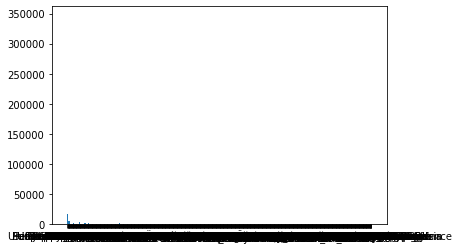

In [26]:
plt.bar(countries_counter.keys(), countries_counter.values())

In [27]:
countries_counter.most_common(20)

[('', 344825),
 ('China', 20627),
 ('USA', 16186),
 ('Italy', 6205),
 ('France', 4653),
 ('Japan', 4537),
 ('Canada', 4247),
 ('Germany', 4076),
 ('UK', 4053),
 ('Australia', 3206),
 ('Taiwan', 3184),
 ('Spain', 2598),
 ('United States', 2402),
 ('PR China', 2374),
 ('United States of America', 2333),
 ('India', 2259),
 ('The Netherlands', 2113),
 ('Brazil', 2092),
 ("People's Republic of China", 1894),
 ('Republic of Korea', 1705)]

In [36]:
new_df = metadata_df[['cord_uid','title', 'abstract' ]]

pdf_df = pd.DataFrame()
pmd_df = pd.DataFrame()
pdf_df[['pdf_abstract_text','pdf_body_text']] = metadata_pdf_df[['abstract_text','body_text']]
pmd_df[['pmc_abstract_text','pmc_body_text']] = metadata_pmc_df[['abstract_text','body_text']]

new_df = pd.concat([new_df,pdf_df, pmd_df ], axis=1)
new_df.head()

,cord_uid,title,abstract,pdf_abstract_text,pdf_body_text,pmc_abstract_text,pmc_body_text
0,ug7v899j,Clinical features of culture-proven Mycoplasma...,OBJECTIVE: This retrospective chart review des...,Objective: This retrospective chart review des...,Mycoplasma pneumoniae is a common cause of upp...,None,Mycoplasma pneumoniae is a common cause of upp...
1,02tnwd4m,Nitric oxide: a pro-inflammatory mediator in l...,Inflammatory diseases of the respiratory tract...,Inflammatory diseases of the respiratory tract...,Since its discovery as a biological messenger ...,None,Since its discovery as a biological messenger ...
2,ejv2xln0,Surfactant protein-D and pulmonary host defense,Surfactant protein-D (SP-D) participates in th...,Surfactant protein-D (SP-D) participates in th...,Surfactant protein-D (SP-D) is a member of the...,None,Surfactant protein-D (SP-D) is a member of the...
3,2b73a28n,Role of endothelin-1 in lung disease,Endothelin-1 (ET-1) is a 21 amino acid peptide...,ARDS = acute respiratory distress syndrome; BA...,from Xenopus laevis [16] . ETA receptors in no...,None,"ET-1, ET-2, and ET-3 are members of a peptide ..."
4,9785vg6d,Gene expression in epithelial cells in respons...,Respiratory syncytial virus (RSV) and pneumoni...,commentary review reports primary research CCR...,RSV and PVM are viruses of the family Paramyxo...,None,RSV and PVM are viruses of the family Paramyxo...


In [37]:
#save the df
new_df.to_csv('../processed-data/processed_file.csv')